In [1]:
import numpy as np
import matplotlib.pyplot as plt
import time
import gym
import torch
import random
import torch.nn as nn

In [2]:
class Env():
    def __init__(self):
        self.env = gym.make('CarRacing-v0')
        self.reward_threshold = self.env.spec.reward_threshold

    def reset(self):
        self.counter = 0
        self.av_r = self.reward_memory()
        self.die = False
        img_rgb = self.env.reset()
        img_gray = self.rgb2gray(img_rgb)
        self.stack = [img_gray] * 4
        return np.array(self.stack)

    def step(self, action):
        total_reward = 0
        for i in range(8):
            img_rgb, reward, die, _ = self.env.step(action)
            # don't penalize "die state"
            if die:
                reward += 100
            # green penalty
            if np.mean(img_rgb[:, :, 1]) > 185.0:
                reward -= 0.05
            total_reward += reward
            # if no reward recently, end the episode
            done = True if self.av_r(reward) <= -0.1 else False
            if done or die:
                break
        img_gray = self.rgb2gray(img_rgb)
        self.stack.pop(0)
        self.stack.append(img_gray)
        assert len(self.stack) == 4
        return np.array(self.stack), total_reward, done, die

    def render(self):
        self.env.render()
        
    def close(self):
        self.env.close()

    @staticmethod
    def rgb2gray(rgb, norm=True):
        gray = np.dot(rgb[..., :], [0.299, 0.587, 0.114])
        if norm:
            # normalize
            gray = gray / 128. - 1.
        return gray

    @staticmethod
    def reward_memory():
        count = 0
        length = 100
        history = np.zeros(length)

        def memory(reward):
            nonlocal count
            history[count] = reward
            count = (count + 1) % length
            return np.mean(history)

        return memory
        
class Classifier(nn.Module):
    def __init__(self,ch=2):
        super(Classifier,self).__init__()
        self.layer1 = torch.nn.Sequential(
            torch.nn.Conv2d(in_channels=4,out_channels=ch*8,kernel_size=7),
            torch.nn.ReLU(),
            torch.nn.Conv2d(in_channels=ch*8,out_channels=ch*16,kernel_size=5,stride=2),
            torch.nn.ReLU(),
            torch.nn.Conv2d(in_channels=ch*16,out_channels=ch*32,kernel_size=3,stride=2),
            torch.nn.ReLU(),
            torch.nn.Conv2d(in_channels=ch*32,out_channels=ch*32,kernel_size=3,stride=2),
            torch.nn.ReLU(),
            torch.nn.Conv2d(in_channels=ch*32,out_channels=ch*64,kernel_size=3,stride=2),
            torch.nn.ReLU(),
            torch.nn.Conv2d(in_channels=ch*64,out_channels=ch*64,kernel_size=3,stride=2),
            torch.nn.ReLU()
        )
        self.v = torch.nn.Sequential(
            torch.nn.Linear(64*ch*1*1,256),
            torch.nn.ReLU()
        )
        self.fc = torch.nn.Linear(256,3)
        self.ch = ch
        
    def forward(self,x):
        x = self.layer1(x)
        x = x.view(x.size(0),-1)
        x = self.v(x)
        x = self.fc(x)
        
        x[:,0] = torch.tanh(x[:,0])
        x[:,1] = torch.sigmoid(x[:,1])
        x[:,2] = torch.sigmoid(x[:,2])
        return x

Track generation: 1166..1461 -> 295-tiles track
Epoch: 1
BC	mean: 1023.00	variance: 0.00


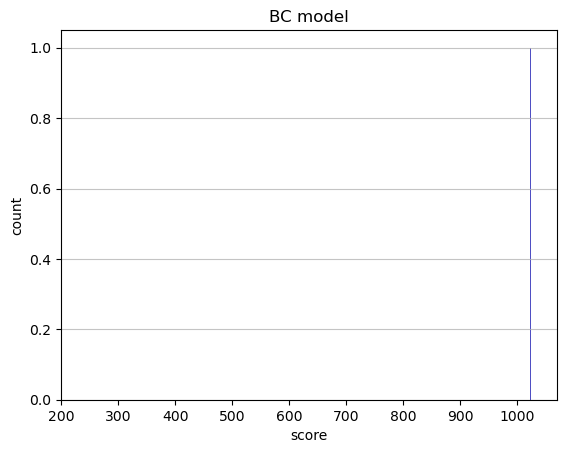

Track generation: 1040..1311 -> 271-tiles track
Epoch: 2
BC	mean: 1027.75	variance: 4.75


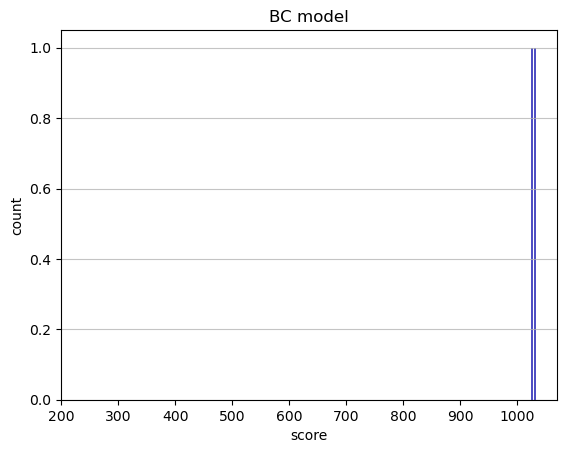

Track generation: 1227..1538 -> 311-tiles track
Epoch: 3
BC	mean: 985.36	variance: 60.08


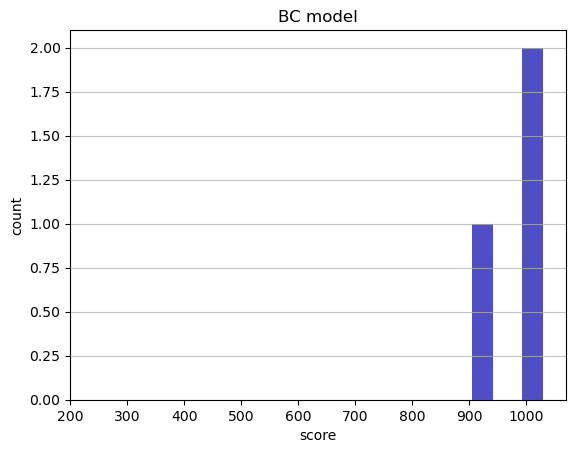

Track generation: 1159..1453 -> 294-tiles track
Epoch: 4
BC	mean: 995.67	variance: 55.01


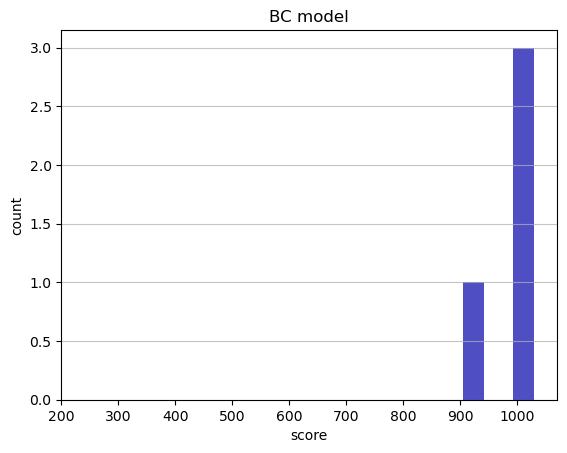

Track generation: 1277..1600 -> 323-tiles track
Epoch: 5
BC	mean: 970.46	variance: 70.44


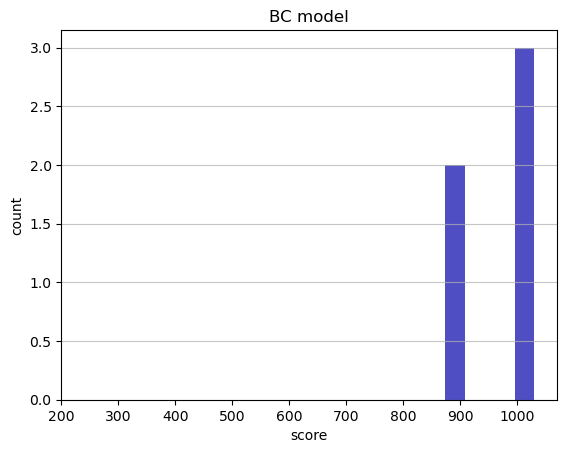

Track generation: 1188..1494 -> 306-tiles track
Epoch: 6
BC	mean: 978.45	variance: 66.74


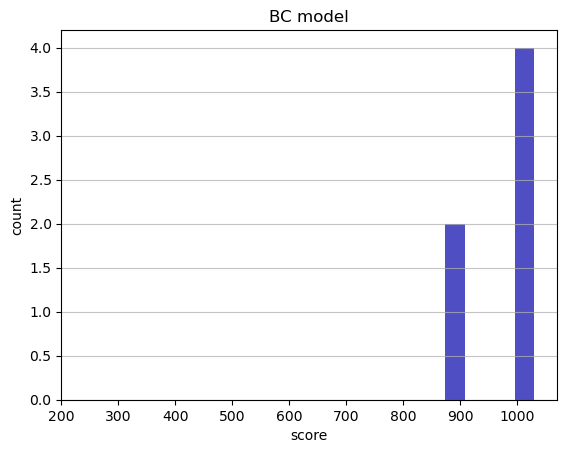

Track generation: 1068..1344 -> 276-tiles track
Epoch: 7
BC	mean: 903.73	variance: 193.17


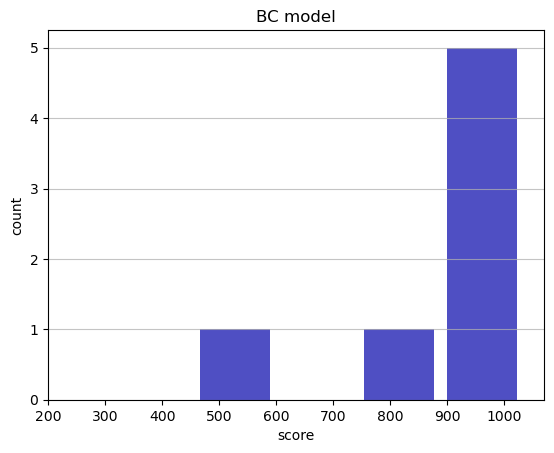

Track generation: 1168..1468 -> 300-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1103..1383 -> 280-tiles track
Epoch: 8
BC	mean: 904.00	variance: 180.70


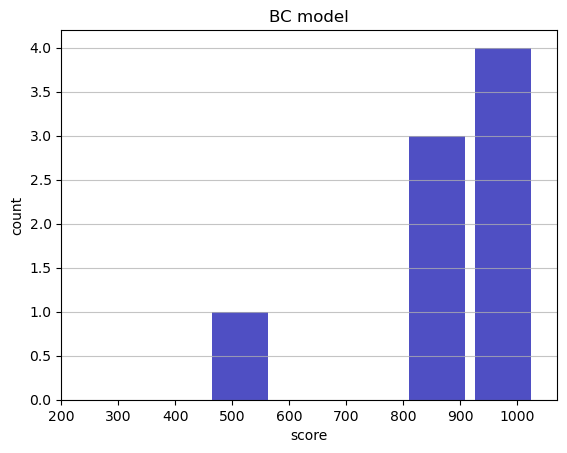

Track generation: 1081..1355 -> 274-tiles track
Epoch: 9
BC	mean: 918.44	variance: 175.19


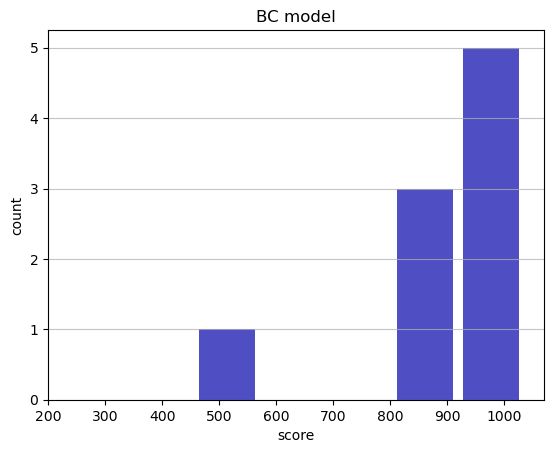

Track generation: 1088..1367 -> 279-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1073..1345 -> 272-tiles track
Epoch: 10
BC	mean: 912.79	variance: 167.06


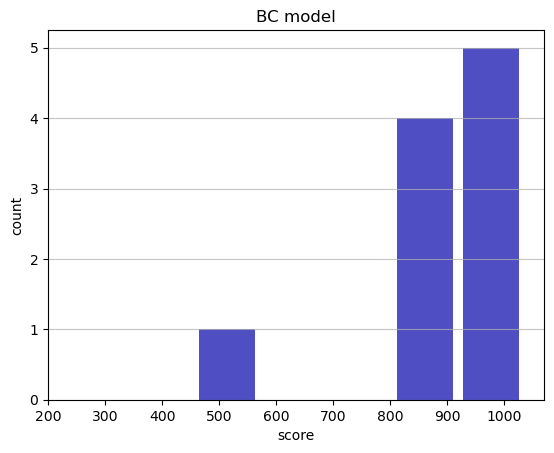

Track generation: 1387..1738 -> 351-tiles track
Epoch: 11
BC	mean: 919.93	variance: 160.88


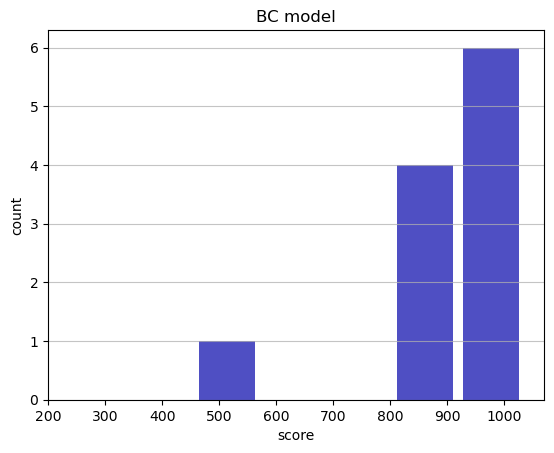

Track generation: 1160..1454 -> 294-tiles track
Epoch: 12
BC	mean: 928.57	variance: 156.67


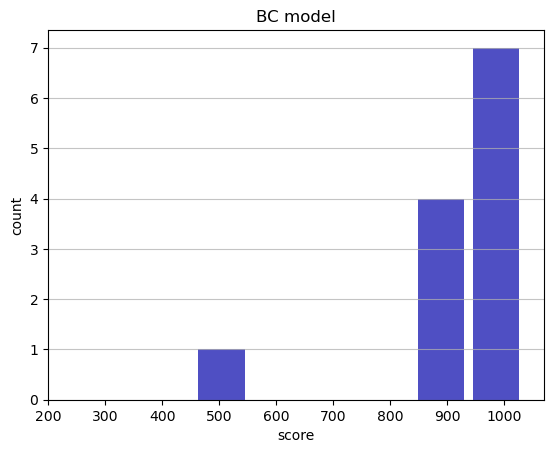

Track generation: 917..1159 -> 242-tiles track
Epoch: 13
BC	mean: 936.68	variance: 153.13


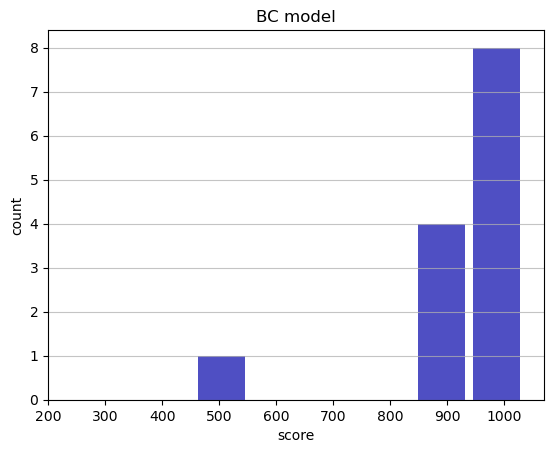

Track generation: 1064..1334 -> 270-tiles track
Epoch: 14
BC	mean: 943.66	variance: 149.68


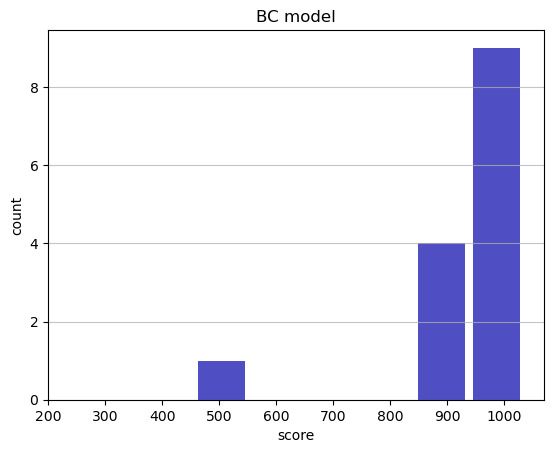

Track generation: 1154..1447 -> 293-tiles track
Epoch: 15
BC	mean: 949.19	variance: 146.08


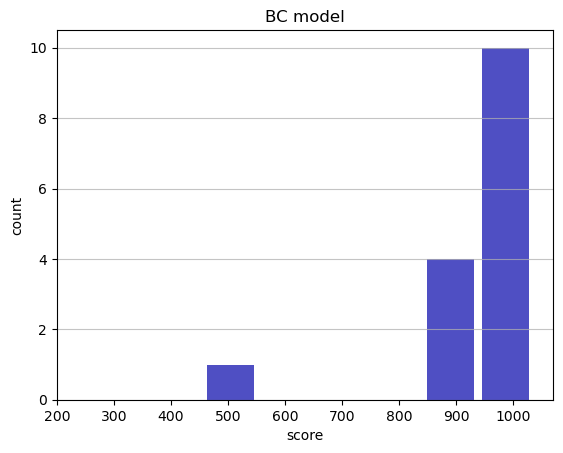

Track generation: 1198..1502 -> 304-tiles track
Epoch: 16
BC	mean: 953.56	variance: 142.45


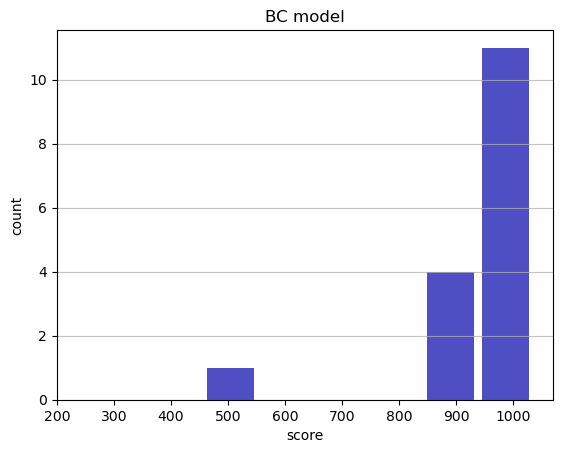

Track generation: 1044..1316 -> 272-tiles track
Epoch: 17
BC	mean: 958.03	variance: 139.35


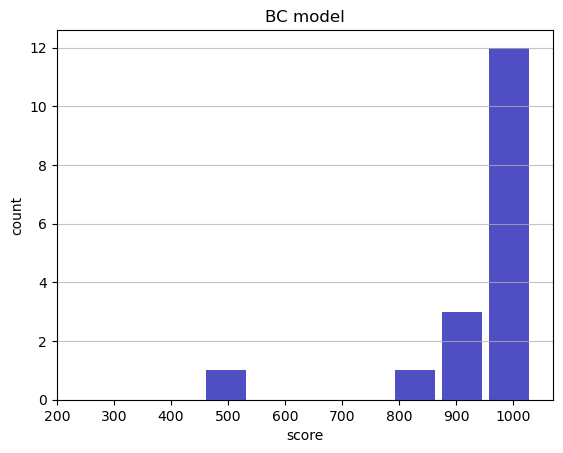

Track generation: 1202..1506 -> 304-tiles track
Epoch: 18
BC	mean: 954.59	variance: 136.17


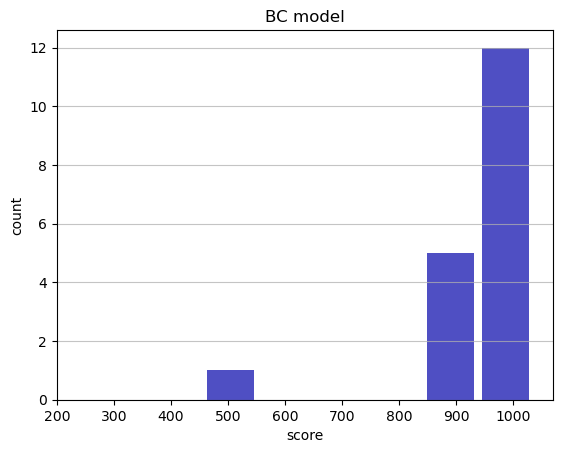

Track generation: 1127..1418 -> 291-tiles track
Epoch: 19
BC	mean: 952.14	variance: 132.94


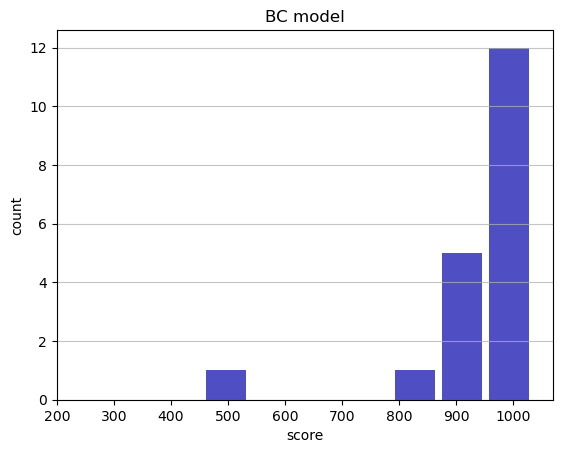

Track generation: 1200..1504 -> 304-tiles track
Epoch: 20
BC	mean: 919.71	variance: 191.76


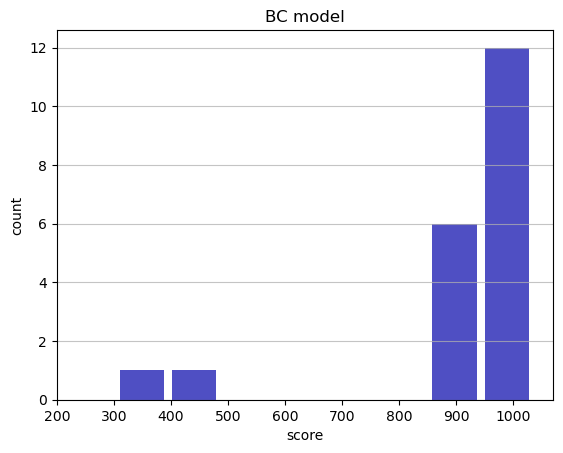

Track generation: 1003..1262 -> 259-tiles track
Epoch: 21
BC	mean: 917.82	variance: 187.33


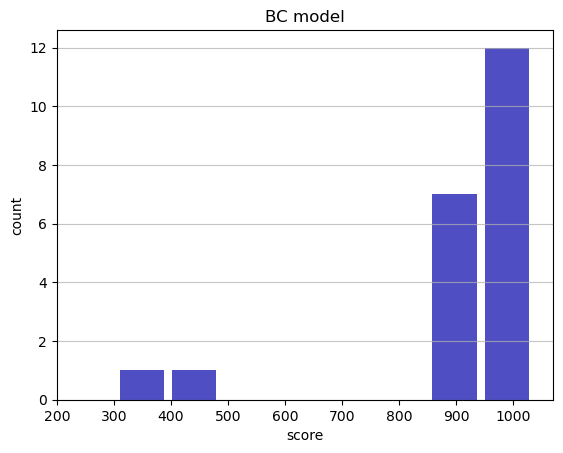

Track generation: 1203..1508 -> 305-tiles track
Epoch: 22
BC	mean: 916.77	variance: 183.08


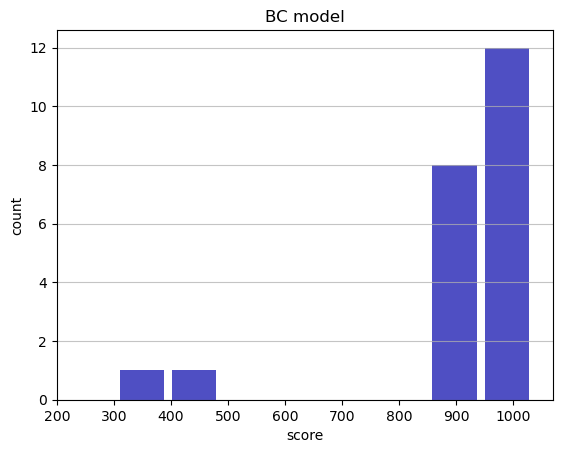

Track generation: 1087..1363 -> 276-tiles track
Epoch: 23
BC	mean: 921.65	variance: 180.51


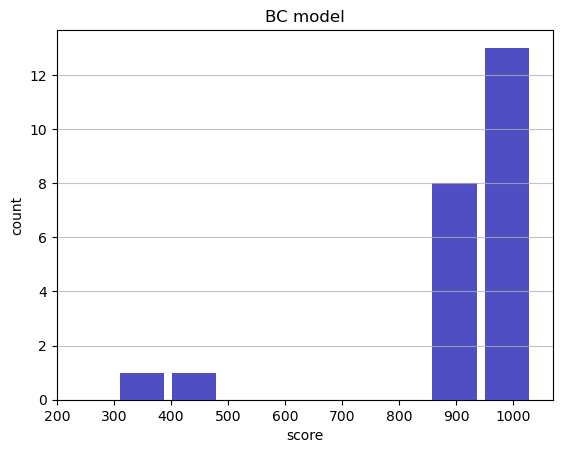

Track generation: 1079..1357 -> 278-tiles track
Epoch: 24
BC	mean: 926.11	variance: 178.00


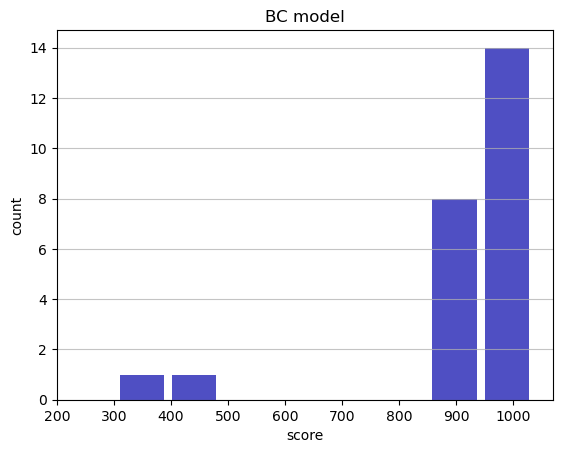

Track generation: 1184..1483 -> 299-tiles track
Epoch: 25
BC	mean: 923.89	variance: 174.74


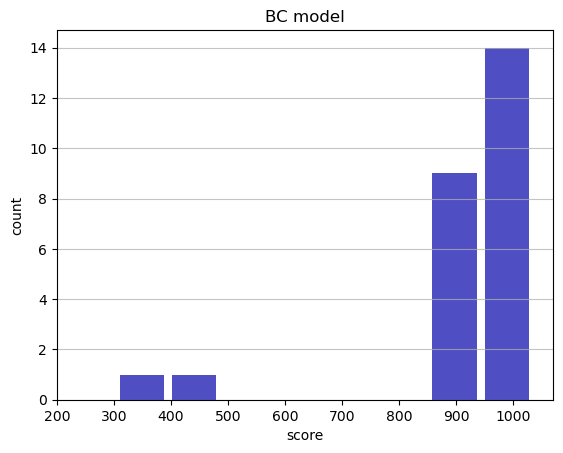

Track generation: 1205..1510 -> 305-tiles track
Epoch: 26
BC	mean: 927.73	variance: 172.42


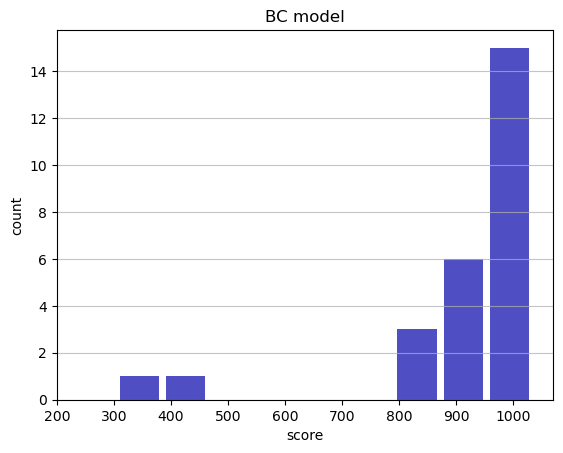

Track generation: 978..1235 -> 257-tiles track
Epoch: 27
BC	mean: 931.70	variance: 170.41


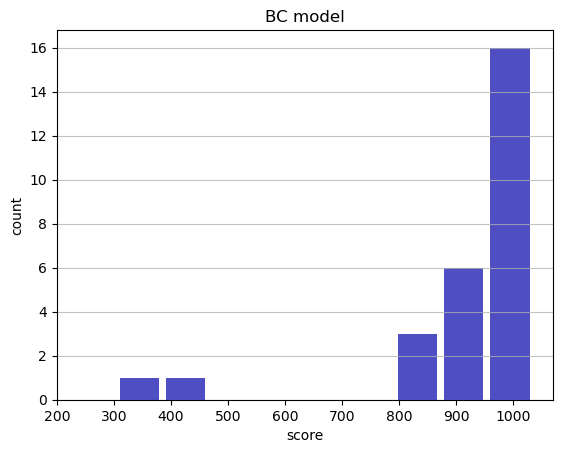

Track generation: 1132..1419 -> 287-tiles track
Epoch: 28
BC	mean: 930.74	variance: 167.42


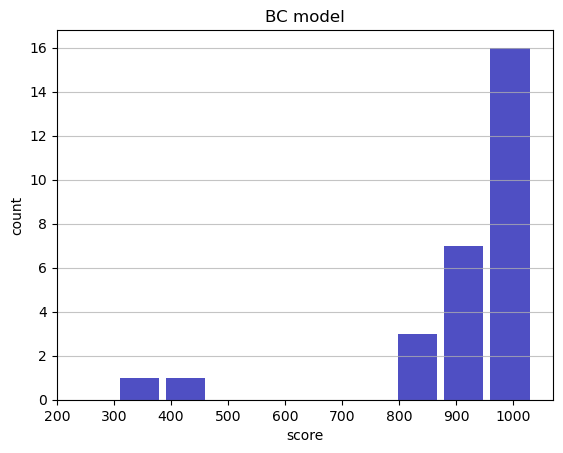

Track generation: 1096..1374 -> 278-tiles track
Epoch: 29
BC	mean: 934.30	variance: 165.58


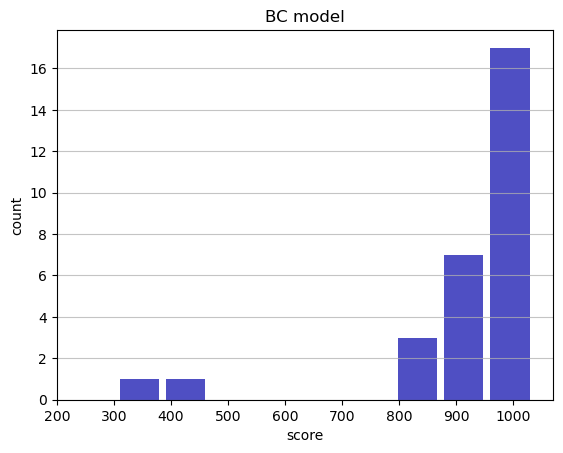

Track generation: 1204..1509 -> 305-tiles track
Epoch: 30
BC	mean: 937.36	variance: 163.63


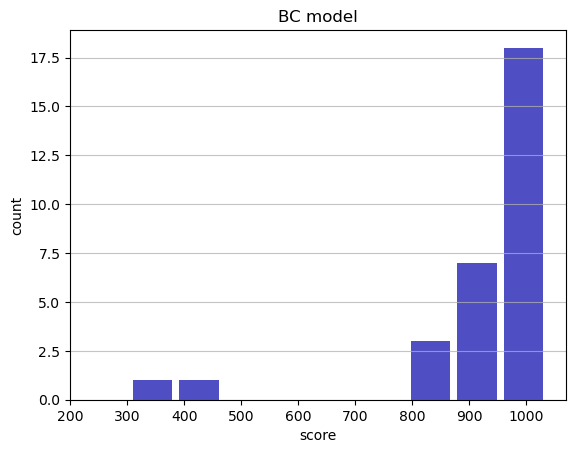

Track generation: 1112..1404 -> 292-tiles track
Epoch: 31
BC	mean: 940.17	variance: 161.70


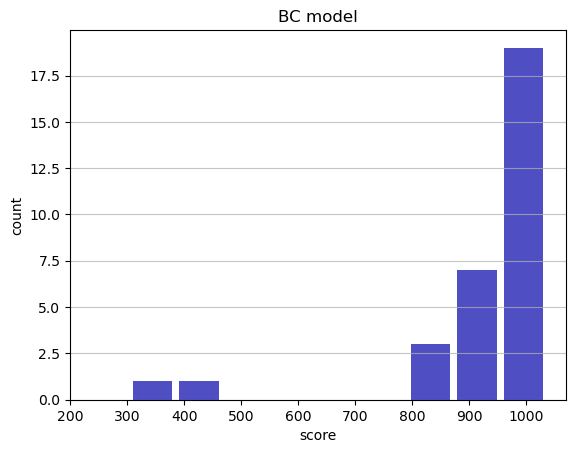

Track generation: 1208..1514 -> 306-tiles track
Epoch: 32
BC	mean: 942.83	variance: 159.84


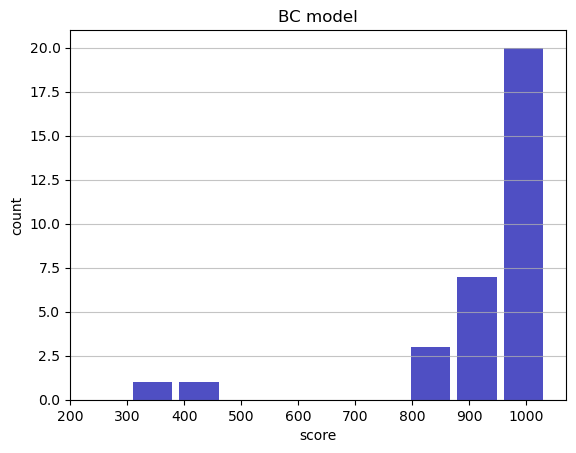

Track generation: 1231..1543 -> 312-tiles track
Epoch: 33
BC	mean: 945.10	variance: 157.92


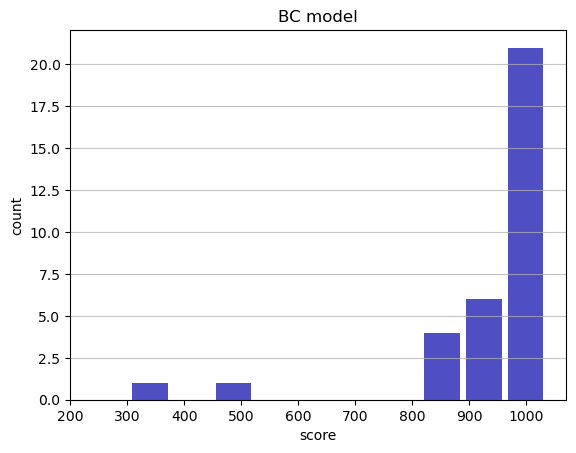

Track generation: 1183..1485 -> 302-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 959..1206 -> 247-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1052..1326 -> 274-tiles track
Epoch: 34
BC	mean: 947.63	variance: 156.26


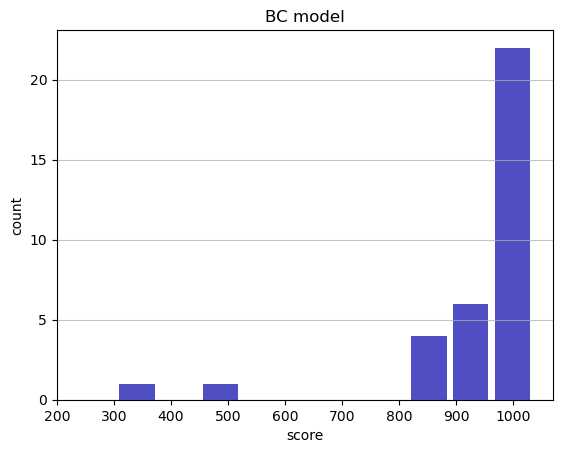

Track generation: 1222..1540 -> 318-tiles track
Epoch: 35
BC	mean: 946.00	variance: 154.31


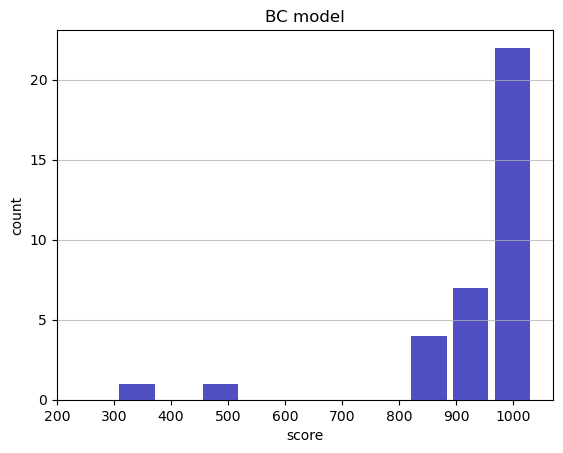

Track generation: 1057..1325 -> 268-tiles track
Epoch: 36
BC	mean: 948.52	variance: 152.88


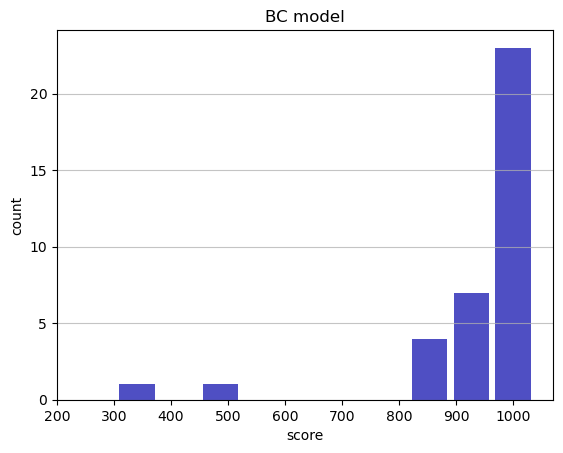

Track generation: 1279..1603 -> 324-tiles track
Epoch: 37
BC	mean: 946.88	variance: 151.12


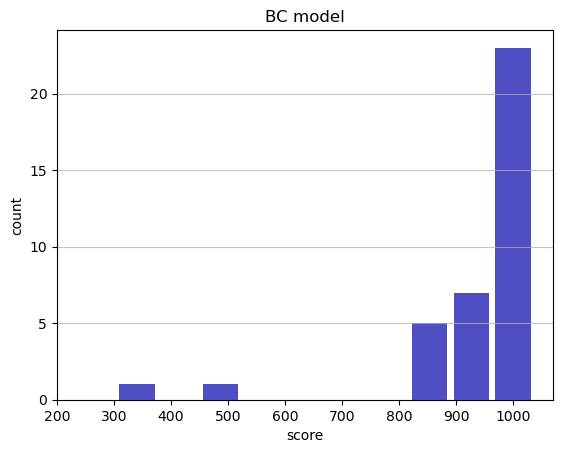

Track generation: 1163..1458 -> 295-tiles track
Epoch: 38
BC	mean: 945.76	variance: 149.28


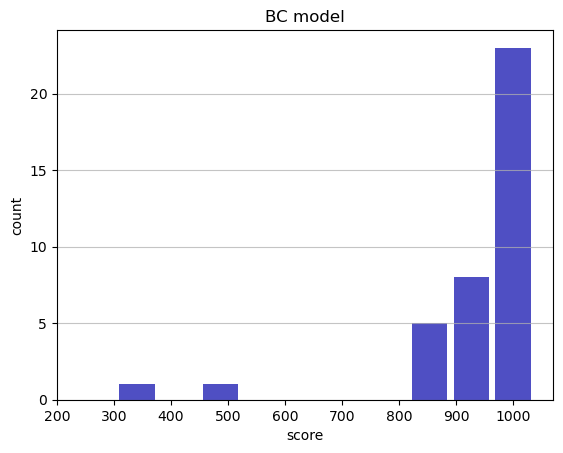

Track generation: 1163..1458 -> 295-tiles track
Epoch: 39
BC	mean: 947.95	variance: 147.97


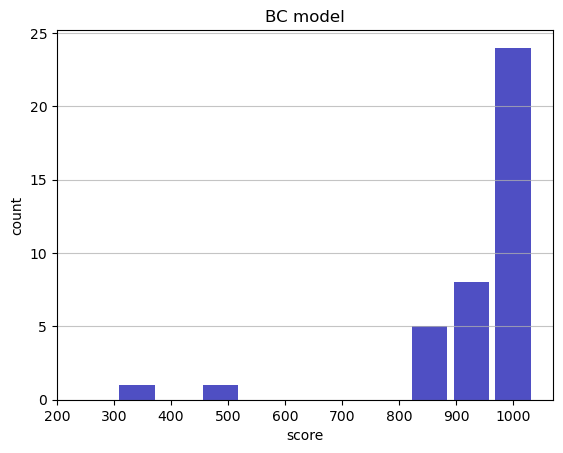

Track generation: 997..1255 -> 258-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1207..1513 -> 306-tiles track
Epoch: 40
BC	mean: 949.94	variance: 146.64


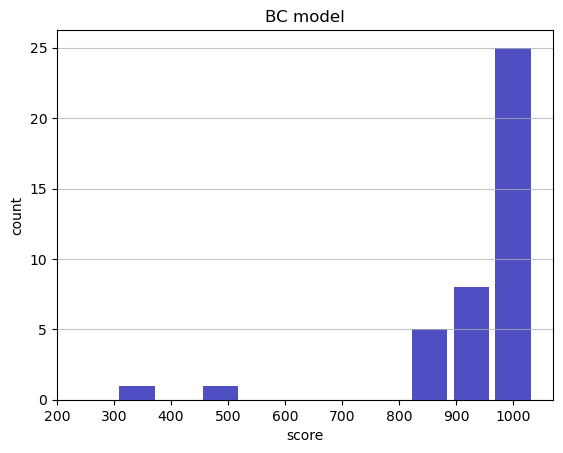

Track generation: 1260..1579 -> 319-tiles track
Epoch: 41
BC	mean: 951.66	variance: 145.25


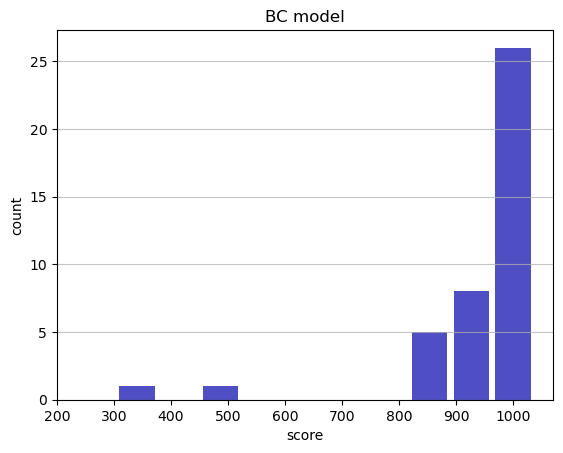

Track generation: 1232..1542 -> 310-tiles track
Epoch: 42
BC	mean: 939.46	variance: 163.40


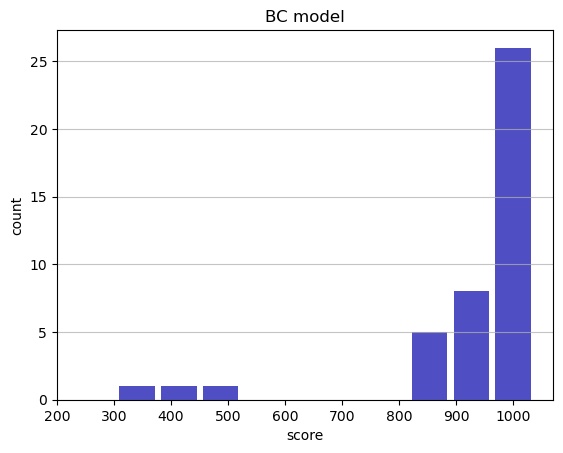

Track generation: 1111..1393 -> 282-tiles track
Epoch: 43
BC	mean: 938.74	variance: 161.55


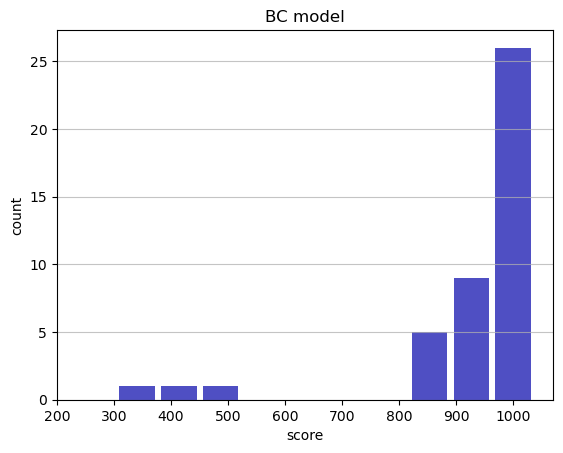

Track generation: 1197..1500 -> 303-tiles track
Epoch: 44
BC	mean: 940.62	variance: 160.18


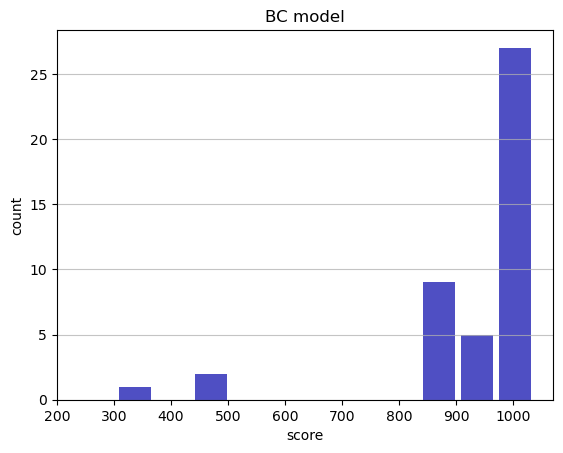

Track generation: 1091..1368 -> 277-tiles track
Epoch: 45
BC	mean: 942.61	variance: 158.94


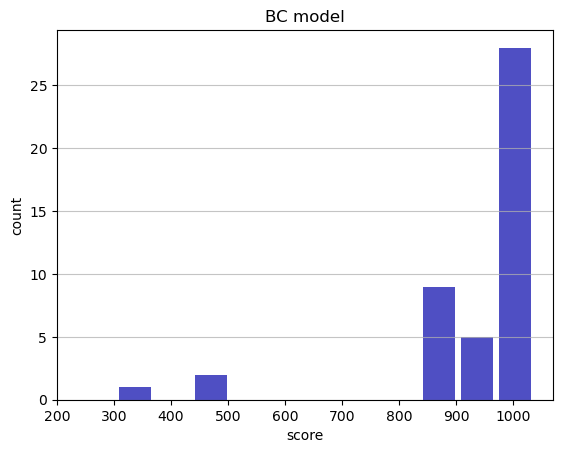

Track generation: 1278..1602 -> 324-tiles track
Epoch: 46
BC	mean: 944.37	variance: 157.65


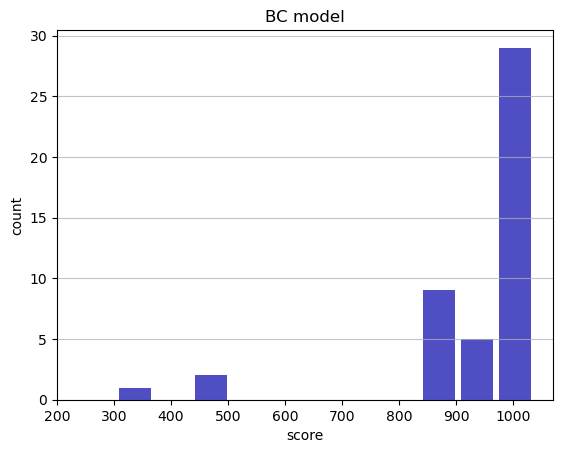

Track generation: 1213..1521 -> 308-tiles track
Epoch: 47
BC	mean: 943.49	variance: 156.08


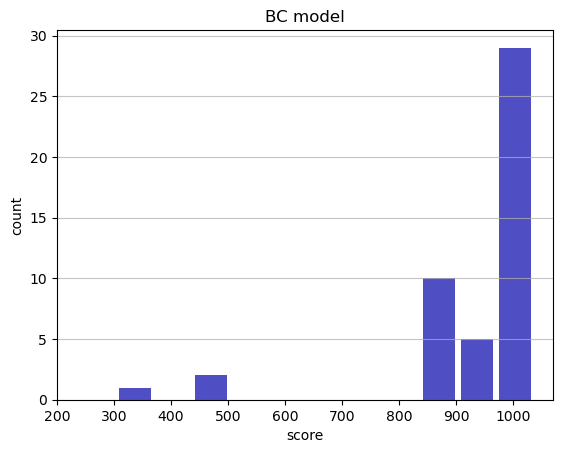

Track generation: 1168..1464 -> 296-tiles track
Epoch: 48
BC	mean: 942.57	variance: 154.57


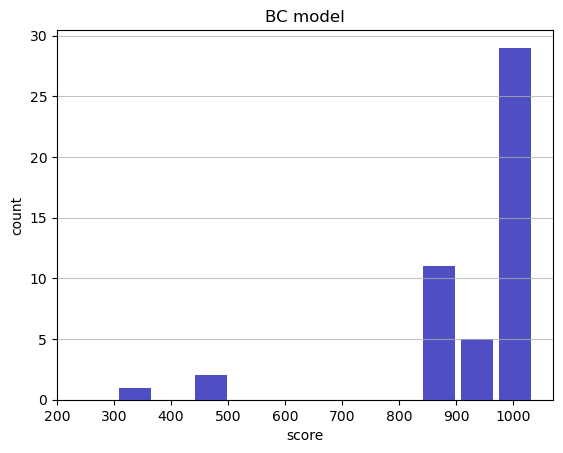

Track generation: 1248..1564 -> 316-tiles track
Epoch: 49
BC	mean: 944.14	variance: 153.37


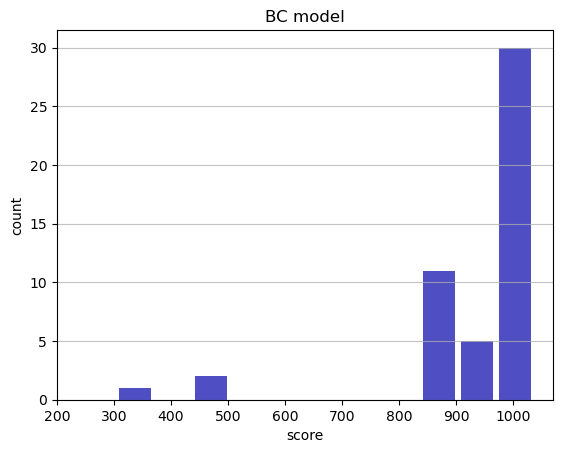

Track generation: 1131..1418 -> 287-tiles track
Epoch: 50
BC	mean: 945.84	variance: 152.29


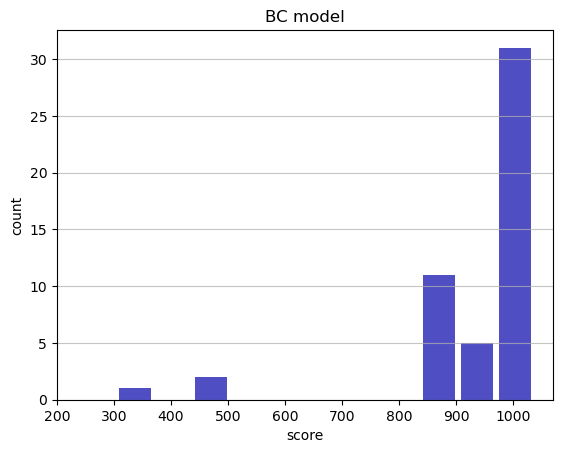

Track generation: 1065..1342 -> 277-tiles track
Epoch: 51
BC	mean: 944.69	variance: 151.01


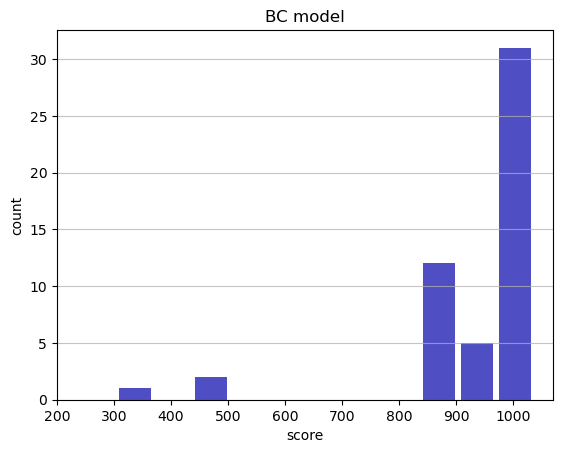

Track generation: 1123..1408 -> 285-tiles track
Epoch: 52
BC	mean: 944.01	variance: 149.63


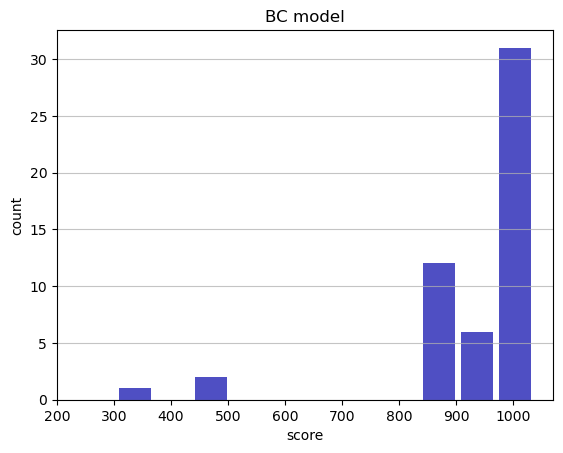

Track generation: 1255..1573 -> 318-tiles track
Epoch: 53
BC	mean: 945.40	variance: 148.55


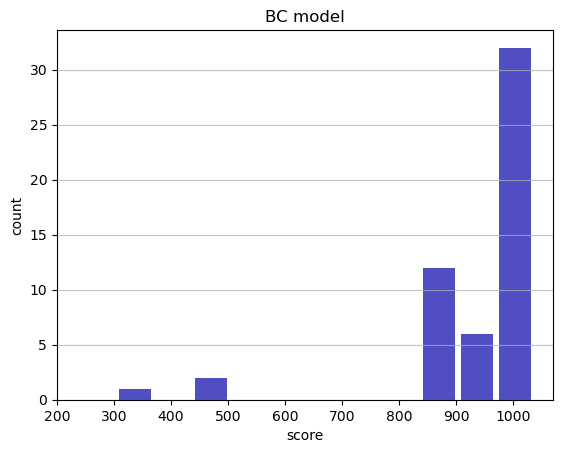

Track generation: 1214..1528 -> 314-tiles track
Epoch: 54
BC	mean: 946.70	variance: 147.47


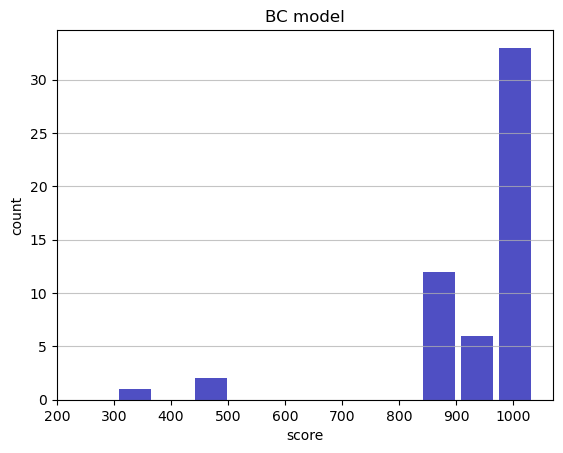

Track generation: 1163..1458 -> 295-tiles track
Epoch: 55
BC	mean: 948.14	variance: 146.51


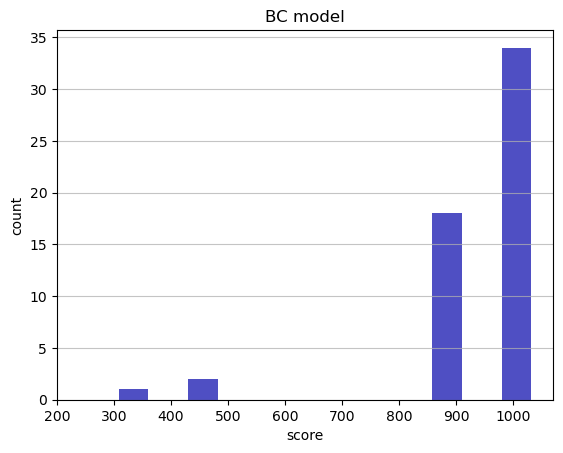

Track generation: 1309..1640 -> 331-tiles track
Epoch: 56
BC	mean: 949.24	variance: 145.42


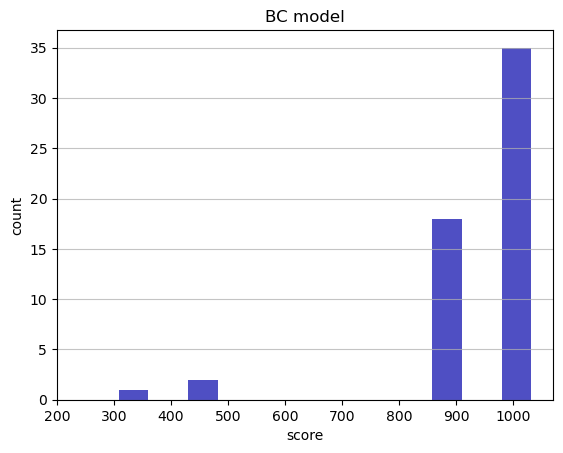

Track generation: 1156..1449 -> 293-tiles track
Epoch: 57
BC	mean: 948.43	variance: 144.27


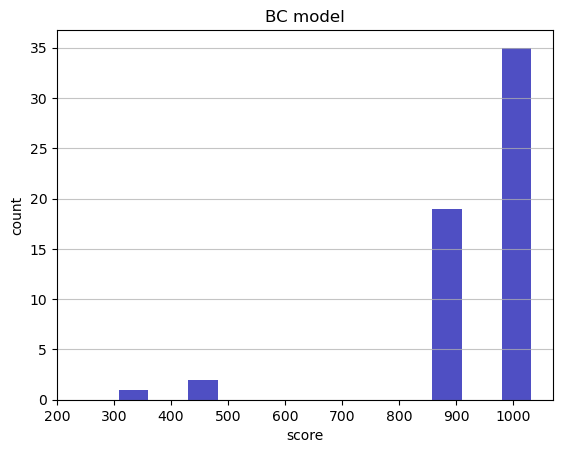

Track generation: 1245..1567 -> 322-tiles track
Epoch: 58
BC	mean: 949.53	variance: 143.26


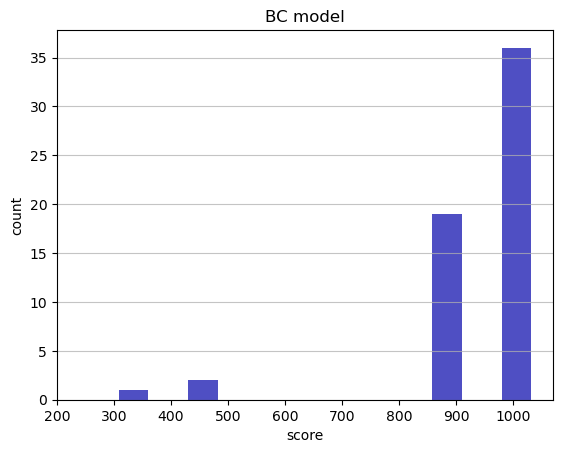

Track generation: 1144..1434 -> 290-tiles track
Epoch: 59
BC	mean: 948.76	variance: 142.16


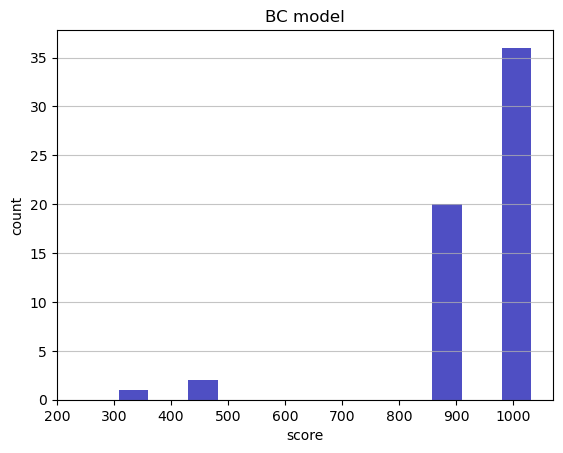

Track generation: 1101..1387 -> 286-tiles track
Epoch: 60
BC	mean: 949.44	variance: 141.07


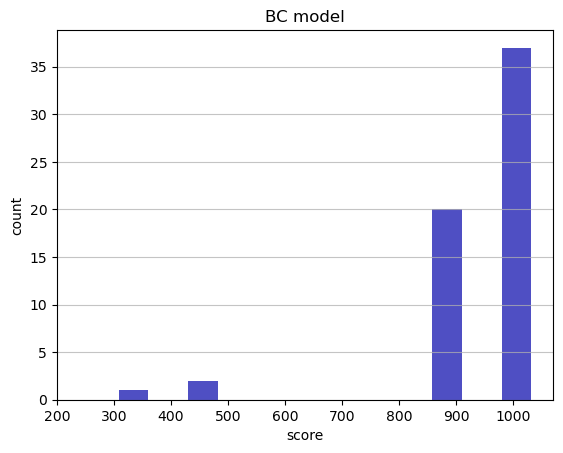

Track generation: 1227..1538 -> 311-tiles track
Epoch: 61
BC	mean: 948.36	variance: 140.15


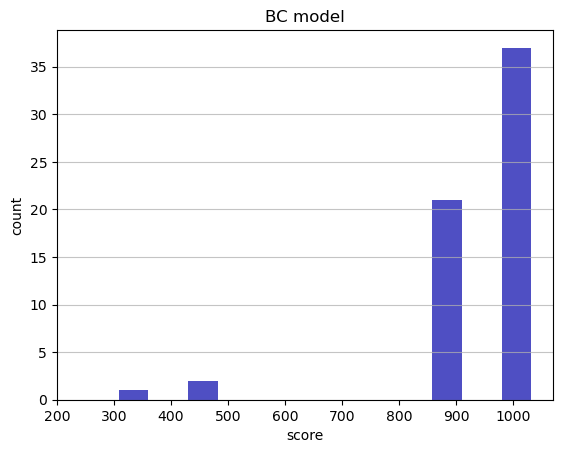

Track generation: 1176..1474 -> 298-tiles track
Epoch: 62
BC	mean: 949.68	variance: 139.40


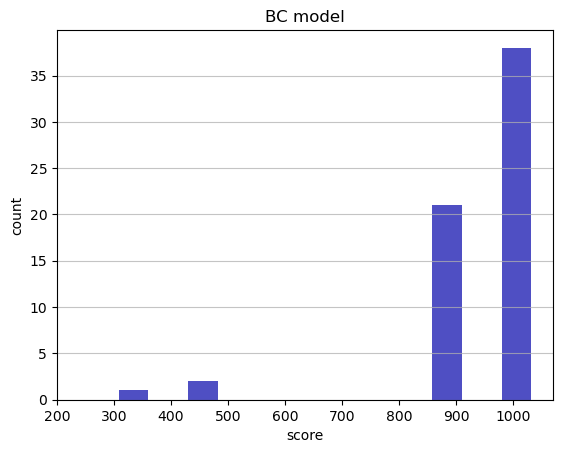

Track generation: 1150..1445 -> 295-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1083..1365 -> 282-tiles track
Epoch: 63
BC	mean: 946.78	variance: 140.16


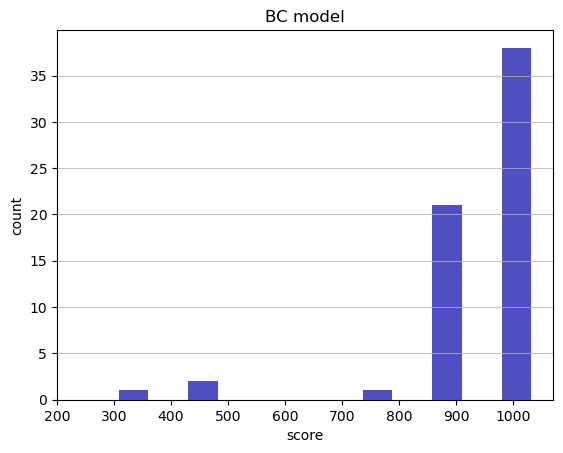

Track generation: 1287..1621 -> 334-tiles track
Epoch: 64
BC	mean: 947.77	variance: 139.29


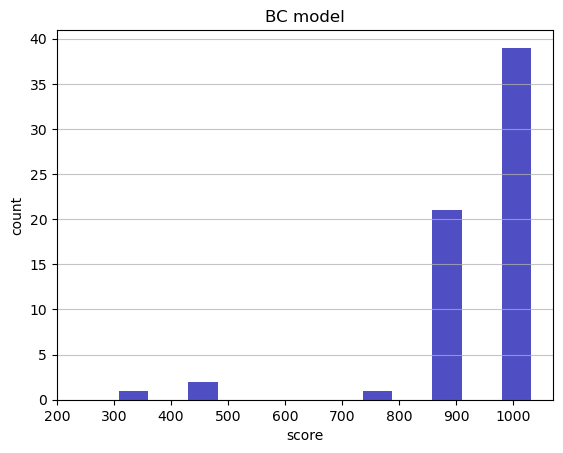

Track generation: 1172..1469 -> 297-tiles track
Epoch: 65
BC	mean: 948.96	variance: 138.54


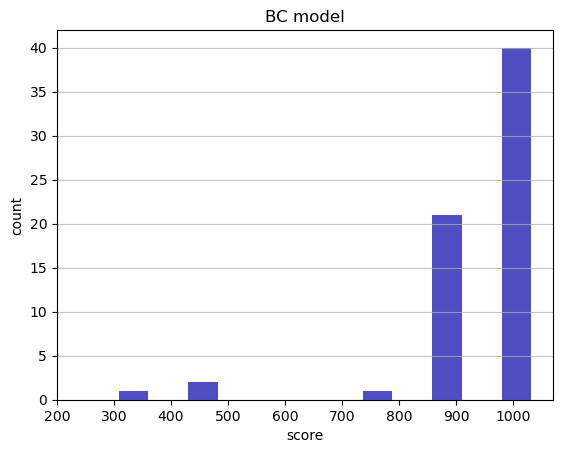

Track generation: 1033..1295 -> 262-tiles track
Epoch: 66
BC	mean: 950.29	variance: 137.91


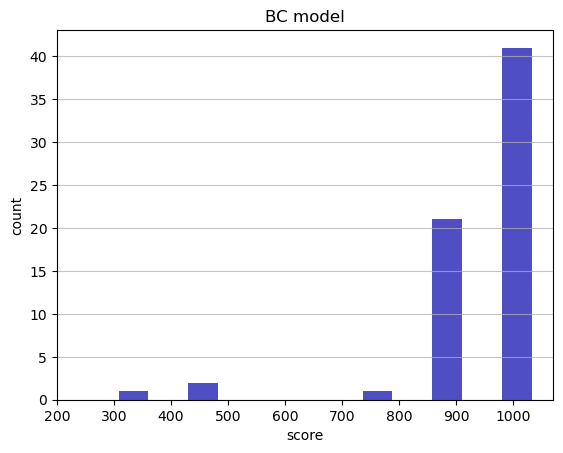

Track generation: 1117..1405 -> 288-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1184..1484 -> 300-tiles track
Epoch: 67
BC	mean: 951.32	variance: 137.13


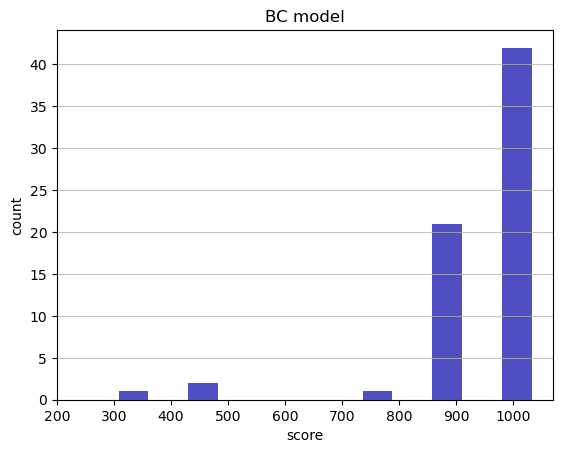

Track generation: 1152..1444 -> 292-tiles track
Epoch: 68
BC	mean: 952.47	variance: 136.44


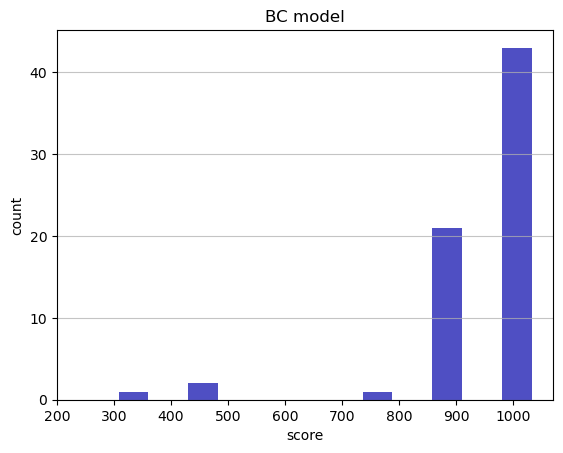

Track generation: 1168..1464 -> 296-tiles track
Epoch: 69
BC	mean: 953.54	variance: 135.73


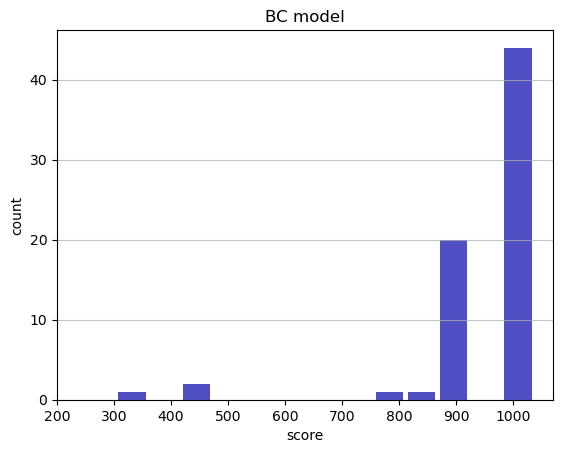

Track generation: 988..1245 -> 257-tiles track
Epoch: 70
BC	mean: 952.83	variance: 134.89


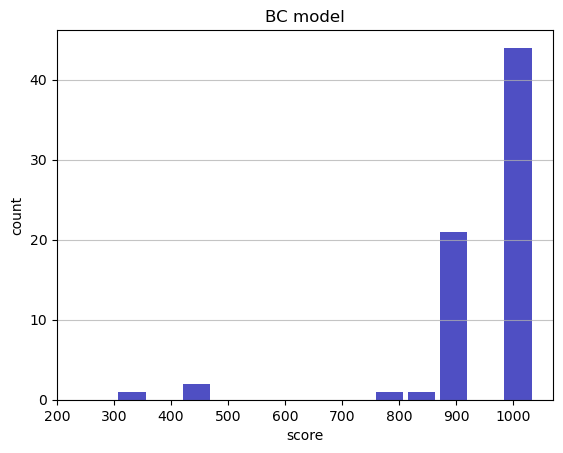

Track generation: 1239..1553 -> 314-tiles track
Epoch: 71
BC	mean: 953.82	variance: 134.19


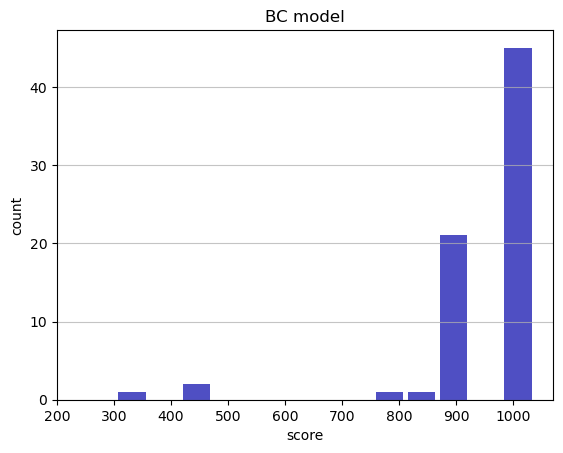

Track generation: 1144..1433 -> 289-tiles track
Epoch: 72
BC	mean: 953.04	variance: 133.42


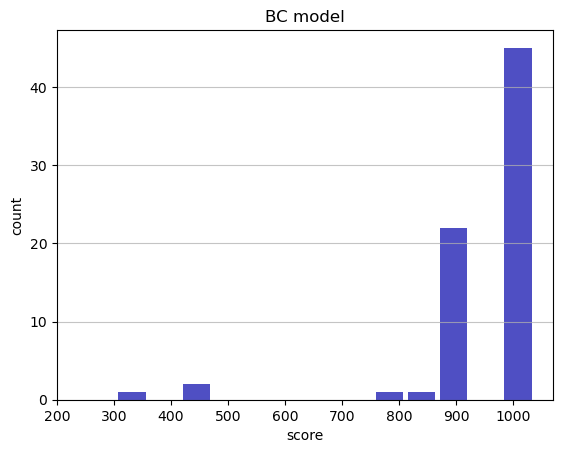

Track generation: 1159..1462 -> 303-tiles track
Epoch: 73
BC	mean: 953.98	variance: 132.73


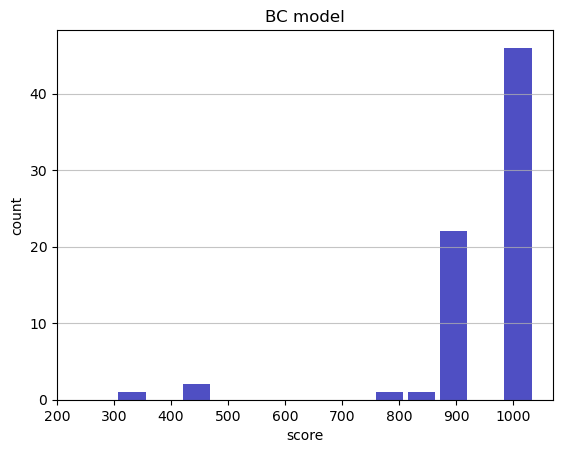

Track generation: 1055..1323 -> 268-tiles track
Epoch: 74
BC	mean: 954.99	variance: 132.12


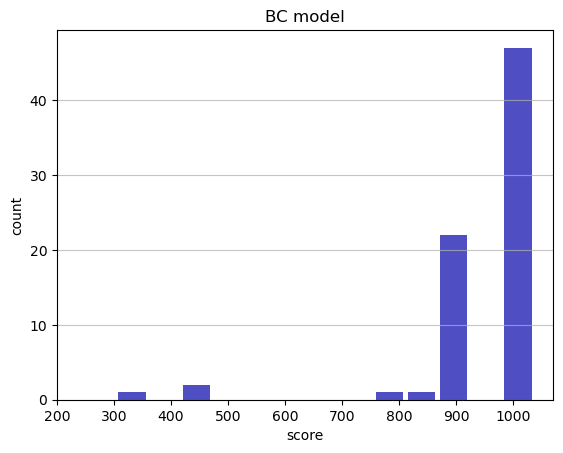

Track generation: 1147..1438 -> 291-tiles track
Epoch: 75
BC	mean: 953.83	variance: 131.61


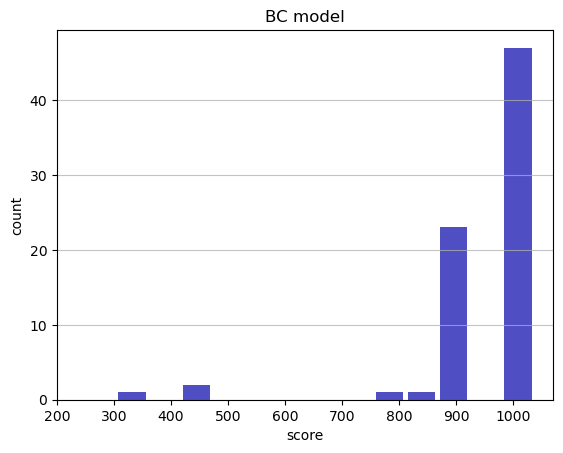

Track generation: 1087..1363 -> 276-tiles track
Epoch: 76
BC	mean: 954.91	variance: 131.08


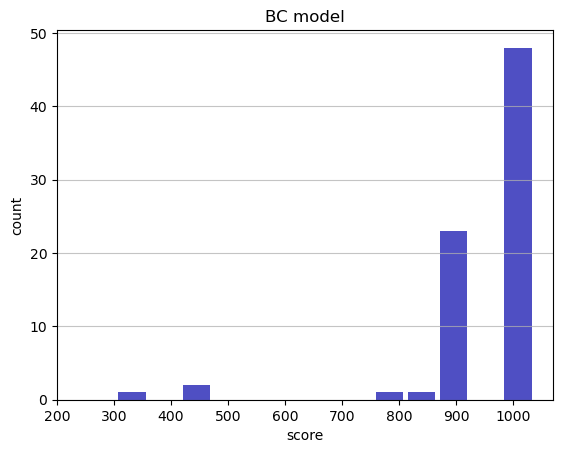

Track generation: 1203..1508 -> 305-tiles track
Epoch: 77
BC	mean: 955.79	variance: 130.45


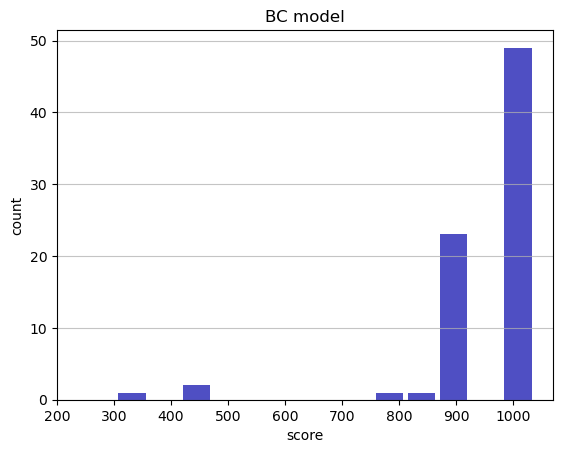

Track generation: 1194..1497 -> 303-tiles track
Epoch: 78
BC	mean: 955.20	variance: 129.71


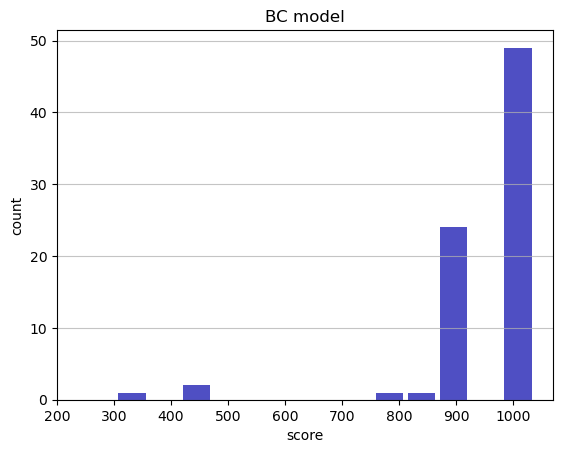

Track generation: 1211..1518 -> 307-tiles track
Epoch: 79
BC	mean: 955.99	variance: 129.07


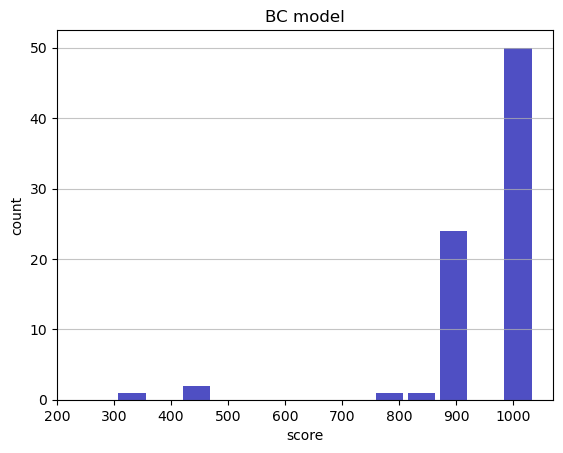

Track generation: 1134..1425 -> 291-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1167..1463 -> 296-tiles track
Epoch: 80
BC	mean: 956.85	variance: 128.49


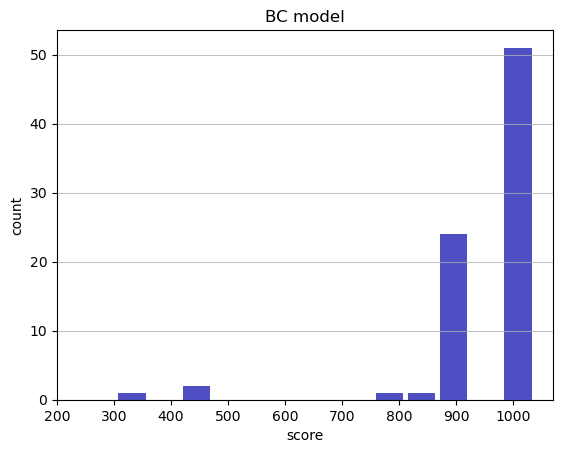

Track generation: 1195..1498 -> 303-tiles track
Epoch: 81
BC	mean: 957.70	variance: 127.92


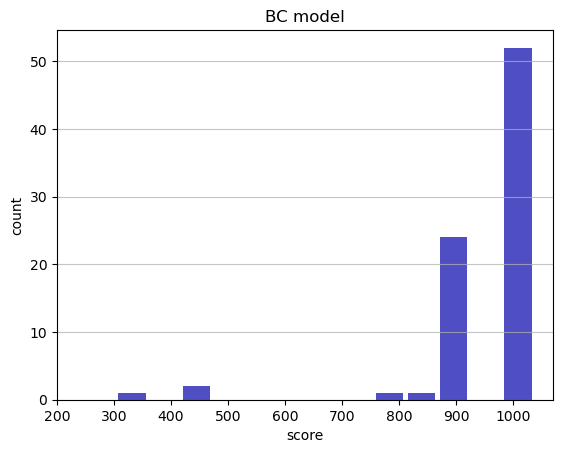

Track generation: 1014..1274 -> 260-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1036..1299 -> 263-tiles track
Epoch: 82
BC	mean: 958.67	variance: 127.44


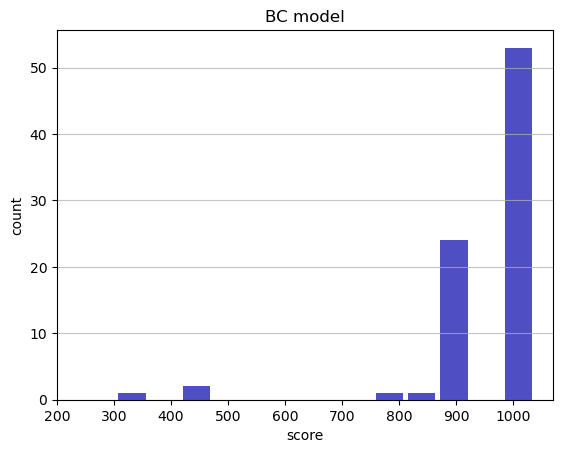

Track generation: 1190..1492 -> 302-tiles track
Epoch: 83
BC	mean: 959.43	variance: 126.86


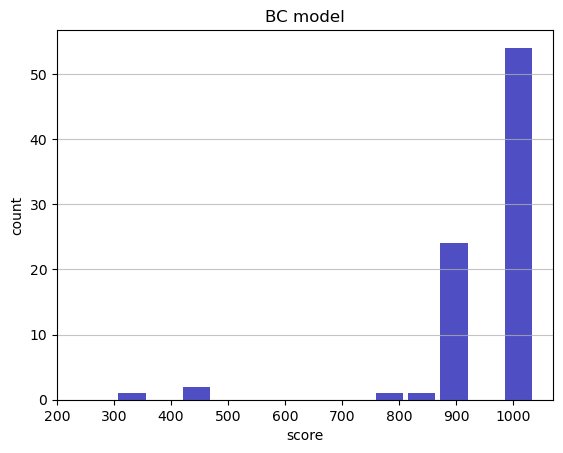

Track generation: 1059..1331 -> 272-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1133..1420 -> 287-tiles track
Epoch: 84
BC	mean: 960.17	variance: 126.28


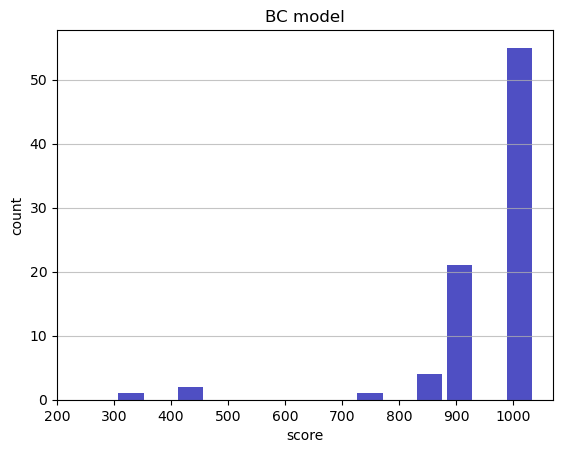

Track generation: 1143..1433 -> 290-tiles track
Epoch: 85
BC	mean: 959.44	variance: 125.71


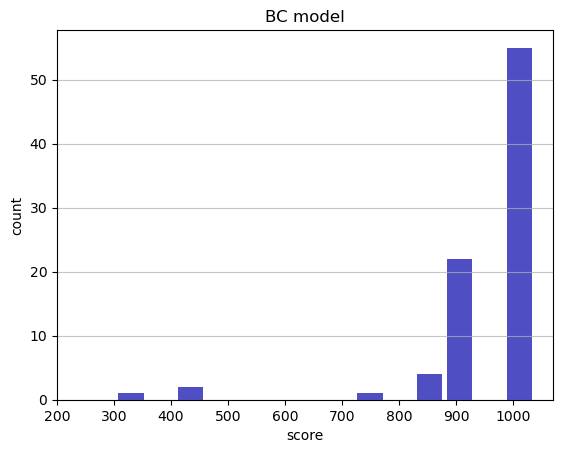

Track generation: 1085..1360 -> 275-tiles track
Epoch: 86
BC	mean: 958.60	variance: 125.22


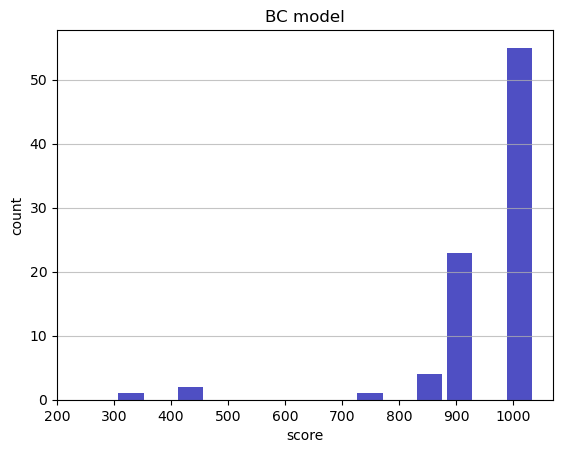

Track generation: 1247..1563 -> 316-tiles track
Epoch: 87
BC	mean: 957.79	variance: 124.73


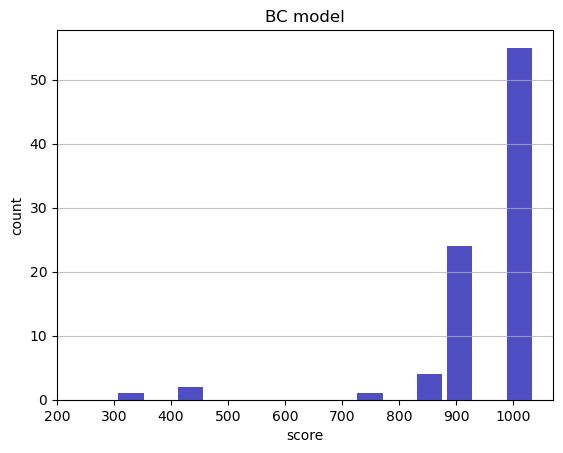

Track generation: 1308..1639 -> 331-tiles track
Epoch: 88
BC	mean: 956.90	variance: 124.29


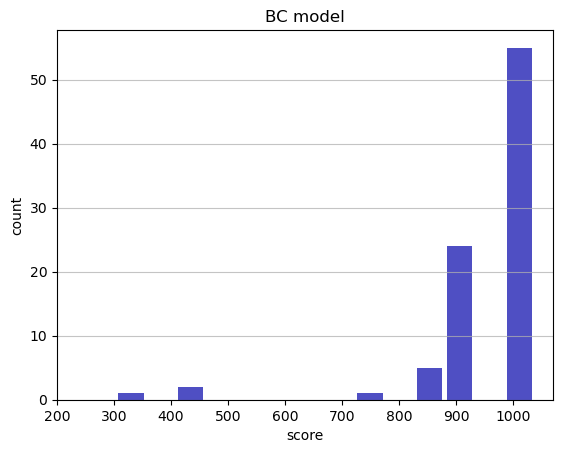

Track generation: 1176..1474 -> 298-tiles track
Epoch: 89
BC	mean: 957.70	variance: 123.82


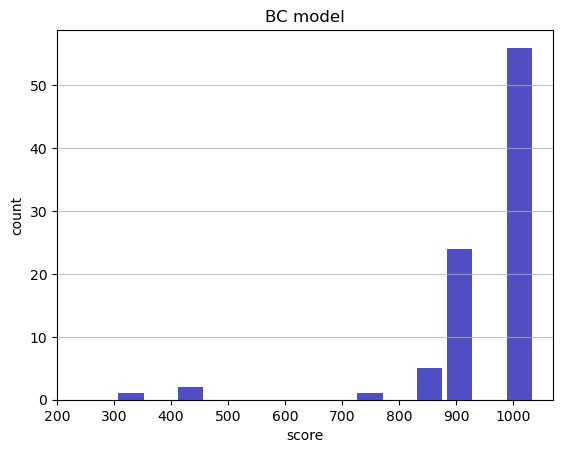

Track generation: 1199..1503 -> 304-tiles track
Epoch: 90
BC	mean: 954.87	variance: 126.00


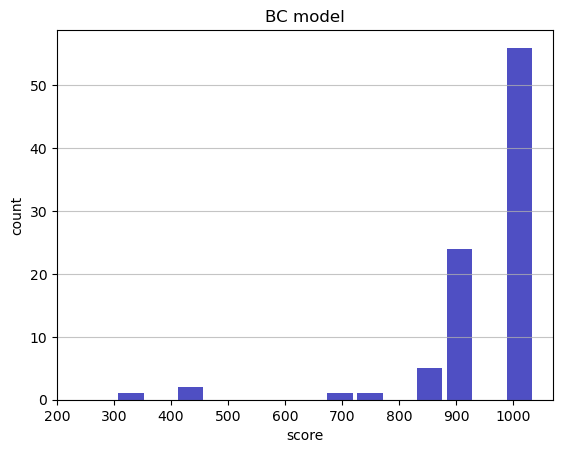

Track generation: 1172..1469 -> 297-tiles track
Epoch: 91
BC	mean: 955.64	variance: 125.52


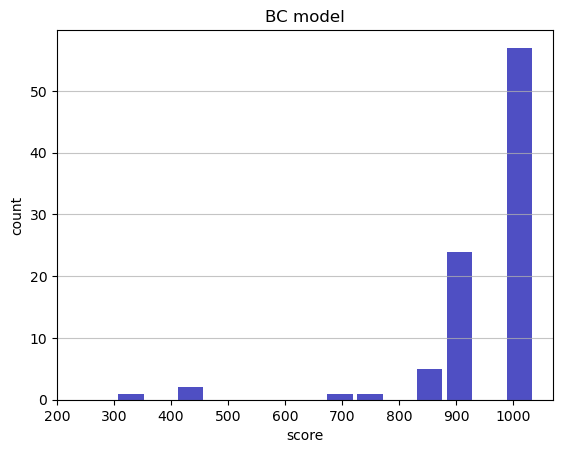

Track generation: 1260..1579 -> 319-tiles track
Epoch: 92
BC	mean: 956.30	variance: 124.99


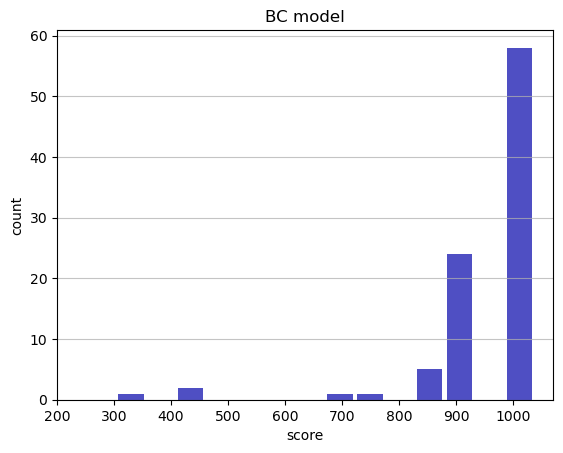

Track generation: 1104..1384 -> 280-tiles track
Epoch: 93
BC	mean: 957.08	variance: 124.54


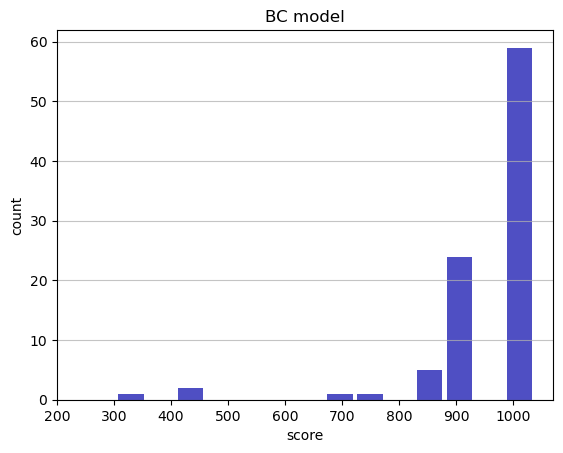

Track generation: 1139..1436 -> 297-tiles track
Epoch: 94
BC	mean: 957.81	variance: 124.08


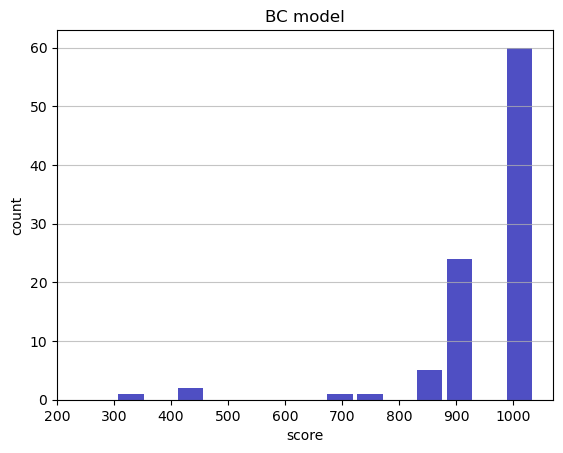

Track generation: 1139..1428 -> 289-tiles track
Epoch: 95
BC	mean: 951.34	variance: 138.46


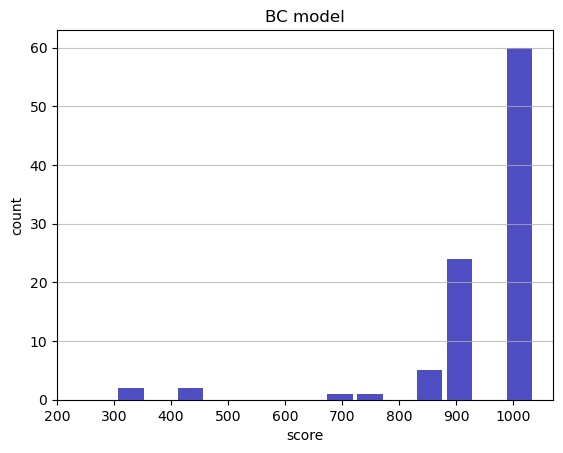

Track generation: 993..1245 -> 252-tiles track
Epoch: 96
BC	mean: 952.21	variance: 138.01


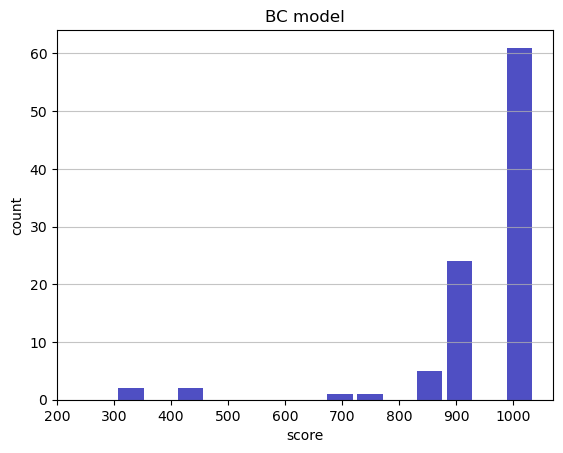

Track generation: 1136..1424 -> 288-tiles track
Epoch: 97
BC	mean: 953.06	variance: 137.54


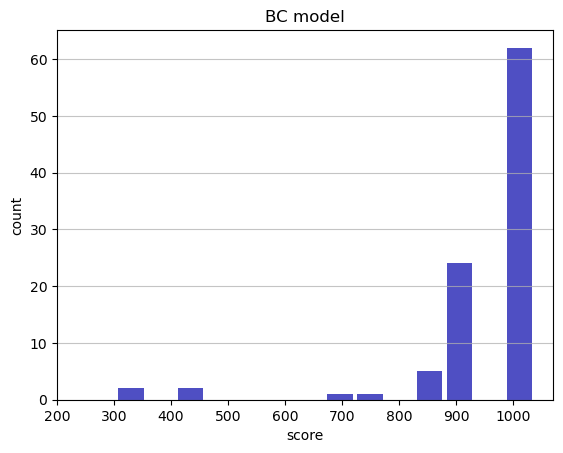

Track generation: 1134..1420 -> 286-tiles track
Epoch: 98
BC	mean: 953.80	variance: 137.04


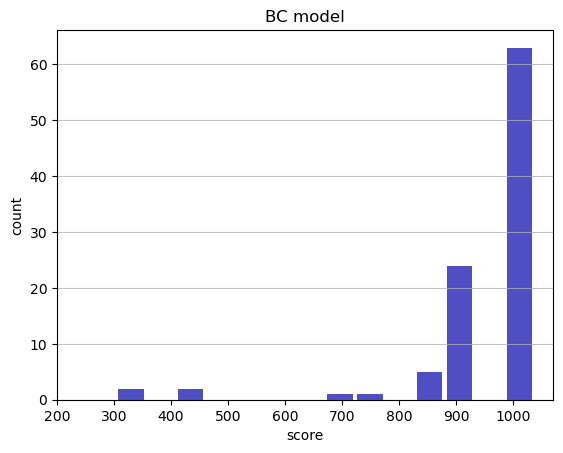

Track generation: 1279..1603 -> 324-tiles track
Epoch: 99
BC	mean: 954.43	variance: 136.48


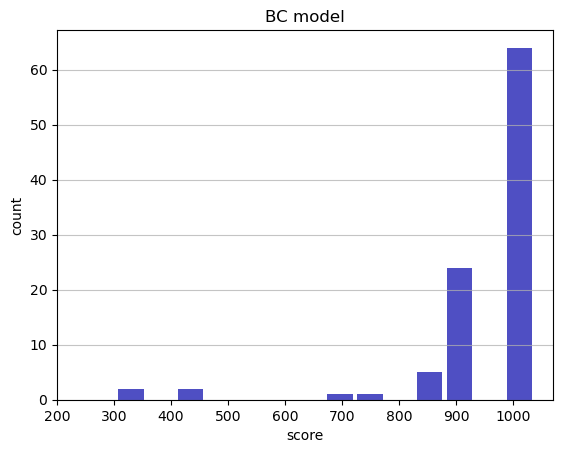

Track generation: 1204..1462 -> 258-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 929..1170 -> 241-tiles track
Epoch: 100
BC	mean: 951.08	variance: 139.82


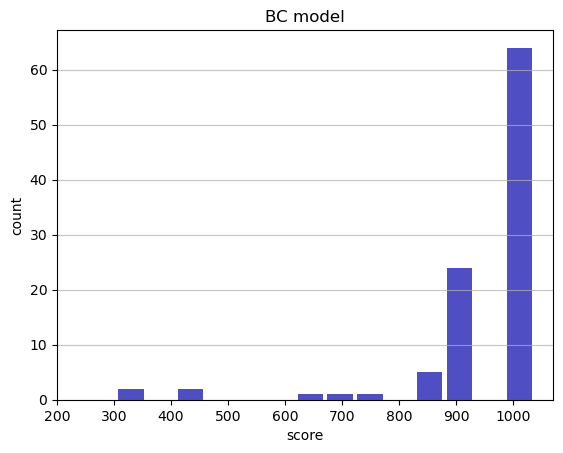

Track generation: 1107..1388 -> 281-tiles track
Epoch: 101
BC	mean: 951.82	variance: 139.32


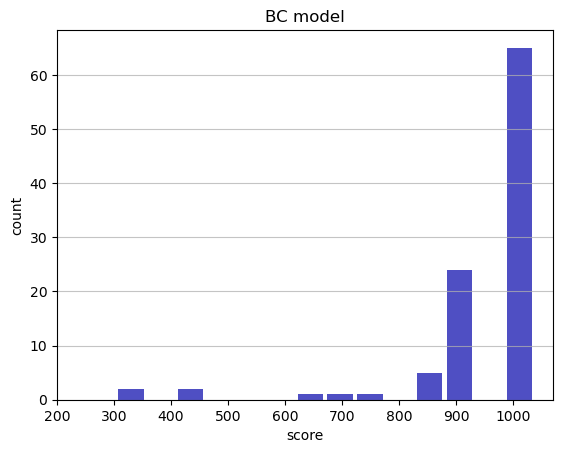

Track generation: 931..1177 -> 246-tiles track
Epoch: 102
BC	mean: 952.66	variance: 138.89


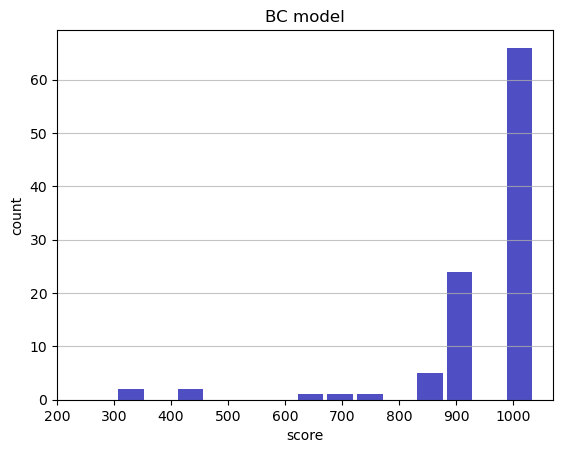

Track generation: 1147..1438 -> 291-tiles track
Epoch: 103
BC	mean: 951.96	variance: 138.40


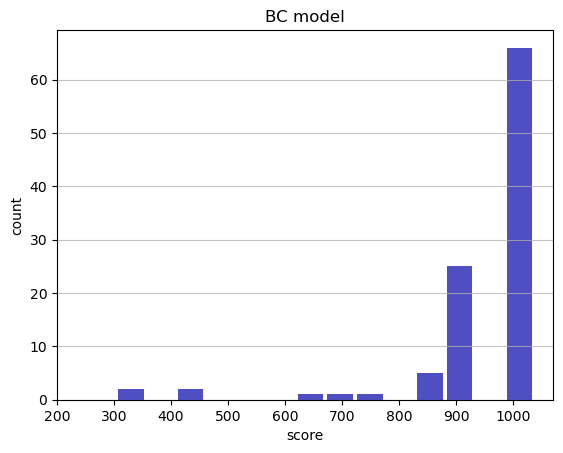

Track generation: 1121..1405 -> 284-tiles track
Epoch: 104
BC	mean: 952.72	variance: 137.94


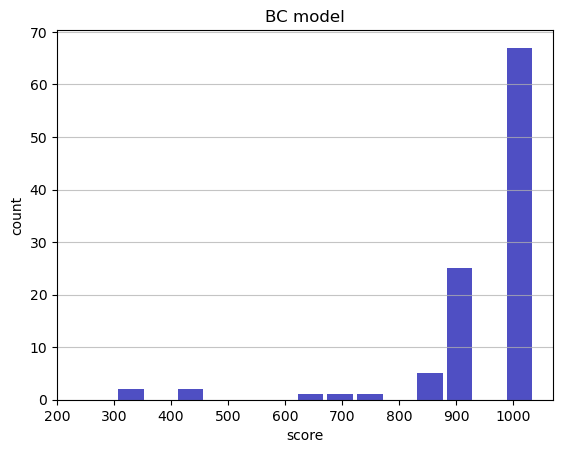

Track generation: 1093..1368 -> 275-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1348..1689 -> 341-tiles track
Epoch: 105
BC	mean: 953.26	variance: 137.40


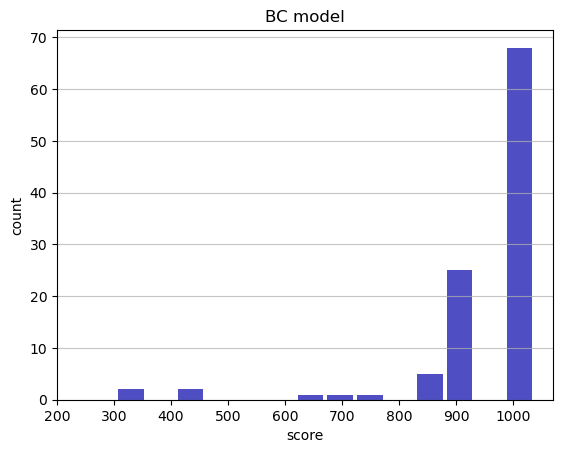

Track generation: 1023..1283 -> 260-tiles track
Epoch: 106
BC	mean: 954.06	variance: 136.99


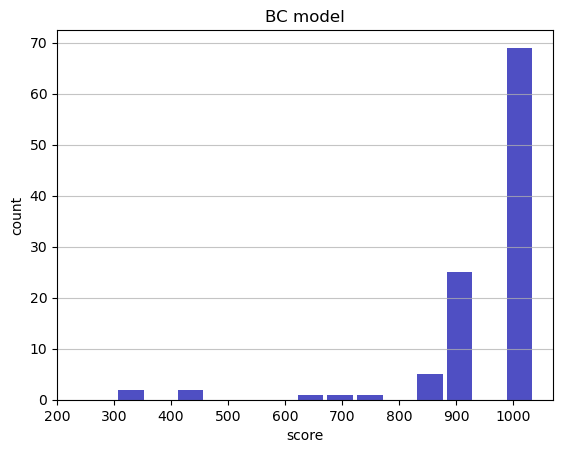

Track generation: 1173..1470 -> 297-tiles track
Epoch: 107
BC	mean: 954.70	variance: 136.51


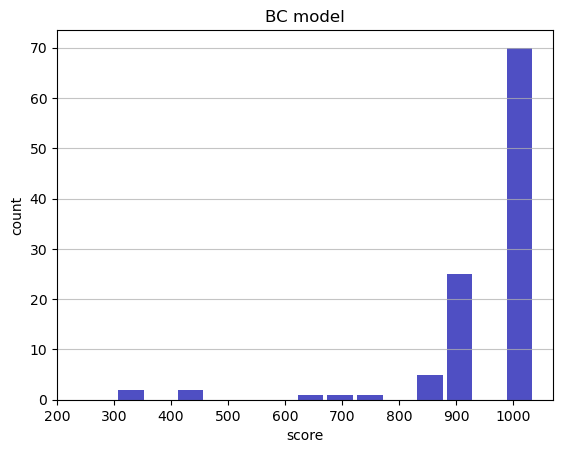

Track generation: 1166..1462 -> 296-tiles track
Epoch: 108
BC	mean: 954.13	variance: 136.00


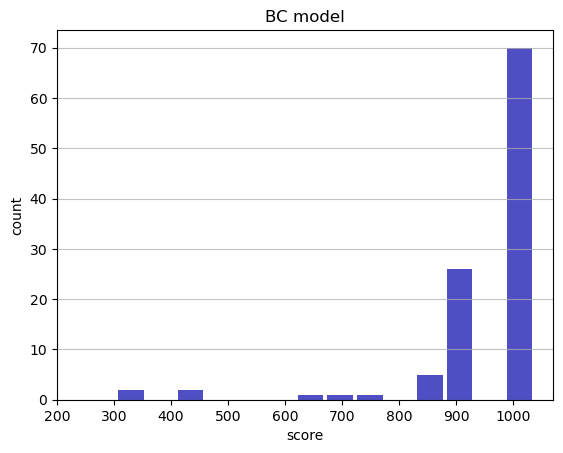

Track generation: 1111..1393 -> 282-tiles track
Epoch: 109
BC	mean: 954.86	variance: 135.58


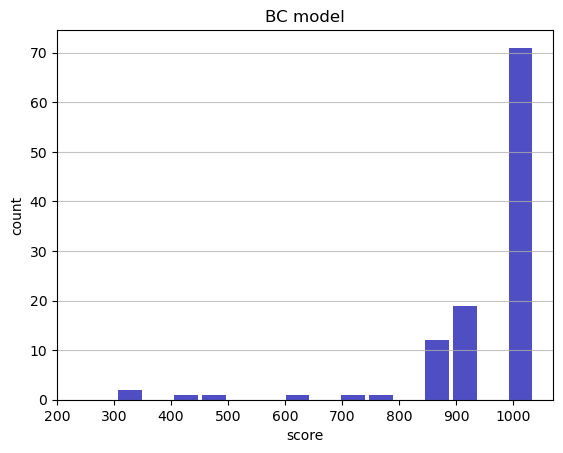

Track generation: 1271..1592 -> 321-tiles track
Epoch: 110
BC	mean: 955.43	variance: 135.10


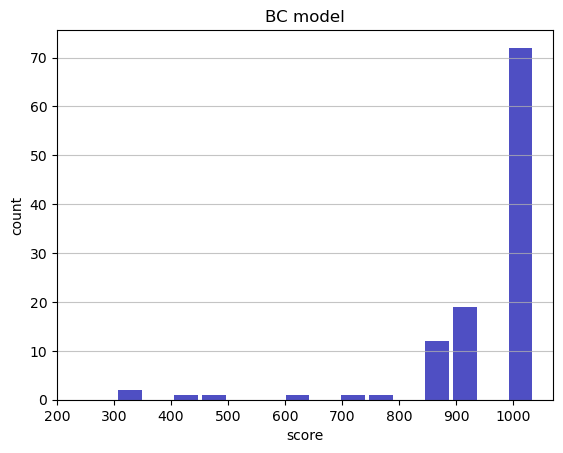

Track generation: 1295..1623 -> 328-tiles track
Epoch: 111
BC	mean: 955.72	variance: 134.52


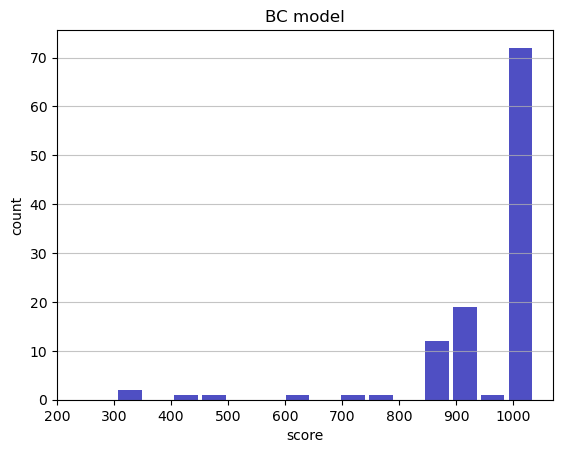

Track generation: 1422..1781 -> 359-tiles track
Epoch: 112
BC	mean: 953.75	variance: 135.52


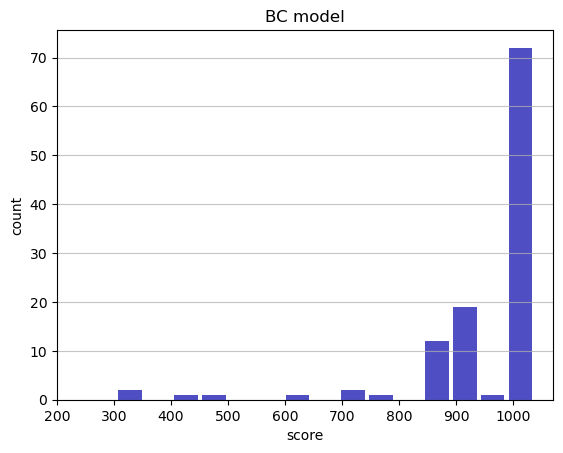

Track generation: 1220..1529 -> 309-tiles track
Epoch: 113
BC	mean: 954.33	variance: 135.06


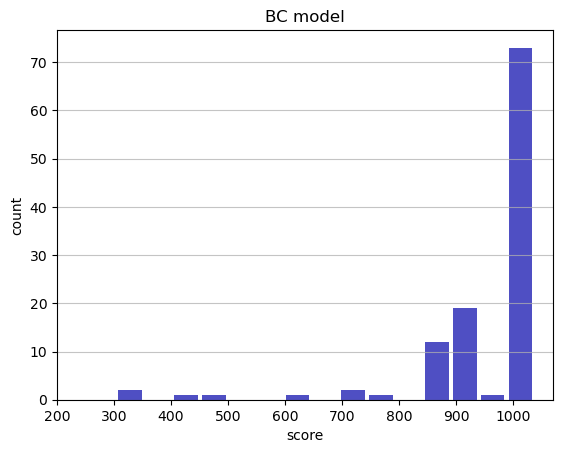

Track generation: 1259..1578 -> 319-tiles track
Epoch: 114
BC	mean: 954.88	variance: 134.59


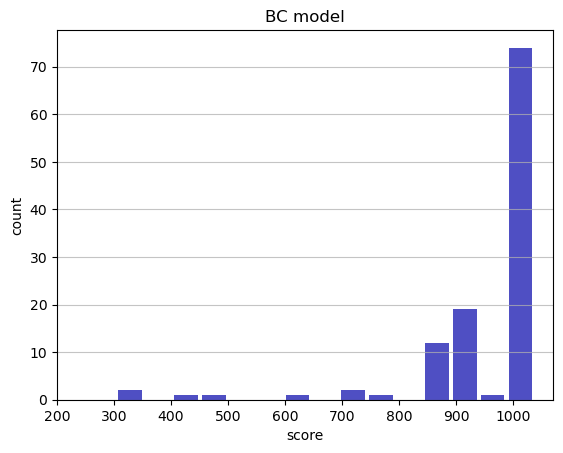

Track generation: 1107..1388 -> 281-tiles track
Epoch: 115
BC	mean: 955.50	variance: 134.17


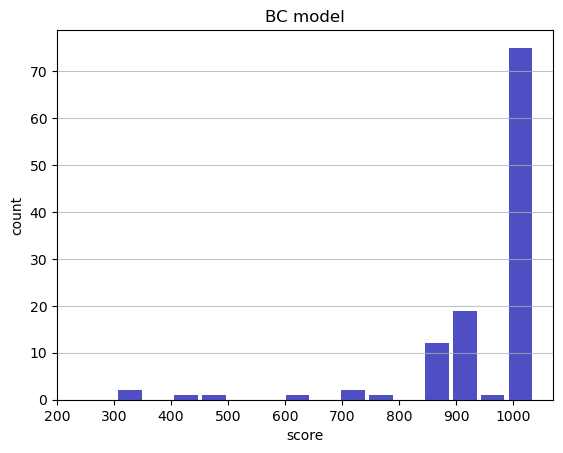

Track generation: 1114..1396 -> 282-tiles track
Epoch: 116
BC	mean: 956.14	variance: 133.77


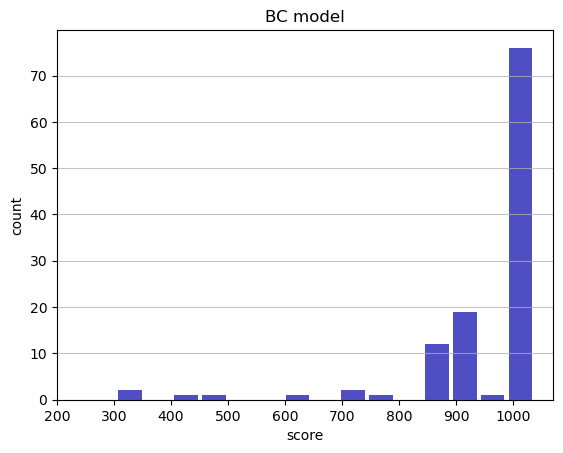

Track generation: 1099..1378 -> 279-tiles track
Epoch: 117
BC	mean: 955.73	variance: 133.27


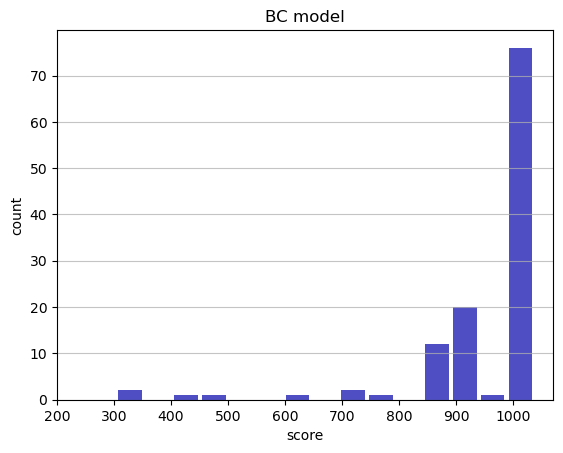

Track generation: 1354..1705 -> 351-tiles track
Epoch: 118
BC	mean: 955.89	variance: 132.71


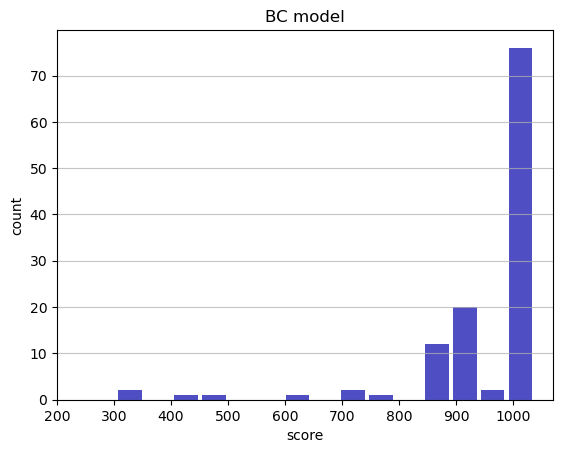

Track generation: 1150..1450 -> 300-tiles track
Epoch: 119
BC	mean: 955.31	variance: 132.30


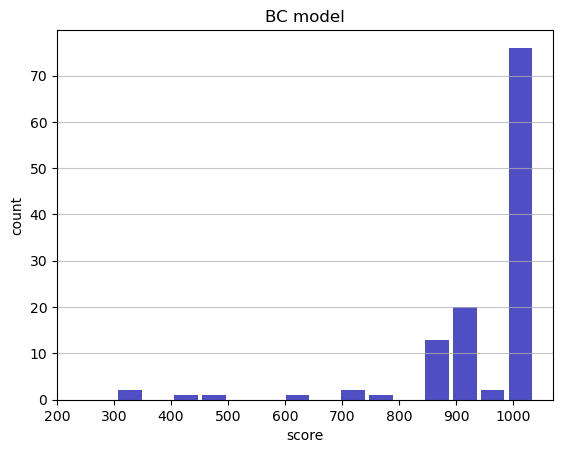

Track generation: 1147..1438 -> 291-tiles track
Epoch: 120
BC	mean: 955.91	variance: 131.91


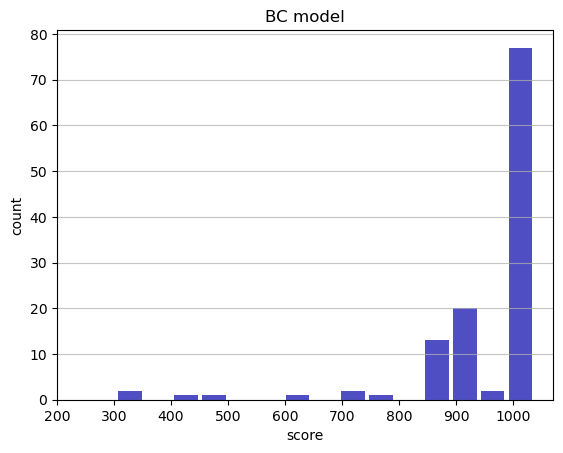

Track generation: 1141..1430 -> 289-tiles track
Epoch: 121
BC	mean: 955.49	variance: 131.44


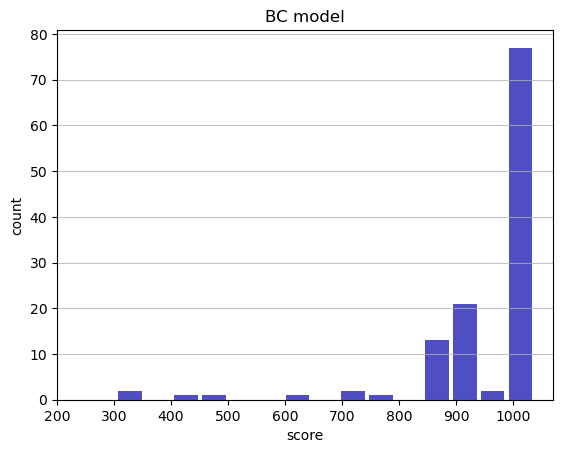

Track generation: 1128..1413 -> 285-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1359..1703 -> 344-tiles track
Epoch: 122
BC	mean: 950.98	variance: 139.96


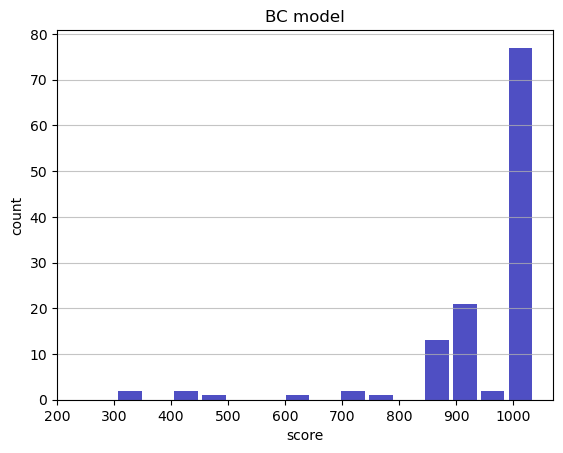

Track generation: 1098..1385 -> 287-tiles track
Epoch: 123
BC	mean: 950.52	variance: 139.48


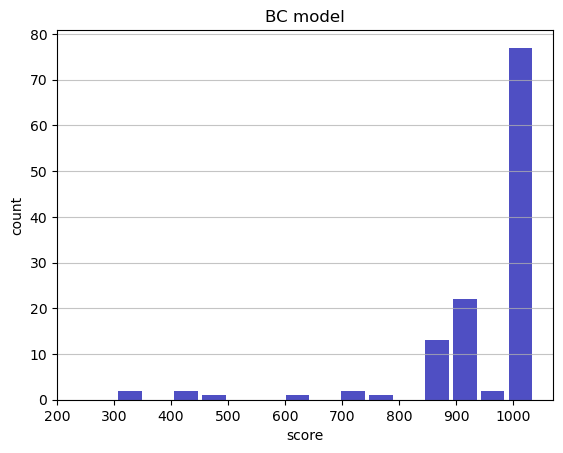

Track generation: 1168..1464 -> 296-tiles track
Epoch: 124
BC	mean: 951.13	variance: 139.08


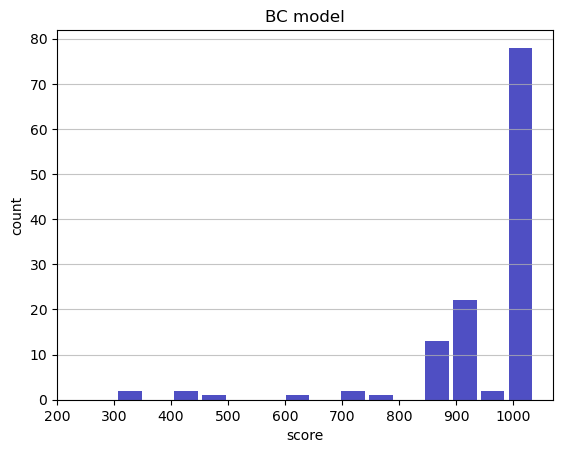

Track generation: 1072..1344 -> 272-tiles track
Epoch: 125
BC	mean: 951.74	variance: 138.69


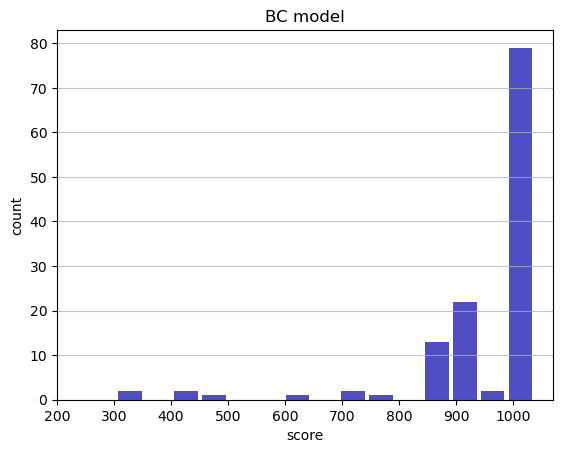

Track generation: 1378..1726 -> 348-tiles track
Epoch: 126
BC	mean: 948.13	variance: 143.91


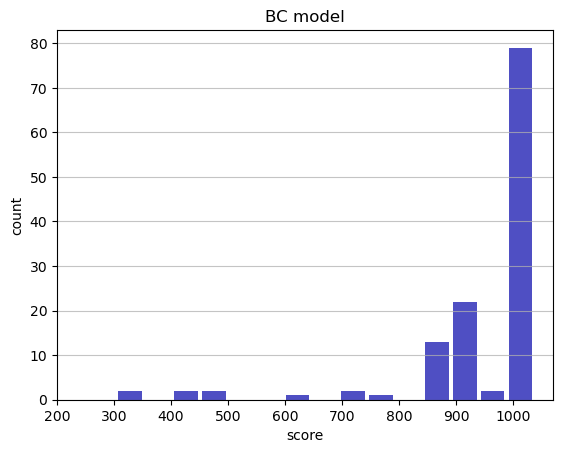

Track generation: 1074..1346 -> 272-tiles track
Epoch: 127
BC	mean: 948.79	variance: 143.54


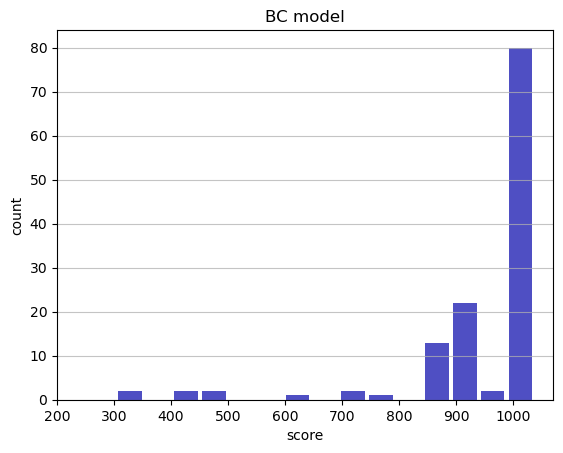

Track generation: 982..1238 -> 256-tiles track
Epoch: 128
BC	mean: 948.39	variance: 143.04


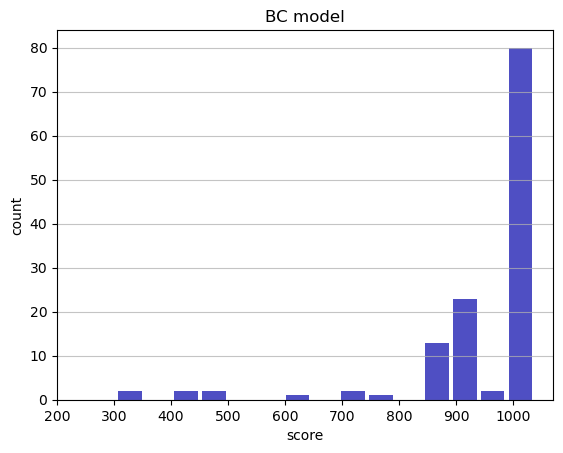

Track generation: 1219..1531 -> 312-tiles track
Epoch: 129
BC	mean: 944.17	variance: 150.27


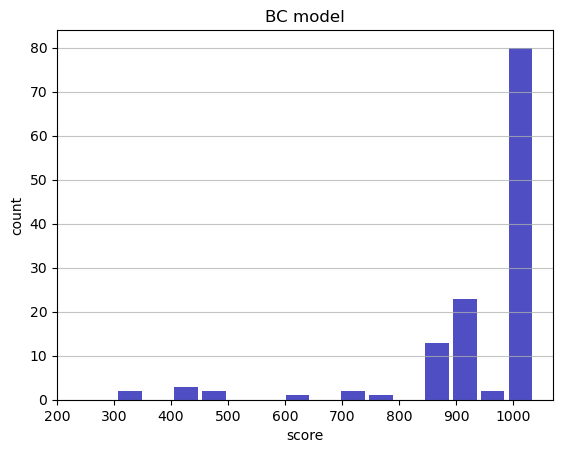

Track generation: 1119..1403 -> 284-tiles track
Epoch: 130
BC	mean: 943.83	variance: 149.75


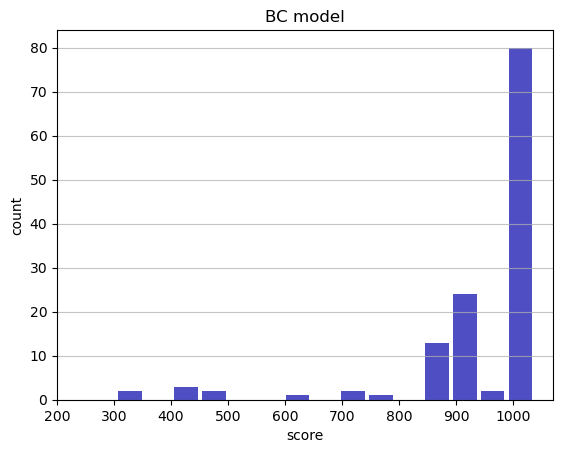

Track generation: 1170..1474 -> 304-tiles track
Epoch: 131
BC	mean: 943.53	variance: 149.21


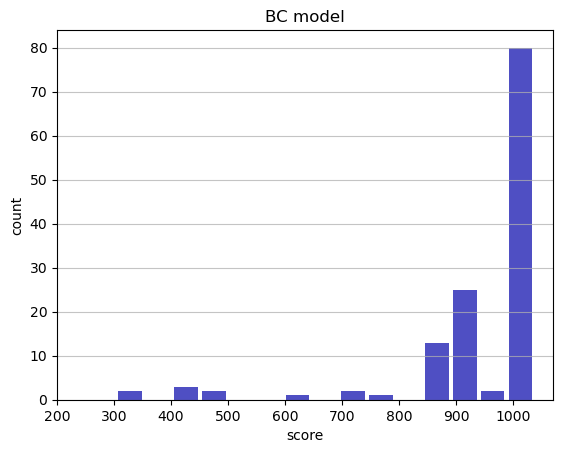

Track generation: 1019..1279 -> 260-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1073..1346 -> 273-tiles track
Epoch: 132
BC	mean: 943.19	variance: 148.70


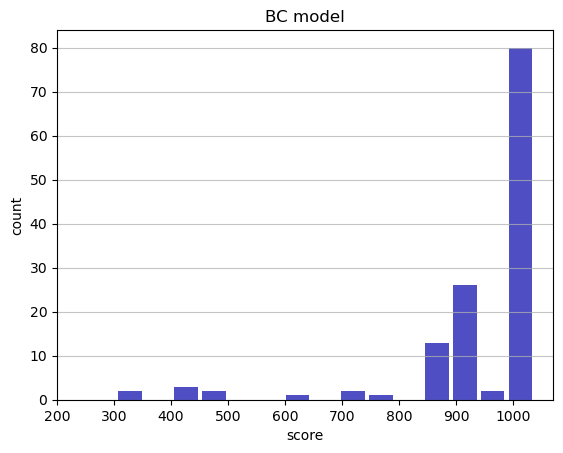

Track generation: 1199..1503 -> 304-tiles track
Epoch: 133
BC	mean: 943.76	variance: 148.28


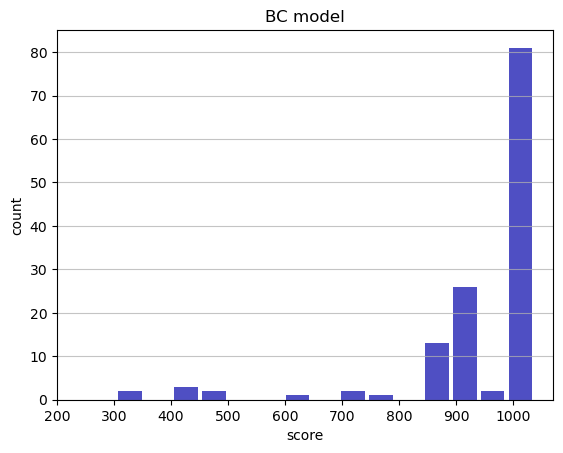

Track generation: 1084..1359 -> 275-tiles track
Epoch: 134
BC	mean: 943.54	variance: 147.75


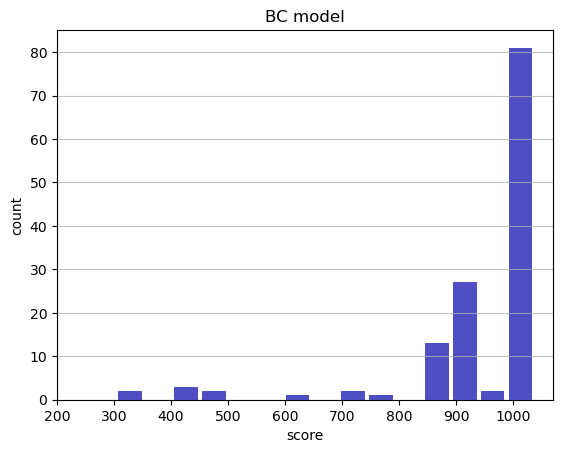

Track generation: 1244..1559 -> 315-tiles track
Epoch: 135
BC	mean: 943.25	variance: 147.24


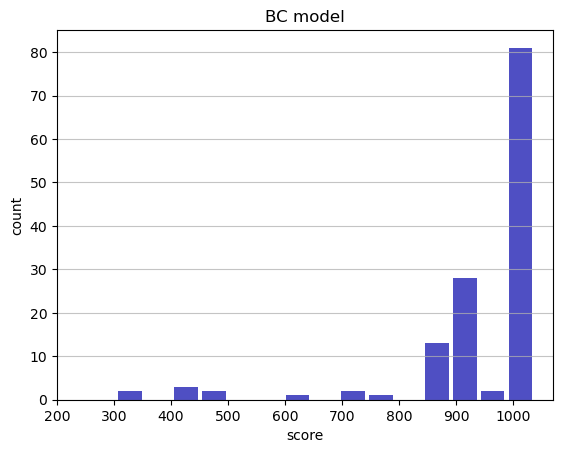

Track generation: 1254..1572 -> 318-tiles track
Epoch: 136
BC	mean: 943.80	variance: 146.84


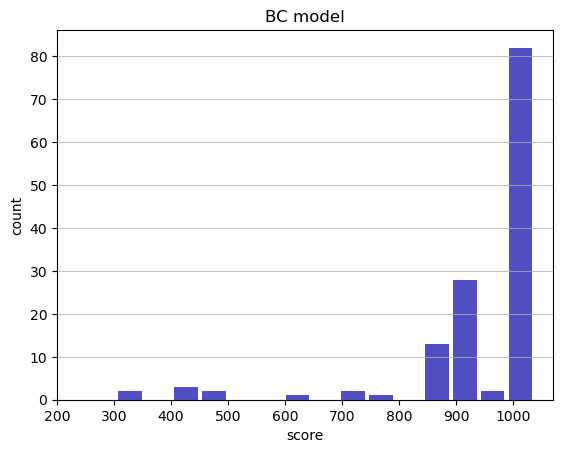

Track generation: 1028..1291 -> 263-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1013..1281 -> 268-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1103..1383 -> 280-tiles track
Epoch: 137
BC	mean: 944.46	variance: 146.50


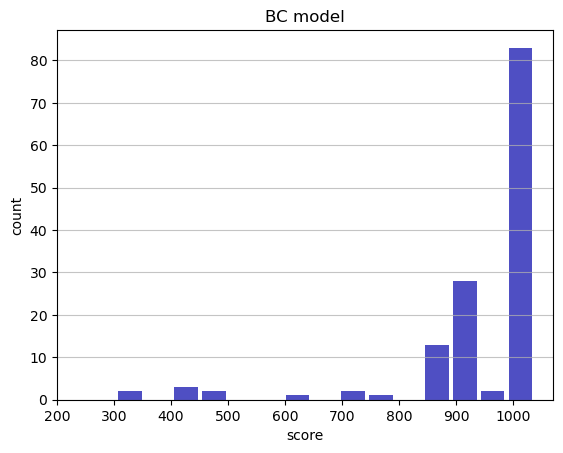

Track generation: 1067..1341 -> 274-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1104..1384 -> 280-tiles track
Epoch: 138
BC	mean: 945.08	variance: 146.15


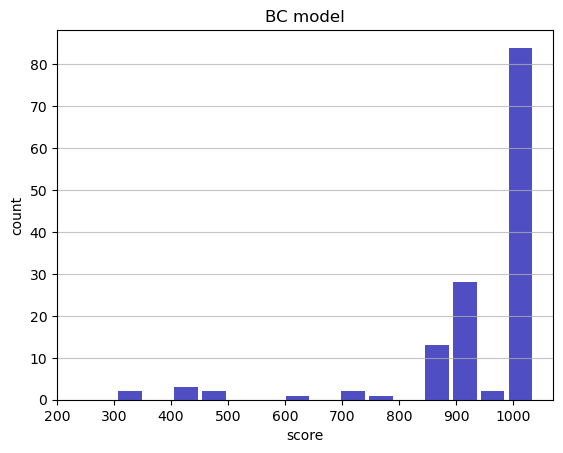

Track generation: 1218..1527 -> 309-tiles track
Epoch: 139
BC	mean: 944.78	variance: 145.67


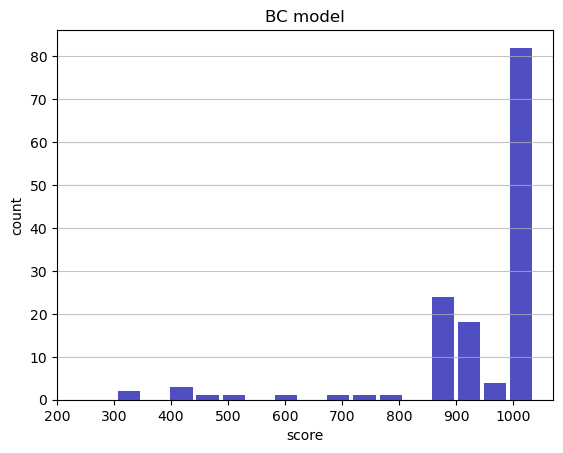

Track generation: 1159..1460 -> 301-tiles track
Epoch: 140
BC	mean: 945.36	variance: 145.31


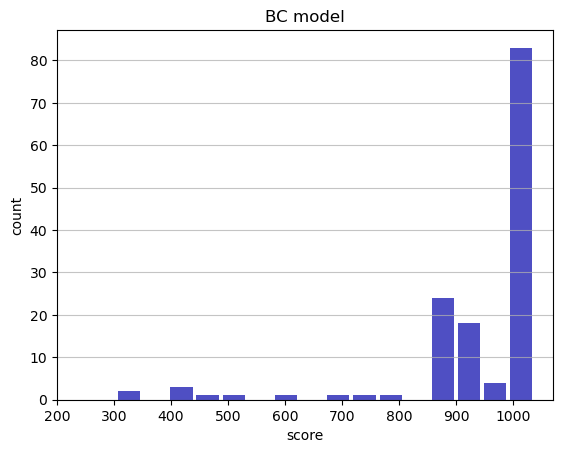

Track generation: 1151..1442 -> 291-tiles track
Epoch: 141
BC	mean: 945.91	variance: 144.94


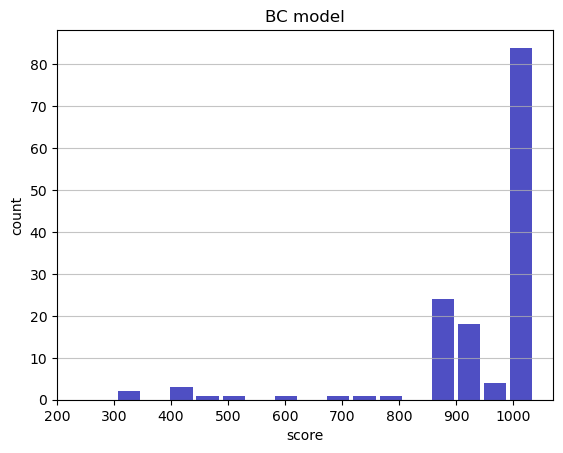

Track generation: 1423..1783 -> 360-tiles track
Epoch: 142
BC	mean: 946.32	variance: 144.51


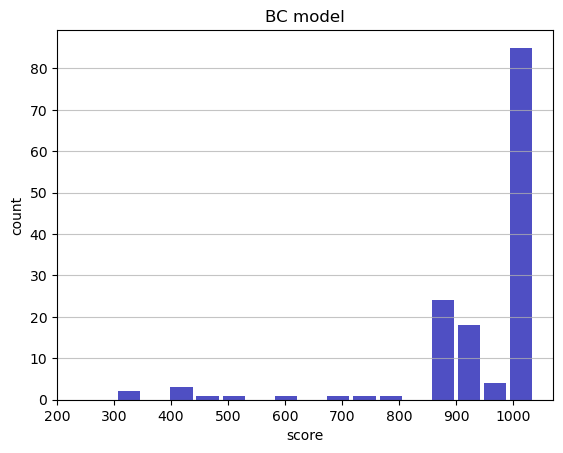

Track generation: 1168..1464 -> 296-tiles track
Epoch: 143
BC	mean: 946.87	variance: 144.15


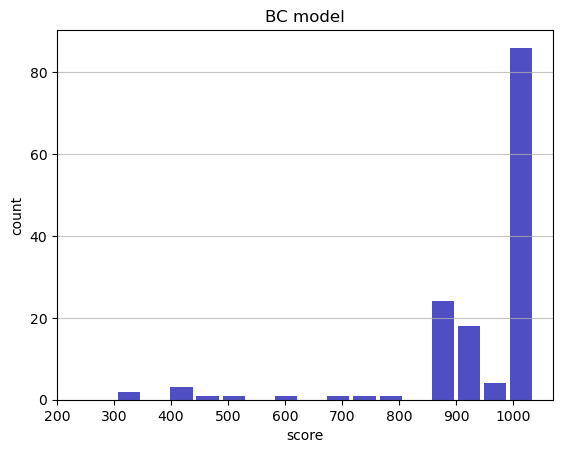

Track generation: 1057..1332 -> 275-tiles track
Epoch: 144
BC	mean: 947.44	variance: 143.81


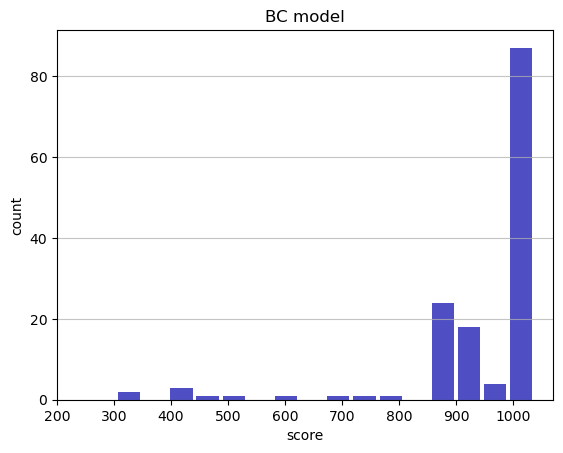

Track generation: 1219..1527 -> 308-tiles track
Epoch: 145
BC	mean: 947.95	variance: 143.45


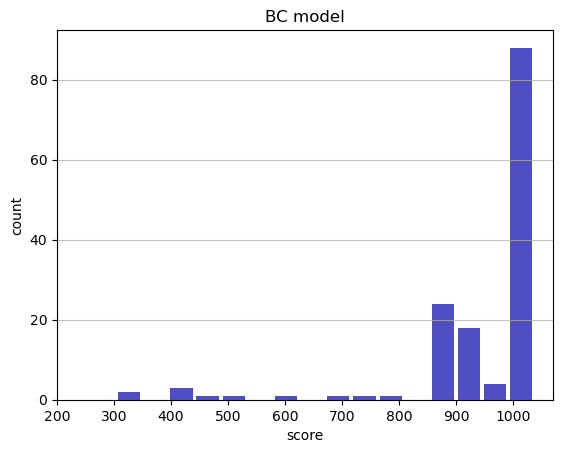

Track generation: 1115..1398 -> 283-tiles track
Epoch: 146
BC	mean: 943.84	variance: 151.28


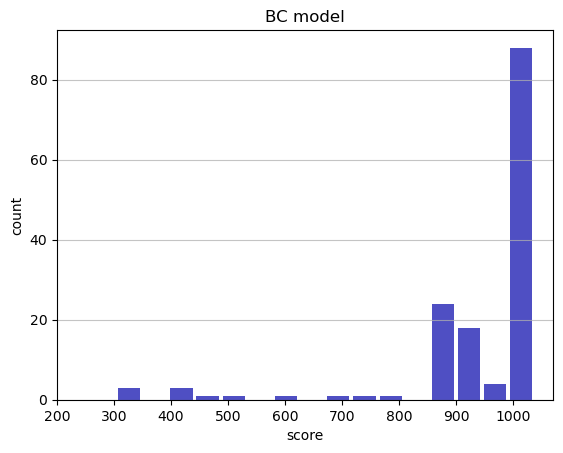

Track generation: 1180..1479 -> 299-tiles track
Epoch: 147
BC	mean: 943.04	variance: 151.08


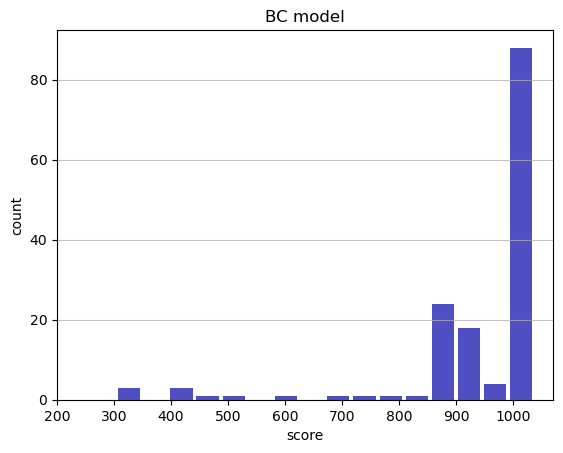

Track generation: 1185..1495 -> 310-tiles track
Epoch: 148
BC	mean: 943.54	variance: 150.68


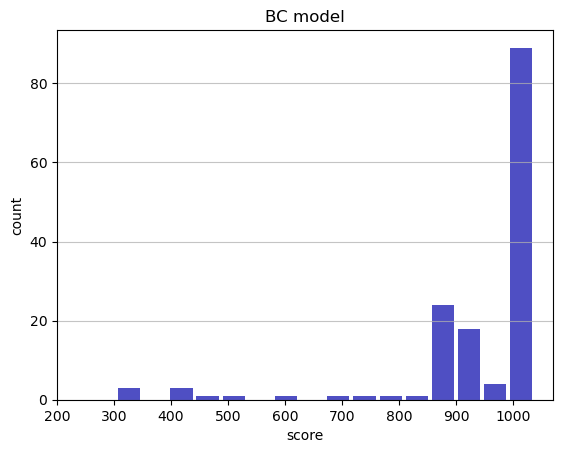

Track generation: 1175..1473 -> 298-tiles track
Epoch: 149
BC	mean: 944.08	variance: 150.33


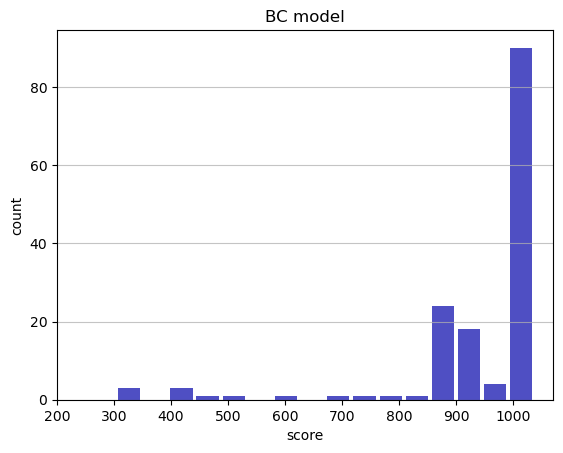

Track generation: 971..1218 -> 247-tiles track
Epoch: 150
BC	mean: 944.71	variance: 150.02


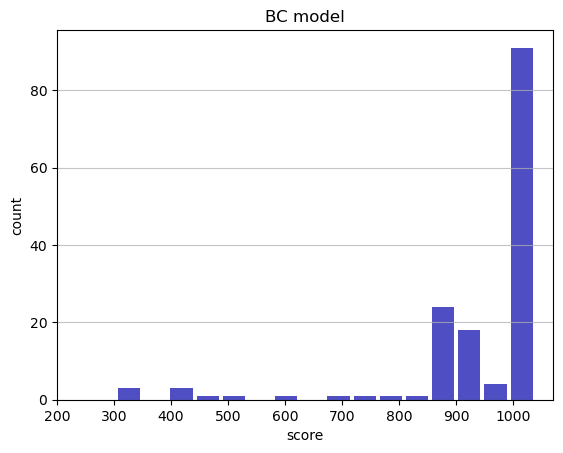

Track generation: 1259..1578 -> 319-tiles track
Epoch: 151
BC	mean: 944.36	variance: 149.58


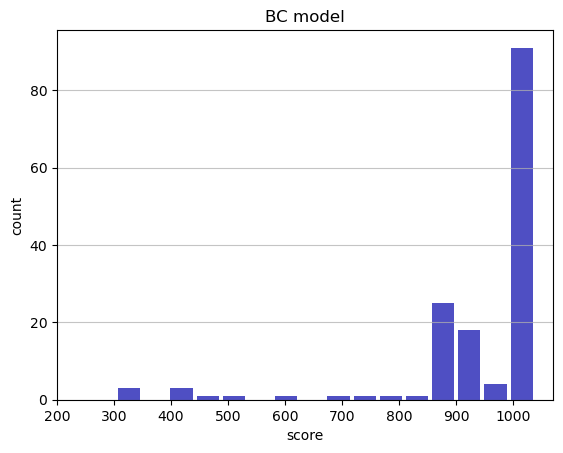

Track generation: 1039..1303 -> 264-tiles track
Epoch: 152
BC	mean: 944.16	variance: 149.11


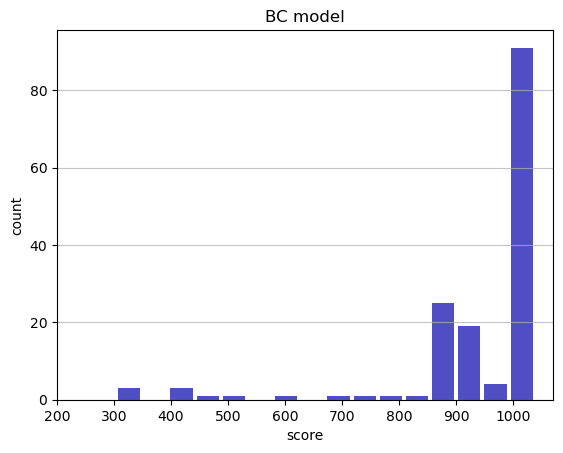

Track generation: 1079..1353 -> 274-tiles track
Epoch: 153
BC	mean: 944.76	variance: 148.80


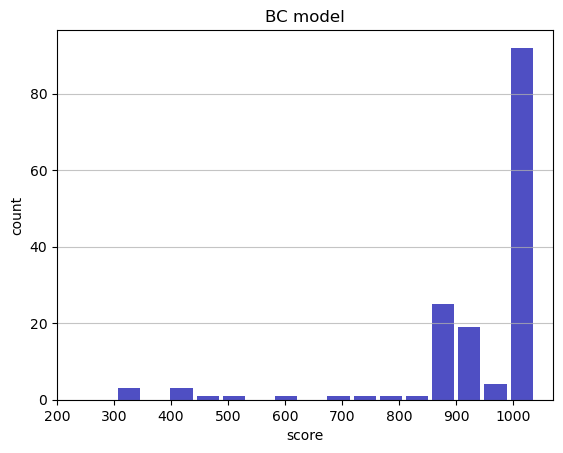

Track generation: 1007..1268 -> 261-tiles track
Epoch: 154
BC	mean: 945.33	variance: 148.49


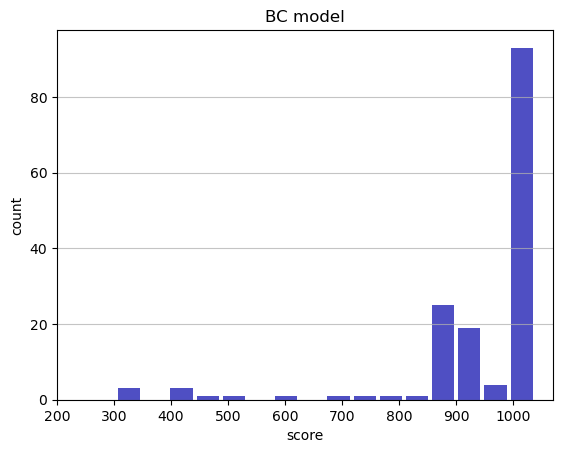

Track generation: 1185..1485 -> 300-tiles track
Epoch: 155
BC	mean: 945.85	variance: 148.15


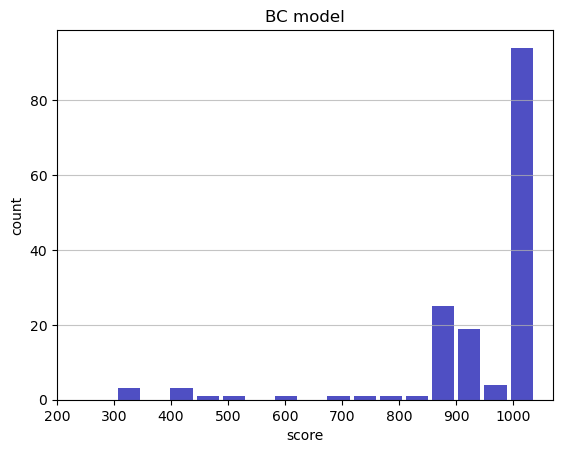

Track generation: 1165..1464 -> 299-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1023..1283 -> 260-tiles track
Epoch: 156
BC	mean: 946.41	variance: 147.83


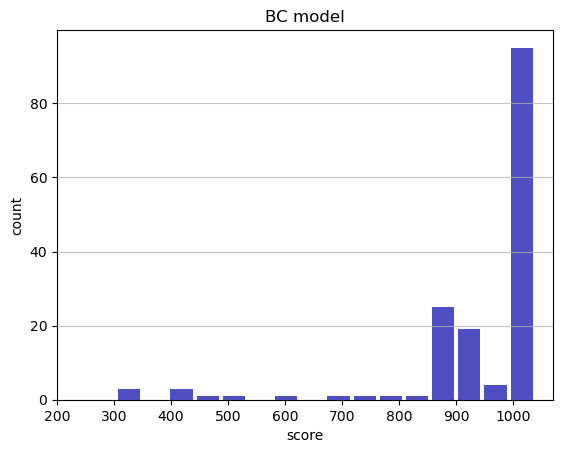

Track generation: 1142..1432 -> 290-tiles track
Epoch: 157
BC	mean: 946.92	variance: 147.50


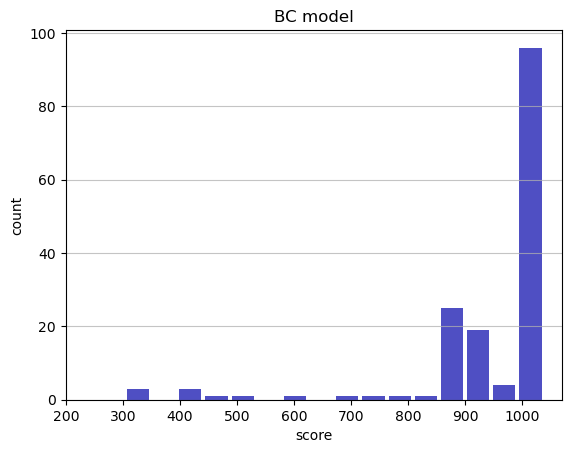

Track generation: 1276..1599 -> 323-tiles track
Epoch: 158
BC	mean: 947.38	variance: 147.15


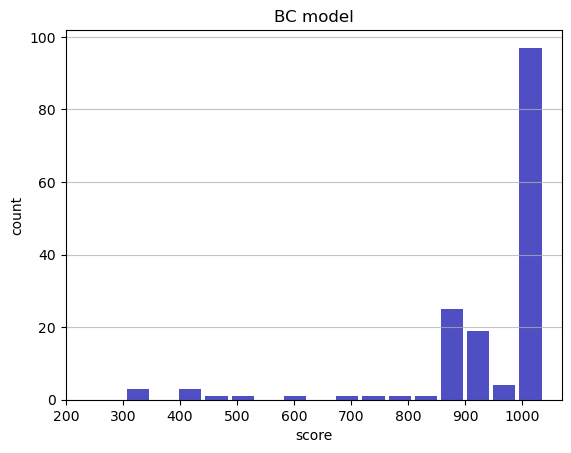

Track generation: 1142..1432 -> 290-tiles track
Epoch: 159
BC	mean: 947.90	variance: 146.83


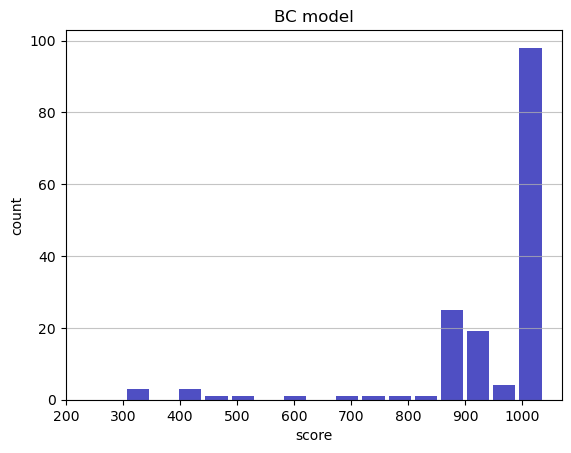

Track generation: 1031..1293 -> 262-tiles track
Epoch: 160
BC	mean: 948.44	variance: 146.53


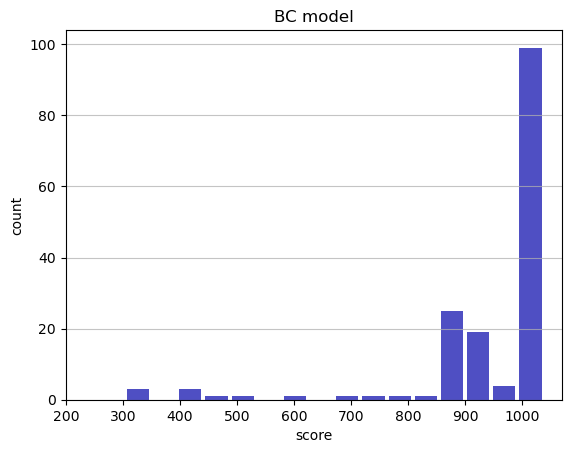

Track generation: 1164..1459 -> 295-tiles track
Epoch: 161
BC	mean: 948.19	variance: 146.11


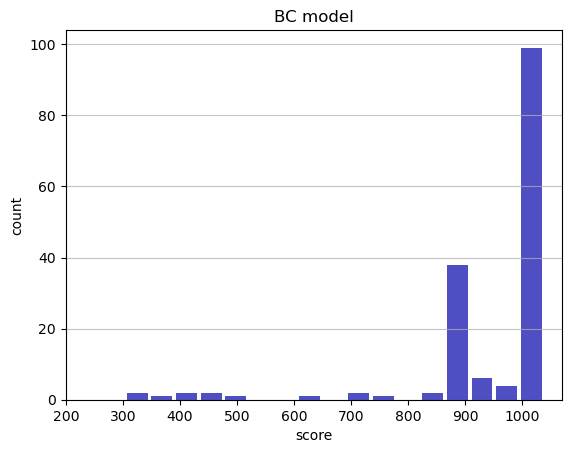

Track generation: 973..1227 -> 254-tiles track
Epoch: 162
BC	mean: 948.74	variance: 145.82


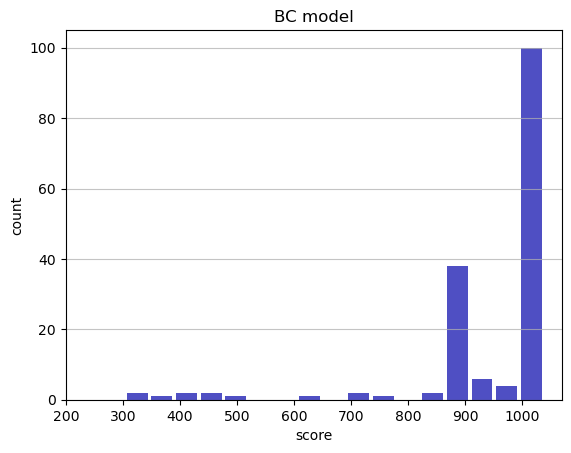

Track generation: 987..1238 -> 251-tiles track
Epoch: 163
BC	mean: 948.53	variance: 145.40


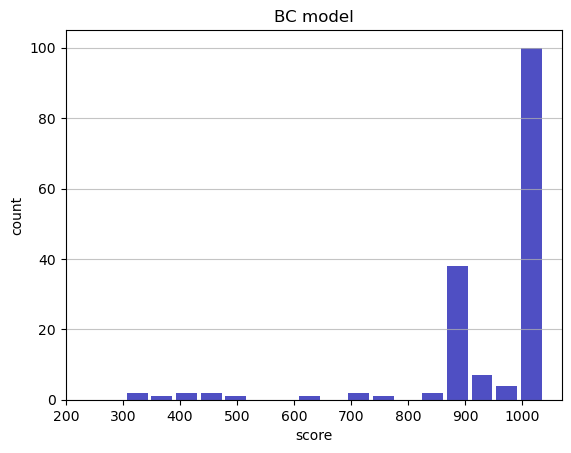

Track generation: 1201..1505 -> 304-tiles track
Epoch: 164
BC	mean: 948.62	variance: 144.96


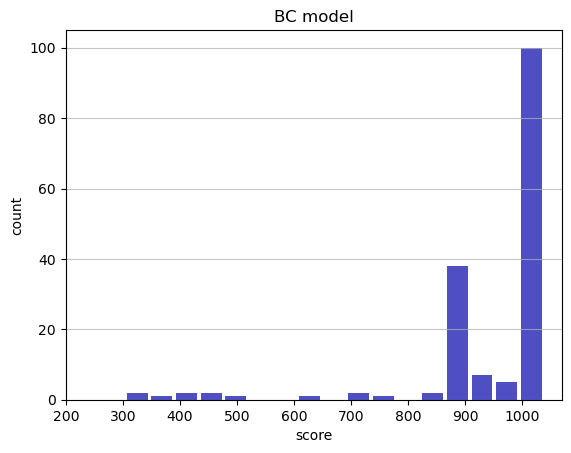

Track generation: 1054..1328 -> 274-tiles track
Epoch: 165
BC	mean: 949.11	variance: 144.66


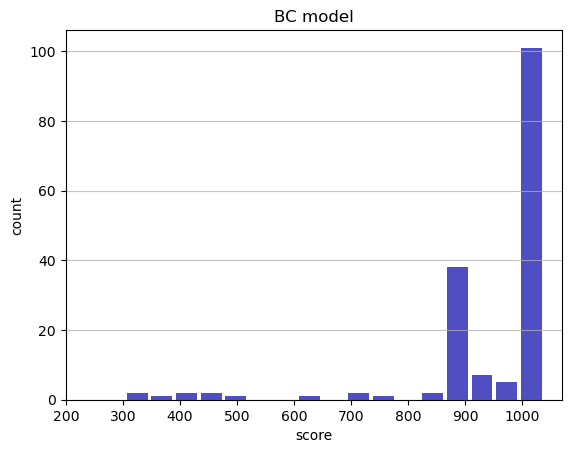

Track generation: 1036..1306 -> 270-tiles track
Epoch: 166
BC	mean: 949.58	variance: 144.35


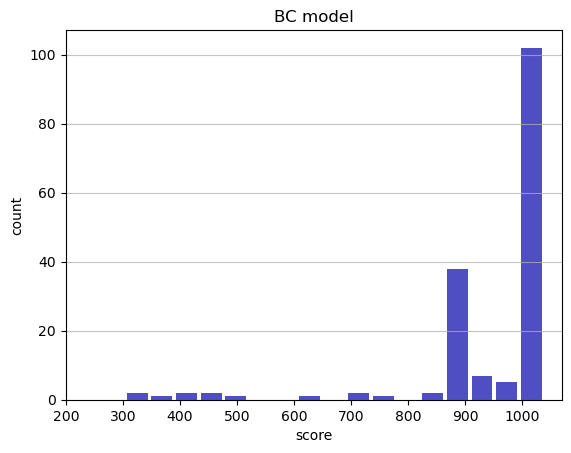

Track generation: 1209..1509 -> 300-tiles track
Epoch: 167
BC	mean: 949.13	variance: 144.03


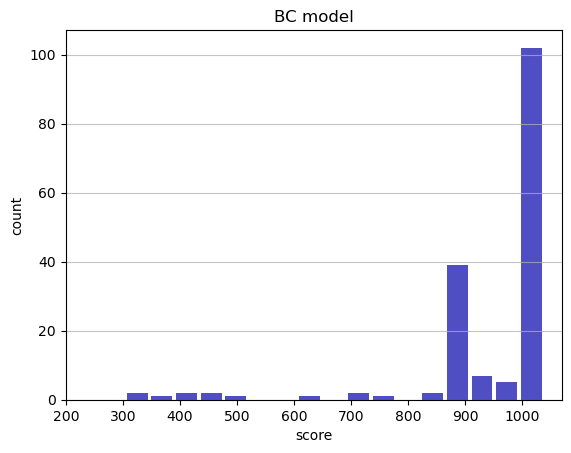

Track generation: 945..1189 -> 244-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1077..1350 -> 273-tiles track
Epoch: 168
BC	mean: 949.61	variance: 143.73


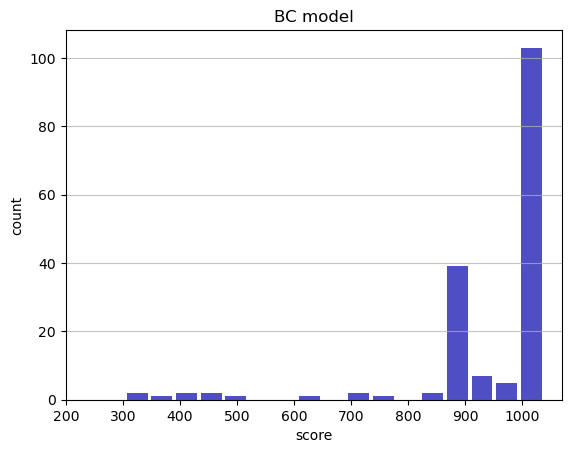

Track generation: 1118..1402 -> 284-tiles track
Epoch: 169
BC	mean: 950.10	variance: 143.45


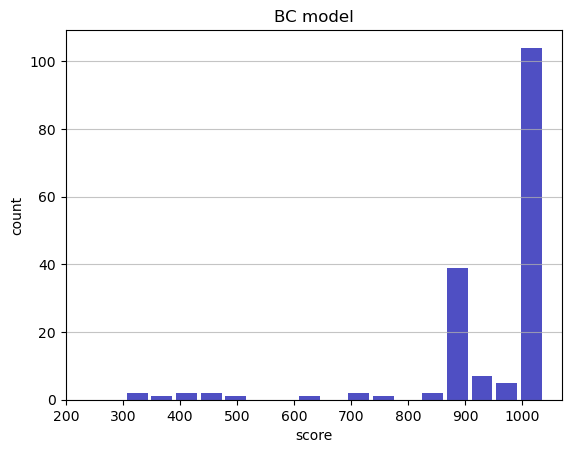

Track generation: 1233..1548 -> 315-tiles track
Epoch: 170
BC	mean: 950.46	variance: 143.10


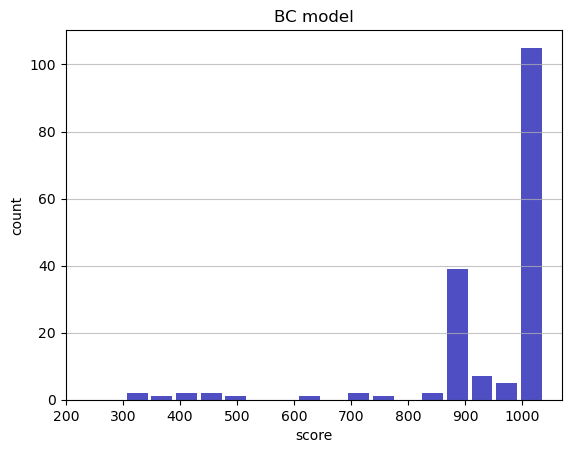

Track generation: 1125..1410 -> 285-tiles track
Epoch: 171
BC	mean: 950.93	variance: 142.81


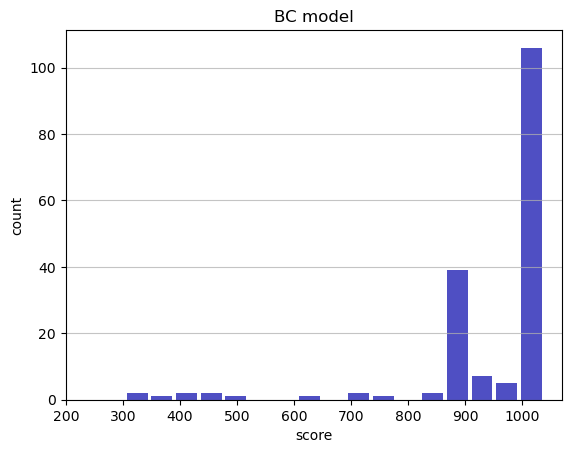

Track generation: 1135..1423 -> 288-tiles track
Epoch: 172
BC	mean: 951.36	variance: 142.51


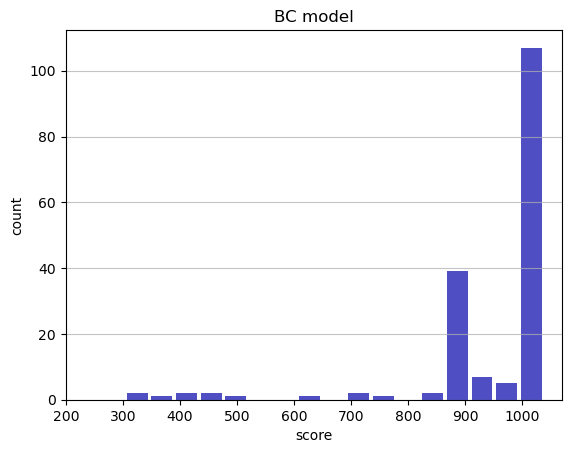

Track generation: 1147..1441 -> 294-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1273..1595 -> 322-tiles track
Epoch: 173
BC	mean: 950.09	variance: 143.07


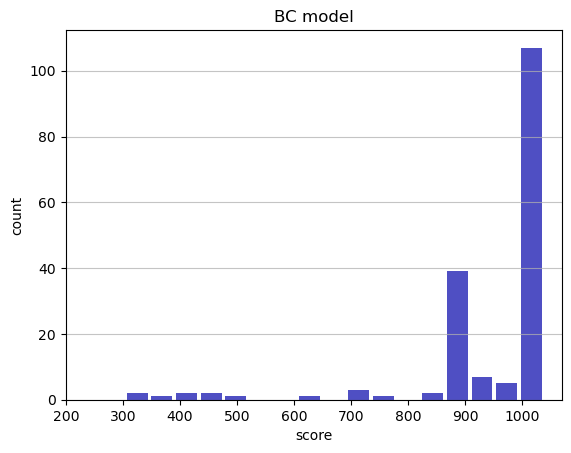

Track generation: 1071..1343 -> 272-tiles track
Epoch: 174
BC	mean: 950.55	variance: 142.79


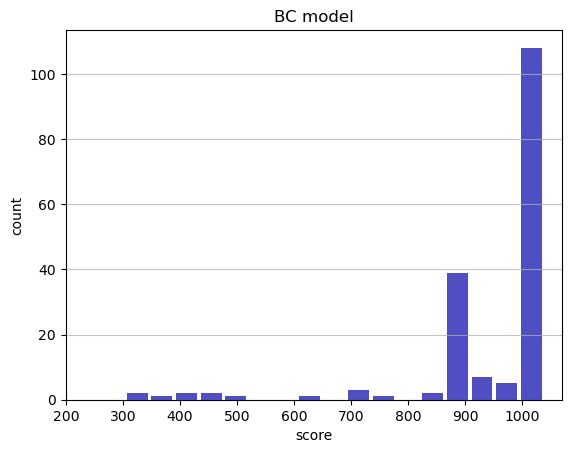

Track generation: 1304..1634 -> 330-tiles track
Epoch: 175
BC	mean: 950.25	variance: 142.43


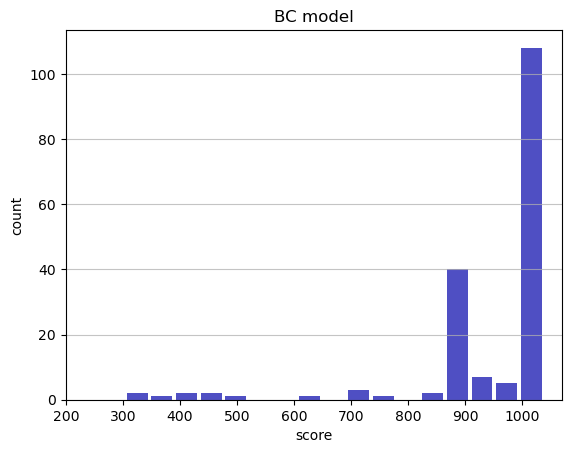

Track generation: 1252..1569 -> 317-tiles track
Epoch: 176
BC	mean: 950.66	variance: 142.13


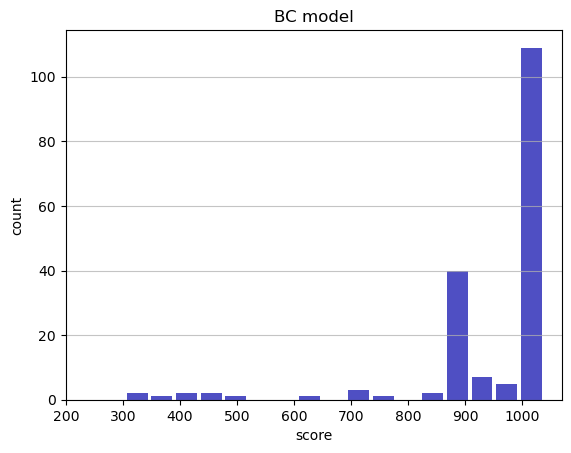

Track generation: 1210..1524 -> 314-tiles track
Epoch: 177
BC	mean: 951.06	variance: 141.83


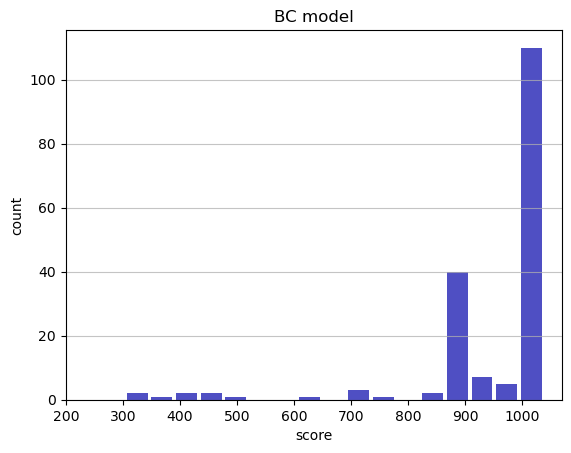

Track generation: 1039..1303 -> 264-tiles track
Epoch: 178
BC	mean: 951.50	variance: 141.56


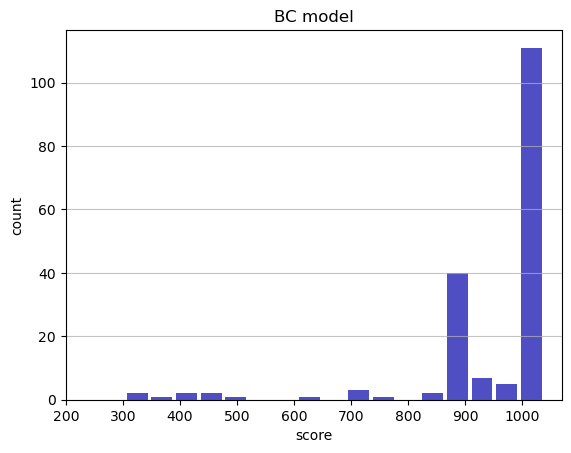

Track generation: 1268..1589 -> 321-tiles track
Epoch: 179
BC	mean: 951.89	variance: 141.25


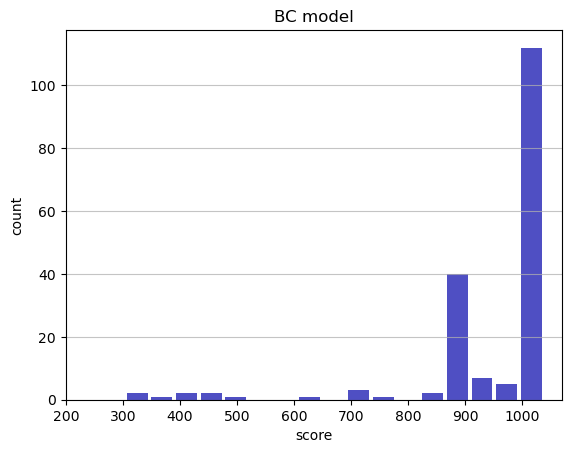

Track generation: 1204..1509 -> 305-tiles track
Epoch: 180
BC	mean: 952.28	variance: 140.96


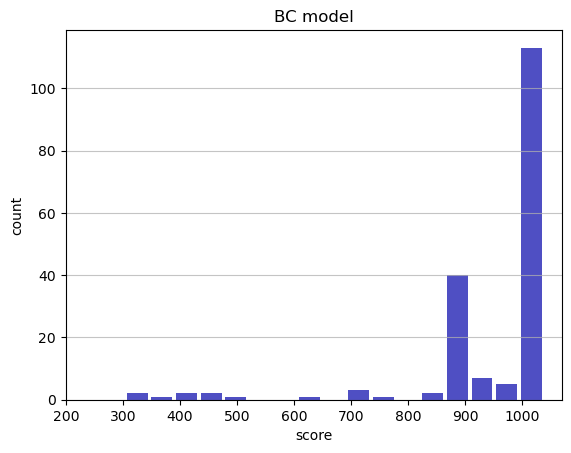

Track generation: 1172..1469 -> 297-tiles track
Epoch: 181
BC	mean: 952.69	variance: 140.67


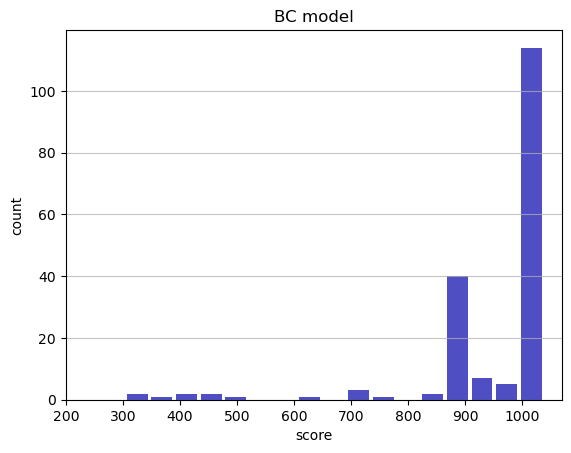

Track generation: 1106..1386 -> 280-tiles track
Epoch: 182
BC	mean: 953.10	variance: 140.39


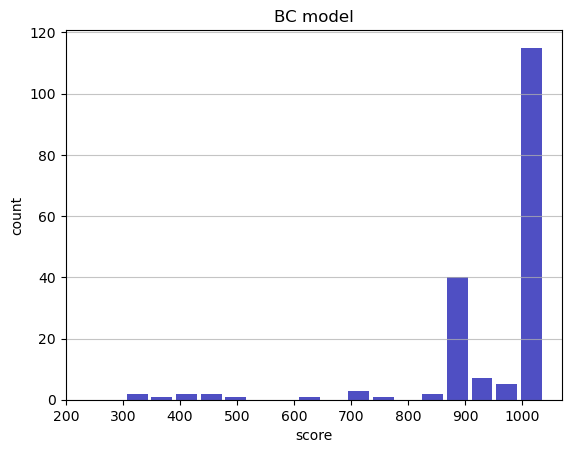

Track generation: 1413..1770 -> 357-tiles track
Epoch: 183
BC	mean: 953.31	variance: 140.04


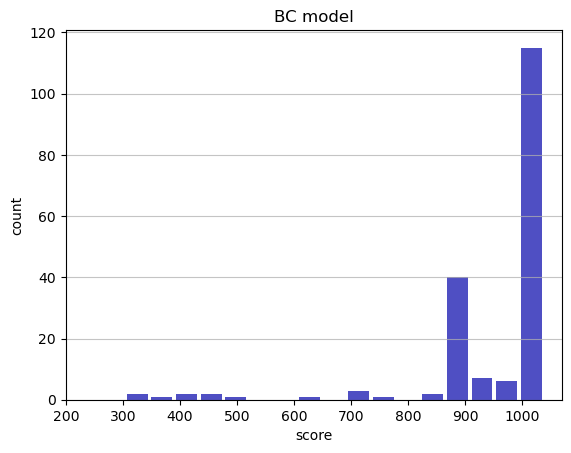

Track generation: 1267..1588 -> 321-tiles track
Epoch: 184
BC	mean: 952.85	variance: 139.79


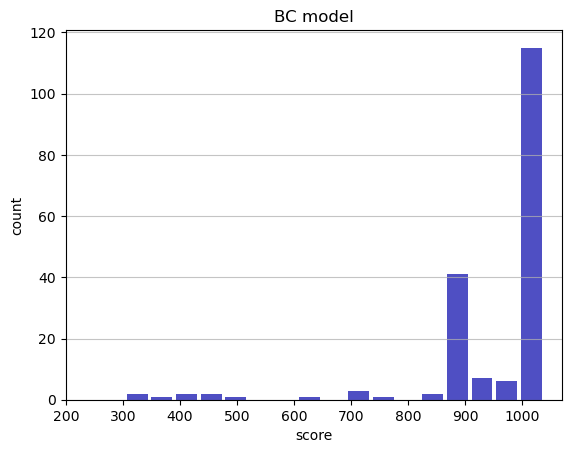

Track generation: 1214..1520 -> 306-tiles track
Epoch: 185
BC	mean: 953.24	variance: 139.52


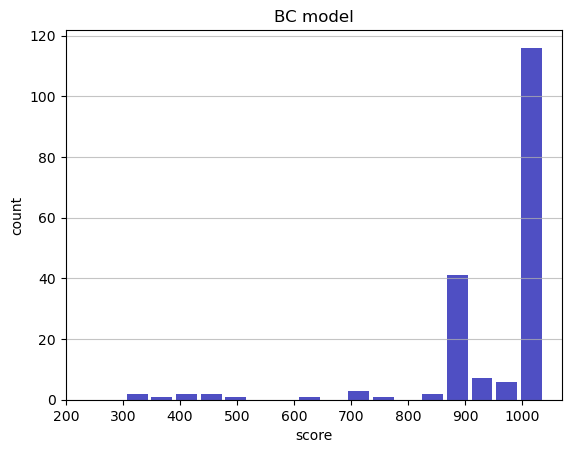

Track generation: 1299..1628 -> 329-tiles track
Epoch: 186
BC	mean: 953.59	variance: 139.22


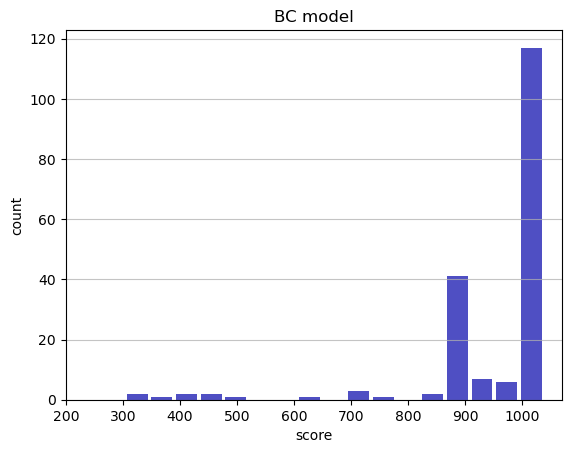

Track generation: 1063..1335 -> 272-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1131..1418 -> 287-tiles track
Epoch: 187
BC	mean: 953.28	variance: 138.91


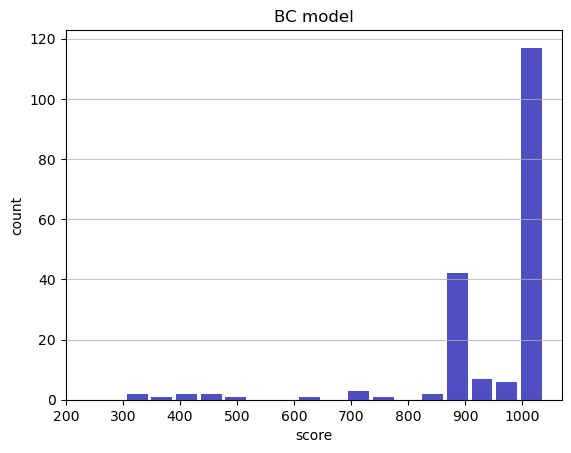

Track generation: 920..1158 -> 238-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1191..1493 -> 302-tiles track
Epoch: 188
BC	mean: 953.68	variance: 138.64


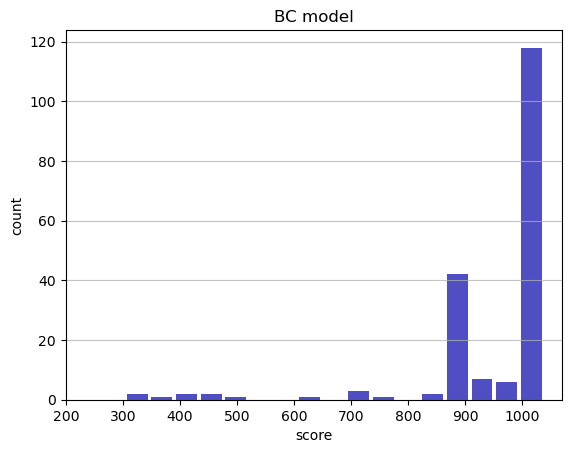

Track generation: 1144..1434 -> 290-tiles track
Epoch: 189
BC	mean: 953.44	variance: 138.31


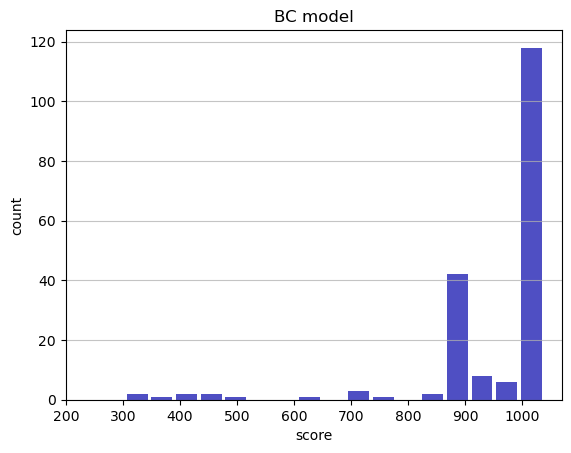

Track generation: 906..1141 -> 235-tiles track
Epoch: 190
BC	mean: 953.91	variance: 138.10


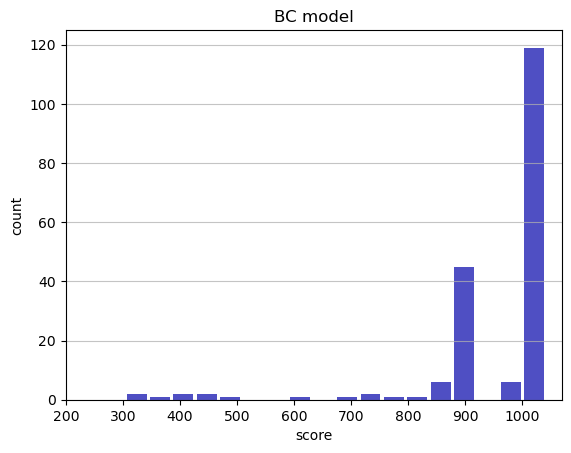

Track generation: 1242..1562 -> 320-tiles track
Epoch: 191
BC	mean: 953.55	variance: 137.83


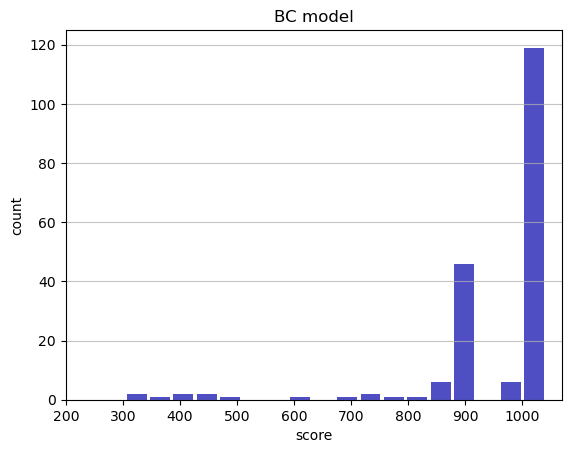

Track generation: 1066..1338 -> 272-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1155..1457 -> 302-tiles track
Epoch: 192
BC	mean: 950.91	variance: 142.21


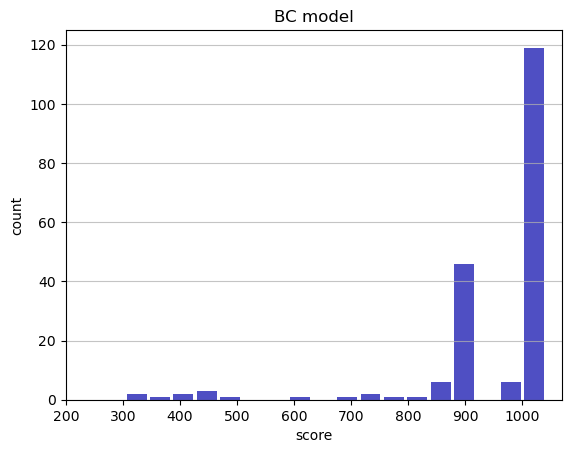

Track generation: 1019..1278 -> 259-tiles track
Epoch: 193
BC	mean: 951.35	variance: 141.97


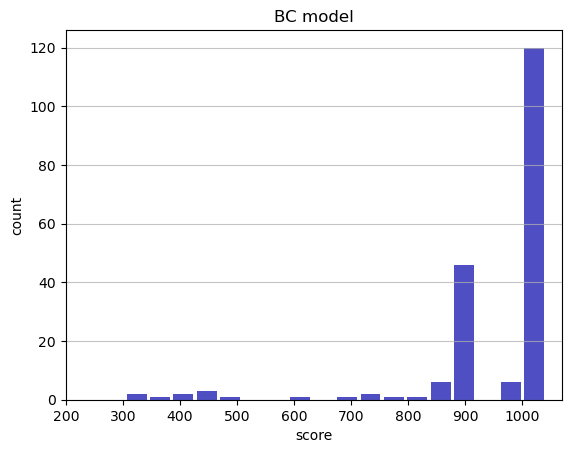

Track generation: 1185..1489 -> 304-tiles track
Epoch: 194
BC	mean: 951.01	variance: 141.68


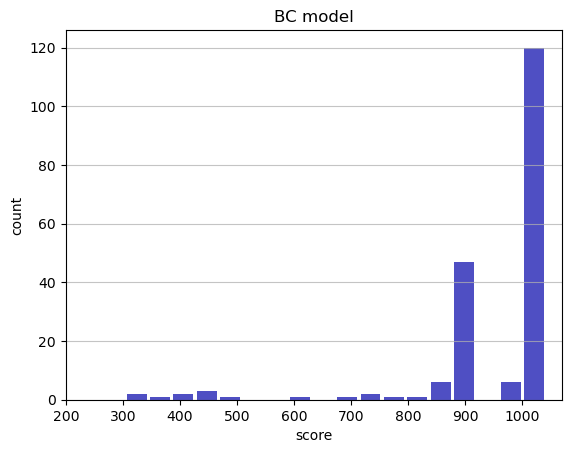

Track generation: 1071..1351 -> 280-tiles track
Epoch: 195
BC	mean: 950.79	variance: 141.35


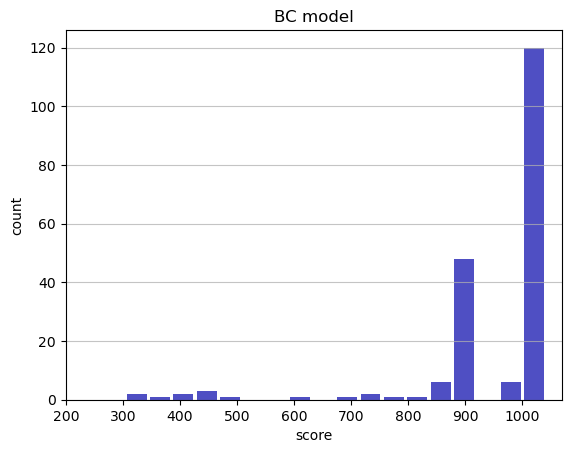

Track generation: 1135..1423 -> 288-tiles track
Epoch: 196
BC	mean: 951.17	variance: 141.09


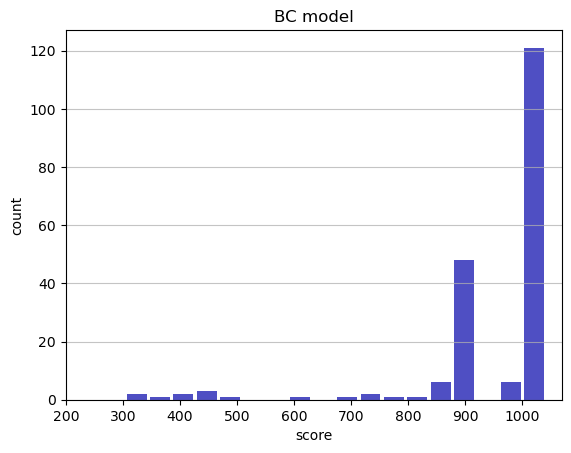

Track generation: 1266..1587 -> 321-tiles track
Epoch: 197
BC	mean: 951.49	variance: 140.80


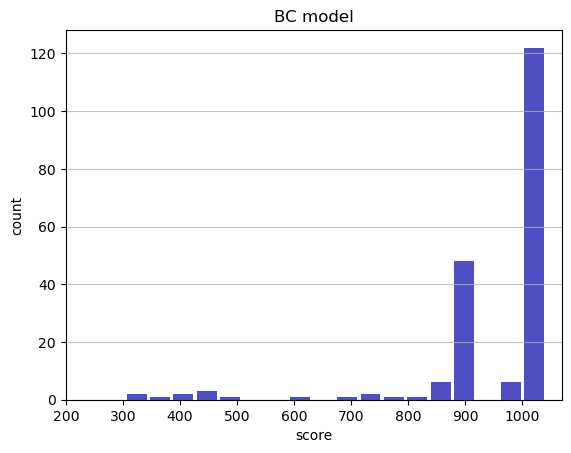

Track generation: 952..1199 -> 247-tiles track
Epoch: 198
BC	mean: 951.90	variance: 140.56


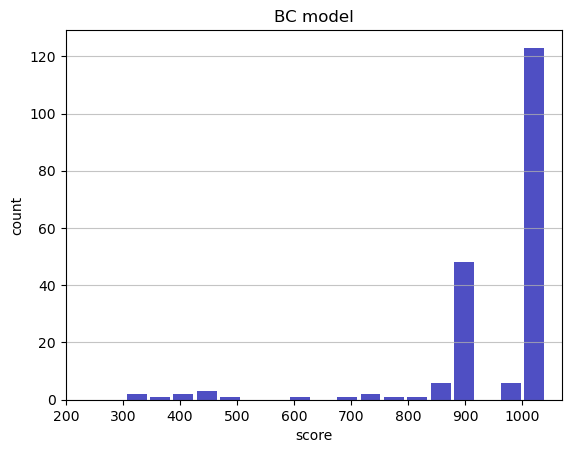

Track generation: 1108..1389 -> 281-tiles track
Epoch: 199
BC	mean: 952.32	variance: 140.33


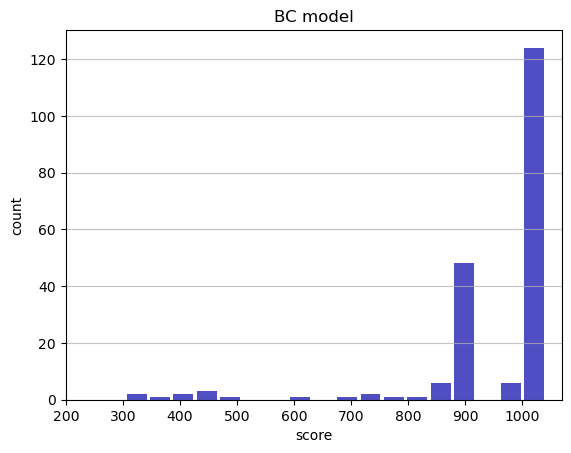

Track generation: 1238..1552 -> 314-tiles track
Epoch: 200
BC	mean: 952.63	variance: 140.05


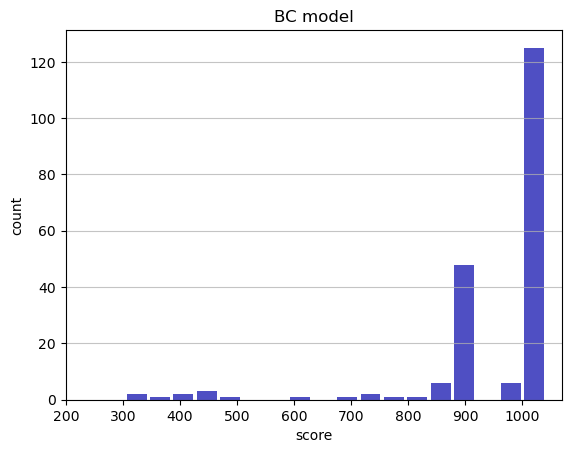

Track generation: 1203..1508 -> 305-tiles track
Epoch: 201
BC	mean: 952.96	variance: 139.78


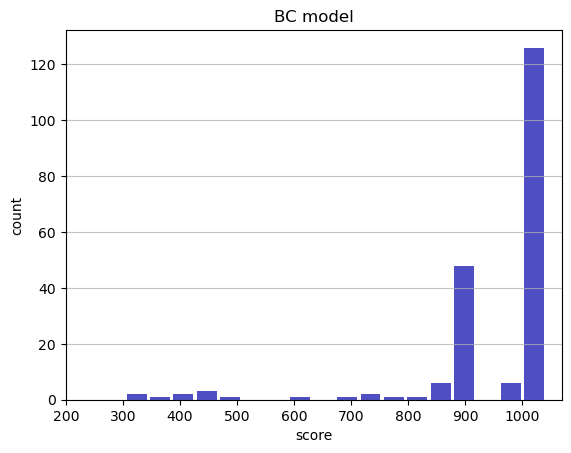

Track generation: 1534..1922 -> 388-tiles track
Epoch: 202
BC	mean: 952.72	variance: 139.48


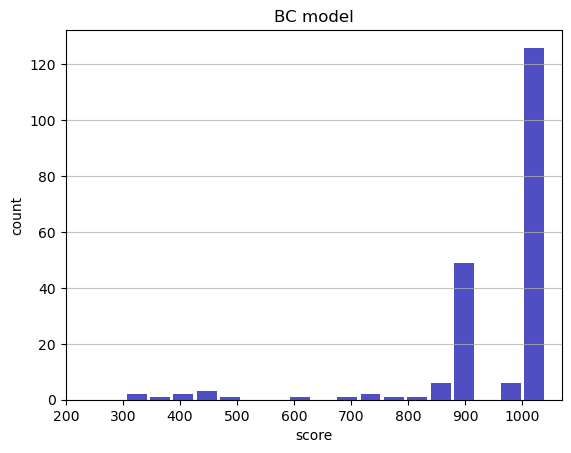

Track generation: 1124..1409 -> 285-tiles track
Epoch: 203
BC	mean: 953.09	variance: 139.23


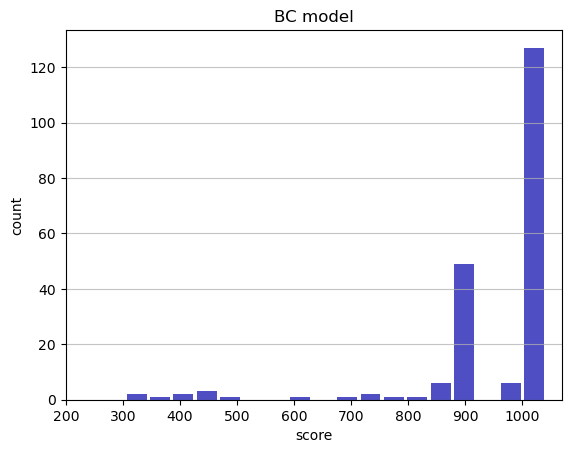

Track generation: 1012..1278 -> 266-tiles track
Epoch: 204
BC	mean: 952.92	variance: 138.91


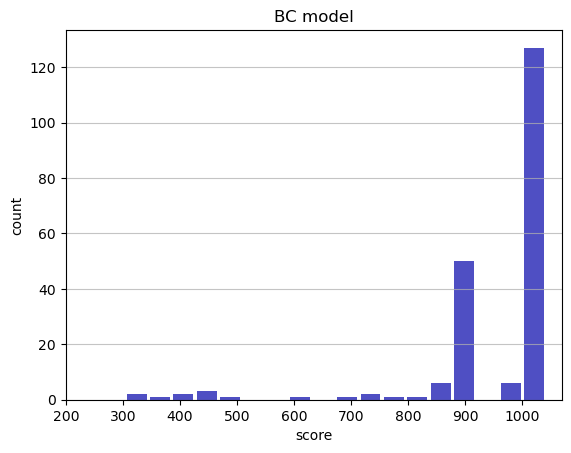

Track generation: 1295..1623 -> 328-tiles track
Epoch: 205
BC	mean: 952.63	variance: 138.63


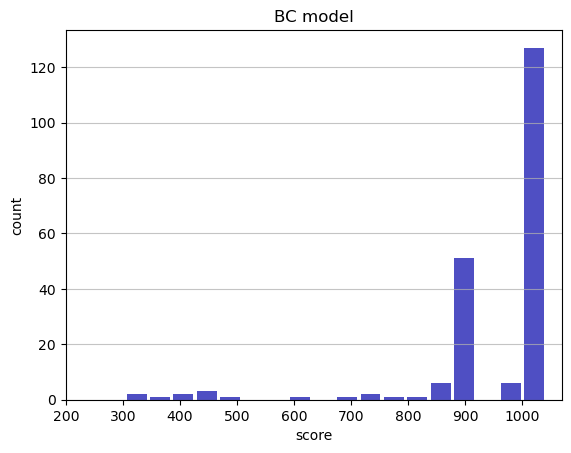

Track generation: 1100..1386 -> 286-tiles track
Epoch: 206
BC	mean: 952.97	variance: 138.38


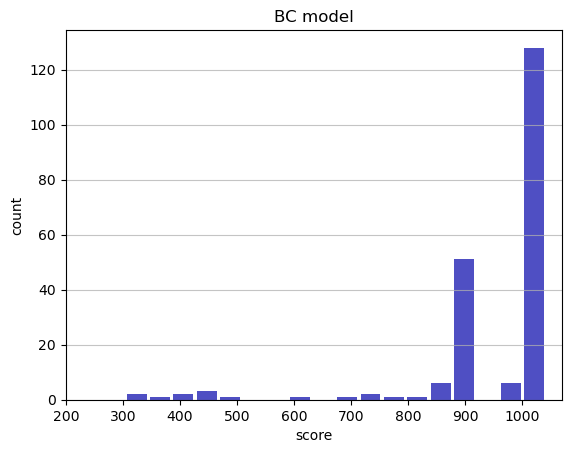

Track generation: 999..1262 -> 263-tiles track
Epoch: 207
BC	mean: 953.37	variance: 138.17


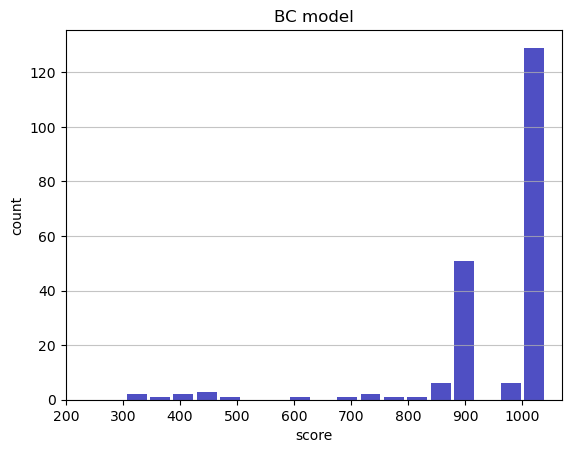

Track generation: 1140..1429 -> 289-tiles track
Epoch: 208
BC	mean: 953.76	variance: 137.95


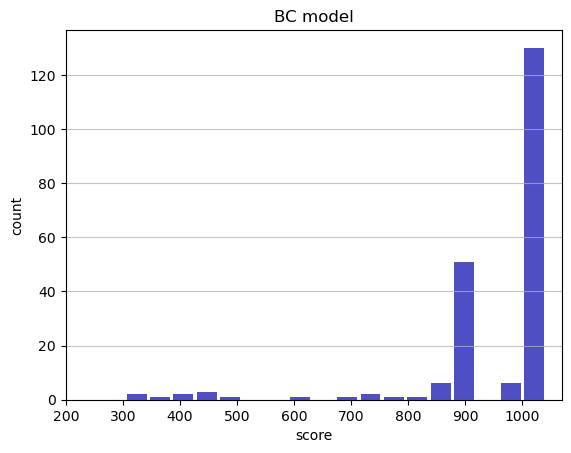

Track generation: 1329..1665 -> 336-tiles track
Epoch: 209
BC	mean: 954.04	variance: 137.68


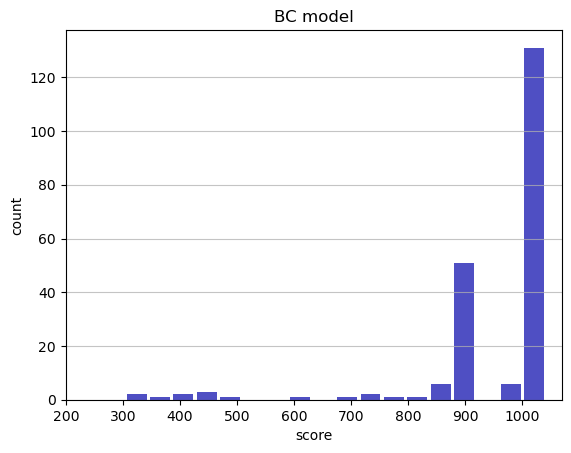

Track generation: 1187..1494 -> 307-tiles track
Epoch: 210
BC	mean: 953.71	variance: 137.44


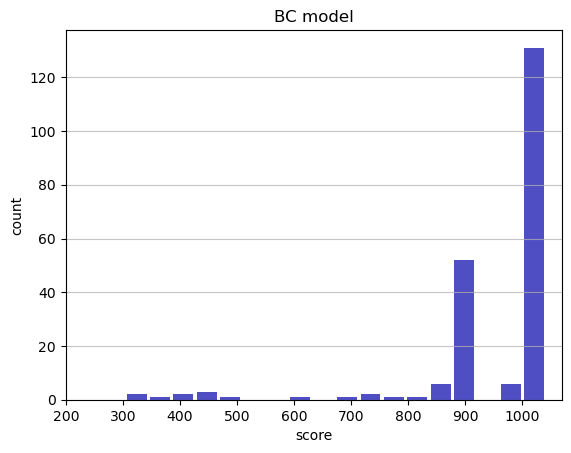

Track generation: 1204..1509 -> 305-tiles track
Epoch: 211
BC	mean: 953.49	variance: 137.15


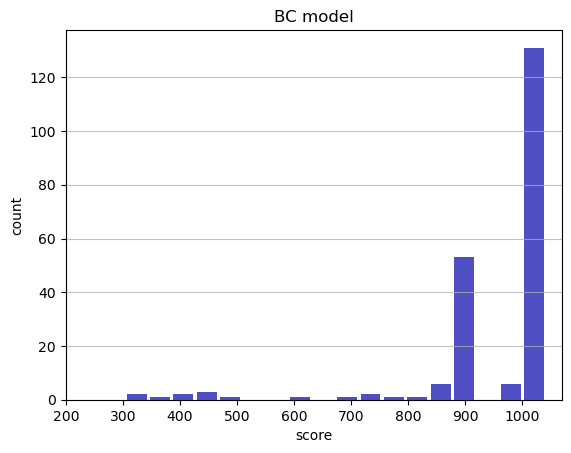

Track generation: 967..1219 -> 252-tiles track
Epoch: 212
BC	mean: 953.90	variance: 136.95


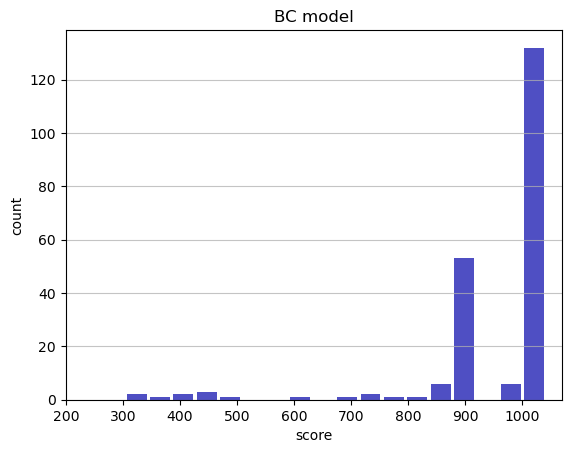

Track generation: 1072..1353 -> 281-tiles track
Epoch: 213
BC	mean: 954.25	variance: 136.73


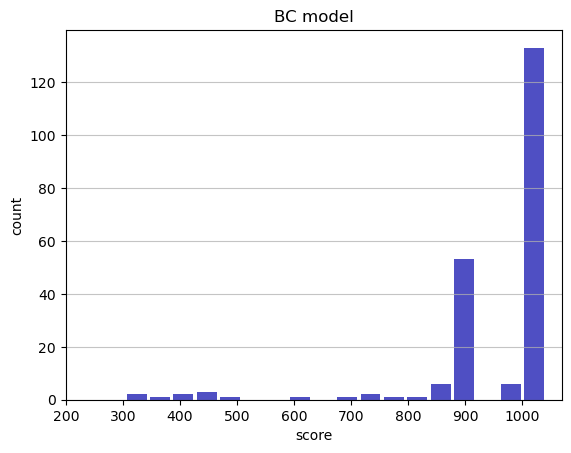

Track generation: 1115..1398 -> 283-tiles track
Epoch: 214
BC	mean: 954.60	variance: 136.51


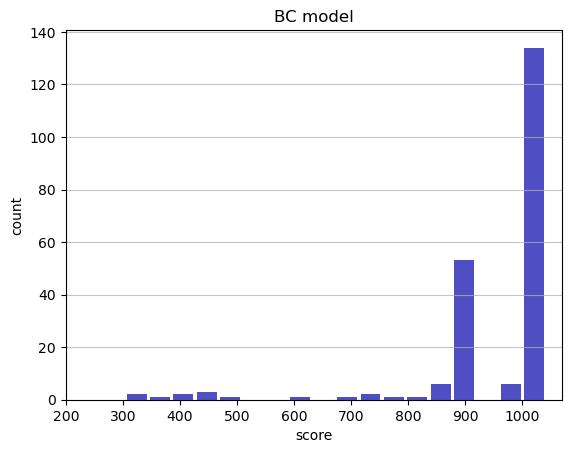

Track generation: 1067..1338 -> 271-tiles track
Epoch: 215
BC	mean: 952.99	variance: 138.21


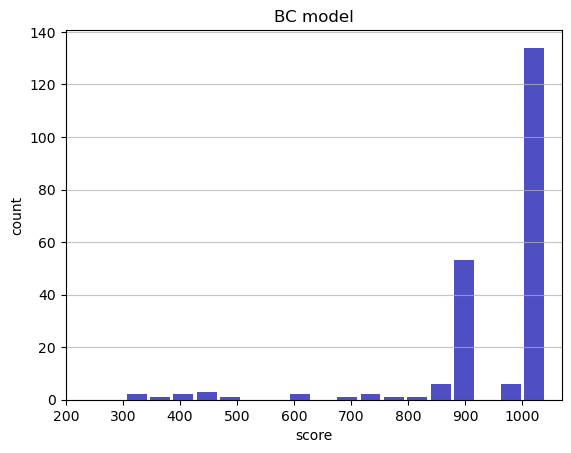

Track generation: 1162..1456 -> 294-tiles track
Epoch: 216
BC	mean: 953.30	variance: 137.97


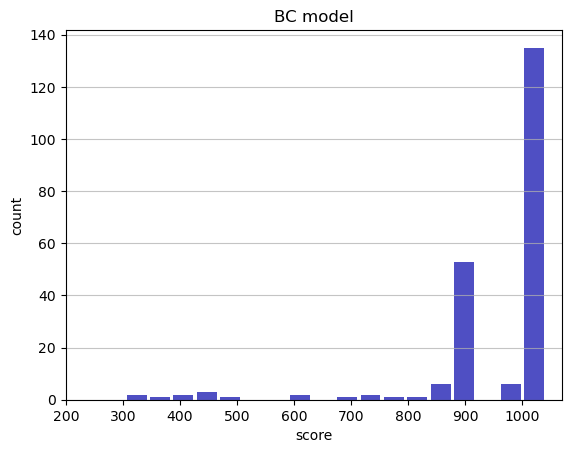

Track generation: 1138..1426 -> 288-tiles track
Epoch: 217
BC	mean: 953.63	variance: 137.73


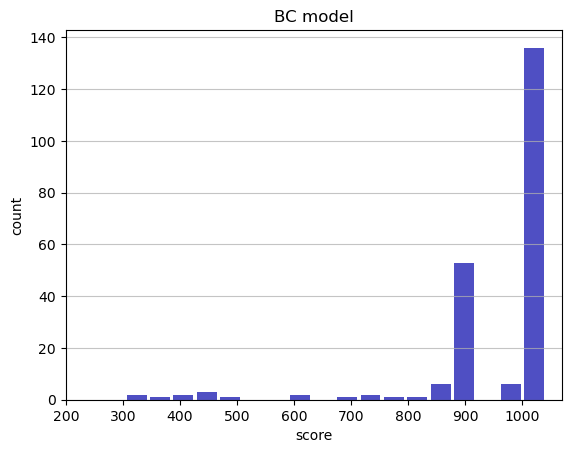

Track generation: 1152..1444 -> 292-tiles track
Epoch: 218
BC	mean: 951.94	variance: 139.66


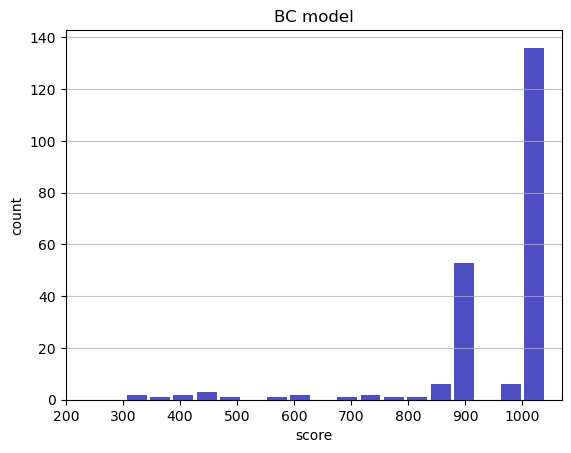

Track generation: 1152..1444 -> 292-tiles track
Epoch: 219
BC	mean: 952.28	variance: 139.44


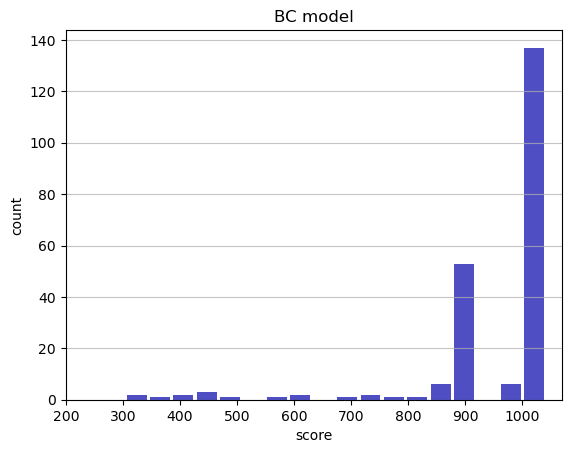

Track generation: 1081..1355 -> 274-tiles track
Epoch: 220
BC	mean: 952.09	variance: 139.15


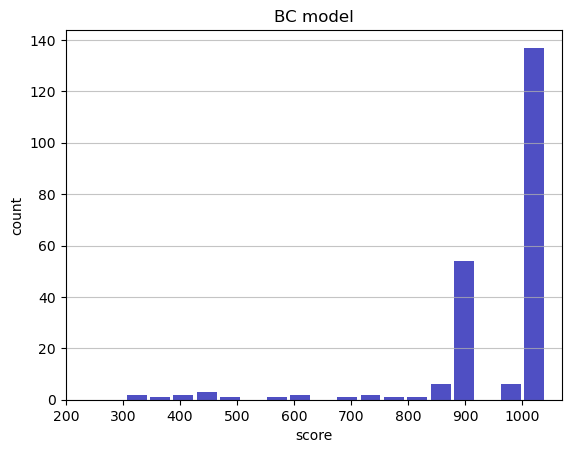

Track generation: 1056..1324 -> 268-tiles track
Epoch: 221
BC	mean: 952.45	variance: 138.94


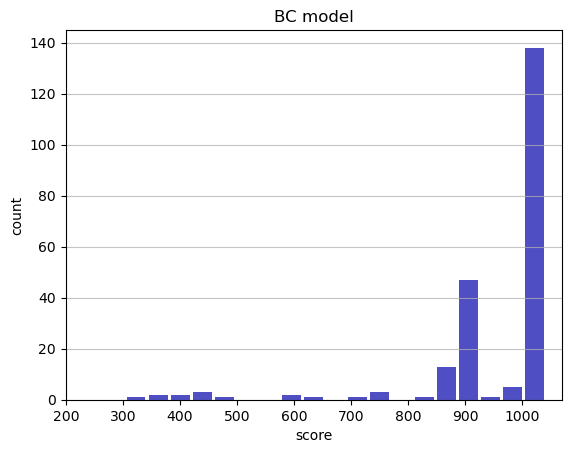

Track generation: 1255..1573 -> 318-tiles track
Epoch: 222
BC	mean: 952.73	variance: 138.69


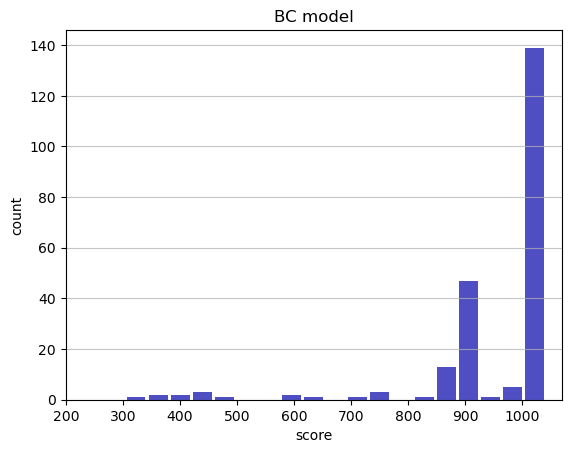

Track generation: 1051..1321 -> 270-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1100..1379 -> 279-tiles track
Epoch: 223
BC	mean: 953.07	variance: 138.47


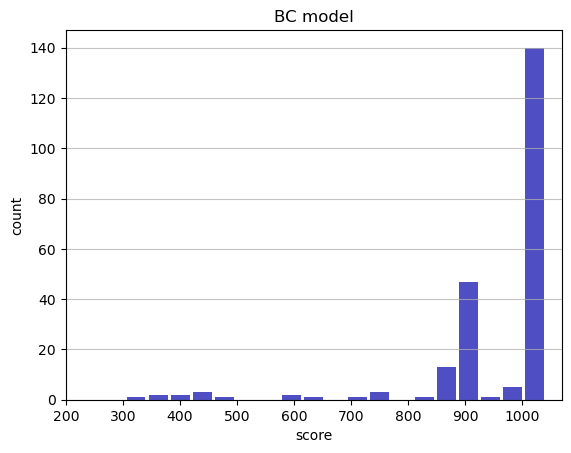

Track generation: 1216..1531 -> 315-tiles track
Epoch: 224
BC	mean: 953.34	variance: 138.22


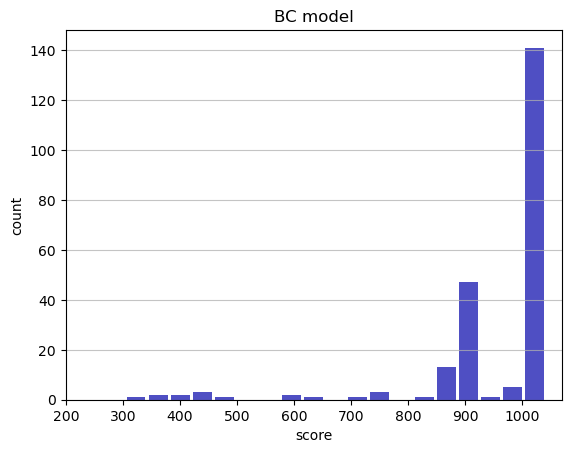

Track generation: 977..1230 -> 253-tiles track
Epoch: 225
BC	mean: 953.07	variance: 137.97


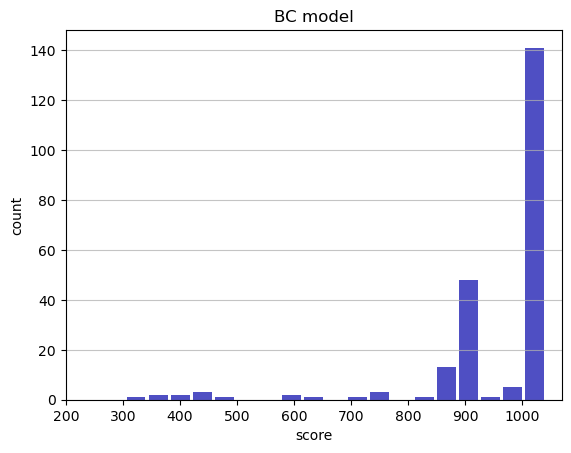

Track generation: 1251..1568 -> 317-tiles track
Epoch: 226
BC	mean: 953.37	variance: 137.73


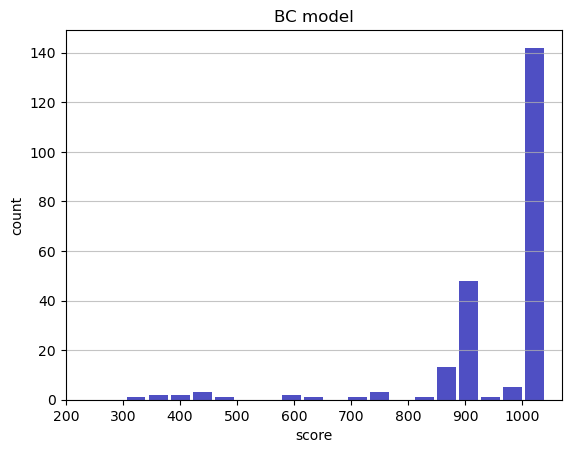

Track generation: 1303..1633 -> 330-tiles track
Epoch: 227
BC	mean: 953.55	variance: 137.45


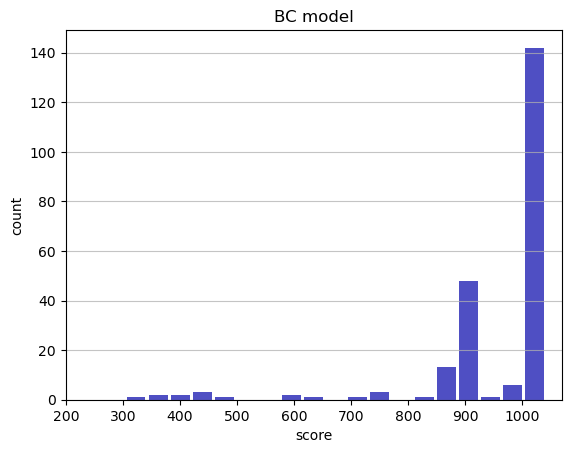

Track generation: 1180..1479 -> 299-tiles track
Epoch: 228
BC	mean: 953.32	variance: 137.20


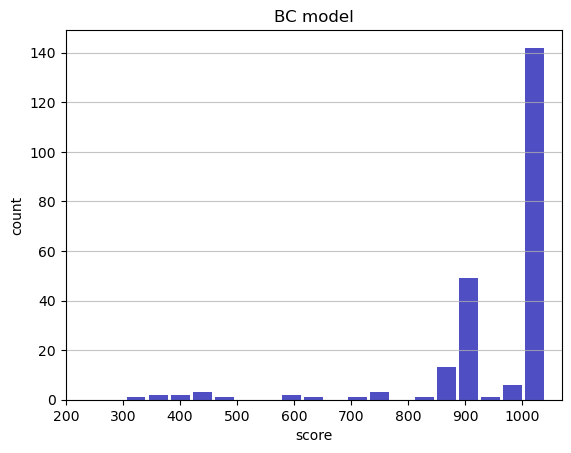

Track generation: 1172..1469 -> 297-tiles track
Epoch: 229
BC	mean: 953.65	variance: 136.99


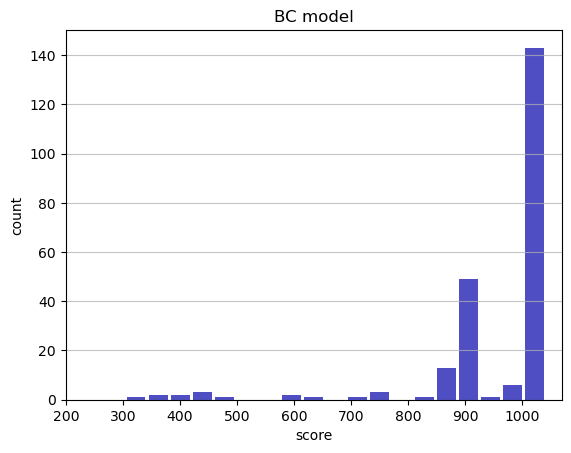

Track generation: 1052..1319 -> 267-tiles track
Epoch: 230
BC	mean: 953.46	variance: 136.72


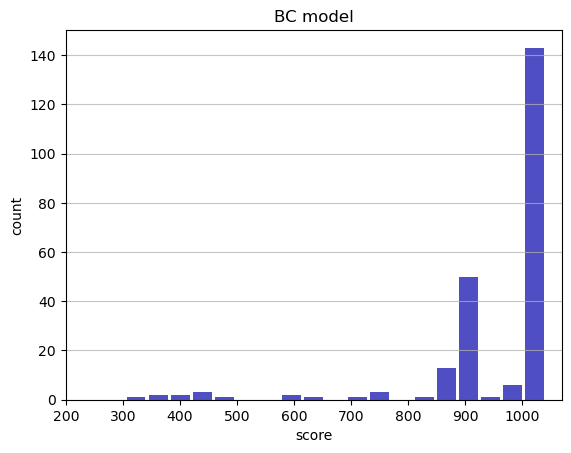

Track generation: 1204..1509 -> 305-tiles track
Epoch: 231
BC	mean: 953.78	variance: 136.51


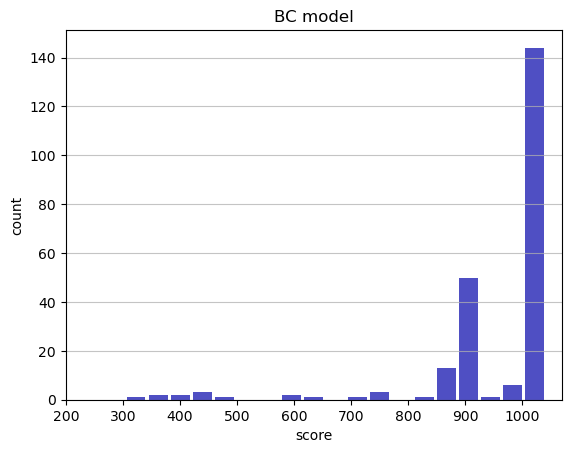

Track generation: 1032..1294 -> 262-tiles track
Epoch: 232
BC	mean: 953.46	variance: 136.30


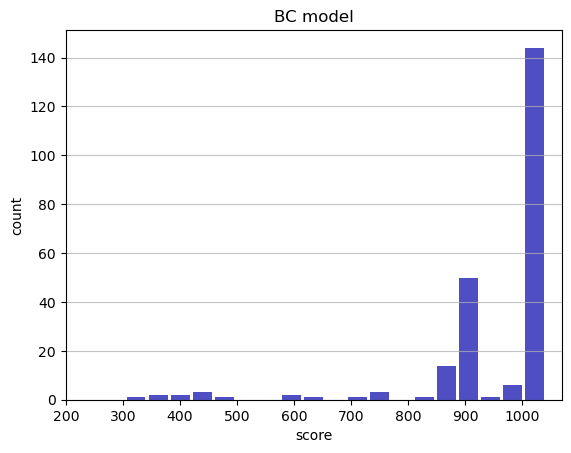

Track generation: 1088..1364 -> 276-tiles track
Epoch: 233
BC	mean: 953.80	variance: 136.10


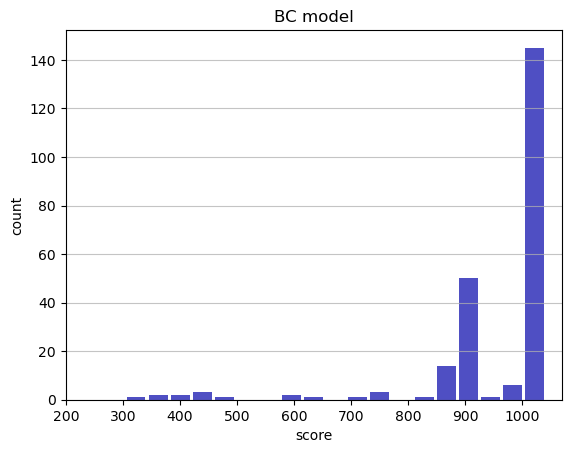

Track generation: 988..1247 -> 259-tiles track
Epoch: 234
BC	mean: 953.54	variance: 135.87


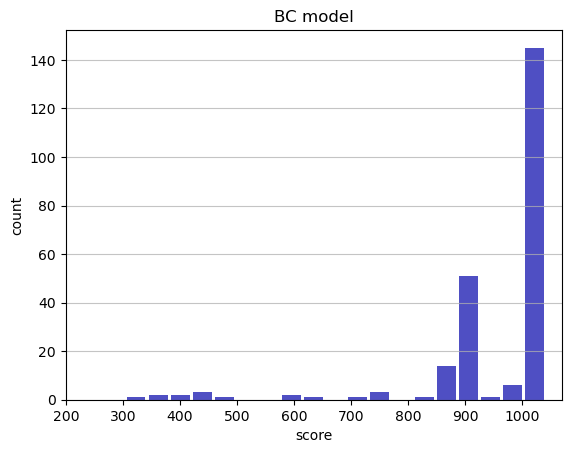

Track generation: 1297..1625 -> 328-tiles track
Epoch: 235
BC	mean: 953.80	variance: 135.64


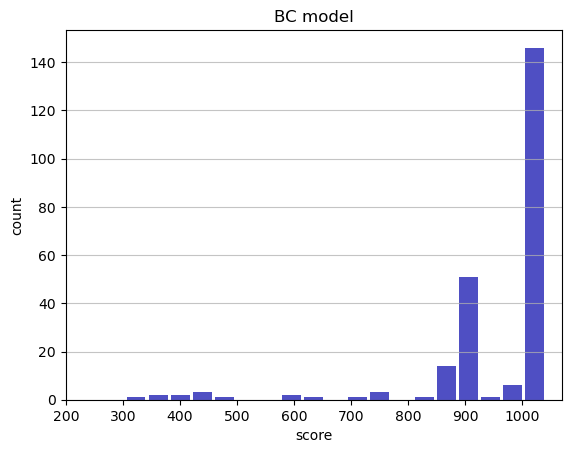

Track generation: 955..1200 -> 245-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1131..1418 -> 287-tiles track
Epoch: 236
BC	mean: 954.14	variance: 135.45


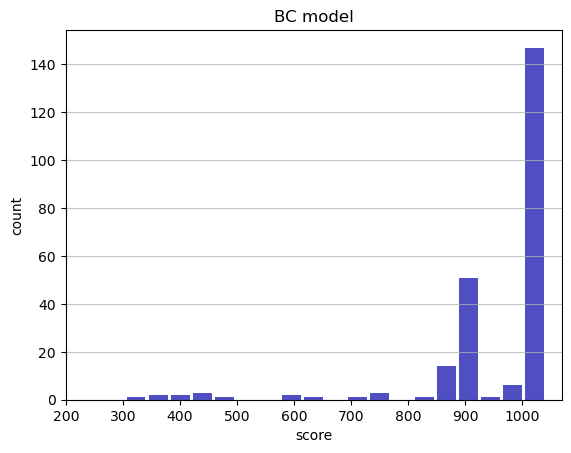

Track generation: 869..1097 -> 228-tiles track
Epoch: 237
BC	mean: 954.51	variance: 135.29


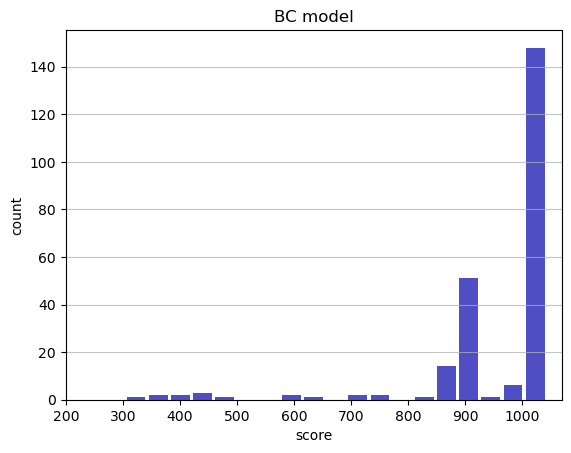

Track generation: 1156..1449 -> 293-tiles track
Epoch: 238
BC	mean: 954.83	variance: 135.09


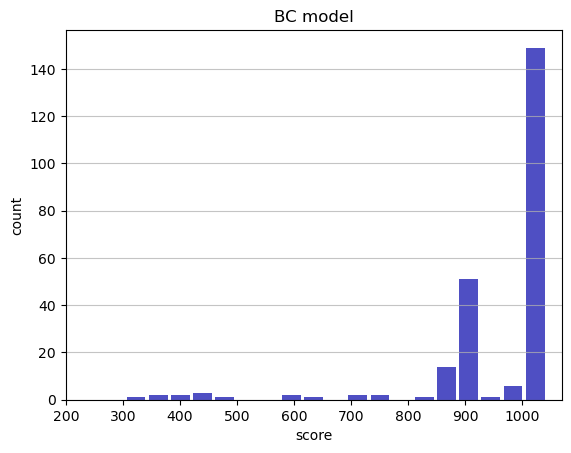

Track generation: 1267..1588 -> 321-tiles track
Epoch: 239
BC	mean: 955.10	variance: 134.87


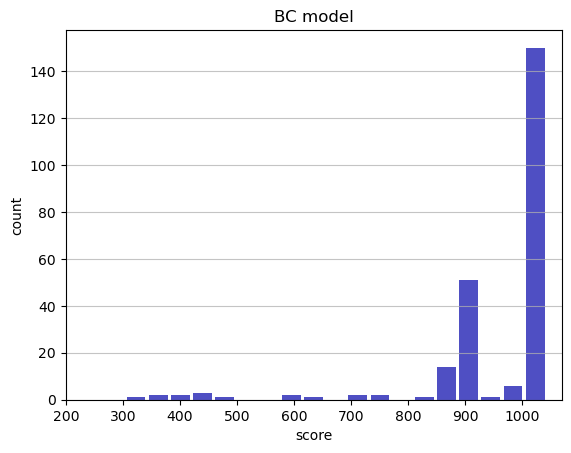

Track generation: 1220..1529 -> 309-tiles track
Epoch: 240
BC	mean: 955.35	variance: 134.65


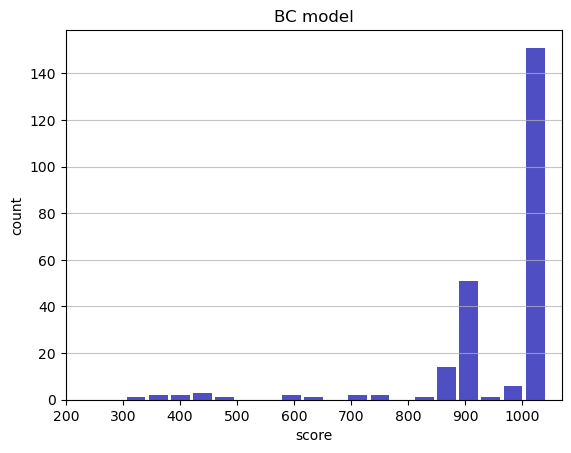

Track generation: 1047..1318 -> 271-tiles track
Epoch: 241
BC	mean: 955.66	variance: 134.46


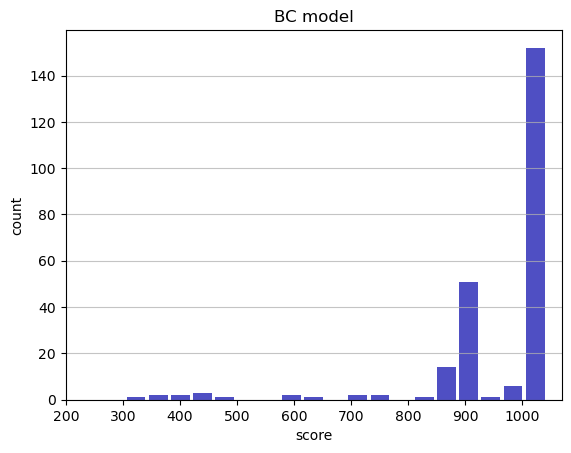

Track generation: 1159..1453 -> 294-tiles track
Epoch: 242
BC	mean: 955.46	variance: 134.21


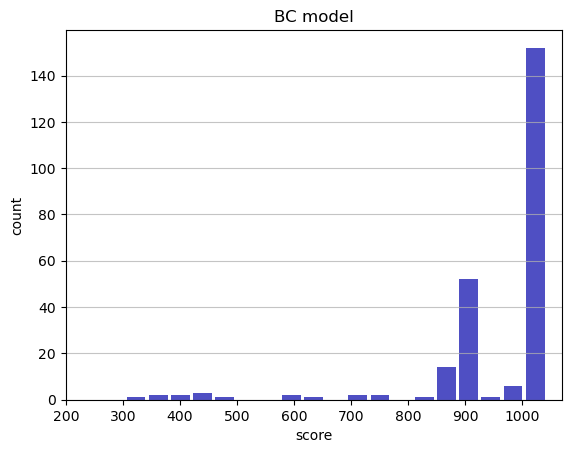

Track generation: 1036..1303 -> 267-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1388..1739 -> 351-tiles track
Epoch: 243
BC	mean: 955.67	variance: 133.97


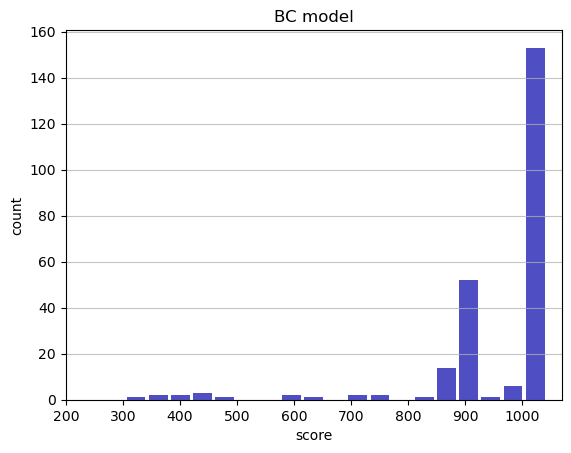

Track generation: 1075..1356 -> 281-tiles track
Epoch: 244
BC	mean: 955.96	variance: 133.78


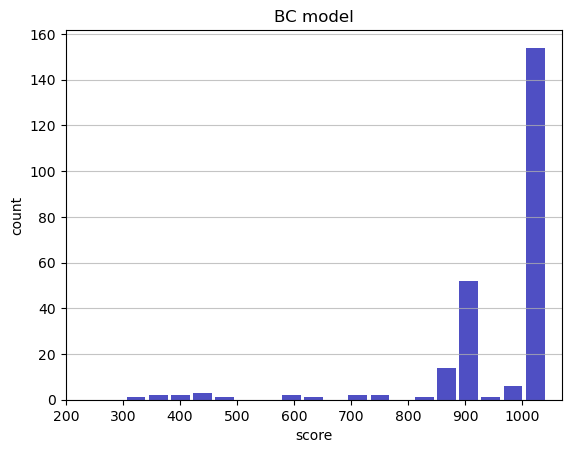

Track generation: 1097..1375 -> 278-tiles track
Epoch: 245
BC	mean: 956.26	variance: 133.59


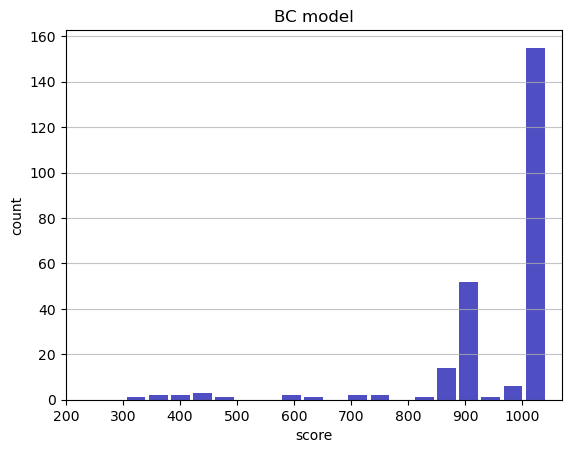

Track generation: 1128..1414 -> 286-tiles track
Epoch: 246
BC	mean: 956.56	variance: 133.40


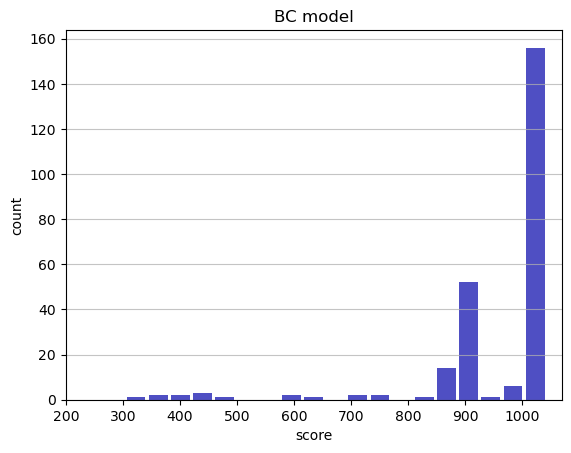

Track generation: 1195..1498 -> 303-tiles track
Epoch: 247
BC	mean: 956.81	variance: 133.18


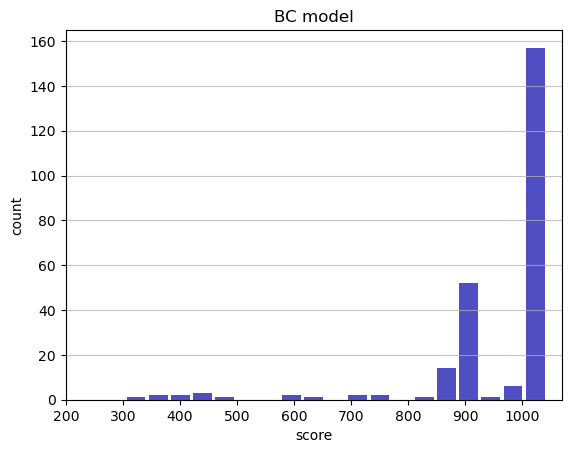

Track generation: 1066..1341 -> 275-tiles track
Epoch: 248
BC	mean: 957.10	variance: 132.99


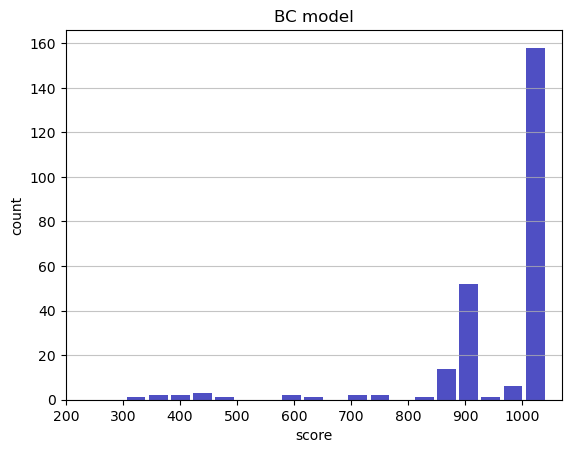

Track generation: 1159..1453 -> 294-tiles track
Epoch: 249
BC	mean: 956.90	variance: 132.76


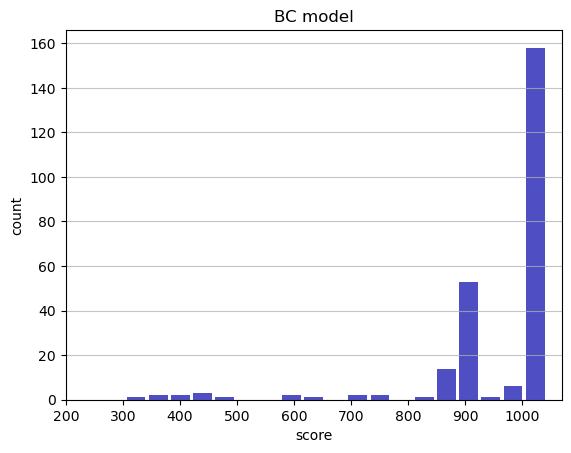

Track generation: 1259..1578 -> 319-tiles track
Epoch: 250
BC	mean: 957.00	variance: 132.51


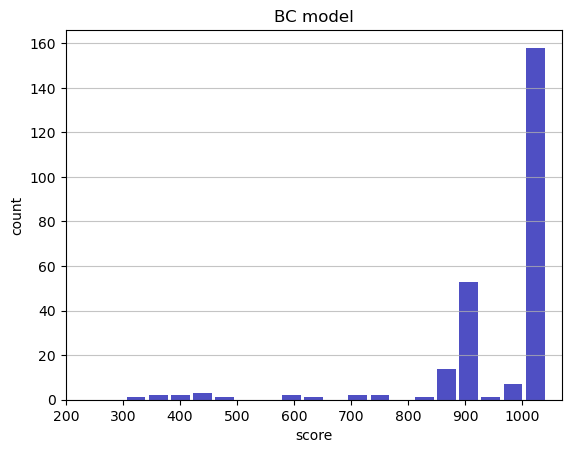

Track generation: 995..1257 -> 262-tiles track
Epoch: 251
BC	mean: 957.32	variance: 132.34


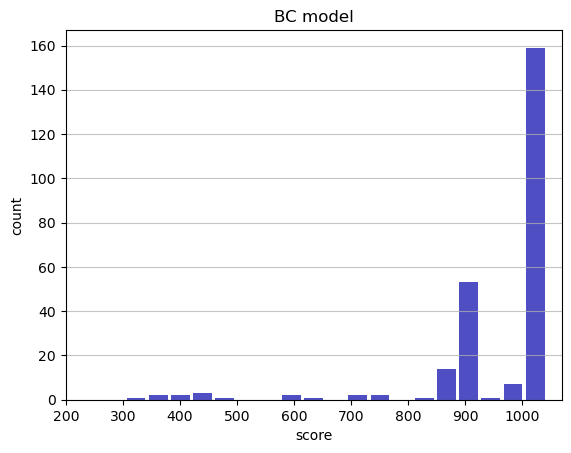

Track generation: 1266..1586 -> 320-tiles track
Epoch: 252
BC	mean: 957.55	variance: 132.13


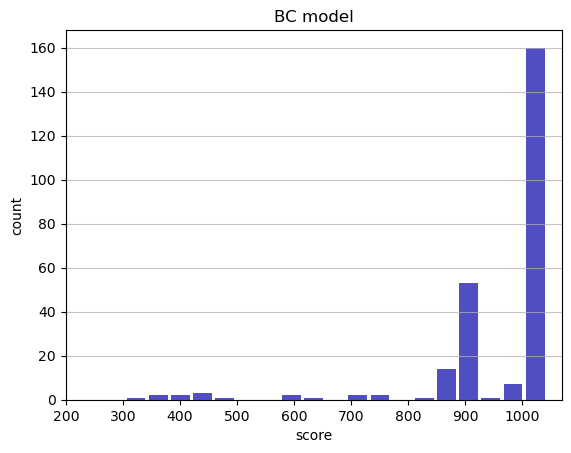

Track generation: 1196..1502 -> 306-tiles track
Epoch: 253
BC	mean: 957.34	variance: 131.91


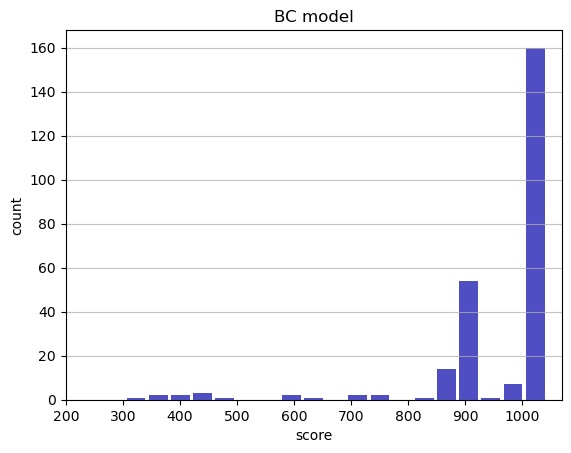

Track generation: 1296..1624 -> 328-tiles track
Epoch: 254
BC	mean: 957.56	variance: 131.70


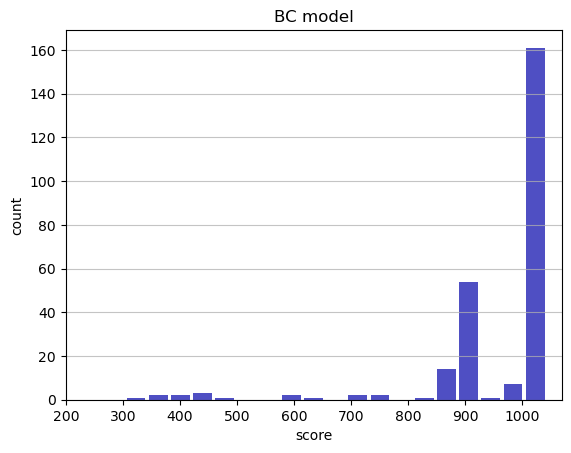

Track generation: 1183..1483 -> 300-tiles track
Epoch: 255
BC	mean: 957.83	variance: 131.50


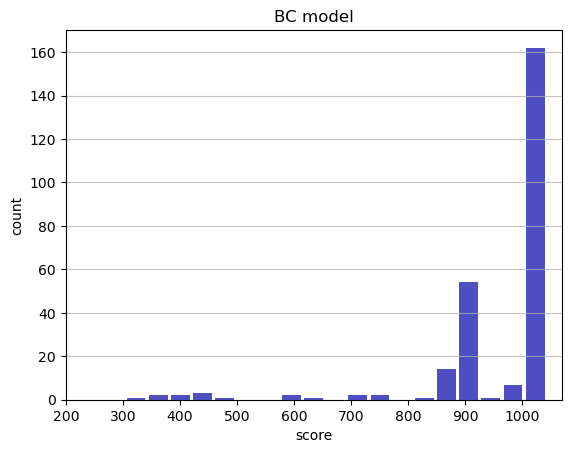

Track generation: 1356..1699 -> 343-tiles track
Epoch: 256
BC	mean: 956.97	variance: 131.96


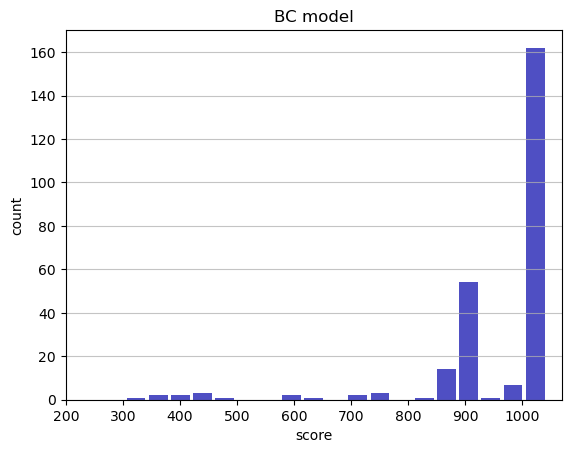

Track generation: 1116..1399 -> 283-tiles track
Epoch: 257
BC	mean: 957.26	variance: 131.78


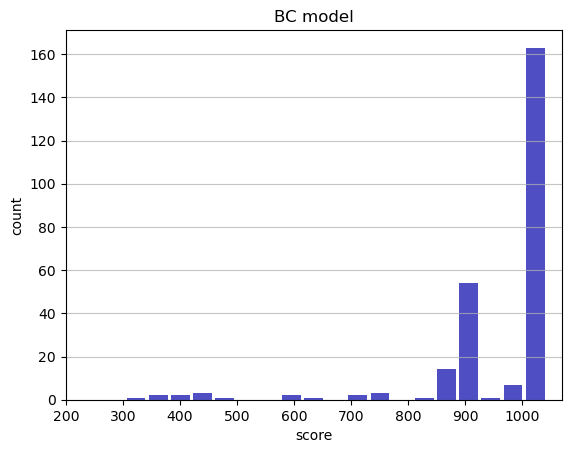

Track generation: 1262..1581 -> 319-tiles track
Epoch: 258
BC	mean: 957.48	variance: 131.57


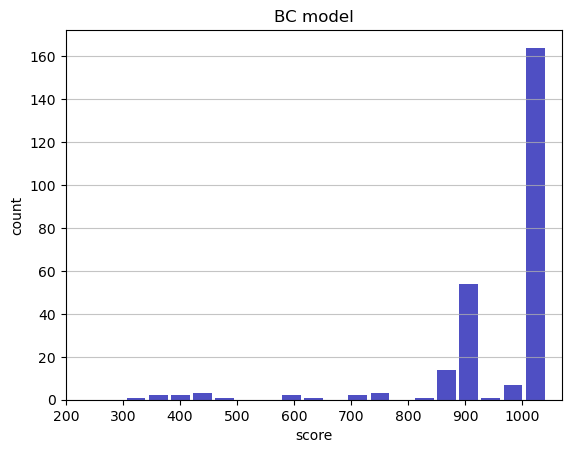

Track generation: 1099..1378 -> 279-tiles track
Epoch: 259
BC	mean: 957.76	variance: 131.40


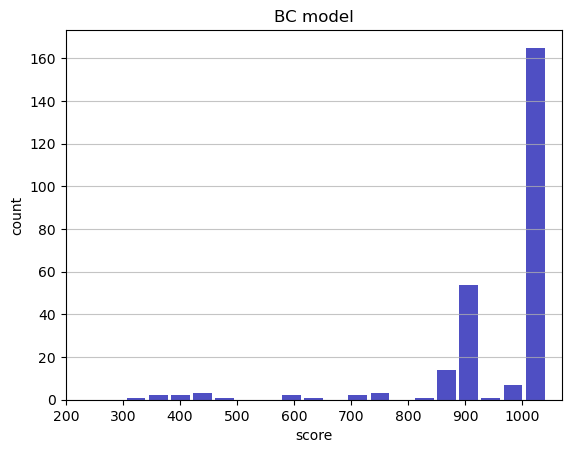

Track generation: 1188..1489 -> 301-tiles track
Epoch: 260
BC	mean: 958.02	variance: 131.21


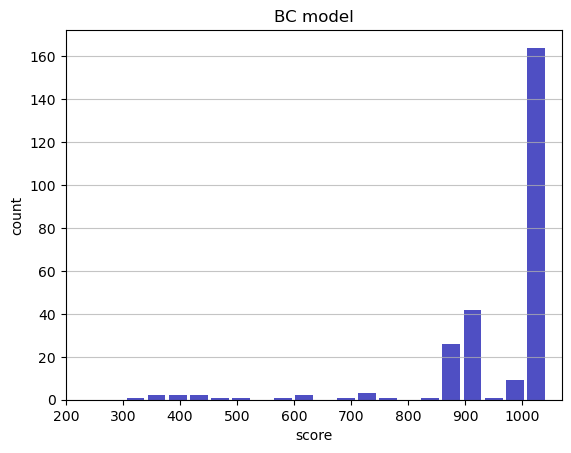

Track generation: 1099..1383 -> 284-tiles track
Epoch: 261
BC	mean: 958.27	variance: 131.02


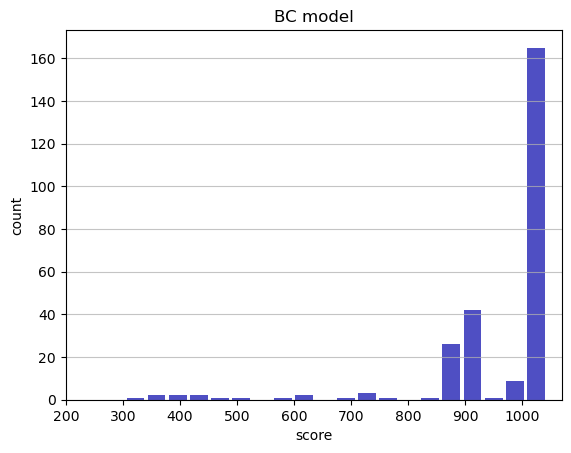

Track generation: 1127..1413 -> 286-tiles track
Epoch: 262
BC	mean: 958.11	variance: 130.79


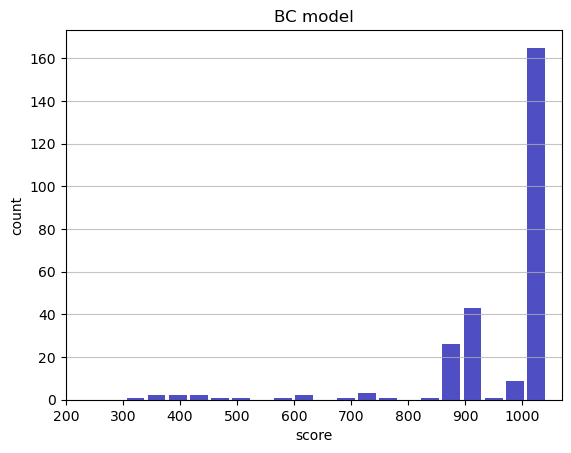

Track generation: 1169..1465 -> 296-tiles track
Epoch: 263
BC	mean: 958.36	variance: 130.61


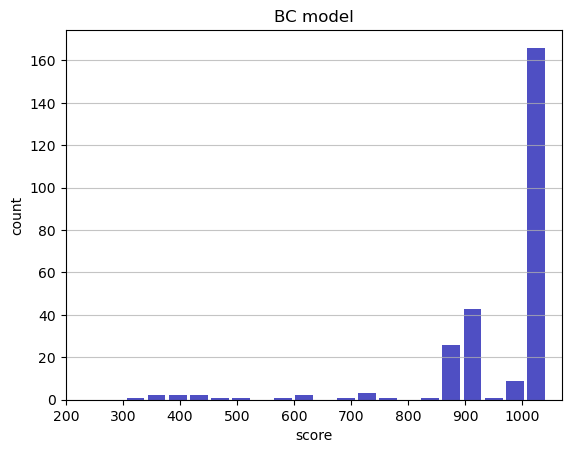

Track generation: 1082..1366 -> 284-tiles track
Epoch: 264
BC	mean: 958.10	variance: 130.43


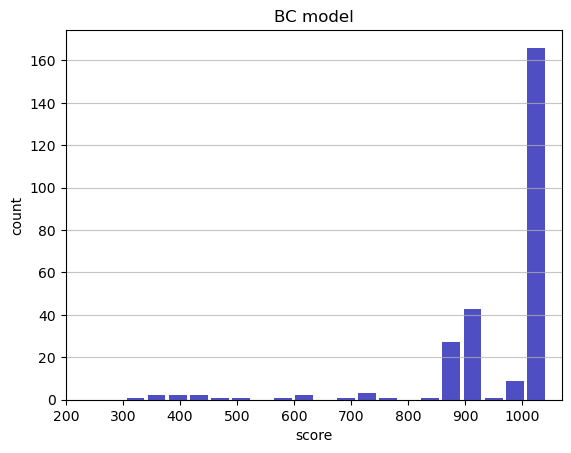

Track generation: 1078..1351 -> 273-tiles track
Epoch: 265
BC	mean: 958.39	variance: 130.27


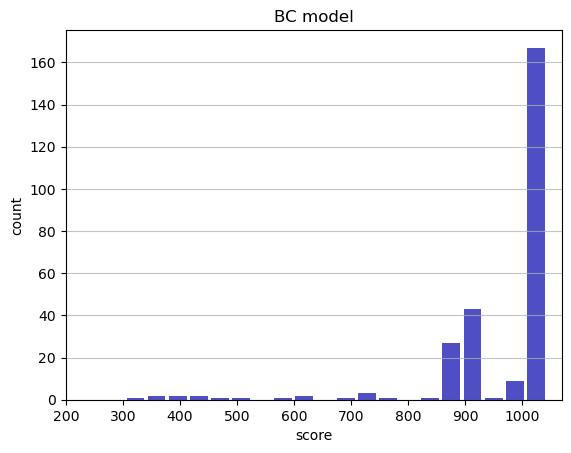

Track generation: 1135..1422 -> 287-tiles track
Epoch: 266
BC	mean: 958.67	variance: 130.11


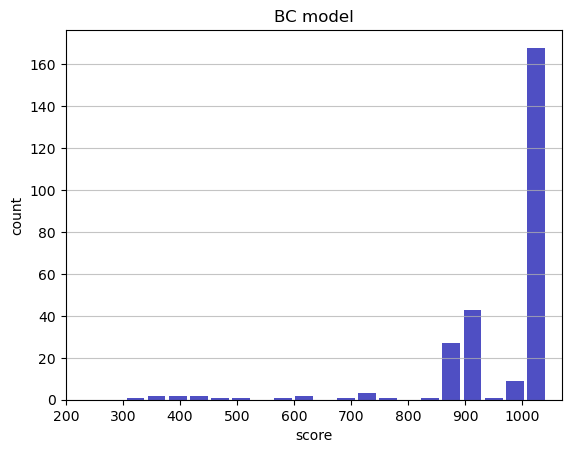

Track generation: 1067..1340 -> 273-tiles track
Epoch: 267
BC	mean: 958.95	variance: 129.94


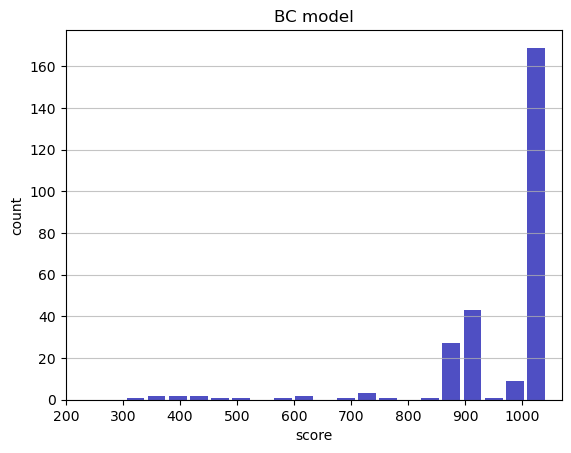

Track generation: 1157..1452 -> 295-tiles track
Epoch: 268
BC	mean: 959.20	variance: 129.76


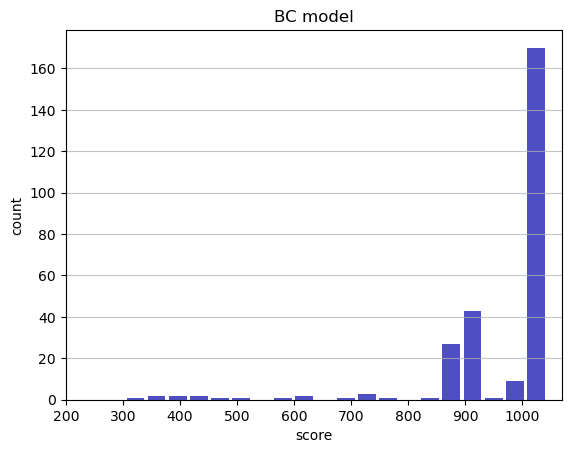

Track generation: 1221..1536 -> 315-tiles track
Epoch: 269
BC	mean: 959.40	variance: 129.56


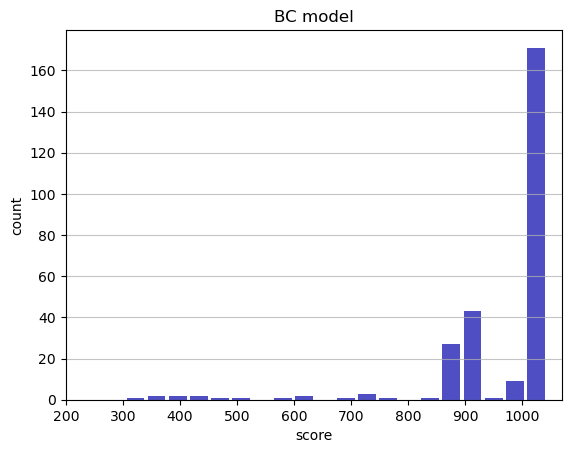

Track generation: 1299..1628 -> 329-tiles track
Epoch: 270
BC	mean: 959.60	variance: 129.37


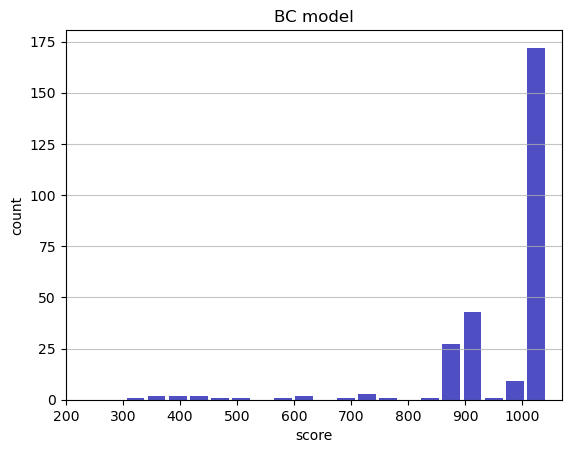

Track generation: 1169..1473 -> 304-tiles track
Epoch: 271
BC	mean: 959.82	variance: 129.18


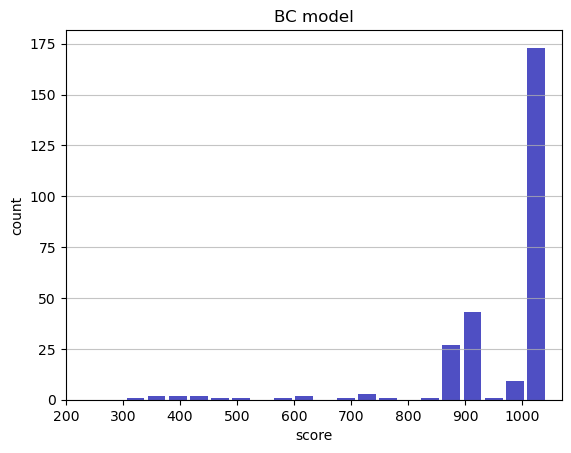

Track generation: 1336..1674 -> 338-tiles track
Epoch: 272
BC	mean: 959.55	variance: 129.02


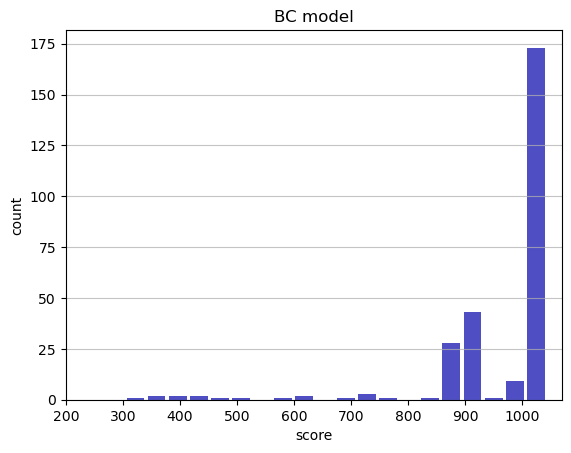

Track generation: 1015..1280 -> 265-tiles track
Epoch: 273
BC	mean: 959.82	variance: 128.86


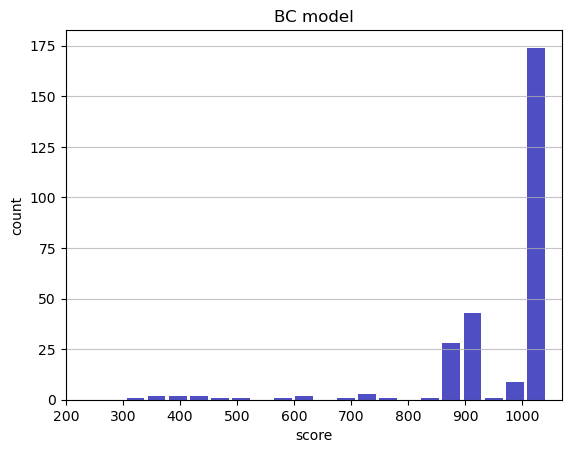

Track generation: 1100..1379 -> 279-tiles track
Epoch: 274
BC	mean: 960.09	variance: 128.70


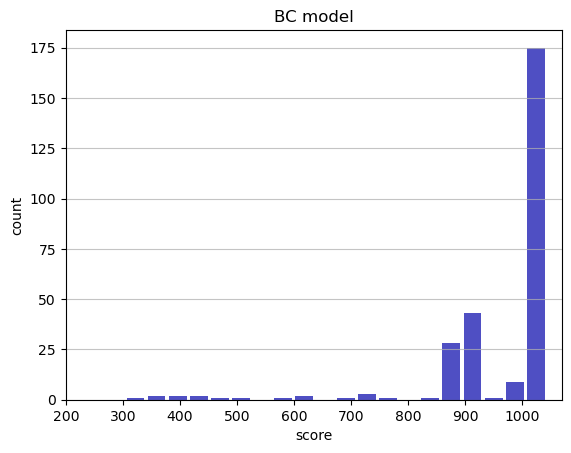

Track generation: 1142..1430 -> 288-tiles track
Epoch: 275
BC	mean: 959.77	variance: 128.57


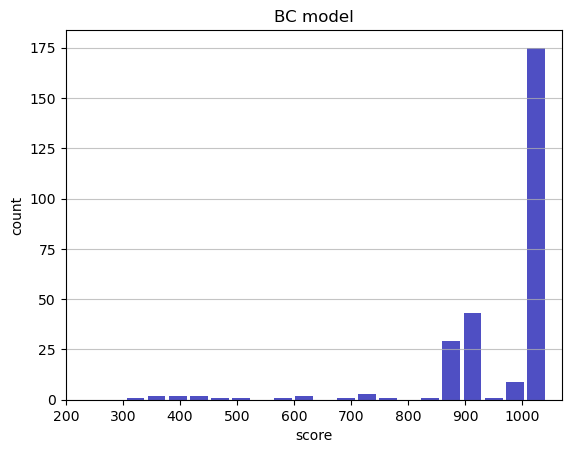

Track generation: 1029..1299 -> 270-tiles track
Epoch: 276
BC	mean: 959.59	variance: 128.38


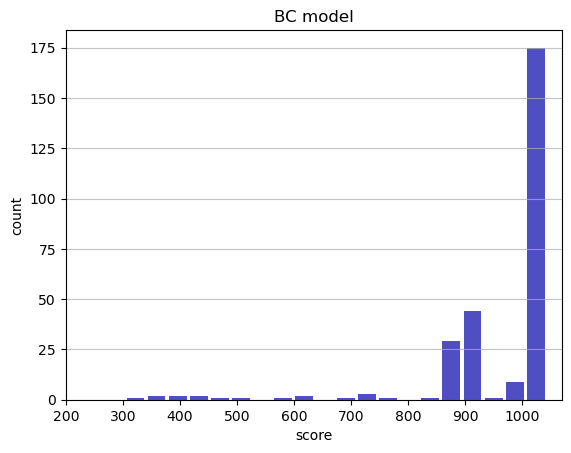

Track generation: 1299..1628 -> 329-tiles track
Epoch: 277
BC	mean: 959.32	variance: 128.22


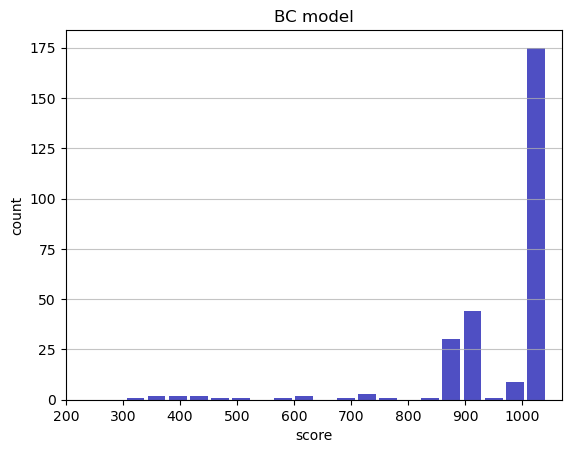

Track generation: 1155..1448 -> 293-tiles track
Epoch: 278
BC	mean: 959.07	variance: 128.06


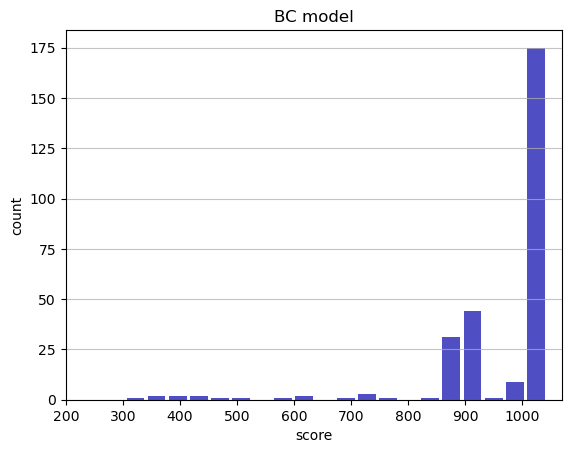

Track generation: 1232..1544 -> 312-tiles track
Epoch: 279
BC	mean: 959.28	variance: 127.88


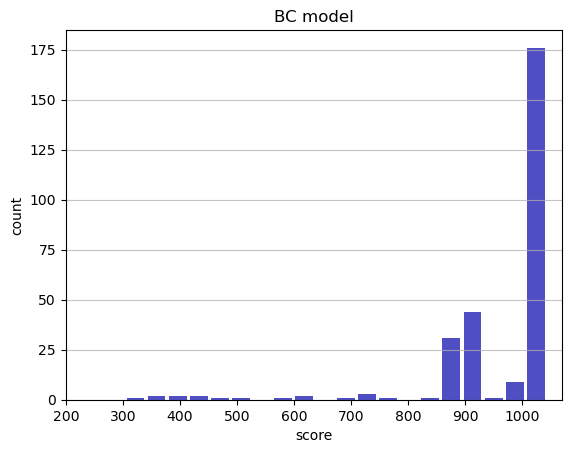

Track generation: 1152..1444 -> 292-tiles track
Epoch: 280
BC	mean: 959.53	variance: 127.72


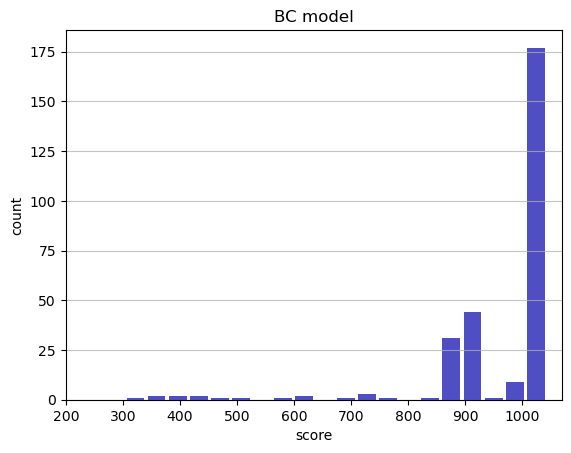

Track generation: 1419..1778 -> 359-tiles track
Epoch: 281
BC	mean: 959.61	variance: 127.50


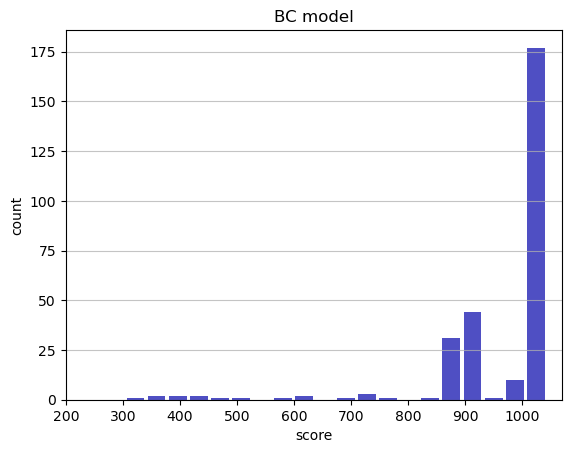

Track generation: 1148..1439 -> 291-tiles track
Epoch: 282
BC	mean: 959.85	variance: 127.34


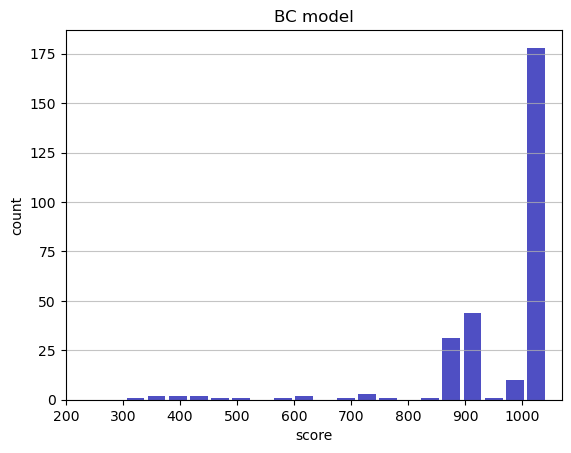

Track generation: 1124..1417 -> 293-tiles track
Epoch: 283
BC	mean: 960.06	variance: 127.16


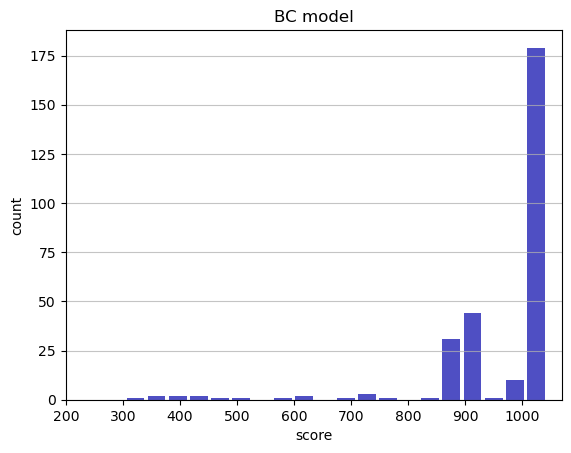

Track generation: 1063..1333 -> 270-tiles track
Epoch: 284
BC	mean: 960.33	variance: 127.02


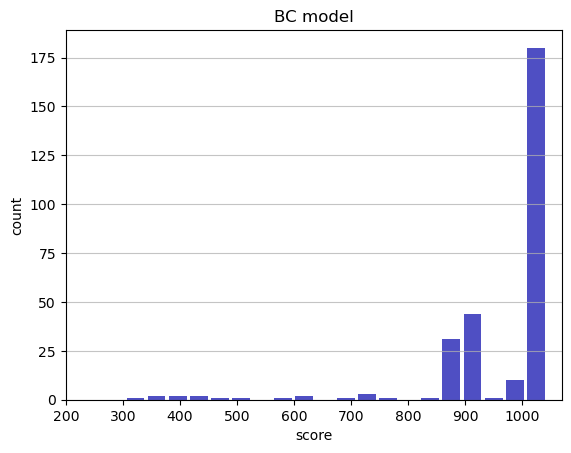

Track generation: 1183..1489 -> 306-tiles track
Epoch: 285
BC	mean: 960.55	variance: 126.85


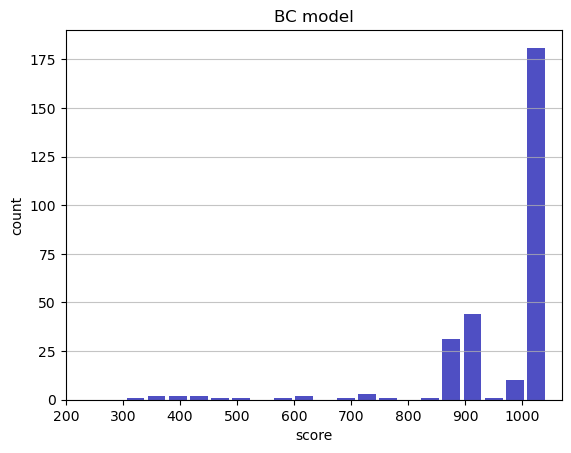

Track generation: 1071..1350 -> 279-tiles track
Epoch: 286
BC	mean: 960.28	variance: 126.72


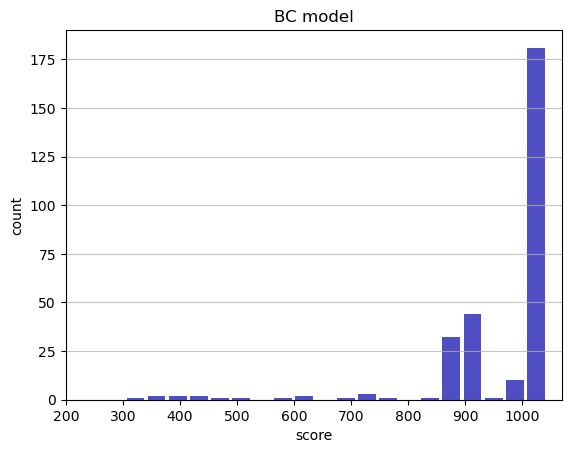

Track generation: 1215..1523 -> 308-tiles track
Epoch: 287
BC	mean: 960.05	variance: 126.55


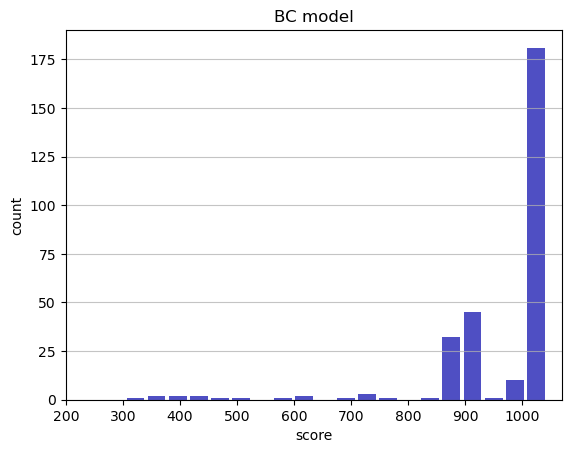

Track generation: 1287..1613 -> 326-tiles track
Epoch: 288
BC	mean: 960.23	variance: 126.37


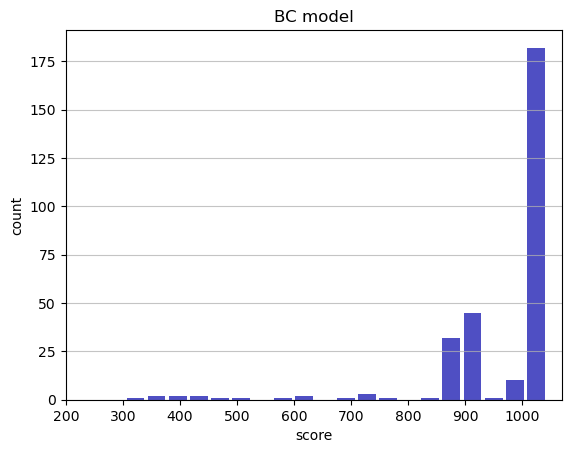

Track generation: 1344..1684 -> 340-tiles track
Epoch: 289
BC	mean: 959.22	variance: 127.31


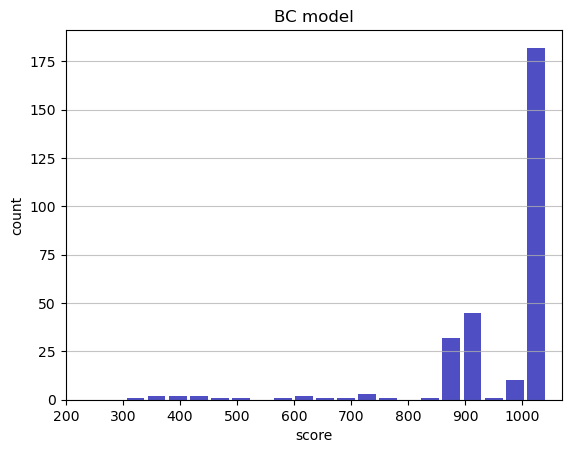

Track generation: 1239..1553 -> 314-tiles track
Epoch: 290
BC	mean: 959.45	variance: 127.15


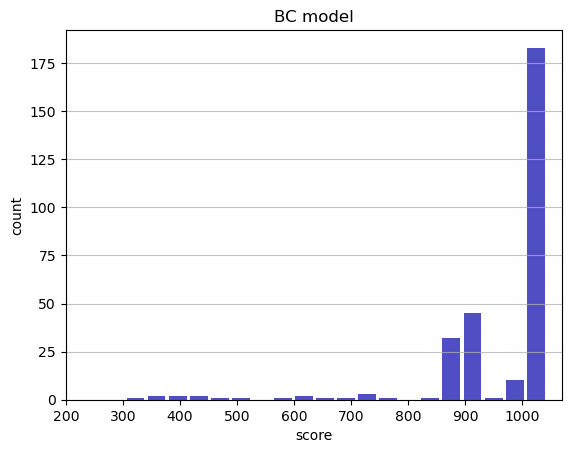

Track generation: 1193..1500 -> 307-tiles track
Epoch: 291
BC	mean: 959.22	variance: 126.99


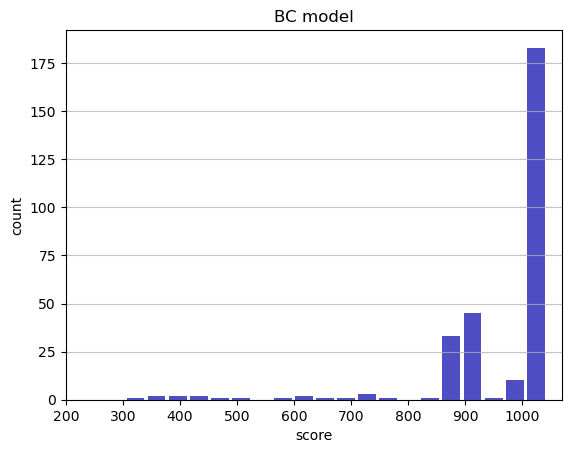

Track generation: 1008..1264 -> 256-tiles track
Epoch: 292
BC	mean: 959.48	variance: 126.85


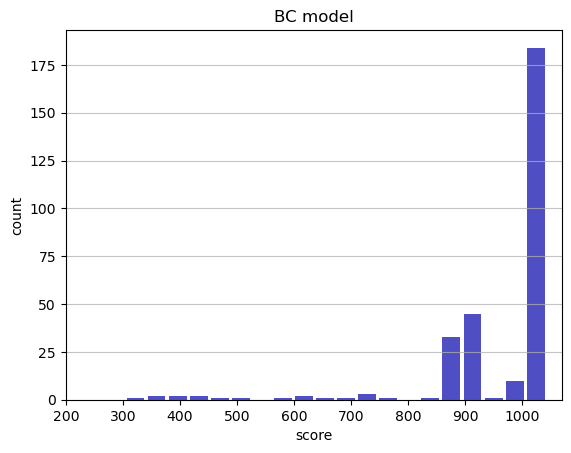

Track generation: 1083..1358 -> 275-tiles track
Epoch: 293
BC	mean: 959.33	variance: 126.66


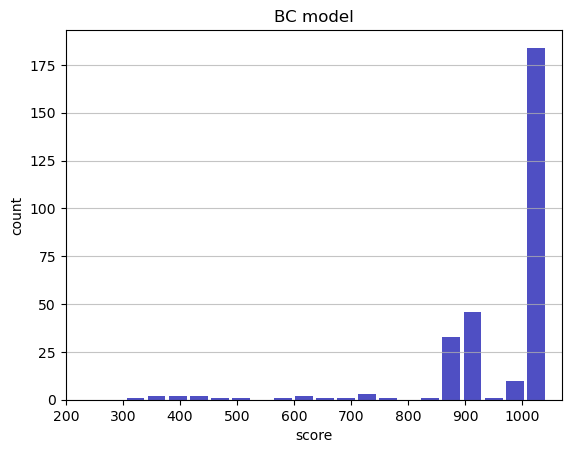

Track generation: 1176..1474 -> 298-tiles track
Epoch: 294
BC	mean: 959.12	variance: 126.50


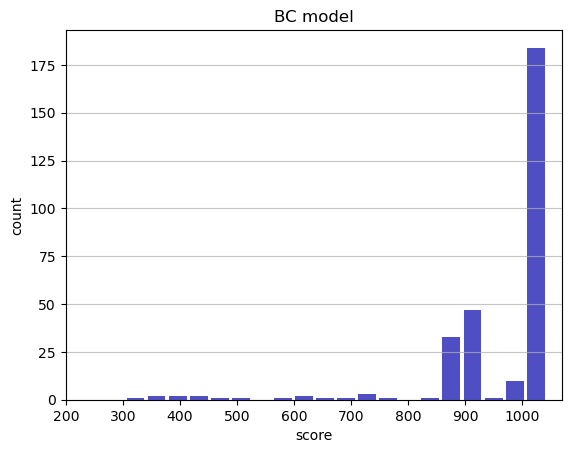

Track generation: 1218..1528 -> 310-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1168..1464 -> 296-tiles track
Epoch: 295
BC	mean: 959.34	variance: 126.34


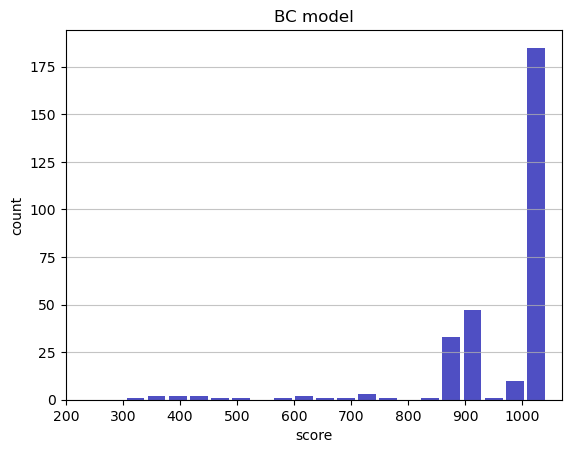

Track generation: 1136..1424 -> 288-tiles track
Epoch: 296
BC	mean: 959.17	variance: 126.16


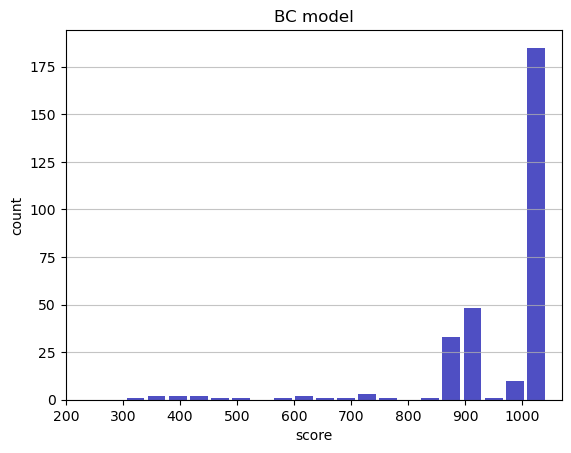

Track generation: 1115..1398 -> 283-tiles track
Epoch: 297
BC	mean: 959.41	variance: 126.02


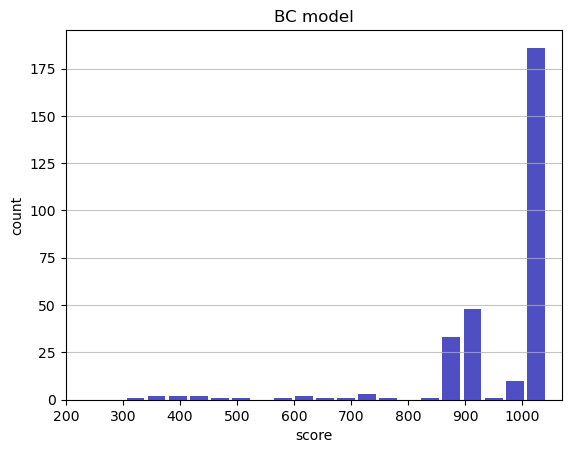

Track generation: 1043..1308 -> 265-tiles track
Epoch: 298
BC	mean: 959.18	variance: 125.87


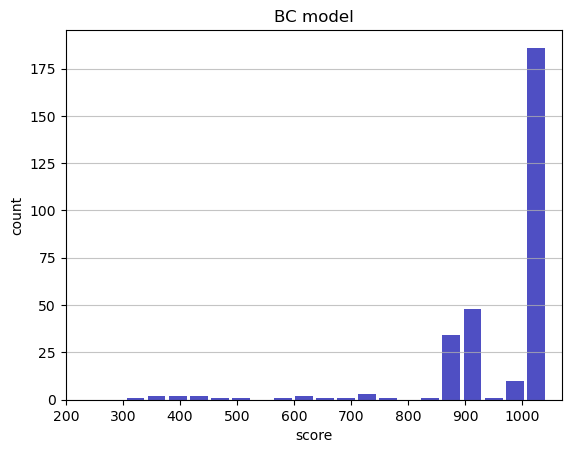

Track generation: 1275..1599 -> 324-tiles track
Epoch: 299
BC	mean: 959.37	variance: 125.70


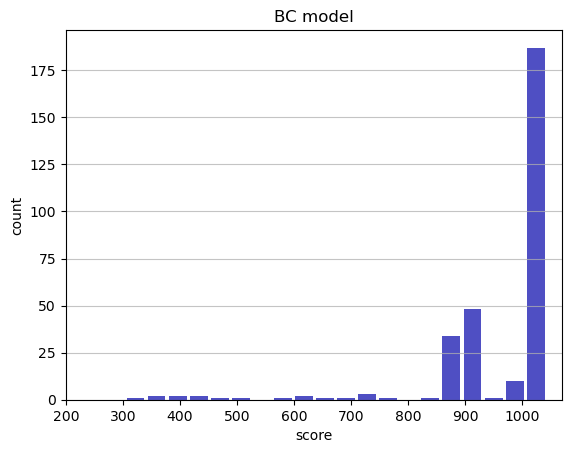

Track generation: 1148..1439 -> 291-tiles track
Epoch: 300
BC	mean: 959.59	variance: 125.55


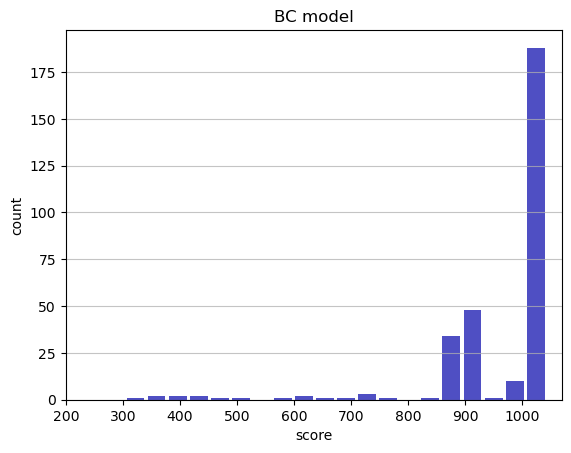

Track generation: 1159..1453 -> 294-tiles track
Epoch: 301
BC	mean: 959.43	variance: 125.37


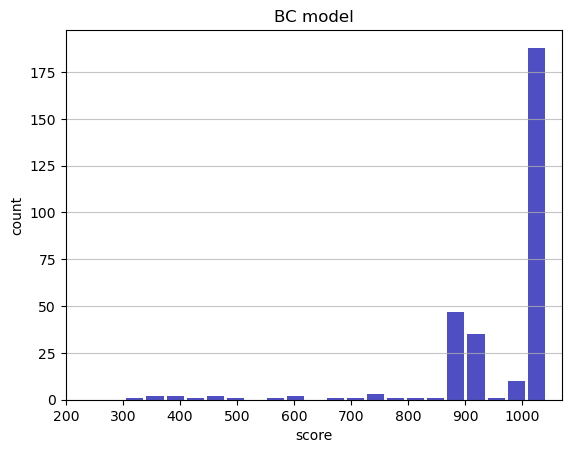

Track generation: 1117..1406 -> 289-tiles track
Epoch: 302
BC	mean: 959.16	variance: 125.24


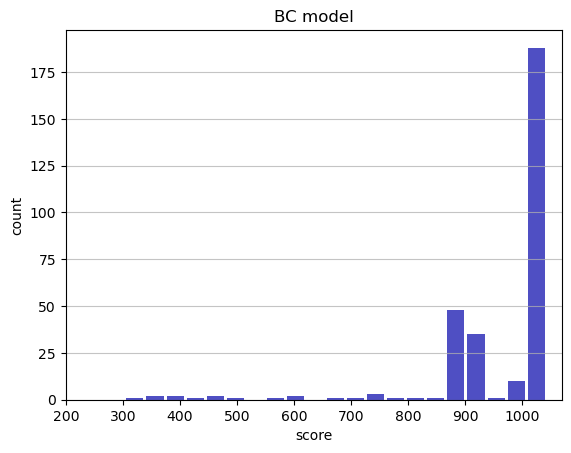

Track generation: 1200..1504 -> 304-tiles track
Epoch: 303
BC	mean: 958.95	variance: 125.09


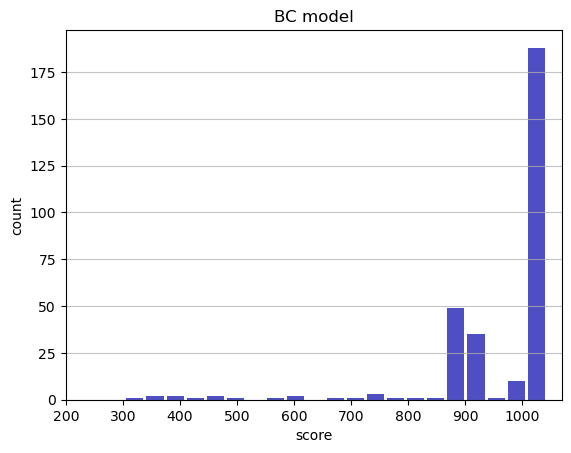

Track generation: 1079..1353 -> 274-tiles track
Epoch: 304
BC	mean: 959.18	variance: 124.96


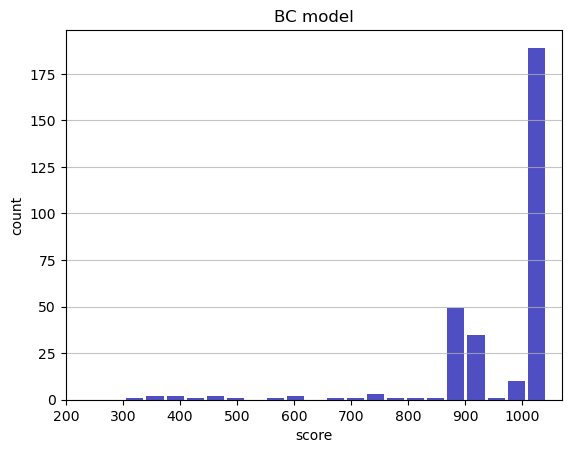

Track generation: 1211..1518 -> 307-tiles track
Epoch: 305
BC	mean: 958.95	variance: 124.82


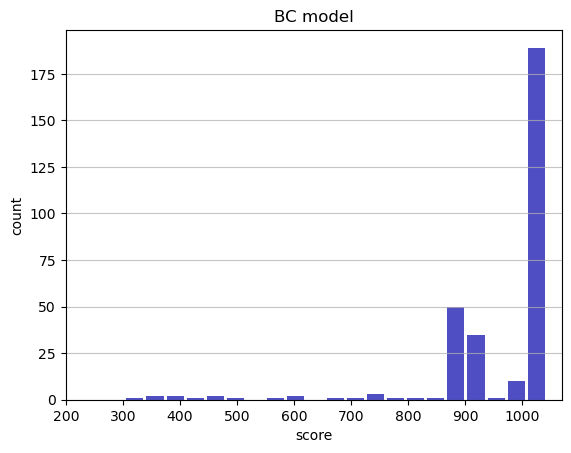

Track generation: 1167..1471 -> 304-tiles track
Epoch: 306
BC	mean: 959.15	variance: 124.66


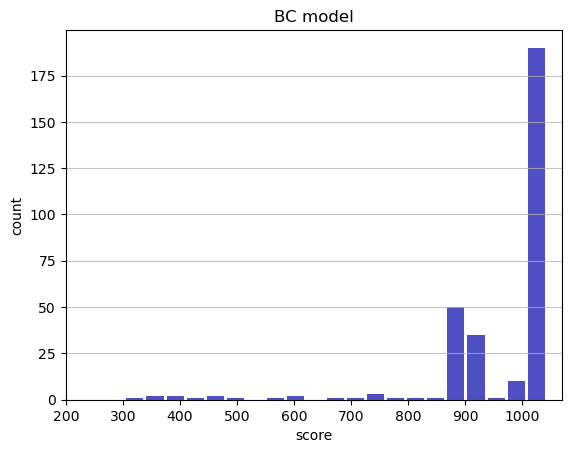

Track generation: 1171..1477 -> 306-tiles track
Epoch: 307
BC	mean: 959.34	variance: 124.50


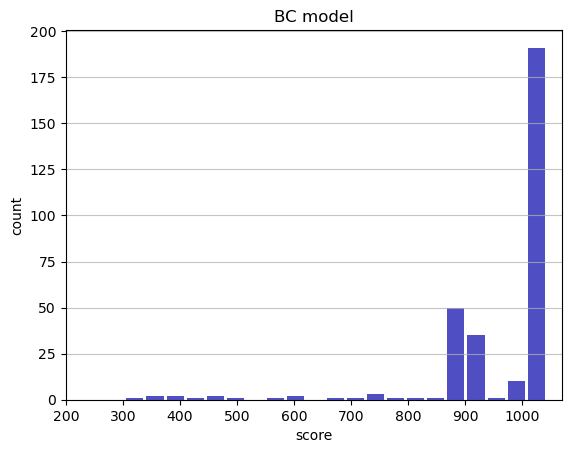

Track generation: 1220..1529 -> 309-tiles track
Epoch: 308
BC	mean: 959.54	variance: 124.35


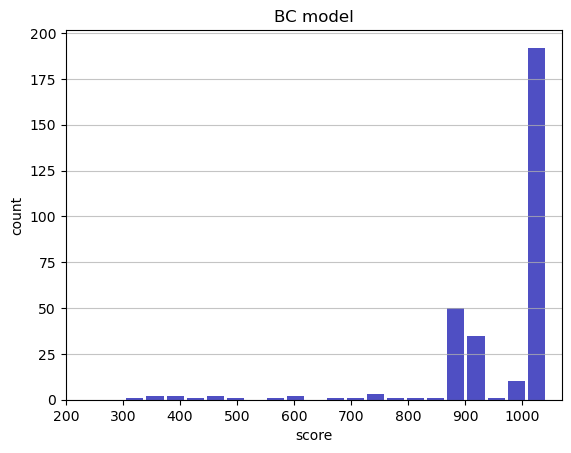

Track generation: 1112..1394 -> 282-tiles track
Epoch: 309
BC	mean: 959.79	variance: 124.22


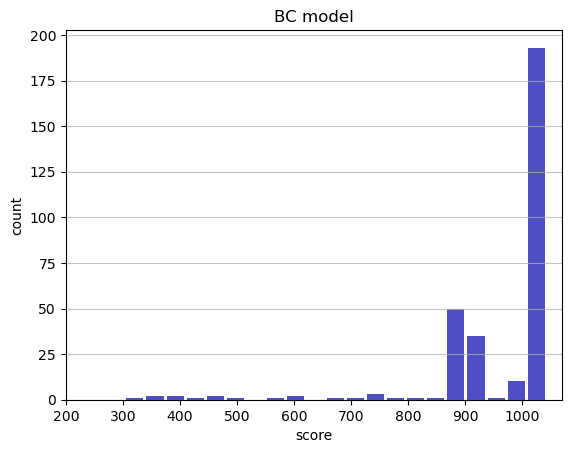

Track generation: 1256..1574 -> 318-tiles track
Epoch: 310
BC	mean: 959.53	variance: 124.11


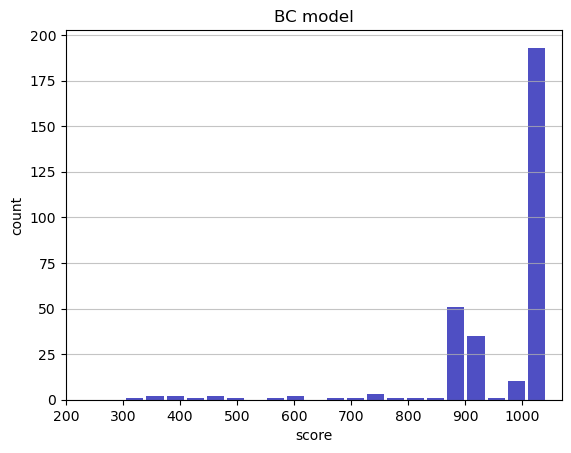

Track generation: 1173..1471 -> 298-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1011..1277 -> 266-tiles track
Epoch: 311
BC	mean: 959.25	variance: 124.00


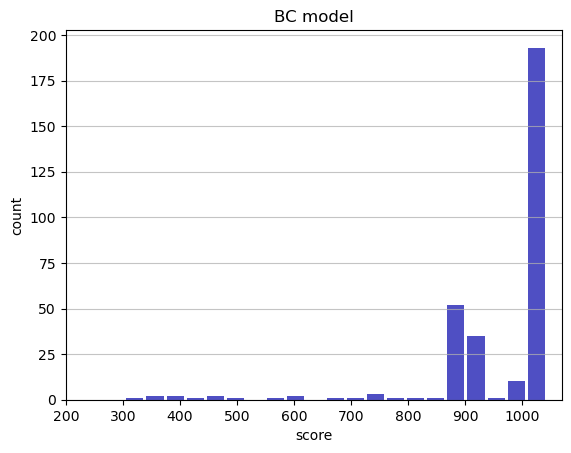

Track generation: 1208..1514 -> 306-tiles track
Epoch: 312
BC	mean: 959.44	variance: 123.85


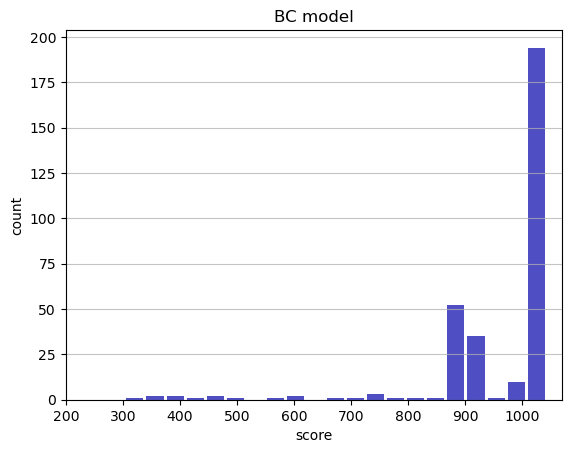

Track generation: 1249..1565 -> 316-tiles track
Epoch: 313
BC	mean: 959.24	variance: 123.71


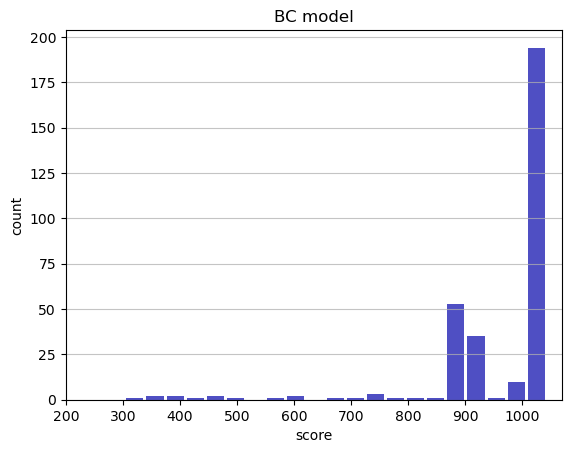

Track generation: 1164..1459 -> 295-tiles track
Epoch: 314
BC	mean: 959.46	variance: 123.57


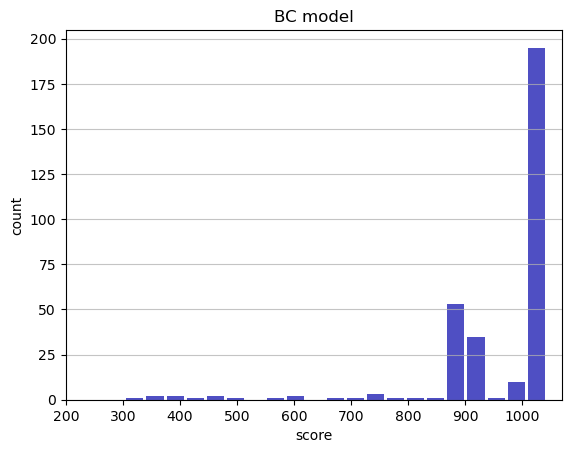

Track generation: 1064..1334 -> 270-tiles track
Epoch: 315
BC	mean: 959.69	variance: 123.44


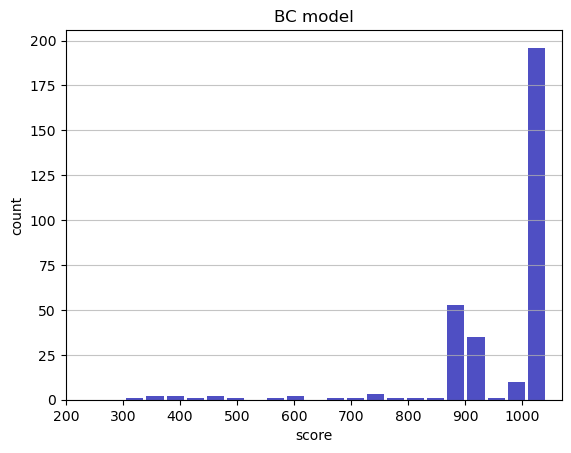

Track generation: 1248..1563 -> 315-tiles track
Epoch: 316
BC	mean: 959.86	variance: 123.29


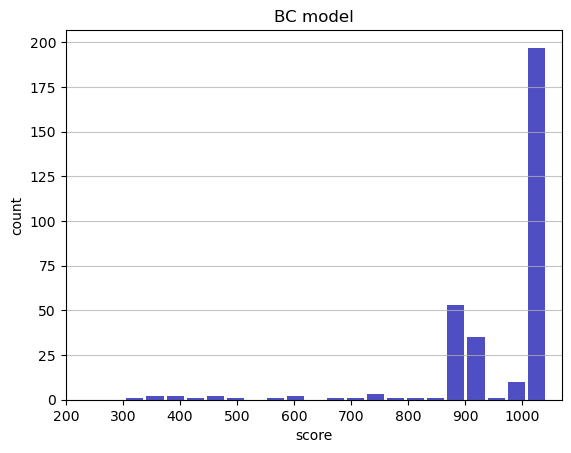

Track generation: 1175..1476 -> 301-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1267..1588 -> 321-tiles track
Epoch: 317
BC	mean: 960.04	variance: 123.13


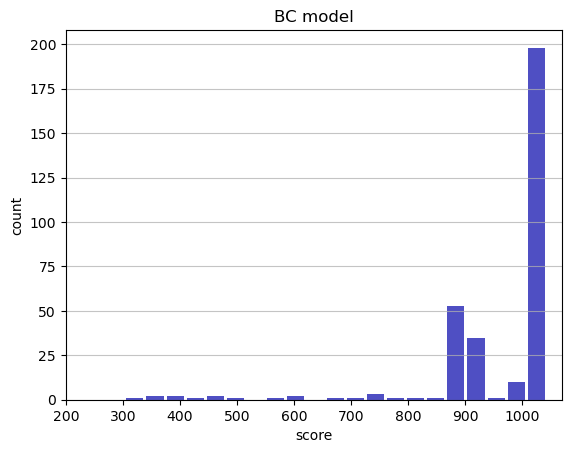

Track generation: 1287..1613 -> 326-tiles track
Epoch: 318
BC	mean: 960.22	variance: 122.98


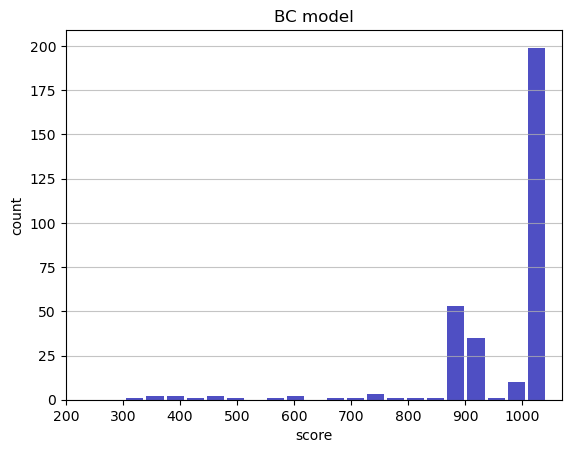

Track generation: 1092..1369 -> 277-tiles track
Epoch: 319
BC	mean: 960.07	variance: 122.82


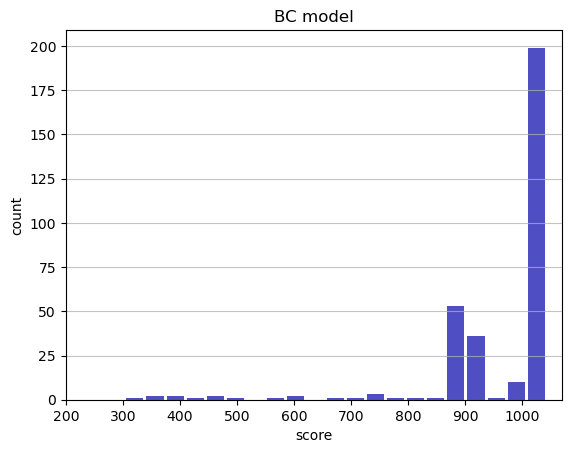

Track generation: 1096..1374 -> 278-tiles track
Epoch: 320
BC	mean: 960.30	variance: 122.69


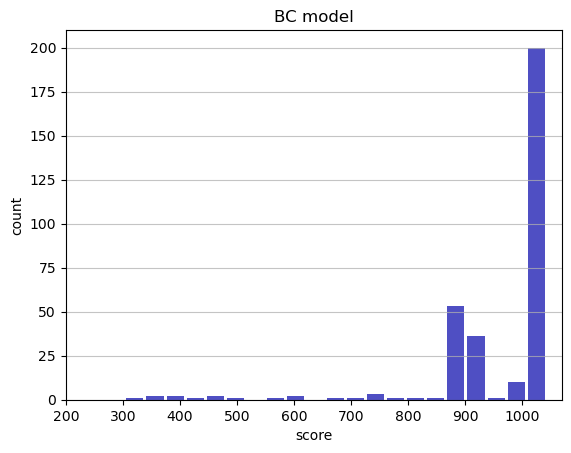

Track generation: 1199..1507 -> 308-tiles track
Epoch: 321
BC	mean: 960.50	variance: 122.55


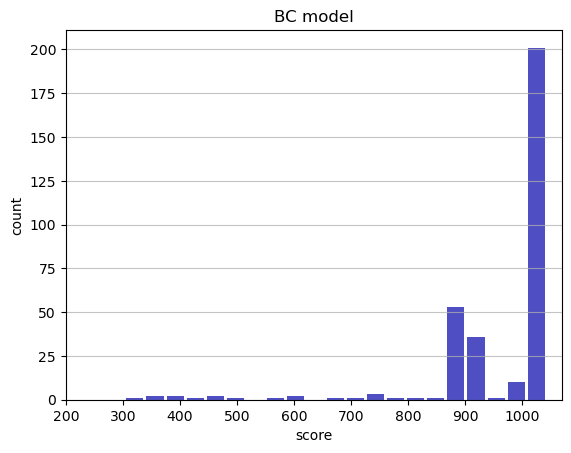

Track generation: 1225..1535 -> 310-tiles track
Epoch: 322
BC	mean: 960.28	variance: 122.43


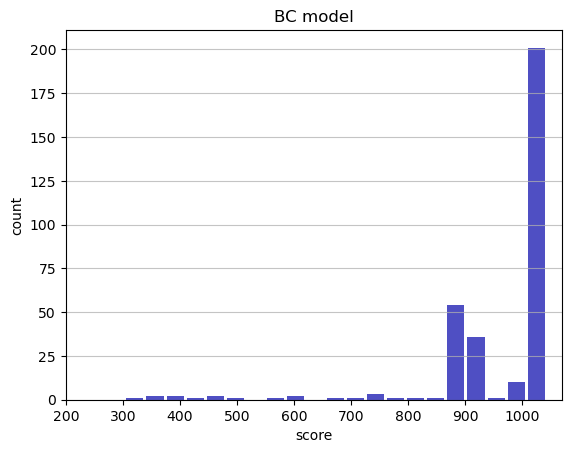

Track generation: 1156..1449 -> 293-tiles track
Epoch: 323
BC	mean: 960.51	variance: 122.30


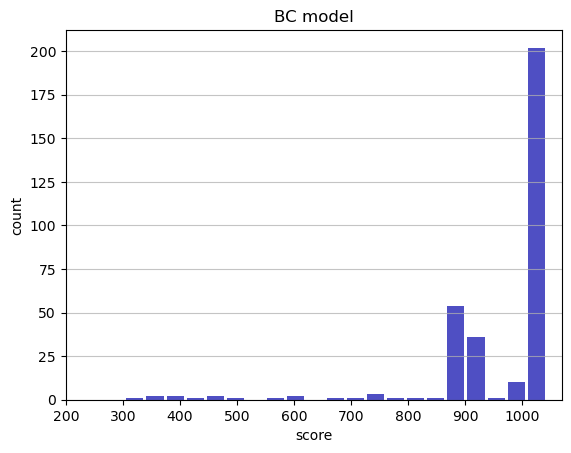

Track generation: 1189..1491 -> 302-tiles track
Epoch: 324
BC	mean: 960.70	variance: 122.16


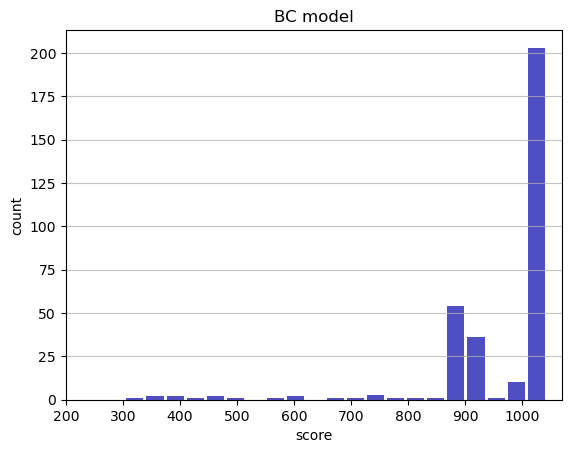

Track generation: 1147..1438 -> 291-tiles track
Epoch: 325
BC	mean: 960.91	variance: 122.03


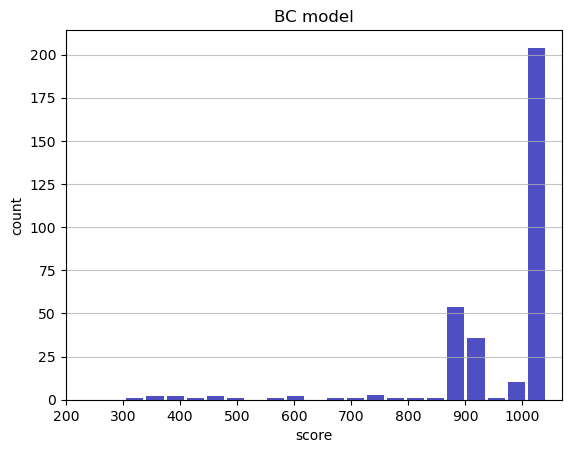

Track generation: 1255..1573 -> 318-tiles track
Epoch: 326
BC	mean: 959.51	variance: 124.43


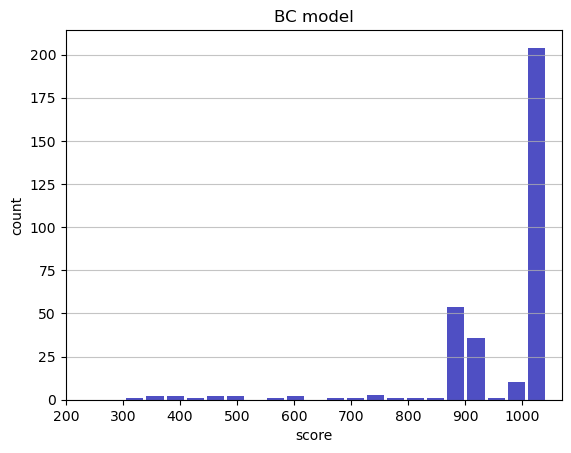

Track generation: 1096..1374 -> 278-tiles track
Epoch: 327
BC	mean: 958.92	variance: 124.69


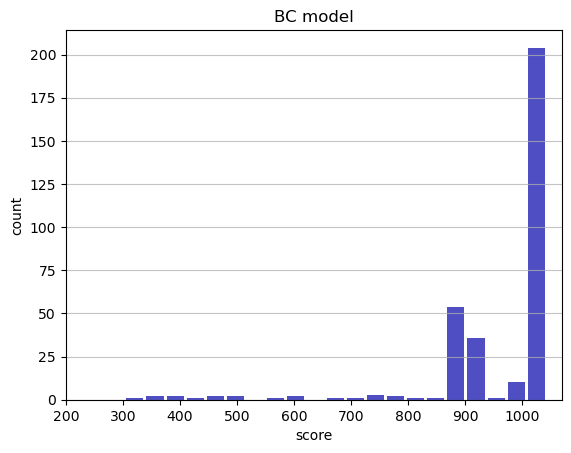

Track generation: 1200..1504 -> 304-tiles track
Epoch: 328
BC	mean: 959.11	variance: 124.55


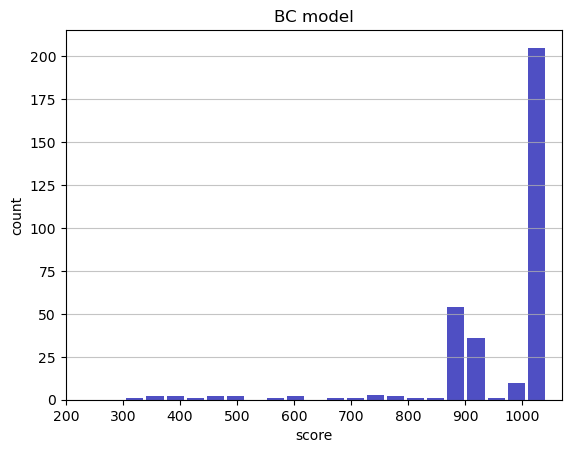

Track generation: 1139..1428 -> 289-tiles track
Epoch: 329
BC	mean: 959.32	variance: 124.42


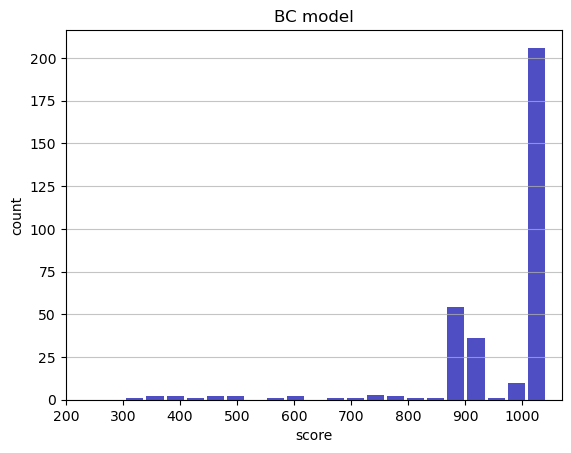

Track generation: 1164..1459 -> 295-tiles track
Epoch: 330
BC	mean: 959.52	variance: 124.28


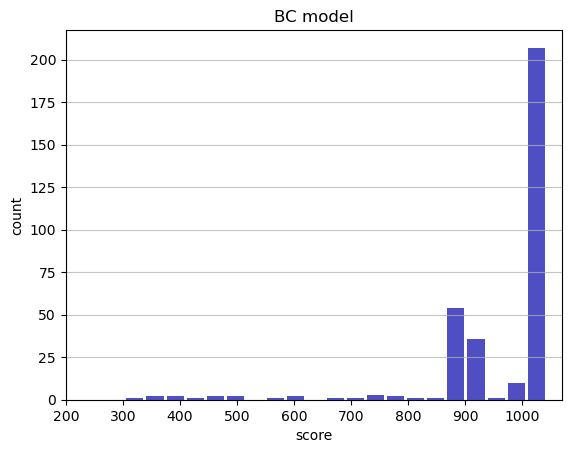

Track generation: 1068..1347 -> 279-tiles track
Epoch: 331
BC	mean: 959.71	variance: 124.14


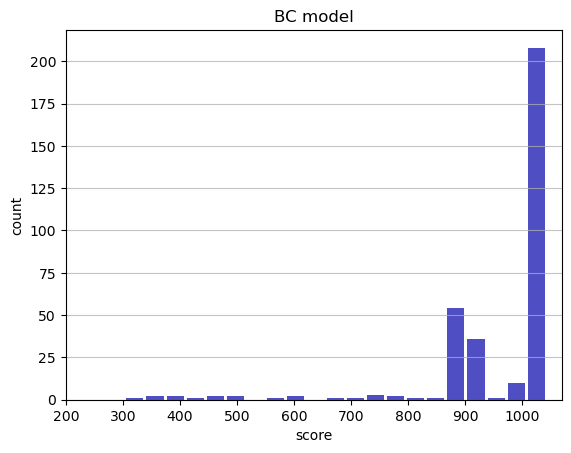

Track generation: 1131..1418 -> 287-tiles track
Epoch: 332
BC	mean: 959.92	variance: 124.01


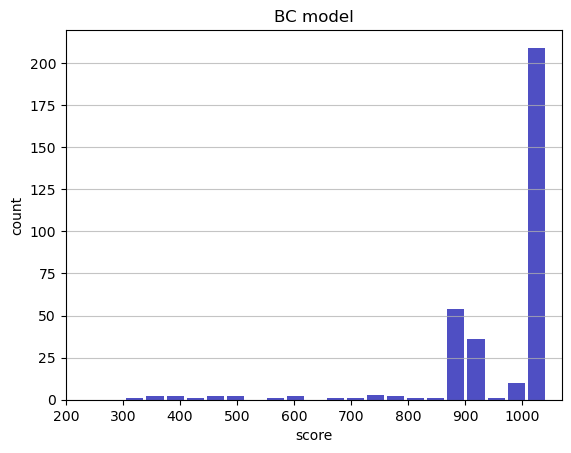

Track generation: 1236..1549 -> 313-tiles track
Epoch: 333
BC	mean: 959.76	variance: 123.87


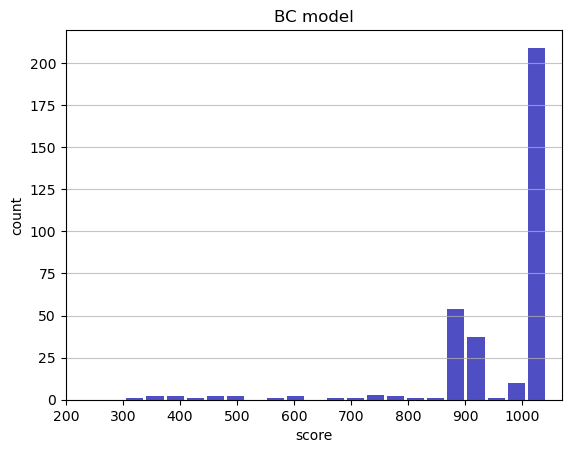

Track generation: 1010..1267 -> 257-tiles track
Epoch: 334
BC	mean: 959.60	variance: 123.71


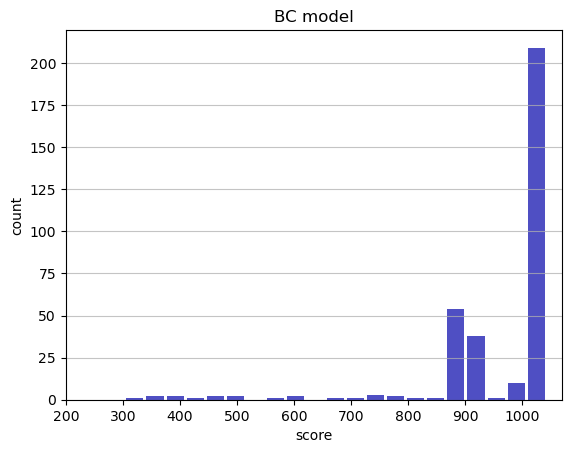

Track generation: 1071..1345 -> 274-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1115..1398 -> 283-tiles track
Epoch: 335
BC	mean: 959.82	variance: 123.59


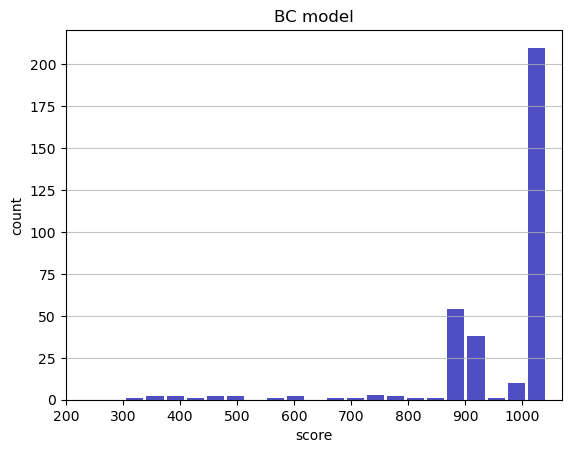

Track generation: 1243..1564 -> 321-tiles track
Epoch: 336
BC	mean: 957.92	variance: 128.18


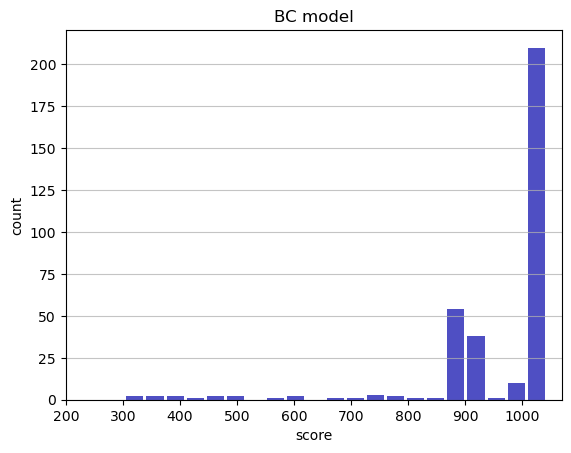

Track generation: 1200..1504 -> 304-tiles track
Epoch: 337
BC	mean: 957.72	variance: 128.05


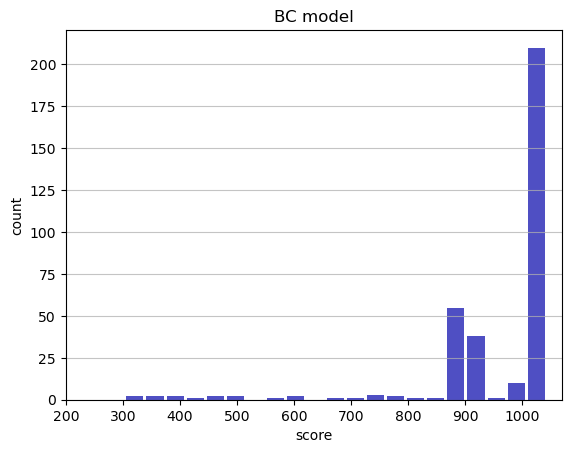

Track generation: 1340..1679 -> 339-tiles track
Epoch: 338
BC	mean: 957.51	variance: 127.91


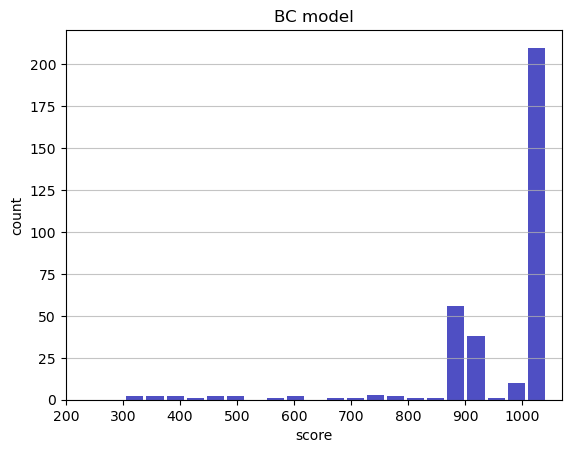

Track generation: 1155..1448 -> 293-tiles track
Epoch: 339
BC	mean: 957.72	variance: 127.78


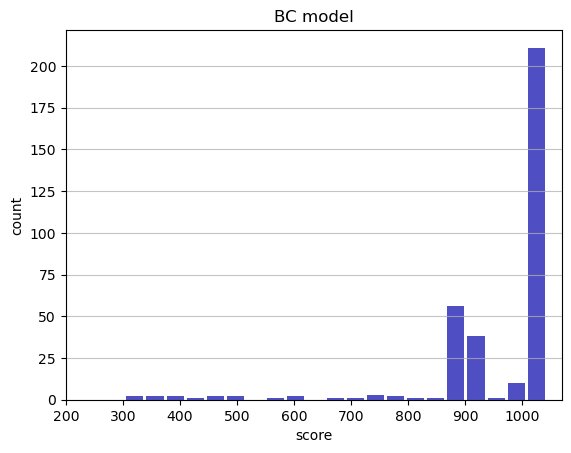

Track generation: 1147..1438 -> 291-tiles track
Epoch: 340
BC	mean: 957.93	variance: 127.66


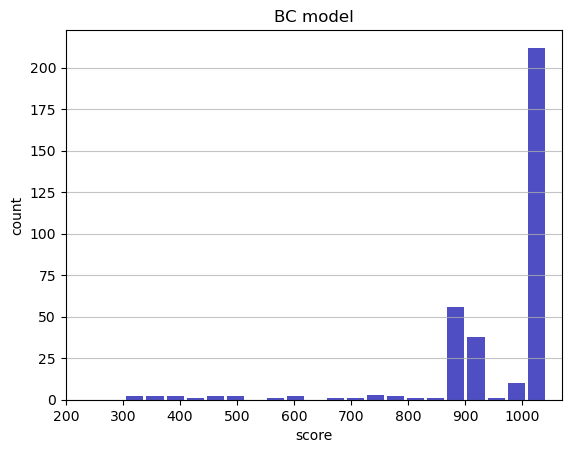

Track generation: 1062..1332 -> 270-tiles track
Epoch: 341
BC	mean: 958.16	variance: 127.54


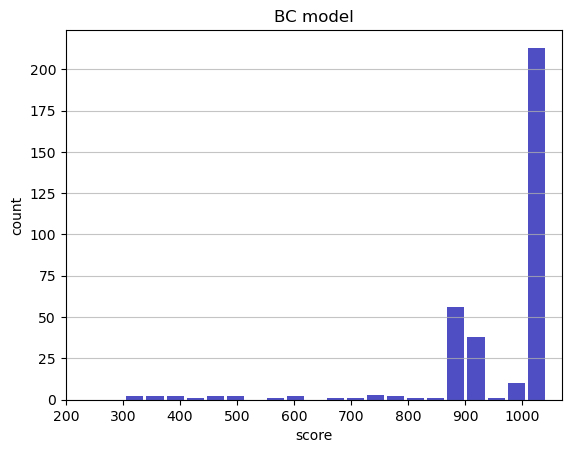

Track generation: 1220..1539 -> 319-tiles track
Epoch: 342
BC	mean: 958.33	variance: 127.39


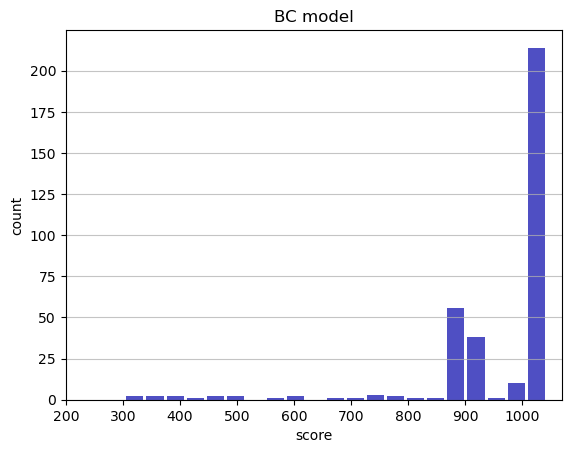

Track generation: 1266..1587 -> 321-tiles track
Epoch: 343
BC	mean: 958.09	variance: 127.28


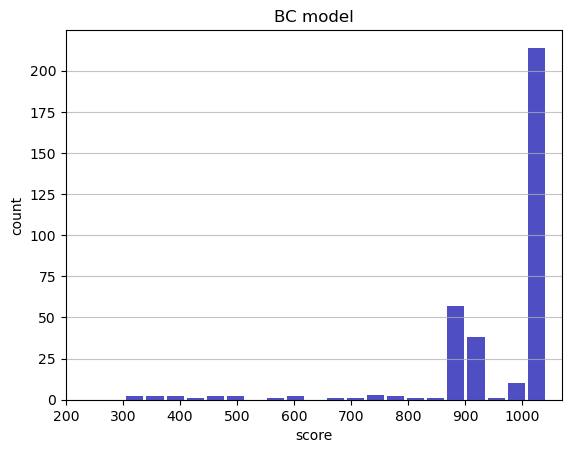

Track generation: 1036..1299 -> 263-tiles track
Epoch: 344
BC	mean: 958.33	variance: 127.17


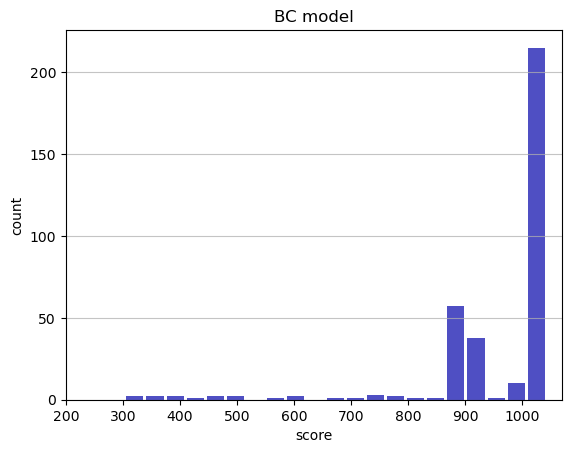

Track generation: 1217..1525 -> 308-tiles track
Epoch: 345
BC	mean: 958.50	variance: 127.02


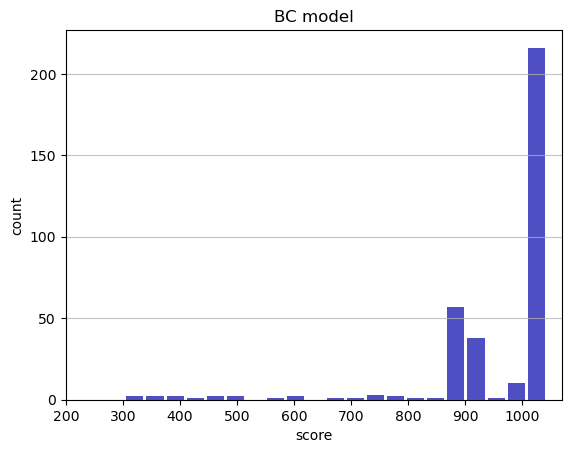

Track generation: 1212..1482 -> 270-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1203..1508 -> 305-tiles track
Epoch: 346
BC	mean: 958.31	variance: 126.89


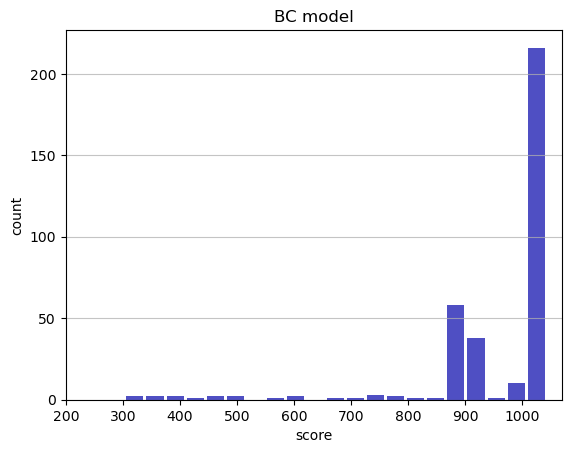

Track generation: 1245..1561 -> 316-tiles track
Epoch: 347
BC	mean: 958.48	variance: 126.74


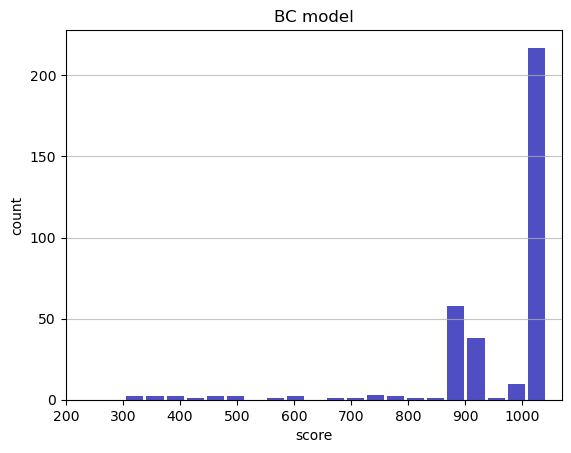

Track generation: 1188..1489 -> 301-tiles track
Epoch: 348
BC	mean: 958.67	variance: 126.61


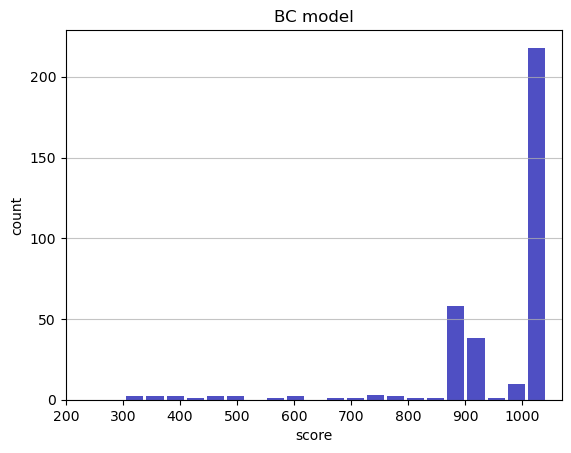

Track generation: 1068..1337 -> 269-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1250..1567 -> 317-tiles track
Epoch: 349
BC	mean: 958.50	variance: 126.47


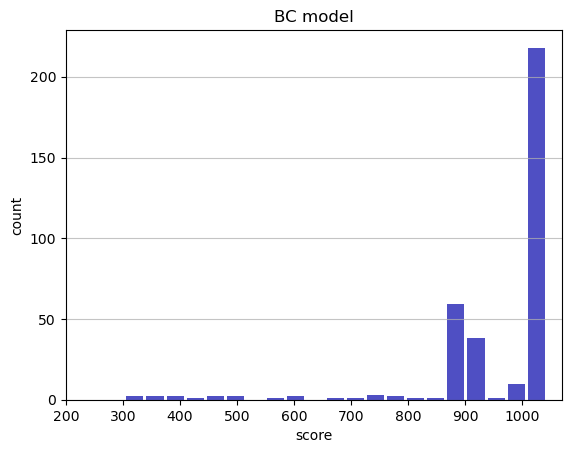

Track generation: 1146..1437 -> 291-tiles track
Epoch: 350
BC	mean: 958.69	variance: 126.34


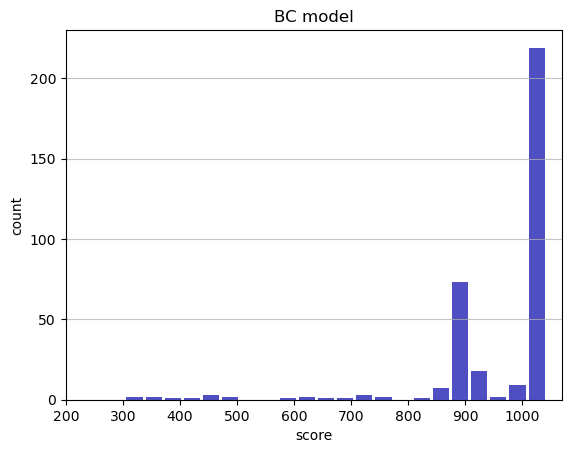

Track generation: 1227..1538 -> 311-tiles track
Epoch: 351
BC	mean: 958.87	variance: 126.20


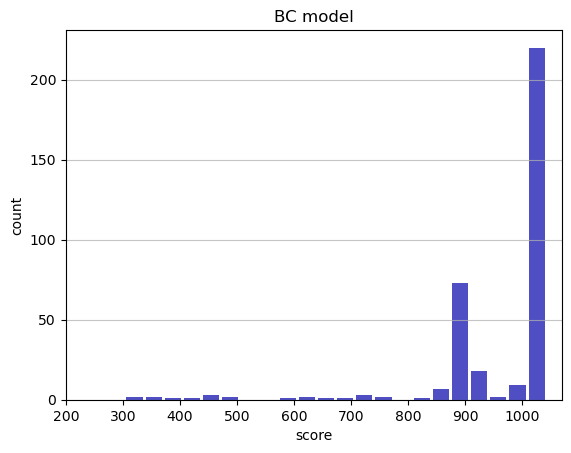

Track generation: 1072..1346 -> 274-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1077..1351 -> 274-tiles track
Epoch: 352
BC	mean: 957.88	variance: 127.37


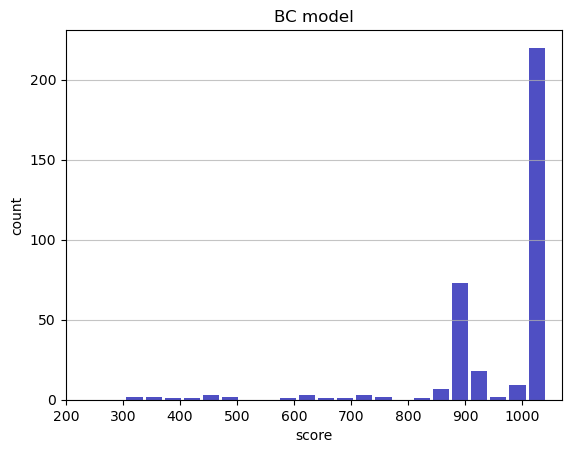

Track generation: 1254..1563 -> 309-tiles track
Epoch: 353
BC	mean: 957.67	variance: 127.25


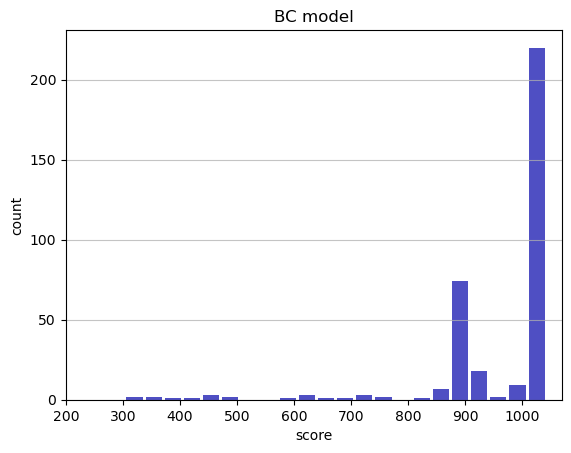

Track generation: 1192..1494 -> 302-tiles track
Epoch: 354
BC	mean: 957.45	variance: 127.14


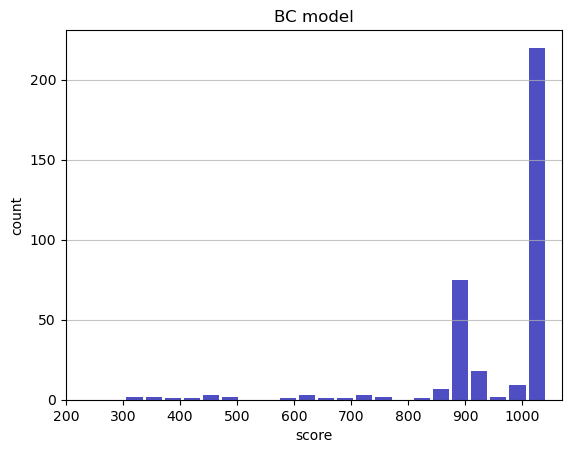

Track generation: 1124..1409 -> 285-tiles track
Epoch: 355
BC	mean: 957.31	variance: 126.99


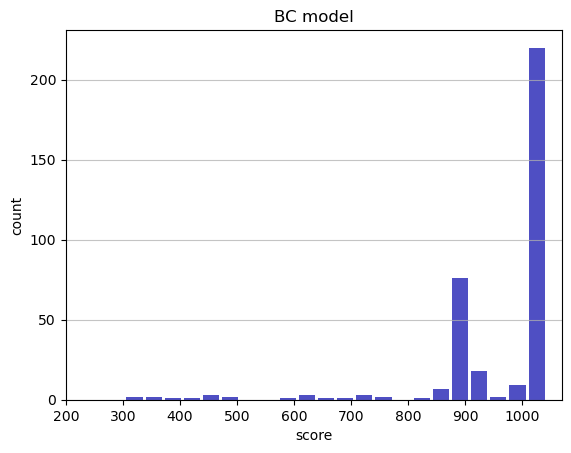

Track generation: 1083..1358 -> 275-tiles track
Epoch: 356
BC	mean: 957.52	variance: 126.88


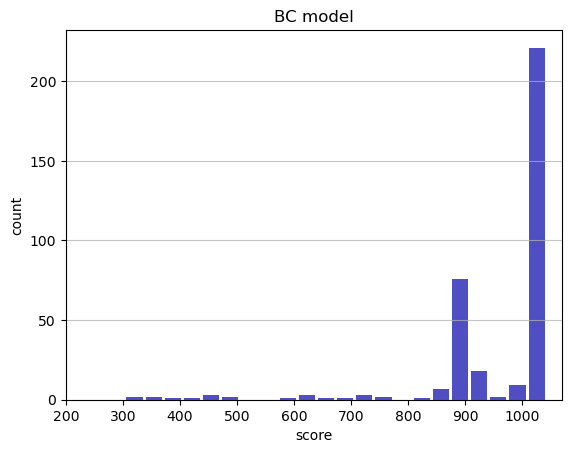

Track generation: 1029..1290 -> 261-tiles track
Epoch: 357
BC	mean: 957.40	variance: 126.73


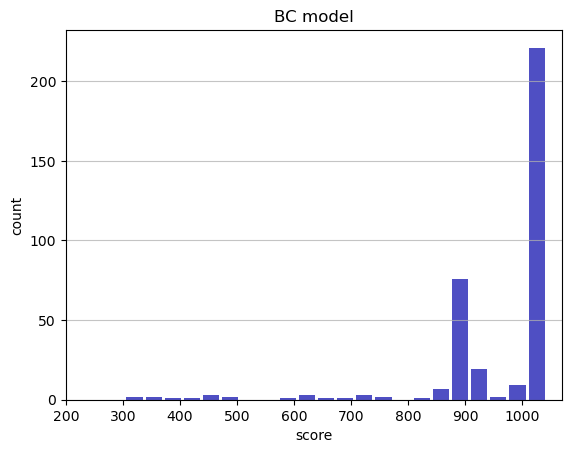

Track generation: 1037..1304 -> 267-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1217..1530 -> 313-tiles track
Epoch: 358
BC	mean: 957.57	variance: 126.59


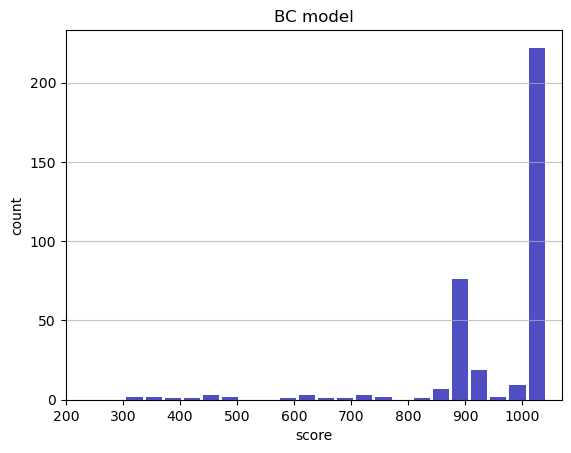

Track generation: 1088..1364 -> 276-tiles track
Epoch: 359
BC	mean: 957.77	variance: 126.47


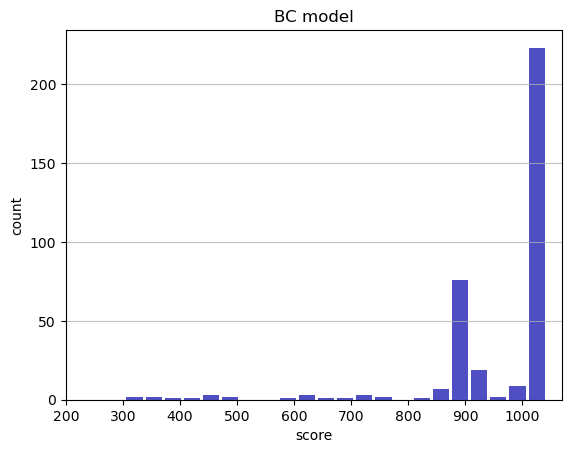

Track generation: 1215..1523 -> 308-tiles track
Epoch: 360
BC	mean: 957.60	variance: 126.33


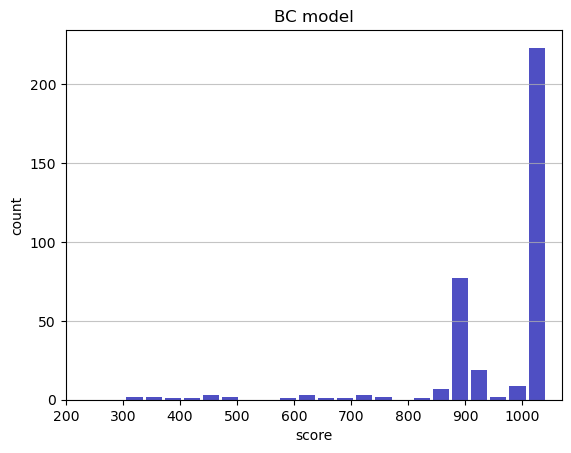

Track generation: 1145..1436 -> 291-tiles track
Epoch: 361
BC	mean: 957.79	variance: 126.20


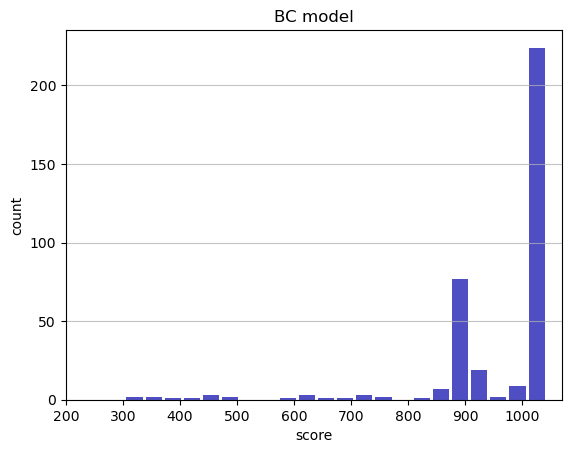

Track generation: 1132..1419 -> 287-tiles track
Epoch: 362
BC	mean: 957.99	variance: 126.09


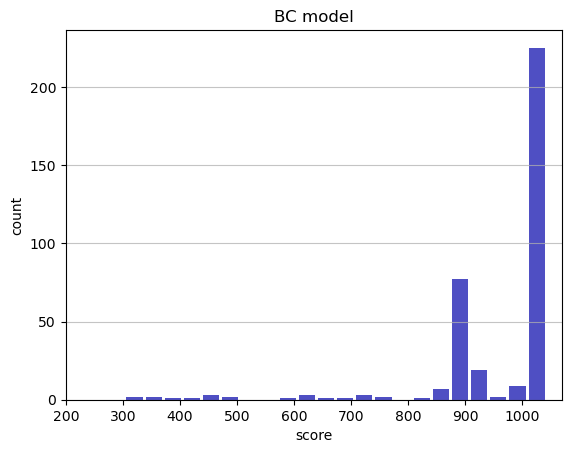

Track generation: 1196..1502 -> 306-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1140..1431 -> 291-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 982..1239 -> 257-tiles track
Epoch: 363
BC	mean: 958.21	variance: 125.98


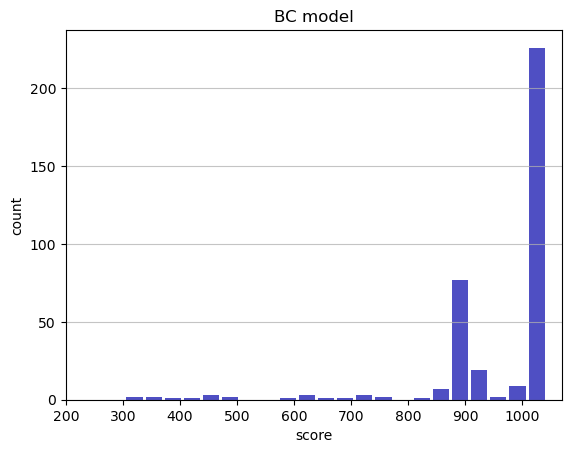

Track generation: 1249..1565 -> 316-tiles track
Epoch: 364
BC	mean: 958.04	variance: 125.85


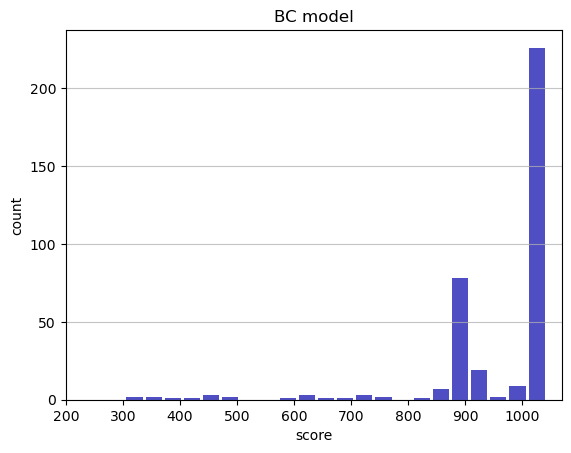

Track generation: 1035..1305 -> 270-tiles track
Epoch: 365
BC	mean: 957.90	variance: 125.71


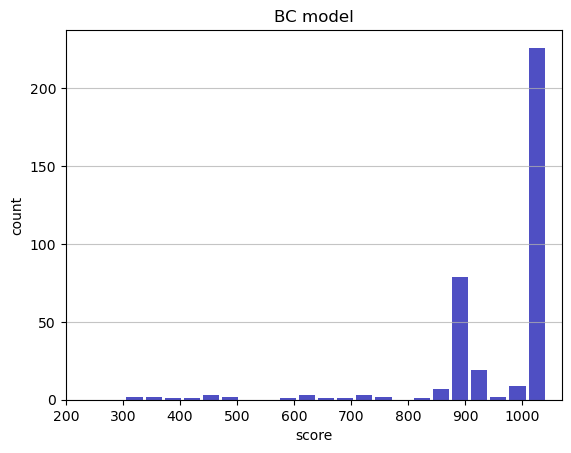

Track generation: 1032..1299 -> 267-tiles track
Epoch: 366
BC	mean: 958.08	variance: 125.58


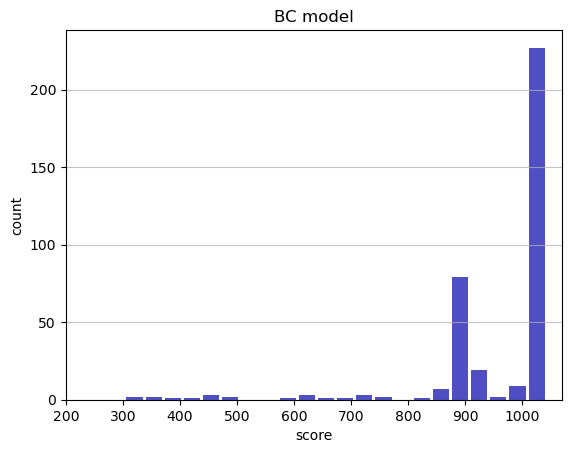

Track generation: 1185..1485 -> 300-tiles track
Epoch: 367
BC	mean: 958.24	variance: 125.45


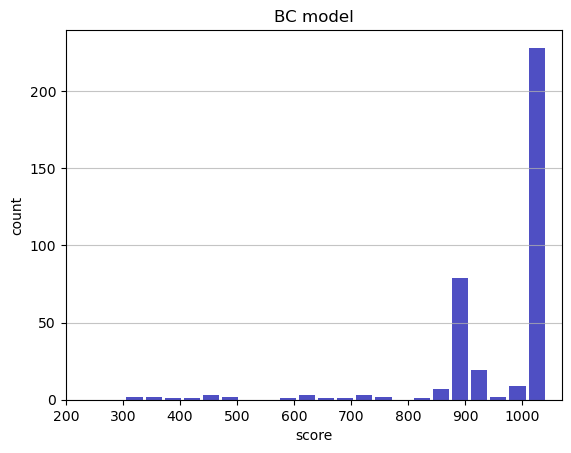

Track generation: 1184..1484 -> 300-tiles track
Epoch: 368
BC	mean: 958.42	variance: 125.33


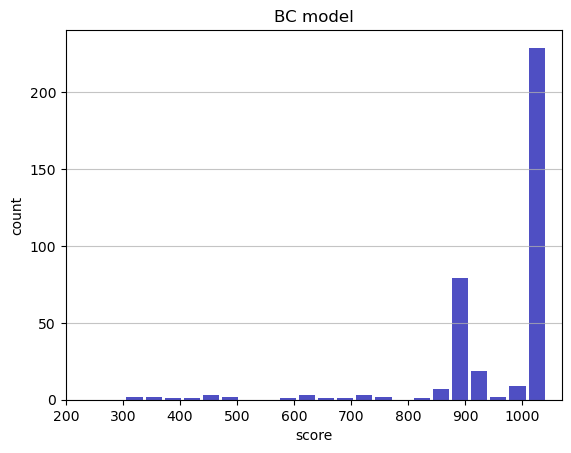

Track generation: 1205..1510 -> 305-tiles track
Epoch: 369
BC	mean: 958.59	variance: 125.20


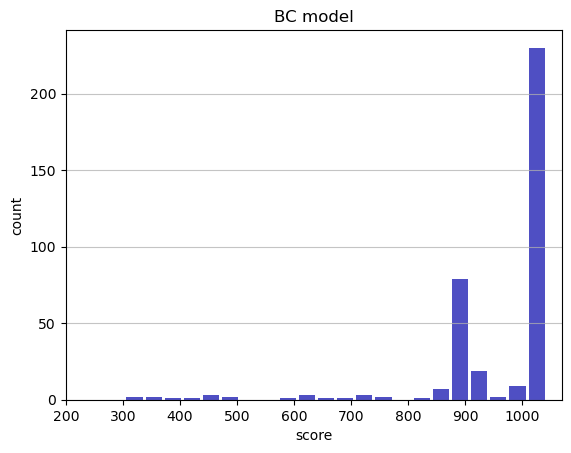

Track generation: 1156..1449 -> 293-tiles track
Epoch: 370
BC	mean: 958.43	variance: 125.07


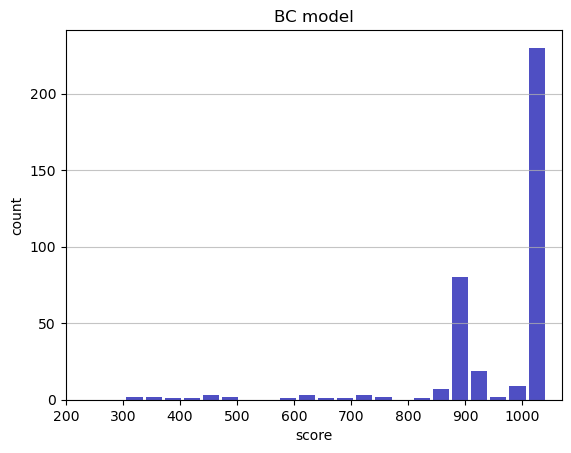

Track generation: 1208..1514 -> 306-tiles track
Epoch: 371
BC	mean: 958.61	variance: 124.95


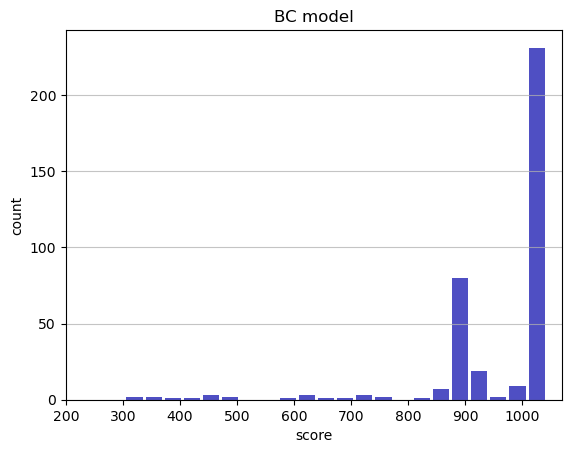

Track generation: 1086..1368 -> 282-tiles track
Epoch: 372
BC	mean: 958.79	variance: 124.83


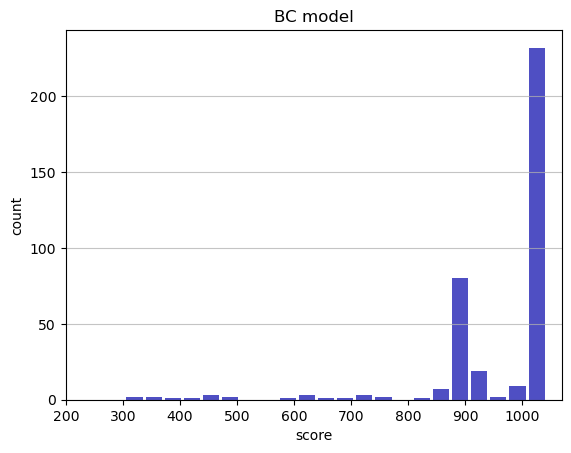

Track generation: 1148..1439 -> 291-tiles track
Epoch: 373
BC	mean: 957.76	variance: 126.24


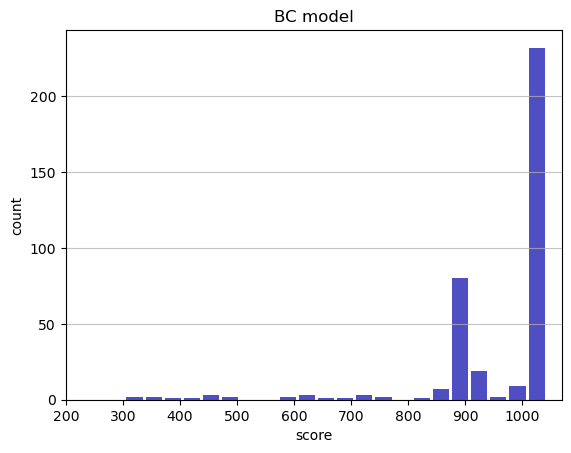

Track generation: 1156..1457 -> 301-tiles track
Epoch: 374
BC	mean: 957.93	variance: 126.11


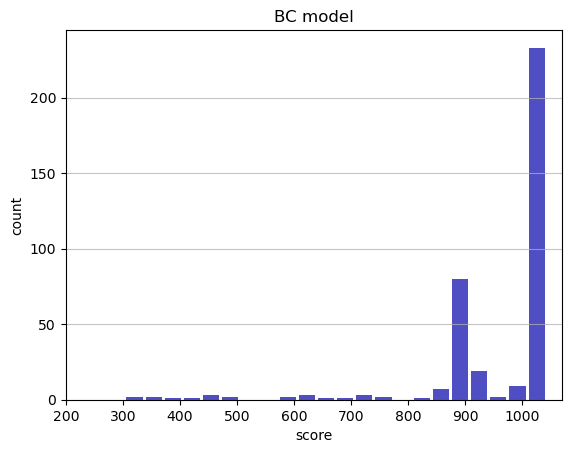

Track generation: 995..1247 -> 252-tiles track
Epoch: 375
BC	mean: 958.13	variance: 126.00


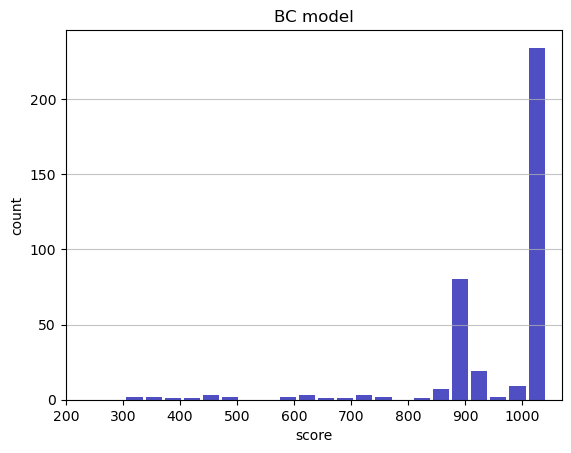

Track generation: 1244..1559 -> 315-tiles track
Epoch: 376
BC	mean: 958.30	variance: 125.88


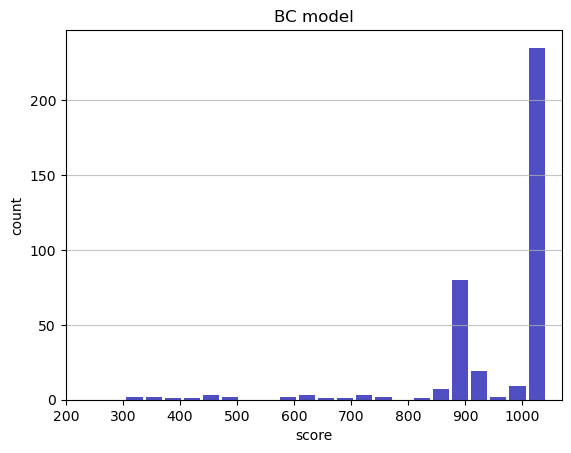

Track generation: 1138..1433 -> 295-tiles track
Epoch: 377
BC	mean: 958.47	variance: 125.76


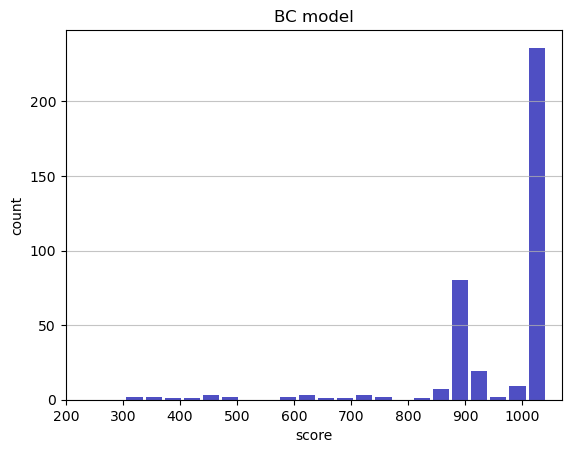

Track generation: 1263..1583 -> 320-tiles track
Epoch: 378
BC	mean: 958.62	variance: 125.62


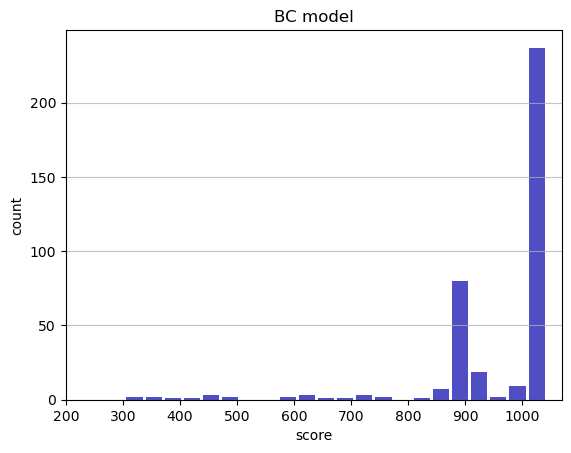

Track generation: 1248..1564 -> 316-tiles track
Epoch: 379
BC	mean: 958.79	variance: 125.50


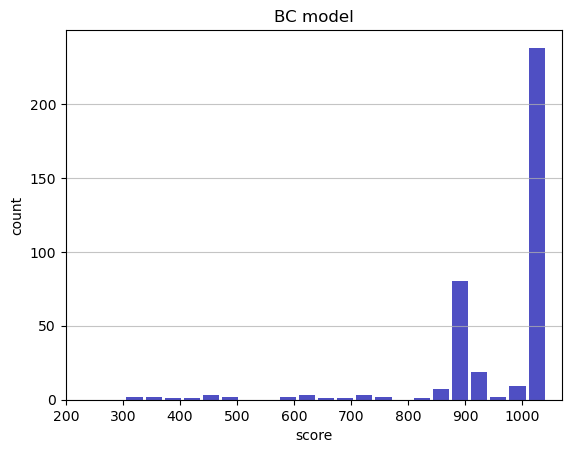

Track generation: 1151..1443 -> 292-tiles track
Epoch: 380
BC	mean: 958.97	variance: 125.39


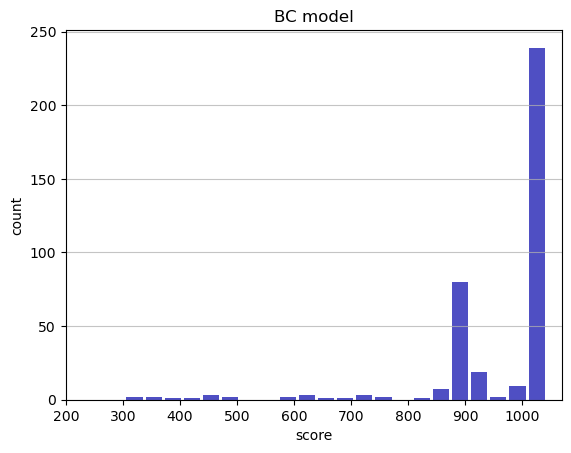

Track generation: 1293..1620 -> 327-tiles track
Epoch: 381
BC	mean: 959.11	variance: 125.25


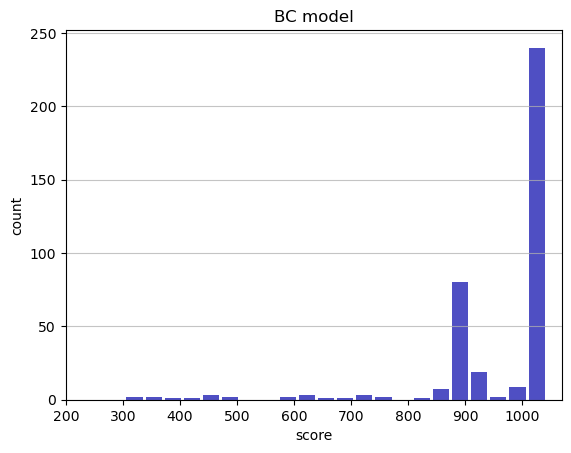

Track generation: 1278..1602 -> 324-tiles track
Epoch: 382
BC	mean: 959.26	variance: 125.12


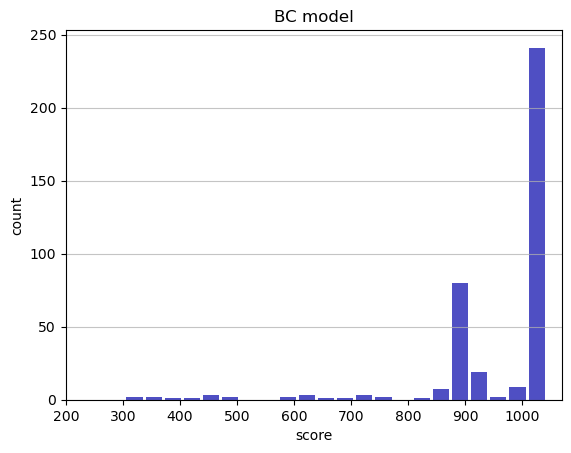

Track generation: 1322..1657 -> 335-tiles track
Epoch: 383
BC	mean: 959.39	variance: 124.98


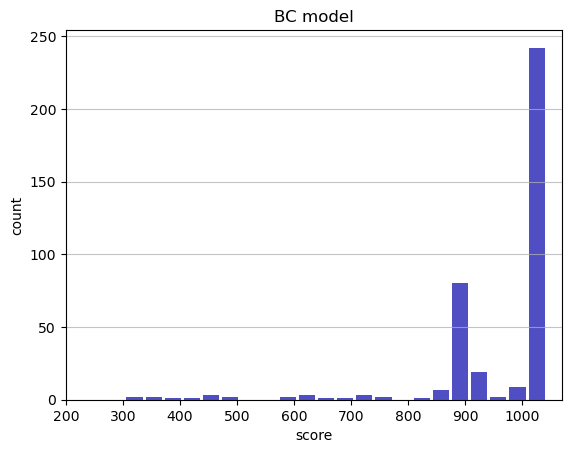

Track generation: 1027..1292 -> 265-tiles track
Epoch: 384
BC	mean: 959.58	variance: 124.87


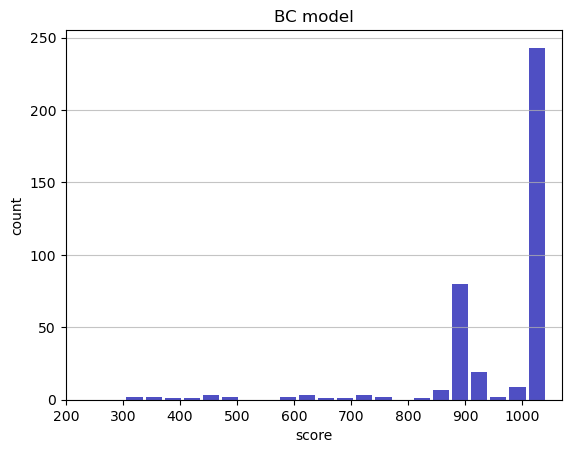

Track generation: 1099..1384 -> 285-tiles track
Epoch: 385
BC	mean: 959.17	variance: 124.96


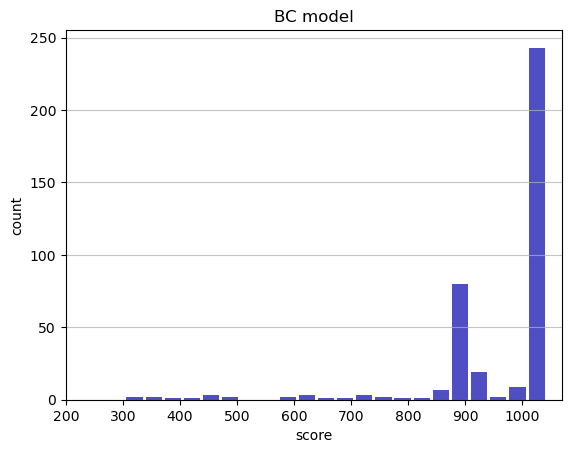

Track generation: 1199..1503 -> 304-tiles track
Epoch: 386
BC	mean: 959.34	variance: 124.85


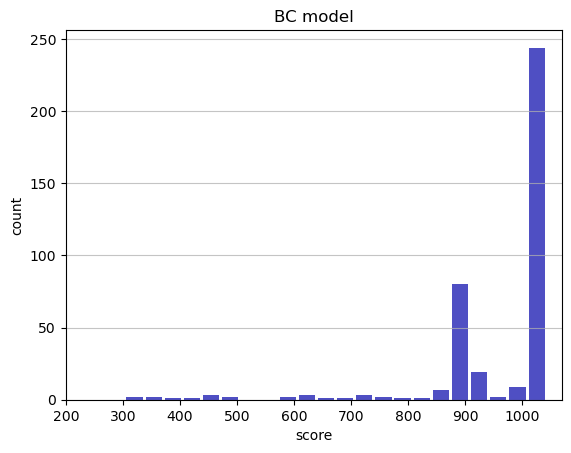

Track generation: 1264..1584 -> 320-tiles track
Epoch: 387
BC	mean: 959.49	variance: 124.72


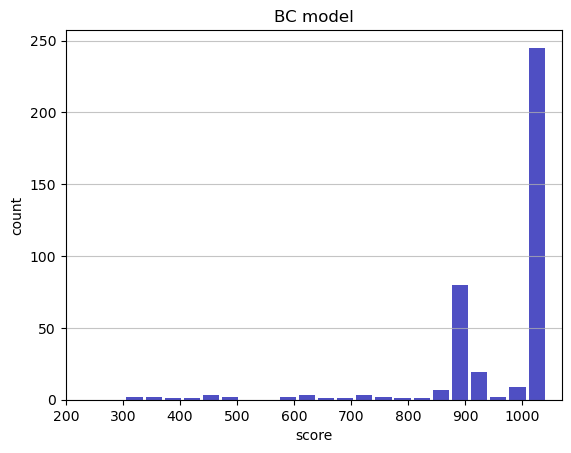

Track generation: 1313..1644 -> 331-tiles track
Epoch: 388
BC	mean: 957.78	variance: 129.02


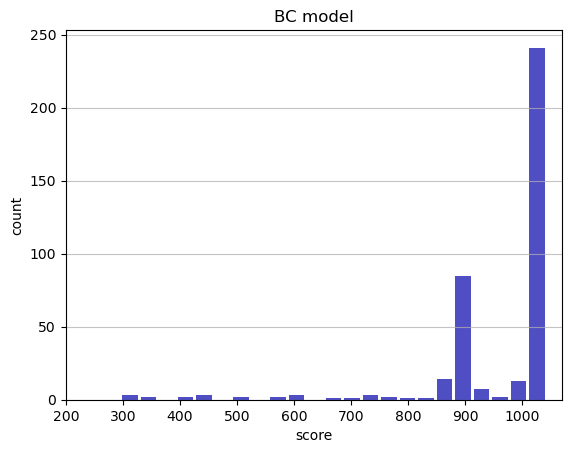

Track generation: 949..1198 -> 249-tiles track
Epoch: 389
BC	mean: 957.97	variance: 128.91


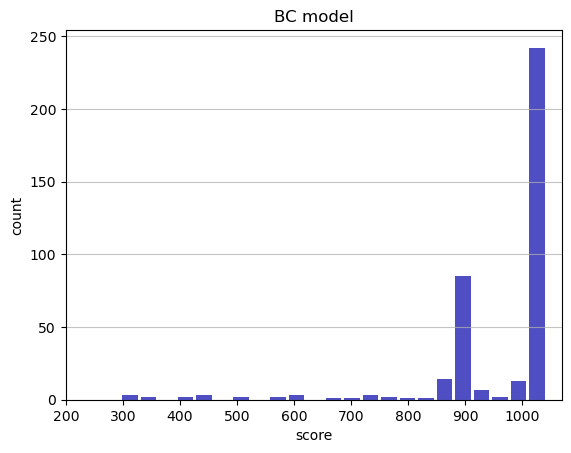

Track generation: 1171..1468 -> 297-tiles track
Epoch: 390
BC	mean: 957.84	variance: 128.77


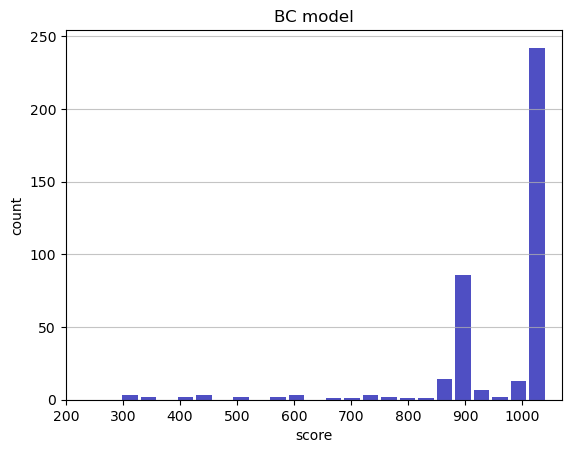

Track generation: 1155..1448 -> 293-tiles track
Epoch: 391
BC	mean: 957.67	variance: 128.65


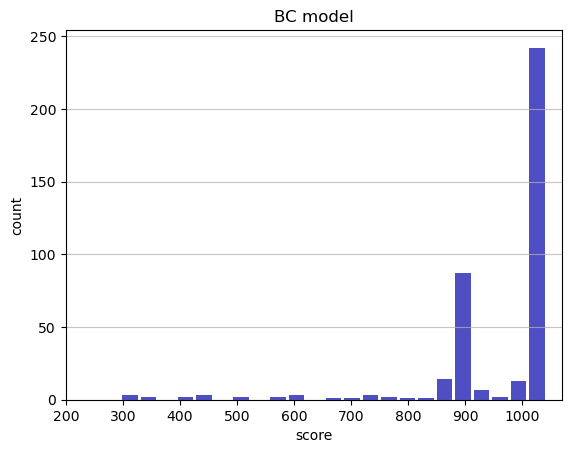

Track generation: 1139..1434 -> 295-tiles track
Epoch: 392
BC	mean: 957.84	variance: 128.53


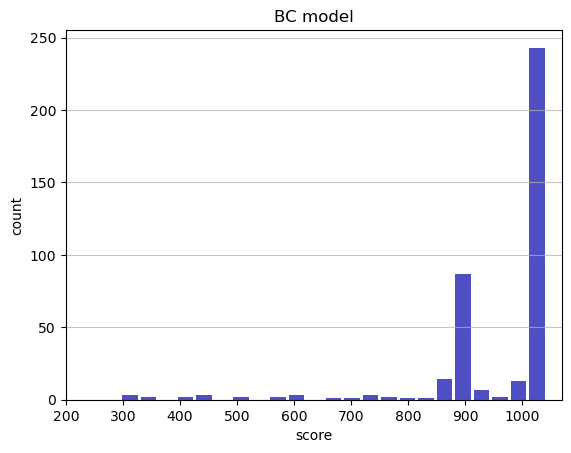

Track generation: 1161..1455 -> 294-tiles track
Epoch: 393
BC	mean: 958.02	variance: 128.42


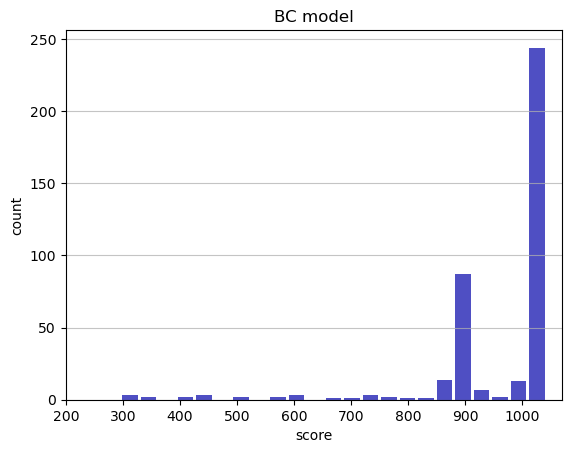

Track generation: 1264..1584 -> 320-tiles track
Epoch: 394
BC	mean: 958.17	variance: 128.29


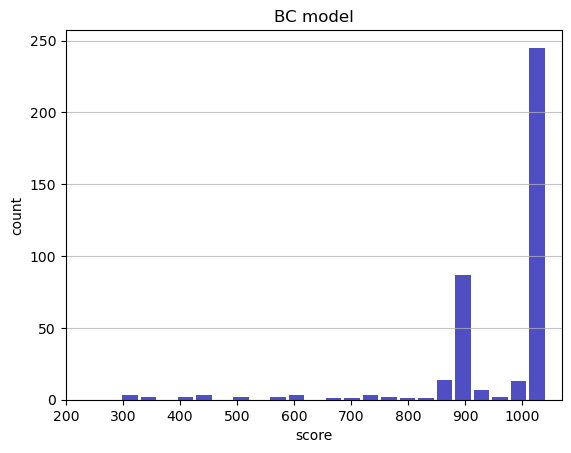

Track generation: 1164..1459 -> 295-tiles track
Epoch: 395
BC	mean: 958.04	variance: 128.15


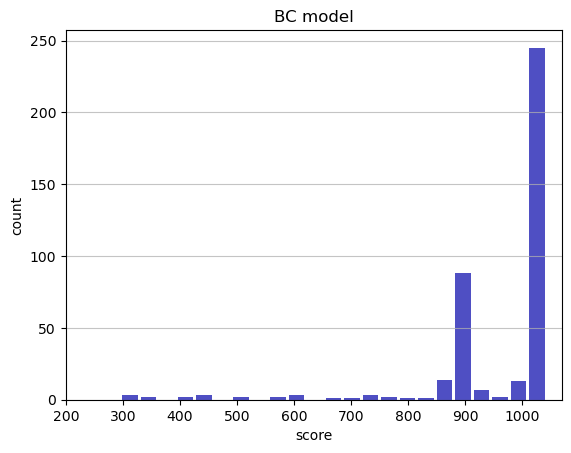

Track generation: 1030..1298 -> 268-tiles track
Epoch: 396
BC	mean: 958.22	variance: 128.05


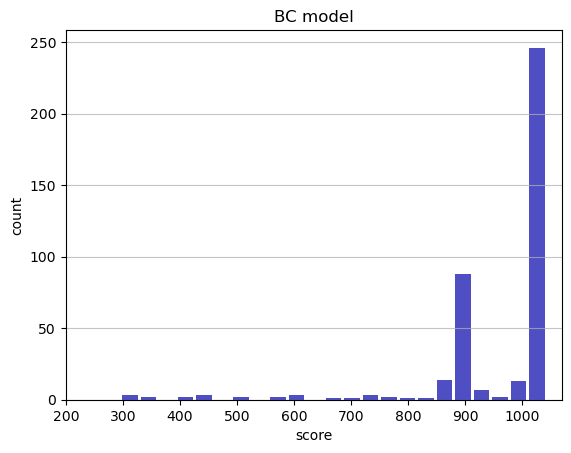

Track generation: 1167..1463 -> 296-tiles track
Epoch: 397
BC	mean: 958.39	variance: 127.93


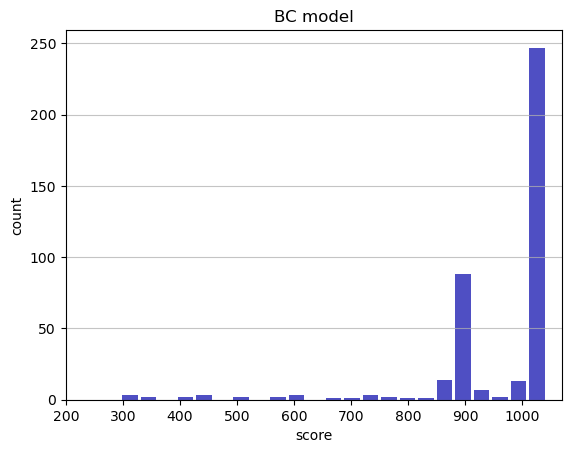

Track generation: 1079..1363 -> 284-tiles track
Epoch: 398
BC	mean: 958.56	variance: 127.81


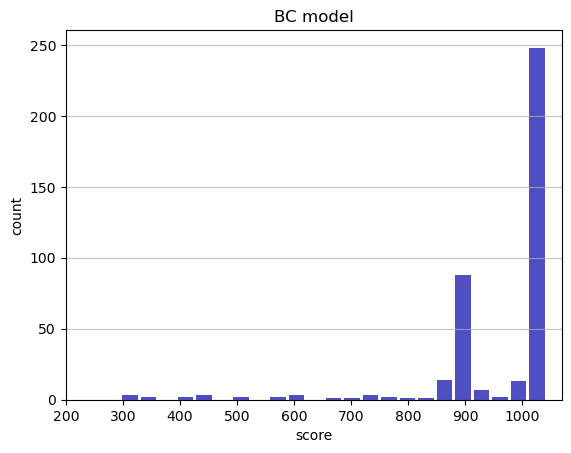

Track generation: 1140..1436 -> 296-tiles track
Epoch: 399
BC	mean: 958.70	variance: 127.68


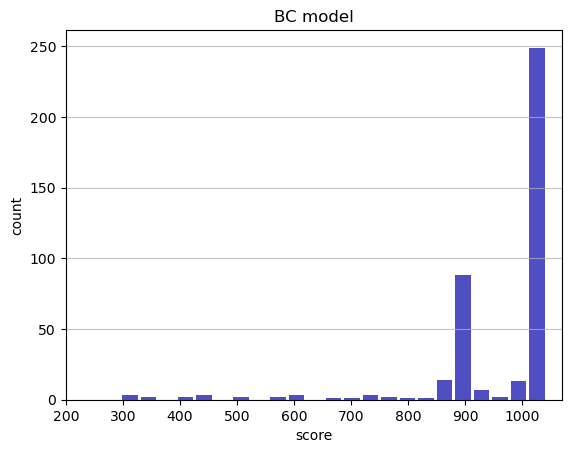

Track generation: 1147..1438 -> 291-tiles track
Epoch: 400
BC	mean: 958.88	variance: 127.57


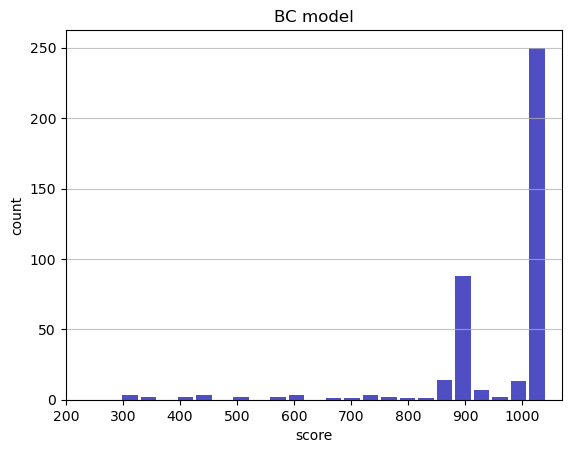

Track generation: 1170..1467 -> 297-tiles track
Epoch: 401
BC	mean: 959.04	variance: 127.45


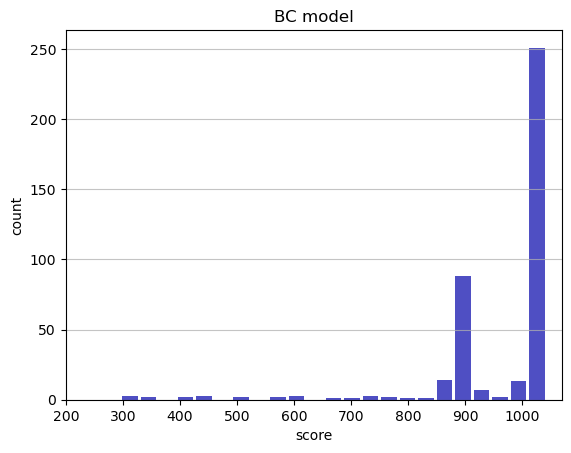

Track generation: 1245..1560 -> 315-tiles track
Epoch: 402
BC	mean: 959.17	variance: 127.32


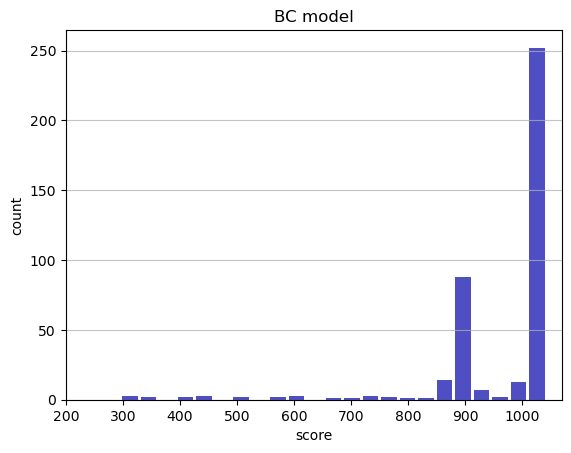

Track generation: 1160..1454 -> 294-tiles track
Epoch: 403
BC	mean: 959.03	variance: 127.19


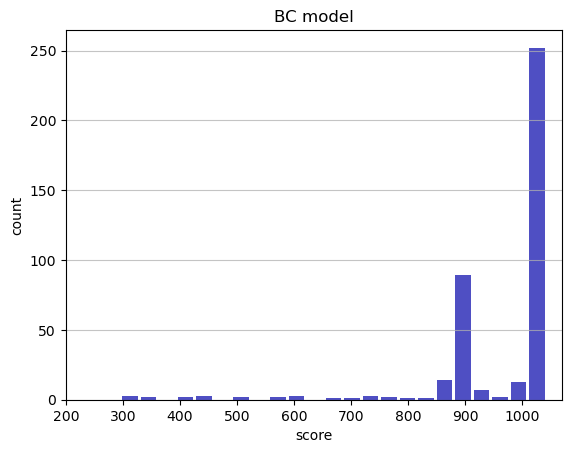

Track generation: 1123..1413 -> 290-tiles track
Epoch: 404
BC	mean: 958.88	variance: 127.07


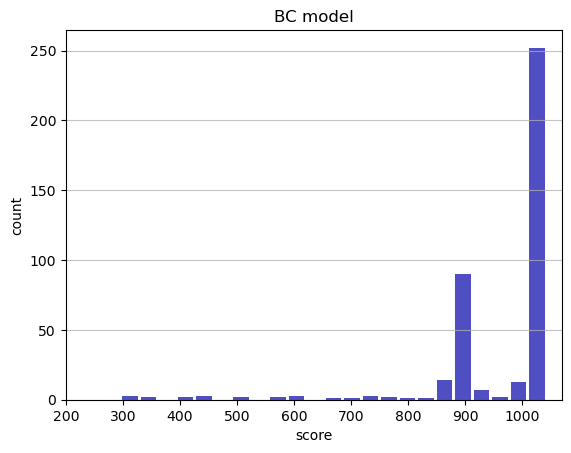

Track generation: 1046..1318 -> 272-tiles track
Epoch: 405
BC	mean: 959.05	variance: 126.96


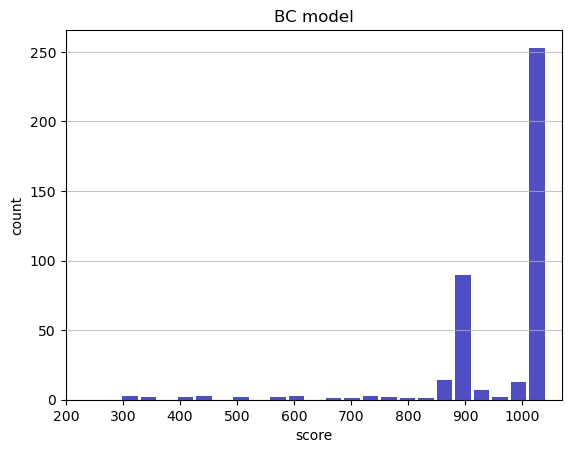

Track generation: 1047..1313 -> 266-tiles track
Epoch: 406
BC	mean: 958.82	variance: 126.89


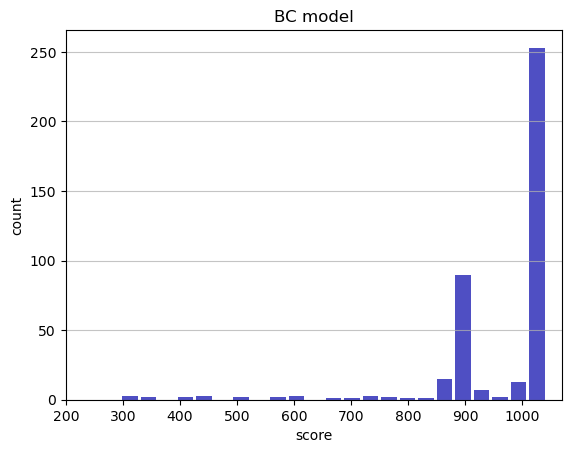

Track generation: 1238..1552 -> 314-tiles track
Epoch: 407
BC	mean: 957.95	variance: 127.94


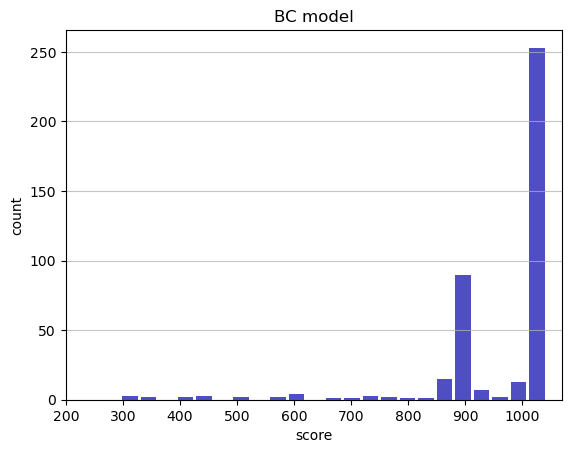

Track generation: 1291..1618 -> 327-tiles track
Epoch: 408
BC	mean: 958.07	variance: 127.81


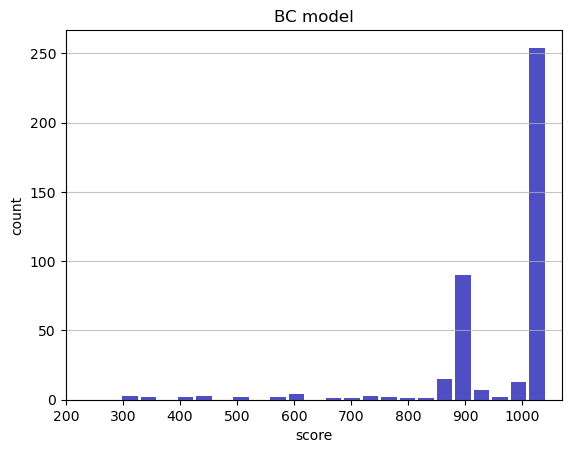

Track generation: 1021..1286 -> 265-tiles track
Epoch: 409
BC	mean: 957.94	variance: 127.69


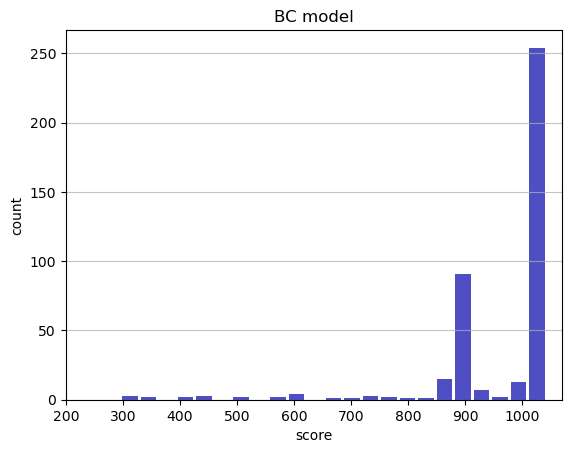

Track generation: 1371..1724 -> 353-tiles track
Epoch: 410
BC	mean: 958.00	variance: 127.54


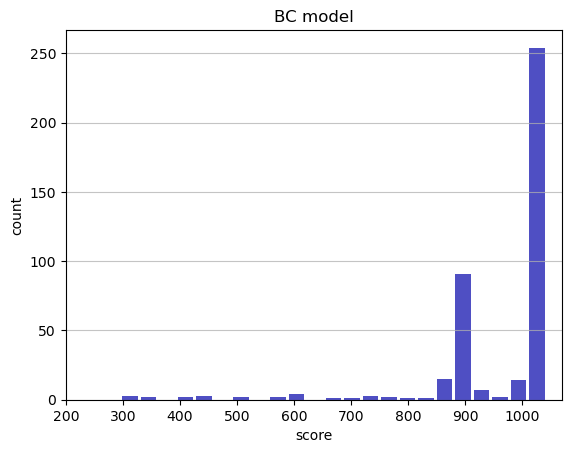

Track generation: 1169..1465 -> 296-tiles track
Epoch: 411
BC	mean: 957.76	variance: 127.48


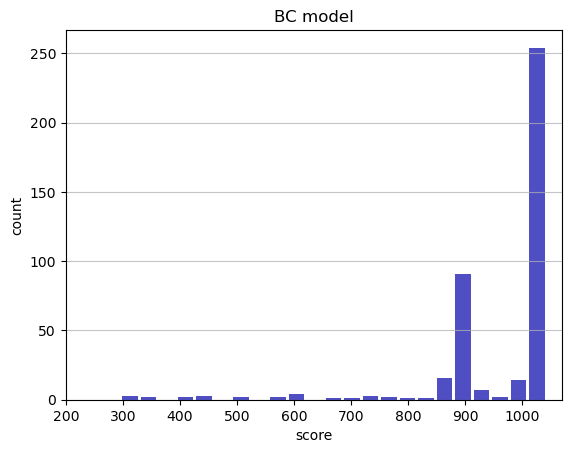

Track generation: 1077..1350 -> 273-tiles track
Epoch: 412
BC	mean: 957.93	variance: 127.37


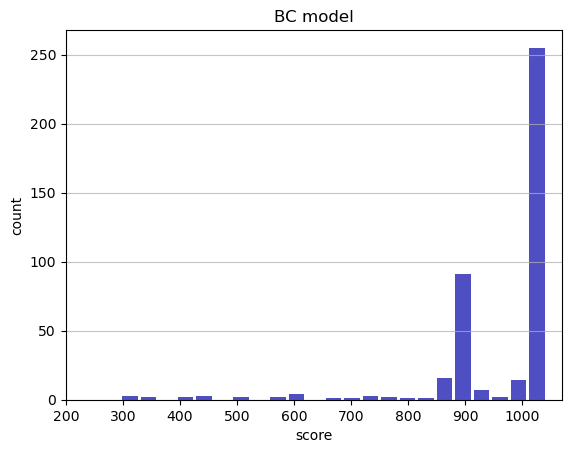

Track generation: 1138..1429 -> 291-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1283..1608 -> 325-tiles track
Epoch: 413
BC	mean: 958.06	variance: 127.25


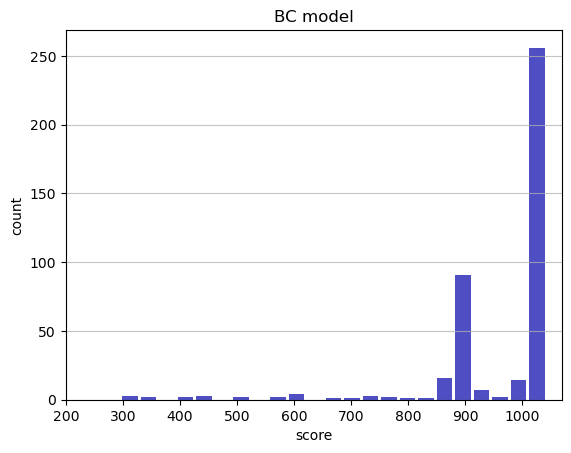

Track generation: 1164..1459 -> 295-tiles track
Epoch: 414
BC	mean: 958.21	variance: 127.13


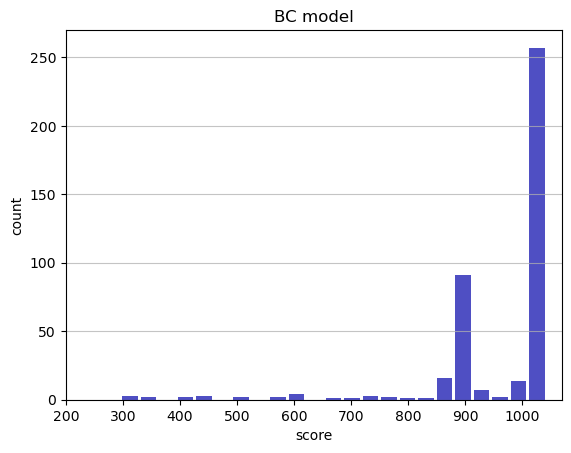

Track generation: 1049..1321 -> 272-tiles track
Epoch: 415
BC	mean: 958.39	variance: 127.03


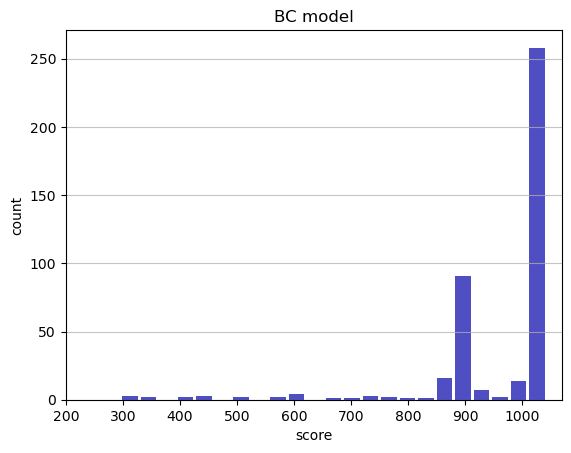

Track generation: 1130..1425 -> 295-tiles track
Epoch: 416
BC	mean: 958.17	variance: 126.95


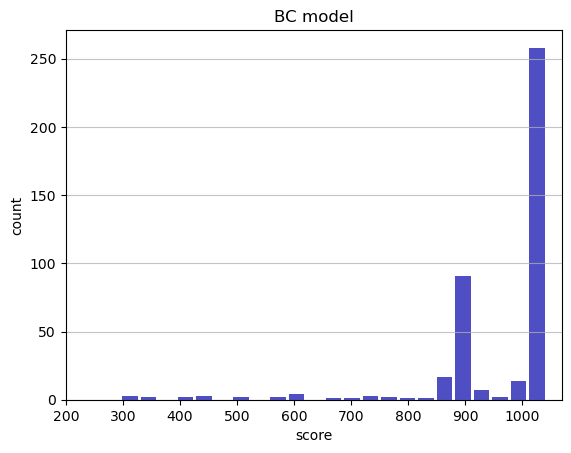

Track generation: 1068..1339 -> 271-tiles track
Epoch: 417
BC	mean: 958.35	variance: 126.85


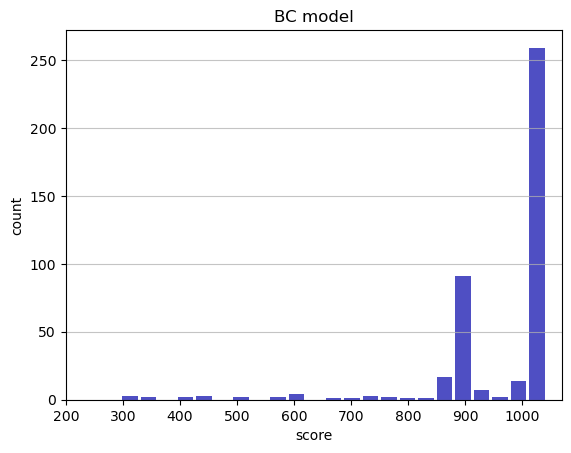

Track generation: 1229..1538 -> 309-tiles track
Epoch: 418
BC	mean: 958.15	variance: 126.76


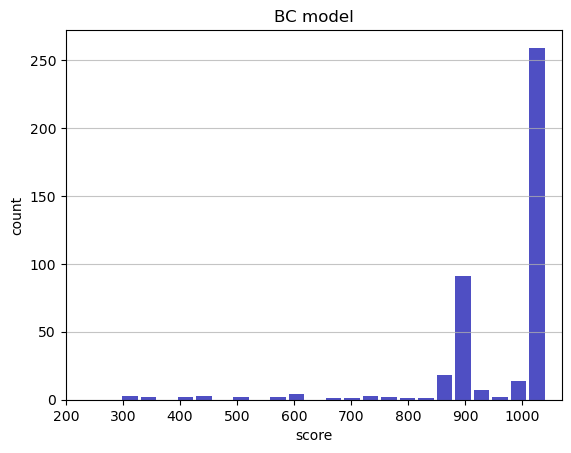

Track generation: 1151..1449 -> 298-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1122..1408 -> 286-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1120..1404 -> 284-tiles track
Epoch: 419
BC	mean: 958.02	variance: 126.64


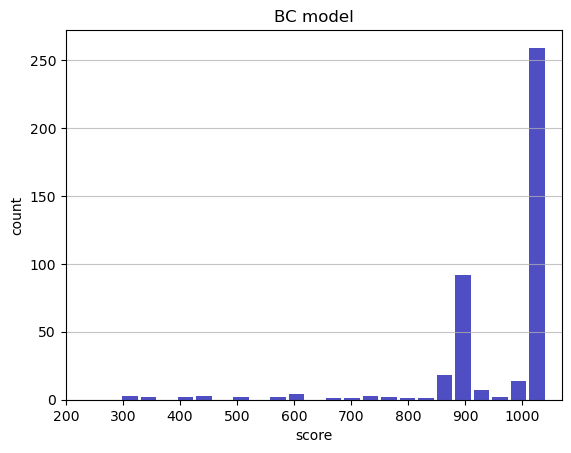

Track generation: 1044..1307 -> 263-tiles track
Epoch: 420
BC	mean: 957.85	variance: 126.54


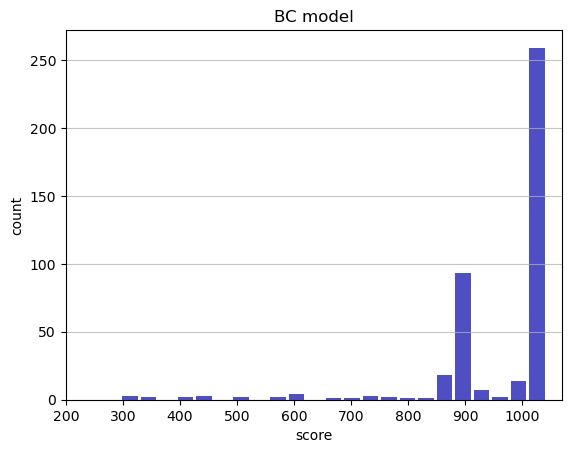

Track generation: 1143..1433 -> 290-tiles track
Epoch: 421
BC	mean: 958.01	variance: 126.43


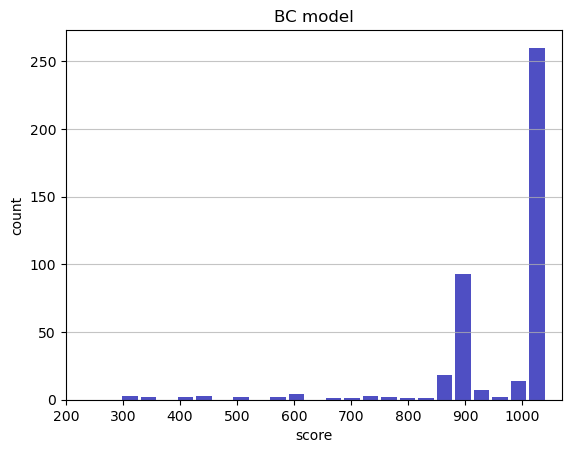

Track generation: 1141..1430 -> 289-tiles track
Epoch: 422
BC	mean: 958.17	variance: 126.33


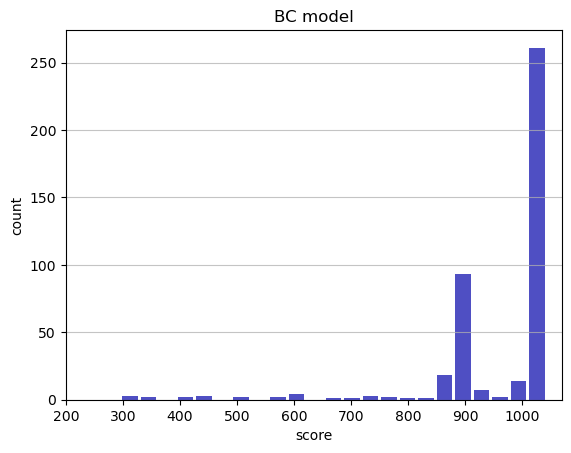

Track generation: 1308..1639 -> 331-tiles track
Epoch: 423
BC	mean: 958.24	variance: 126.19


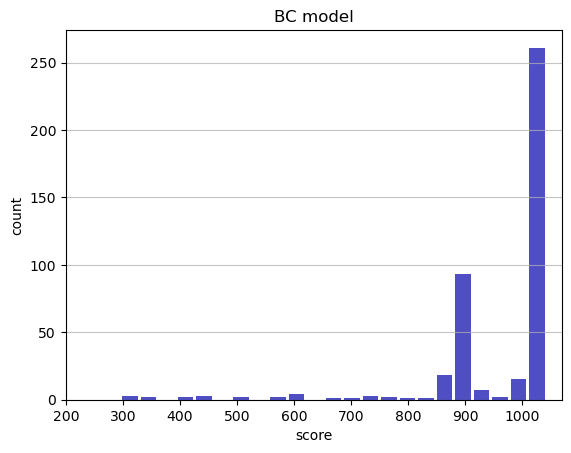

Track generation: 1184..1483 -> 299-tiles track
Epoch: 424
BC	mean: 958.39	variance: 126.08


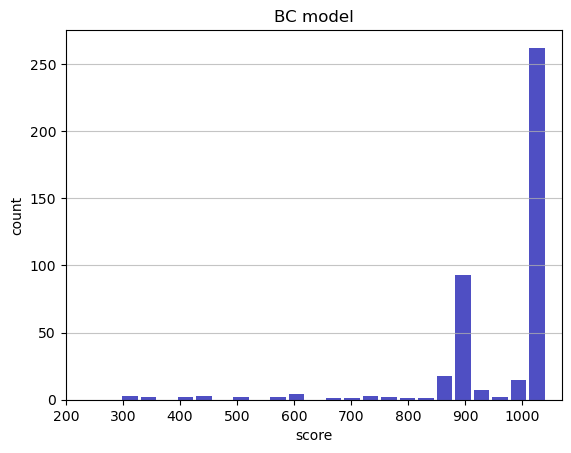

Track generation: 1195..1505 -> 310-tiles track
Epoch: 425
BC	mean: 958.53	variance: 125.96


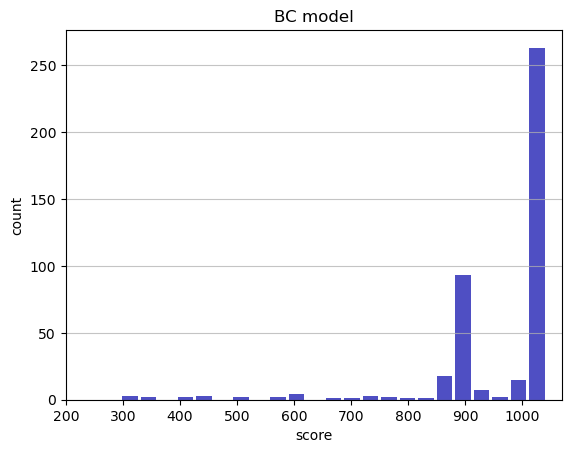

Track generation: 1268..1589 -> 321-tiles track
Epoch: 426
BC	mean: 958.66	variance: 125.84


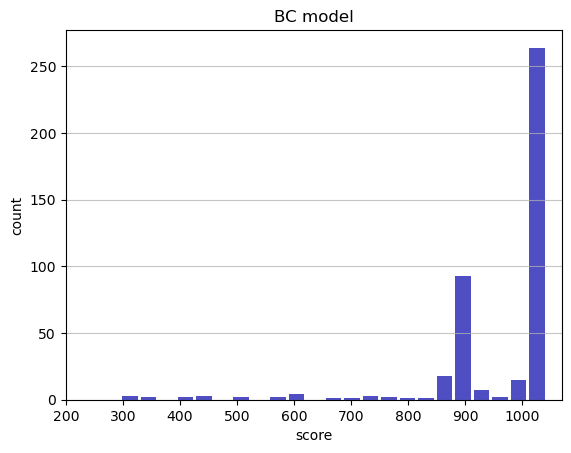

Track generation: 1345..1685 -> 340-tiles track
Epoch: 427
BC	mean: 958.77	variance: 125.72


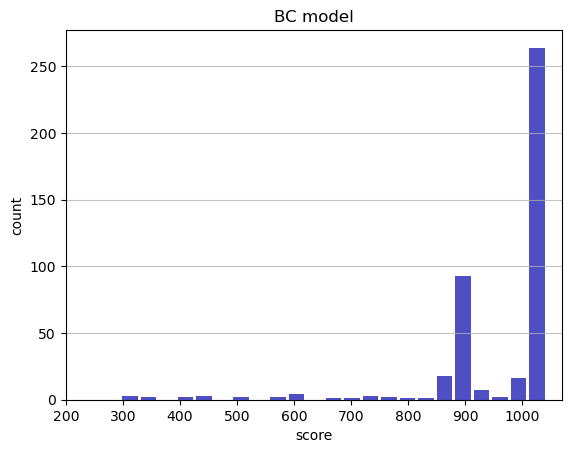

Track generation: 1060..1329 -> 269-tiles track
Epoch: 428
BC	mean: 958.94	variance: 125.62


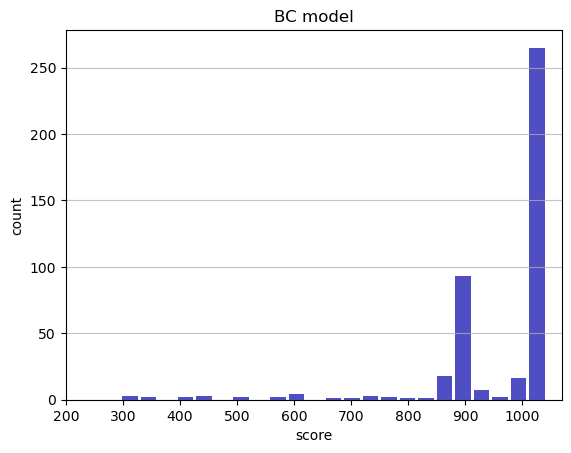

Track generation: 1273..1600 -> 327-tiles track
Epoch: 429
BC	mean: 959.08	variance: 125.51


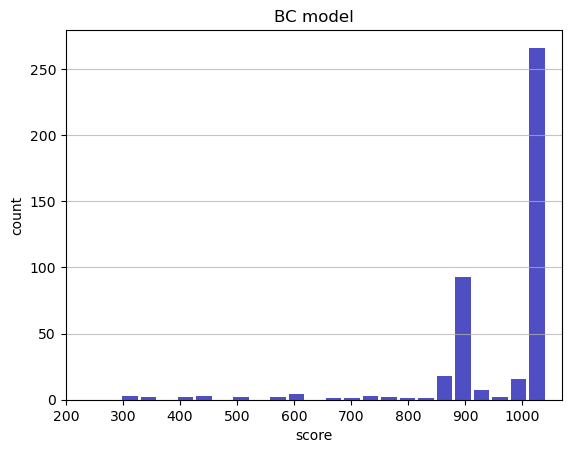

Track generation: 1107..1396 -> 289-tiles track
Epoch: 430
BC	mean: 959.22	variance: 125.39


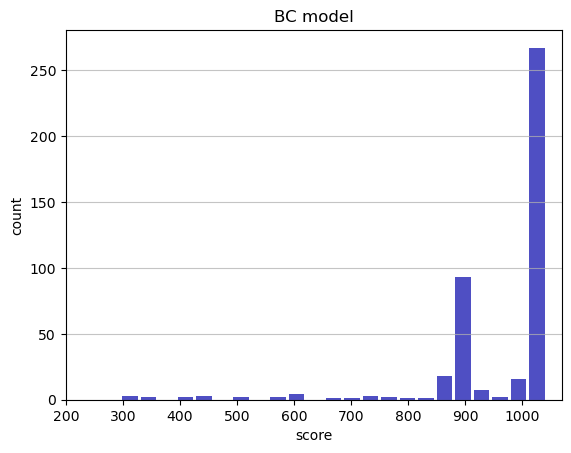

Track generation: 1069..1340 -> 271-tiles track
Epoch: 431
BC	mean: 959.12	variance: 125.26


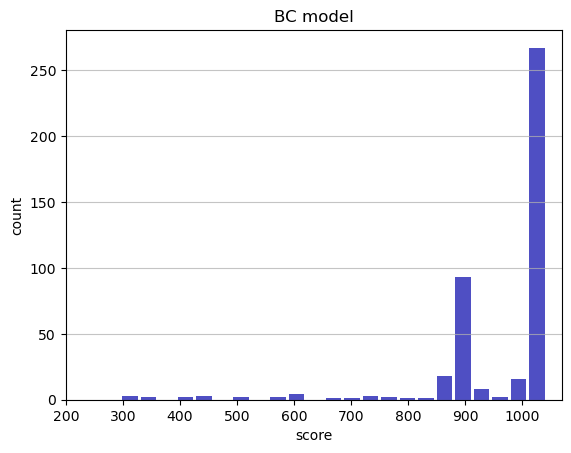

Track generation: 1215..1523 -> 308-tiles track
Epoch: 432
BC	mean: 959.27	variance: 125.16


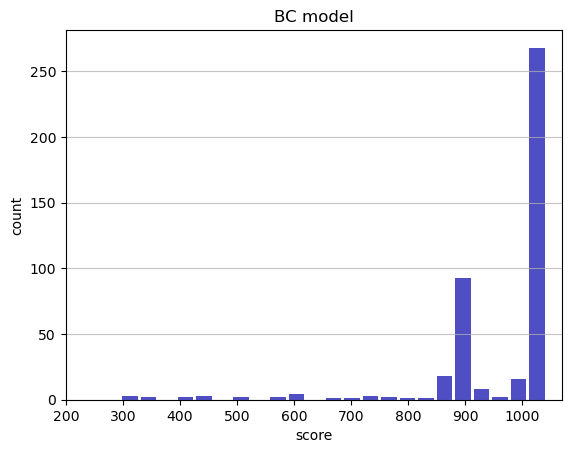

Track generation: 1112..1394 -> 282-tiles track
Epoch: 433
BC	mean: 959.44	variance: 125.06


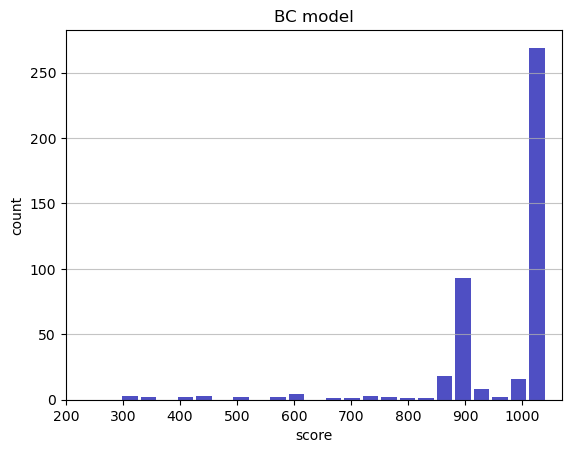

Track generation: 1184..1484 -> 300-tiles track
Epoch: 434
BC	mean: 959.31	variance: 124.95


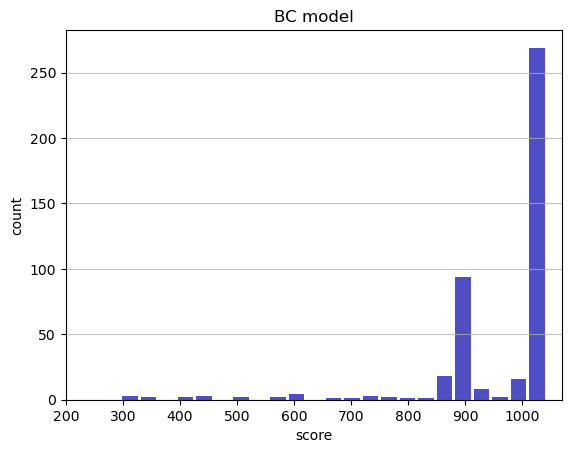

Track generation: 1104..1389 -> 285-tiles track
Epoch: 435
BC	mean: 959.15	variance: 124.85


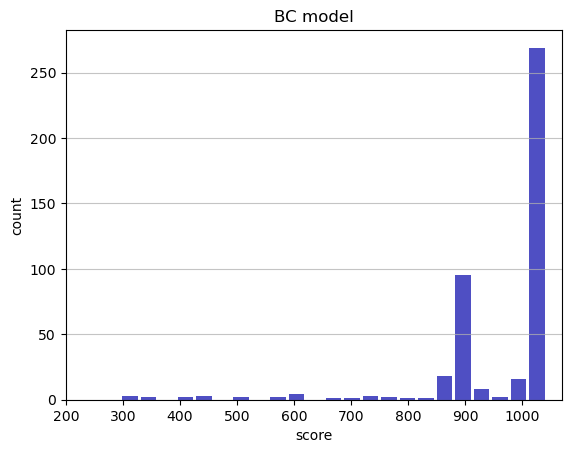

Track generation: 1087..1363 -> 276-tiles track
Epoch: 436
BC	mean: 959.31	variance: 124.75


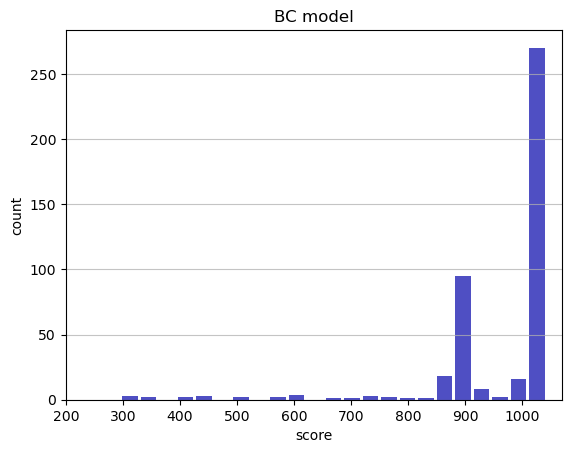

Track generation: 1203..1516 -> 313-tiles track
Epoch: 437
BC	mean: 959.45	variance: 124.64


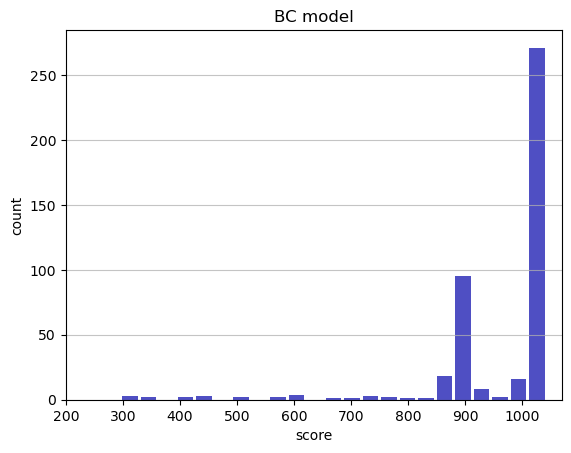

Track generation: 1086..1362 -> 276-tiles track
Epoch: 438
BC	mean: 959.31	variance: 124.53


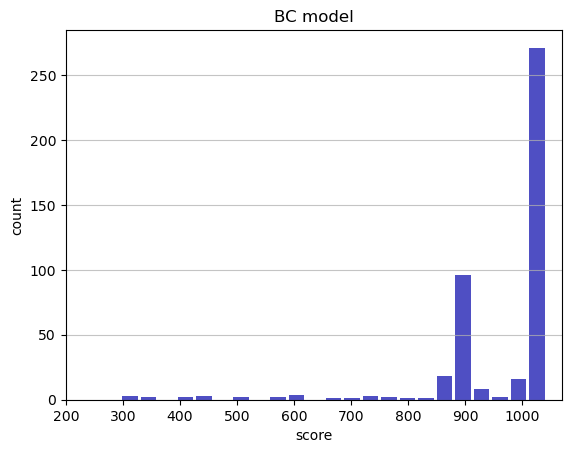

Track generation: 1316..1649 -> 333-tiles track
Epoch: 439
BC	mean: 959.44	variance: 124.42


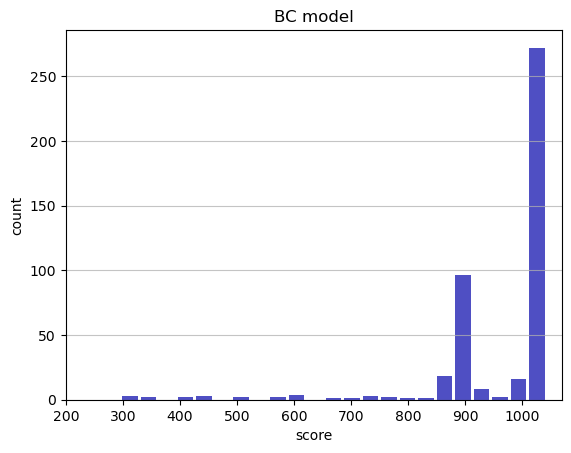

Track generation: 1128..1414 -> 286-tiles track
Epoch: 440
BC	mean: 959.30	variance: 124.31


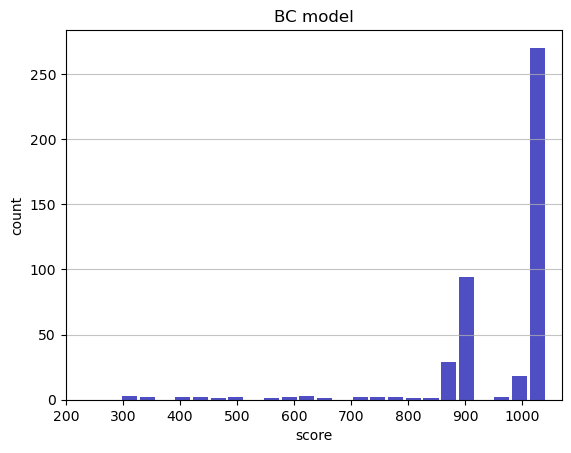

Track generation: 1164..1460 -> 296-tiles track
Epoch: 441
BC	mean: 959.10	variance: 124.24


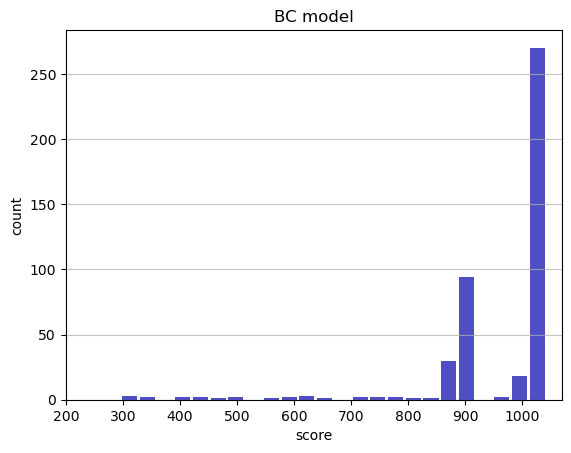

Track generation: 1021..1280 -> 259-tiles track
Epoch: 442
BC	mean: 958.95	variance: 124.14


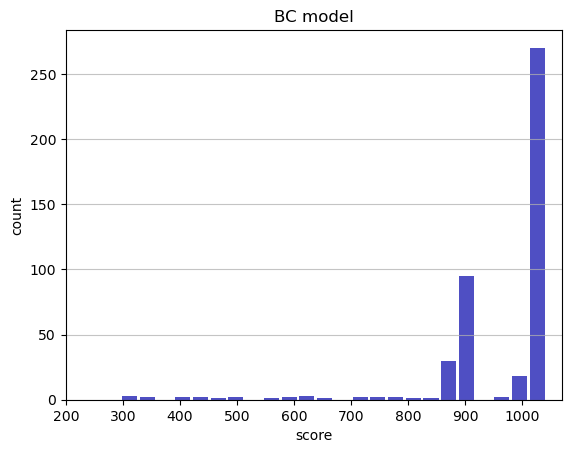

Track generation: 1135..1423 -> 288-tiles track
Epoch: 443
BC	mean: 959.10	variance: 124.04


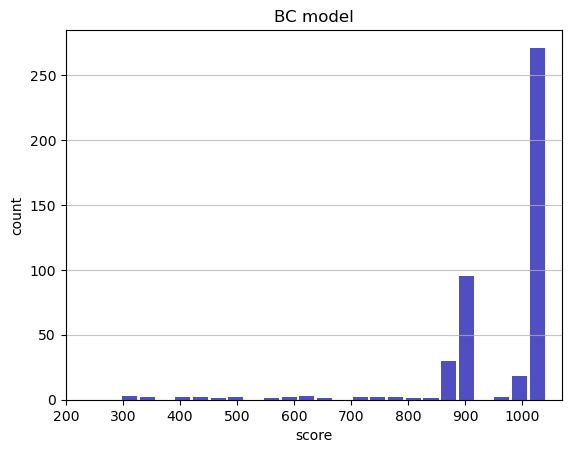

Track generation: 1111..1393 -> 282-tiles track
Epoch: 444
BC	mean: 959.28	variance: 123.96


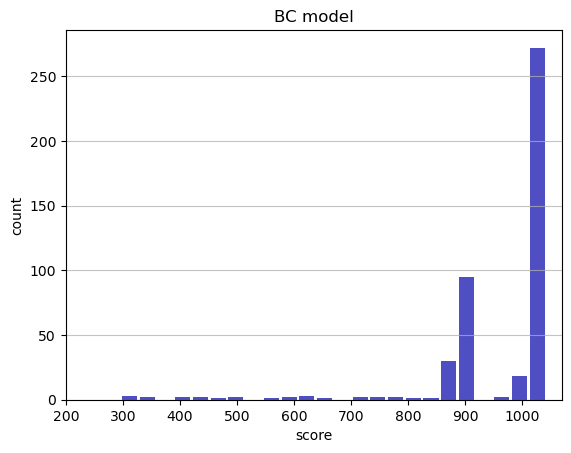

Track generation: 1028..1289 -> 261-tiles track
Epoch: 445
BC	mean: 959.44	variance: 123.87


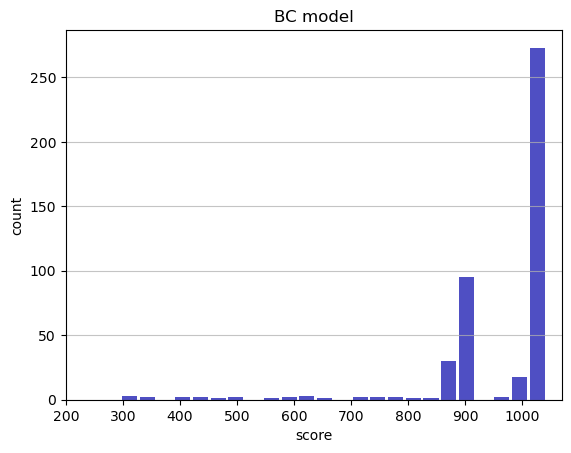

Track generation: 1184..1484 -> 300-tiles track
Epoch: 446
BC	mean: 959.58	variance: 123.76


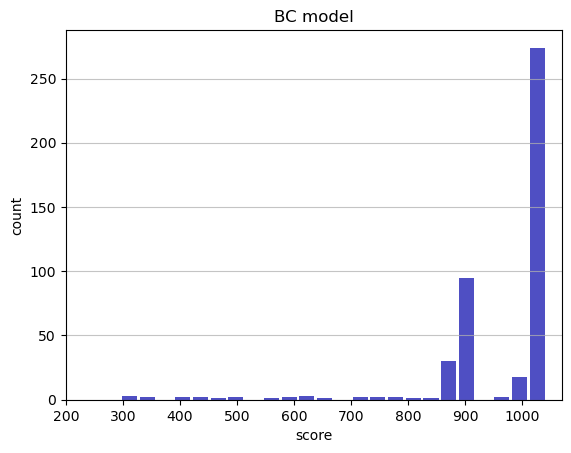

Track generation: 1080..1354 -> 274-tiles track
Epoch: 447
BC	mean: 959.74	variance: 123.67


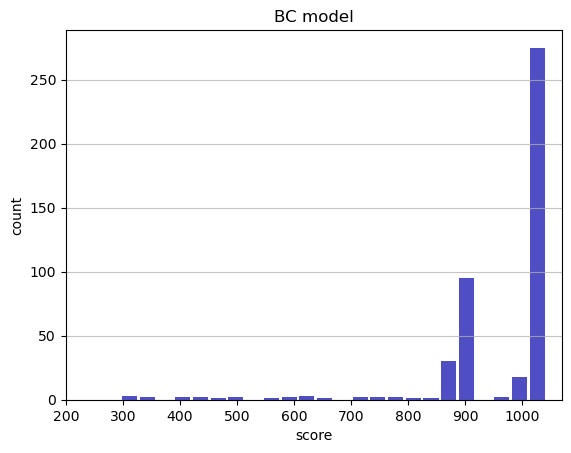

Track generation: 1092..1369 -> 277-tiles track
Epoch: 448
BC	mean: 959.91	variance: 123.58


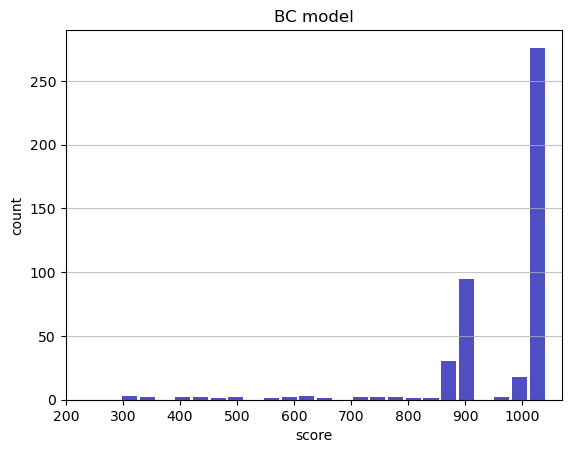

Track generation: 1197..1508 -> 311-tiles track
Epoch: 449
BC	mean: 960.04	variance: 123.48


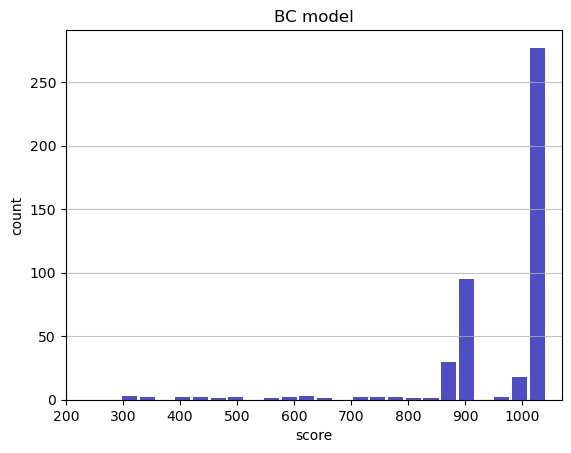

Track generation: 1149..1447 -> 298-tiles track
Epoch: 450
BC	mean: 960.19	variance: 123.38


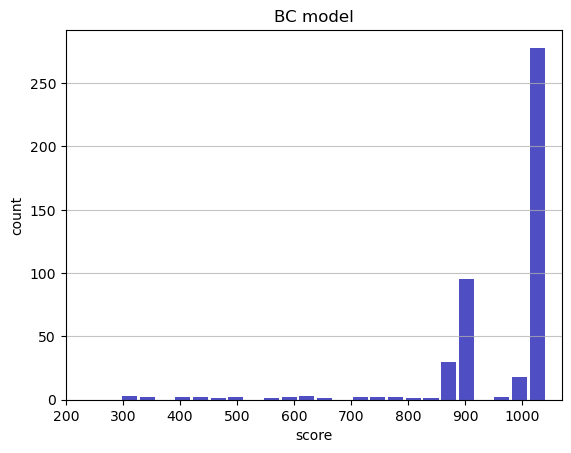

Track generation: 1145..1435 -> 290-tiles track
Epoch: 451
BC	mean: 960.35	variance: 123.29


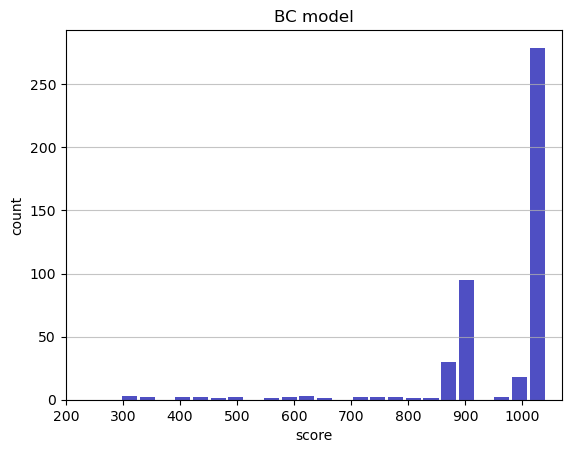

Track generation: 1123..1408 -> 285-tiles track
Epoch: 452
BC	mean: 960.21	variance: 123.19


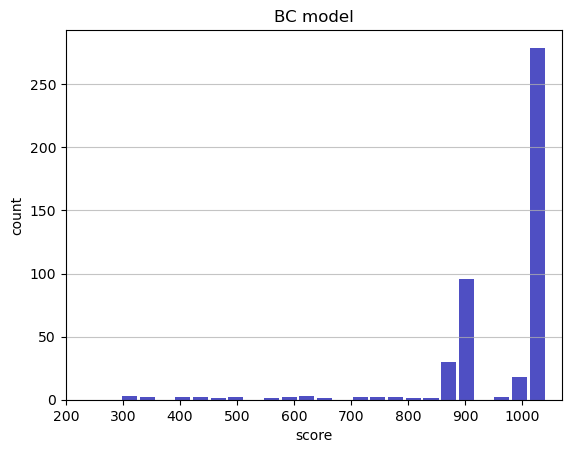

Track generation: 1240..1554 -> 314-tiles track
Epoch: 453
BC	mean: 960.34	variance: 123.08


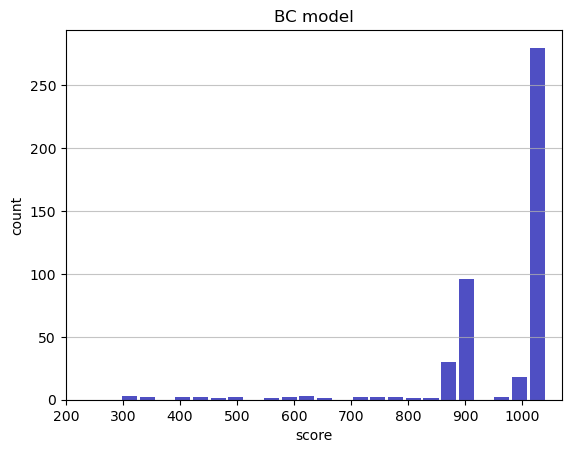

Track generation: 1146..1436 -> 290-tiles track
Epoch: 454
BC	mean: 960.48	variance: 122.98


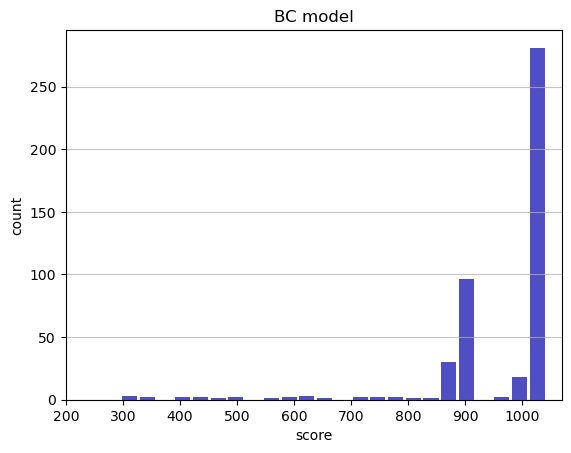

Track generation: 1265..1585 -> 320-tiles track
Epoch: 455
BC	mean: 960.34	variance: 122.88


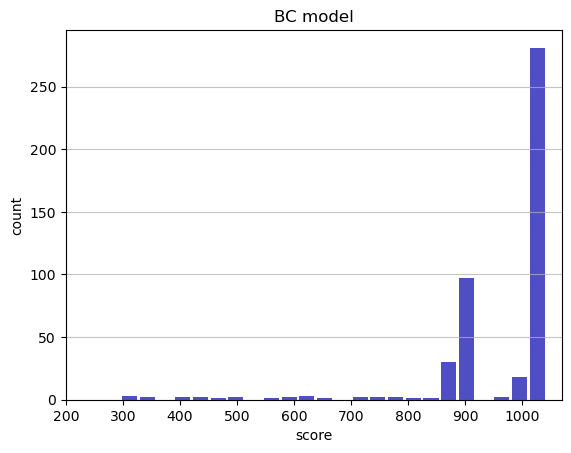

Track generation: 1076..1349 -> 273-tiles track
Epoch: 456
BC	mean: 960.50	variance: 122.79


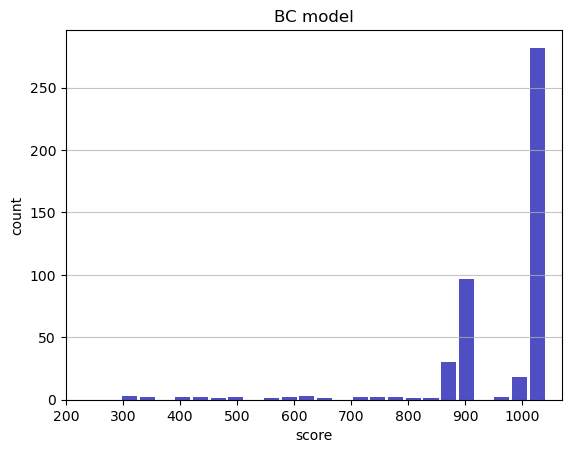

Track generation: 1010..1274 -> 264-tiles track
Epoch: 457
BC	mean: 960.66	variance: 122.70


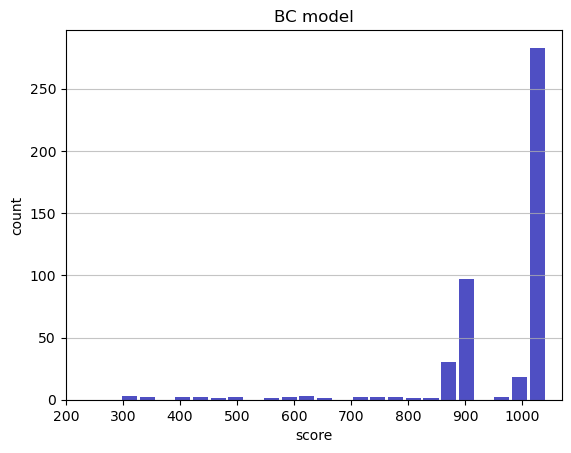

Track generation: 1054..1321 -> 267-tiles track
Epoch: 458
BC	mean: 960.83	variance: 122.62


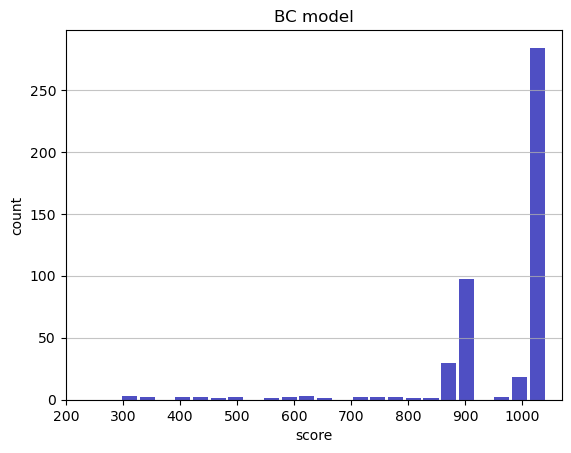

Track generation: 1103..1383 -> 280-tiles track
Epoch: 459
BC	mean: 960.99	variance: 122.54


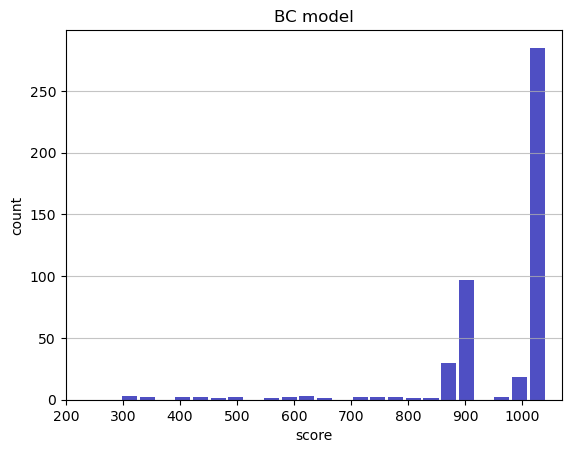

Track generation: 999..1260 -> 261-tiles track
Epoch: 460
BC	mean: 961.15	variance: 122.45


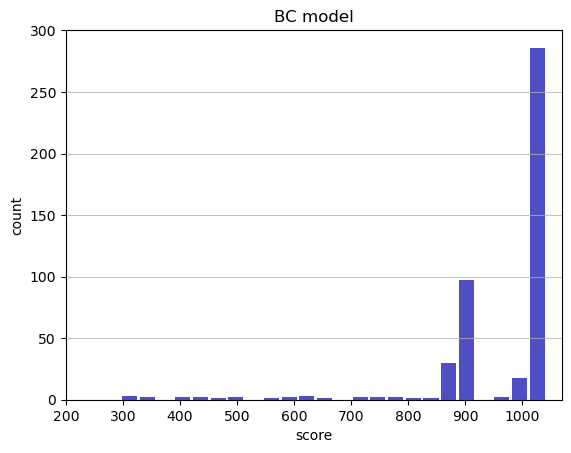

Track generation: 1063..1333 -> 270-tiles track
Epoch: 461
BC	mean: 961.30	variance: 122.36


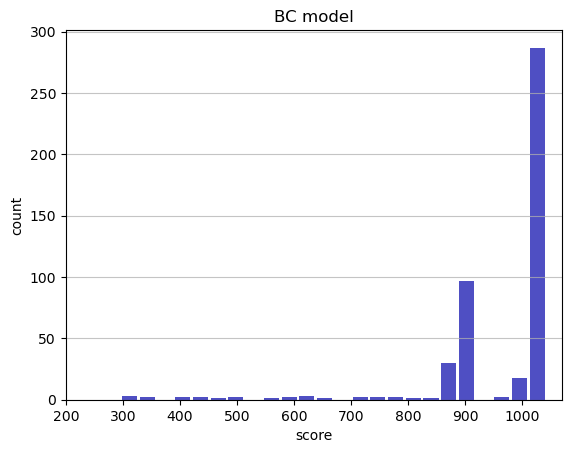

Track generation: 1129..1415 -> 286-tiles track
Epoch: 462
BC	mean: 961.44	variance: 122.27


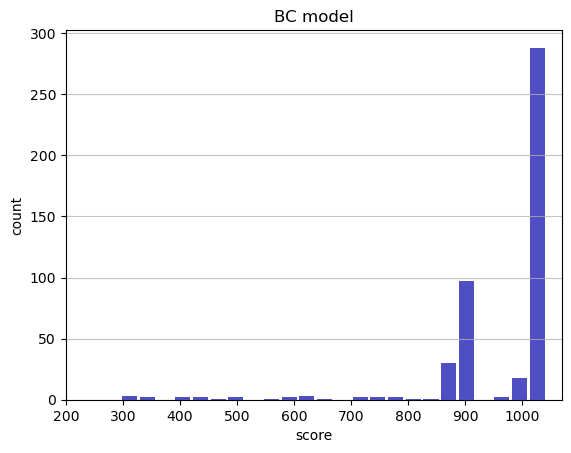

Track generation: 1075..1348 -> 273-tiles track
Epoch: 463
BC	mean: 961.60	variance: 122.18


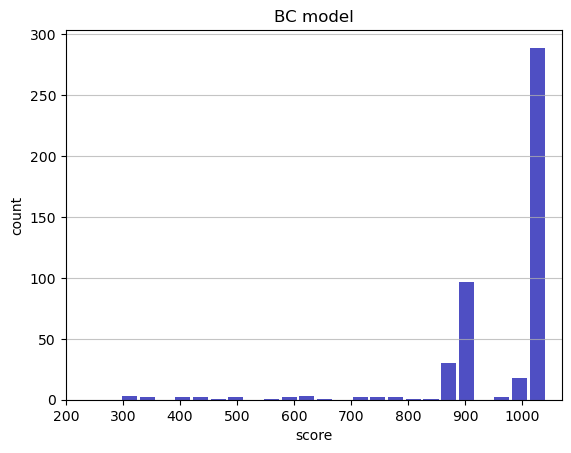

Track generation: 1171..1468 -> 297-tiles track
Epoch: 464
BC	mean: 961.74	variance: 122.09


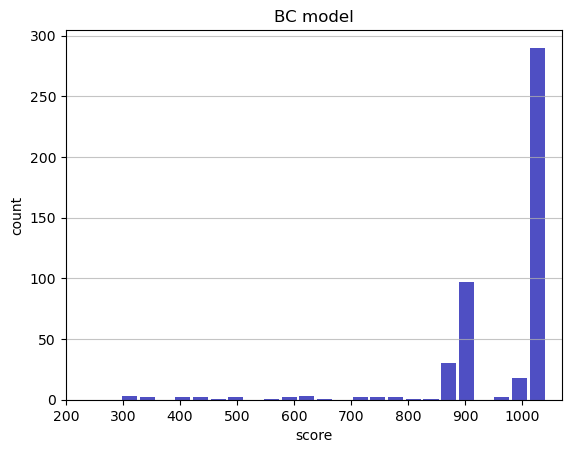

Track generation: 1108..1395 -> 287-tiles track
Epoch: 465
BC	mean: 961.87	variance: 121.99


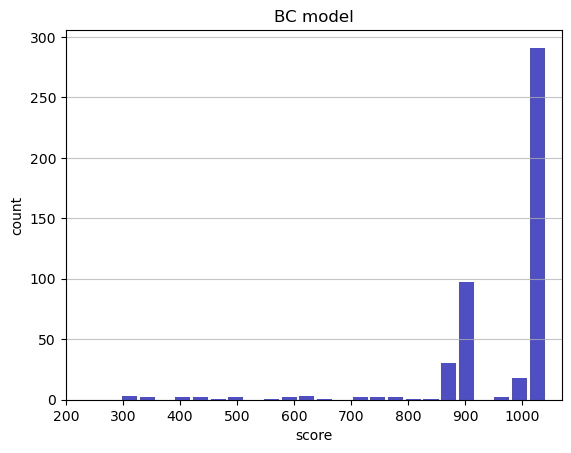

Track generation: 1005..1264 -> 259-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1017..1282 -> 265-tiles track
Epoch: 466
BC	mean: 962.02	variance: 121.90


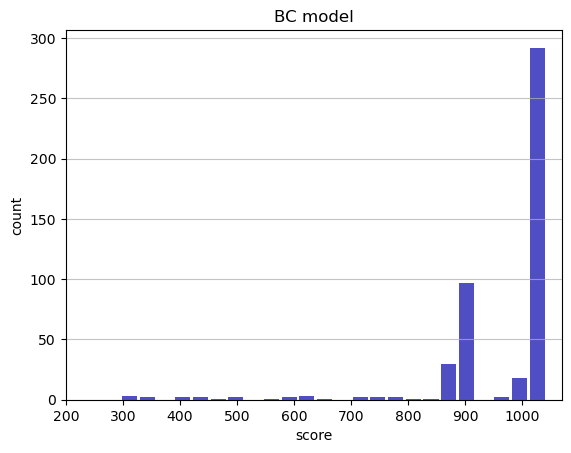

Track generation: 982..1232 -> 250-tiles track
Epoch: 467
BC	mean: 962.18	variance: 121.82


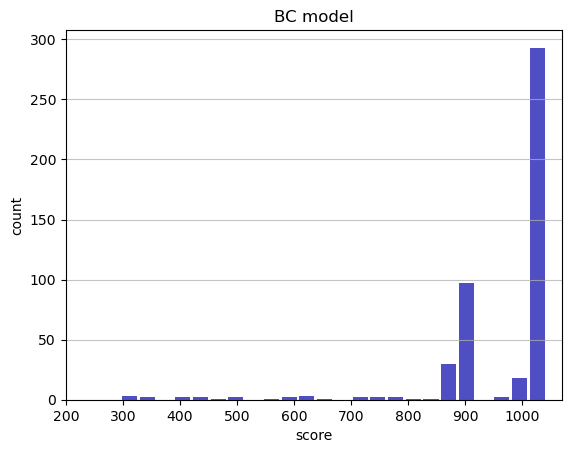

Track generation: 1013..1278 -> 265-tiles track
Epoch: 468
BC	mean: 962.34	variance: 121.74


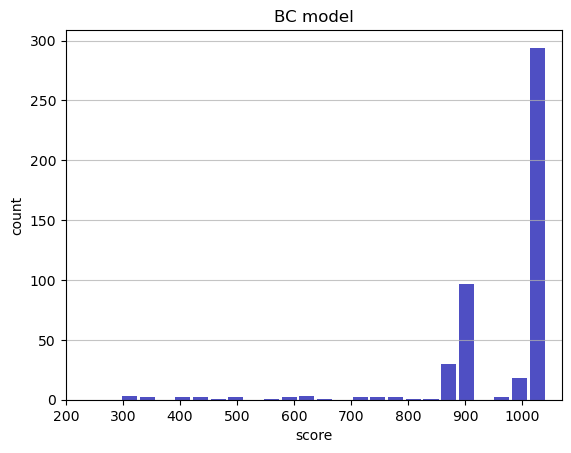

Track generation: 1231..1543 -> 312-tiles track
Epoch: 469
BC	mean: 962.46	variance: 121.64


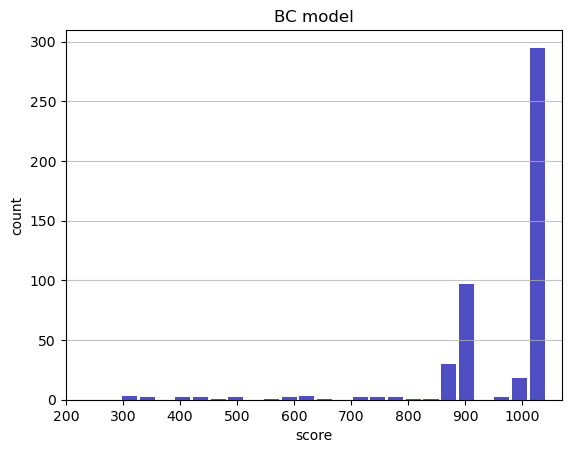

Track generation: 1091..1368 -> 277-tiles track
Epoch: 470
BC	mean: 962.61	variance: 121.55


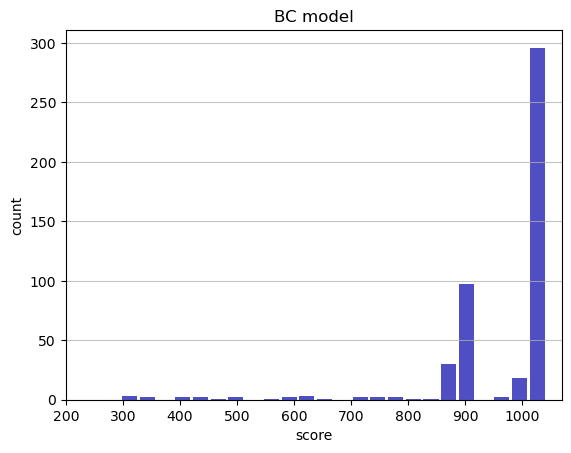

Track generation: 1119..1400 -> 281-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1039..1310 -> 271-tiles track
Epoch: 471
BC	mean: 962.74	variance: 121.45


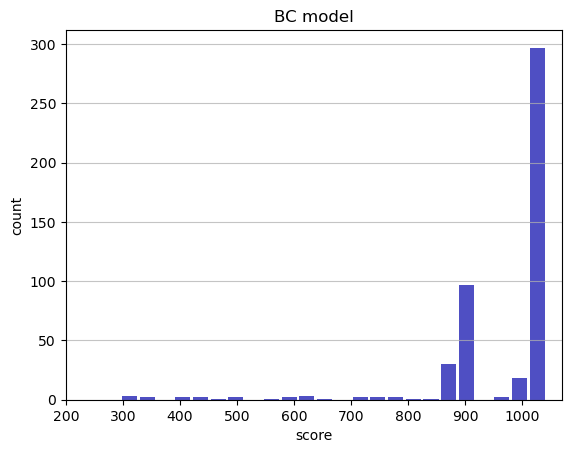

Track generation: 1070..1342 -> 272-tiles track
Epoch: 472
BC	mean: 962.89	variance: 121.37


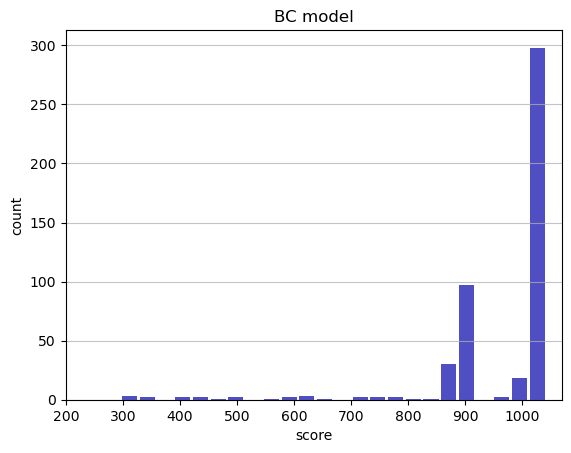

Track generation: 967..1213 -> 246-tiles track
Epoch: 473
BC	mean: 963.06	variance: 121.30


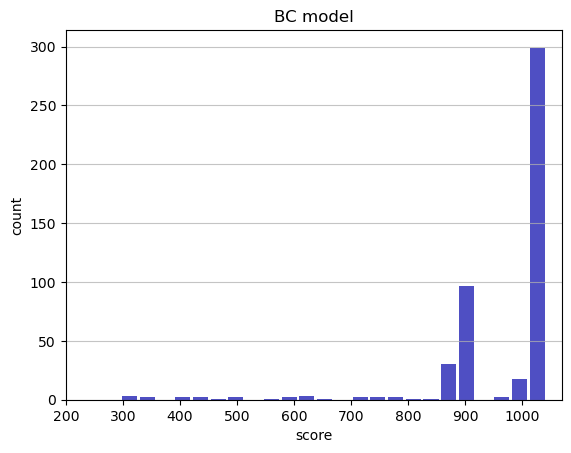

Track generation: 1131..1418 -> 287-tiles track
Epoch: 474
BC	mean: 963.19	variance: 121.20


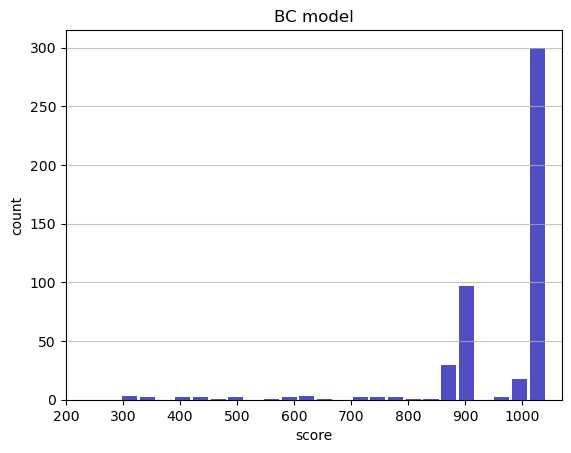

Track generation: 1307..1638 -> 331-tiles track
Epoch: 475
BC	mean: 963.29	variance: 121.09


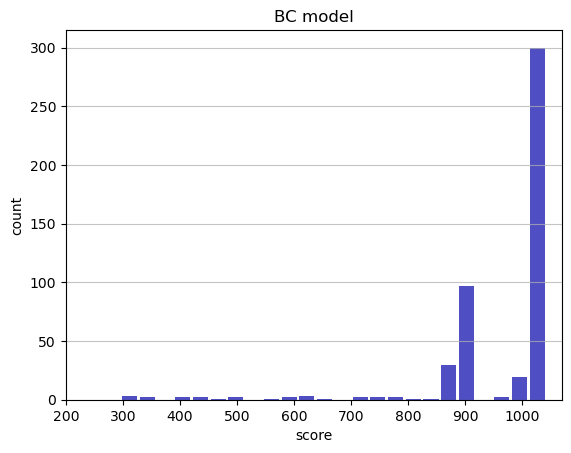

Track generation: 1163..1458 -> 295-tiles track
Epoch: 476
BC	mean: 963.16	variance: 121.00


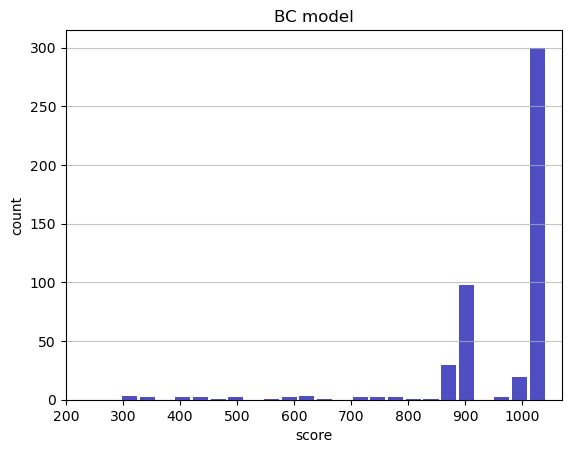

Track generation: 976..1224 -> 248-tiles track
Epoch: 477
BC	mean: 963.32	variance: 120.92


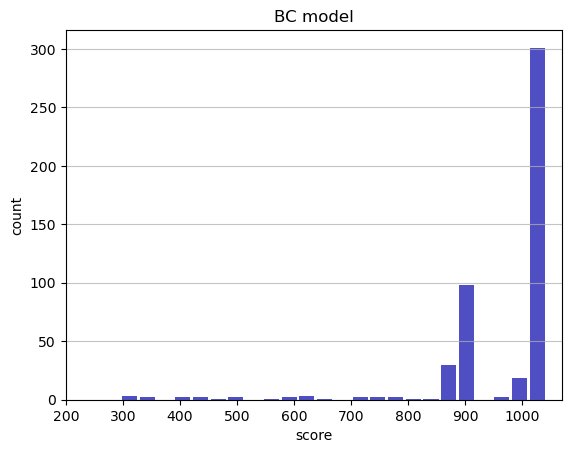

Track generation: 1295..1623 -> 328-tiles track
Epoch: 478
BC	mean: 962.87	variance: 121.20


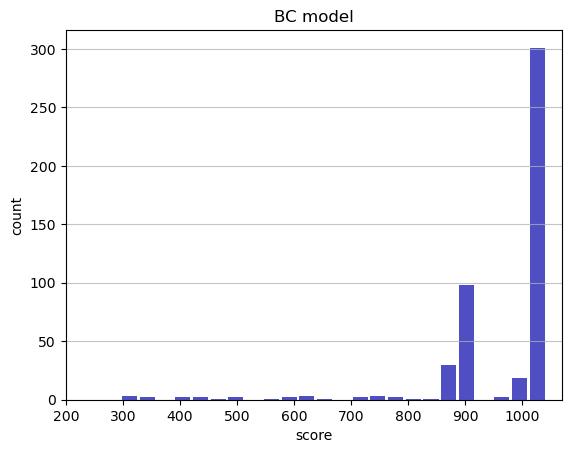

Track generation: 1102..1382 -> 280-tiles track
Epoch: 479
BC	mean: 962.76	variance: 121.09


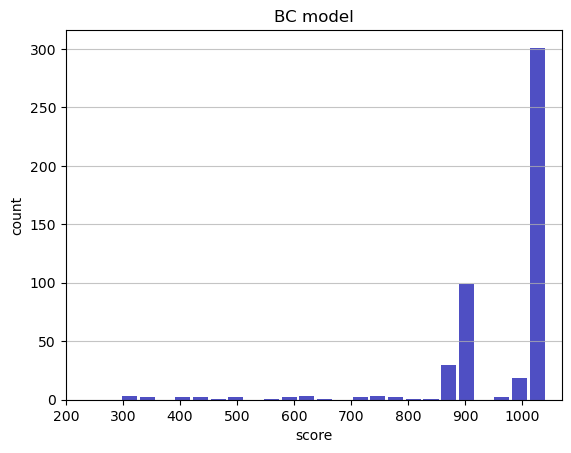

Track generation: 1028..1289 -> 261-tiles track
Epoch: 480
BC	mean: 962.67	variance: 120.99


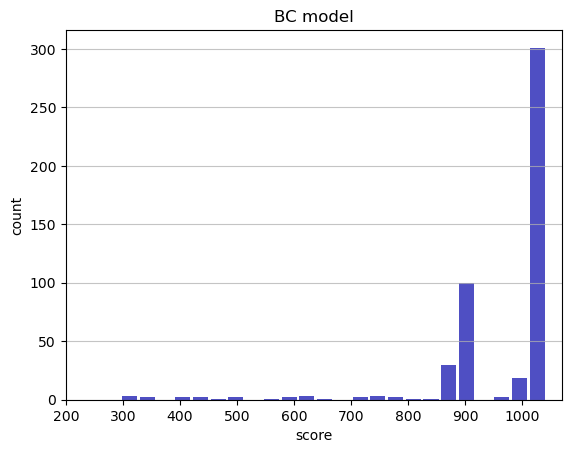

Track generation: 1033..1301 -> 268-tiles track
Epoch: 481
BC	mean: 962.80	variance: 120.90


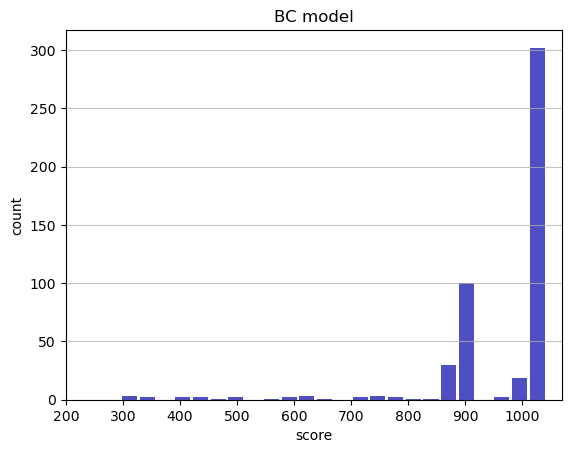

Track generation: 1245..1560 -> 315-tiles track
Epoch: 482
BC	mean: 962.92	variance: 120.80


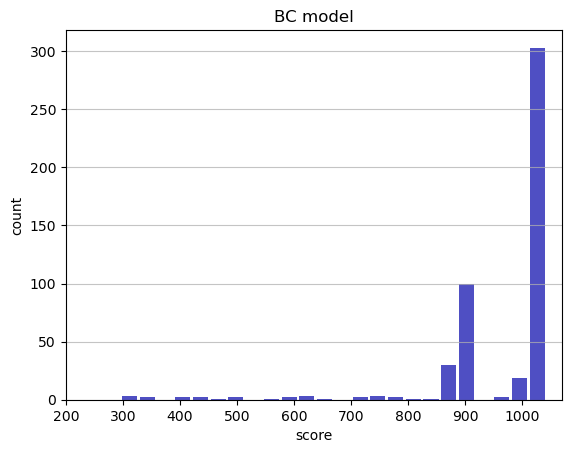

Track generation: 1244..1559 -> 315-tiles track
Epoch: 483
BC	mean: 962.77	variance: 120.72


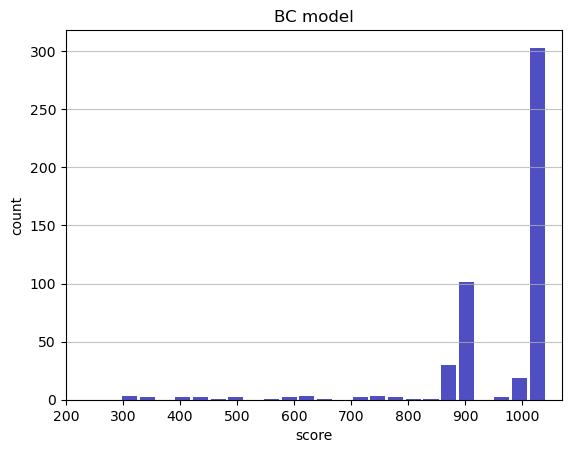

Track generation: 1164..1459 -> 295-tiles track
Epoch: 484
BC	mean: 962.91	variance: 120.63


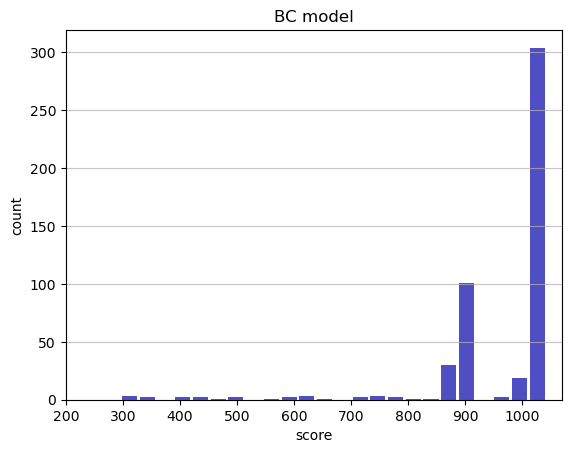

Track generation: 1115..1398 -> 283-tiles track
Epoch: 485
BC	mean: 963.04	variance: 120.54


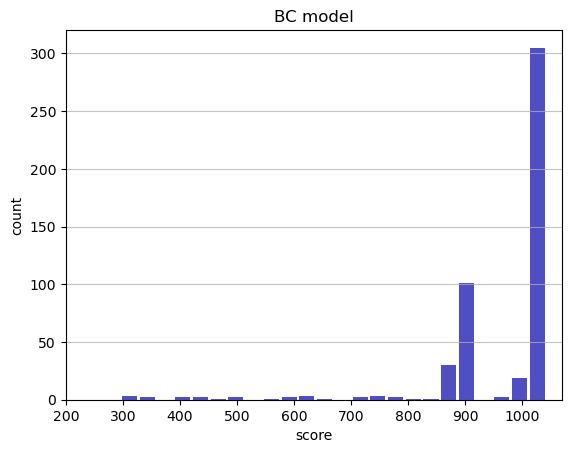

Track generation: 1204..1519 -> 315-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1224..1534 -> 310-tiles track
Epoch: 486
BC	mean: 963.15	variance: 120.44


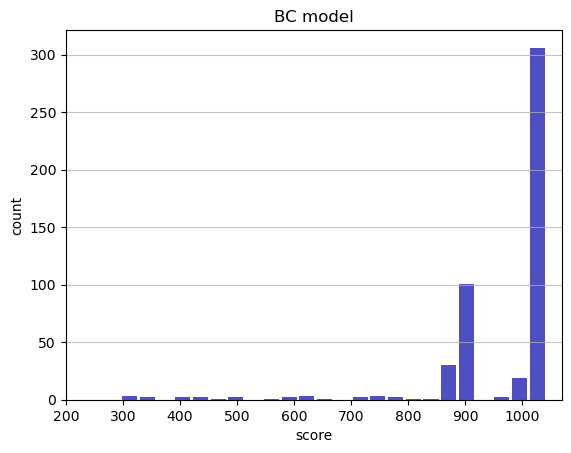

Track generation: 1290..1624 -> 334-tiles track
Epoch: 487
BC	mean: 963.21	variance: 120.33


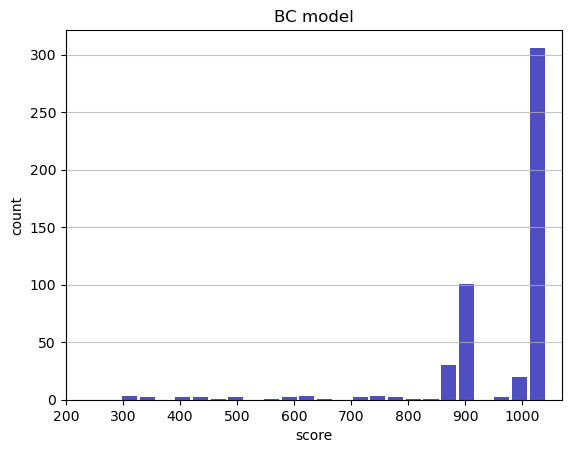

Track generation: 1287..1613 -> 326-tiles track
Epoch: 488
BC	mean: 963.32	variance: 120.22


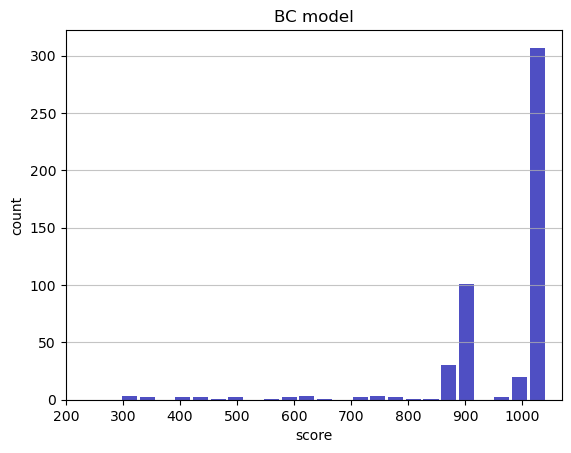

Track generation: 1111..1393 -> 282-tiles track
Epoch: 489
BC	mean: 963.44	variance: 120.13


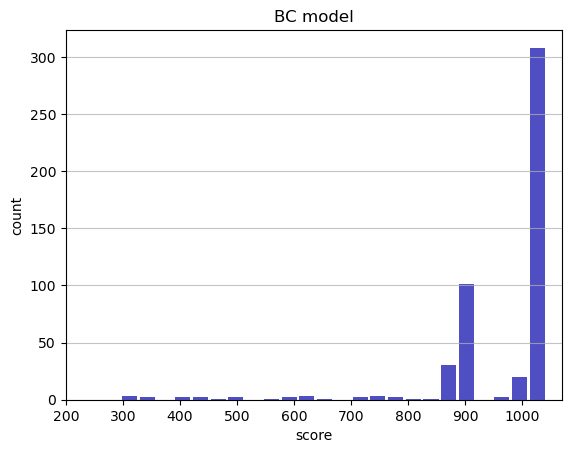

Track generation: 1296..1624 -> 328-tiles track
Epoch: 490
BC	mean: 963.54	variance: 120.03


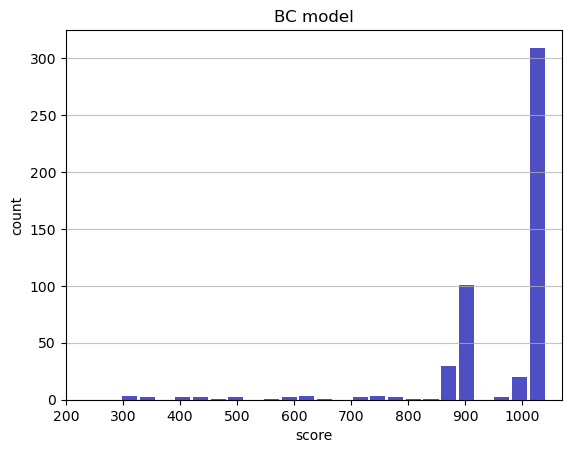

Track generation: 1031..1300 -> 269-tiles track
Epoch: 491
BC	mean: 963.68	variance: 119.95


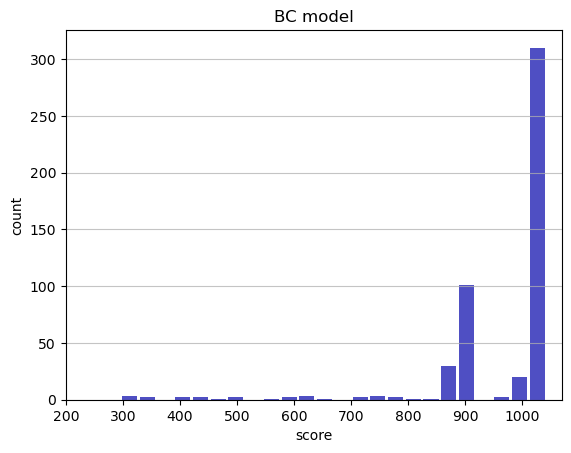

Track generation: 1161..1455 -> 294-tiles track
Epoch: 492
BC	mean: 963.06	variance: 120.62


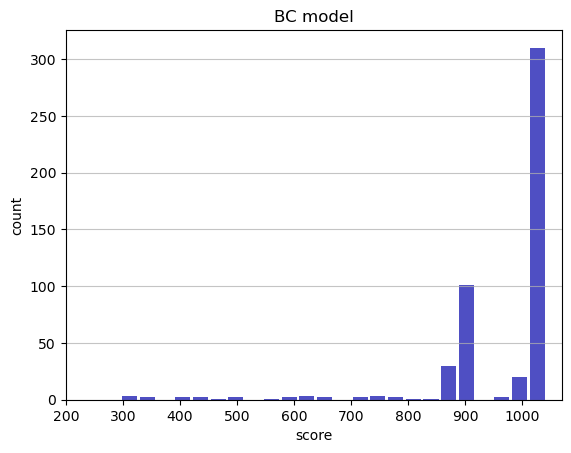

Track generation: 1174..1472 -> 298-tiles track
Epoch: 493
BC	mean: 963.18	variance: 120.53


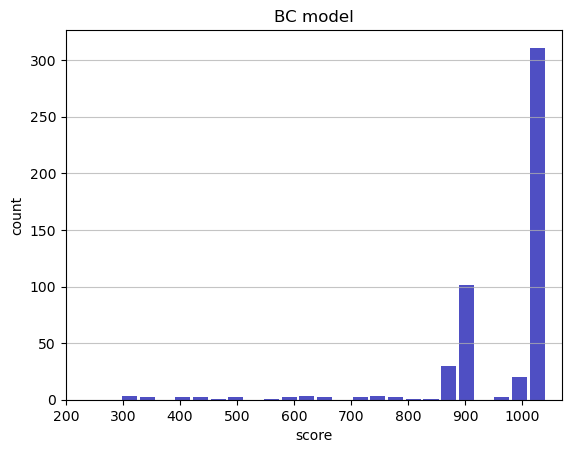

Track generation: 1170..1469 -> 299-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1263..1583 -> 320-tiles track
Epoch: 494
BC	mean: 963.29	variance: 120.43


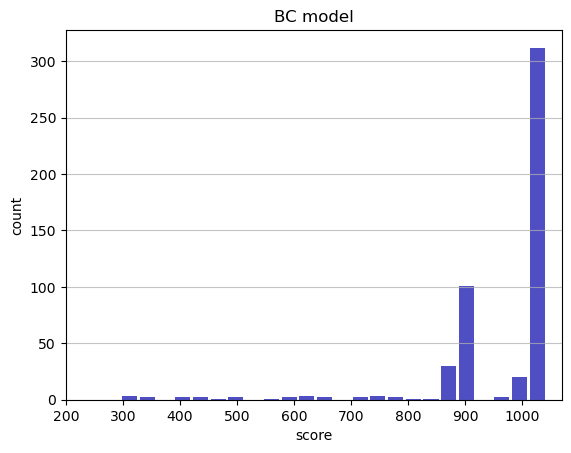

Track generation: 1293..1619 -> 326-tiles track
Epoch: 495
BC	mean: 963.36	variance: 120.32


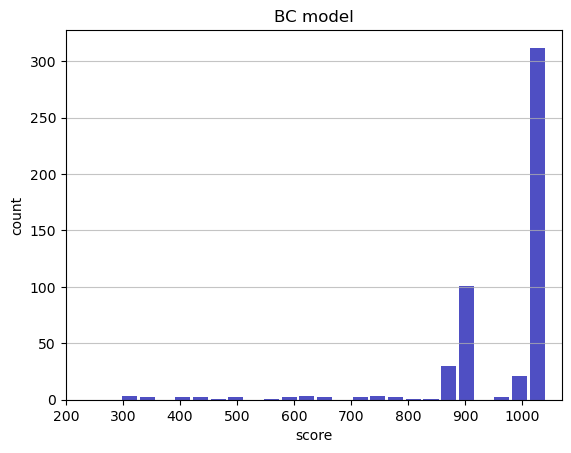

Track generation: 1196..1499 -> 303-tiles track
Epoch: 496
BC	mean: 963.25	variance: 120.22


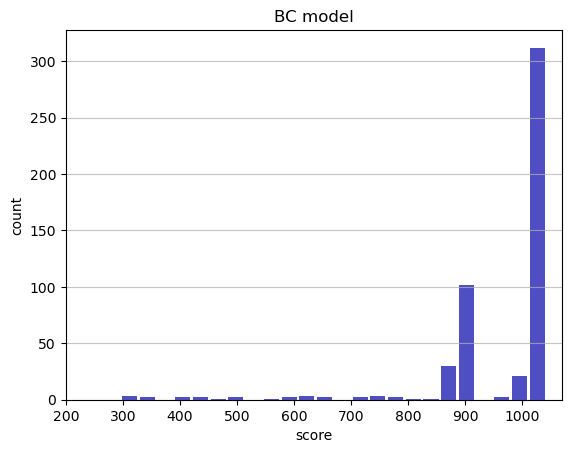

Track generation: 1108..1389 -> 281-tiles track
Epoch: 497
BC	mean: 963.13	variance: 120.13


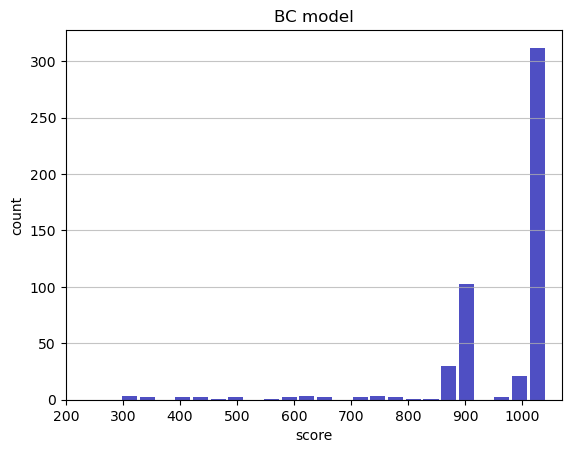

Track generation: 1276..1599 -> 323-tiles track
Epoch: 498
BC	mean: 962.98	variance: 120.05


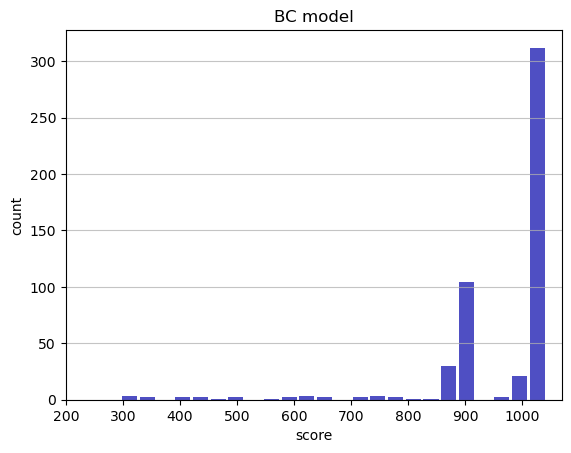

Track generation: 1267..1588 -> 321-tiles track
Epoch: 499
BC	mean: 963.09	variance: 119.96


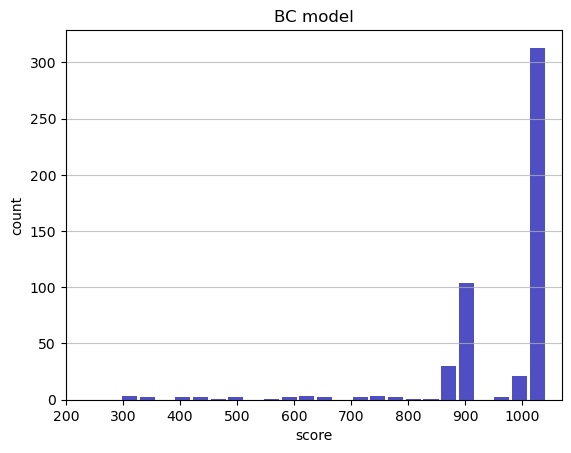

Track generation: 1127..1413 -> 286-tiles track
Epoch: 500
BC	mean: 963.22	variance: 119.87


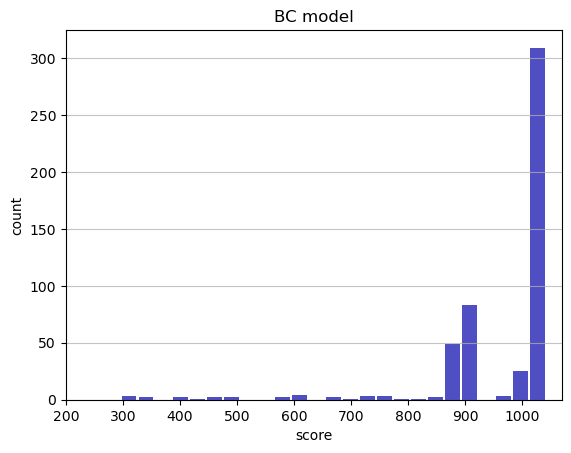

Track generation: 1237..1551 -> 314-tiles track
Epoch: 501
BC	mean: 963.10	variance: 119.79


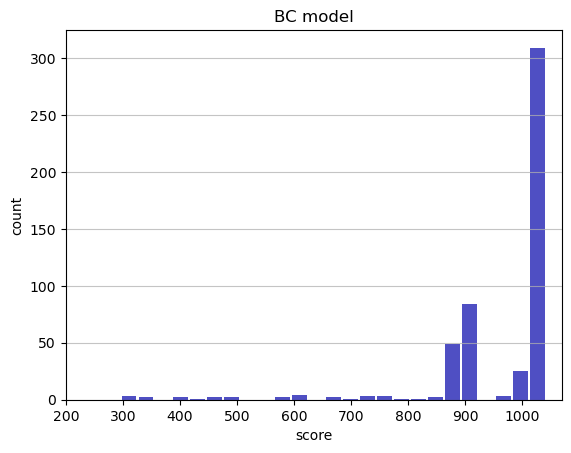

Track generation: 1113..1395 -> 282-tiles track
Epoch: 502
BC	mean: 963.24	variance: 119.71


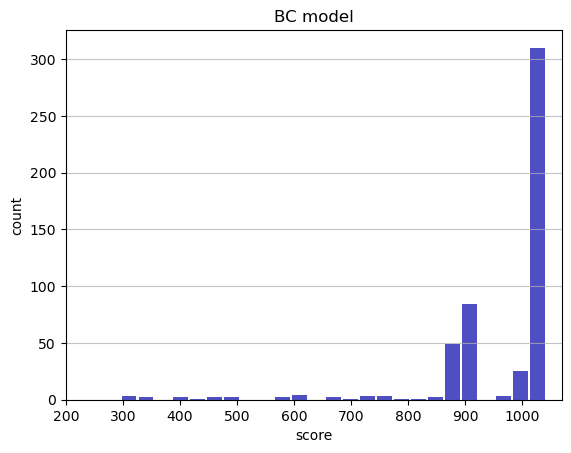

Track generation: 1429..1791 -> 362-tiles track
Epoch: 503
BC	mean: 963.19	variance: 119.59


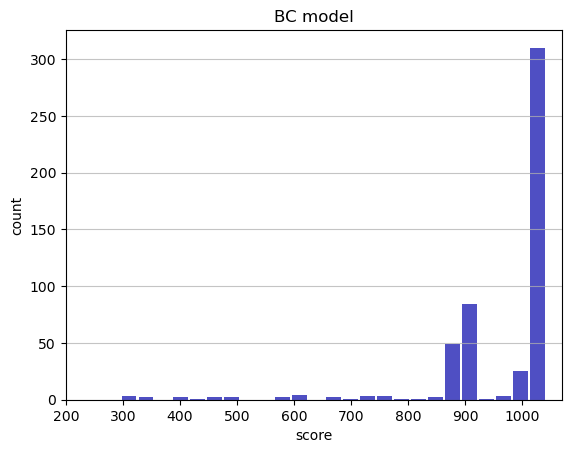

Track generation: 1059..1336 -> 277-tiles track
Epoch: 504
BC	mean: 963.33	variance: 119.52


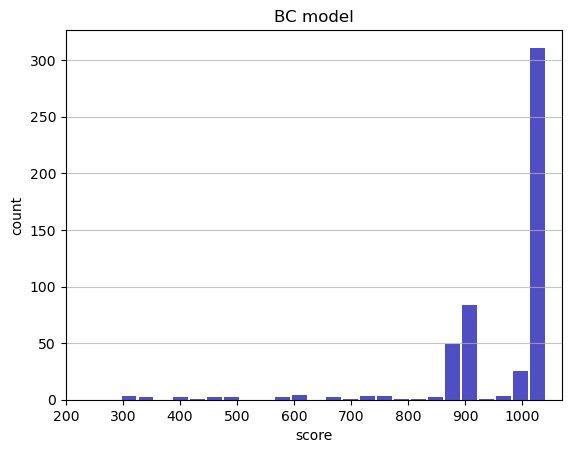

Track generation: 1015..1284 -> 269-tiles track
Epoch: 505
BC	mean: 963.46	variance: 119.44


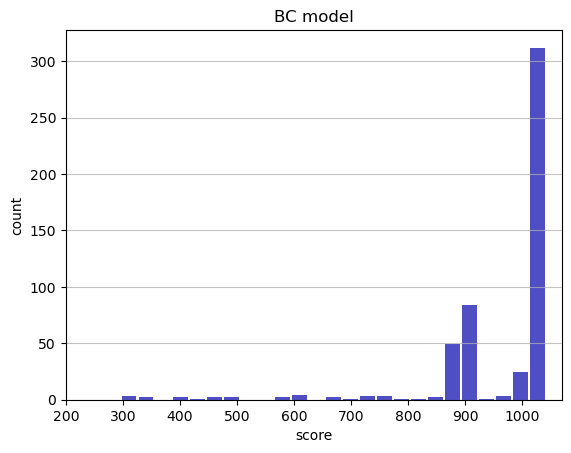

Track generation: 1184..1484 -> 300-tiles track
Epoch: 506
BC	mean: 963.57	variance: 119.34


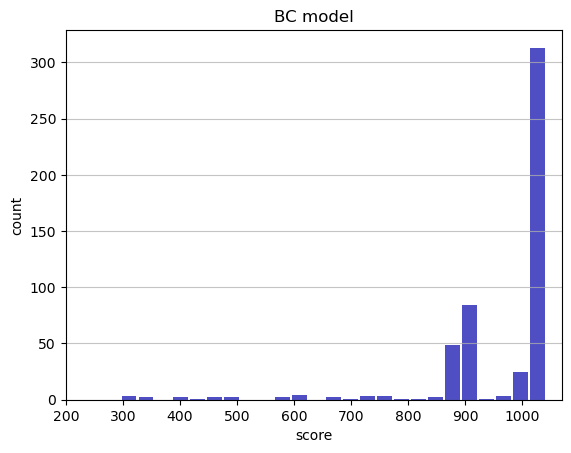

Track generation: 1096..1382 -> 286-tiles track
Epoch: 507
BC	mean: 963.38	variance: 119.30


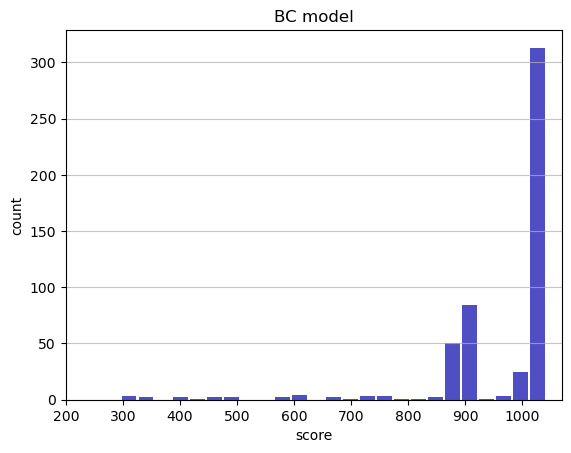

Track generation: 1132..1426 -> 294-tiles track
Epoch: 508
BC	mean: 963.50	variance: 119.21


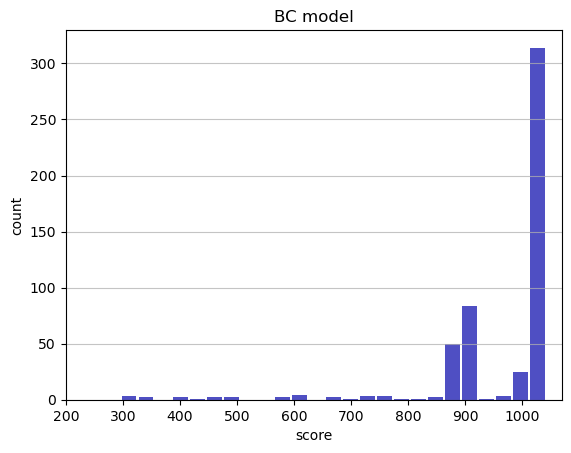

Track generation: 1228..1544 -> 316-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1172..1474 -> 302-tiles track
Epoch: 509
BC	mean: 963.30	variance: 119.18


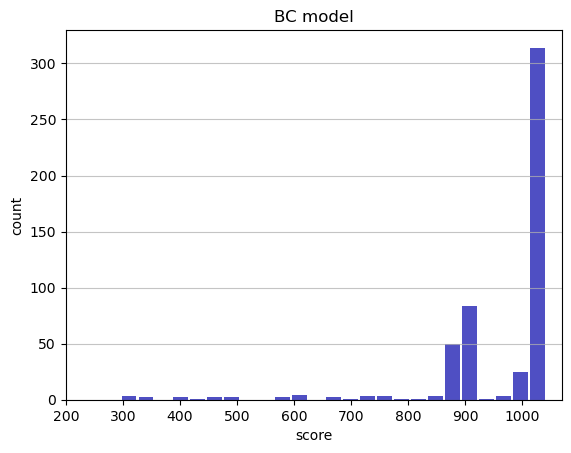

Track generation: 1248..1564 -> 316-tiles track
Epoch: 510
BC	mean: 962.00	variance: 122.62


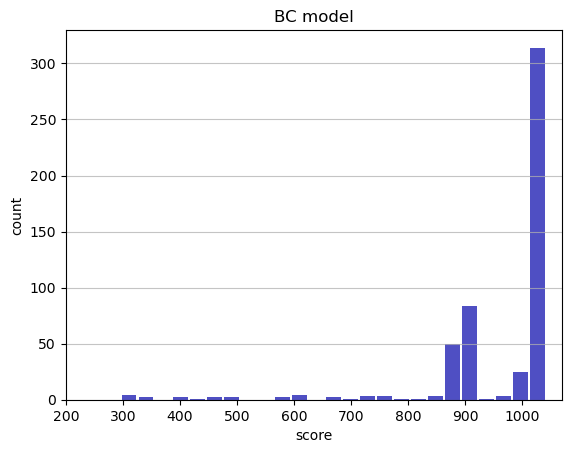

Track generation: 1243..1558 -> 315-tiles track
Epoch: 511
BC	mean: 961.86	variance: 122.54


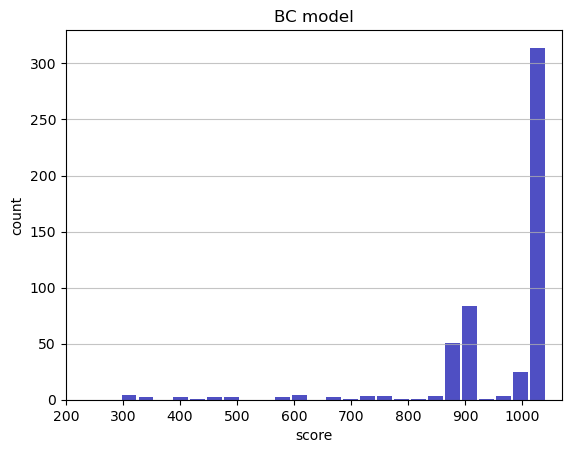

Track generation: 1165..1460 -> 295-tiles track
Epoch: 512
BC	mean: 961.99	variance: 122.46


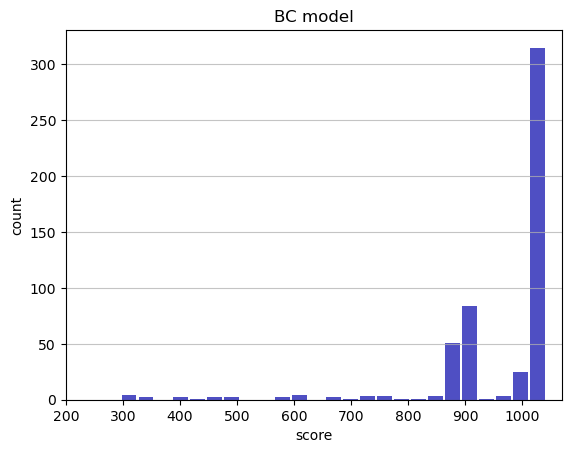

Track generation: 1128..1423 -> 295-tiles track
Epoch: 513
BC	mean: 961.87	variance: 122.37


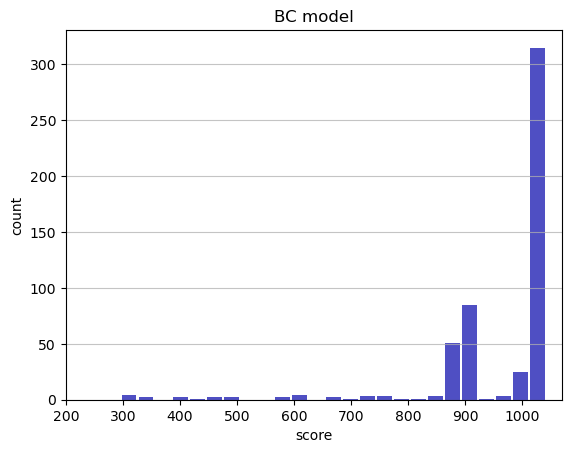

Track generation: 1099..1378 -> 279-tiles track
Epoch: 514
BC	mean: 962.01	variance: 122.29


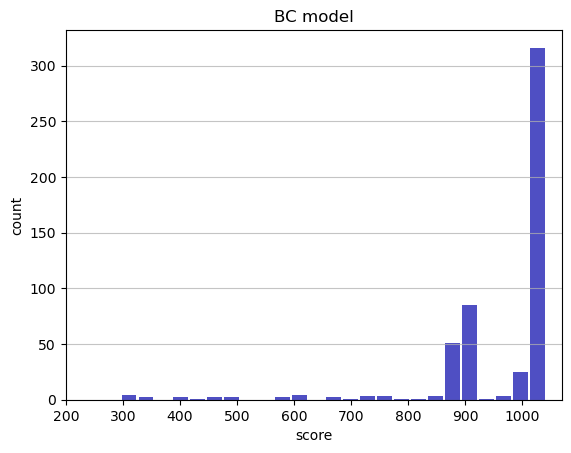

Track generation: 1076..1349 -> 273-tiles track
Epoch: 515
BC	mean: 962.15	variance: 122.21


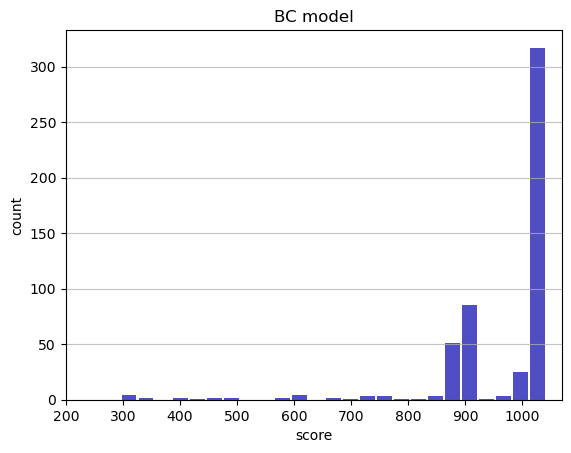

Track generation: 1220..1538 -> 318-tiles track
Epoch: 516
BC	mean: 962.26	variance: 122.12


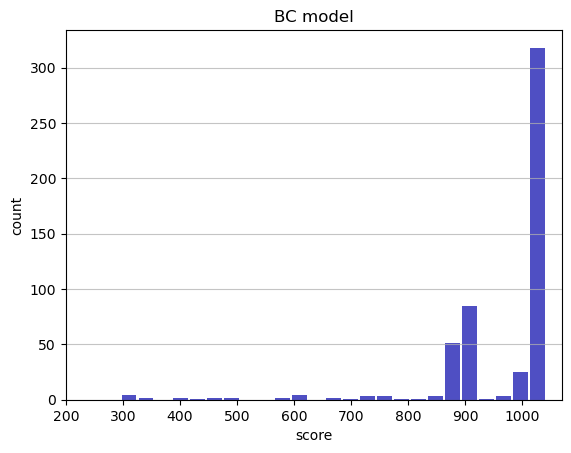

Track generation: 1059..1328 -> 269-tiles track
Epoch: 517
BC	mean: 962.39	variance: 122.04


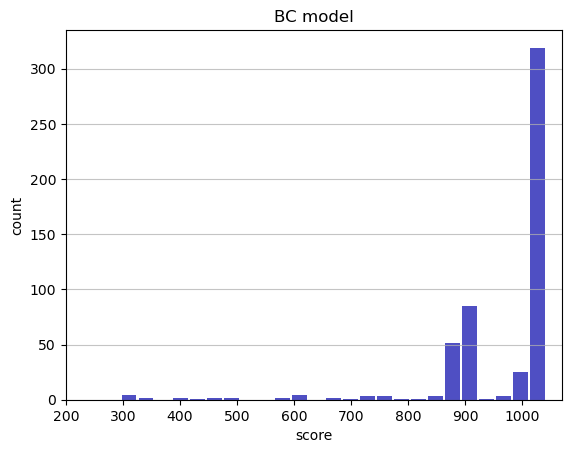

Track generation: 1159..1453 -> 294-tiles track
Epoch: 518
BC	mean: 962.28	variance: 121.95


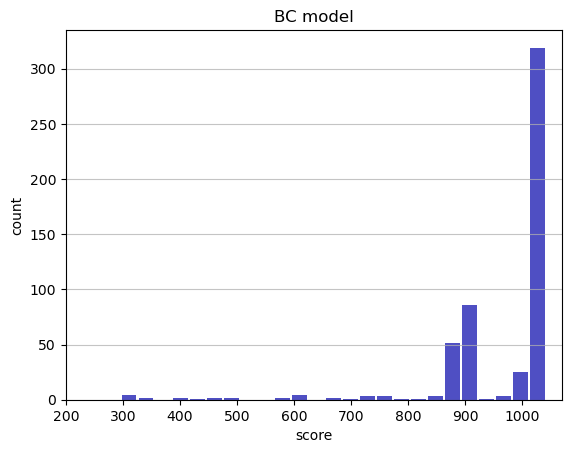

Track generation: 1247..1567 -> 320-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1028..1289 -> 261-tiles track
Epoch: 519
BC	mean: 962.43	variance: 121.88


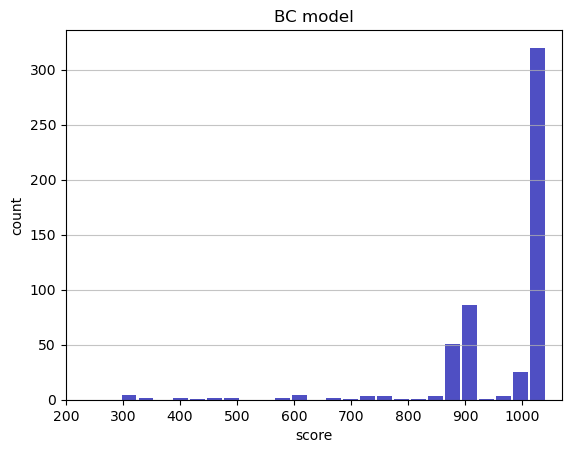

Track generation: 1179..1478 -> 299-tiles track
Epoch: 520
BC	mean: 962.55	variance: 121.79


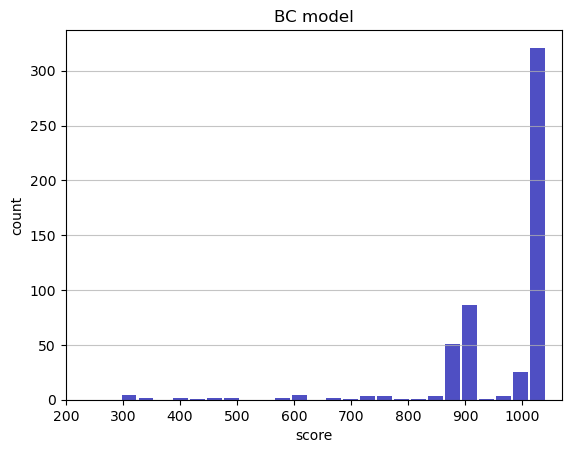

Track generation: 1088..1364 -> 276-tiles track
Epoch: 521
BC	mean: 962.68	variance: 121.71


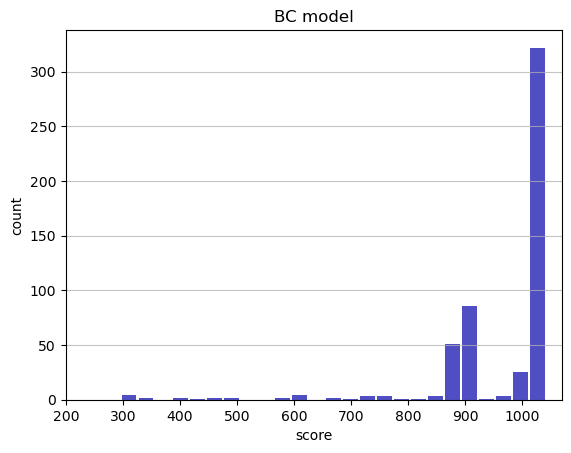

Track generation: 1206..1512 -> 306-tiles track
Epoch: 522
BC	mean: 962.54	variance: 121.63


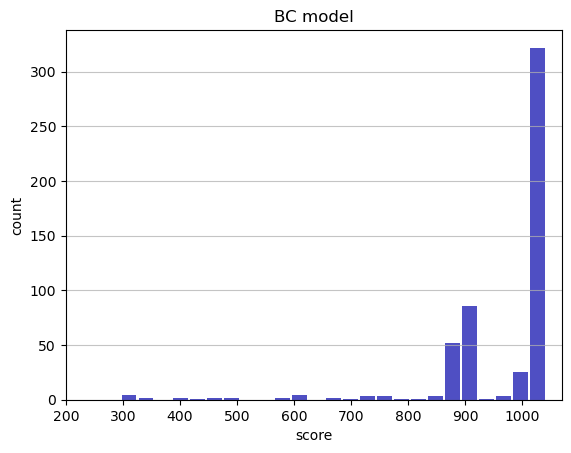

Track generation: 1074..1346 -> 272-tiles track
Epoch: 523
BC	mean: 962.67	variance: 121.55


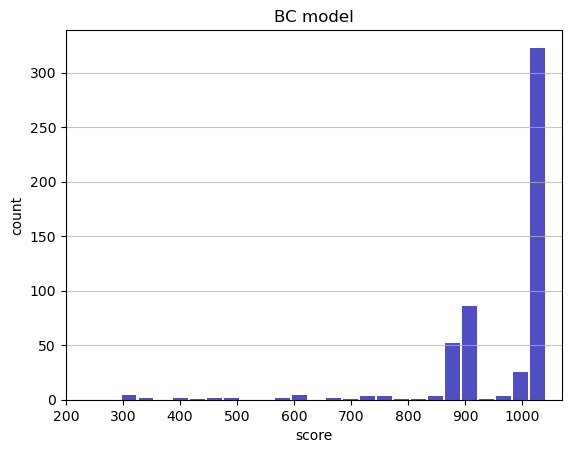

Track generation: 1269..1590 -> 321-tiles track
Epoch: 524
BC	mean: 962.79	variance: 121.47


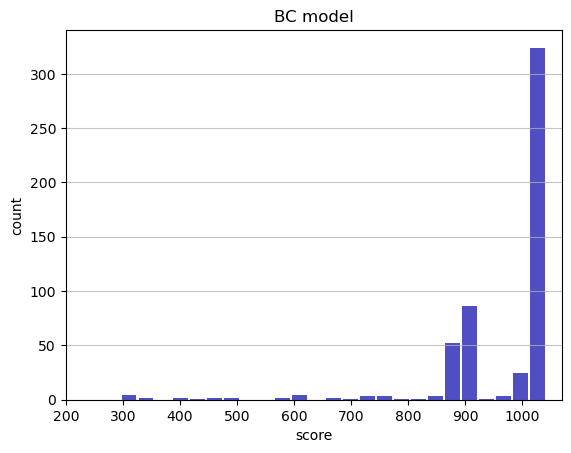

Track generation: 1168..1464 -> 296-tiles track
Epoch: 525
BC	mean: 962.90	variance: 121.38


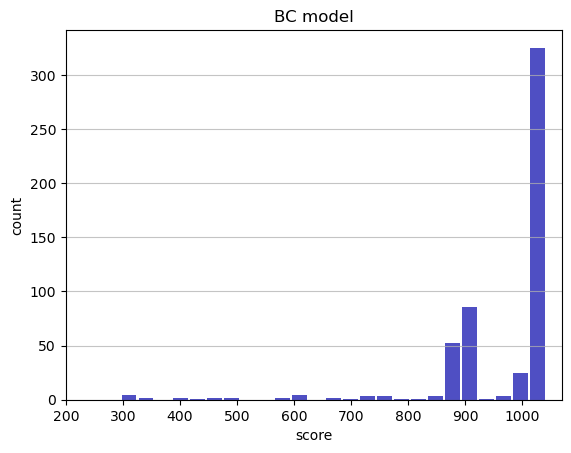

Track generation: 1015..1273 -> 258-tiles track
Epoch: 526
BC	mean: 963.05	variance: 121.31


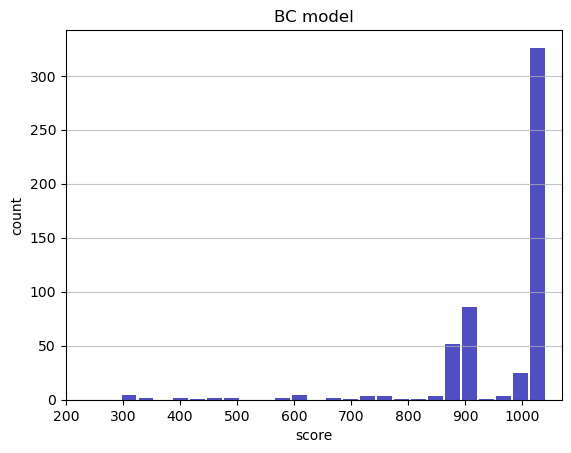

Track generation: 1288..1614 -> 326-tiles track
Epoch: 527
BC	mean: 963.15	variance: 121.22


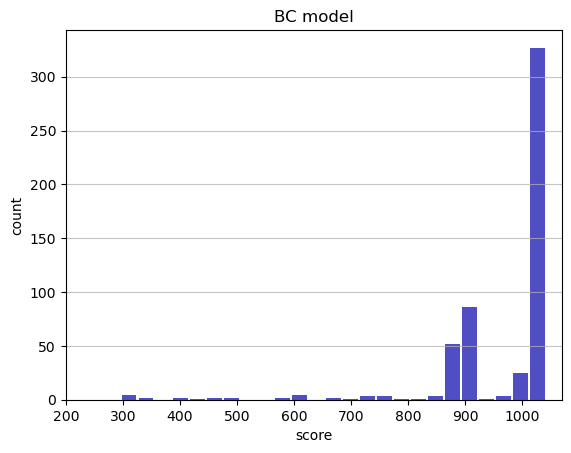

Track generation: 1319..1653 -> 334-tiles track
Epoch: 528
BC	mean: 963.23	variance: 121.12


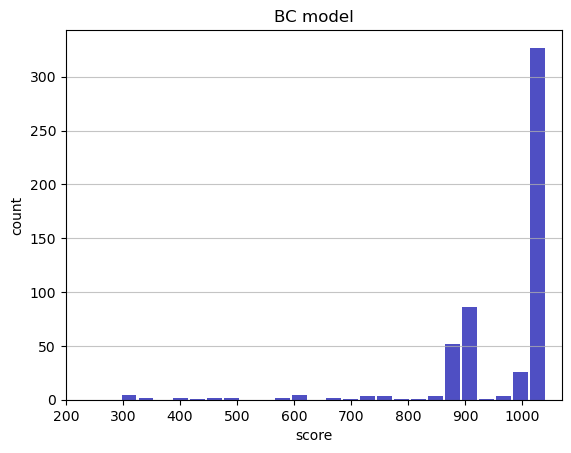

Track generation: 1141..1433 -> 292-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 944..1189 -> 245-tiles track
Epoch: 529
BC	mean: 963.38	variance: 121.05


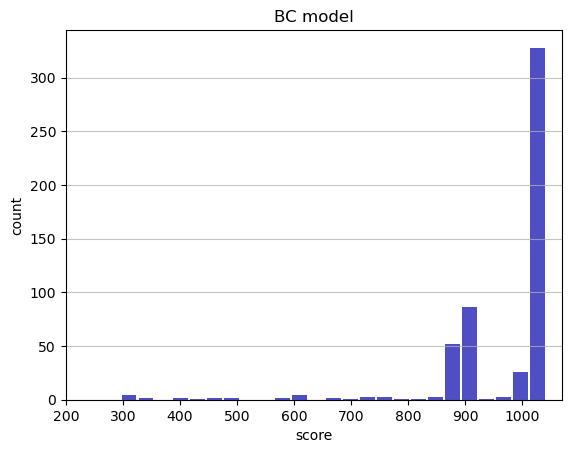

Track generation: 1224..1534 -> 310-tiles track
Epoch: 530
BC	mean: 963.48	variance: 120.96


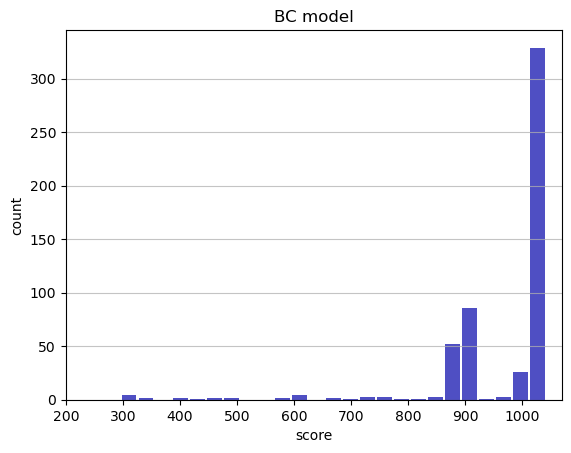

Track generation: 1075..1348 -> 273-tiles track
Epoch: 531
BC	mean: 963.61	variance: 120.88


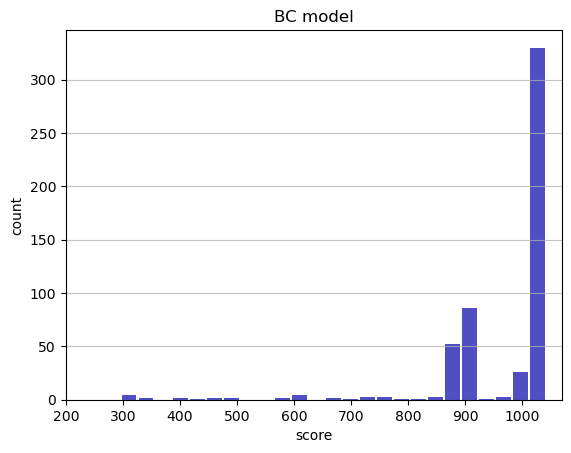

Track generation: 1153..1446 -> 293-tiles track
Epoch: 532
BC	mean: 963.47	variance: 120.82


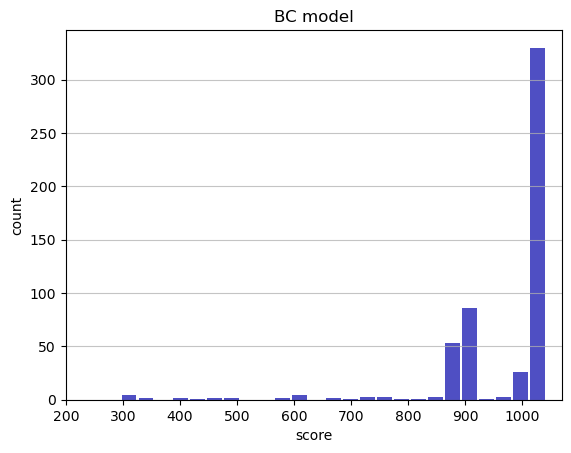

Track generation: 1368..1714 -> 346-tiles track
Epoch: 533
BC	mean: 963.54	variance: 120.71


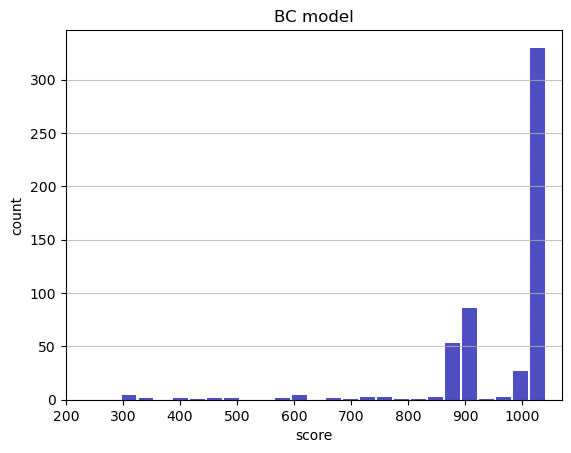

Track generation: 1076..1353 -> 277-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1081..1355 -> 274-tiles track
Epoch: 534
BC	mean: 963.67	variance: 120.64


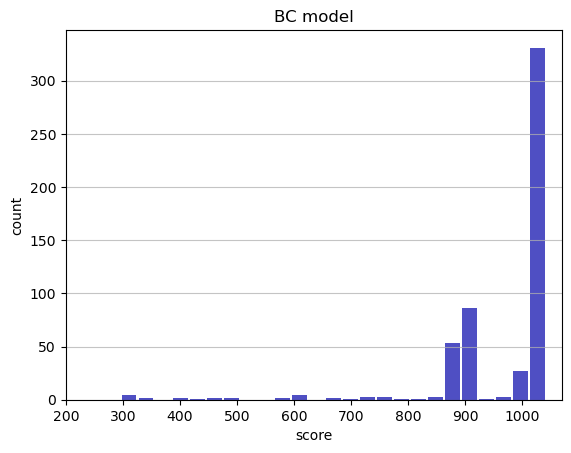

Track generation: 1104..1391 -> 287-tiles track
Epoch: 535
BC	mean: 963.79	variance: 120.56


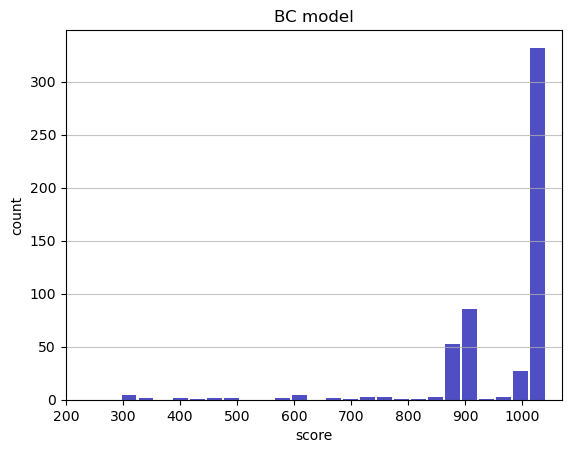

Track generation: 1294..1621 -> 327-tiles track
Epoch: 536
BC	mean: 963.36	variance: 120.86


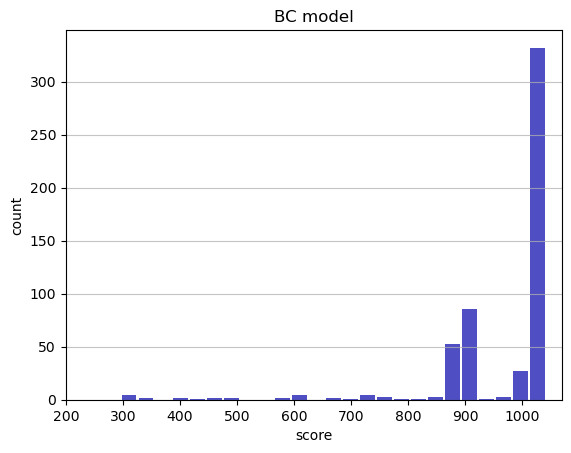

Track generation: 998..1260 -> 262-tiles track
Epoch: 537
BC	mean: 963.49	variance: 120.78


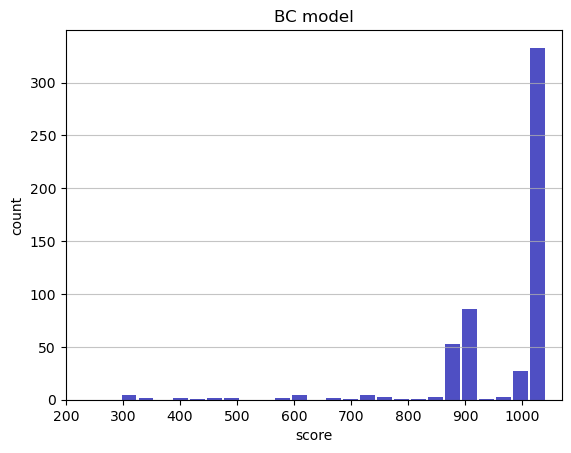

Track generation: 1267..1588 -> 321-tiles track
Epoch: 538
BC	mean: 963.57	variance: 120.68


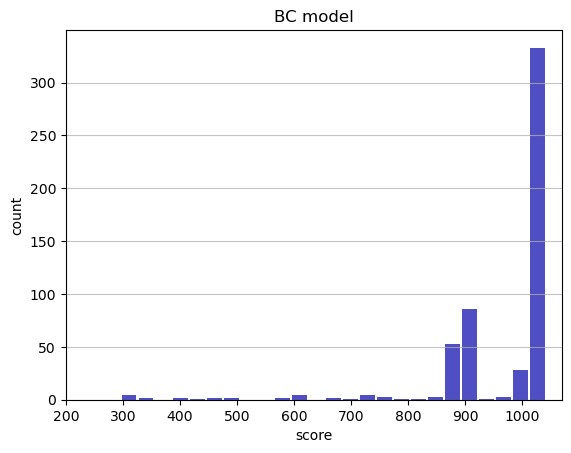

Track generation: 1212..1519 -> 307-tiles track
Epoch: 539
BC	mean: 963.45	variance: 120.60


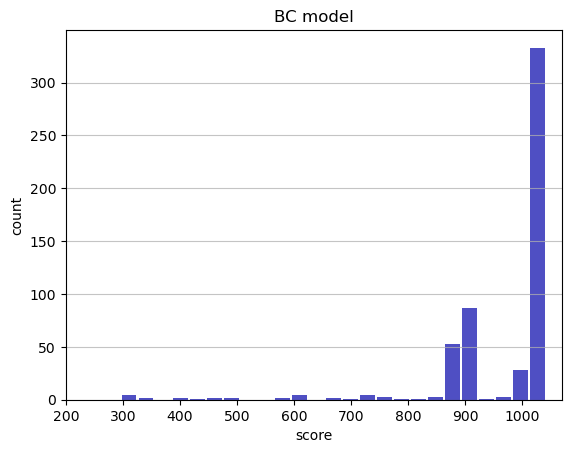

Track generation: 1192..1496 -> 304-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1211..1518 -> 307-tiles track
Epoch: 540
BC	mean: 963.56	variance: 120.52


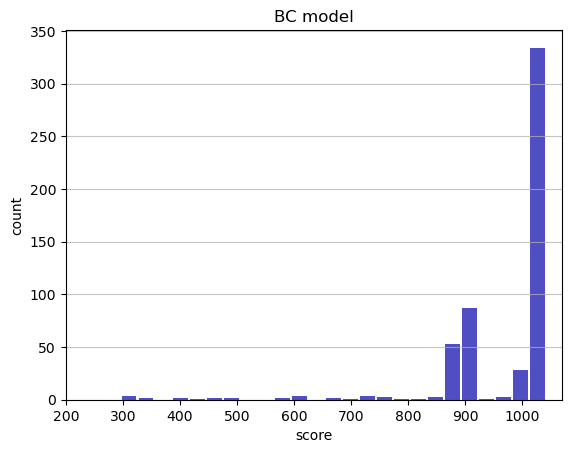

Track generation: 1180..1479 -> 299-tiles track
Epoch: 541
BC	mean: 962.54	variance: 122.73


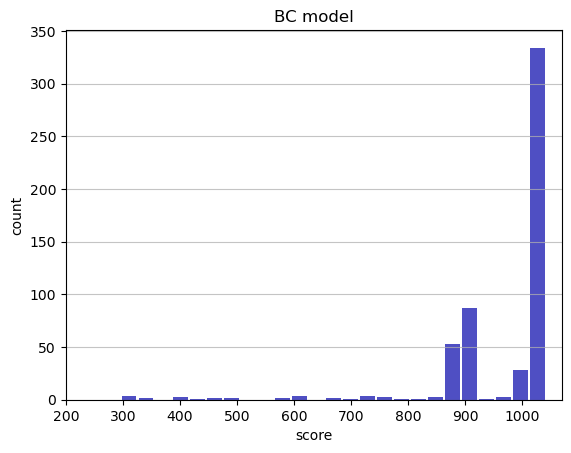

Track generation: 1144..1434 -> 290-tiles track
Epoch: 542
BC	mean: 962.66	variance: 122.64


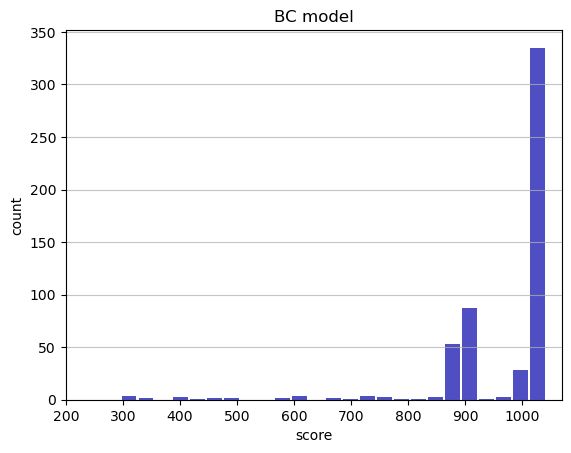

Track generation: 1215..1523 -> 308-tiles track
Epoch: 543
BC	mean: 962.76	variance: 122.56


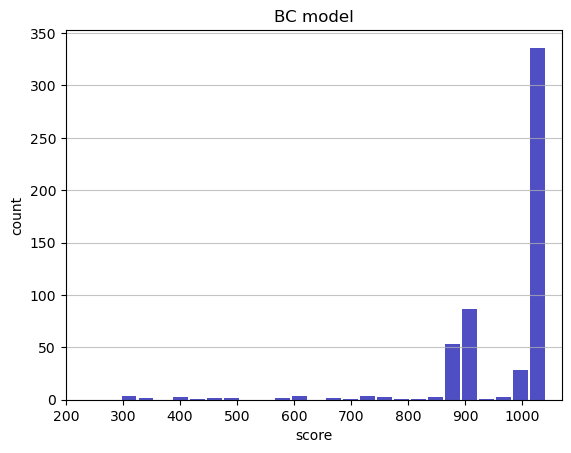

Track generation: 1249..1565 -> 316-tiles track
Epoch: 544
BC	mean: 962.62	variance: 122.49


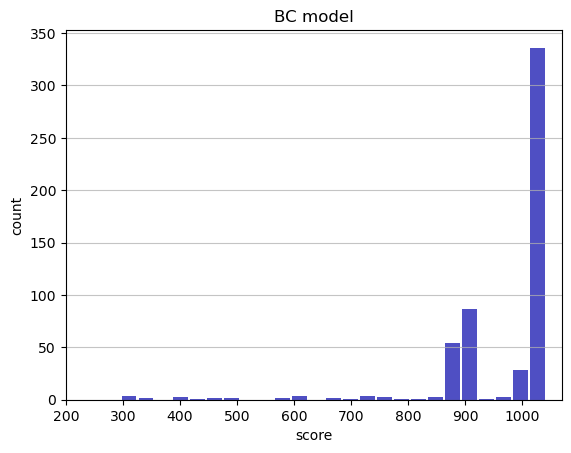

Track generation: 1196..1499 -> 303-tiles track
Epoch: 545
BC	mean: 962.72	variance: 122.40


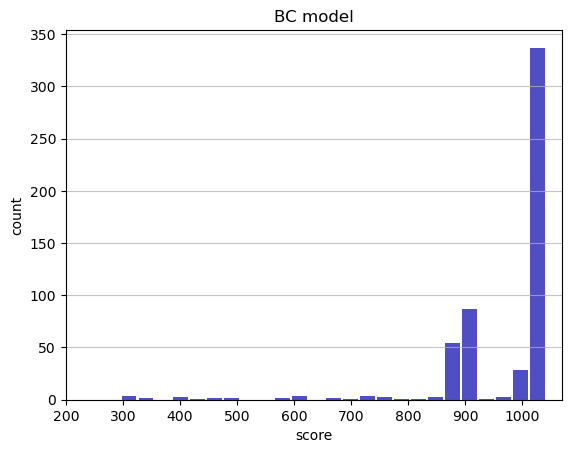

Track generation: 1108..1394 -> 286-tiles track
Epoch: 546
BC	mean: 962.61	variance: 122.32


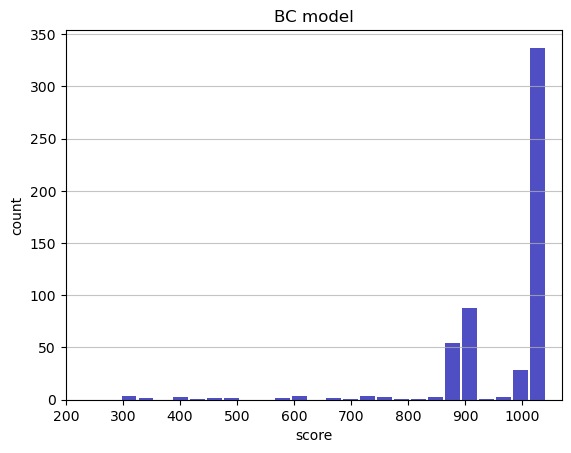

Track generation: 944..1184 -> 240-tiles track
Epoch: 547
BC	mean: 962.74	variance: 122.25


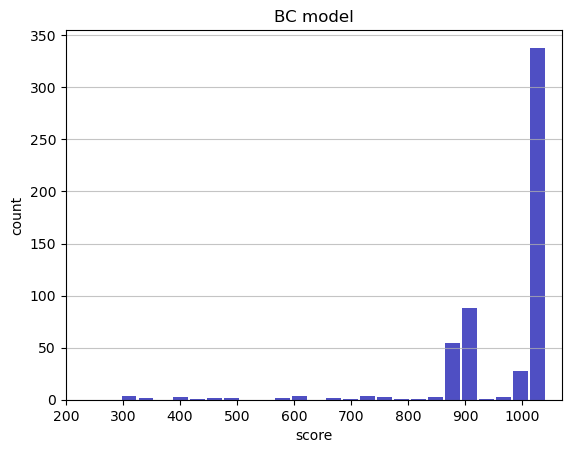

Track generation: 1072..1344 -> 272-tiles track
Epoch: 548
BC	mean: 962.64	variance: 122.16


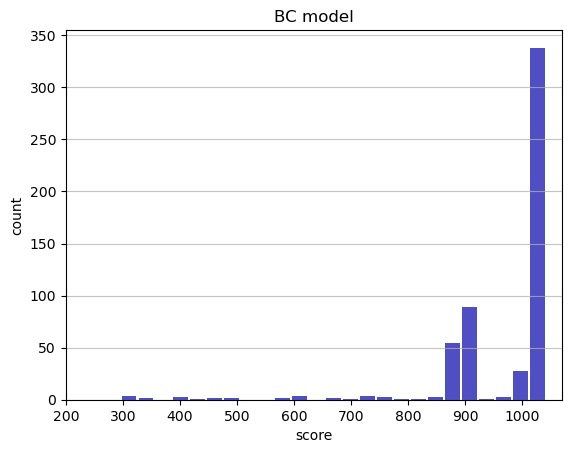

Track generation: 1080..1354 -> 274-tiles track
Epoch: 549
BC	mean: 962.77	variance: 122.09


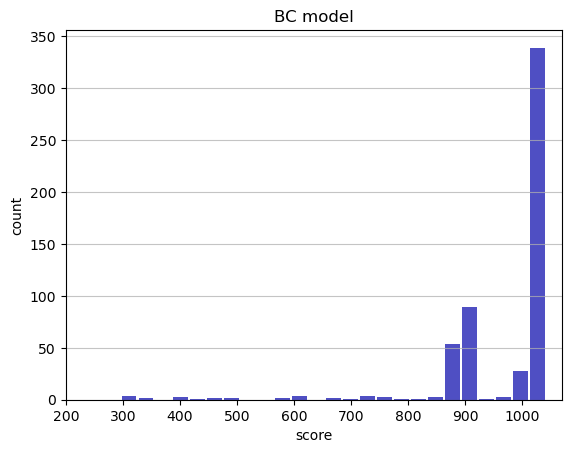

Track generation: 1175..1473 -> 298-tiles track
Epoch: 550
BC	mean: 962.68	variance: 122.00


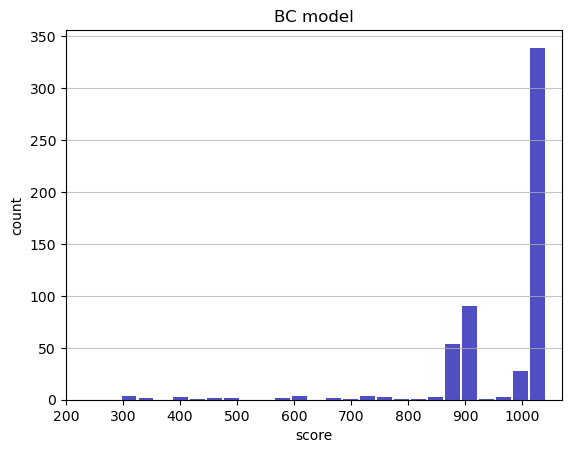

Track generation: 1067..1338 -> 271-tiles track
Epoch: 551
BC	mean: 962.80	variance: 121.92


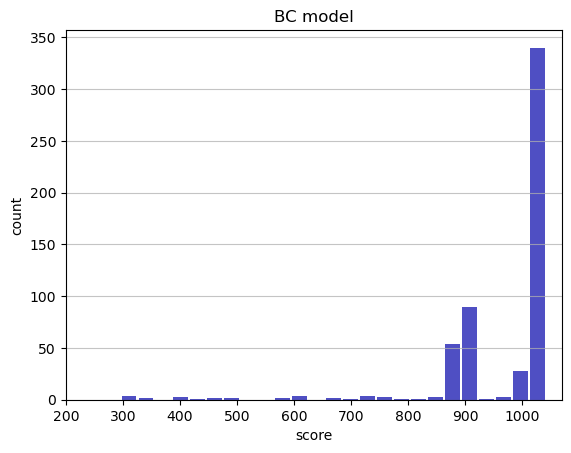

Track generation: 1132..1419 -> 287-tiles track
Epoch: 552
BC	mean: 962.68	variance: 121.84


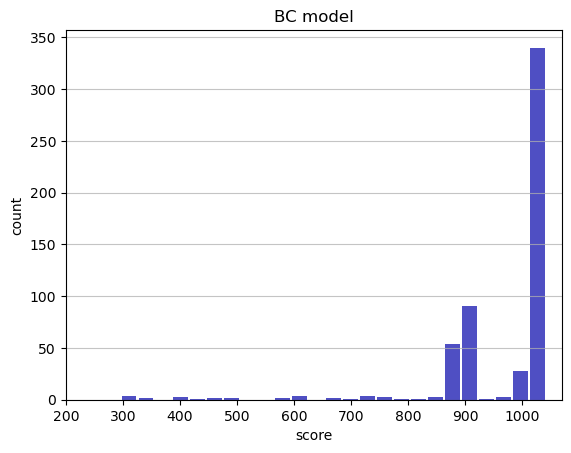

Track generation: 1014..1279 -> 265-tiles track
Epoch: 553
BC	mean: 962.81	variance: 121.77


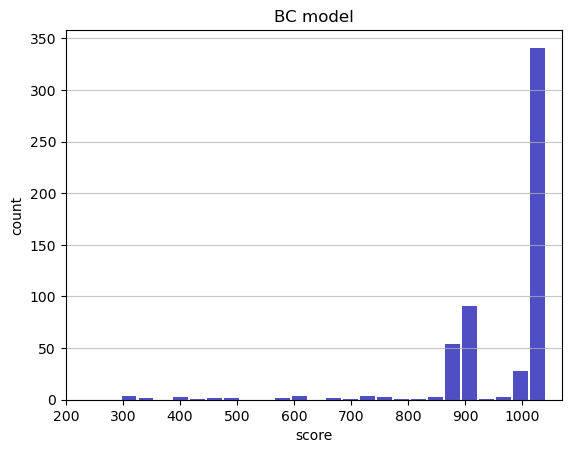

Track generation: 1034..1306 -> 272-tiles track
Epoch: 554
BC	mean: 962.66	variance: 121.71


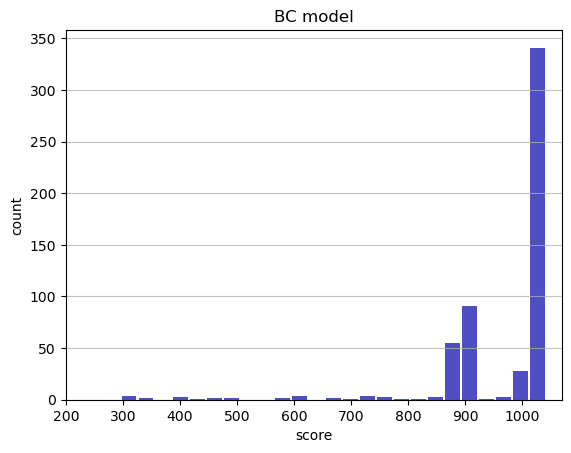

Track generation: 1180..1479 -> 299-tiles track
Epoch: 555
BC	mean: 962.77	variance: 121.63


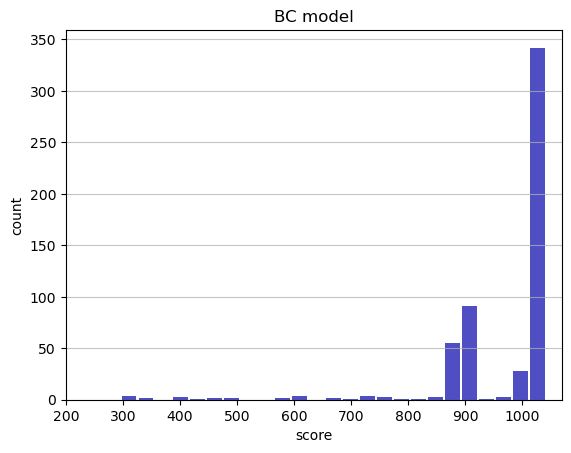

Track generation: 1208..1514 -> 306-tiles track
Epoch: 556
BC	mean: 962.65	variance: 121.55


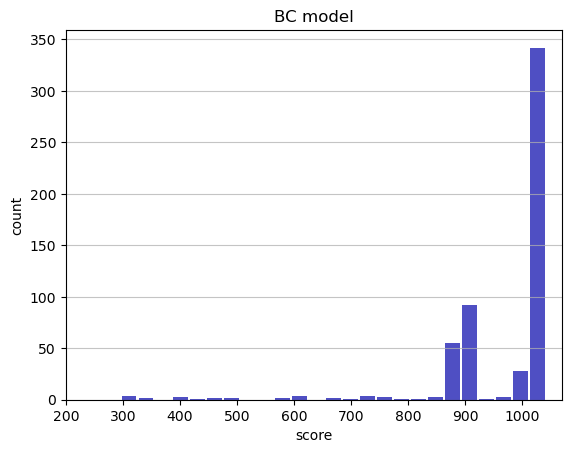

Track generation: 1121..1405 -> 284-tiles track
Epoch: 557
BC	mean: 962.78	variance: 121.48


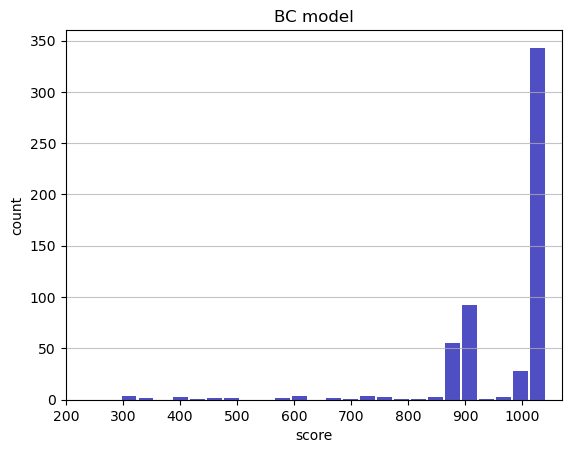

Track generation: 1168..1464 -> 296-tiles track
Epoch: 558
BC	mean: 962.89	variance: 121.39


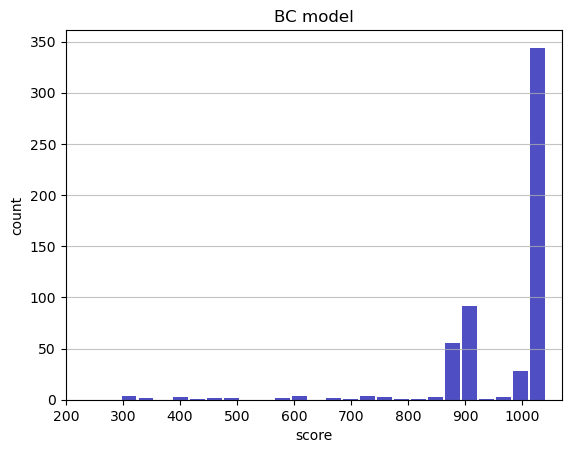

Track generation: 1075..1352 -> 277-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1250..1566 -> 316-tiles track
Epoch: 559
BC	mean: 962.70	variance: 121.36


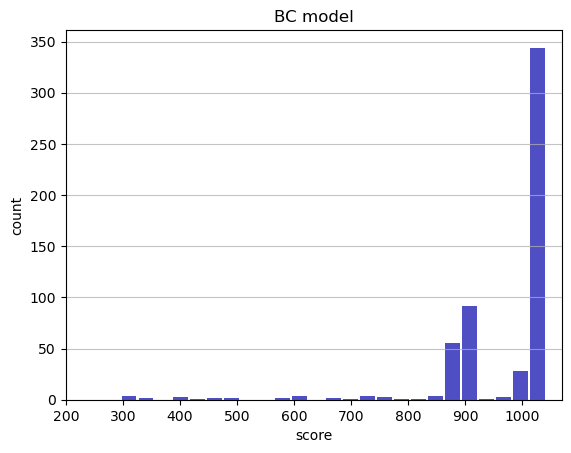

Track generation: 1168..1464 -> 296-tiles track
Epoch: 560
BC	mean: 962.81	variance: 121.28


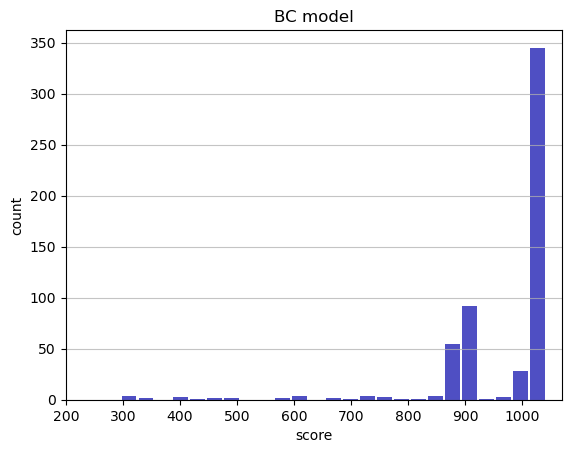

Track generation: 1261..1580 -> 319-tiles track
Epoch: 561
BC	mean: 961.78	variance: 123.57


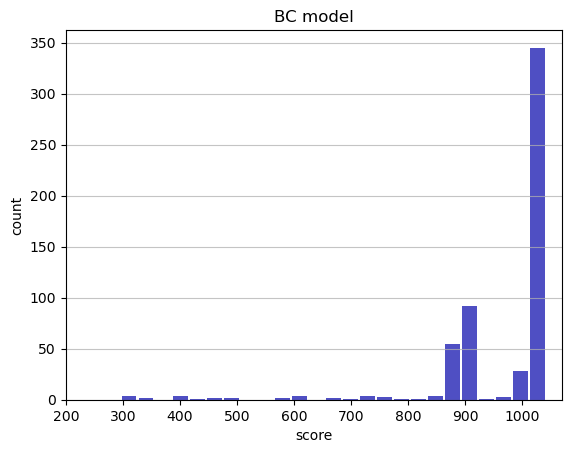

Track generation: 1284..1609 -> 325-tiles track
Epoch: 562
BC	mean: 961.66	variance: 123.49


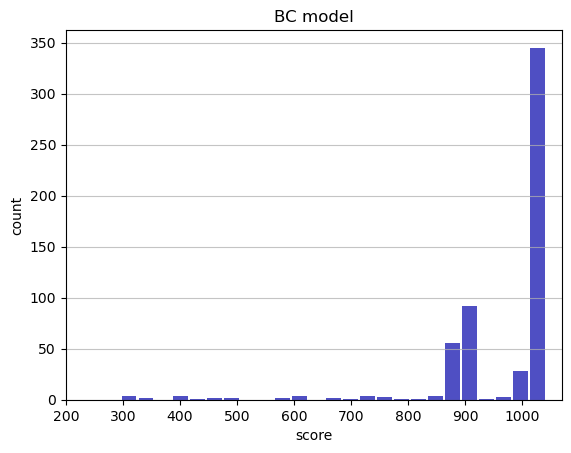

Track generation: 1246..1561 -> 315-tiles track
Epoch: 563
BC	mean: 961.76	variance: 123.41


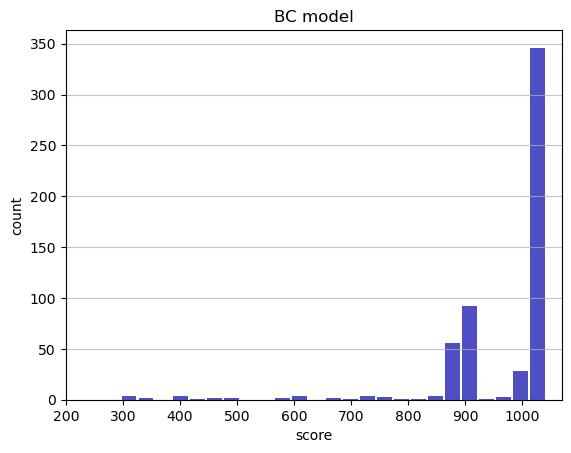

Track generation: 1033..1295 -> 262-tiles track
Epoch: 564
BC	mean: 961.89	variance: 123.34


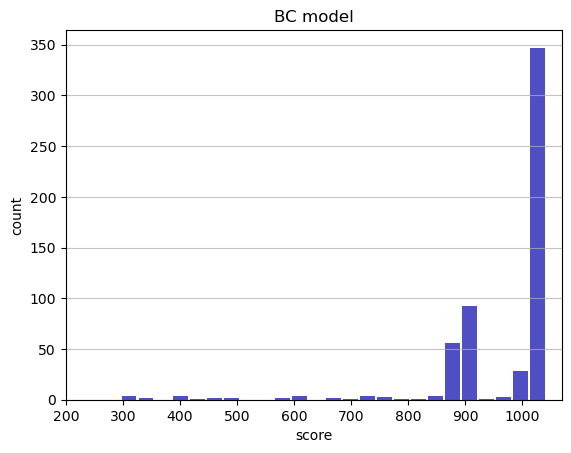

Track generation: 1222..1532 -> 310-tiles track
Epoch: 565
BC	mean: 961.99	variance: 123.25


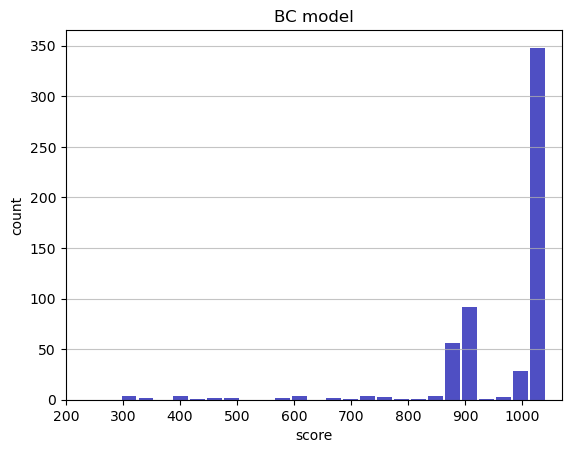

Track generation: 1166..1461 -> 295-tiles track
Epoch: 566
BC	mean: 961.89	variance: 123.17


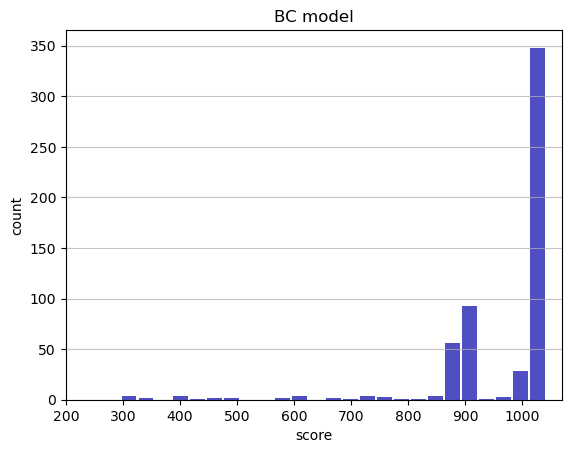

Track generation: 1039..1303 -> 264-tiles track
Epoch: 567
BC	mean: 962.03	variance: 123.10


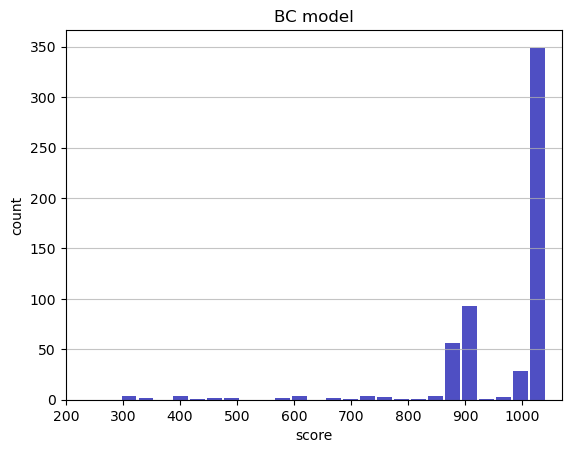

Track generation: 1132..1419 -> 287-tiles track
Epoch: 568
BC	mean: 962.14	variance: 123.02


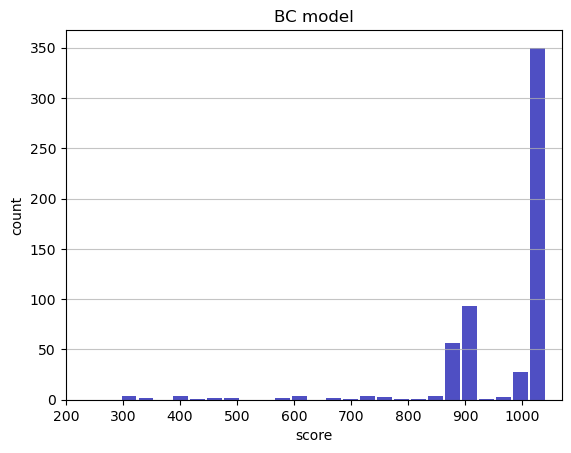

Track generation: 1149..1450 -> 301-tiles track
Epoch: 569
BC	mean: 962.25	variance: 122.94


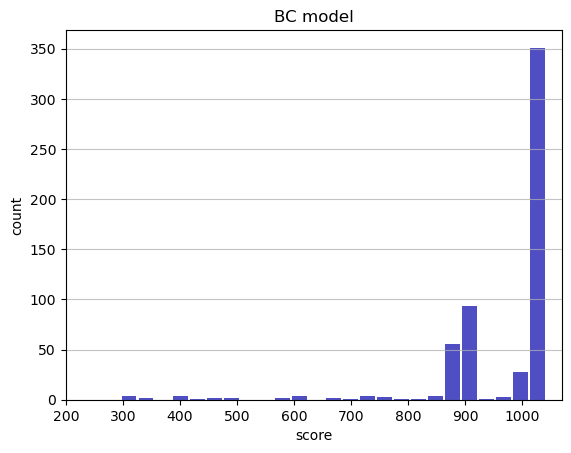

Track generation: 1124..1409 -> 285-tiles track
Epoch: 570
BC	mean: 962.36	variance: 122.86


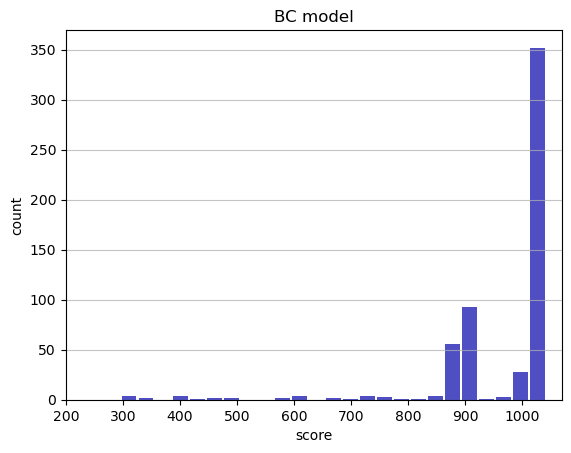

Track generation: 1148..1439 -> 291-tiles track
Epoch: 571
BC	mean: 962.47	variance: 122.78


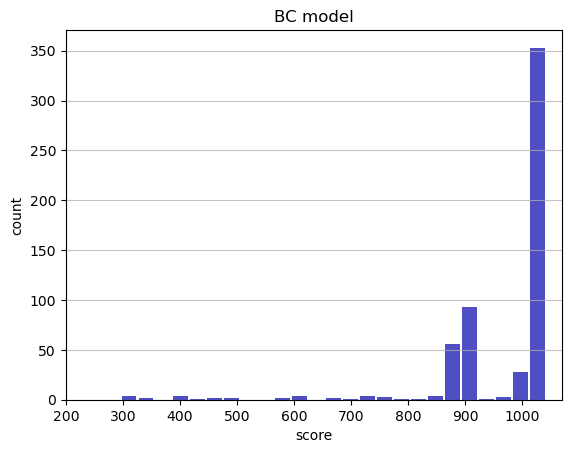

Track generation: 1183..1483 -> 300-tiles track
Epoch: 572
BC	mean: 962.36	variance: 122.70


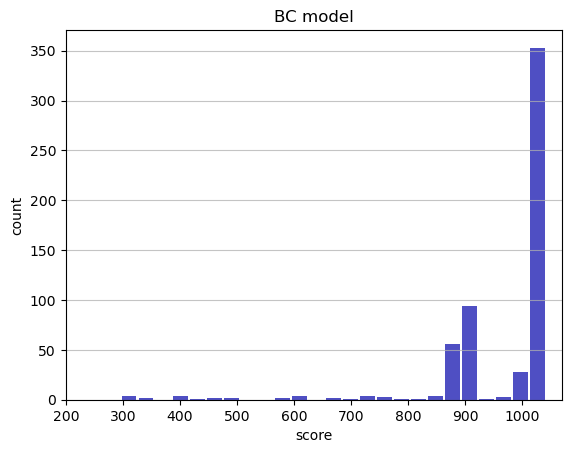

Track generation: 1028..1300 -> 272-tiles track
Epoch: 573
BC	mean: 962.48	variance: 122.62


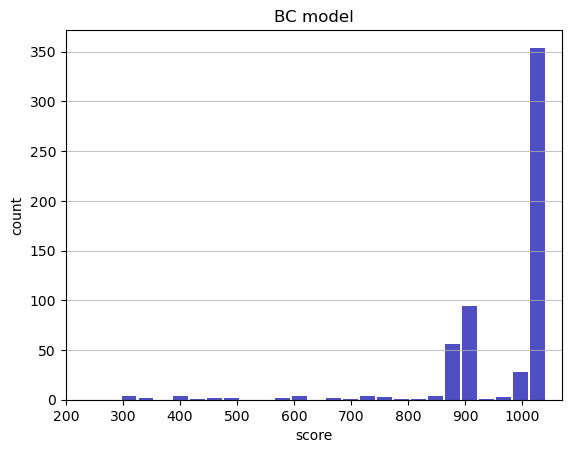

Track generation: 1102..1381 -> 279-tiles track
Epoch: 574
BC	mean: 962.59	variance: 122.54


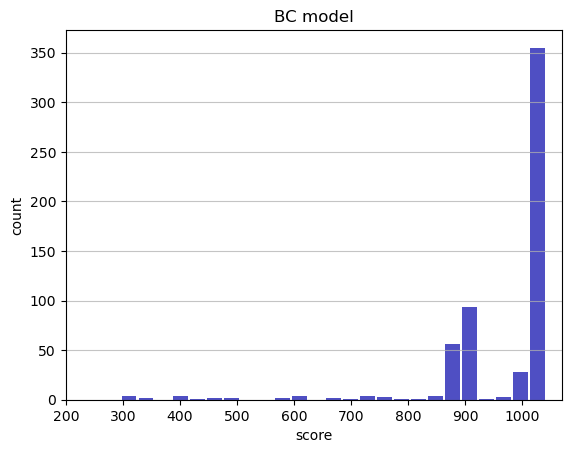

Track generation: 1189..1490 -> 301-tiles track
Epoch: 575
BC	mean: 962.47	variance: 122.47


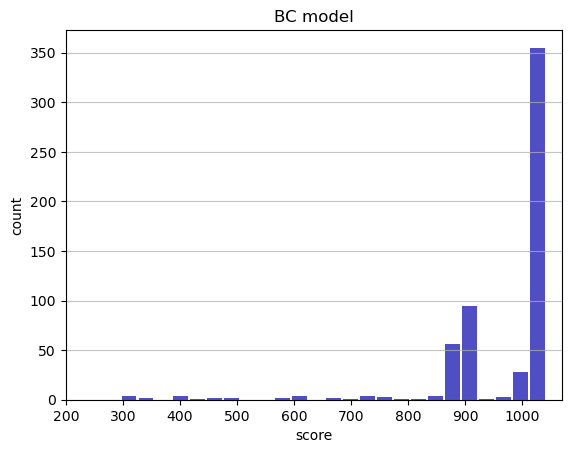

Track generation: 951..1197 -> 246-tiles track
Epoch: 576
BC	mean: 962.60	variance: 122.40


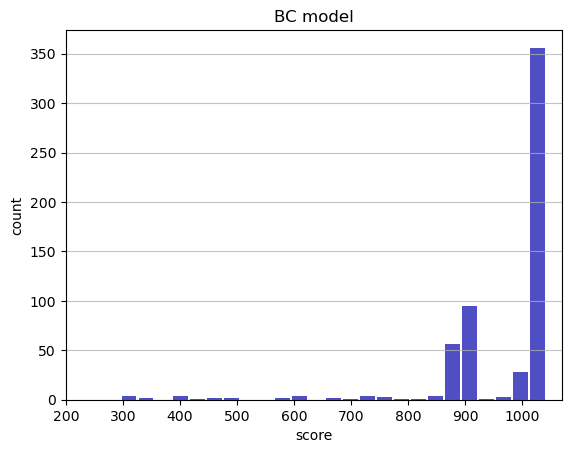

Track generation: 1027..1288 -> 261-tiles track
Epoch: 577
BC	mean: 962.51	variance: 122.31


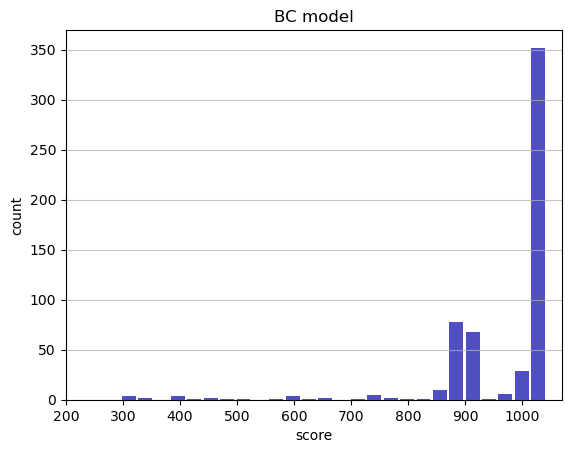

Track generation: 1097..1377 -> 280-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1192..1495 -> 303-tiles track
Epoch: 578
BC	mean: 962.61	variance: 122.23


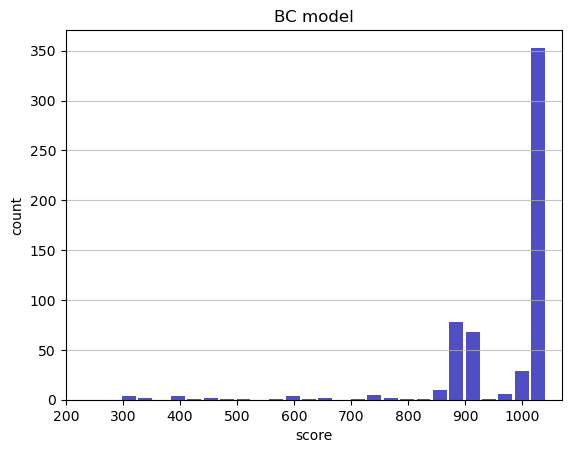

Track generation: 1223..1544 -> 321-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1007..1263 -> 256-tiles track
Epoch: 579
BC	mean: 962.73	variance: 122.16


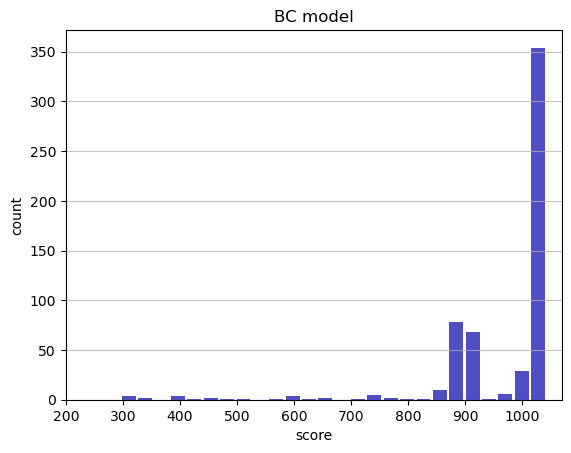

Track generation: 1252..1569 -> 317-tiles track
Epoch: 580
BC	mean: 961.63	variance: 124.93


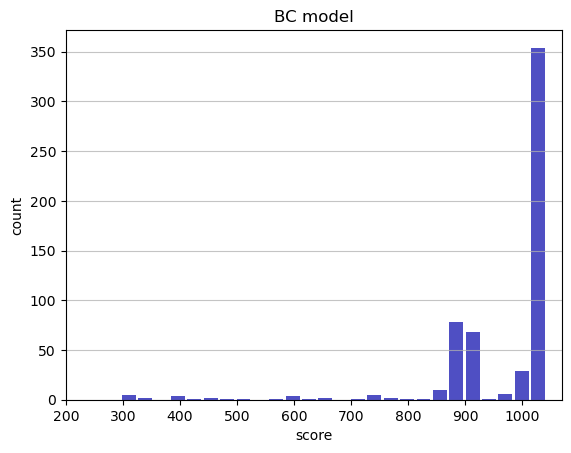

Track generation: 1095..1373 -> 278-tiles track
Epoch: 581
BC	mean: 961.52	variance: 124.85


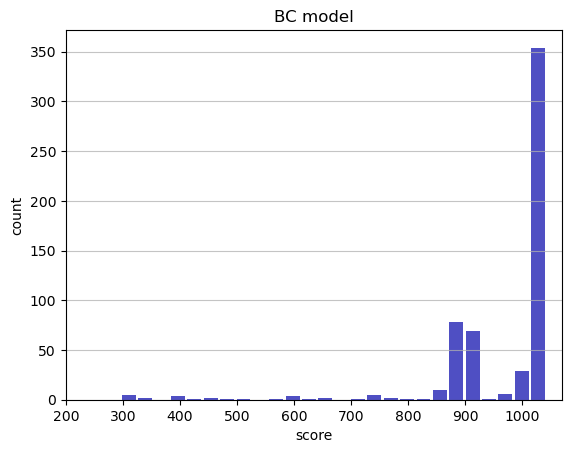

Track generation: 938..1180 -> 242-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1240..1554 -> 314-tiles track
Epoch: 582
BC	mean: 961.62	variance: 124.77


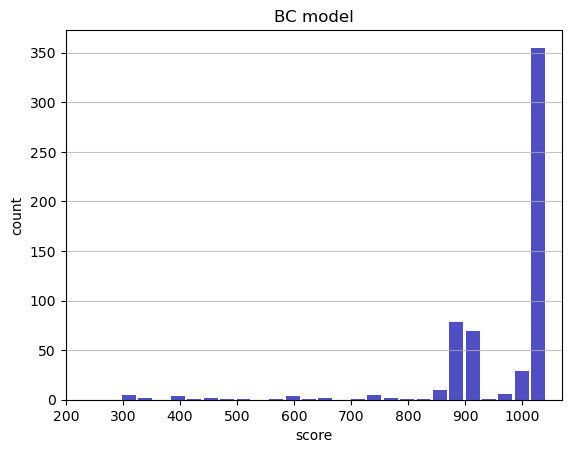

Track generation: 1186..1493 -> 307-tiles track
Epoch: 583
BC	mean: 961.73	variance: 124.69


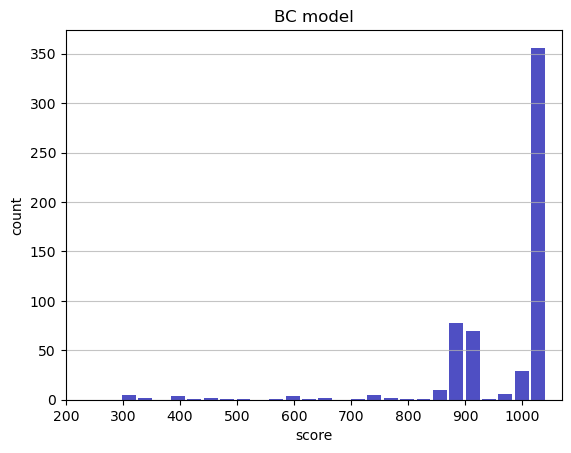

Track generation: 1183..1484 -> 301-tiles track
Epoch: 584
BC	mean: 961.62	variance: 124.61


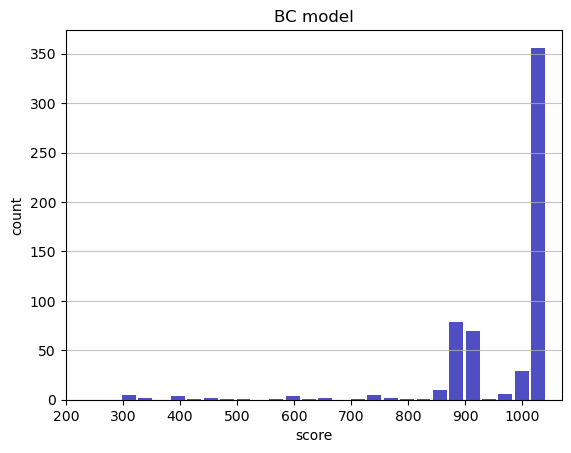

Track generation: 1161..1456 -> 295-tiles track
Epoch: 585
BC	mean: 960.42	variance: 127.79


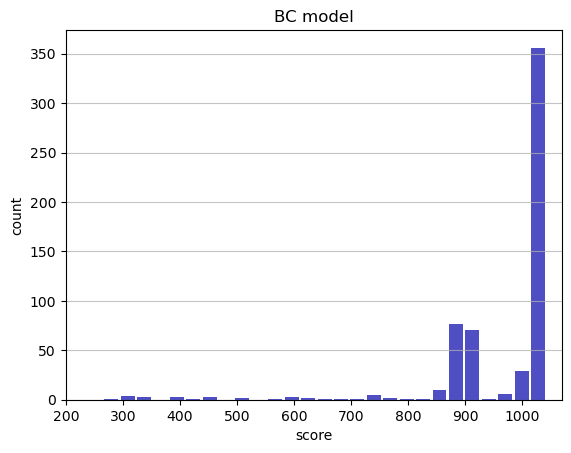

Track generation: 1118..1402 -> 284-tiles track
Epoch: 586
BC	mean: 960.30	variance: 127.71


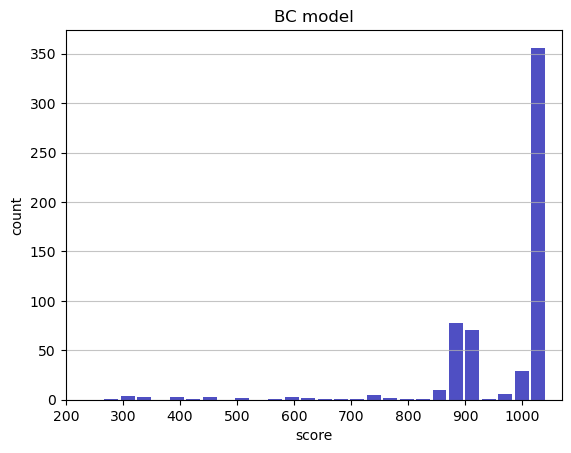

Track generation: 963..1213 -> 250-tiles track
Epoch: 587
BC	mean: 960.23	variance: 127.62


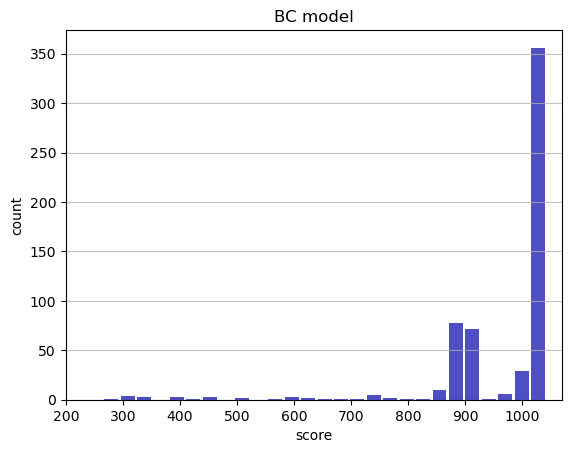

Track generation: 1143..1433 -> 290-tiles track
Epoch: 588
BC	mean: 960.34	variance: 127.53


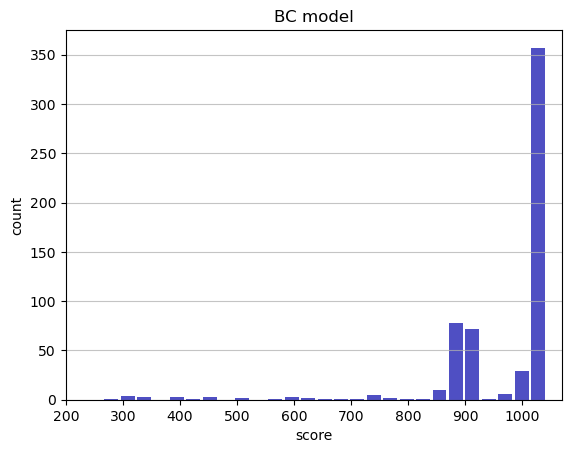

Track generation: 1060..1329 -> 269-tiles track
Epoch: 589
BC	mean: 960.11	variance: 127.54


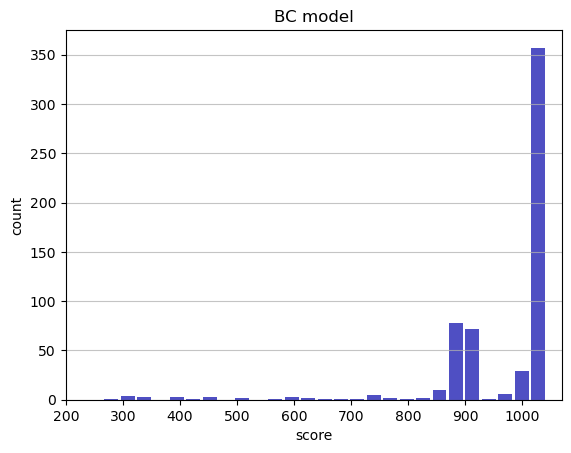

Track generation: 1175..1473 -> 298-tiles track
Epoch: 590
BC	mean: 960.23	variance: 127.47


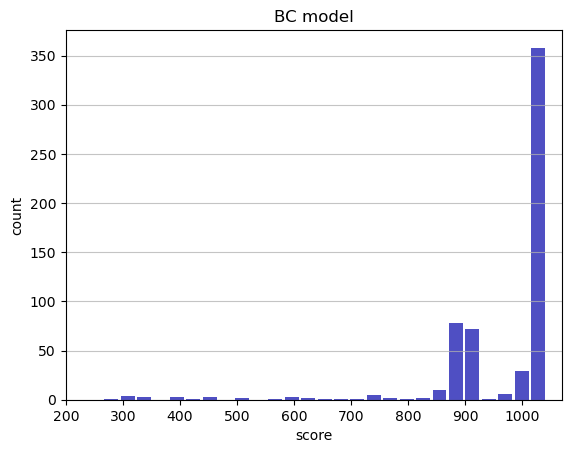

Track generation: 1075..1348 -> 273-tiles track
Epoch: 591
BC	mean: 960.35	variance: 127.39


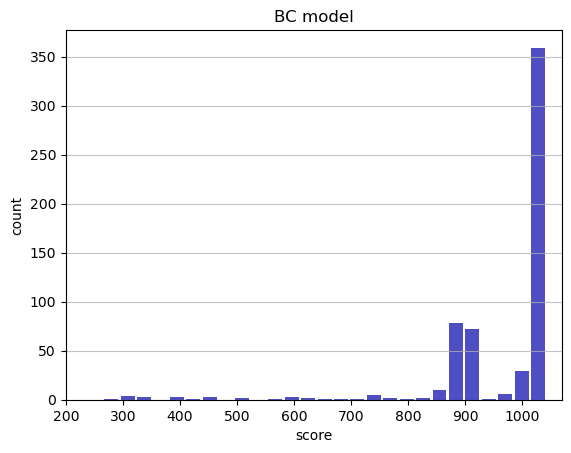

Track generation: 1092..1369 -> 277-tiles track
Epoch: 592
BC	mean: 960.46	variance: 127.31


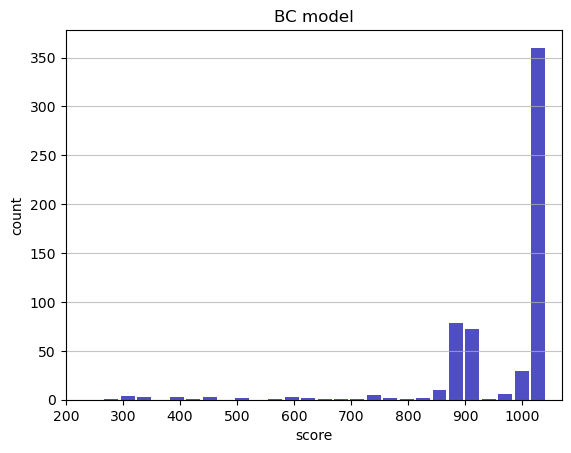

Track generation: 1063..1333 -> 270-tiles track
Epoch: 593
BC	mean: 960.58	variance: 127.24


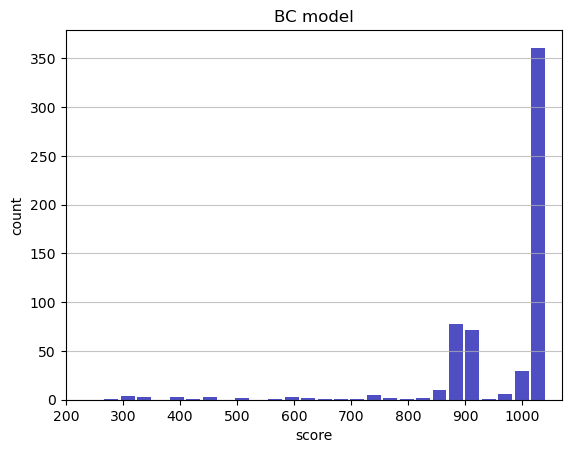

Track generation: 1279..1602 -> 323-tiles track
Epoch: 594
BC	mean: 960.68	variance: 127.16


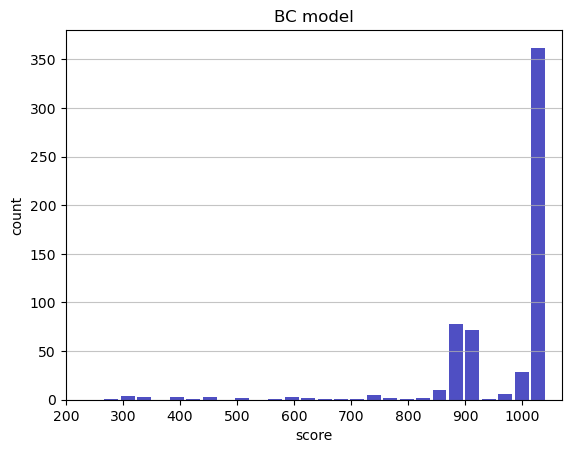

Track generation: 1177..1475 -> 298-tiles track
Epoch: 595
BC	mean: 960.78	variance: 127.08


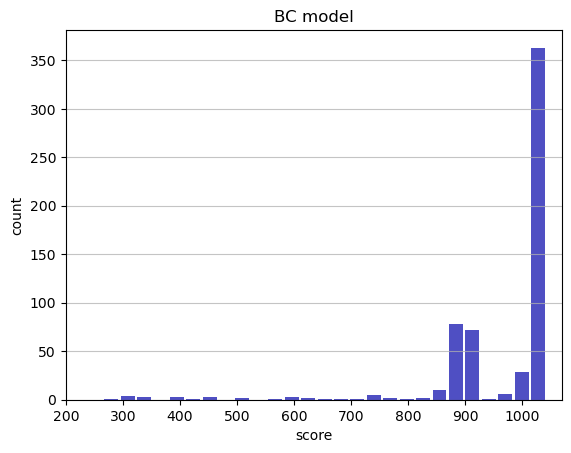

Track generation: 1228..1539 -> 311-tiles track
Epoch: 596
BC	mean: 960.63	variance: 127.02


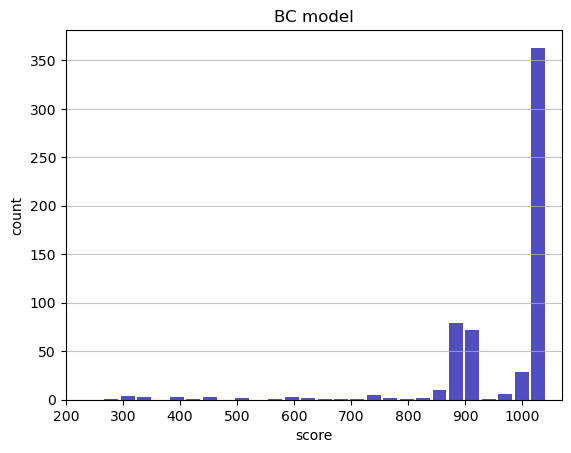

Track generation: 1187..1488 -> 301-tiles track
Epoch: 597
BC	mean: 960.51	variance: 126.95


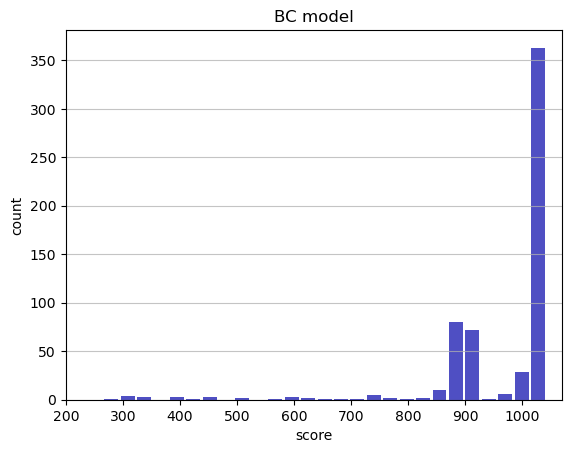

Track generation: 1115..1398 -> 283-tiles track
Epoch: 598
BC	mean: 960.64	variance: 126.88


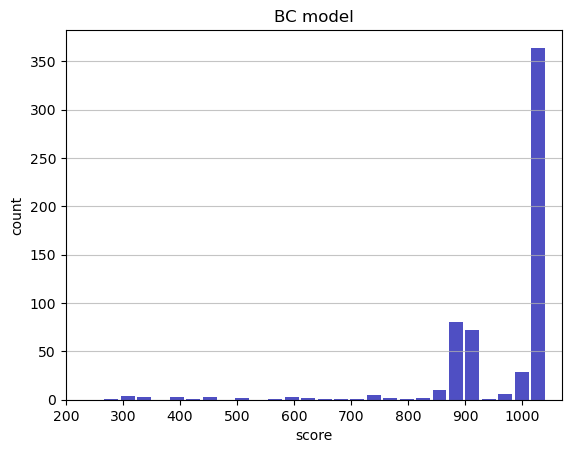

Track generation: 1143..1434 -> 291-tiles track
Epoch: 599
BC	mean: 960.75	variance: 126.80


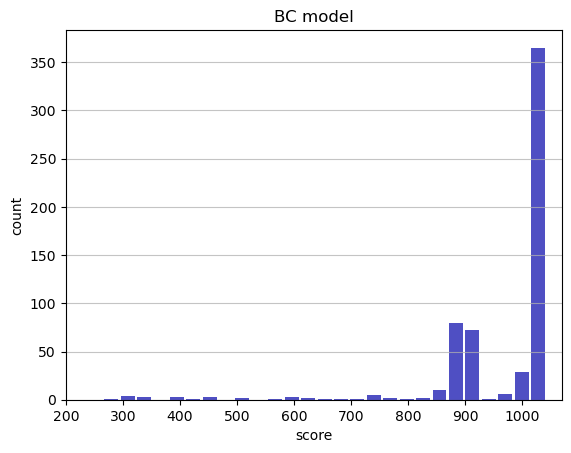

Track generation: 1048..1314 -> 266-tiles track
Epoch: 600
BC	mean: 960.87	variance: 126.73


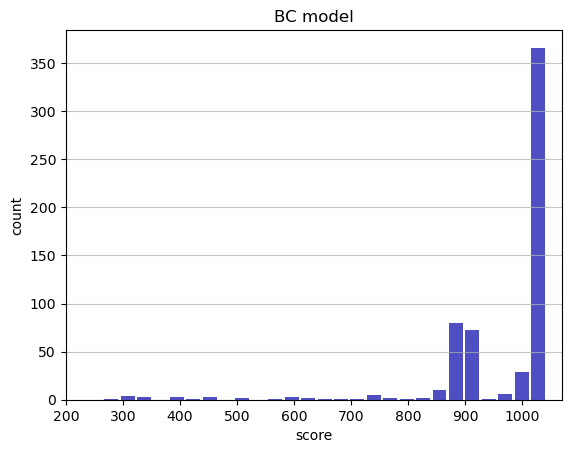

Track generation: 1117..1409 -> 292-tiles track
Epoch: 601
BC	mean: 960.43	variance: 127.08


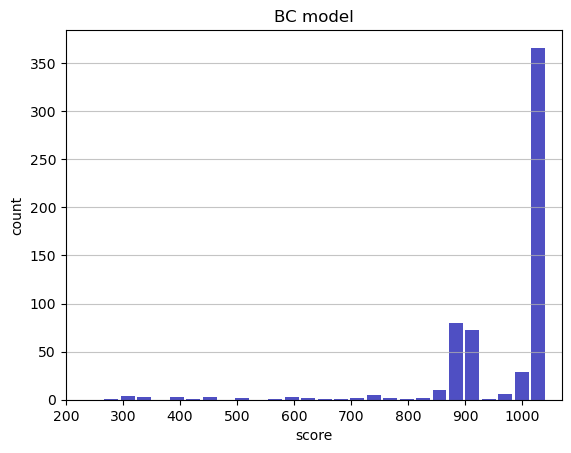

Track generation: 1135..1423 -> 288-tiles track
Epoch: 602
BC	mean: 960.54	variance: 127.00


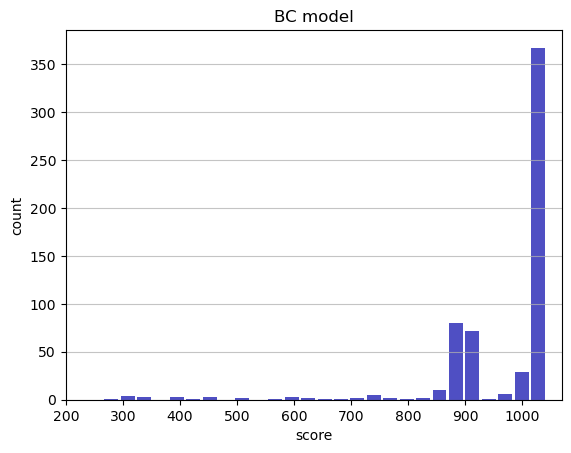

Track generation: 1108..1389 -> 281-tiles track
Epoch: 603
BC	mean: 960.40	variance: 126.94


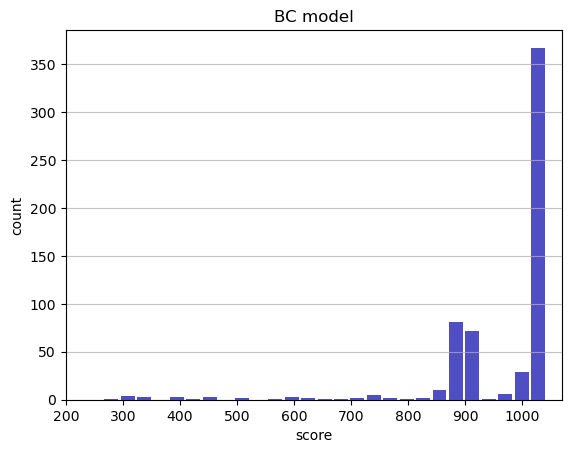

Track generation: 1338..1685 -> 347-tiles track
Epoch: 604
BC	mean: 960.48	variance: 126.85


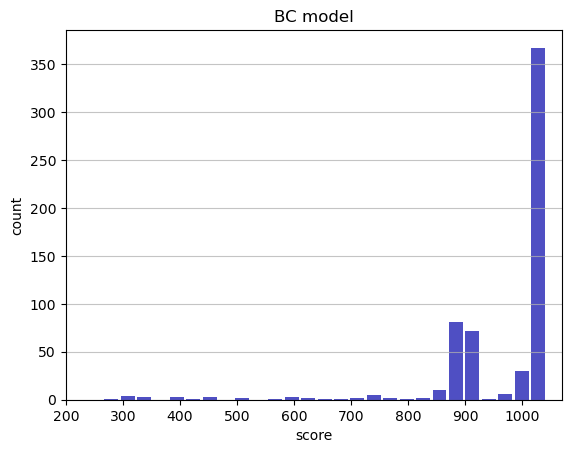

Track generation: 1119..1409 -> 290-tiles track
Epoch: 605
BC	mean: 960.29	variance: 126.83


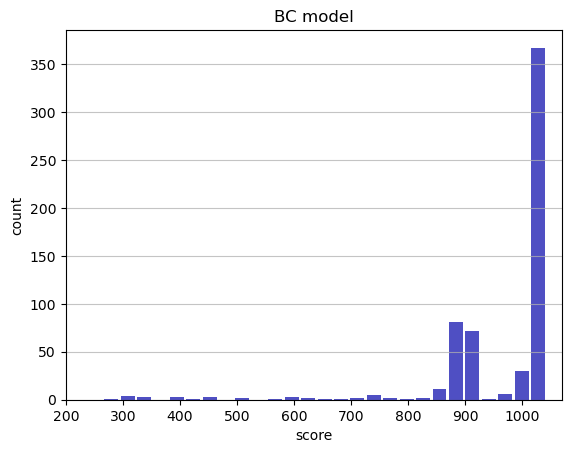

Track generation: 1199..1503 -> 304-tiles track
Epoch: 606
BC	mean: 960.39	variance: 126.75


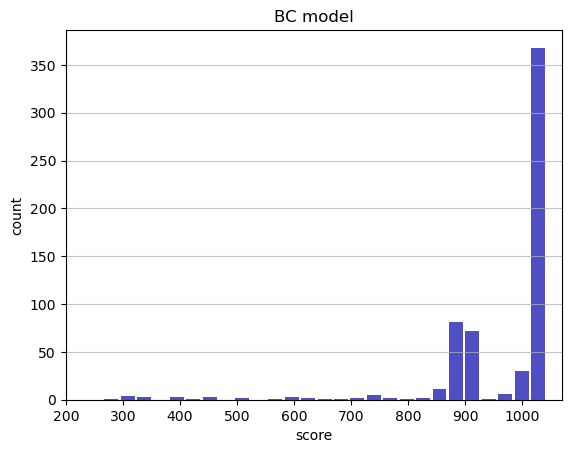

Track generation: 1000..1254 -> 254-tiles track
Epoch: 607
BC	mean: 960.53	variance: 126.69


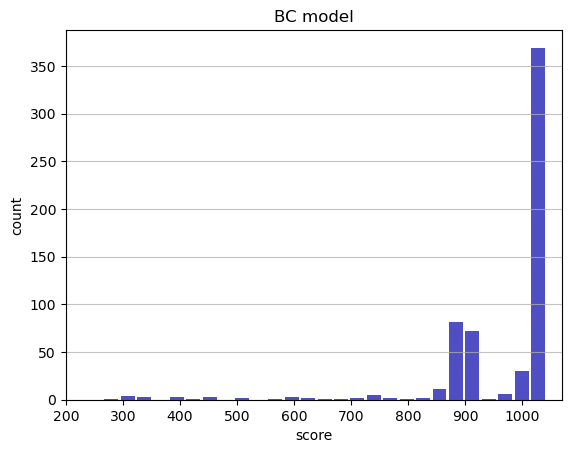

Track generation: 1116..1399 -> 283-tiles track
Epoch: 608
BC	mean: 960.44	variance: 126.60


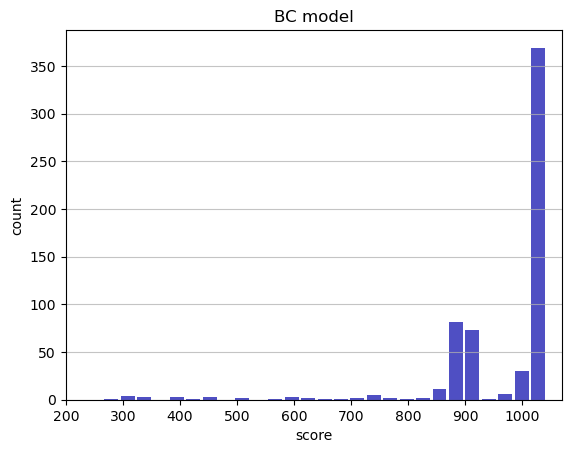

Track generation: 1155..1458 -> 303-tiles track
Epoch: 609
BC	mean: 959.53	variance: 128.47


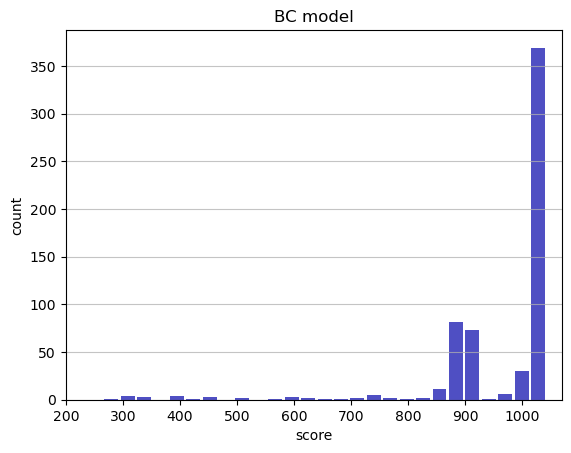

Track generation: 1164..1459 -> 295-tiles track
Epoch: 610
BC	mean: 959.43	variance: 128.39


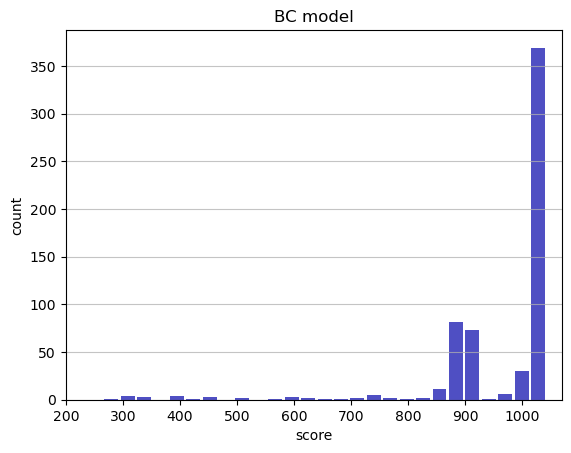

Track generation: 1109..1377 -> 268-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1204..1509 -> 305-tiles track
Epoch: 611
BC	mean: 959.35	variance: 128.30


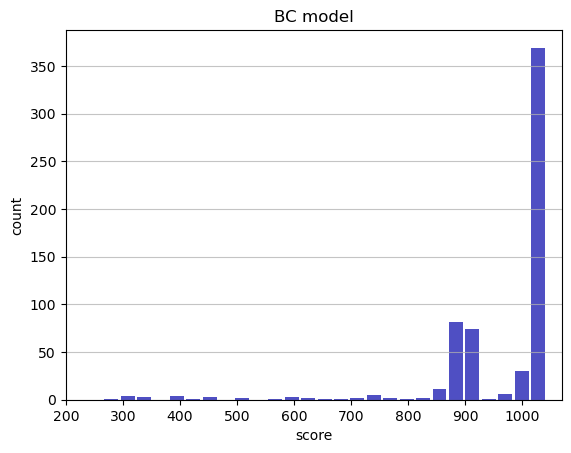

Track generation: 1256..1574 -> 318-tiles track
Epoch: 612
BC	mean: 959.23	variance: 128.23


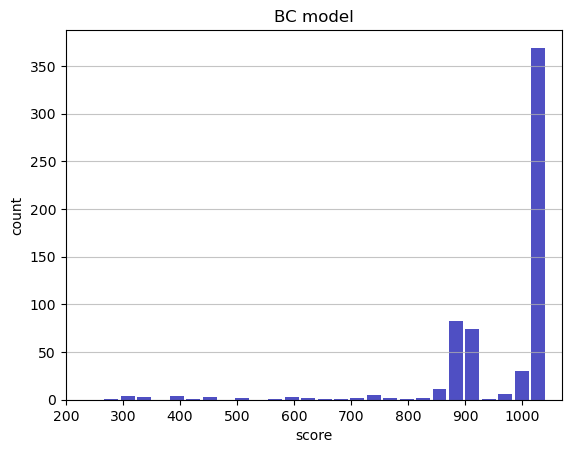

Track generation: 1056..1328 -> 272-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1174..1471 -> 297-tiles track
Epoch: 613
BC	mean: 959.33	variance: 128.15


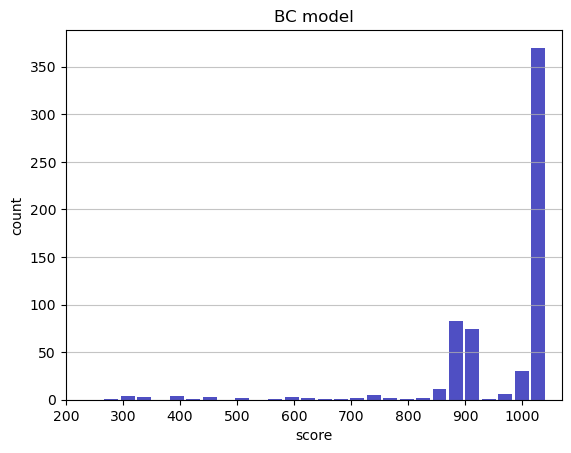

Track generation: 997..1259 -> 262-tiles track
Epoch: 614
BC	mean: 959.45	variance: 128.08


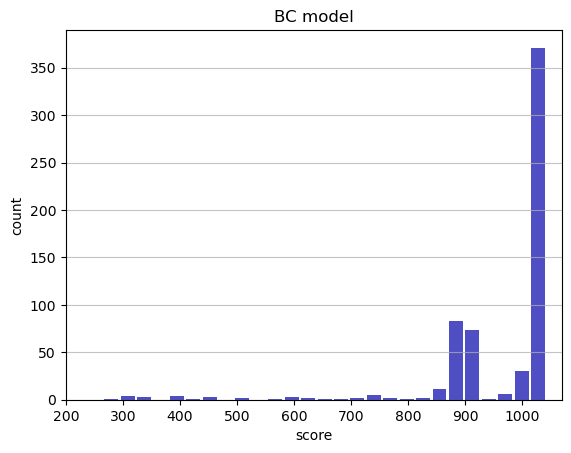

Track generation: 997..1252 -> 255-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1095..1373 -> 278-tiles track
Epoch: 615
BC	mean: 959.57	variance: 128.01


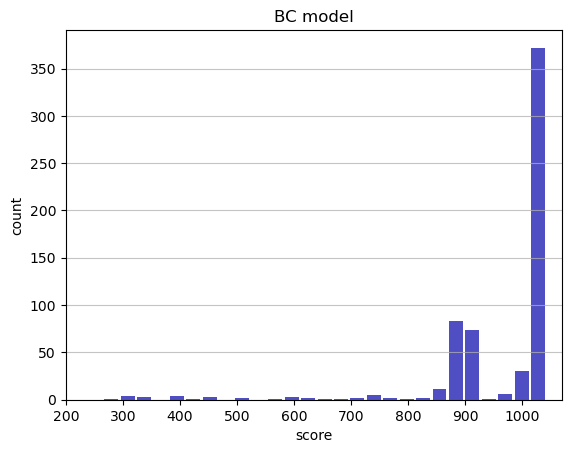

Track generation: 1190..1492 -> 302-tiles track
Epoch: 616
BC	mean: 959.48	variance: 127.92


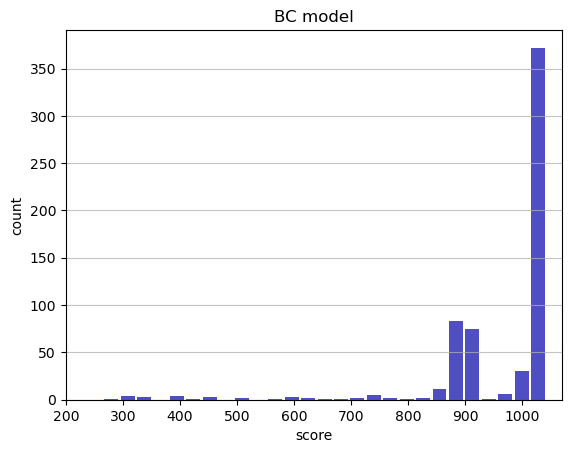

Track generation: 1232..1544 -> 312-tiles track
Epoch: 617
BC	mean: 959.38	variance: 127.85


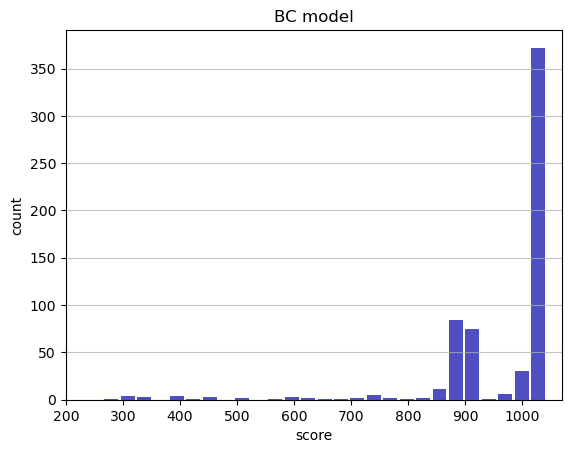

Track generation: 1131..1418 -> 287-tiles track
Epoch: 618
BC	mean: 959.49	variance: 127.77


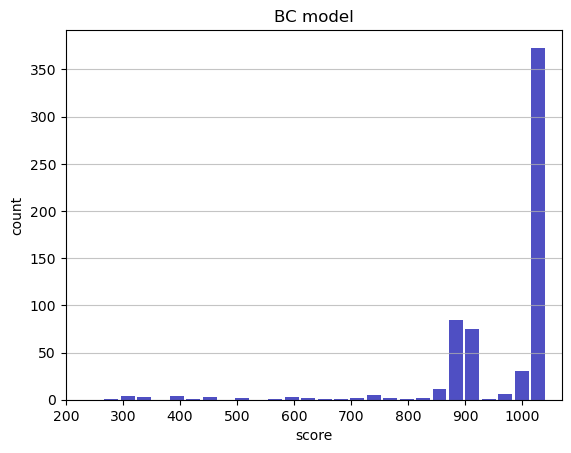

Track generation: 1147..1438 -> 291-tiles track
Epoch: 619
BC	mean: 959.60	variance: 127.70


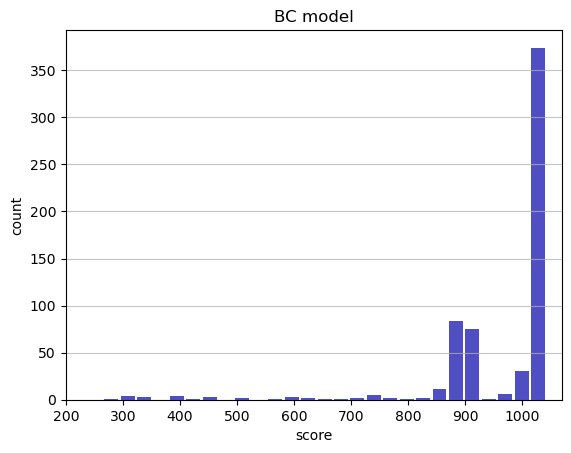

Track generation: 1047..1315 -> 268-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1061..1332 -> 271-tiles track
Epoch: 620
BC	mean: 959.71	variance: 127.62


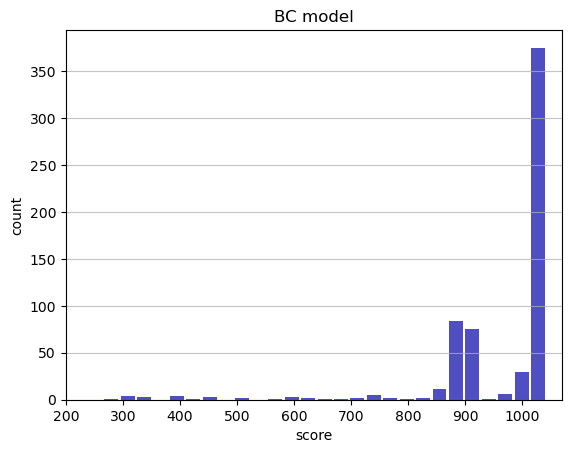

Track generation: 1148..1439 -> 291-tiles track
Epoch: 621
BC	mean: 959.63	variance: 127.54


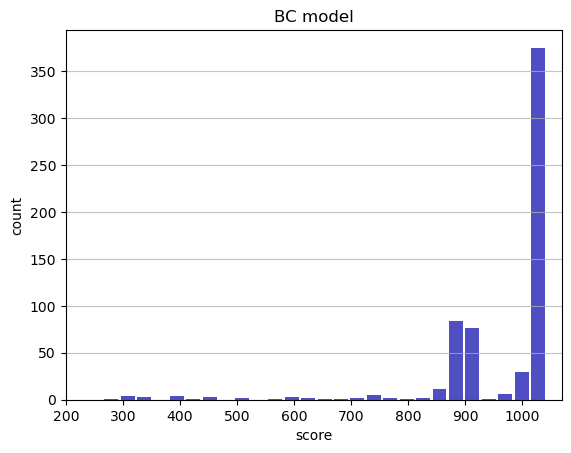

Track generation: 1040..1304 -> 264-tiles track
Epoch: 622
BC	mean: 959.74	variance: 127.47


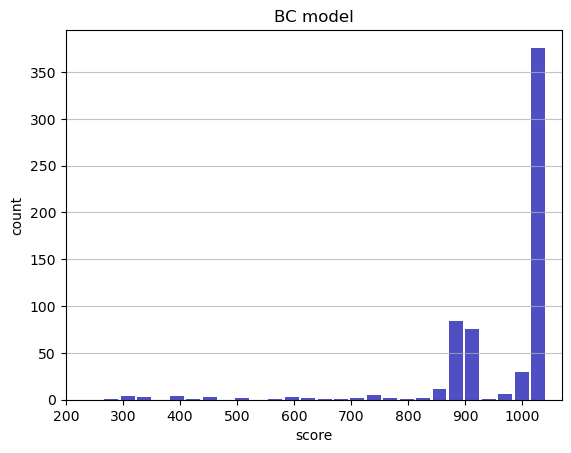

Track generation: 1132..1419 -> 287-tiles track
Epoch: 623
BC	mean: 959.66	variance: 127.38


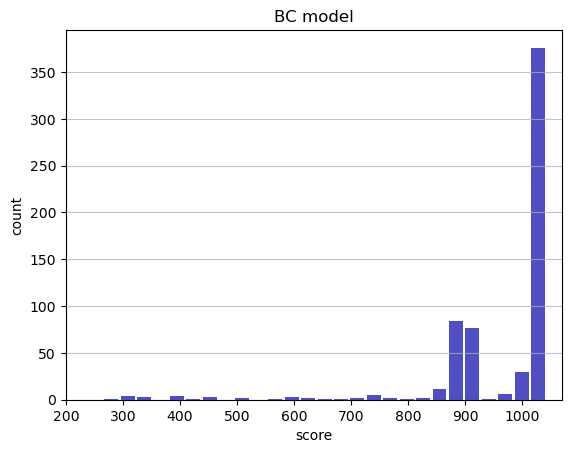

Track generation: 1186..1492 -> 306-tiles track
Epoch: 624
BC	mean: 959.76	variance: 127.30


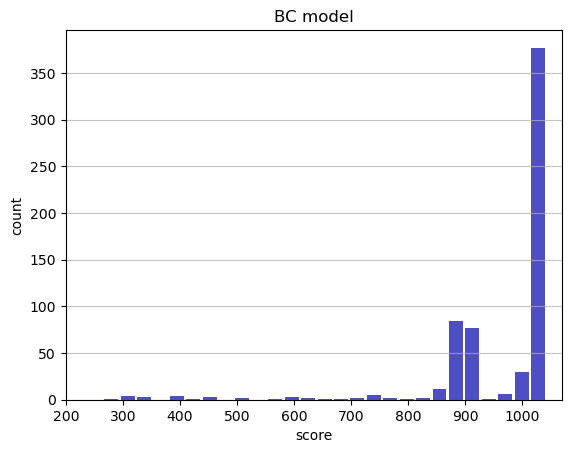

Track generation: 1067..1338 -> 271-tiles track
Epoch: 625
BC	mean: 959.70	variance: 127.21


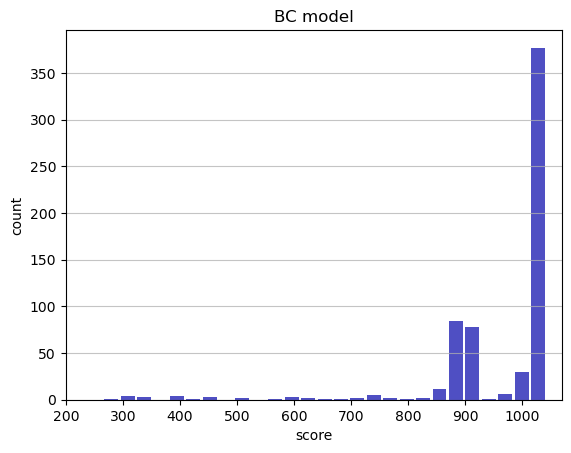

Track generation: 1130..1415 -> 285-tiles track
Epoch: 626
BC	mean: 959.81	variance: 127.14


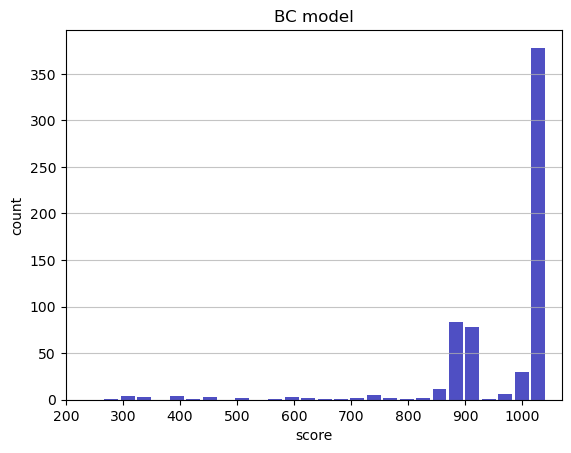

Track generation: 1220..1529 -> 309-tiles track
Epoch: 627
BC	mean: 959.72	variance: 127.05


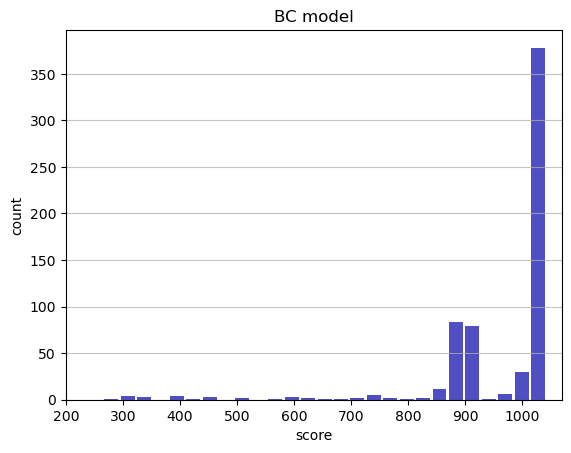

Track generation: 1226..1537 -> 311-tiles track
Epoch: 628
BC	mean: 959.82	variance: 126.97


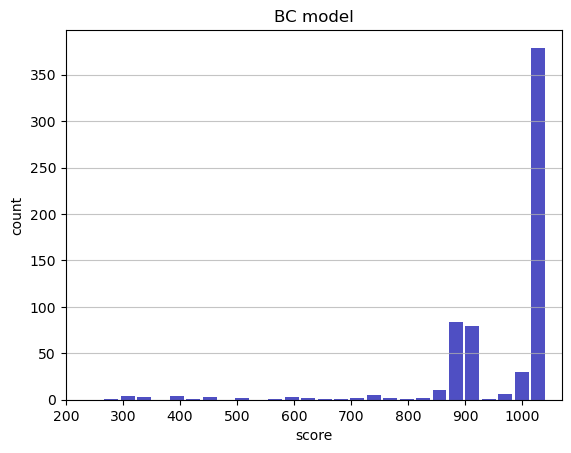

Track generation: 1020..1284 -> 264-tiles track
Epoch: 629
BC	mean: 959.94	variance: 126.91


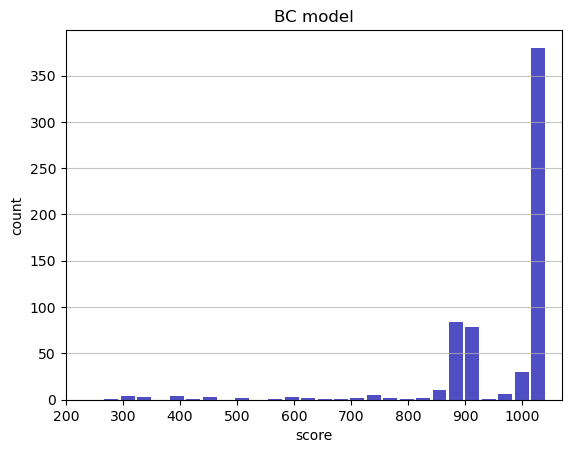

Track generation: 1164..1459 -> 295-tiles track
Epoch: 630
BC	mean: 960.05	variance: 126.84


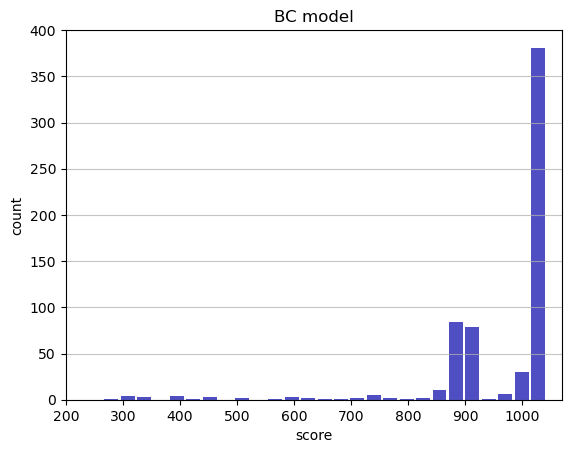

Track generation: 1203..1508 -> 305-tiles track
Epoch: 631
BC	mean: 960.15	variance: 126.76


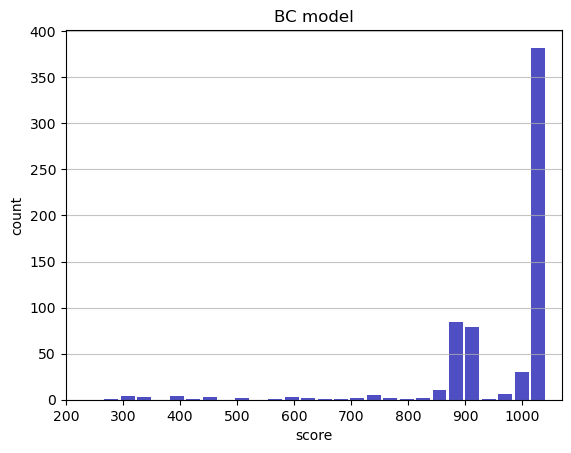

Track generation: 996..1254 -> 258-tiles track
Epoch: 632
BC	mean: 960.26	variance: 126.69


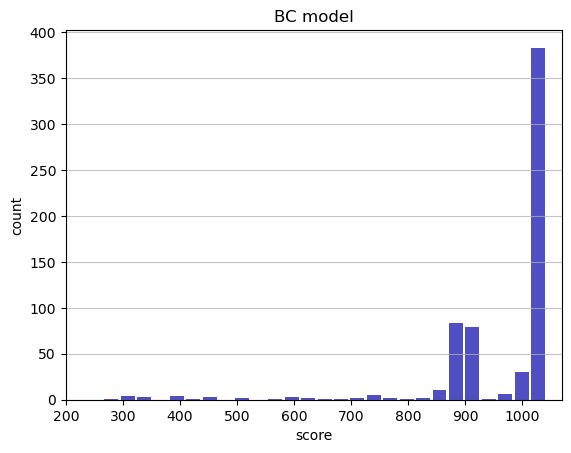

Track generation: 1229..1541 -> 312-tiles track
Epoch: 633
BC	mean: 960.35	variance: 126.61


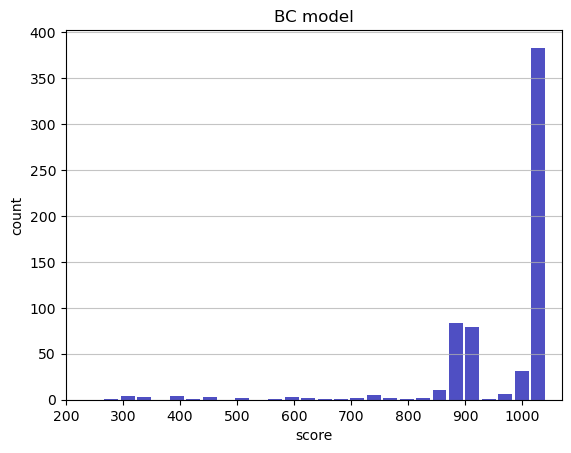

Track generation: 1213..1520 -> 307-tiles track
Epoch: 634
BC	mean: 960.24	variance: 126.54


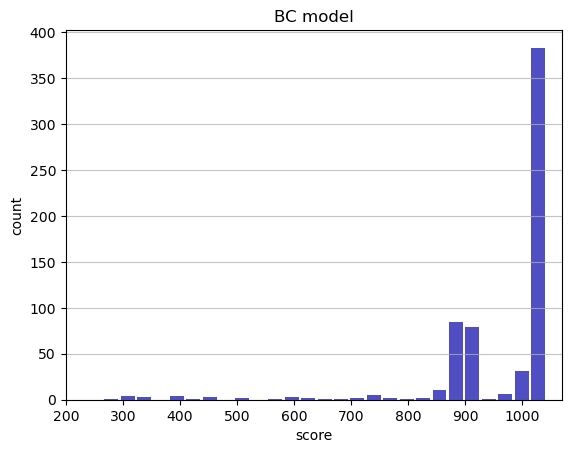

Track generation: 1319..1653 -> 334-tiles track
Epoch: 635
BC	mean: 959.40	variance: 128.20


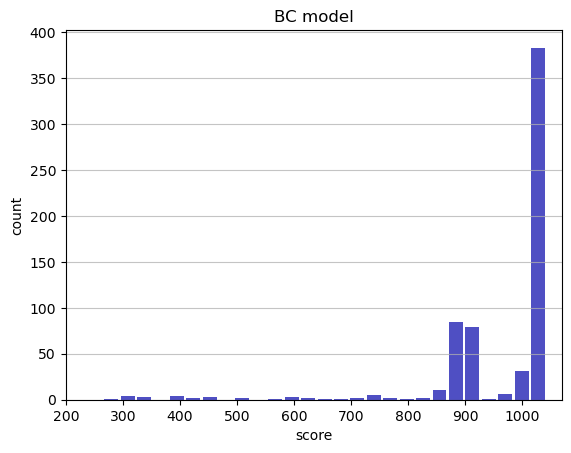

Track generation: 1074..1355 -> 281-tiles track
Epoch: 636
BC	mean: 959.28	variance: 128.13


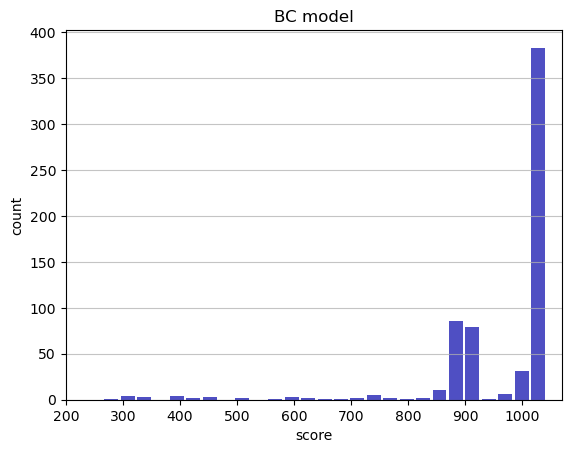

Track generation: 1196..1499 -> 303-tiles track
Epoch: 637
BC	mean: 959.38	variance: 128.06


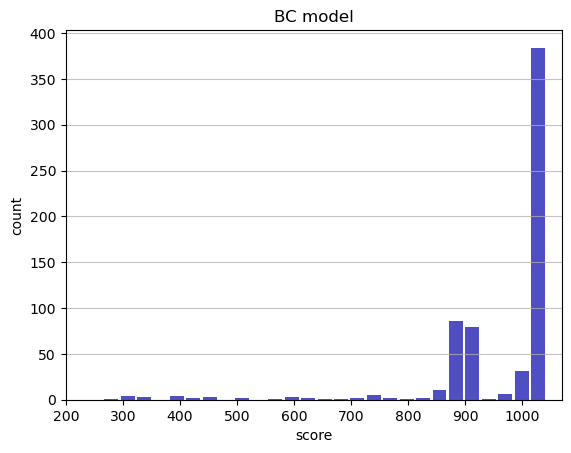

Track generation: 1307..1638 -> 331-tiles track
Epoch: 638
BC	mean: 959.06	variance: 128.20


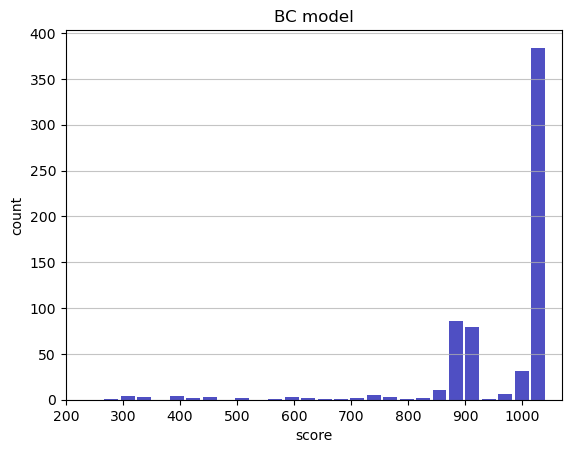

Track generation: 1195..1498 -> 303-tiles track
Epoch: 639
BC	mean: 958.97	variance: 128.12


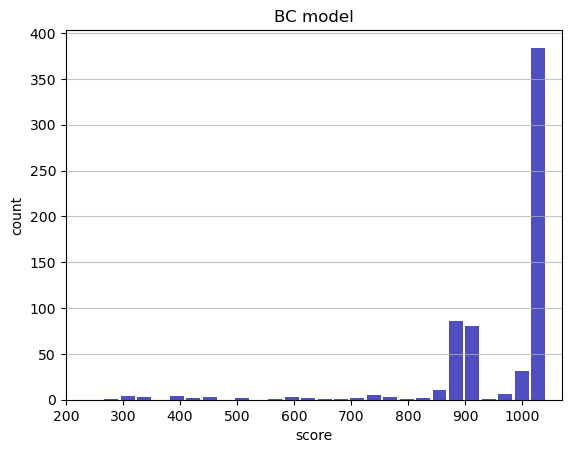

Track generation: 1061..1339 -> 278-tiles track
Epoch: 640
BC	mean: 958.90	variance: 128.03


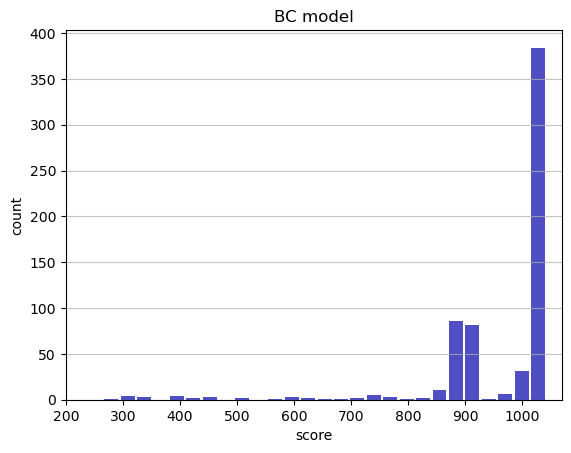

Track generation: 1117..1400 -> 283-tiles track
Epoch: 641
BC	mean: 959.01	variance: 127.97


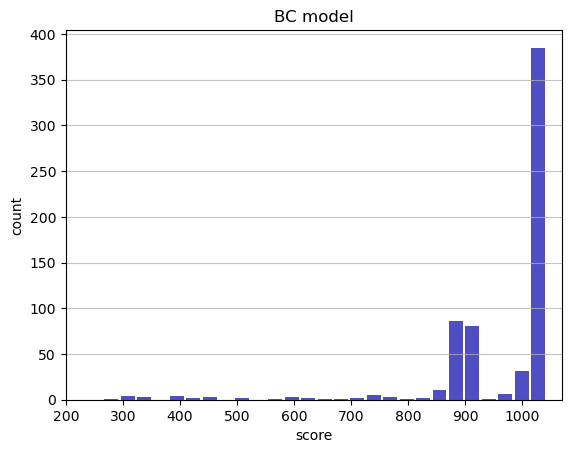

Track generation: 1284..1609 -> 325-tiles track
Epoch: 642
BC	mean: 958.98	variance: 127.87


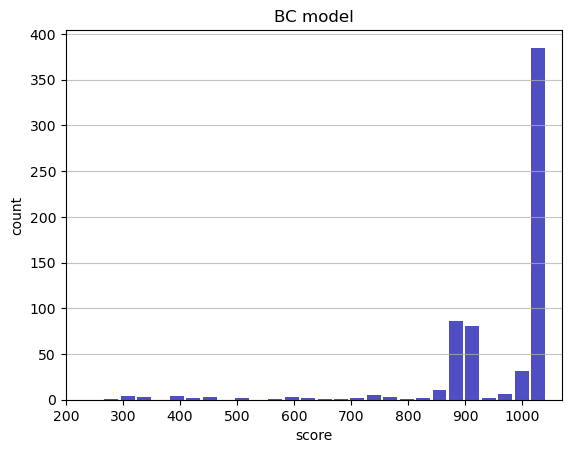

Track generation: 1022..1292 -> 270-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 975..1231 -> 256-tiles track
Epoch: 643
BC	mean: 959.09	variance: 127.80


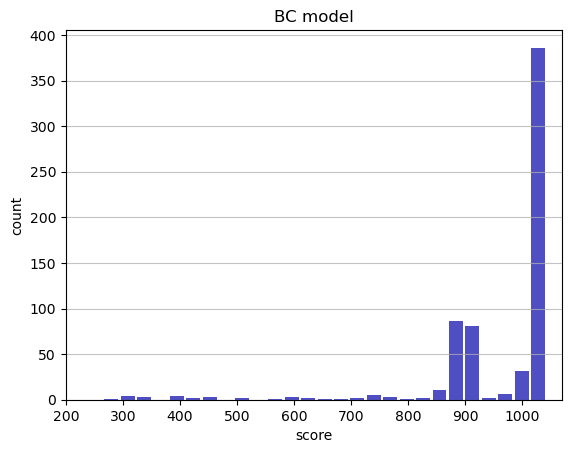

Track generation: 1135..1423 -> 288-tiles track
Epoch: 644
BC	mean: 959.21	variance: 127.73


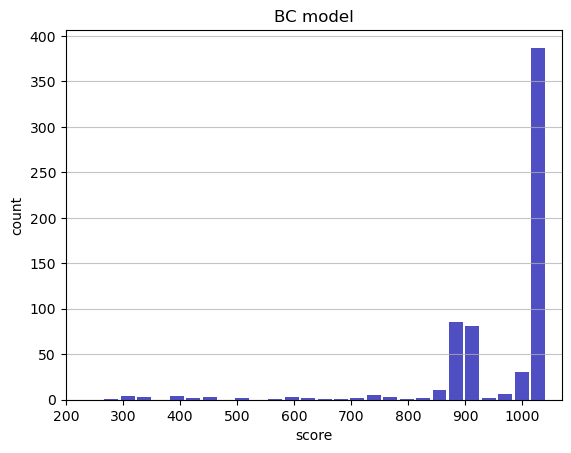

Track generation: 1116..1399 -> 283-tiles track
Epoch: 645
BC	mean: 959.11	variance: 127.66


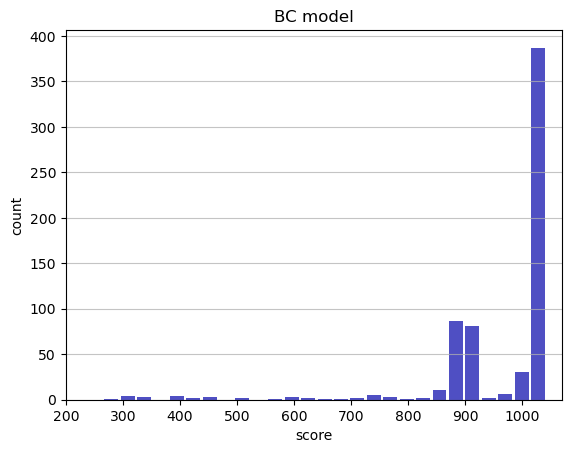

Track generation: 1131..1418 -> 287-tiles track
Epoch: 646
BC	mean: 958.80	variance: 127.80


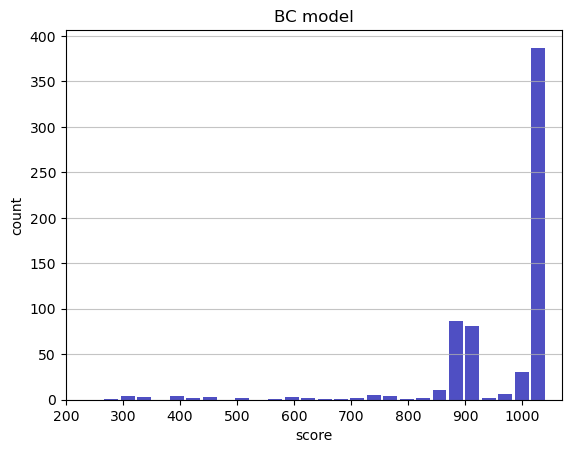

Track generation: 1015..1273 -> 258-tiles track
Epoch: 647
BC	mean: 958.92	variance: 127.74


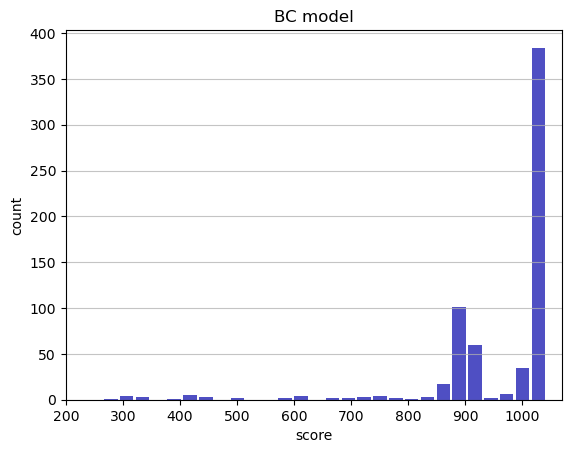

Track generation: 1109..1390 -> 281-tiles track
Epoch: 648
BC	mean: 959.04	variance: 127.67


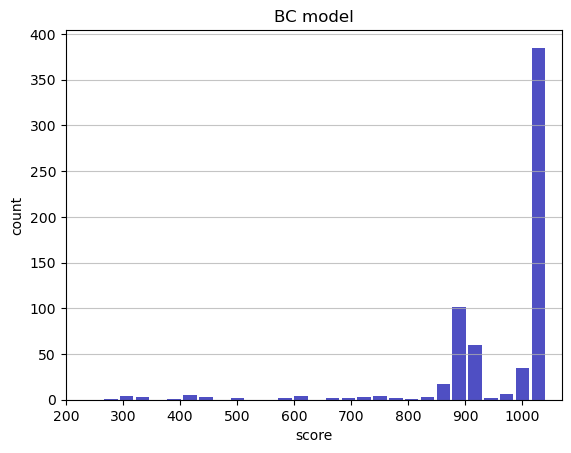

Track generation: 1176..1474 -> 298-tiles track
Epoch: 649
BC	mean: 958.96	variance: 127.59


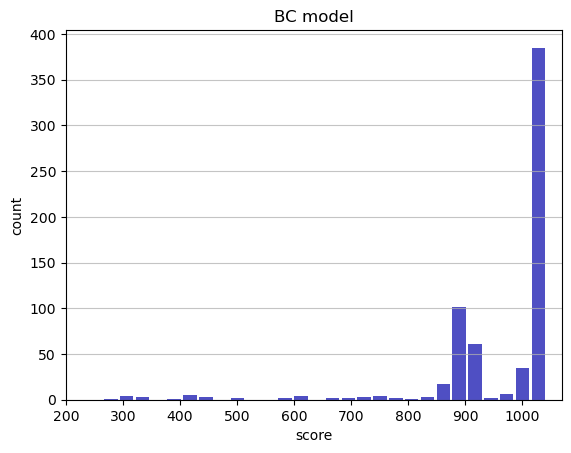

Track generation: 1087..1368 -> 281-tiles track
Epoch: 650
BC	mean: 959.07	variance: 127.52


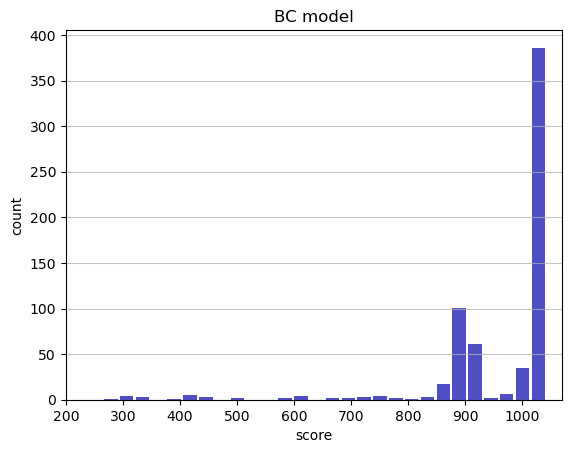

Track generation: 1154..1447 -> 293-tiles track
Epoch: 651
BC	mean: 959.16	variance: 127.44


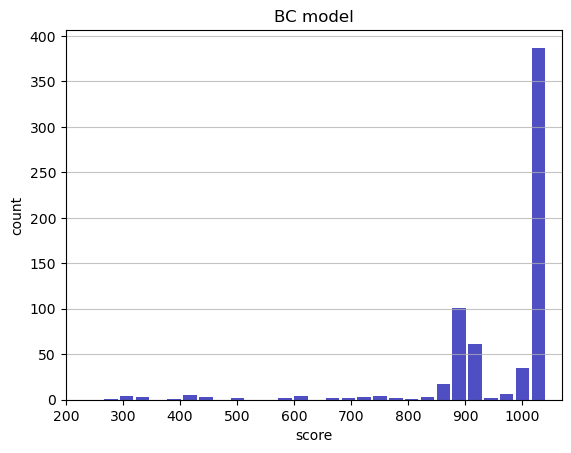

Track generation: 1263..1583 -> 320-tiles track
Epoch: 652
BC	mean: 959.06	variance: 127.37


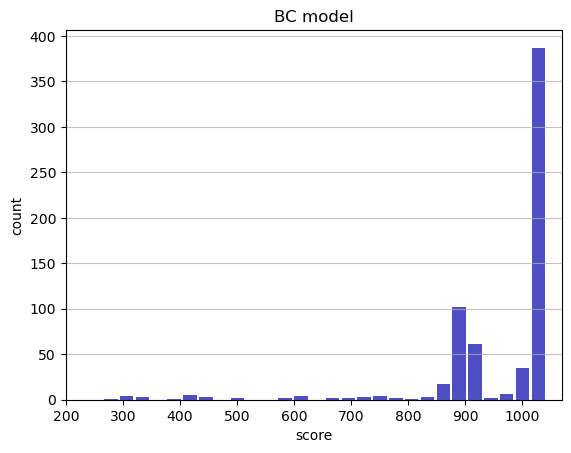

Track generation: 1120..1411 -> 291-tiles track
Epoch: 653
BC	mean: 958.98	variance: 127.29


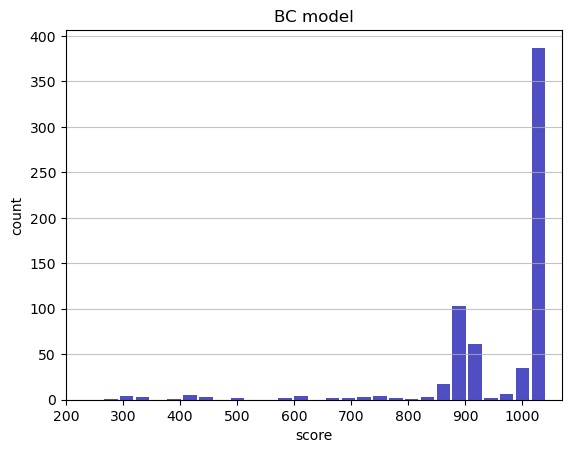

Track generation: 1081..1355 -> 274-tiles track
Epoch: 654
BC	mean: 959.09	variance: 127.23


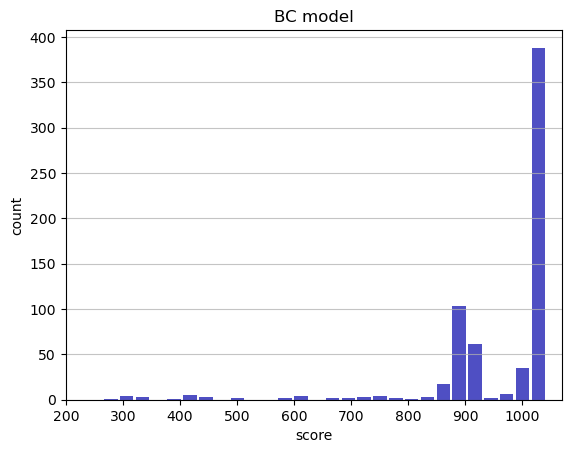

Track generation: 1024..1288 -> 264-tiles track
Epoch: 655
BC	mean: 959.20	variance: 127.16


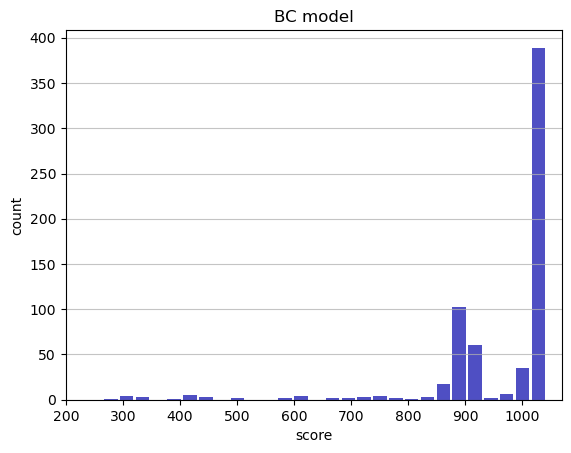

Track generation: 1091..1368 -> 277-tiles track
Epoch: 656
BC	mean: 959.30	variance: 127.09


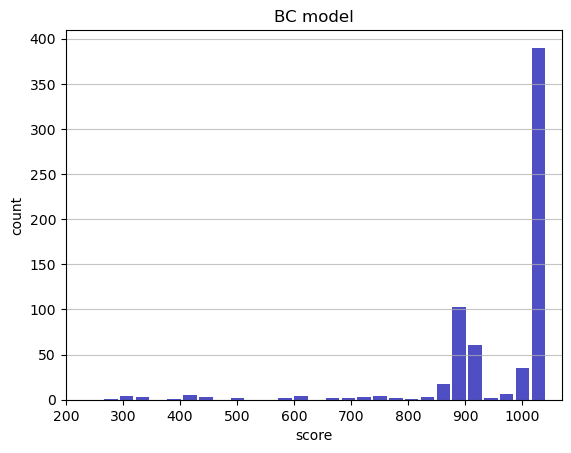

Track generation: 1127..1413 -> 286-tiles track
Epoch: 657
BC	mean: 959.41	variance: 127.02


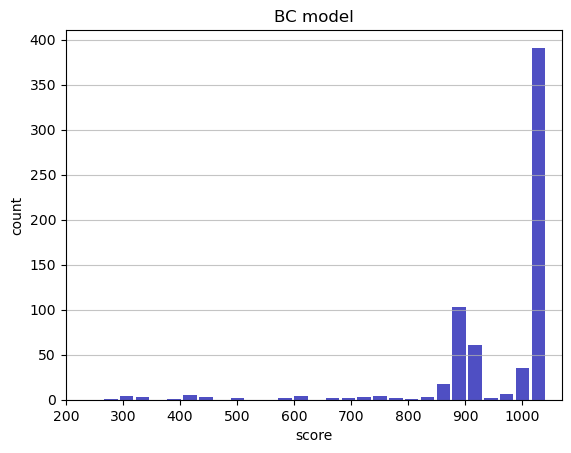

Track generation: 1085..1360 -> 275-tiles track
Epoch: 658
BC	mean: 959.34	variance: 126.94


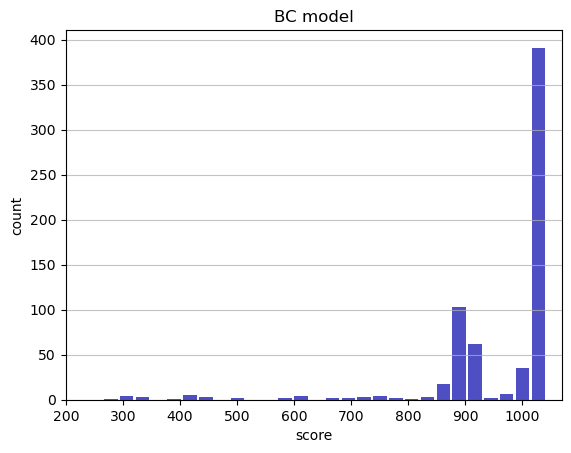

Track generation: 1286..1612 -> 326-tiles track
Epoch: 659
BC	mean: 959.43	variance: 126.86


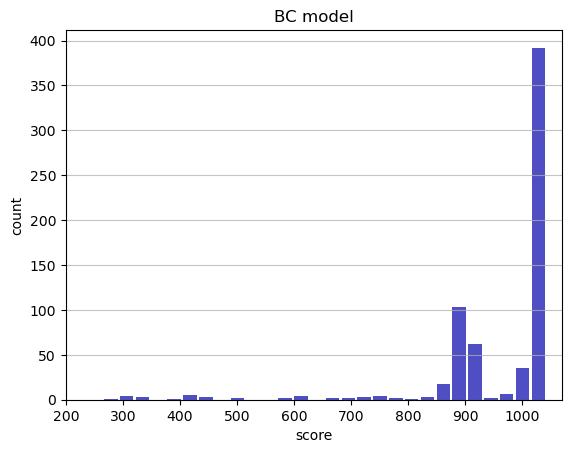

Track generation: 1148..1439 -> 291-tiles track
Epoch: 660
BC	mean: 959.30	variance: 126.80


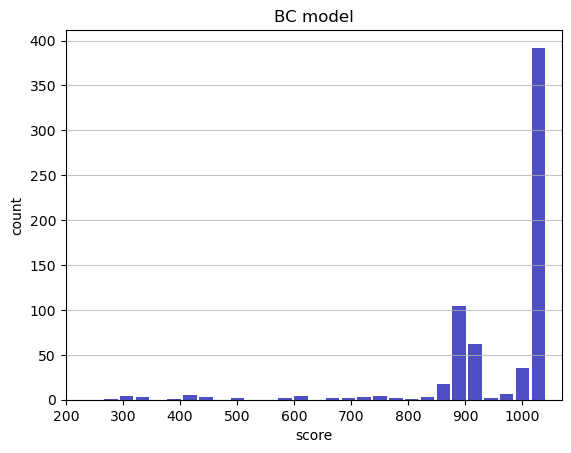

Track generation: 1574..1972 -> 398-tiles track
Epoch: 661
BC	mean: 959.05	variance: 126.88


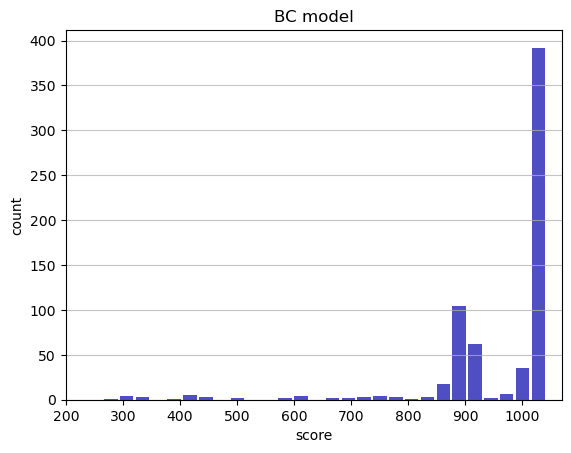

Track generation: 1047..1313 -> 266-tiles track
Epoch: 662
BC	mean: 958.97	variance: 126.80


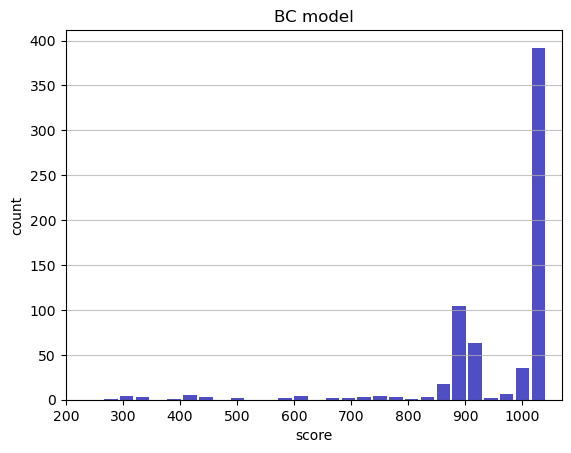

Track generation: 1301..1641 -> 340-tiles track
Epoch: 663
BC	mean: 959.04	variance: 126.72


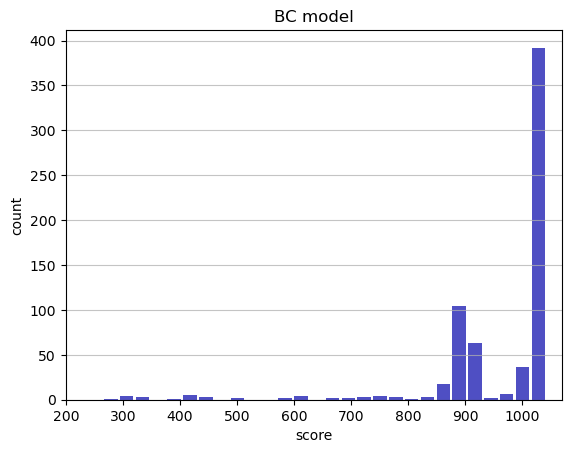

Track generation: 1259..1578 -> 319-tiles track
Epoch: 664
BC	mean: 958.95	variance: 126.64


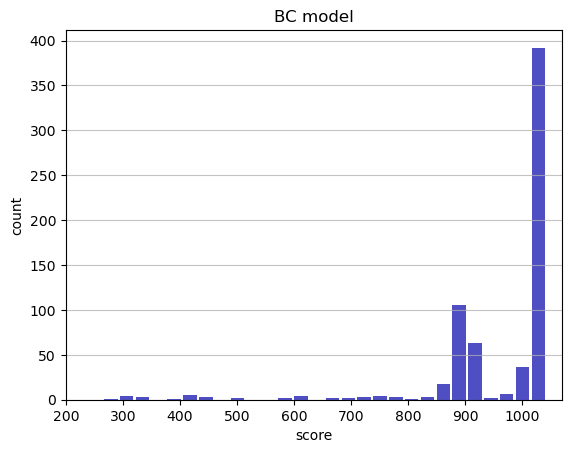

Track generation: 1188..1489 -> 301-tiles track
Epoch: 665
BC	mean: 959.05	variance: 126.57


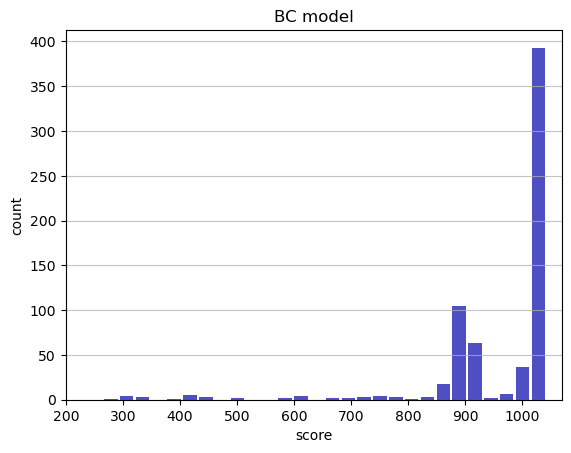

Track generation: 1220..1529 -> 309-tiles track
Epoch: 666
BC	mean: 959.12	variance: 126.49


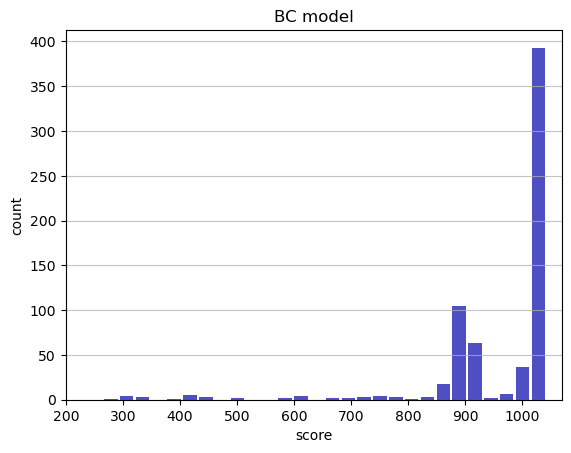

Track generation: 1263..1583 -> 320-tiles track
Epoch: 667
BC	mean: 959.20	variance: 126.42


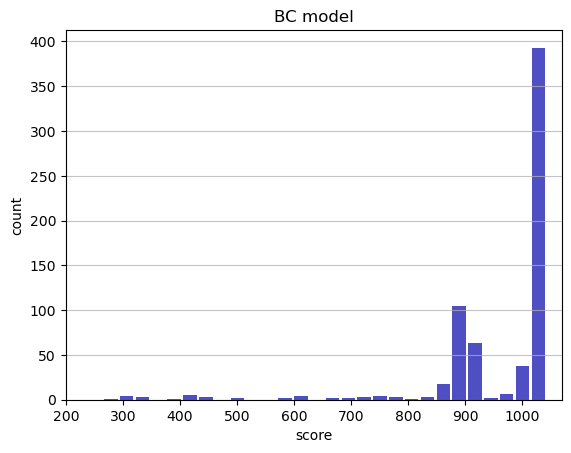

Track generation: 1183..1483 -> 300-tiles track
Epoch: 668
BC	mean: 959.30	variance: 126.35


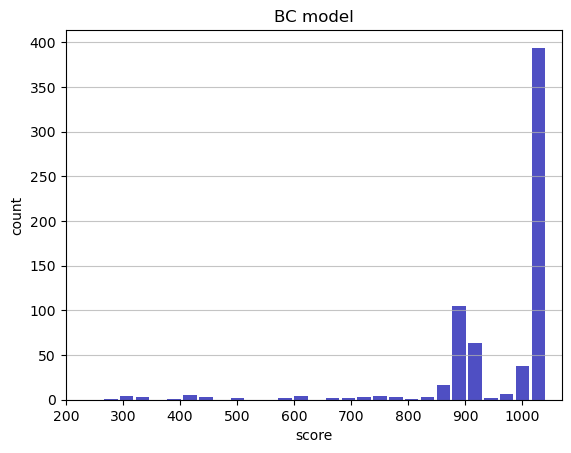

Track generation: 1232..1542 -> 310-tiles track
Epoch: 669
BC	mean: 959.39	variance: 126.27


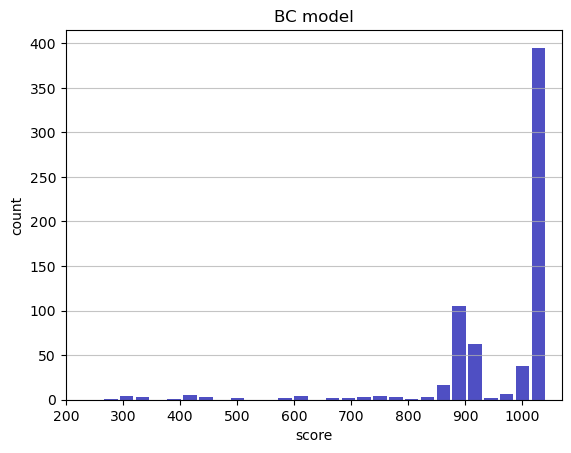

Track generation: 1276..1599 -> 323-tiles track
Epoch: 670
BC	mean: 959.47	variance: 126.20


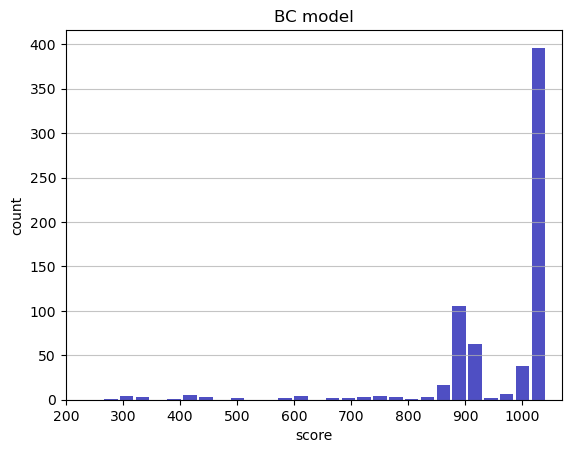

Track generation: 1136..1430 -> 294-tiles track
Epoch: 671
BC	mean: 959.37	variance: 126.13


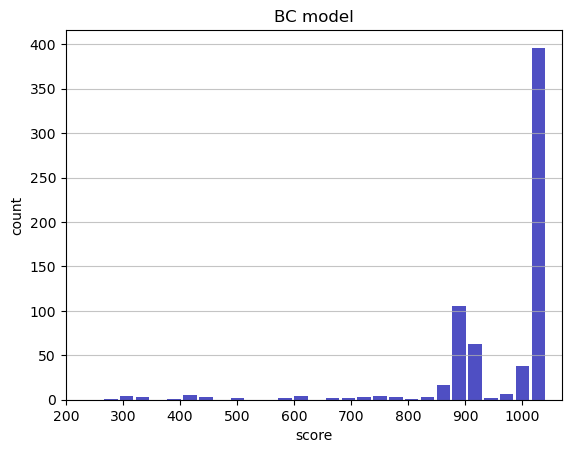

Track generation: 1154..1454 -> 300-tiles track
Epoch: 672
BC	mean: 959.29	variance: 126.06


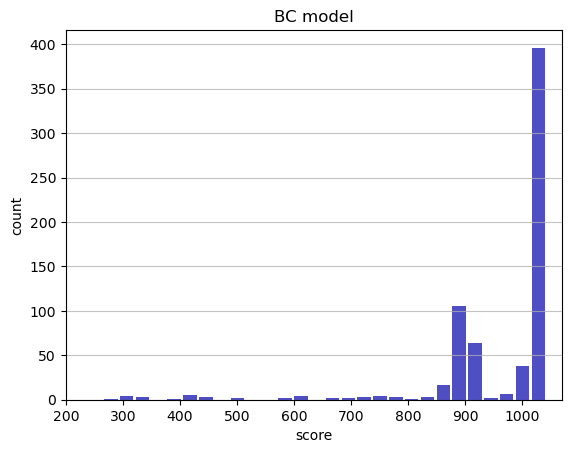

Track generation: 1045..1317 -> 272-tiles track
Epoch: 673
BC	mean: 959.40	variance: 125.99


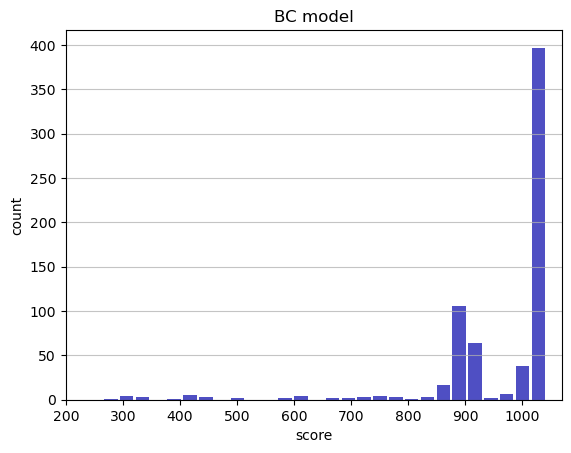

Track generation: 1311..1643 -> 332-tiles track
Epoch: 674
BC	mean: 959.29	variance: 125.93


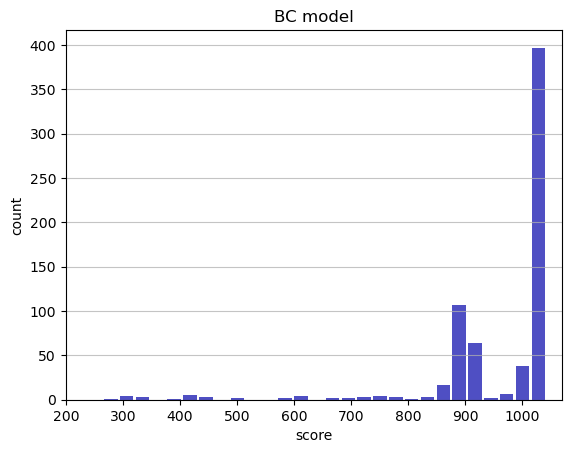

Track generation: 1132..1419 -> 287-tiles track
Epoch: 675
BC	mean: 959.39	variance: 125.87


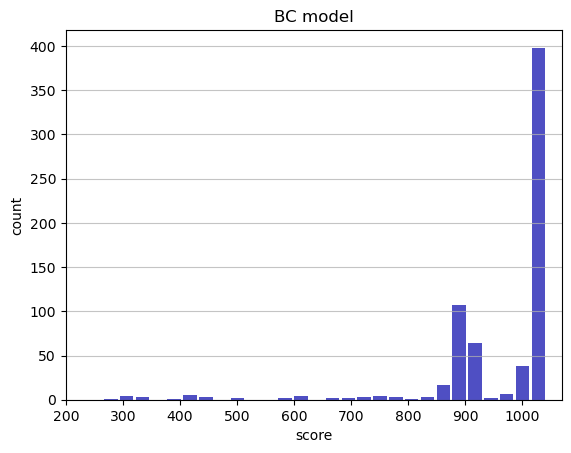

Track generation: 1208..1514 -> 306-tiles track
Epoch: 676
BC	mean: 959.48	variance: 125.79


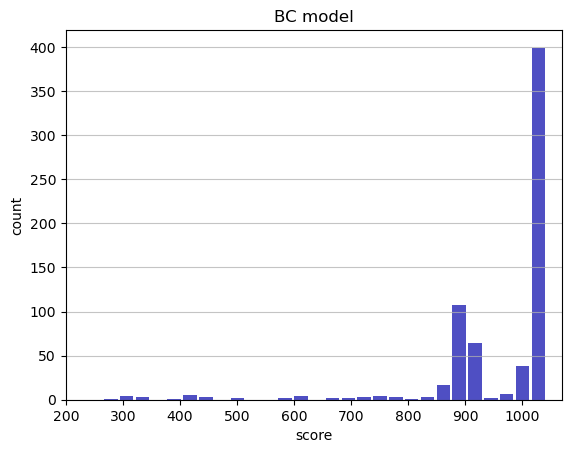

Track generation: 1204..1530 -> 326-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1275..1598 -> 323-tiles track
Epoch: 677
BC	mean: 959.55	variance: 125.71


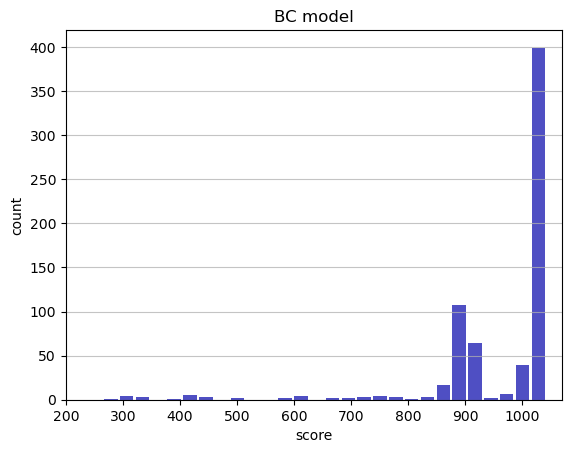

Track generation: 1212..1519 -> 307-tiles track
Epoch: 678
BC	mean: 959.64	variance: 125.64


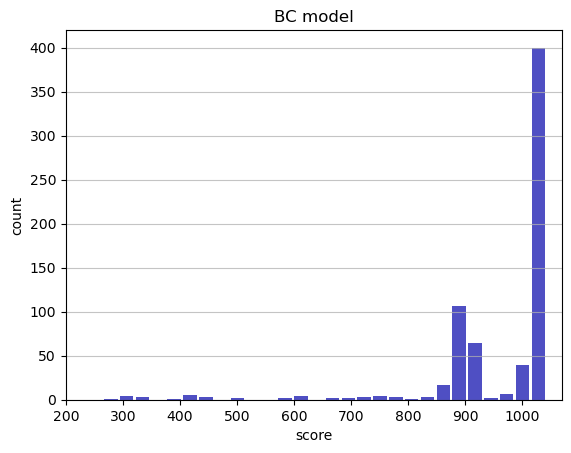

Track generation: 1225..1535 -> 310-tiles track
Epoch: 679
BC	mean: 959.73	variance: 125.57


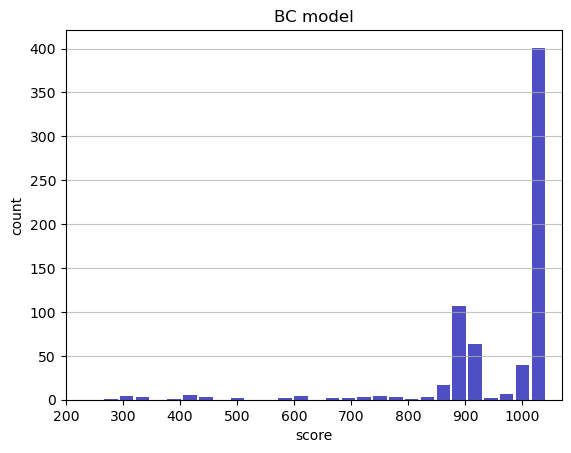

Track generation: 1128..1414 -> 286-tiles track
Epoch: 680
BC	mean: 959.83	variance: 125.51


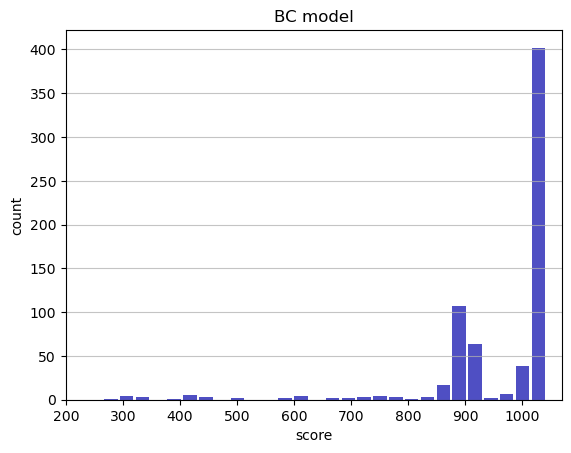

Track generation: 1015..1273 -> 258-tiles track
Epoch: 681
BC	mean: 959.78	variance: 125.43


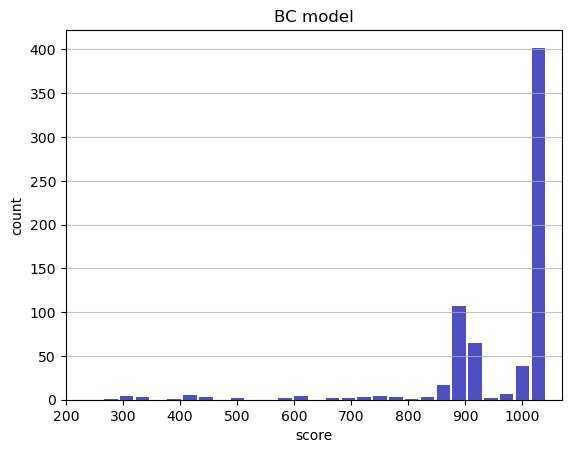

Track generation: 1058..1326 -> 268-tiles track
Epoch: 682
BC	mean: 959.89	variance: 125.37


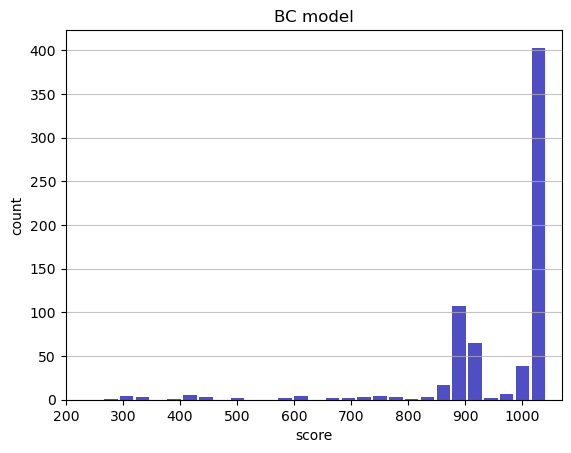

Track generation: 1222..1532 -> 310-tiles track
Epoch: 683
BC	mean: 959.99	variance: 125.30


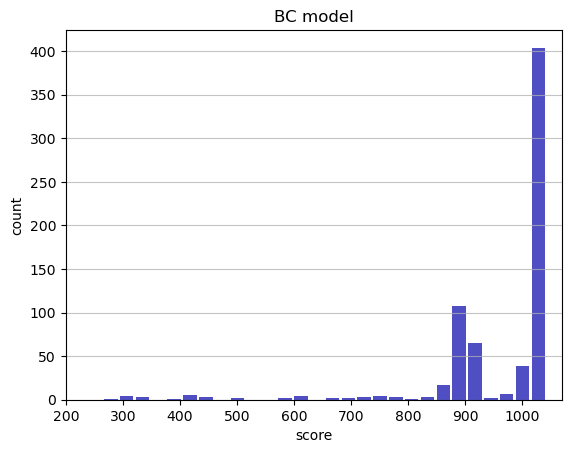

Track generation: 1094..1379 -> 285-tiles track
Epoch: 684
BC	mean: 959.85	variance: 125.26


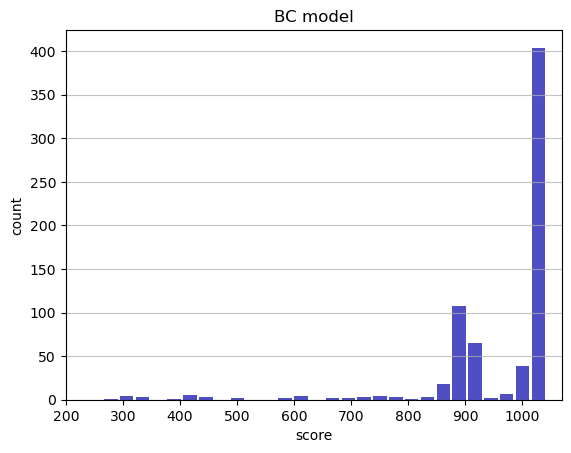

Track generation: 1038..1302 -> 264-tiles track
Epoch: 685
BC	mean: 959.77	variance: 125.19


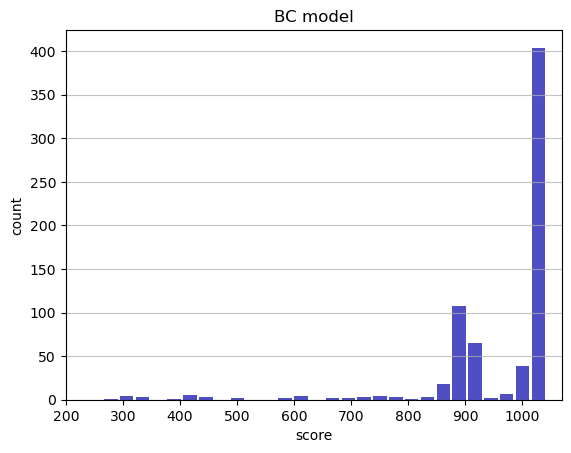

Track generation: 1047..1313 -> 266-tiles track
Epoch: 686
BC	mean: 959.88	variance: 125.13


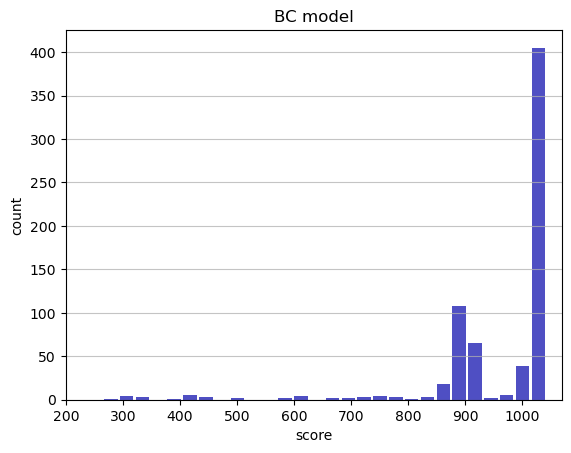

Track generation: 1081..1355 -> 274-tiles track
Epoch: 687
BC	mean: 959.97	variance: 125.06


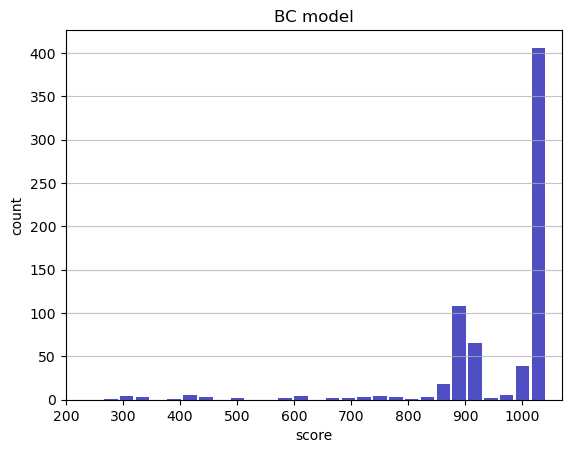

Track generation: 1102..1382 -> 280-tiles track
Epoch: 688
BC	mean: 960.08	variance: 125.00


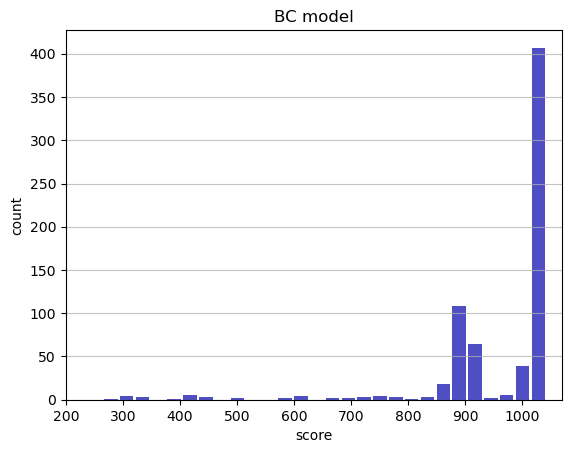

Track generation: 1195..1498 -> 303-tiles track
Epoch: 689
BC	mean: 959.99	variance: 124.93


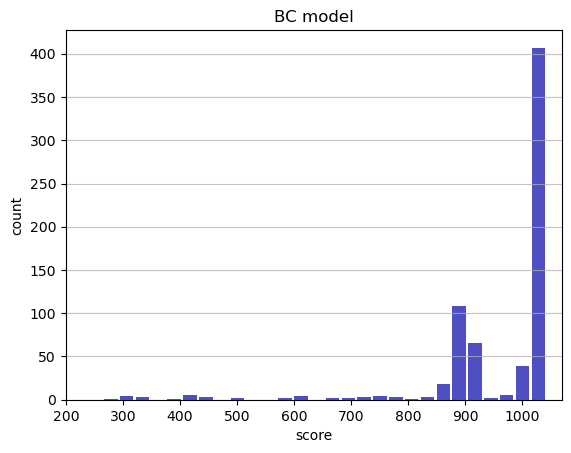

Track generation: 1095..1373 -> 278-tiles track
Epoch: 690
BC	mean: 959.52	variance: 125.45


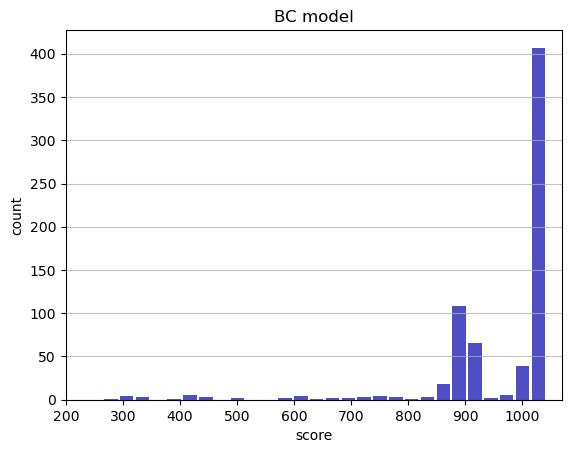

Track generation: 1123..1414 -> 291-tiles track
Epoch: 691
BC	mean: 959.62	variance: 125.38


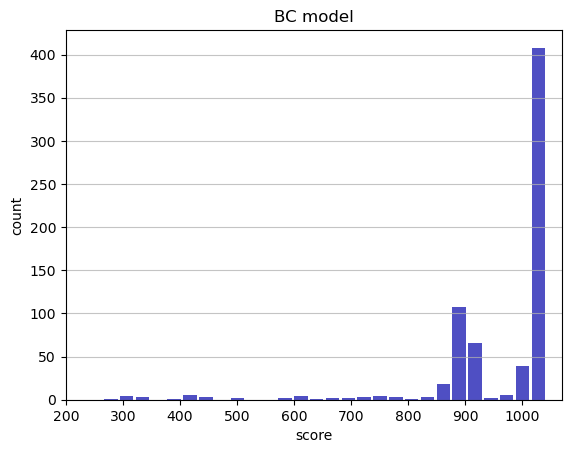

Track generation: 1084..1359 -> 275-tiles track
Epoch: 692
BC	mean: 959.72	variance: 125.32


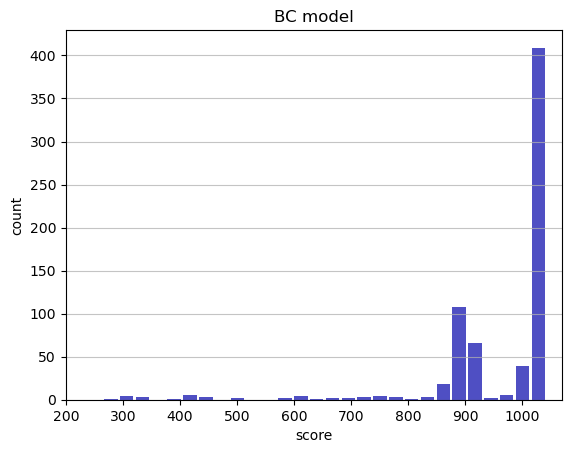

Track generation: 1108..1388 -> 280-tiles track
Epoch: 693
BC	mean: 959.82	variance: 125.26


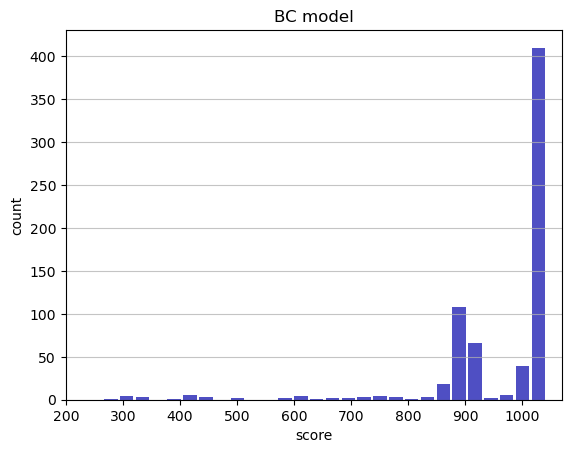

Track generation: 1254..1571 -> 317-tiles track
Epoch: 694
BC	mean: 959.73	variance: 125.19


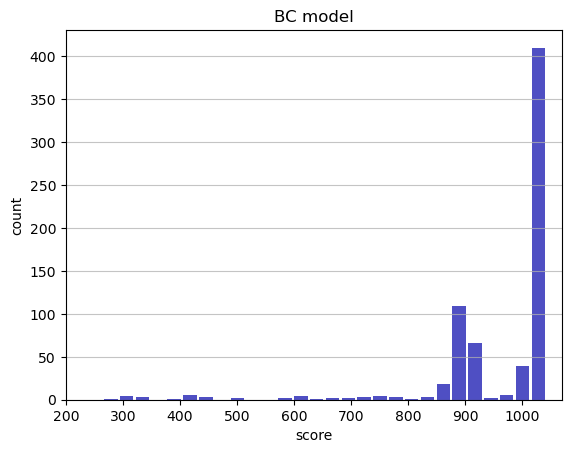

Track generation: 1098..1386 -> 288-tiles track
Epoch: 695
BC	mean: 959.59	variance: 125.16


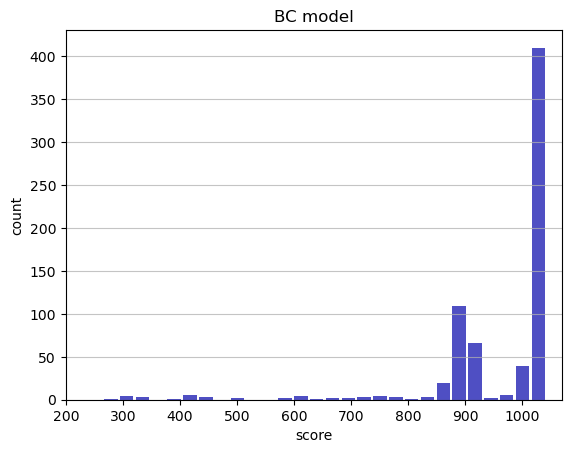

Track generation: 1107..1388 -> 281-tiles track
Epoch: 696
BC	mean: 959.52	variance: 125.08


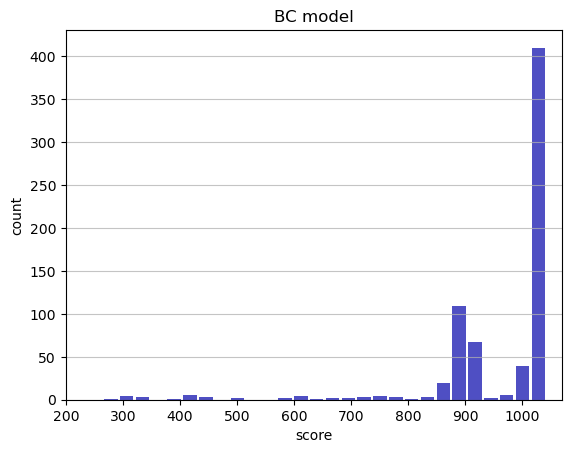

Track generation: 1202..1507 -> 305-tiles track
Epoch: 697
BC	mean: 959.62	variance: 125.02


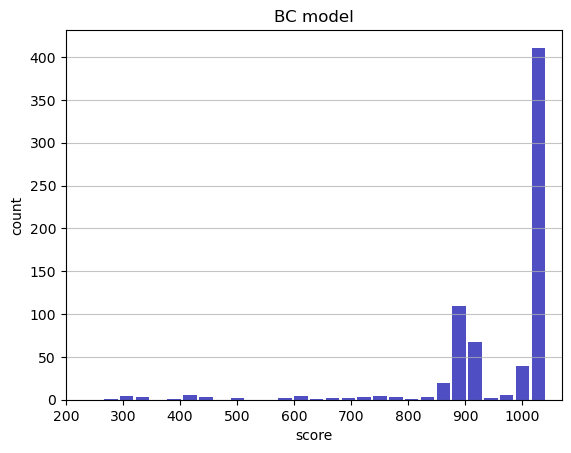

Track generation: 1163..1458 -> 295-tiles track
Epoch: 698
BC	mean: 959.70	variance: 124.95


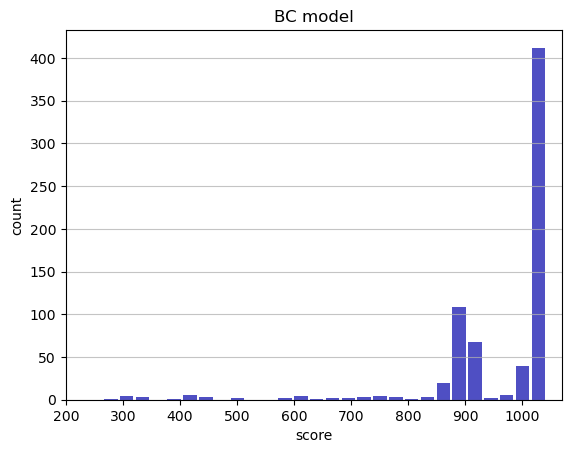

Track generation: 951..1203 -> 252-tiles track
Epoch: 699
BC	mean: 959.16	variance: 125.66


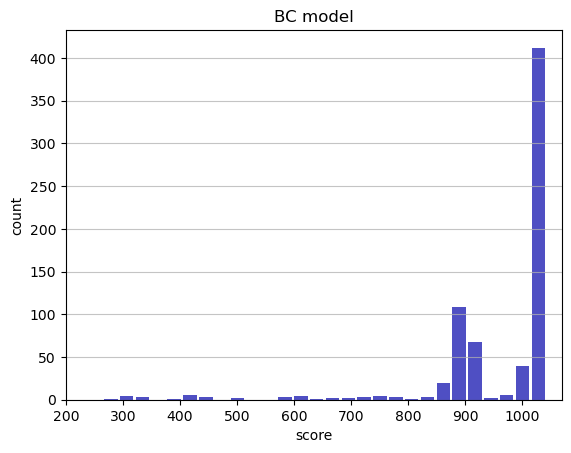

Track generation: 1155..1448 -> 293-tiles track
Epoch: 700
BC	mean: 959.27	variance: 125.61


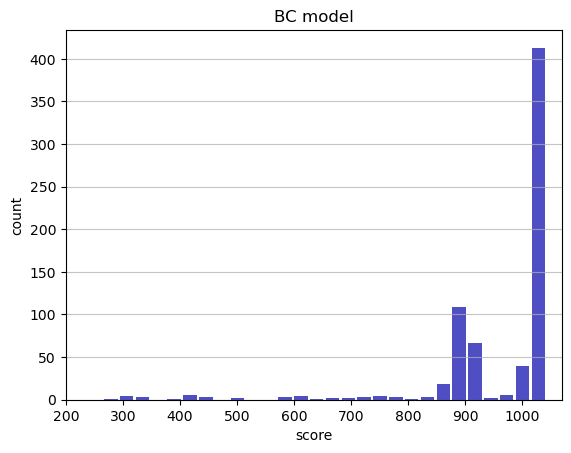

Track generation: 1080..1359 -> 279-tiles track
Epoch: 701
BC	mean: 959.37	variance: 125.54


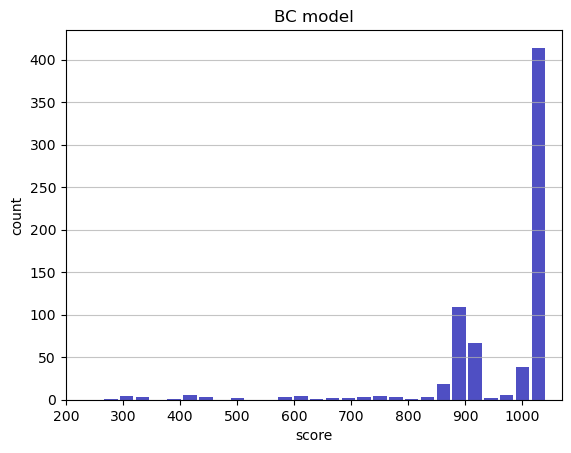

Track generation: 1159..1453 -> 294-tiles track
Epoch: 702
BC	mean: 959.02	variance: 125.79


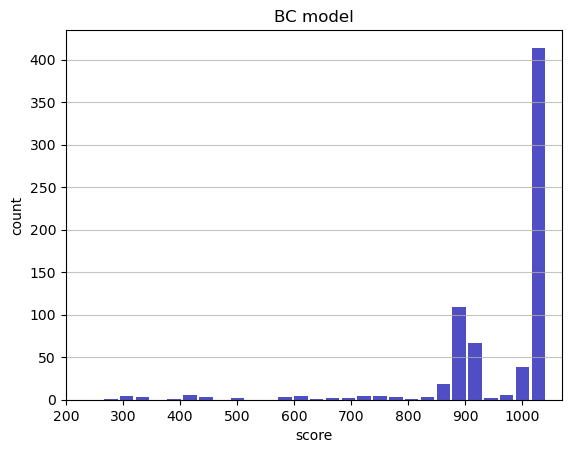

Track generation: 1023..1284 -> 261-tiles track
Epoch: 703
BC	mean: 959.12	variance: 125.73


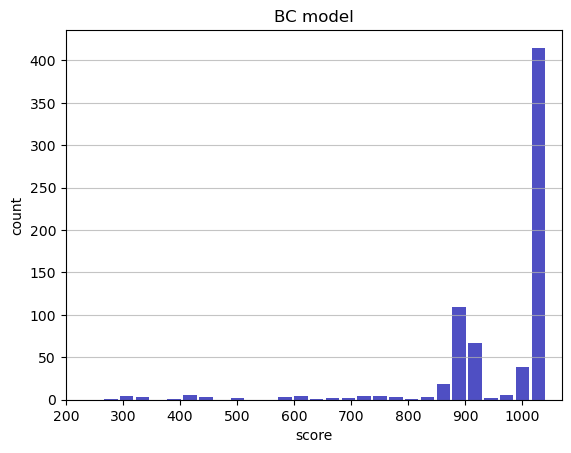

Track generation: 1020..1279 -> 259-tiles track
Epoch: 704
BC	mean: 959.06	variance: 125.65


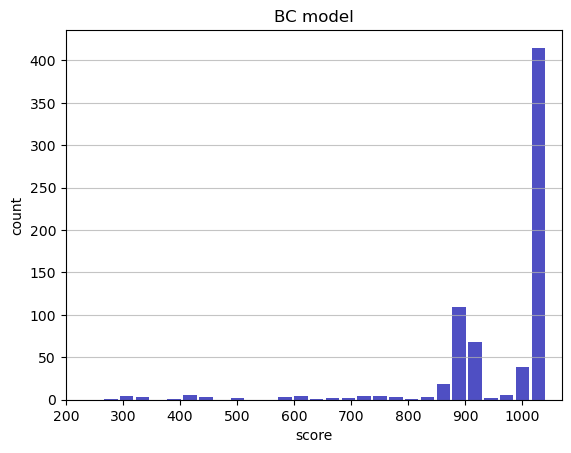

Track generation: 1158..1451 -> 293-tiles track
Epoch: 705
BC	mean: 959.16	variance: 125.58


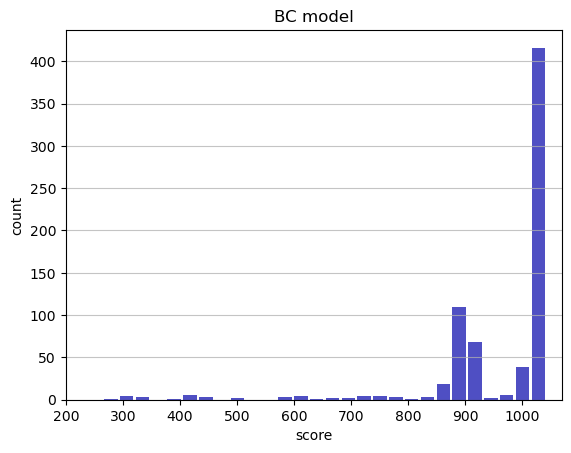

Track generation: 1324..1659 -> 335-tiles track
Epoch: 706
BC	mean: 959.23	variance: 125.51


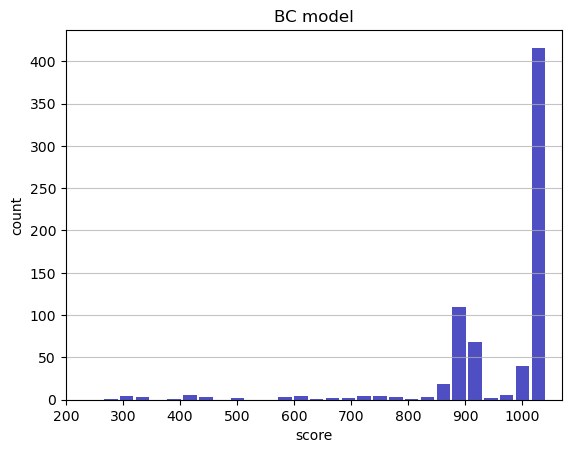

Track generation: 1166..1462 -> 296-tiles track
Epoch: 707
BC	mean: 959.14	variance: 125.44


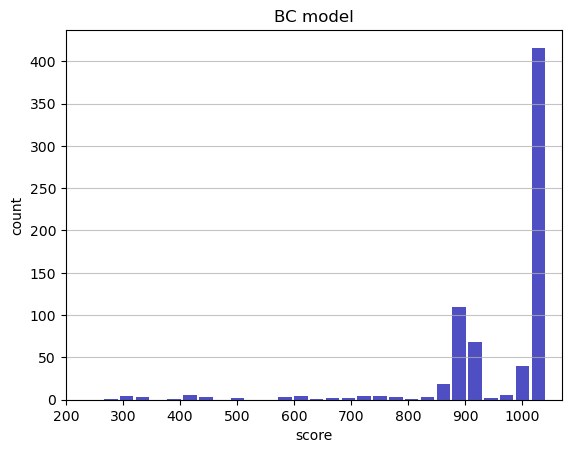

Track generation: 1205..1510 -> 305-tiles track
Epoch: 708
BC	mean: 959.22	variance: 125.38


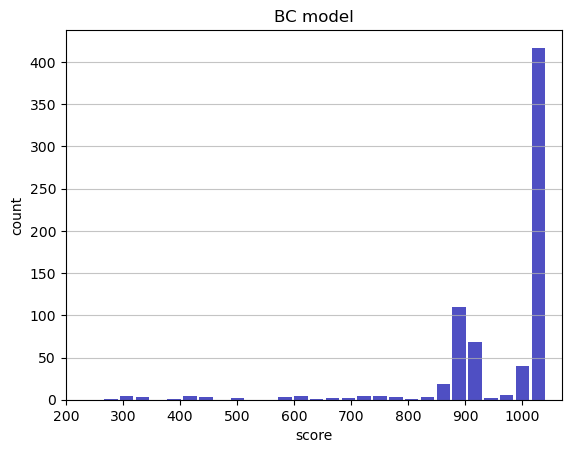

Track generation: 1217..1525 -> 308-tiles track
Epoch: 709
BC	mean: 959.31	variance: 125.31


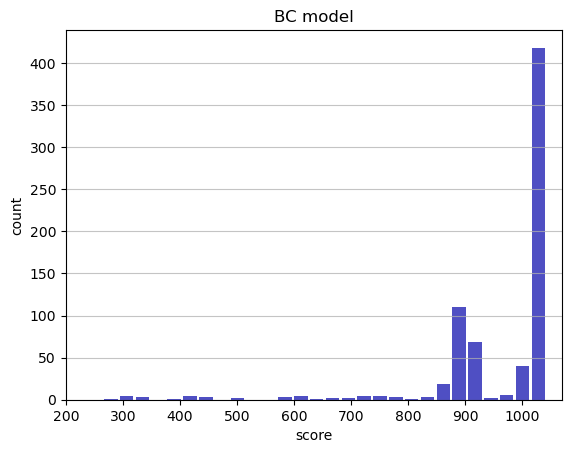

Track generation: 1225..1535 -> 310-tiles track
Epoch: 710
BC	mean: 958.60	variance: 126.65


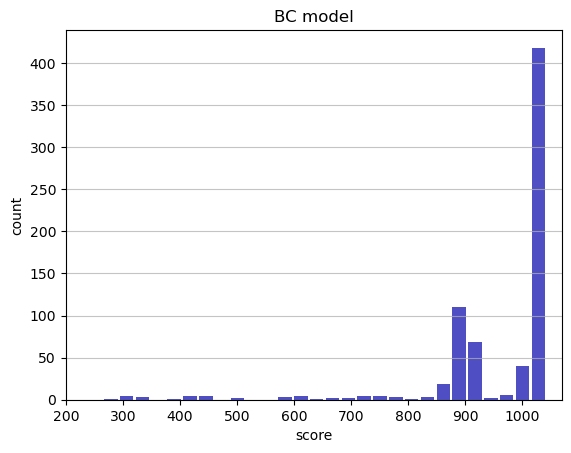

Track generation: 1348..1689 -> 341-tiles track
Epoch: 711
BC	mean: 958.66	variance: 126.57


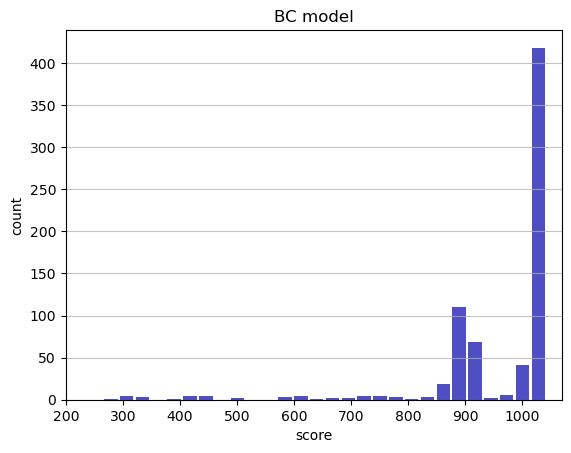

Track generation: 1174..1472 -> 298-tiles track
Epoch: 712
BC	mean: 958.76	variance: 126.51


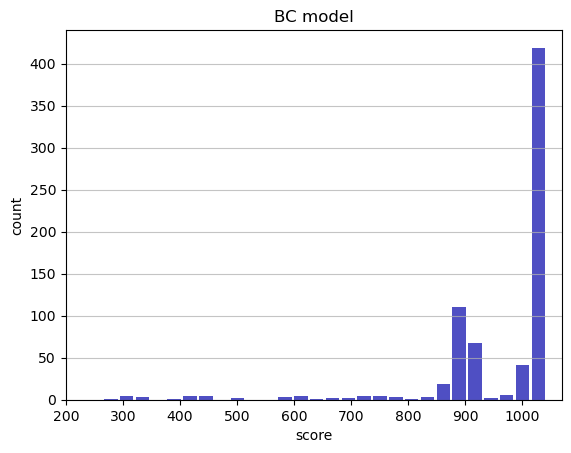

Track generation: 1140..1436 -> 296-tiles track
Epoch: 713
BC	mean: 958.69	variance: 126.44


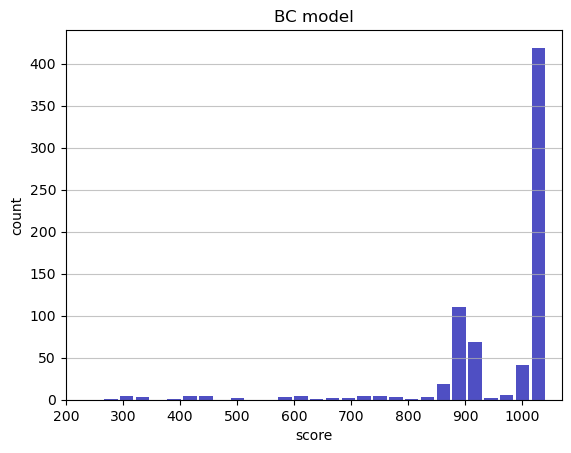

Track generation: 980..1235 -> 255-tiles track
Epoch: 714
BC	mean: 958.80	variance: 126.38


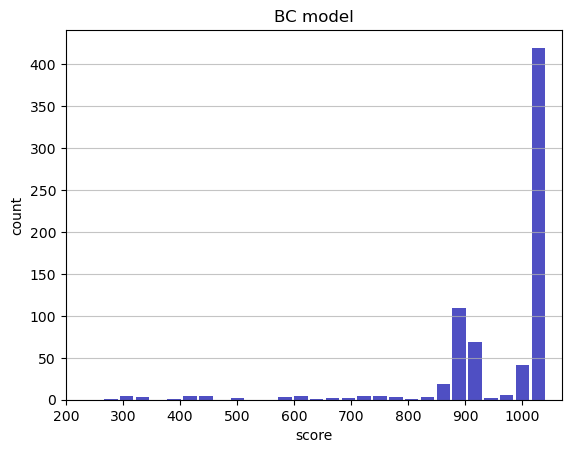

Track generation: 1121..1409 -> 288-tiles track
Epoch: 715
BC	mean: 958.70	variance: 126.32


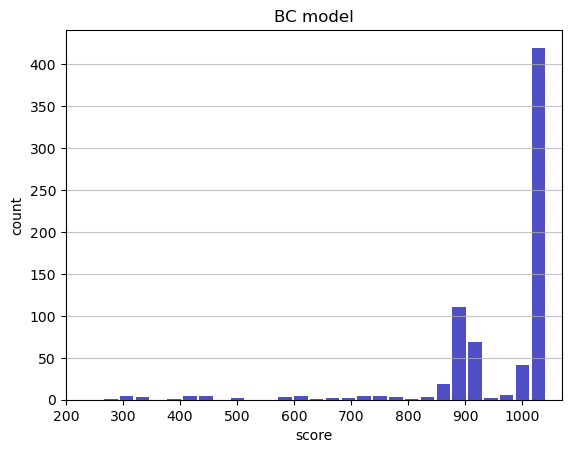

Track generation: 1255..1574 -> 319-tiles track
Epoch: 716
BC	mean: 958.78	variance: 126.25


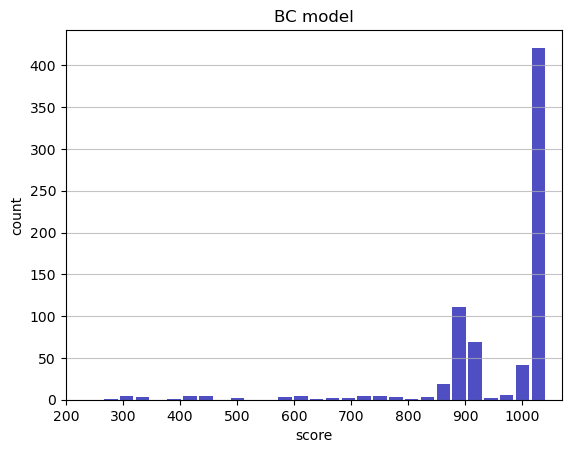

Track generation: 1112..1394 -> 282-tiles track
Epoch: 717
BC	mean: 958.71	variance: 126.18


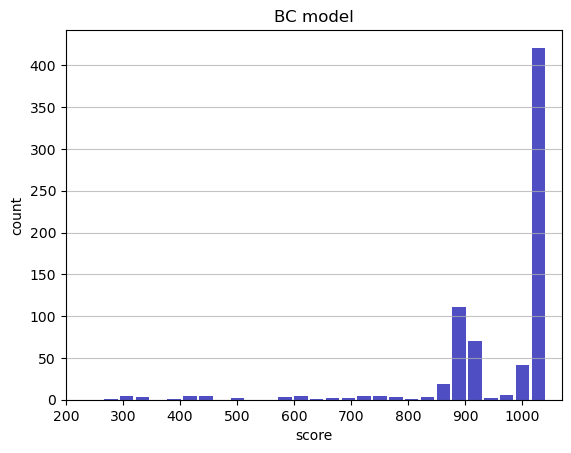

Track generation: 1166..1464 -> 298-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1188..1489 -> 301-tiles track
Epoch: 718
BC	mean: 958.79	variance: 126.11


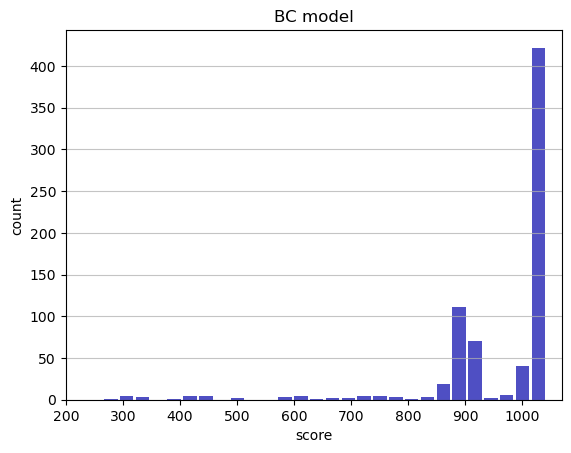

Track generation: 1295..1623 -> 328-tiles track
Epoch: 719
BC	mean: 958.87	variance: 126.04


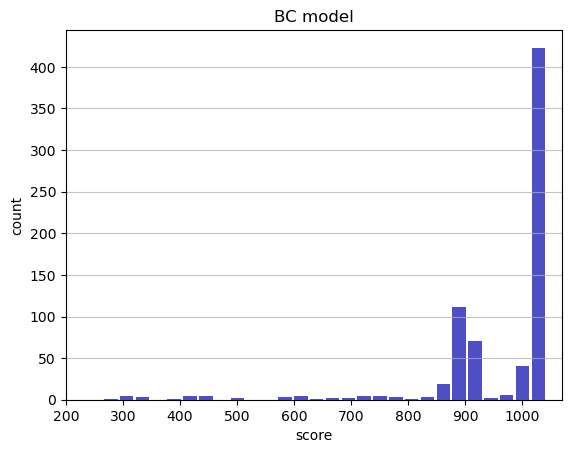

Track generation: 1248..1564 -> 316-tiles track
Epoch: 720
BC	mean: 958.96	variance: 125.98


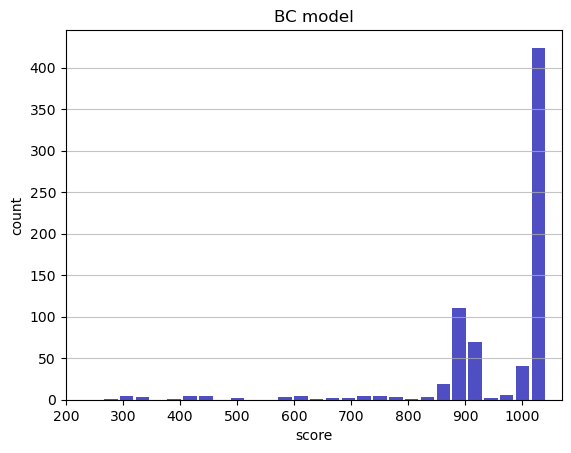

Track generation: 1175..1473 -> 298-tiles track
Epoch: 721
BC	mean: 959.05	variance: 125.91


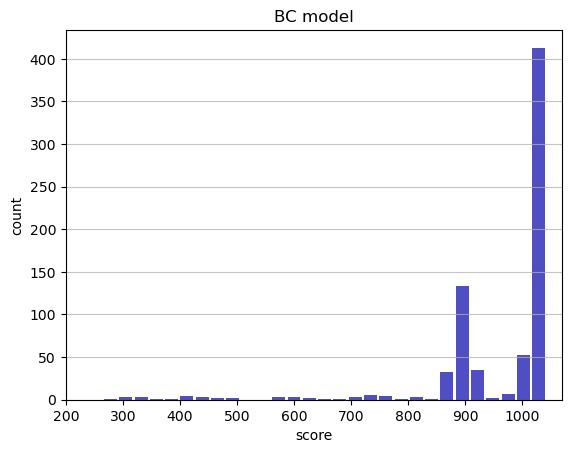

Track generation: 1145..1435 -> 290-tiles track
Epoch: 722
BC	mean: 959.13	variance: 125.85


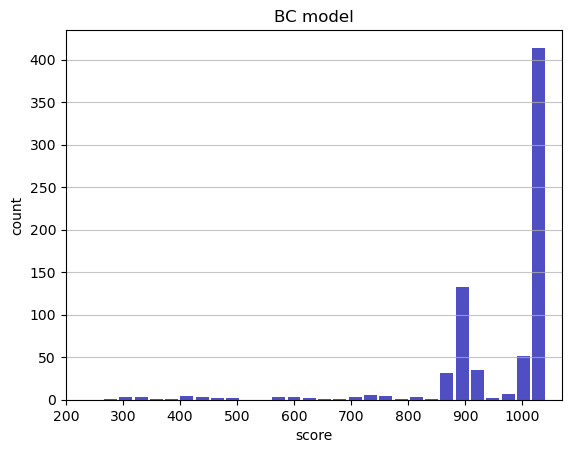

Track generation: 1077..1350 -> 273-tiles track
Epoch: 723
BC	mean: 959.05	variance: 125.78


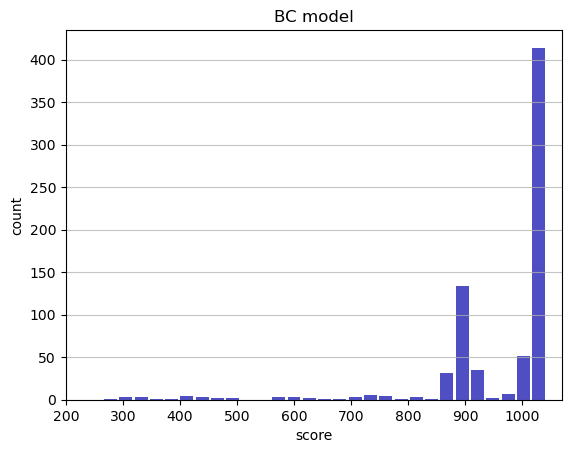

Track generation: 1271..1593 -> 322-tiles track
Epoch: 724
BC	mean: 958.96	variance: 125.71


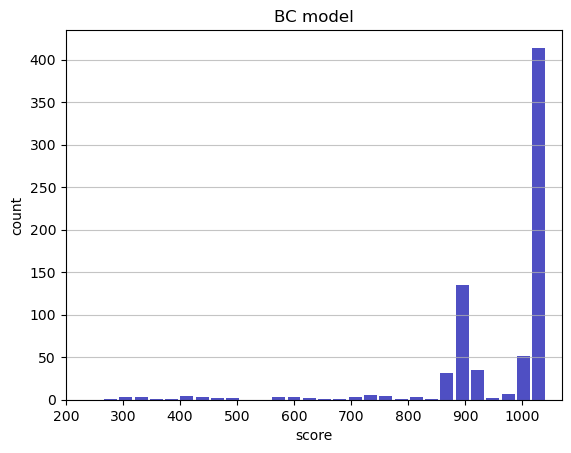

Track generation: 1111..1393 -> 282-tiles track
Epoch: 725
BC	mean: 958.90	variance: 125.64


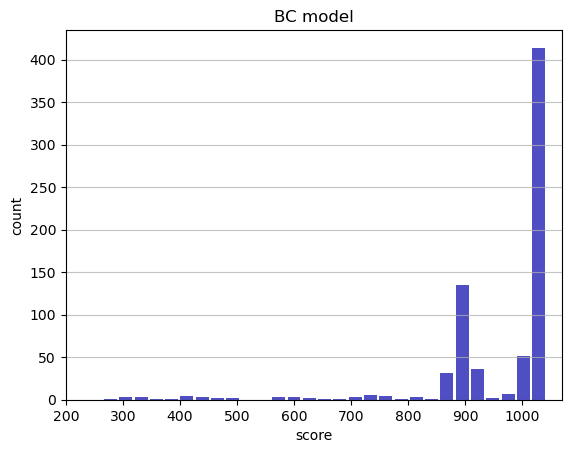

Track generation: 1222..1532 -> 310-tiles track
Epoch: 726
BC	mean: 958.99	variance: 125.57


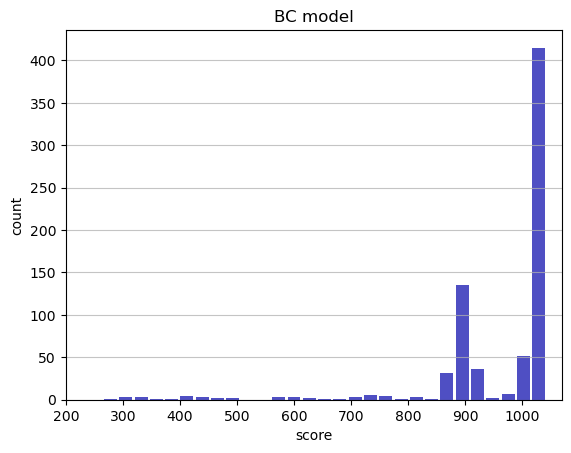

Track generation: 1177..1483 -> 306-tiles track
Epoch: 727
BC	mean: 958.17	variance: 127.41


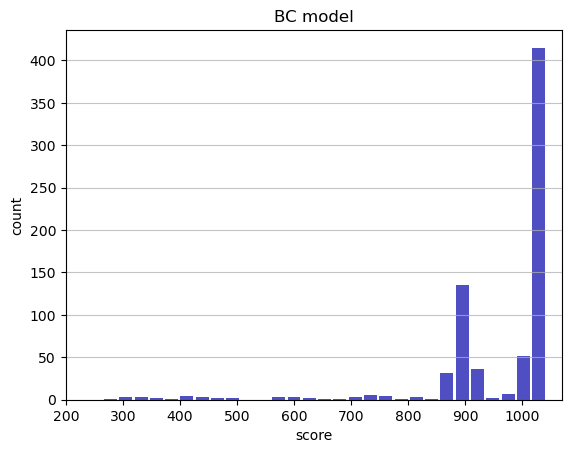

Track generation: 1215..1523 -> 308-tiles track
Epoch: 728
BC	mean: 958.25	variance: 127.34


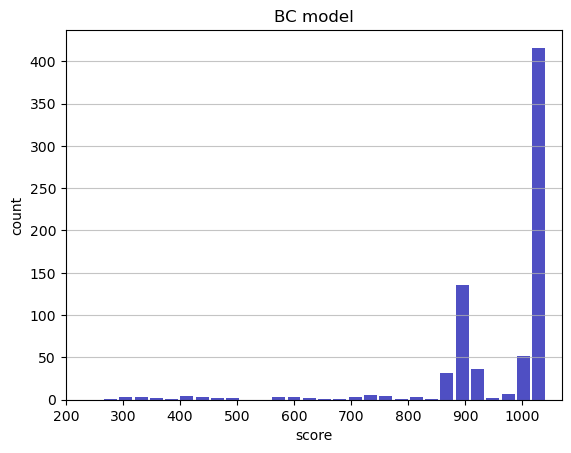

Track generation: 1227..1542 -> 315-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1091..1368 -> 277-tiles track
Epoch: 729
BC	mean: 958.36	variance: 127.29


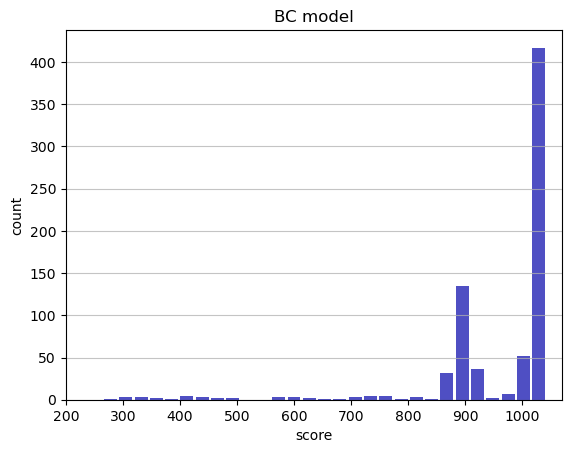

Track generation: 1234..1547 -> 313-tiles track
Epoch: 730
BC	mean: 958.44	variance: 127.22


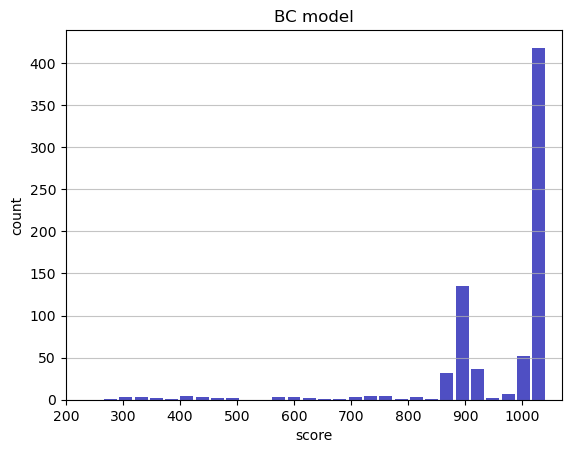

Track generation: 1142..1431 -> 289-tiles track
Epoch: 731
BC	mean: 958.53	variance: 127.15


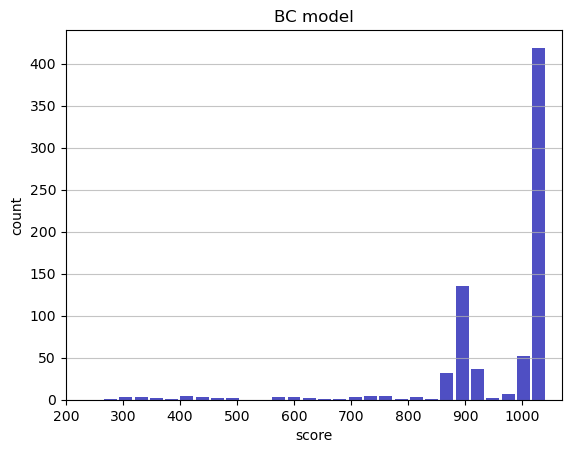

Track generation: 1076..1349 -> 273-tiles track
Epoch: 732
BC	mean: 958.63	variance: 127.10


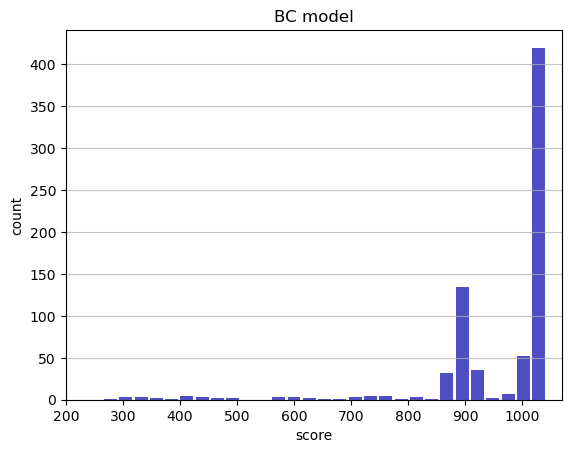

Track generation: 1144..1434 -> 290-tiles track
Epoch: 733
BC	mean: 958.73	variance: 127.03


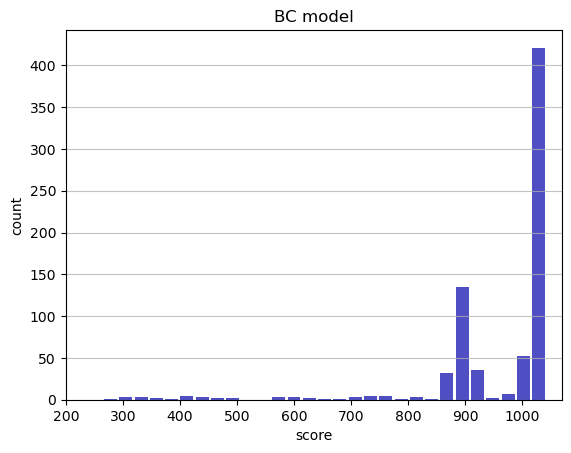

Track generation: 1155..1456 -> 301-tiles track
Epoch: 734
BC	mean: 958.80	variance: 126.96


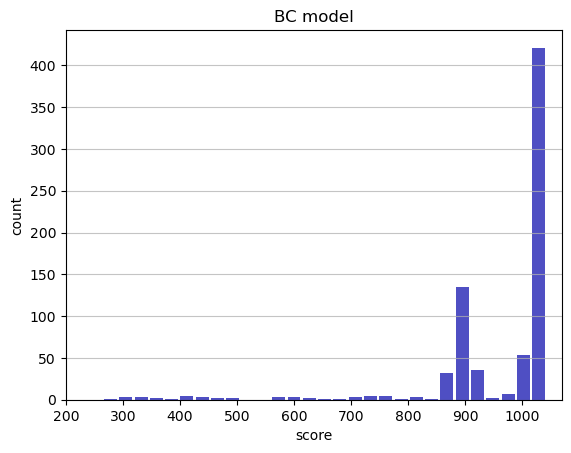

Track generation: 1263..1583 -> 320-tiles track
Epoch: 735
BC	mean: 958.88	variance: 126.90


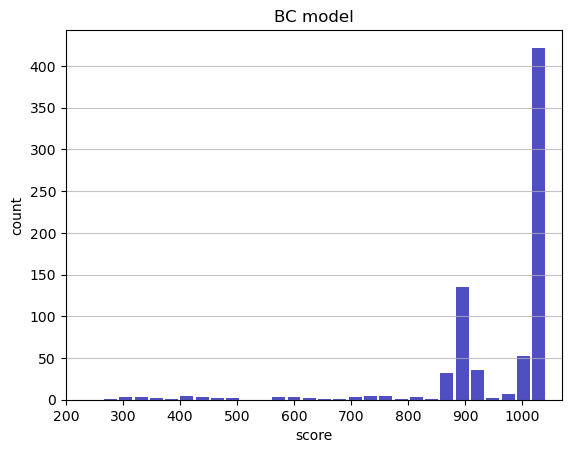

Track generation: 1064..1334 -> 270-tiles track
Epoch: 736
BC	mean: 958.98	variance: 126.84


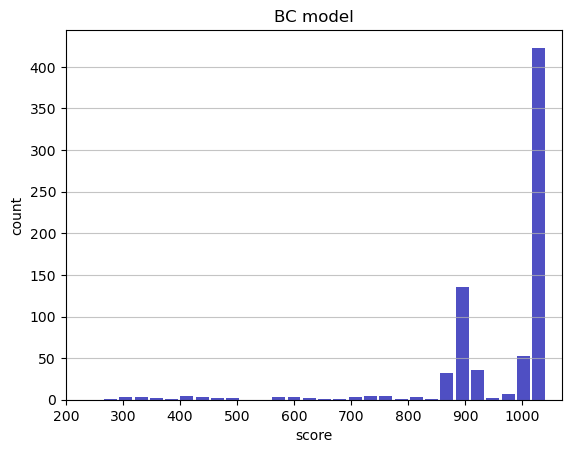

Track generation: 1148..1439 -> 291-tiles track
Epoch: 737
BC	mean: 958.89	variance: 126.77


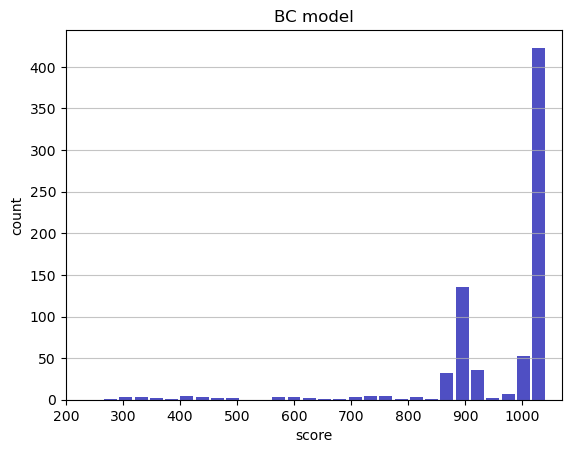

Track generation: 1051..1318 -> 267-tiles track
Epoch: 738
BC	mean: 958.99	variance: 126.72


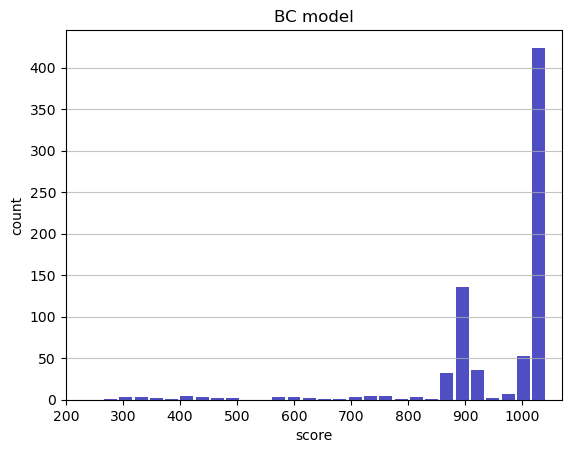

Track generation: 1151..1443 -> 292-tiles track
Epoch: 739
BC	mean: 958.89	variance: 126.66


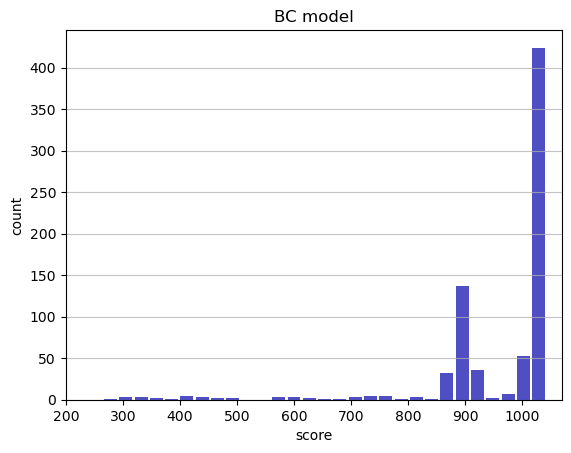

Track generation: 1175..1473 -> 298-tiles track
Epoch: 740
BC	mean: 958.80	variance: 126.60


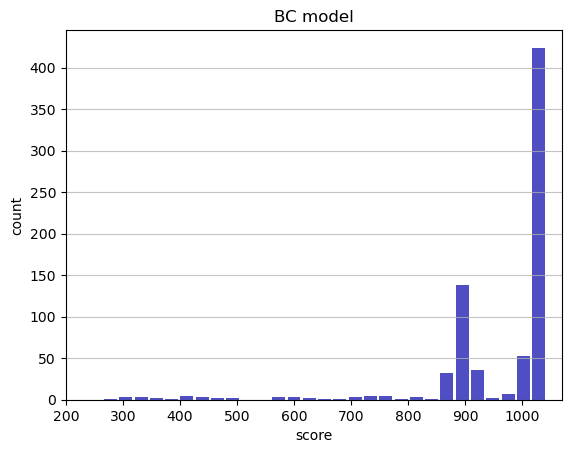

Track generation: 1212..1526 -> 314-tiles track
Epoch: 741
BC	mean: 958.88	variance: 126.53


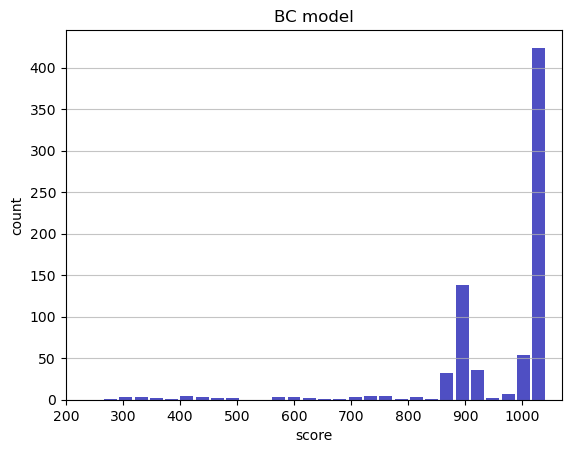

Track generation: 1167..1463 -> 296-tiles track
Epoch: 742
BC	mean: 958.81	variance: 126.46


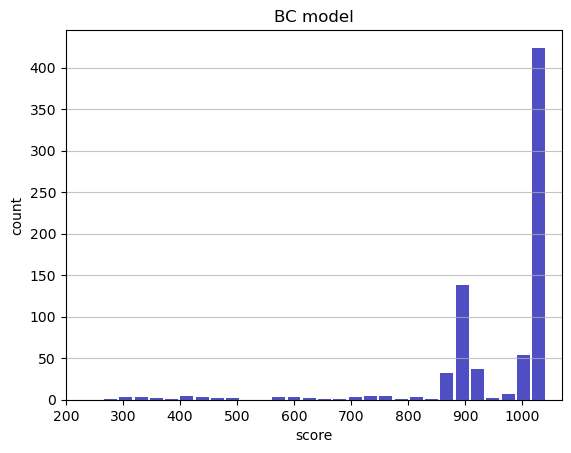

Track generation: 1112..1394 -> 282-tiles track
Epoch: 743
BC	mean: 958.91	variance: 126.40


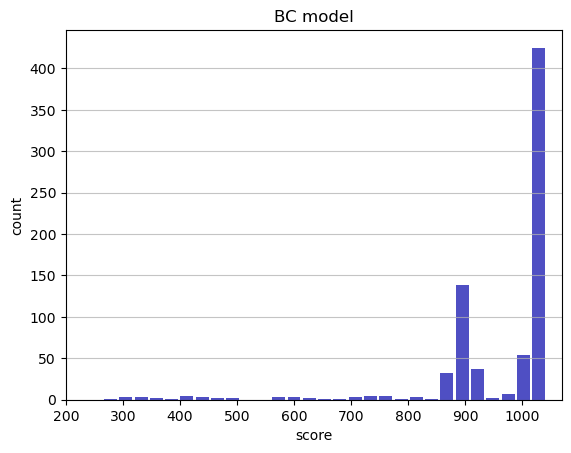

Track generation: 987..1243 -> 256-tiles track
Epoch: 744
BC	mean: 958.32	variance: 127.31


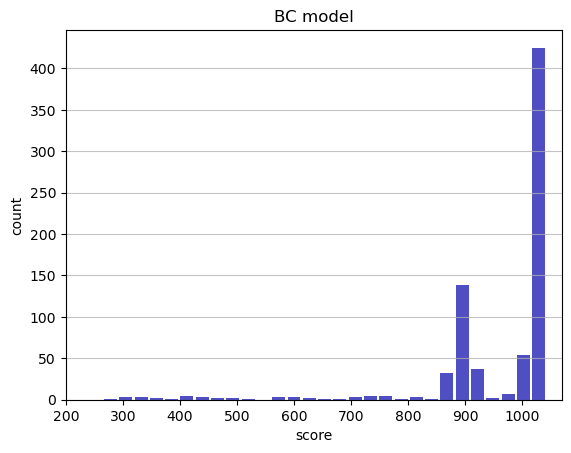

Track generation: 1082..1357 -> 275-tiles track
Epoch: 745
BC	mean: 958.24	variance: 127.24


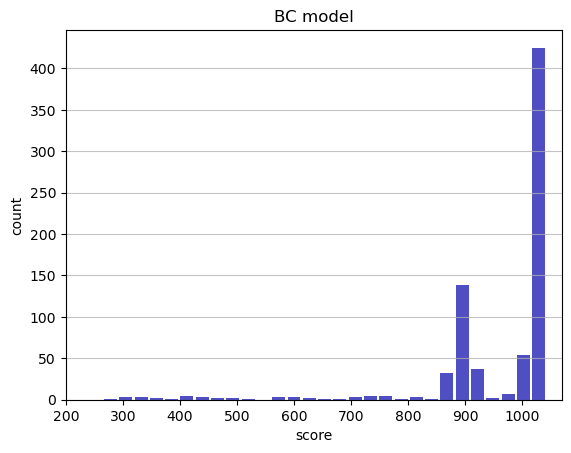

Track generation: 1010..1266 -> 256-tiles track
Epoch: 746
BC	mean: 958.35	variance: 127.19


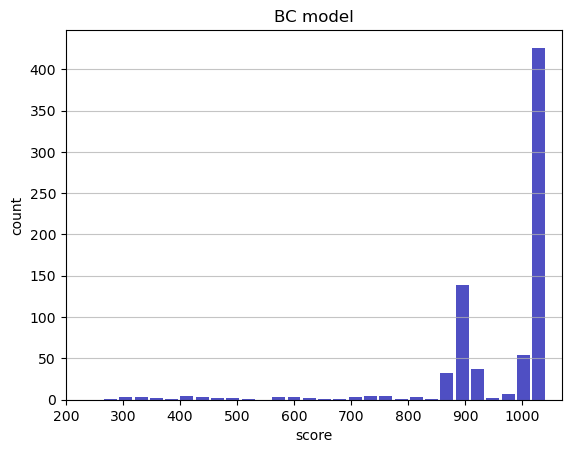

Track generation: 1105..1385 -> 280-tiles track
Epoch: 747
BC	mean: 958.26	variance: 127.13


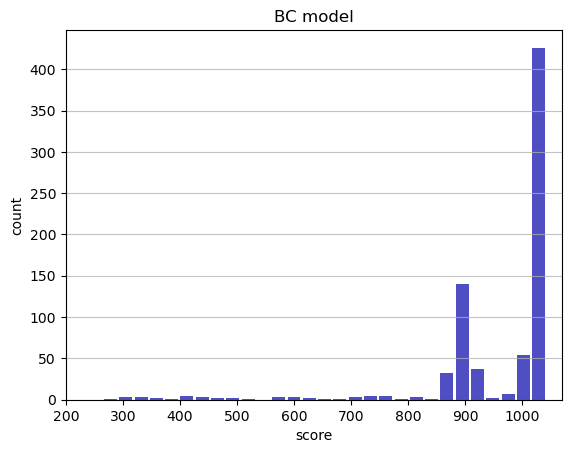

Track generation: 1127..1412 -> 285-tiles track
Epoch: 748
BC	mean: 958.35	variance: 127.07


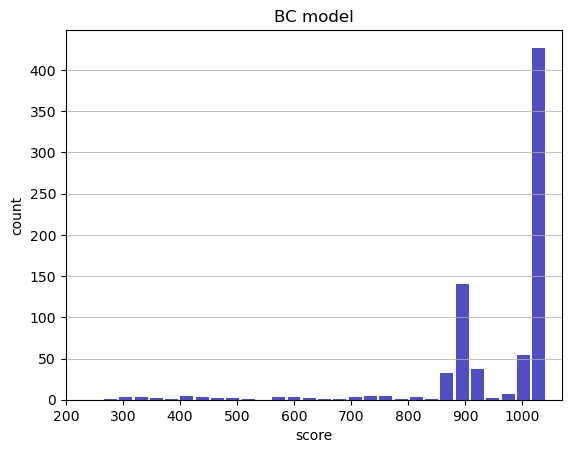

Track generation: 1208..1514 -> 306-tiles track
Epoch: 749
BC	mean: 958.44	variance: 127.01


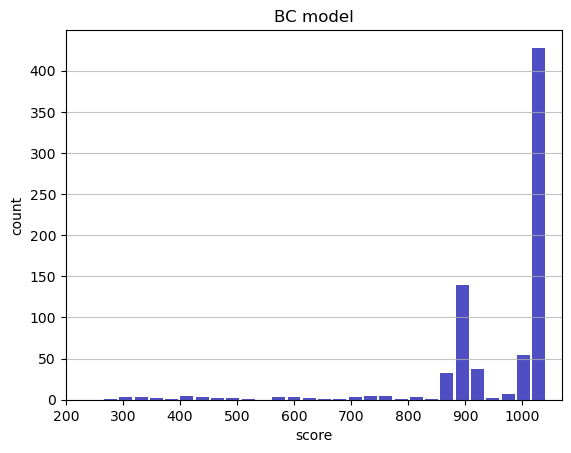

Track generation: 1019..1286 -> 267-tiles track
Epoch: 750
BC	mean: 958.53	variance: 126.95


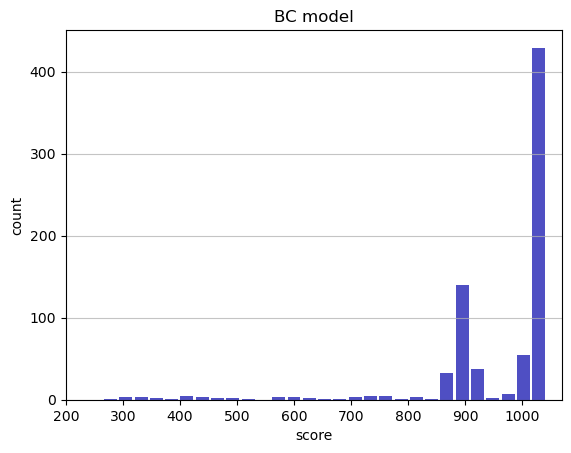

Track generation: 1096..1365 -> 269-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1125..1416 -> 291-tiles track
Epoch: 751
BC	mean: 958.46	variance: 126.88


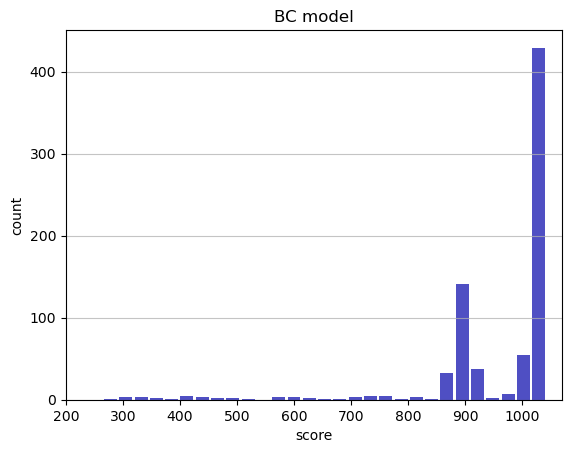

Track generation: 1111..1393 -> 282-tiles track
Epoch: 752
BC	mean: 958.56	variance: 126.82


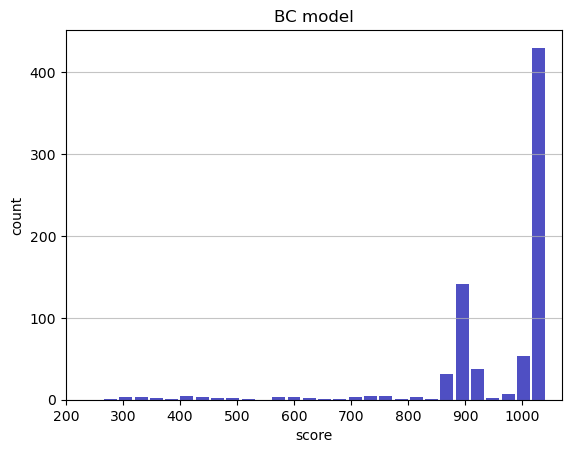

Track generation: 1121..1405 -> 284-tiles track
Epoch: 753
BC	mean: 958.65	variance: 126.76


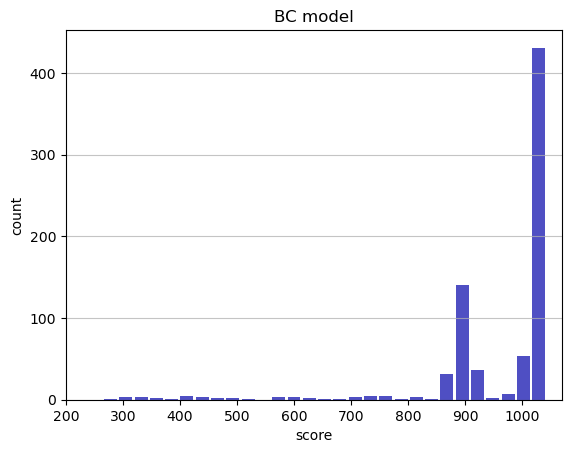

Track generation: 1076..1349 -> 273-tiles track
Epoch: 754
BC	mean: 958.75	variance: 126.71


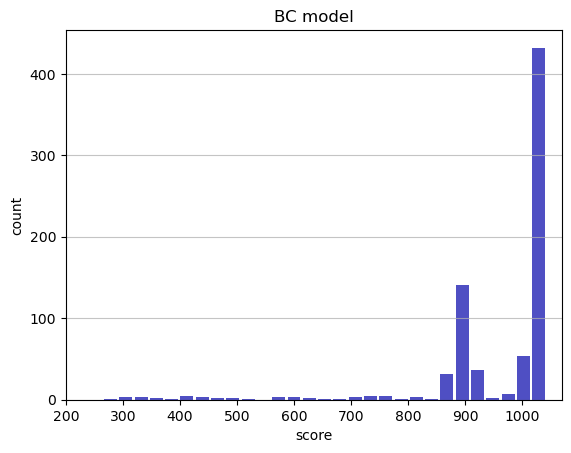

Track generation: 1170..1476 -> 306-tiles track
Epoch: 755
BC	mean: 958.84	variance: 126.65


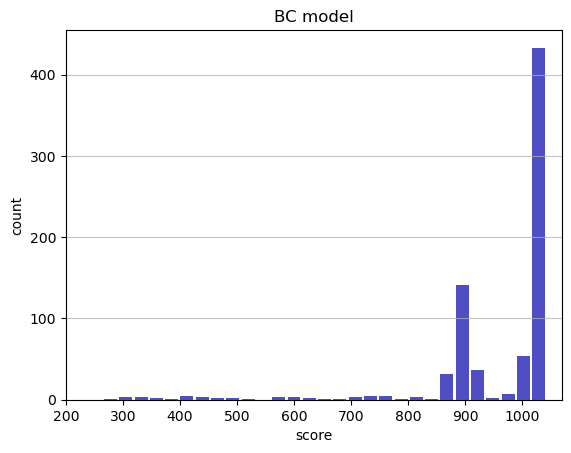

Track generation: 1178..1476 -> 298-tiles track
Epoch: 756
BC	mean: 958.93	variance: 126.59


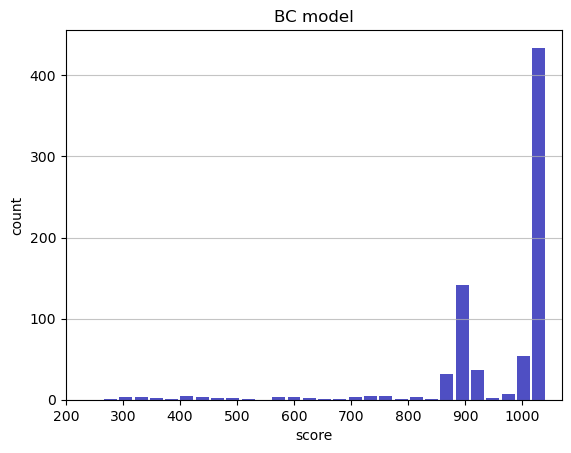

Track generation: 935..1177 -> 242-tiles track
Epoch: 757
BC	mean: 959.04	variance: 126.54


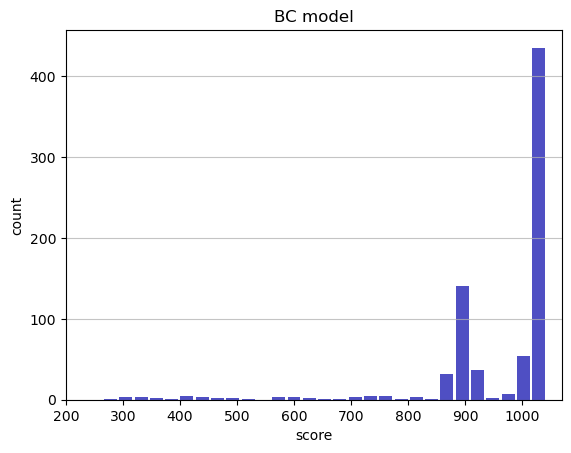

Track generation: 1085..1366 -> 281-tiles track
Epoch: 758
BC	mean: 958.96	variance: 126.48


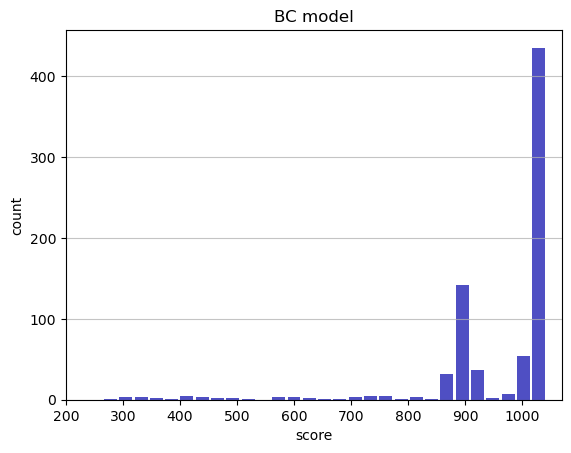

Track generation: 1235..1548 -> 313-tiles track
Epoch: 759
BC	mean: 959.05	variance: 126.42


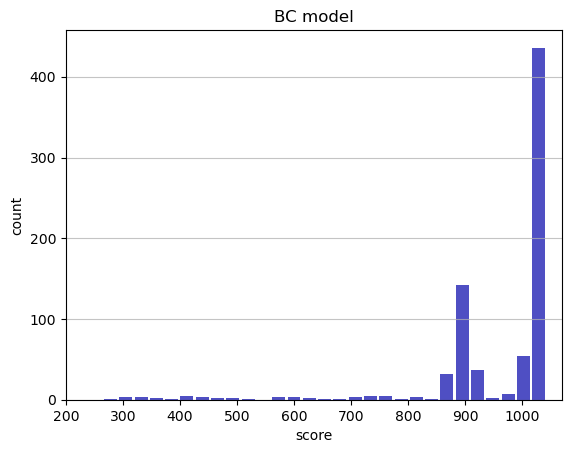

Track generation: 1171..1468 -> 297-tiles track
Epoch: 760
BC	mean: 959.14	variance: 126.36


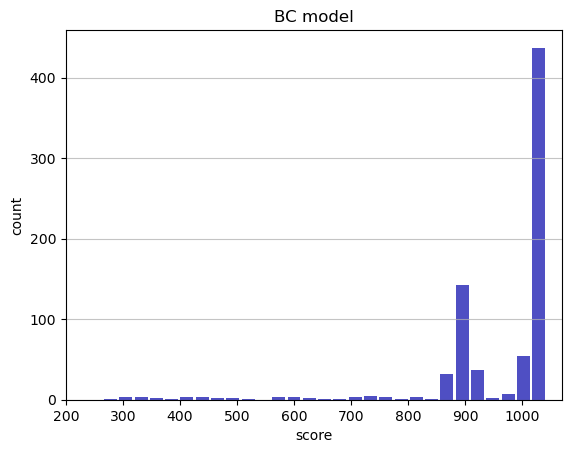

Track generation: 1048..1314 -> 266-tiles track
Epoch: 761
BC	mean: 959.24	variance: 126.31


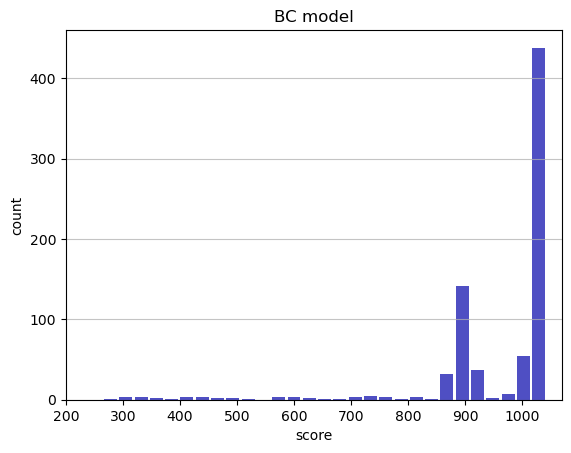

Track generation: 1076..1356 -> 280-tiles track
Epoch: 762
BC	mean: 959.33	variance: 126.25


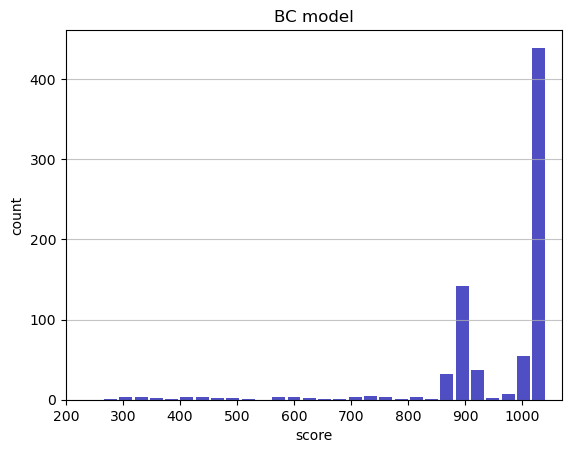

Track generation: 1044..1316 -> 272-tiles track
Epoch: 763
BC	mean: 959.20	variance: 126.22


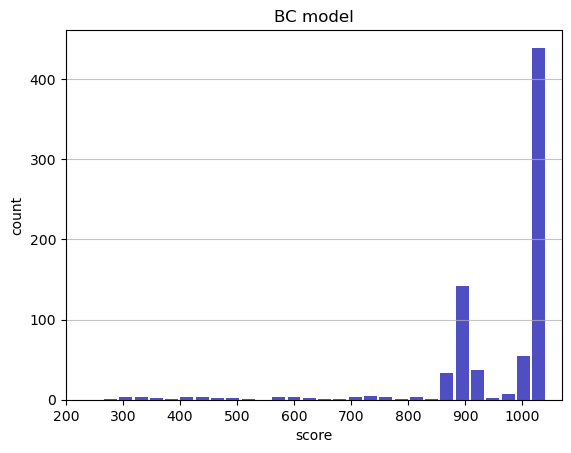

Track generation: 1180..1479 -> 299-tiles track
Epoch: 764
BC	mean: 959.29	variance: 126.16


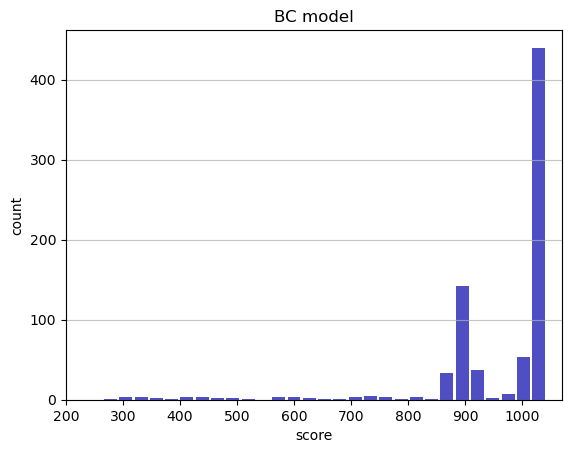

Track generation: 1136..1424 -> 288-tiles track
Epoch: 765
BC	mean: 959.36	variance: 126.09


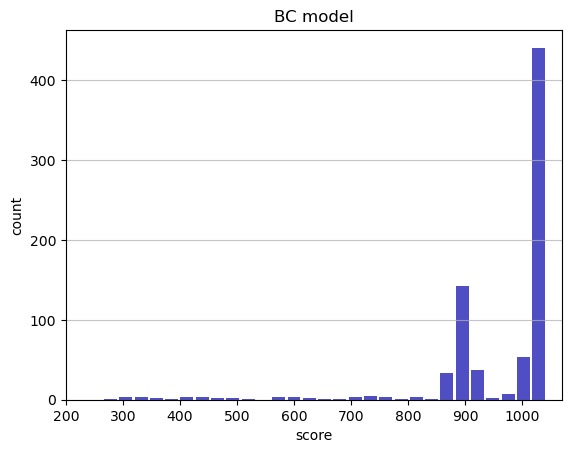

Track generation: 1124..1409 -> 285-tiles track
Epoch: 766
BC	mean: 959.46	variance: 126.04


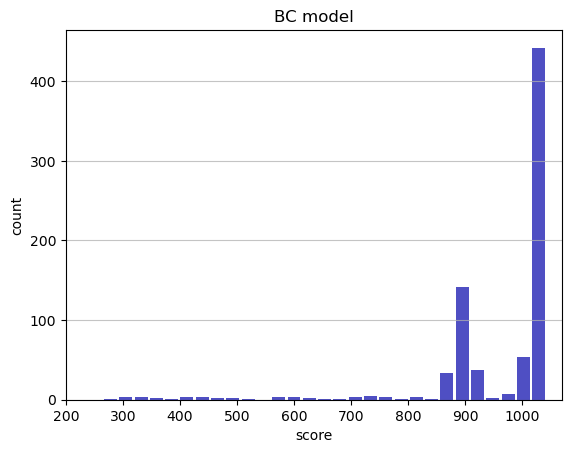

Track generation: 1328..1664 -> 336-tiles track
Epoch: 767
BC	mean: 959.48	variance: 125.96


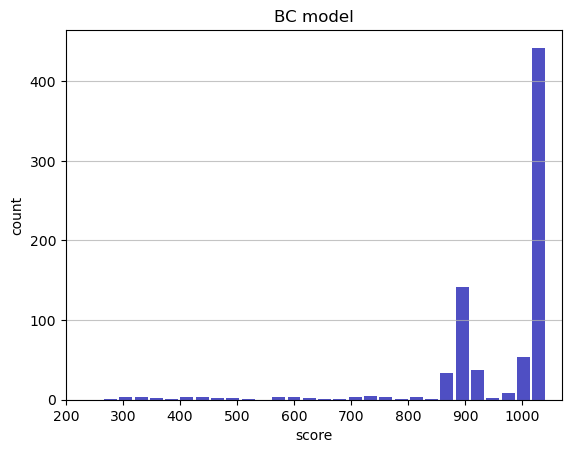

Track generation: 1183..1489 -> 306-tiles track
Epoch: 768
BC	mean: 959.56	variance: 125.90


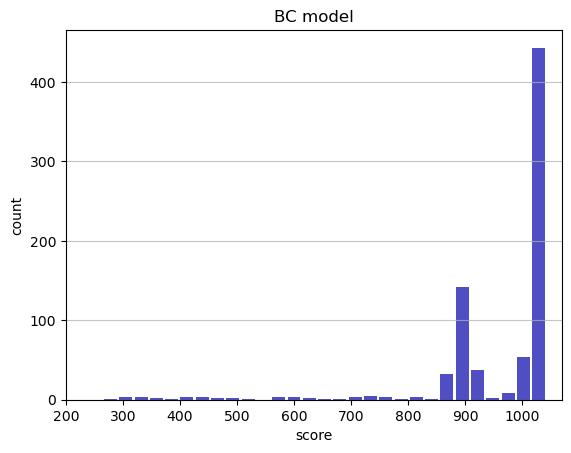

Track generation: 1026..1287 -> 261-tiles track
Epoch: 769
BC	mean: 959.66	variance: 125.84


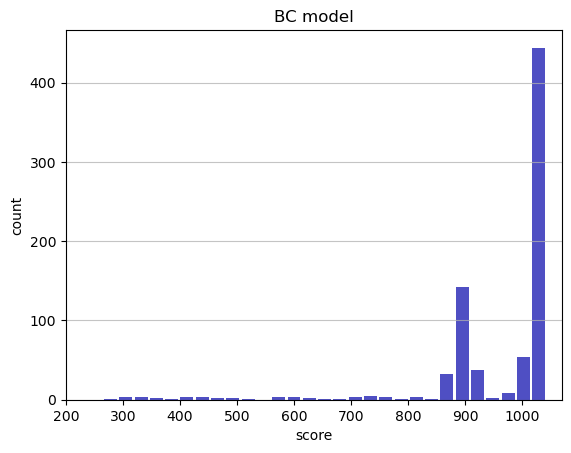

Track generation: 960..1210 -> 250-tiles track
Epoch: 770
BC	mean: 959.60	variance: 125.78


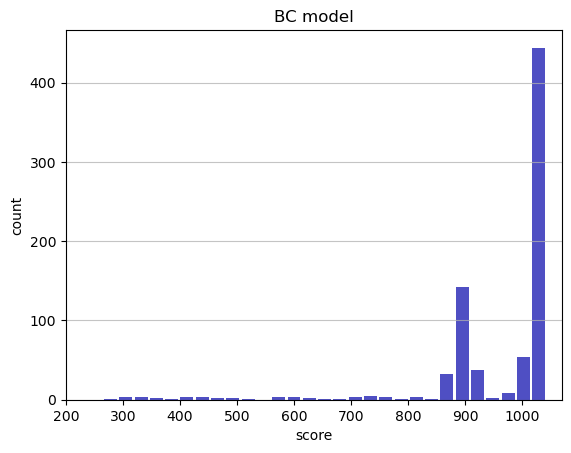

Track generation: 1167..1463 -> 296-tiles track
Epoch: 771
BC	mean: 959.51	variance: 125.72


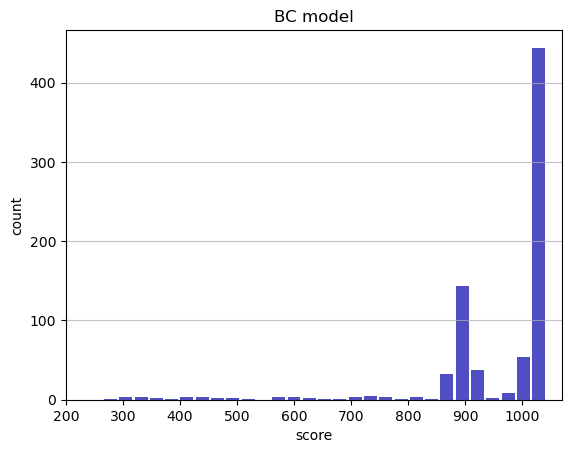

Track generation: 1062..1331 -> 269-tiles track
Epoch: 772
BC	mean: 959.61	variance: 125.67


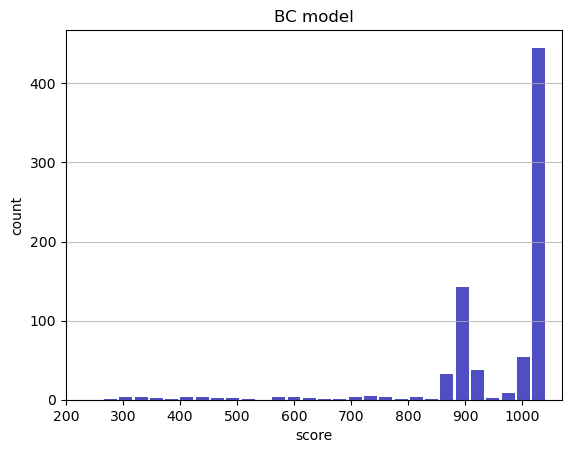

Track generation: 1198..1502 -> 304-tiles track
Epoch: 773
BC	mean: 959.68	variance: 125.60


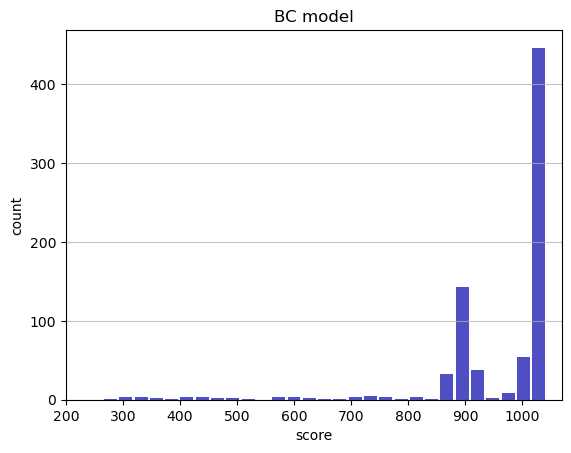

Track generation: 1167..1463 -> 296-tiles track
Epoch: 774
BC	mean: 959.77	variance: 125.55


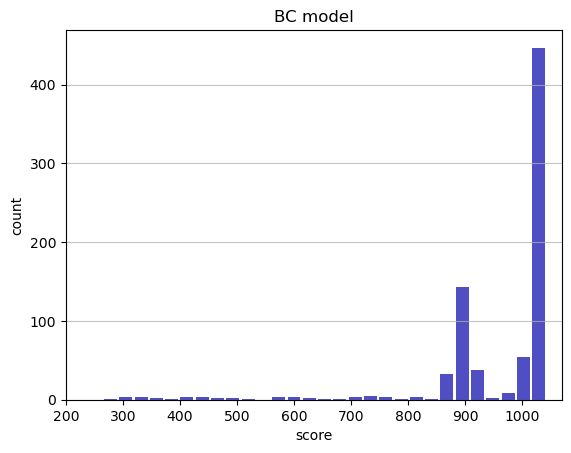

Track generation: 1123..1408 -> 285-tiles track
Epoch: 775
BC	mean: 959.69	variance: 125.49


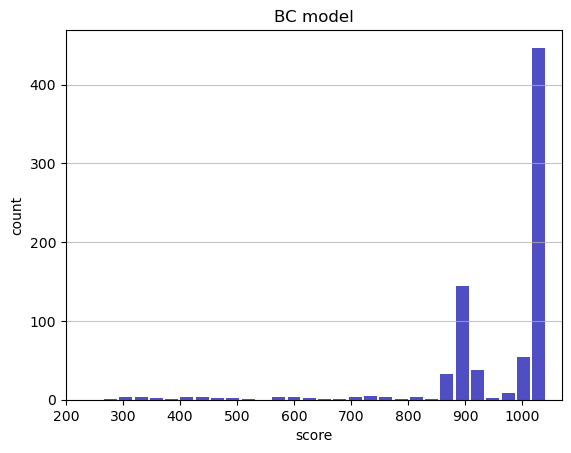

Track generation: 1108..1389 -> 281-tiles track
Epoch: 776
BC	mean: 959.78	variance: 125.43


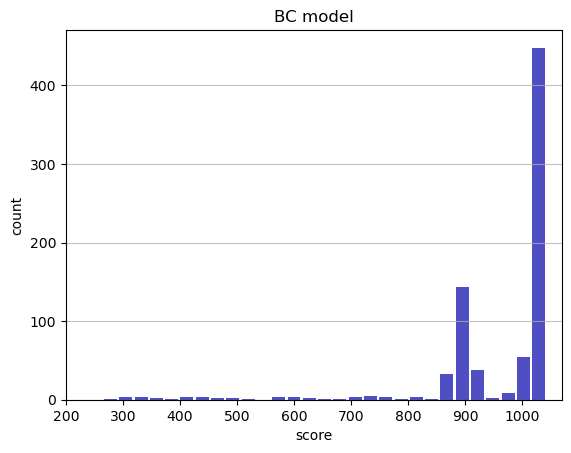

Track generation: 1136..1424 -> 288-tiles track
Epoch: 777
BC	mean: 959.87	variance: 125.38


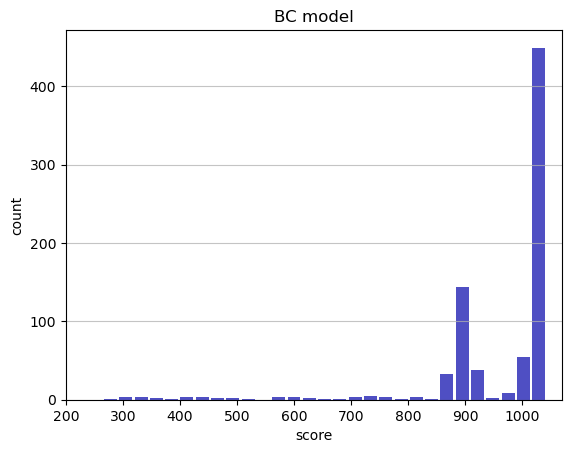

Track generation: 1304..1634 -> 330-tiles track
Epoch: 778
BC	mean: 959.87	variance: 125.30


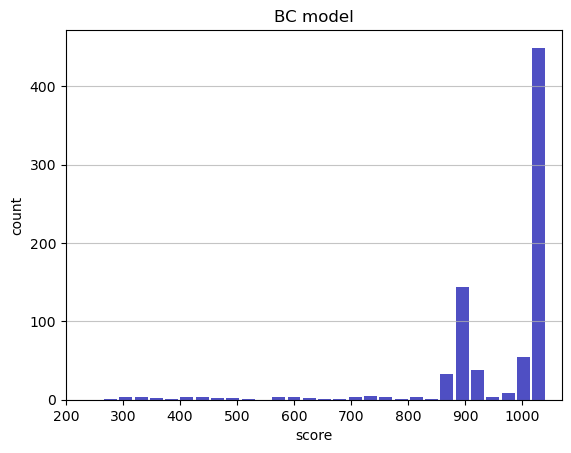

Track generation: 1048..1323 -> 275-tiles track
Epoch: 779
BC	mean: 959.95	variance: 125.24


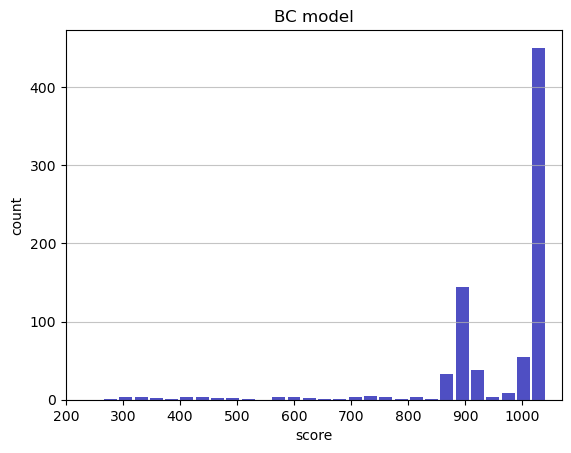

Track generation: 1208..1514 -> 306-tiles track
Epoch: 780
BC	mean: 959.88	variance: 125.18


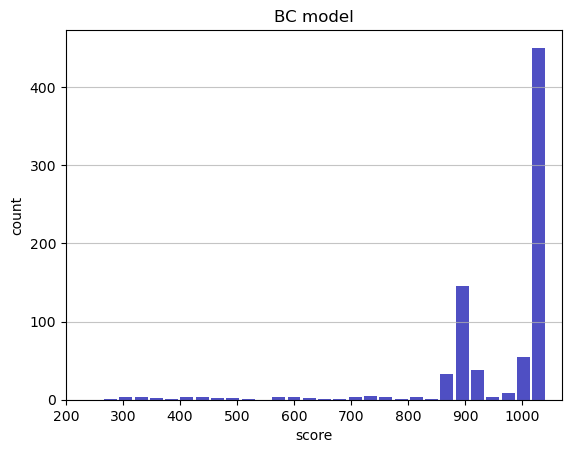

Track generation: 1139..1428 -> 289-tiles track
Epoch: 781
BC	mean: 959.78	variance: 125.13


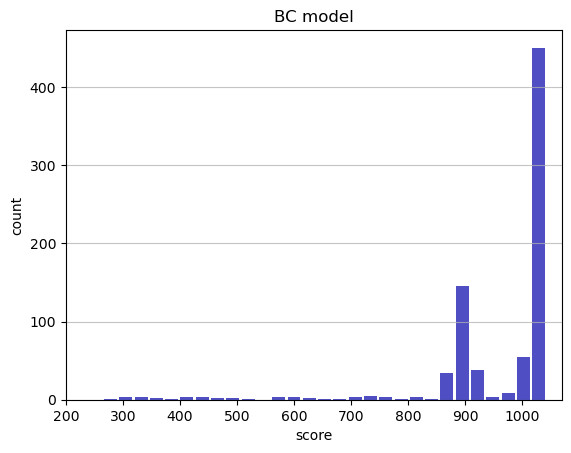

Track generation: 1207..1513 -> 306-tiles track
Epoch: 782
BC	mean: 959.85	variance: 125.07


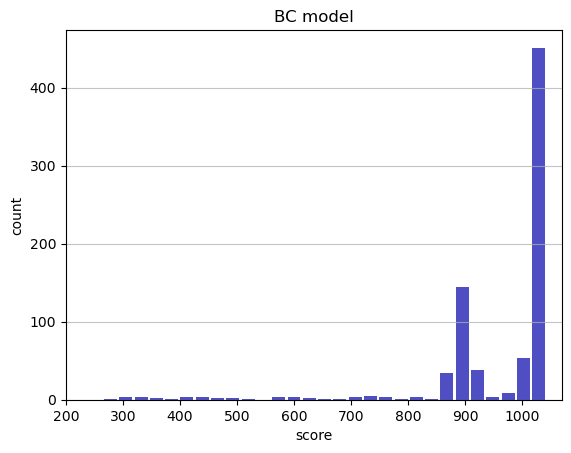

Track generation: 1196..1498 -> 302-tiles track
Epoch: 783
BC	mean: 959.88	variance: 124.99


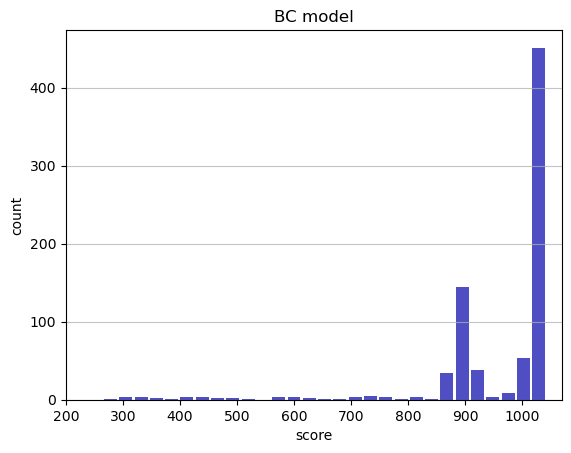

Track generation: 1105..1391 -> 286-tiles track
Epoch: 784
BC	mean: 959.96	variance: 124.93


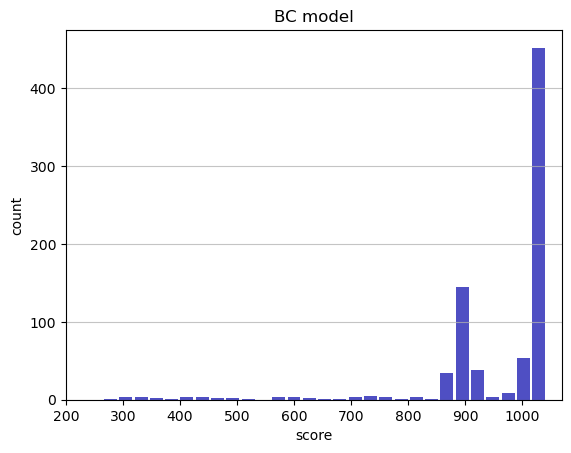

Track generation: 1112..1394 -> 282-tiles track
Epoch: 785
BC	mean: 959.86	variance: 124.88


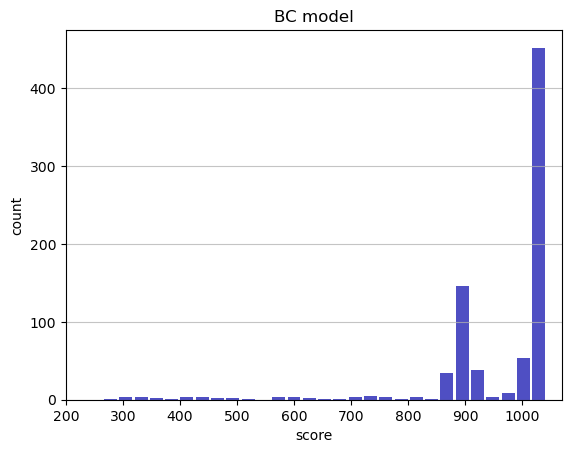

Track generation: 1212..1519 -> 307-tiles track
Epoch: 786
BC	mean: 959.80	variance: 124.82


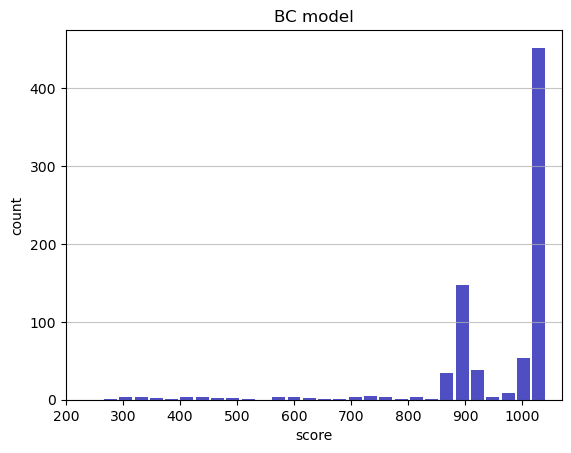

Track generation: 1167..1463 -> 296-tiles track
Epoch: 787
BC	mean: 959.72	variance: 124.75


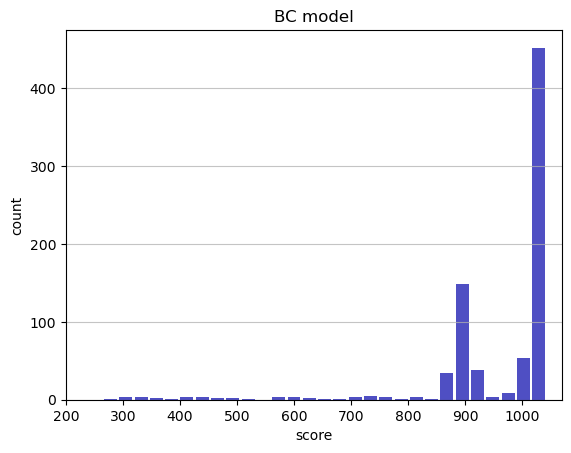

Track generation: 1135..1423 -> 288-tiles track
Epoch: 788
BC	mean: 959.81	variance: 124.70


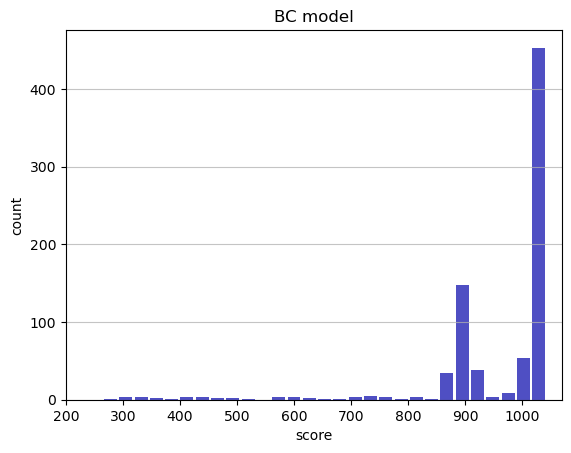

Track generation: 1039..1302 -> 263-tiles track
Epoch: 789
BC	mean: 959.76	variance: 124.63


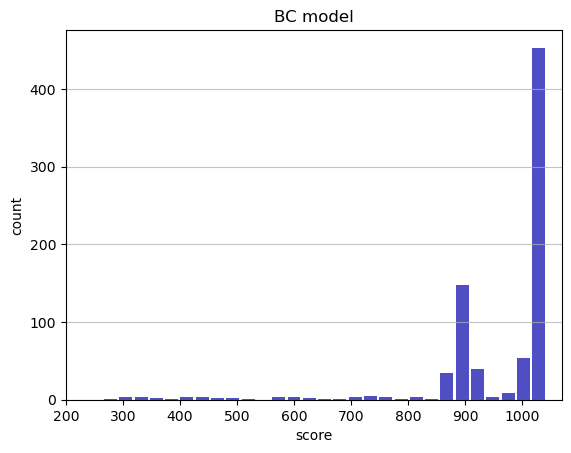

Track generation: 1285..1610 -> 325-tiles track
Epoch: 790
BC	mean: 959.45	variance: 124.86


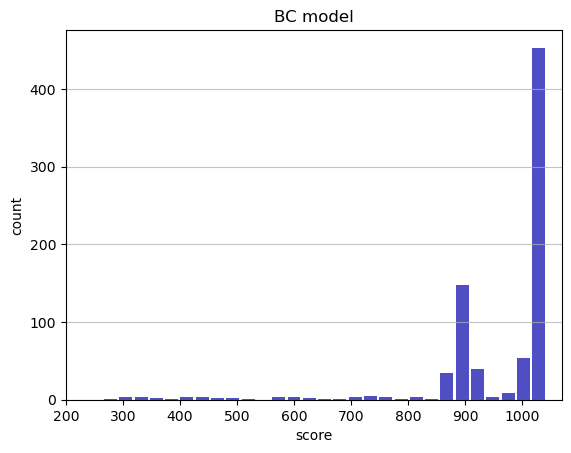

Track generation: 1010..1270 -> 260-tiles track
Epoch: 791
BC	mean: 959.54	variance: 124.81


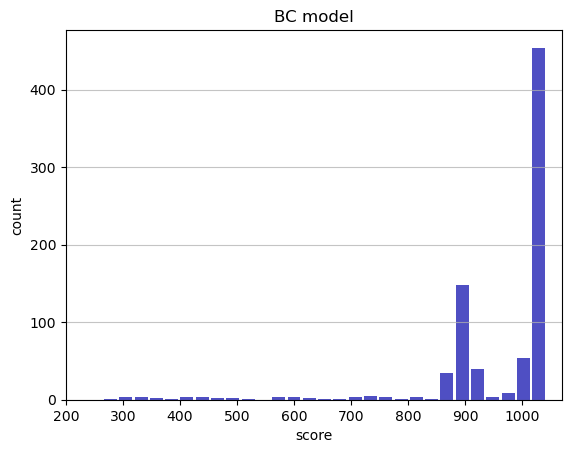

Track generation: 1153..1445 -> 292-tiles track
Epoch: 792
BC	mean: 959.63	variance: 124.75


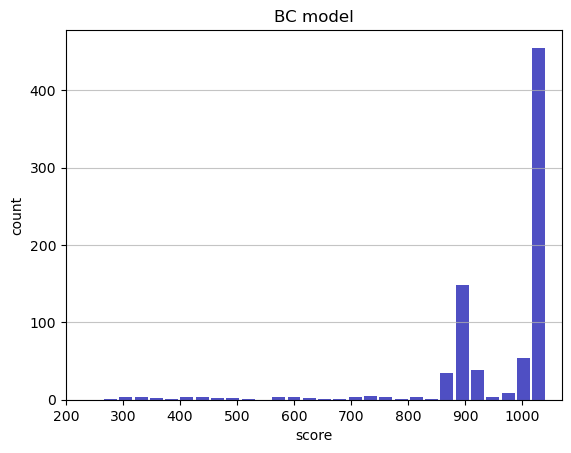

Track generation: 1264..1584 -> 320-tiles track
Epoch: 793
BC	mean: 959.54	variance: 124.70


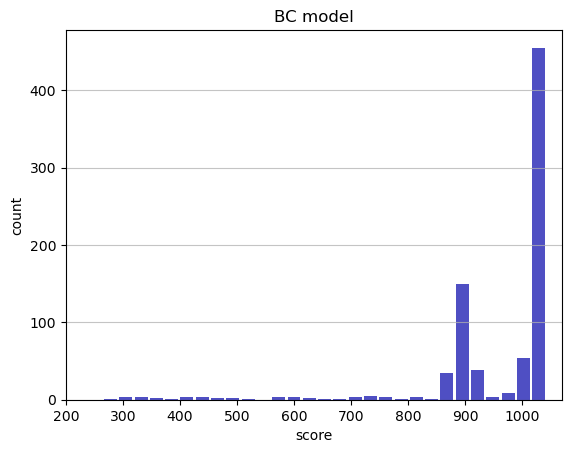

Track generation: 1159..1453 -> 294-tiles track
Epoch: 794
BC	mean: 959.63	variance: 124.64


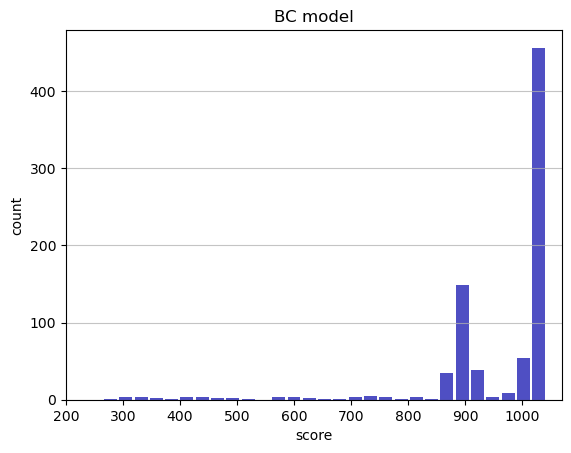

Track generation: 1163..1458 -> 295-tiles track
Epoch: 795
BC	mean: 959.53	variance: 124.59


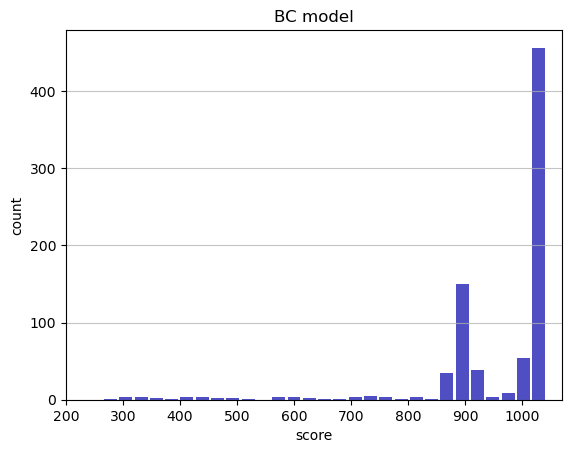

Track generation: 1147..1438 -> 291-tiles track
Epoch: 796
BC	mean: 959.62	variance: 124.54


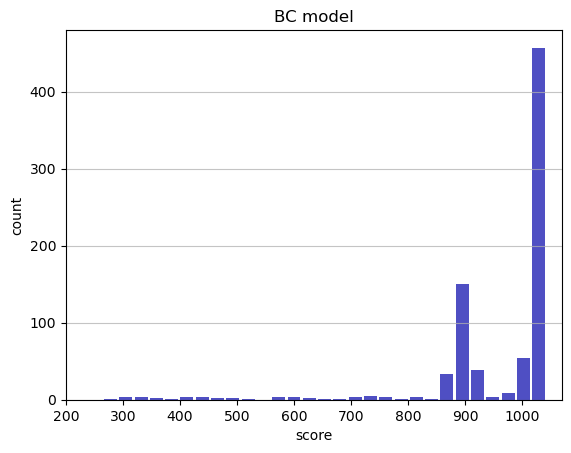

Track generation: 1253..1580 -> 327-tiles track
Epoch: 797
BC	mean: 959.54	variance: 124.48


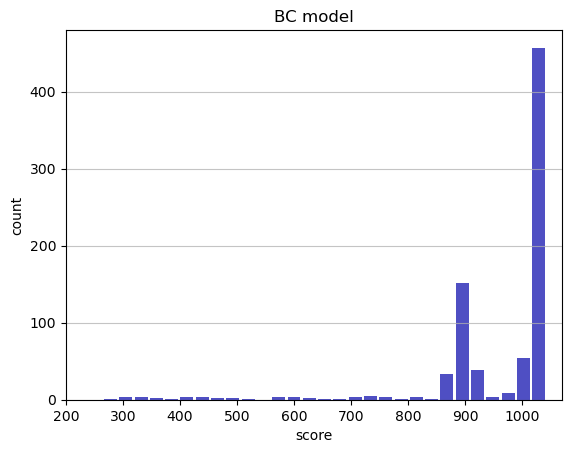

Track generation: 1023..1283 -> 260-tiles track
Epoch: 798
BC	mean: 959.64	variance: 124.43


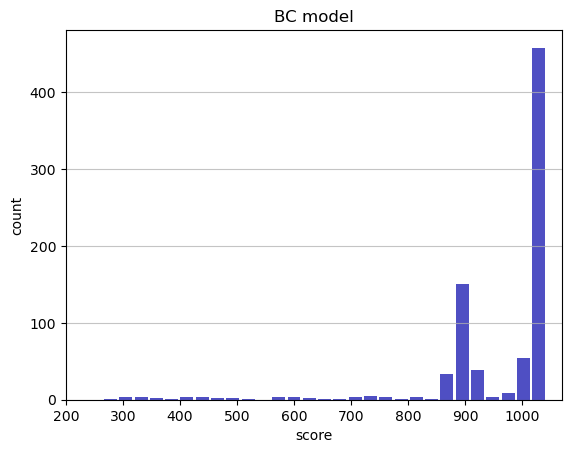

Track generation: 993..1250 -> 257-tiles track
Epoch: 799
BC	mean: 959.73	variance: 124.39


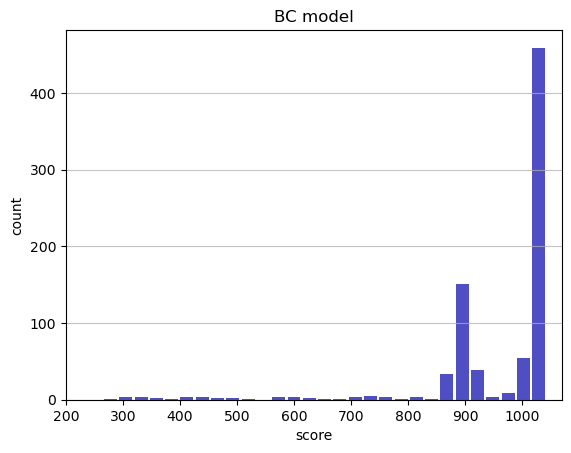

Track generation: 1031..1293 -> 262-tiles track
Epoch: 800
BC	mean: 959.83	variance: 124.34


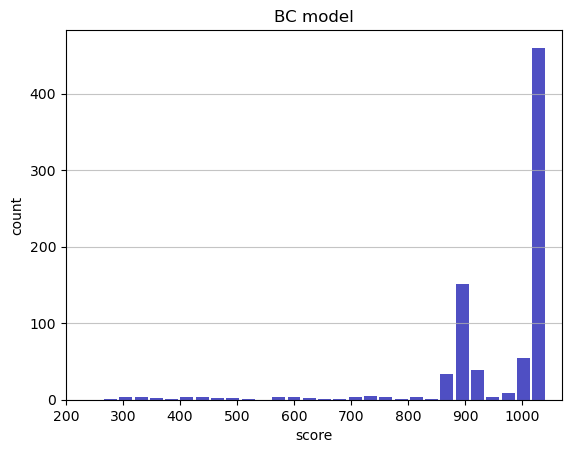

Track generation: 1162..1457 -> 295-tiles track
Epoch: 801
BC	mean: 959.91	variance: 124.28


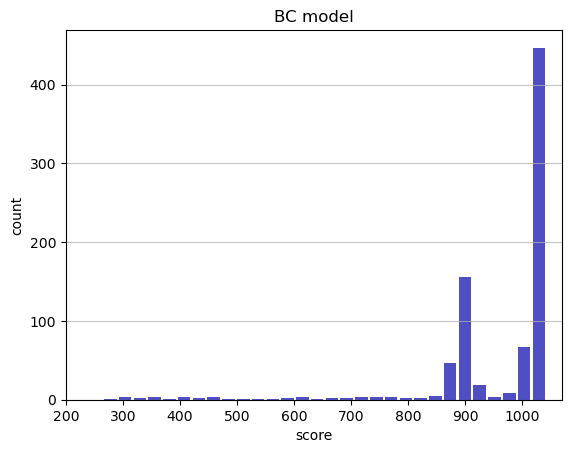

Track generation: 1106..1390 -> 284-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1259..1578 -> 319-tiles track
Epoch: 802
BC	mean: 959.92	variance: 124.21


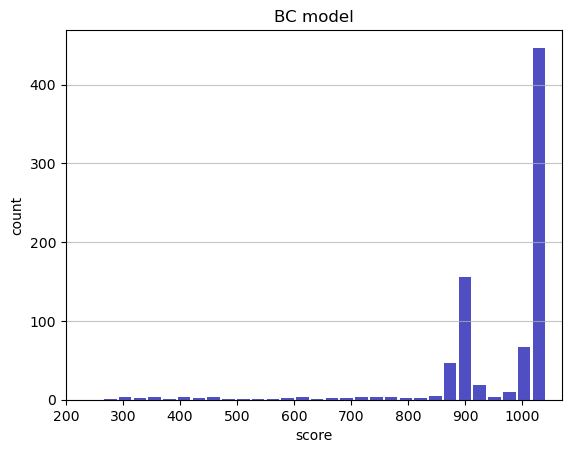

Track generation: 1257..1575 -> 318-tiles track
Epoch: 803
BC	mean: 960.00	variance: 124.15


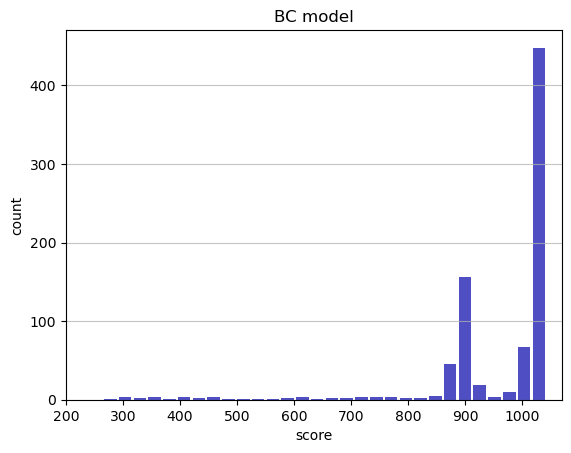

Track generation: 1067..1338 -> 271-tiles track
Epoch: 804
BC	mean: 960.08	variance: 124.09


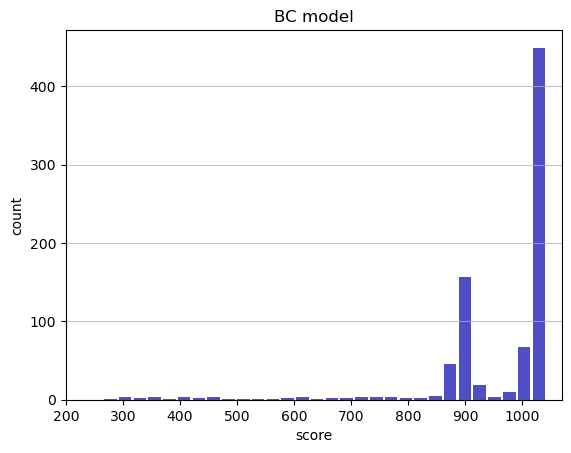

Track generation: 1183..1483 -> 300-tiles track
Epoch: 805
BC	mean: 960.17	variance: 124.04


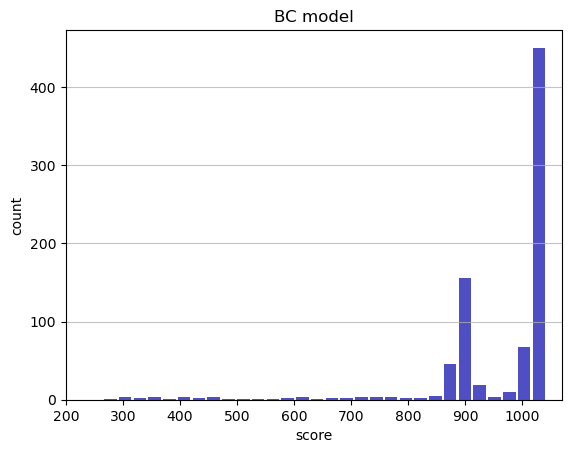

Track generation: 1086..1368 -> 282-tiles track
Epoch: 806
BC	mean: 960.25	variance: 123.99


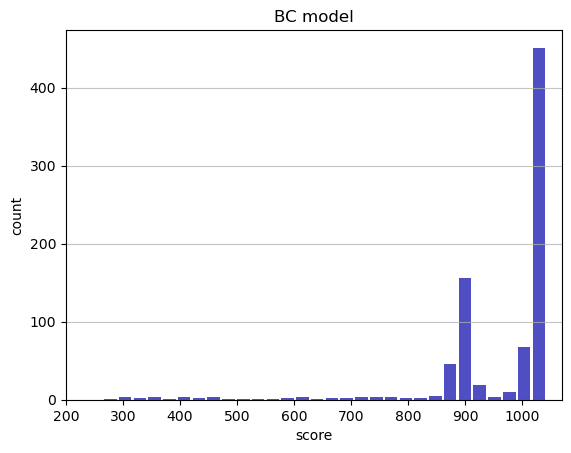

Track generation: 1116..1399 -> 283-tiles track
Epoch: 807
BC	mean: 960.34	variance: 123.94


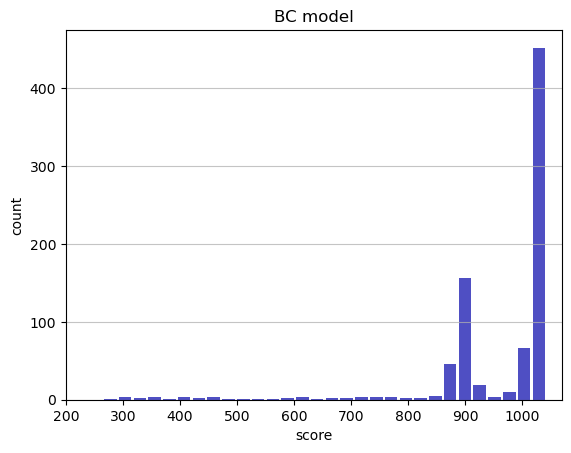

Track generation: 1212..1519 -> 307-tiles track
Epoch: 808
BC	mean: 960.42	variance: 123.88


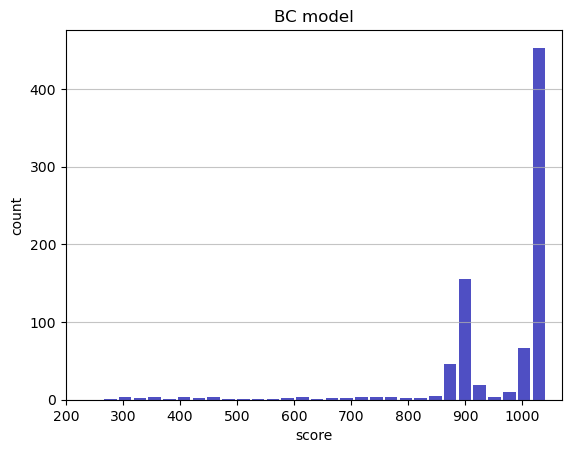

Track generation: 1328..1664 -> 336-tiles track
Epoch: 809
BC	mean: 960.49	variance: 123.82


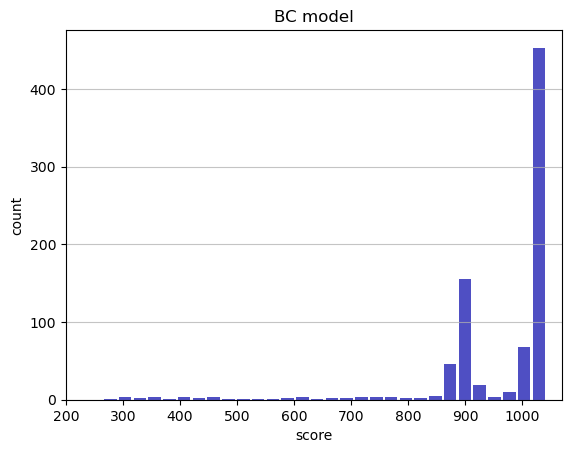

Track generation: 1211..1518 -> 307-tiles track
Epoch: 810
BC	mean: 960.57	variance: 123.76


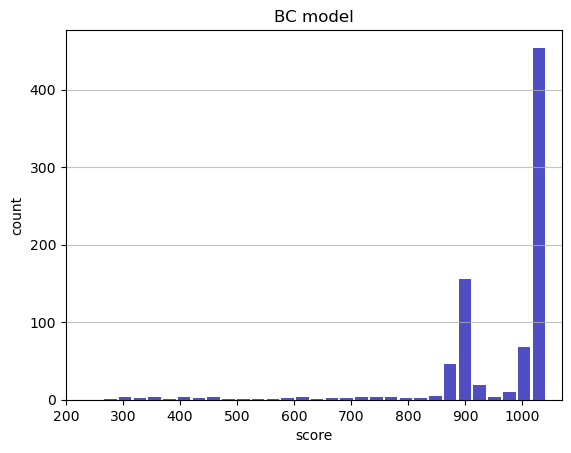

Track generation: 1098..1379 -> 281-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1042..1306 -> 264-tiles track
Epoch: 811
BC	mean: 960.51	variance: 123.69


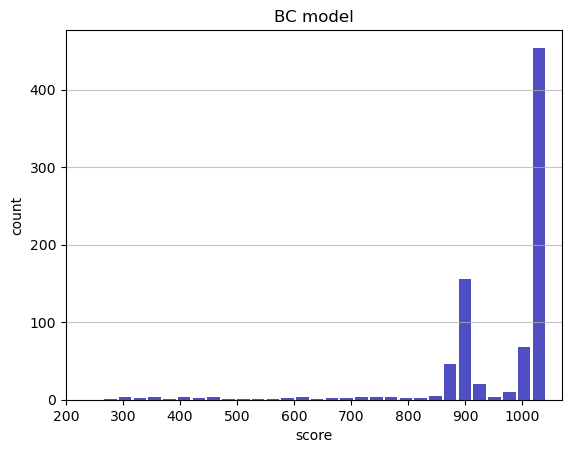

Track generation: 1237..1550 -> 313-tiles track
Epoch: 812
BC	mean: 959.69	variance: 125.78


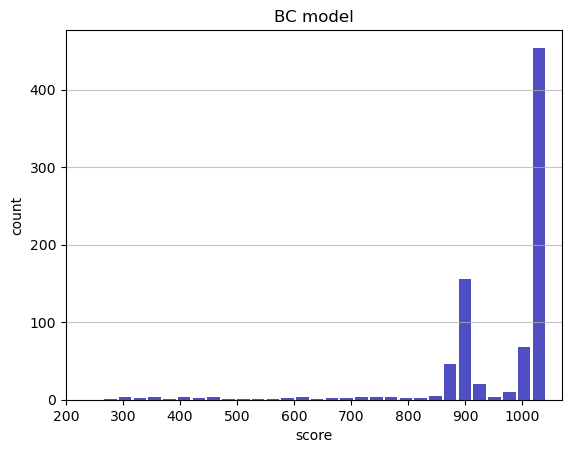

Track generation: 1092..1369 -> 277-tiles track
Epoch: 813
BC	mean: 959.61	variance: 125.73


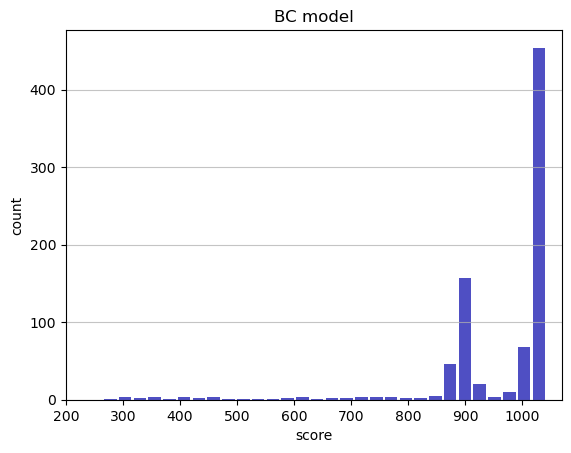

Track generation: 895..1125 -> 230-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1148..1439 -> 291-tiles track
Epoch: 814
BC	mean: 959.69	variance: 125.67


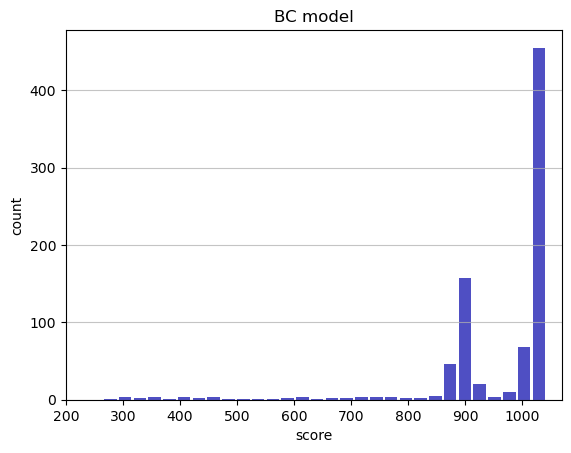

Track generation: 1071..1351 -> 280-tiles track
Epoch: 815
BC	mean: 959.63	variance: 125.61


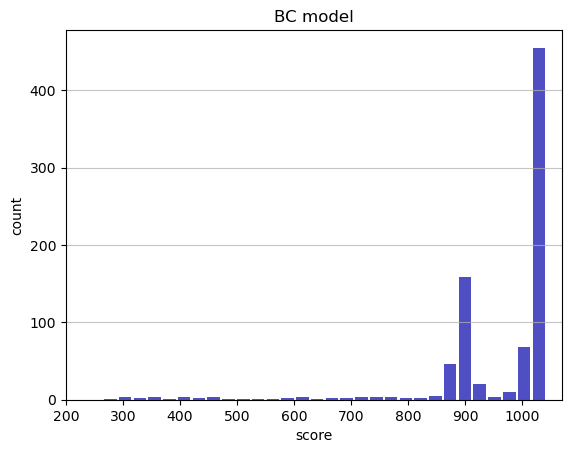

Track generation: 1250..1574 -> 324-tiles track
Epoch: 816
BC	mean: 959.70	variance: 125.55


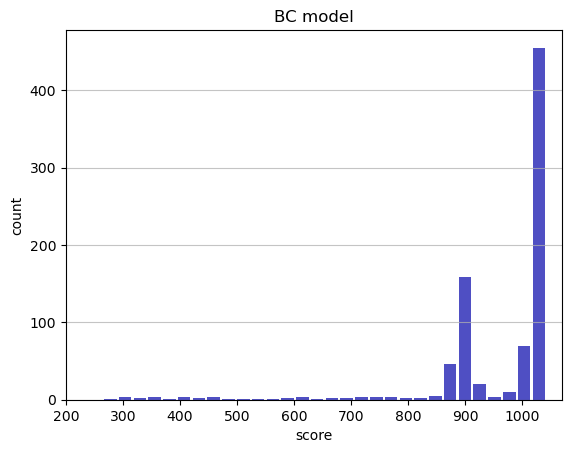

Track generation: 1023..1291 -> 268-tiles track
Epoch: 817
BC	mean: 959.78	variance: 125.49


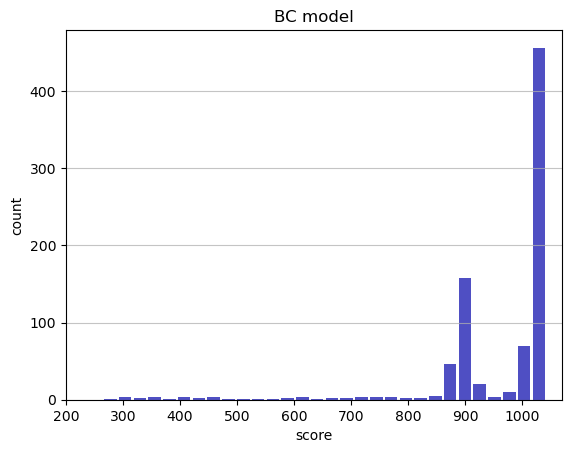

Track generation: 1309..1640 -> 331-tiles track
Epoch: 818
BC	mean: 958.99	variance: 127.46


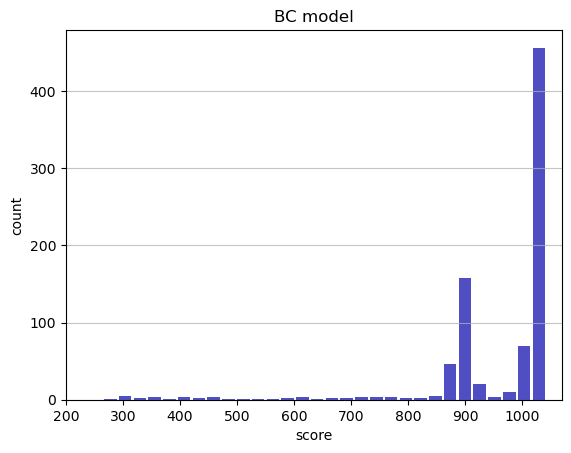

Track generation: 1095..1380 -> 285-tiles track
Epoch: 819
BC	mean: 958.91	variance: 127.40


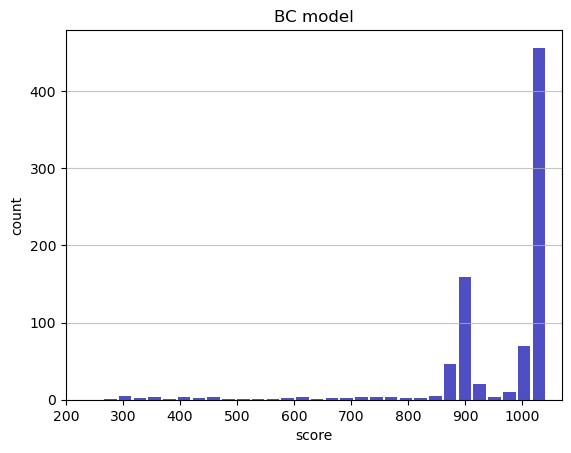

Track generation: 1047..1313 -> 266-tiles track
Epoch: 820
BC	mean: 959.01	variance: 127.36


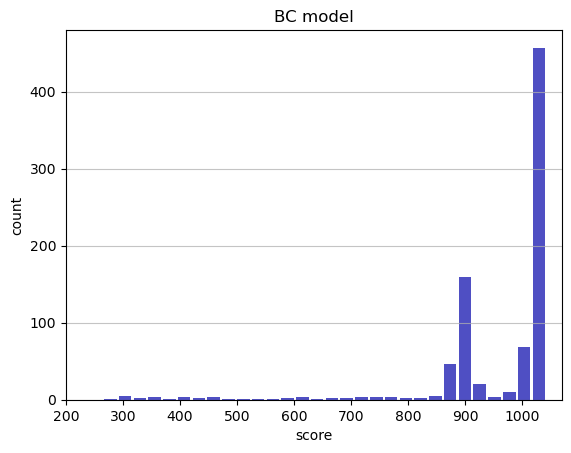

Track generation: 1108..1389 -> 281-tiles track
Epoch: 821
BC	mean: 959.09	variance: 127.30


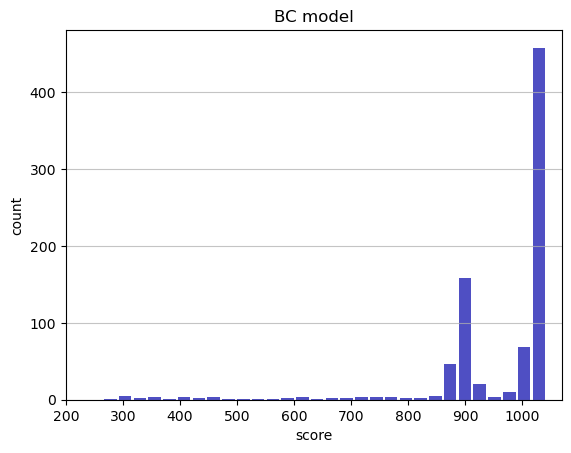

Track generation: 1058..1326 -> 268-tiles track
Epoch: 822
BC	mean: 959.03	variance: 127.23


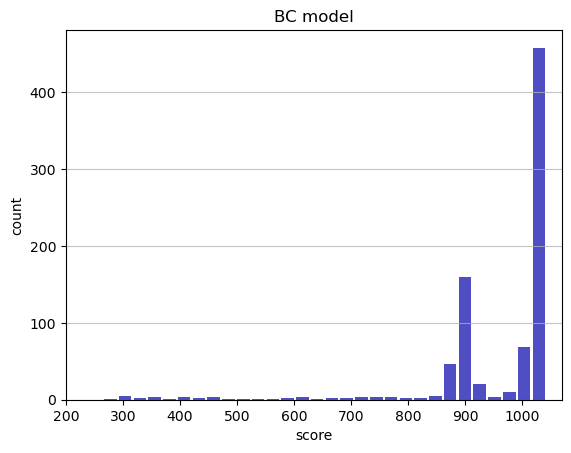

Track generation: 1161..1459 -> 298-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1038..1302 -> 264-tiles track
Epoch: 823
BC	mean: 958.95	variance: 127.18


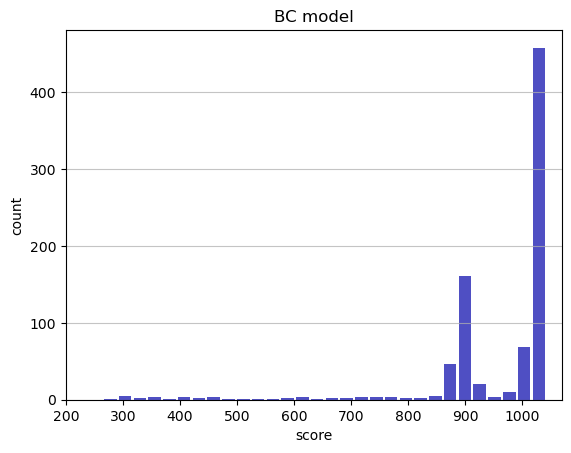

Track generation: 1021..1280 -> 259-tiles track
Epoch: 824
BC	mean: 958.86	variance: 127.13


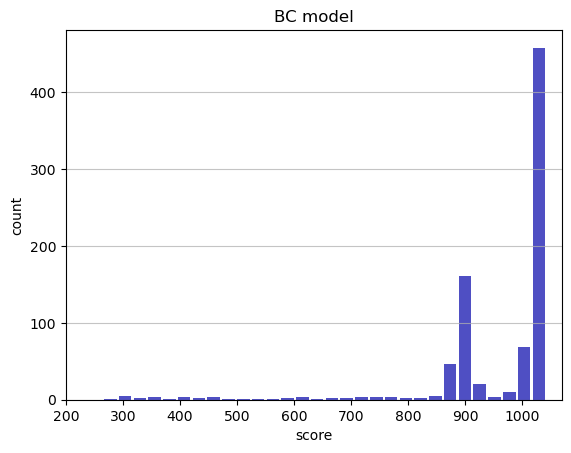

Track generation: 1147..1438 -> 291-tiles track
Epoch: 825
BC	mean: 958.18	variance: 128.54


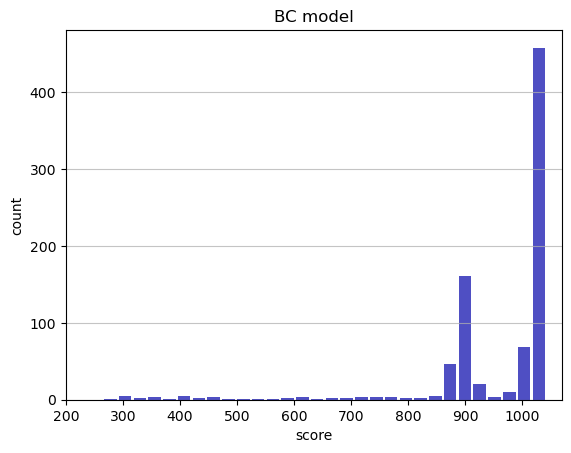

Track generation: 1108..1393 -> 285-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1060..1335 -> 275-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1311..1643 -> 332-tiles track
Epoch: 826
BC	mean: 957.58	variance: 129.62


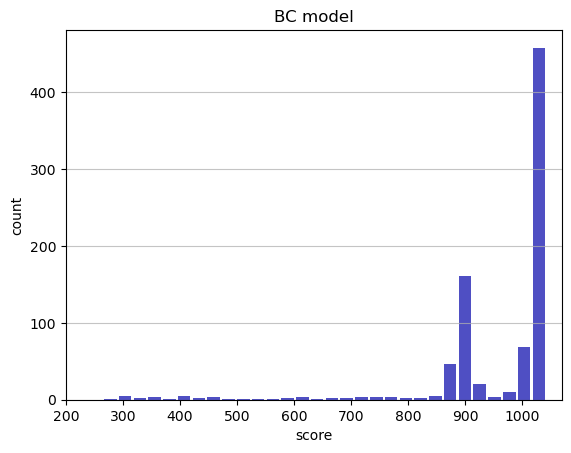

Track generation: 1192..1500 -> 308-tiles track
Epoch: 827
BC	mean: 957.65	variance: 129.56


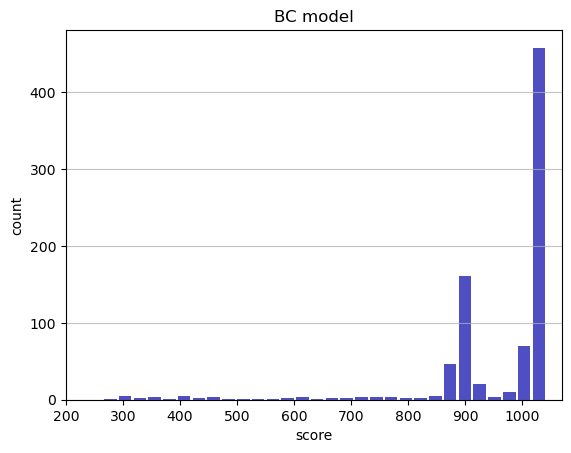

Track generation: 1124..1409 -> 285-tiles track
Epoch: 828
BC	mean: 957.74	variance: 129.51


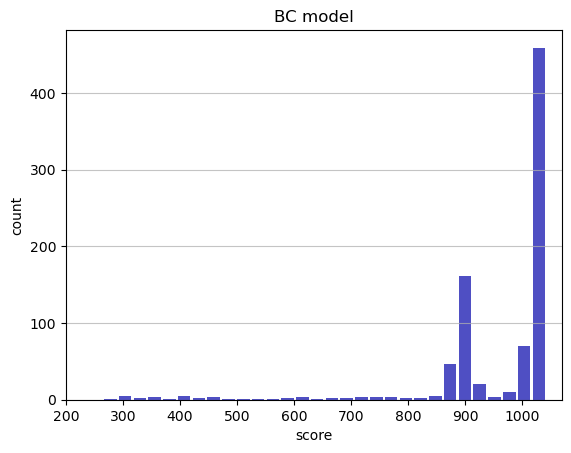

Track generation: 1303..1633 -> 330-tiles track
Epoch: 829
BC	mean: 957.80	variance: 129.45


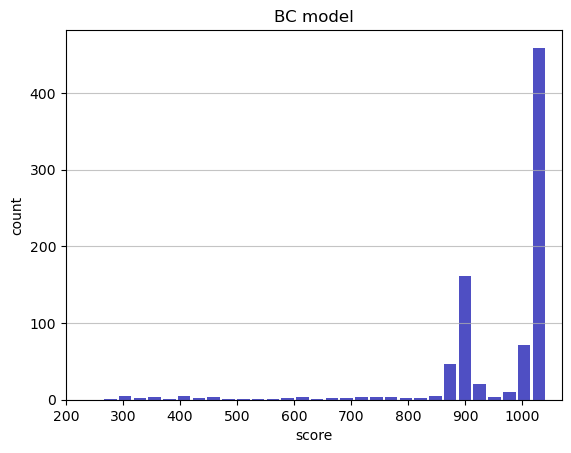

Track generation: 1120..1404 -> 284-tiles track
Epoch: 830
BC	mean: 957.89	variance: 129.39


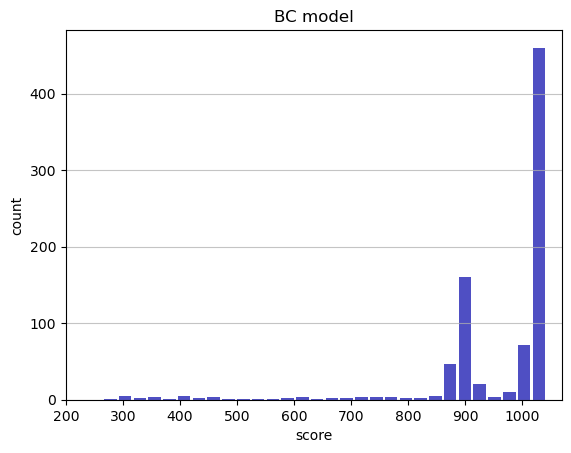

Track generation: 1214..1522 -> 308-tiles track
Epoch: 831
BC	mean: 957.05	variance: 131.57


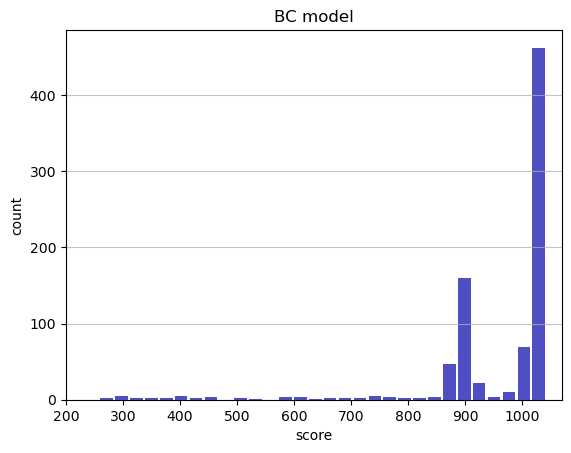

Track generation: 1156..1449 -> 293-tiles track
Epoch: 832
BC	mean: 956.97	variance: 131.51


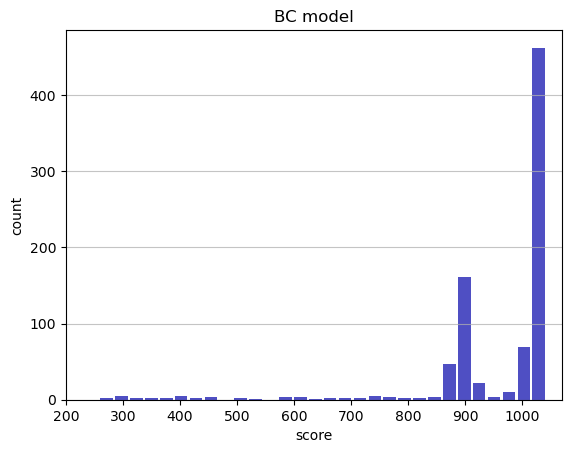

Track generation: 1182..1481 -> 299-tiles track
Epoch: 833
BC	mean: 957.05	variance: 131.45


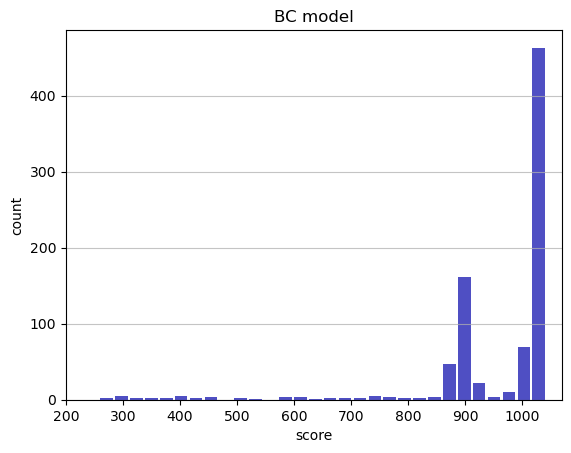

Track generation: 1044..1309 -> 265-tiles track
Epoch: 834
BC	mean: 957.15	variance: 131.40


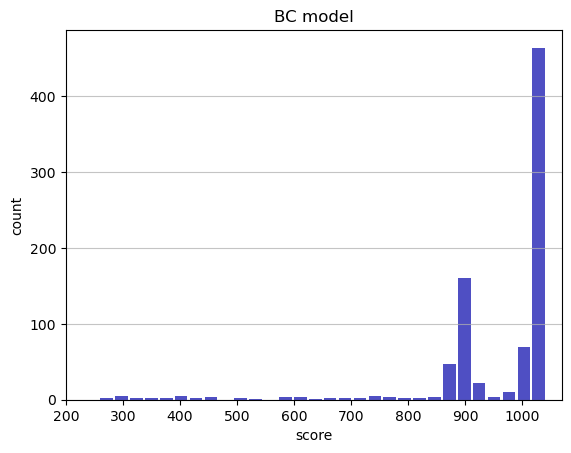

Track generation: 1084..1366 -> 282-tiles track
Epoch: 835
BC	mean: 957.22	variance: 131.34


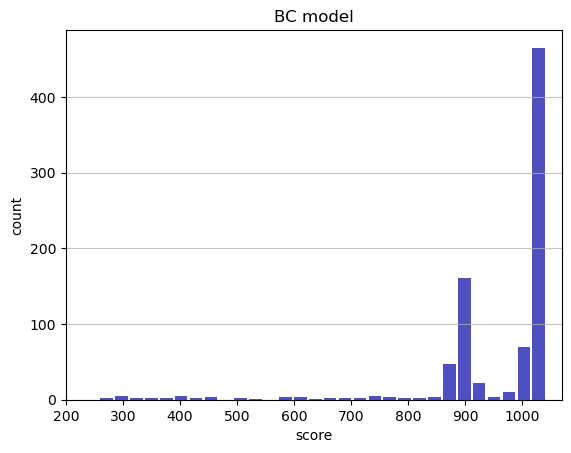

Track generation: 1034..1296 -> 262-tiles track
Epoch: 836
BC	mean: 957.17	variance: 131.27


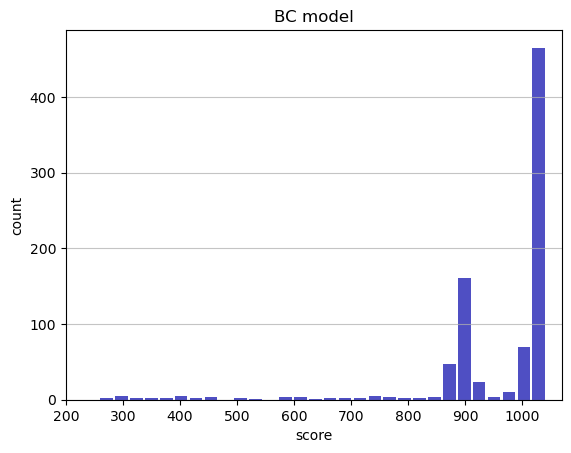

Track generation: 1040..1304 -> 264-tiles track
Epoch: 837
BC	mean: 957.11	variance: 131.20


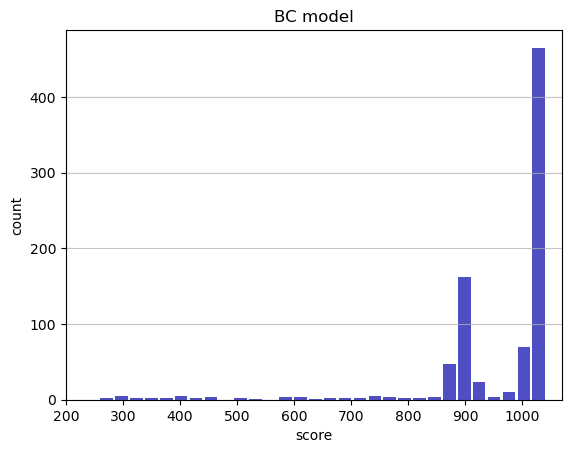

Track generation: 1080..1354 -> 274-tiles track
Epoch: 838
BC	mean: 957.20	variance: 131.15


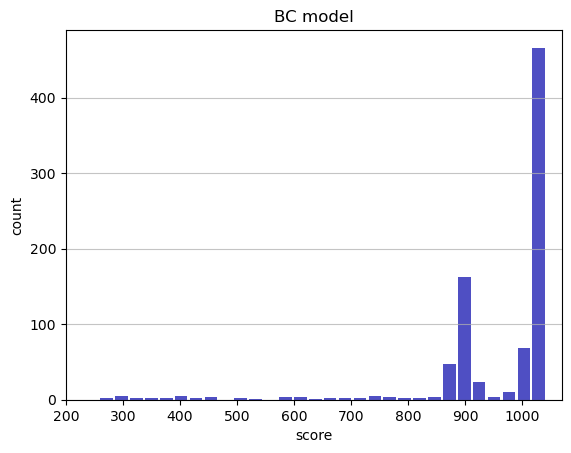

Track generation: 1129..1416 -> 287-tiles track
Epoch: 839
BC	mean: 957.28	variance: 131.10


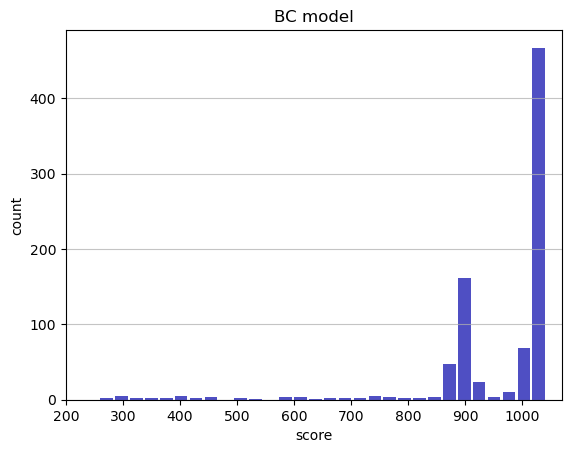

Track generation: 1134..1422 -> 288-tiles track
Epoch: 840
BC	mean: 957.37	variance: 131.04


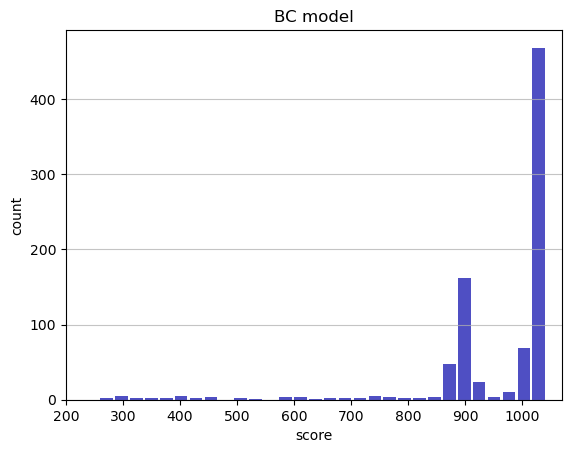

Track generation: 1320..1653 -> 333-tiles track
Epoch: 841
BC	mean: 957.44	variance: 130.98


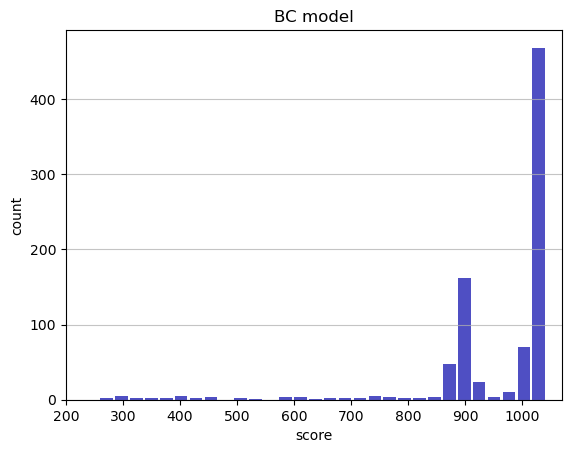

Track generation: 1340..1679 -> 339-tiles track
Epoch: 842
BC	mean: 957.36	variance: 130.92


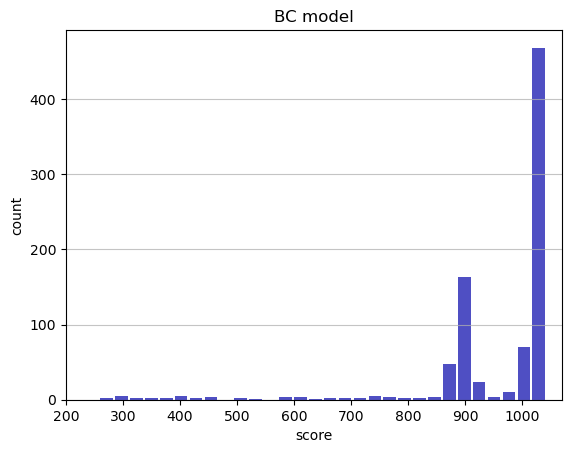

Track generation: 1177..1480 -> 303-tiles track
Epoch: 843
BC	mean: 957.28	variance: 130.86


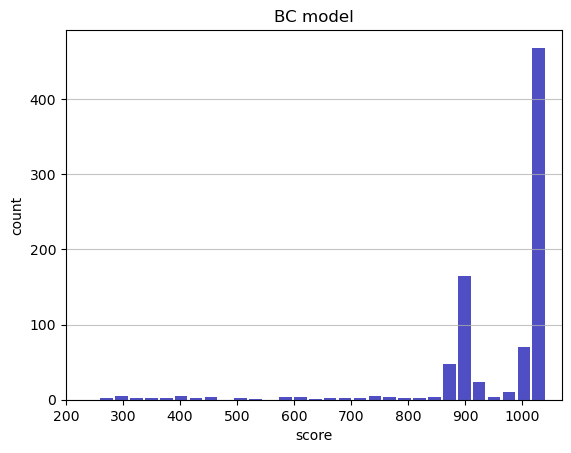

Track generation: 1141..1430 -> 289-tiles track
Epoch: 844
BC	mean: 957.37	variance: 130.81


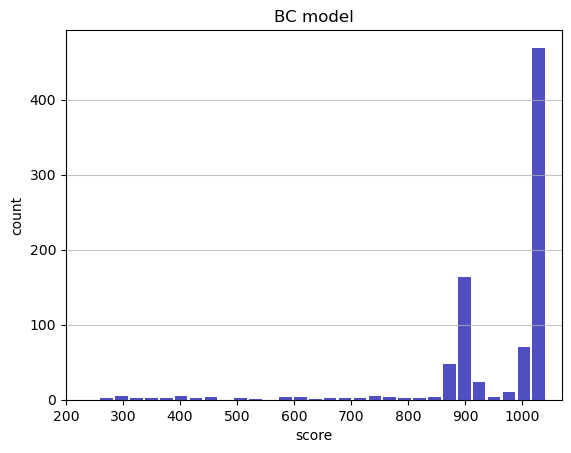

Track generation: 1191..1493 -> 302-tiles track
Epoch: 845
BC	mean: 957.31	variance: 130.74


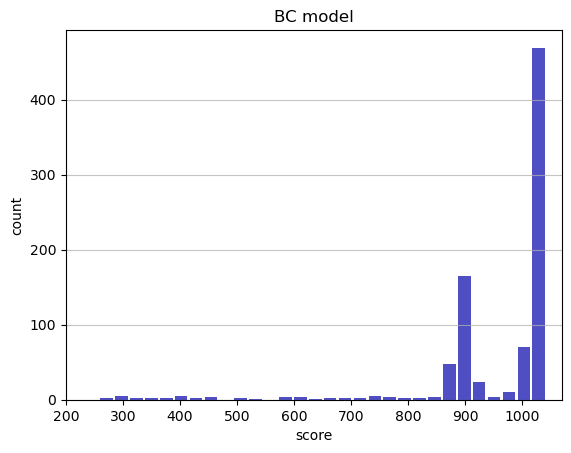

Track generation: 1151..1443 -> 292-tiles track
Epoch: 846
BC	mean: 957.39	variance: 130.68


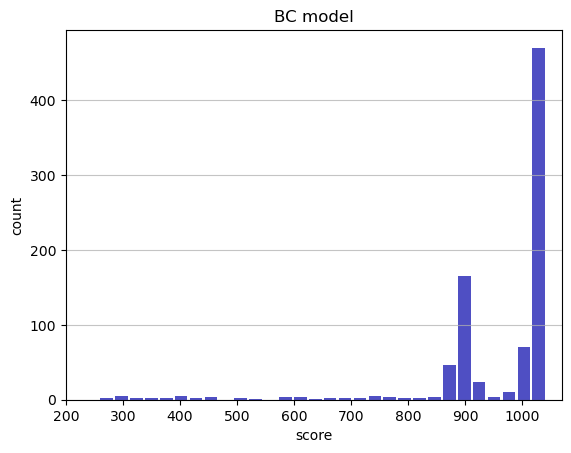

Track generation: 1222..1532 -> 310-tiles track
Epoch: 847
BC	mean: 957.46	variance: 130.62


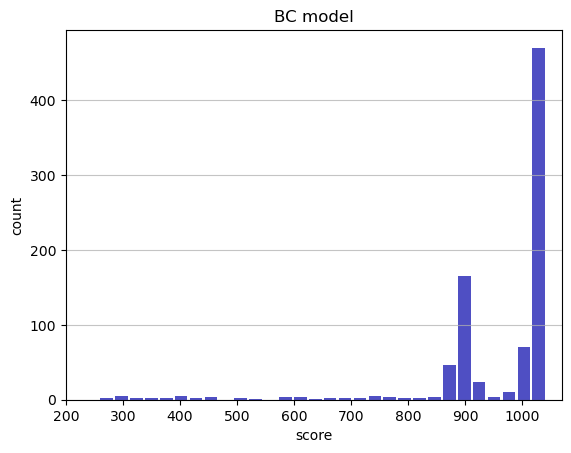

Track generation: 1087..1363 -> 276-tiles track
Epoch: 848
BC	mean: 957.56	variance: 130.57


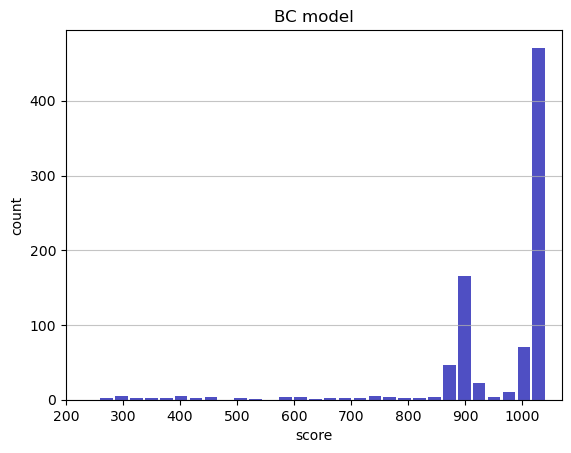

Track generation: 1181..1480 -> 299-tiles track
Epoch: 849
BC	mean: 957.63	variance: 130.52


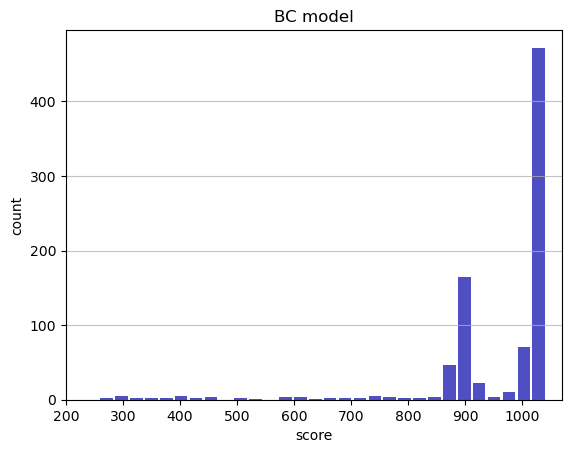

Track generation: 1204..1509 -> 305-tiles track
Epoch: 850
BC	mean: 957.71	variance: 130.46


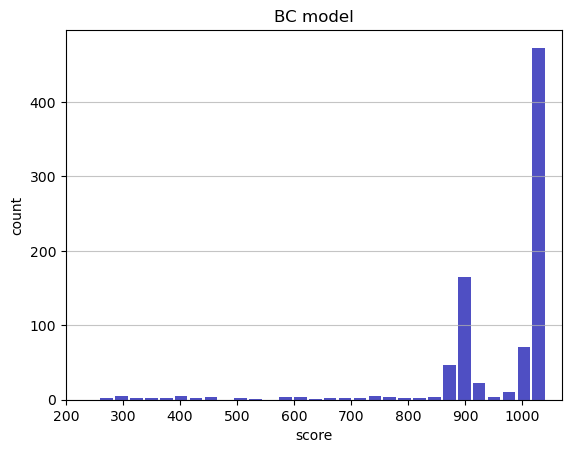

Track generation: 1203..1508 -> 305-tiles track
Epoch: 851
BC	mean: 957.78	variance: 130.40


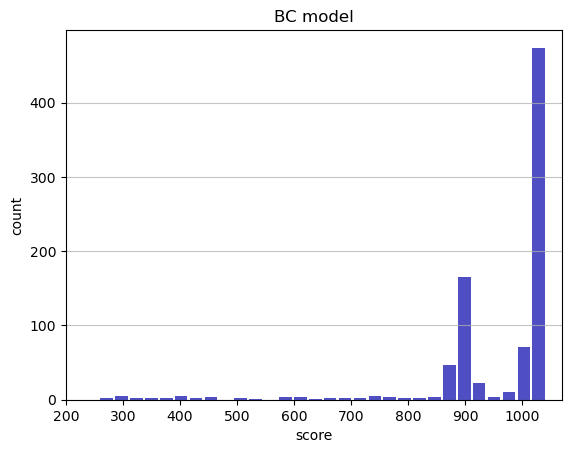

Track generation: 1193..1500 -> 307-tiles track
Epoch: 852
BC	mean: 957.85	variance: 130.34


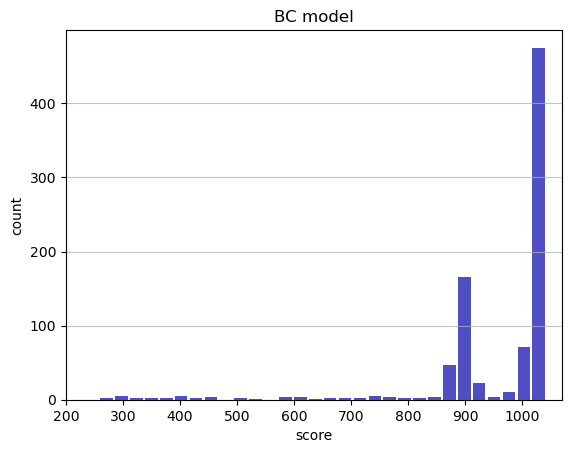

Track generation: 1045..1310 -> 265-tiles track
Epoch: 853
BC	mean: 957.94	variance: 130.29


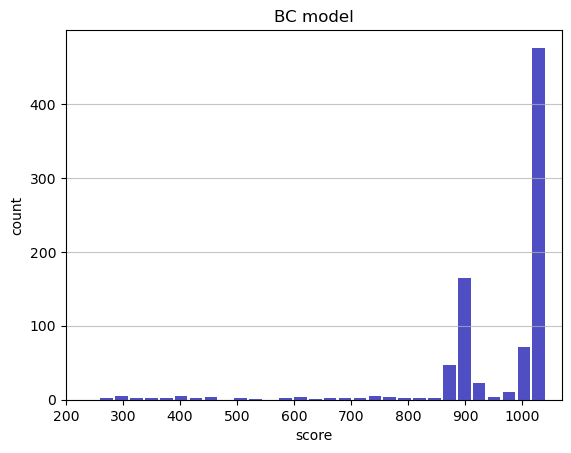

Track generation: 1128..1414 -> 286-tiles track
Epoch: 854
BC	mean: 958.02	variance: 130.23


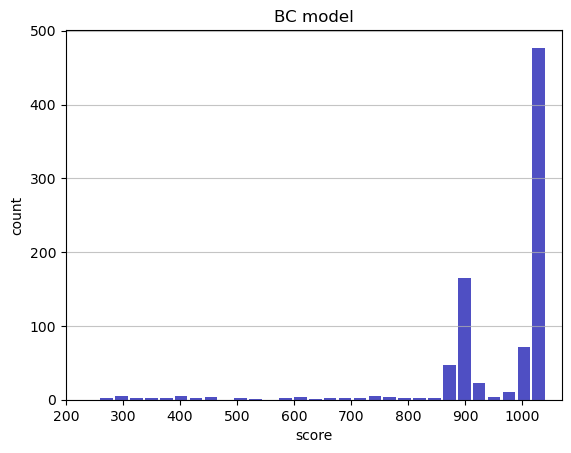

Track generation: 1282..1606 -> 324-tiles track
Epoch: 855
BC	mean: 958.09	variance: 130.17


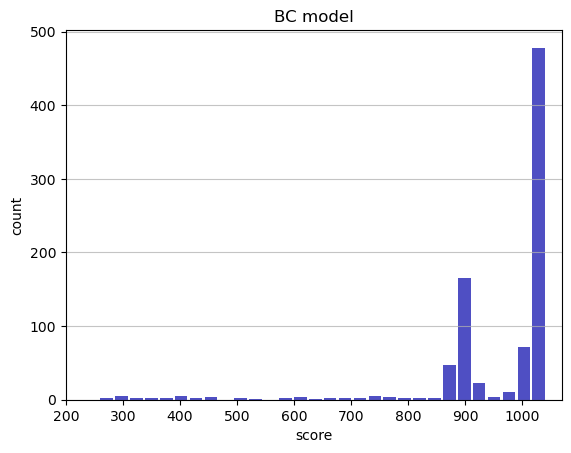

Track generation: 1220..1531 -> 311-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1100..1379 -> 279-tiles track
Epoch: 856
BC	mean: 958.18	variance: 130.12


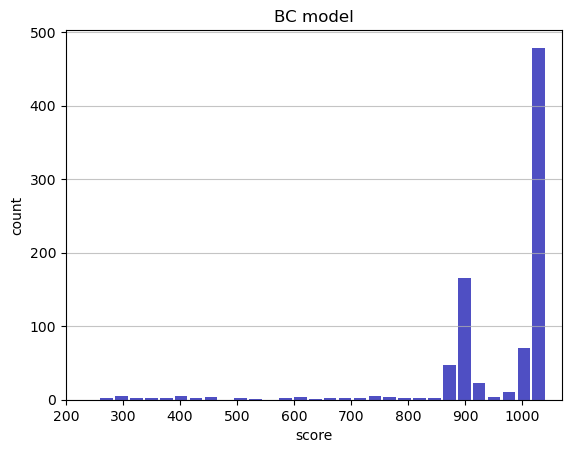

Track generation: 1327..1663 -> 336-tiles track
Epoch: 857
BC	mean: 958.24	variance: 130.06


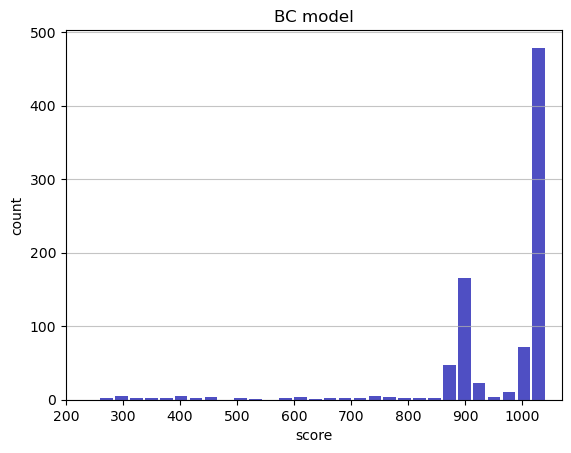

Track generation: 1292..1619 -> 327-tiles track
Epoch: 858
BC	mean: 958.31	variance: 130.00


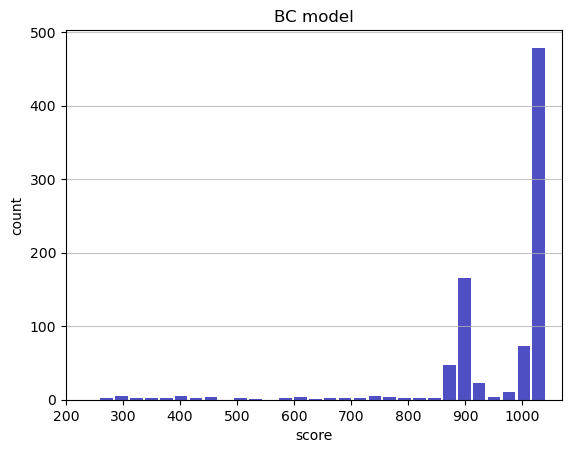

Track generation: 1192..1494 -> 302-tiles track
Epoch: 859
BC	mean: 958.20	variance: 129.96


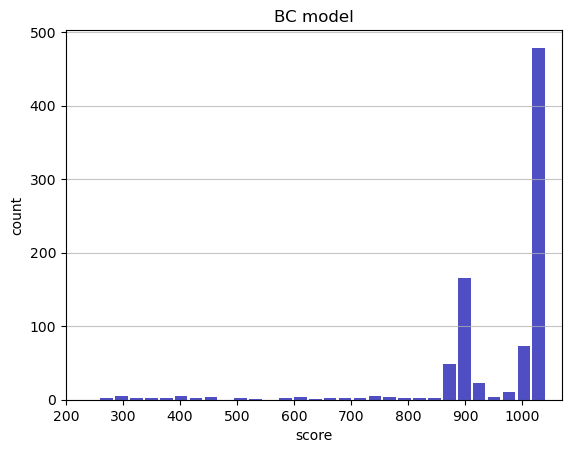

Track generation: 1082..1366 -> 284-tiles track
Epoch: 860
BC	mean: 958.28	variance: 129.90


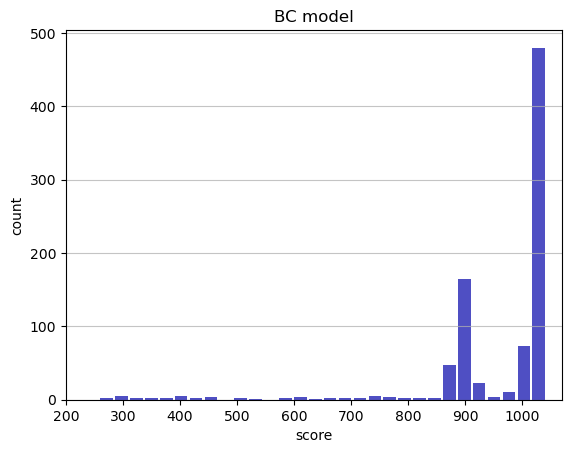

Track generation: 1235..1548 -> 313-tiles track
Epoch: 861
BC	mean: 958.35	variance: 129.84


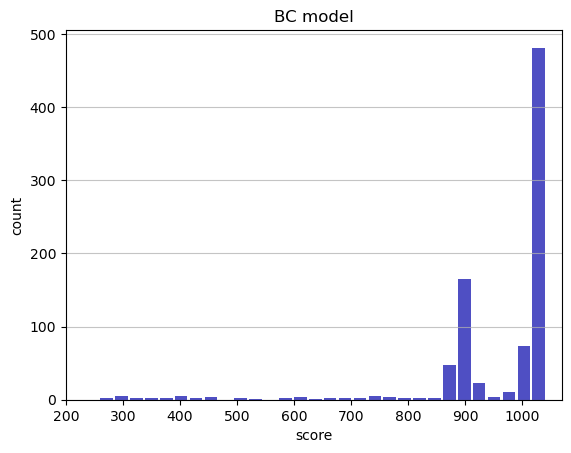

Track generation: 1148..1439 -> 291-tiles track
Epoch: 862
BC	mean: 957.90	variance: 130.43


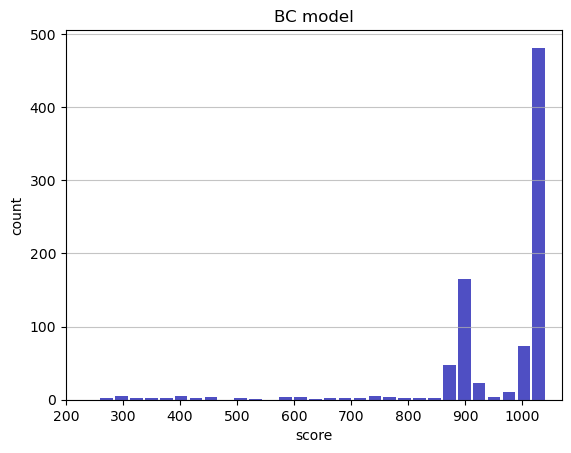

Track generation: 1151..1443 -> 292-tiles track
Epoch: 863
BC	mean: 957.99	variance: 130.38


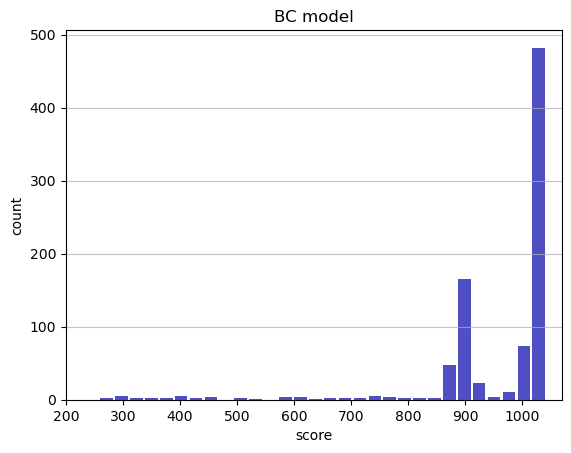

Track generation: 1203..1509 -> 306-tiles track
Epoch: 864
BC	mean: 958.06	variance: 130.32


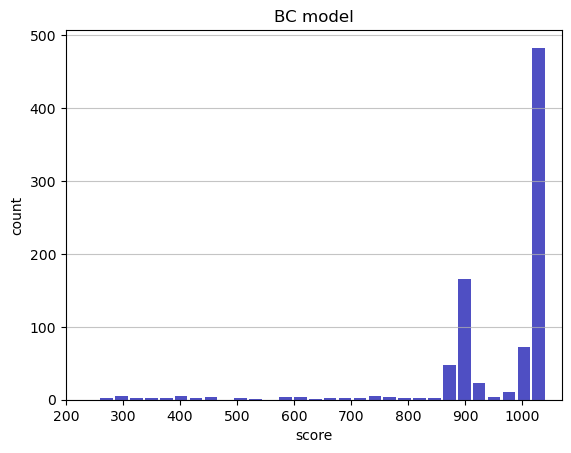

Track generation: 1125..1410 -> 285-tiles track
Epoch: 865
BC	mean: 958.15	variance: 130.27


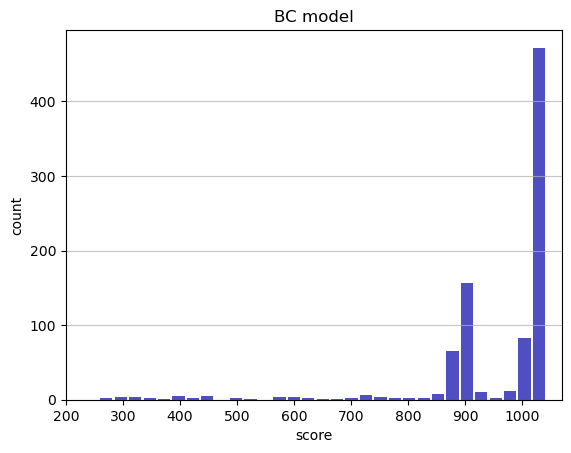

Track generation: 1006..1262 -> 256-tiles track
Epoch: 866
BC	mean: 958.09	variance: 130.21


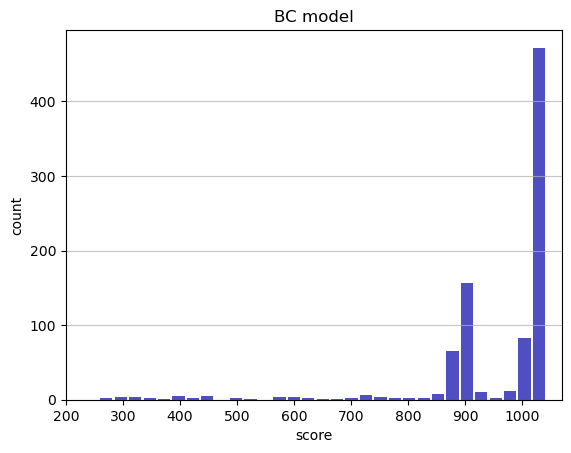

Track generation: 1211..1518 -> 307-tiles track
Epoch: 867
BC	mean: 957.99	variance: 130.16


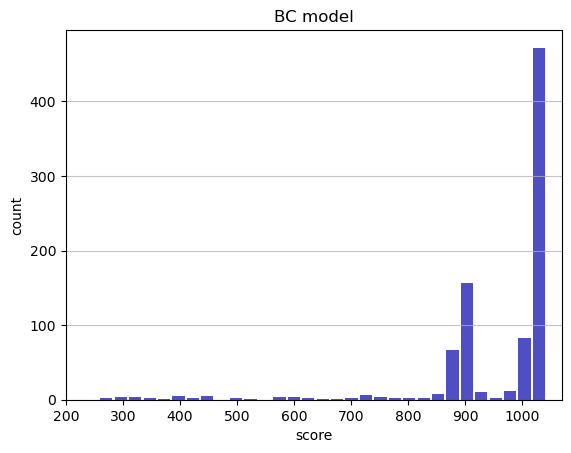

Track generation: 1327..1662 -> 335-tiles track
Epoch: 868
BC	mean: 958.05	variance: 130.10


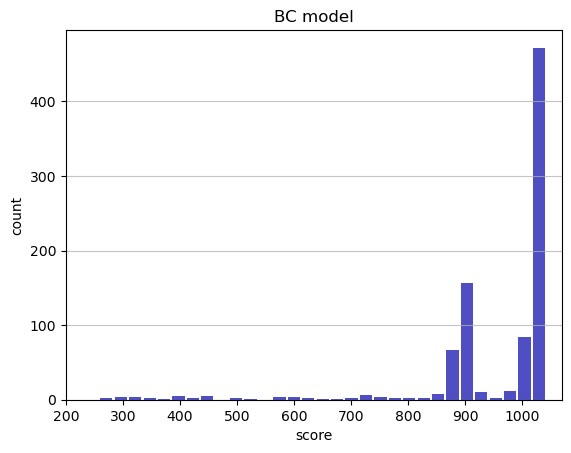

Track generation: 1219..1528 -> 309-tiles track
Epoch: 869
BC	mean: 958.13	variance: 130.05


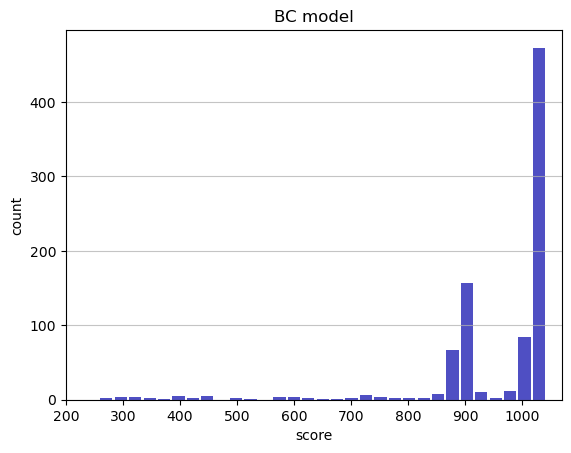

Track generation: 1068..1339 -> 271-tiles track
Epoch: 870
BC	mean: 958.21	variance: 130.00


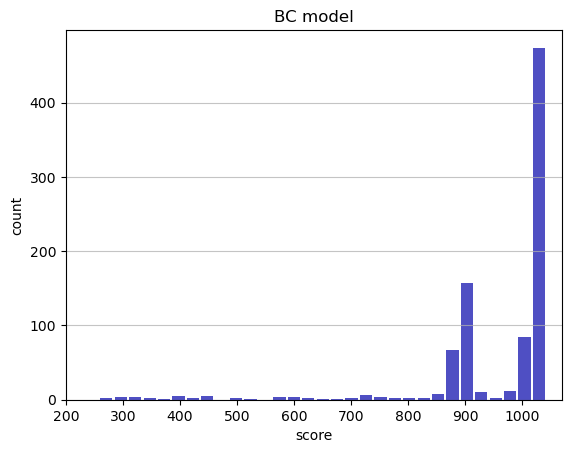

Track generation: 1169..1465 -> 296-tiles track
Epoch: 871
BC	mean: 958.15	variance: 129.94


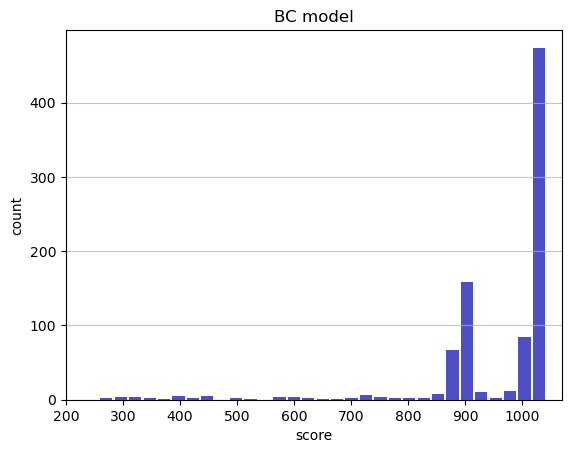

Track generation: 1119..1405 -> 286-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1055..1323 -> 268-tiles track
Epoch: 872
BC	mean: 958.23	variance: 129.89


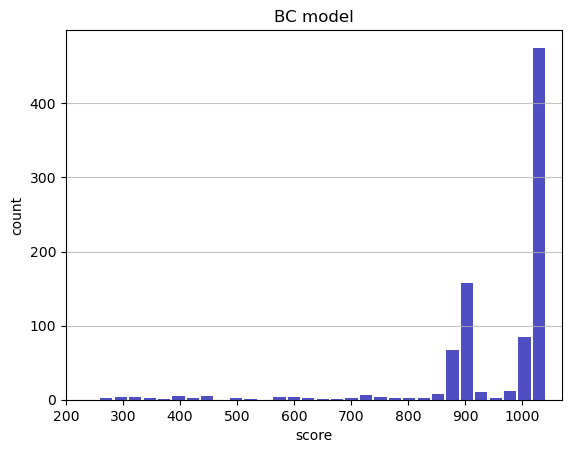

Track generation: 1140..1429 -> 289-tiles track
Epoch: 873
BC	mean: 958.31	variance: 129.83


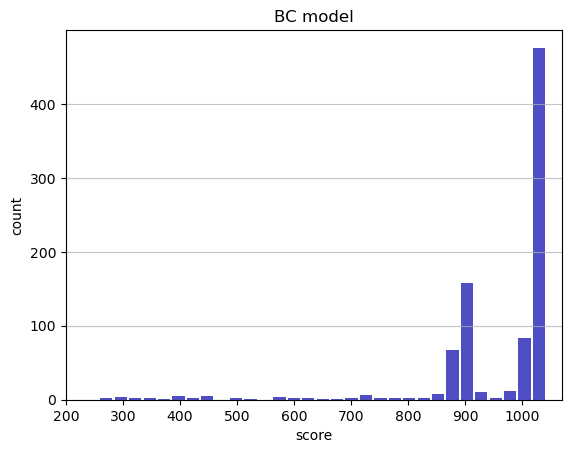

Track generation: 1183..1484 -> 301-tiles track
Epoch: 874
BC	mean: 958.39	variance: 129.78


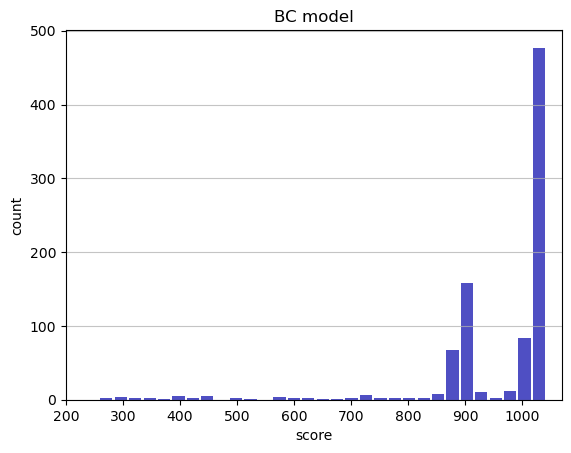

Track generation: 1024..1283 -> 259-tiles track
Epoch: 875
BC	mean: 958.47	variance: 129.73


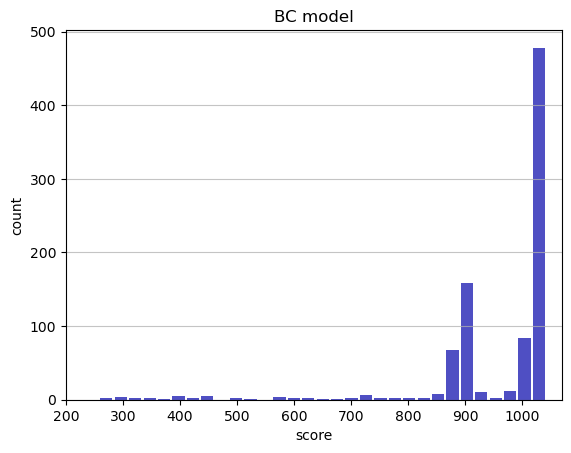

Track generation: 1208..1514 -> 306-tiles track
Epoch: 876
BC	mean: 958.54	variance: 129.67


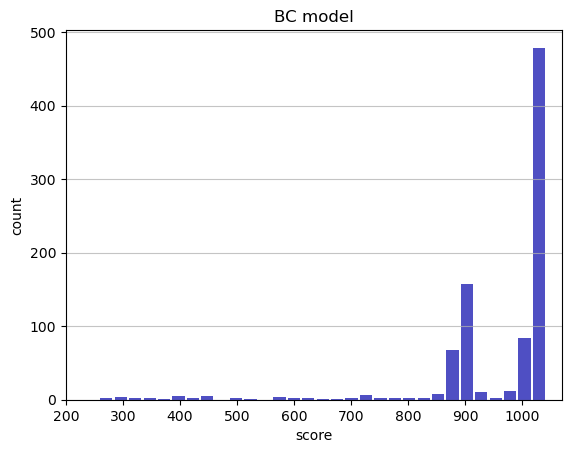

Track generation: 1182..1488 -> 306-tiles track
Epoch: 877
BC	mean: 958.61	variance: 129.61


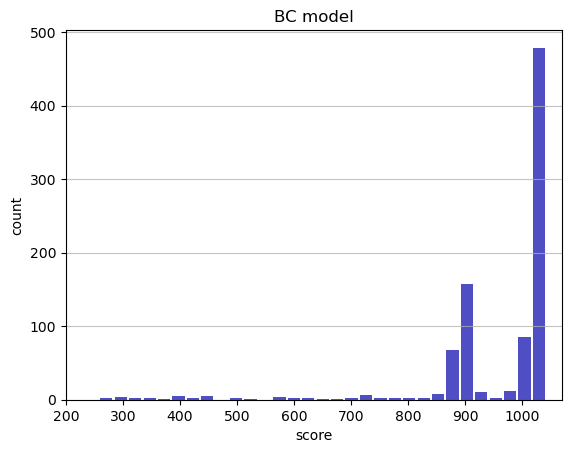

Track generation: 995..1251 -> 256-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1123..1408 -> 285-tiles track
Epoch: 878
BC	mean: 958.69	variance: 129.56


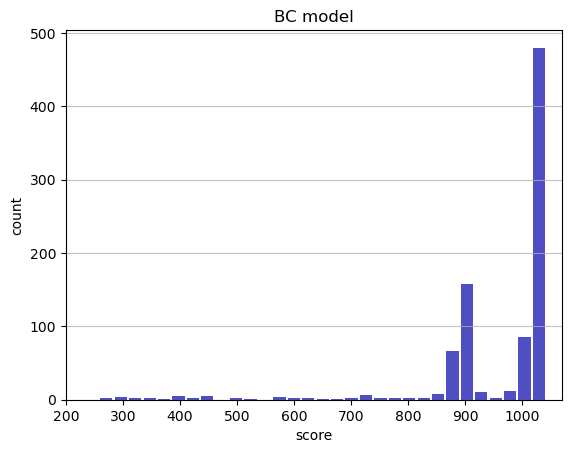

Track generation: 1128..1414 -> 286-tiles track
Epoch: 879
BC	mean: 958.77	variance: 129.51


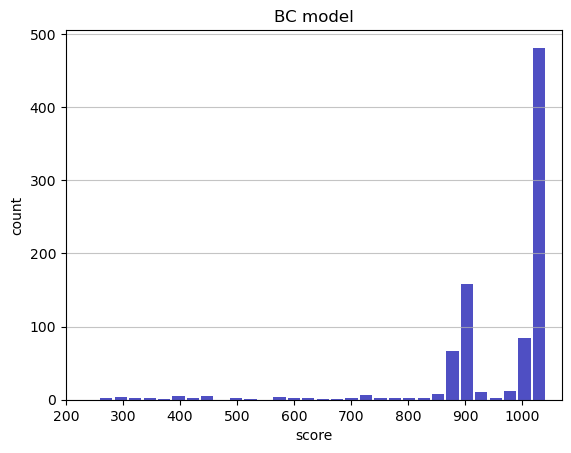

Track generation: 1173..1470 -> 297-tiles track
Epoch: 880
BC	mean: 958.85	variance: 129.46


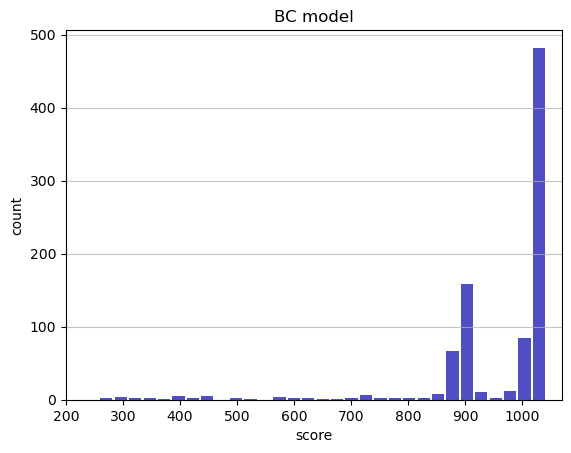

Track generation: 1107..1388 -> 281-tiles track
Epoch: 881
BC	mean: 958.93	variance: 129.40


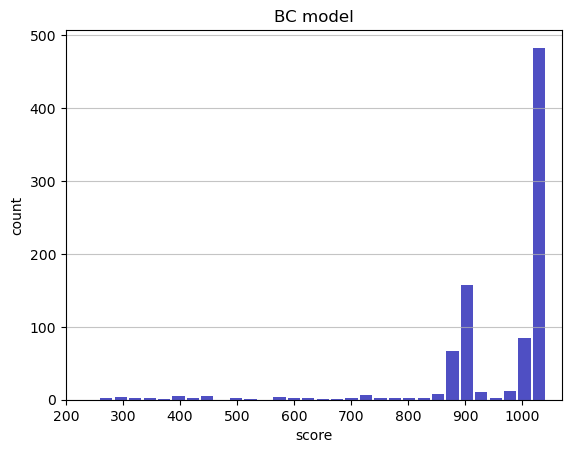

Track generation: 1128..1414 -> 286-tiles track
Epoch: 882
BC	mean: 958.86	variance: 129.34


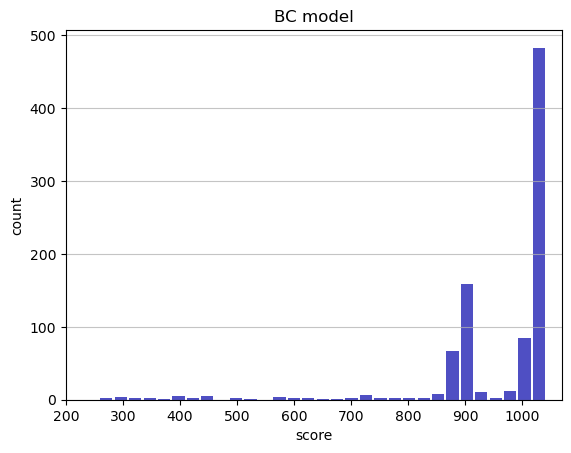

Track generation: 1166..1461 -> 295-tiles track
Epoch: 883
BC	mean: 958.94	variance: 129.29


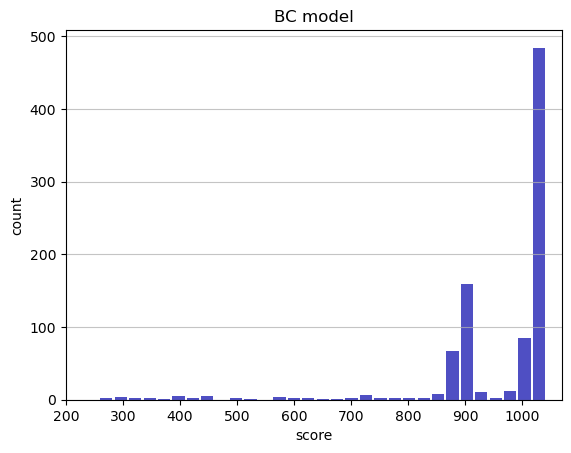

Track generation: 1207..1513 -> 306-tiles track
Epoch: 884
BC	mean: 959.02	variance: 129.24


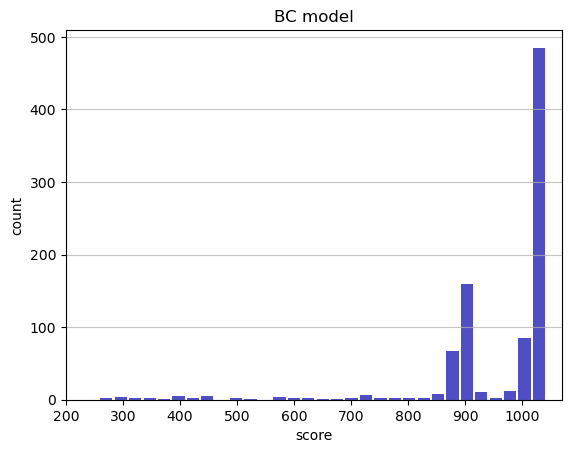

Track generation: 1126..1421 -> 295-tiles track
Epoch: 885
BC	mean: 959.09	variance: 129.18


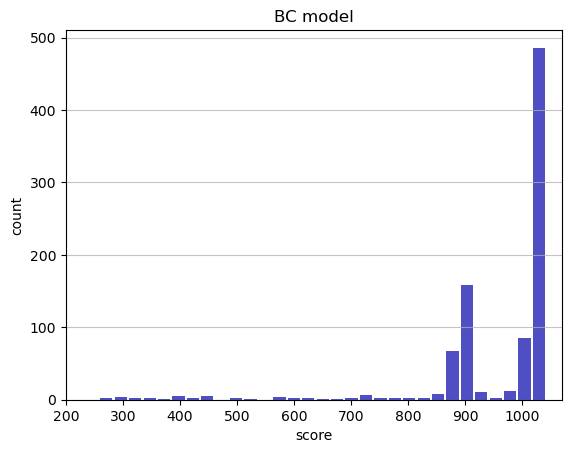

Track generation: 971..1218 -> 247-tiles track
Epoch: 886
BC	mean: 959.01	variance: 129.13


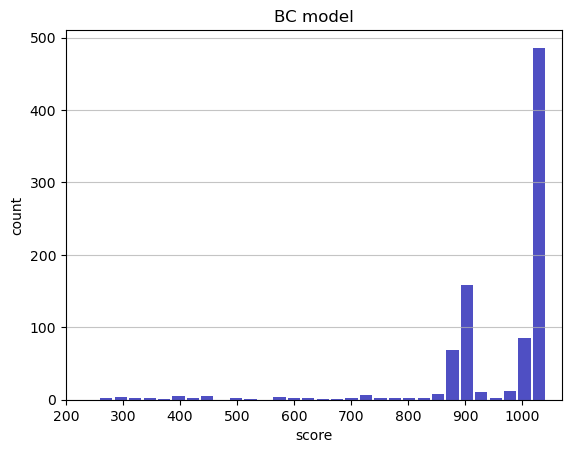

Track generation: 1243..1558 -> 315-tiles track
Epoch: 887
BC	mean: 958.95	variance: 129.07


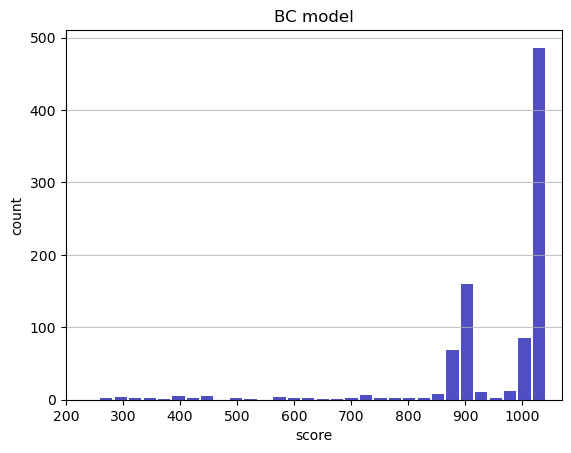

Track generation: 1209..1515 -> 306-tiles track
Epoch: 888
BC	mean: 958.87	variance: 129.02


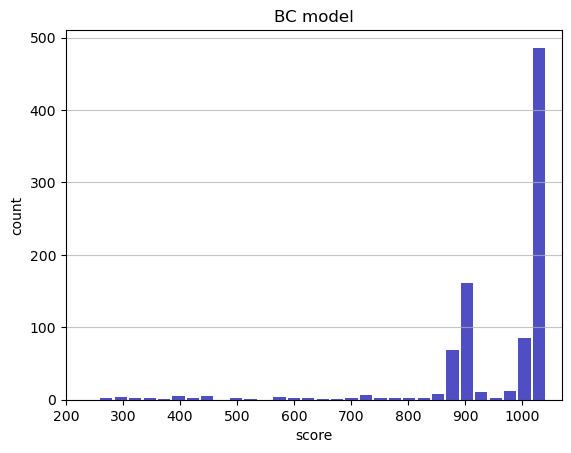

Track generation: 1176..1484 -> 308-tiles track
Epoch: 889
BC	mean: 958.81	variance: 128.96


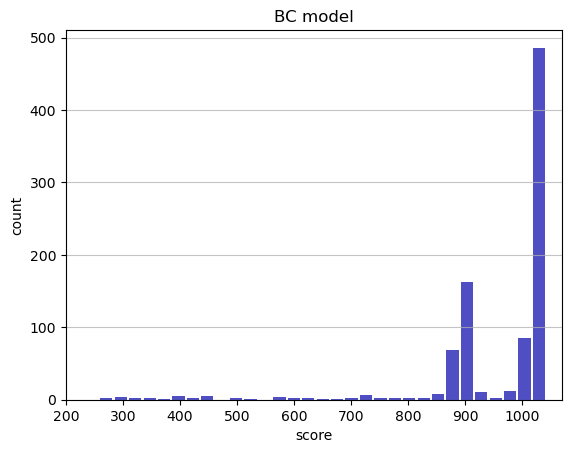

Track generation: 1092..1369 -> 277-tiles track
Epoch: 890
BC	mean: 958.75	variance: 128.90


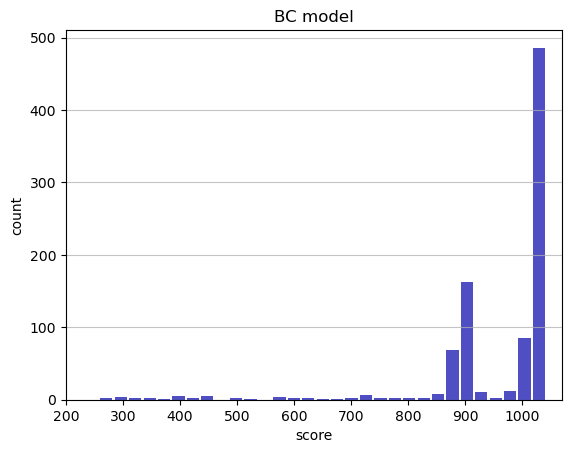

Track generation: 1066..1343 -> 277-tiles track
Epoch: 891
BC	mean: 958.83	variance: 128.85


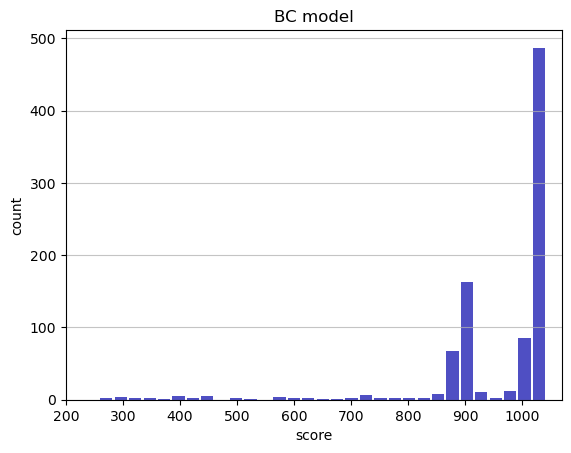

Track generation: 1083..1358 -> 275-tiles track
Epoch: 892
BC	mean: 958.91	variance: 128.80


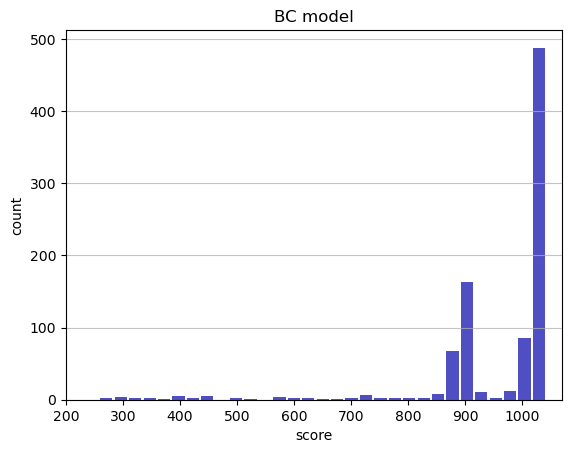

Track generation: 1181..1480 -> 299-tiles track
Epoch: 893
BC	mean: 958.84	variance: 128.74


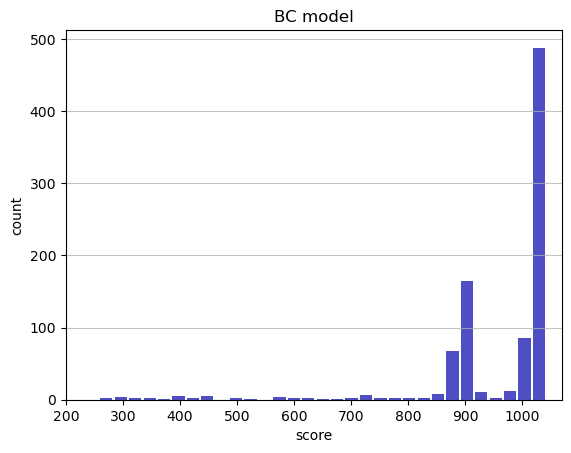

Track generation: 1155..1448 -> 293-tiles track
Epoch: 894
BC	mean: 958.92	variance: 128.69


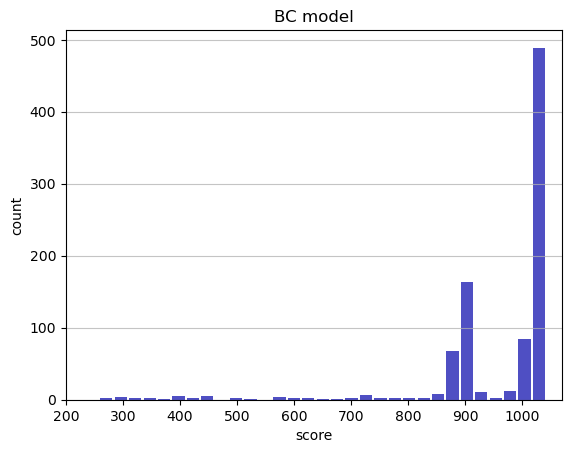

Track generation: 1234..1546 -> 312-tiles track
Epoch: 895
BC	mean: 958.98	variance: 128.64


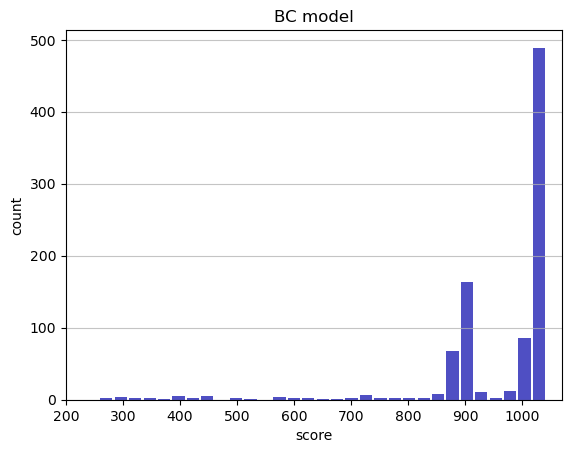

Track generation: 1194..1496 -> 302-tiles track
Epoch: 896
BC	mean: 959.05	variance: 128.58


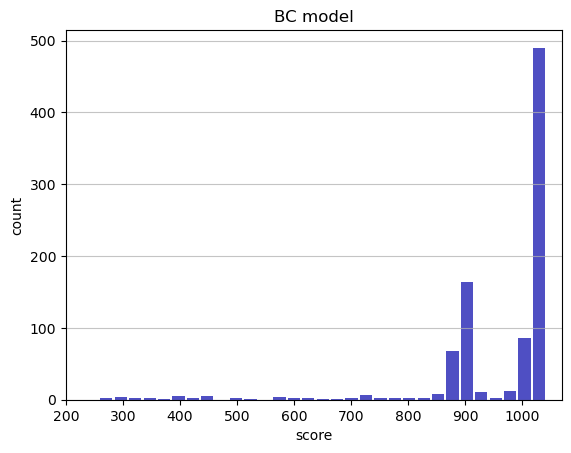

Track generation: 1211..1518 -> 307-tiles track
Epoch: 897
BC	mean: 959.12	variance: 128.53


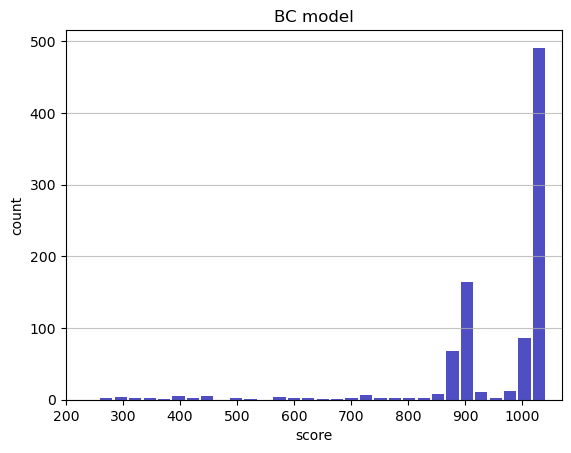

Track generation: 1166..1462 -> 296-tiles track
Epoch: 898
BC	mean: 959.06	variance: 128.47


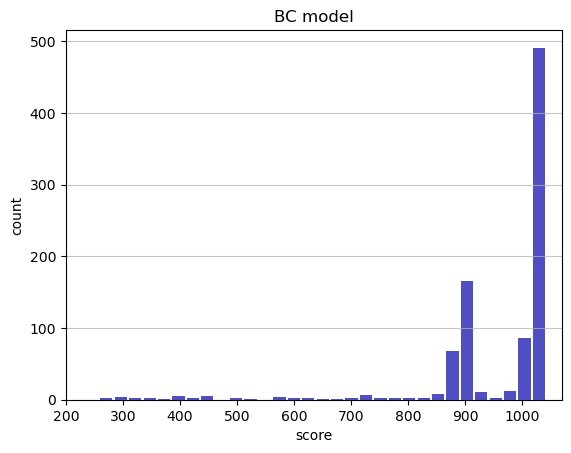

Track generation: 1121..1405 -> 284-tiles track
Epoch: 899
BC	mean: 959.14	variance: 128.42


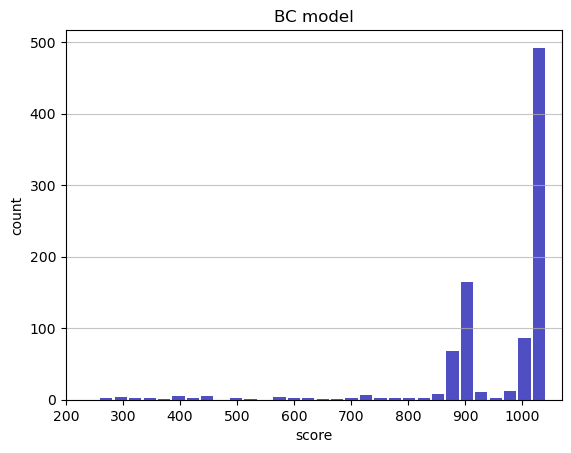

Track generation: 1226..1539 -> 313-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1283..1608 -> 325-tiles track
Epoch: 900
BC	mean: 959.20	variance: 128.36


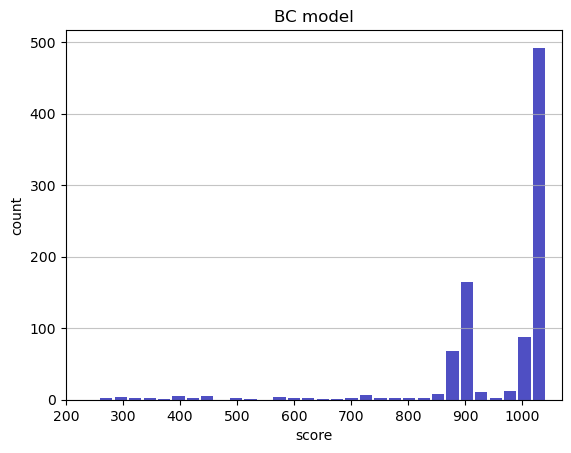

Track generation: 1132..1419 -> 287-tiles track
Epoch: 901
BC	mean: 959.15	variance: 128.30


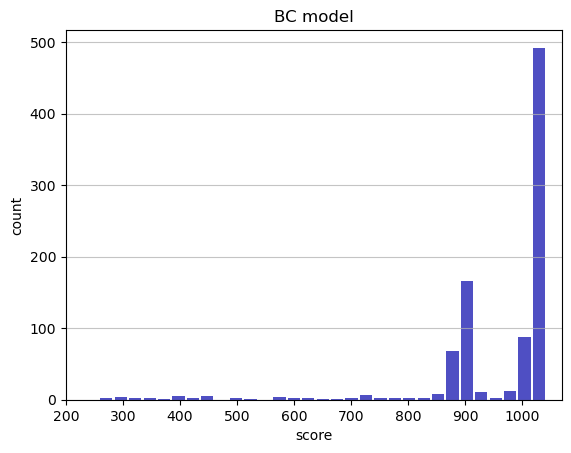

Track generation: 944..1184 -> 240-tiles track
Epoch: 902
BC	mean: 959.25	variance: 128.26


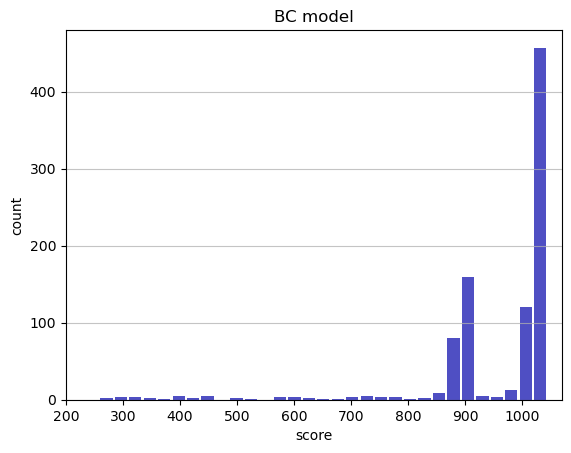

Track generation: 1077..1352 -> 275-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1269..1590 -> 321-tiles track
Epoch: 903
BC	mean: 959.31	variance: 128.21


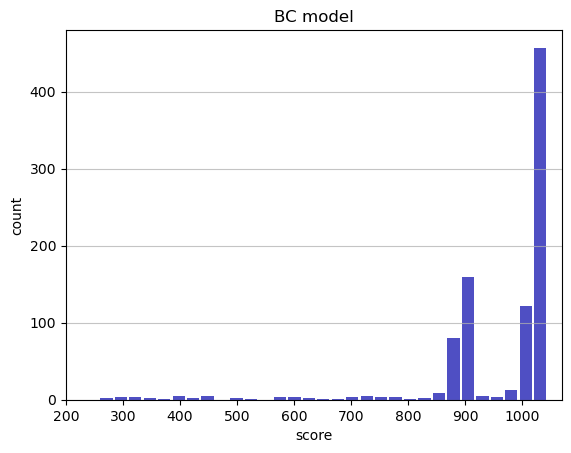

Track generation: 1004..1268 -> 264-tiles track
Epoch: 904
BC	mean: 959.38	variance: 128.15


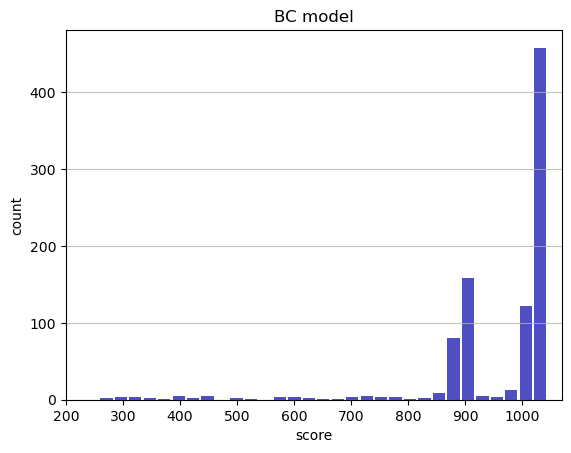

Track generation: 1136..1431 -> 295-tiles track
Epoch: 905
BC	mean: 959.45	variance: 128.10


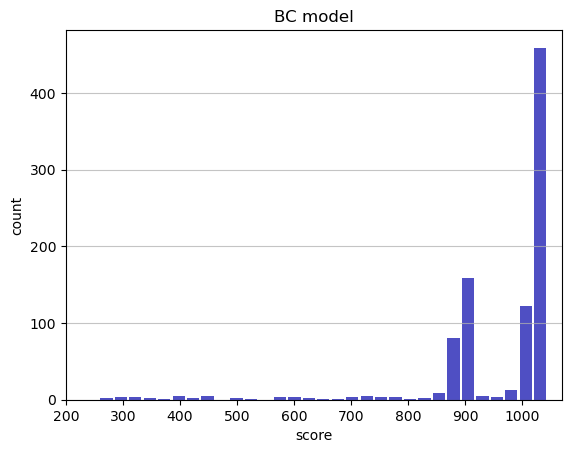

Track generation: 1196..1499 -> 303-tiles track
Epoch: 906
BC	mean: 959.52	variance: 128.05


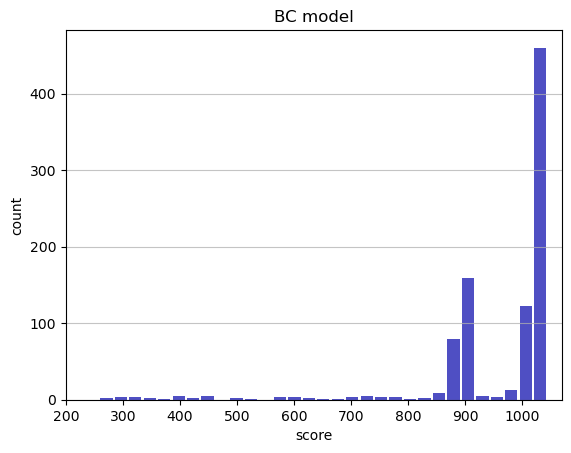

Track generation: 1141..1430 -> 289-tiles track
Epoch: 907
BC	mean: 959.46	variance: 127.99


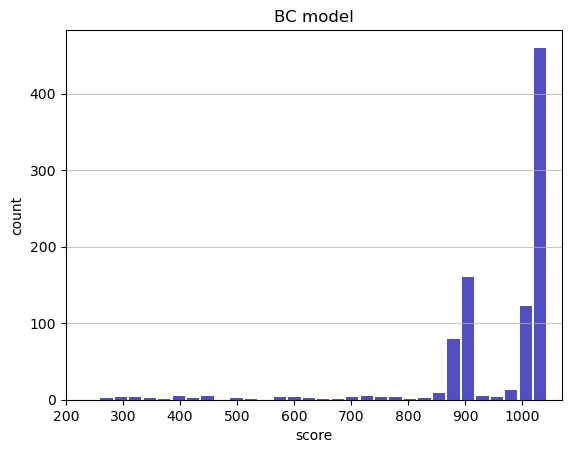

Track generation: 1085..1361 -> 276-tiles track
Epoch: 908
BC	mean: 959.54	variance: 127.94


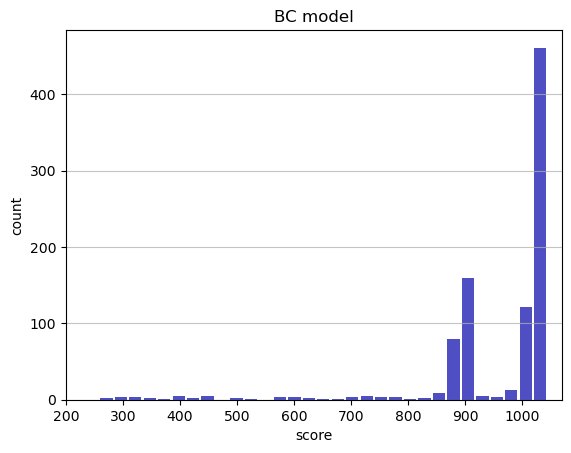

Track generation: 1196..1499 -> 303-tiles track
Epoch: 909
BC	mean: 959.60	variance: 127.88


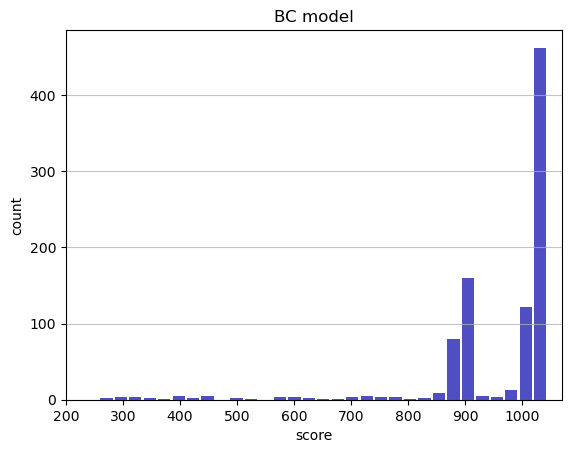

Track generation: 1155..1448 -> 293-tiles track
Epoch: 910
BC	mean: 959.69	variance: 127.84


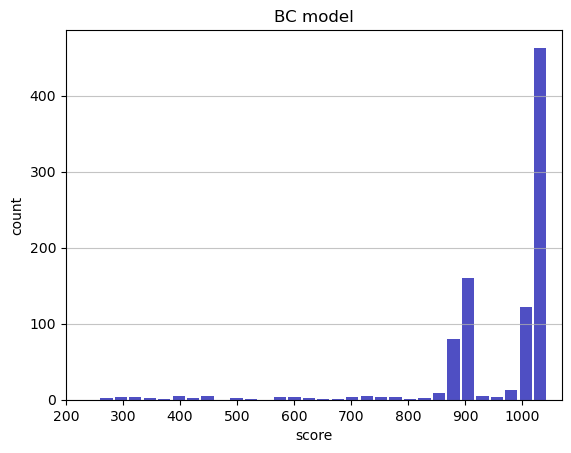

Track generation: 1143..1433 -> 290-tiles track
Epoch: 911
BC	mean: 959.76	variance: 127.79


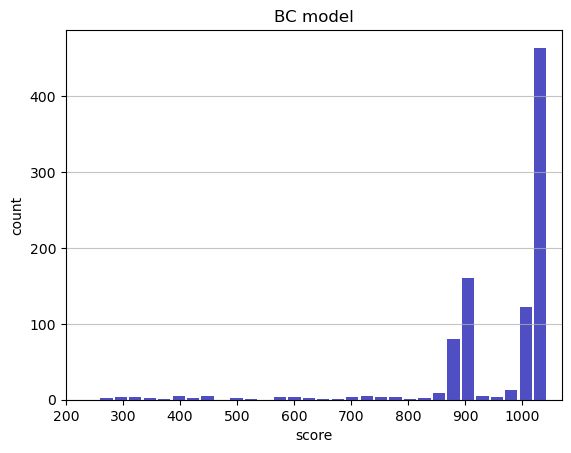

Track generation: 1044..1309 -> 265-tiles track
Epoch: 912
BC	mean: 959.84	variance: 127.74


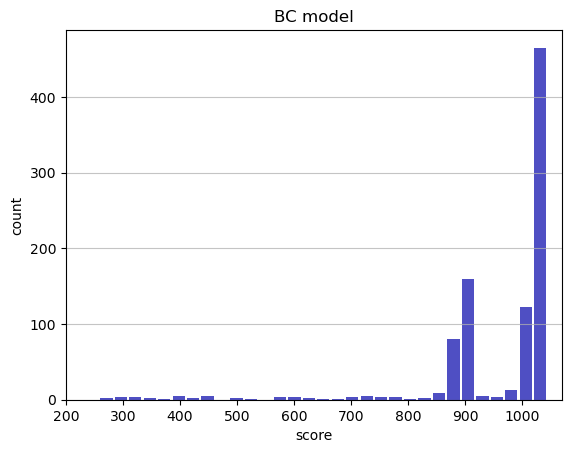

Track generation: 1244..1559 -> 315-tiles track
Epoch: 913
BC	mean: 959.90	variance: 127.69


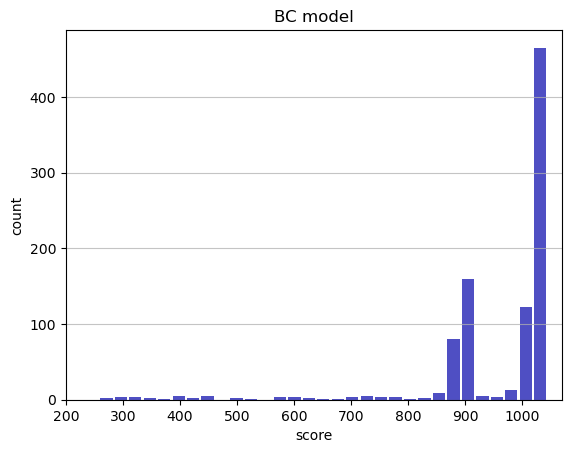

Track generation: 1090..1369 -> 279-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1162..1457 -> 295-tiles track
Epoch: 914
BC	mean: 959.97	variance: 127.63


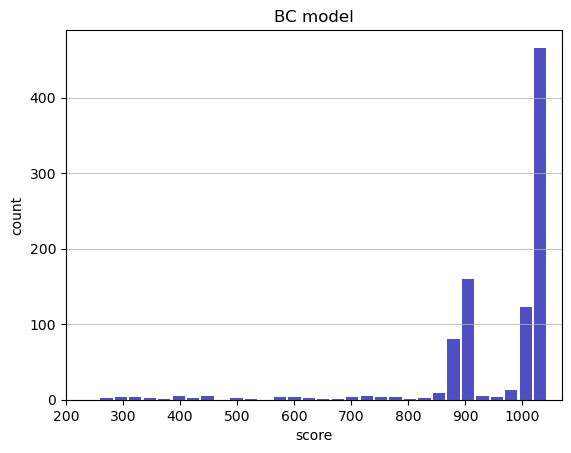

Track generation: 1180..1479 -> 299-tiles track
Epoch: 915
BC	mean: 959.89	variance: 127.59


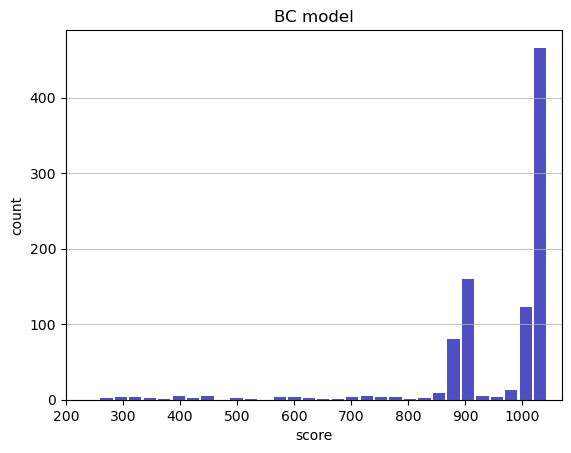

Track generation: 1111..1399 -> 288-tiles track
Epoch: 916
BC	mean: 959.96	variance: 127.54


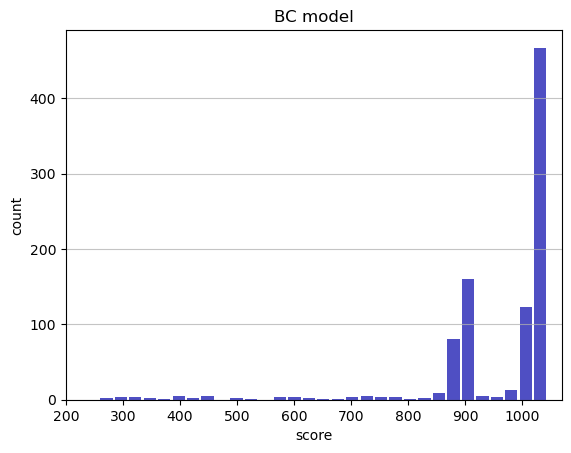

Track generation: 1236..1549 -> 313-tiles track
Epoch: 917
BC	mean: 960.03	variance: 127.49


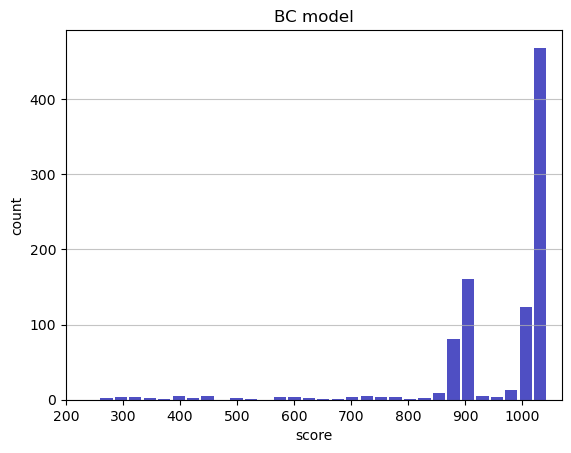

Track generation: 1062..1330 -> 268-tiles track
Epoch: 918
BC	mean: 960.11	variance: 127.44


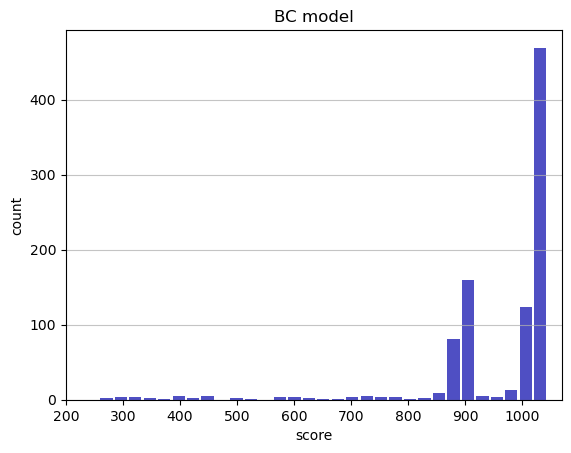

Track generation: 1332..1669 -> 337-tiles track
Epoch: 919
BC	mean: 960.16	variance: 127.38


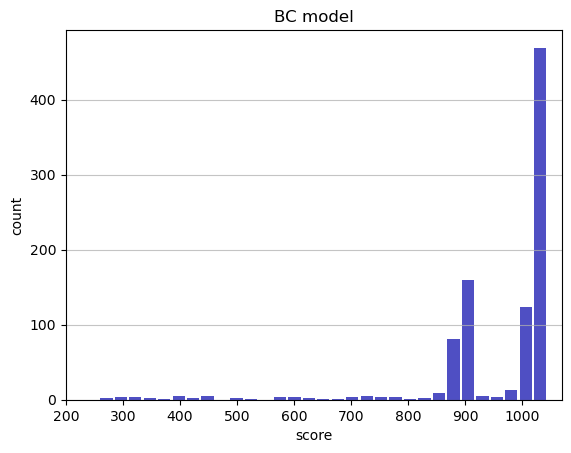

Track generation: 975..1223 -> 248-tiles track
Epoch: 920
BC	mean: 960.24	variance: 127.33


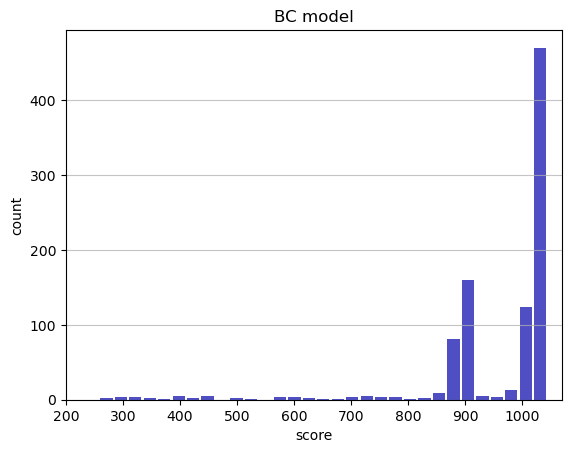

Track generation: 1023..1283 -> 260-tiles track
Epoch: 921
BC	mean: 960.32	variance: 127.29


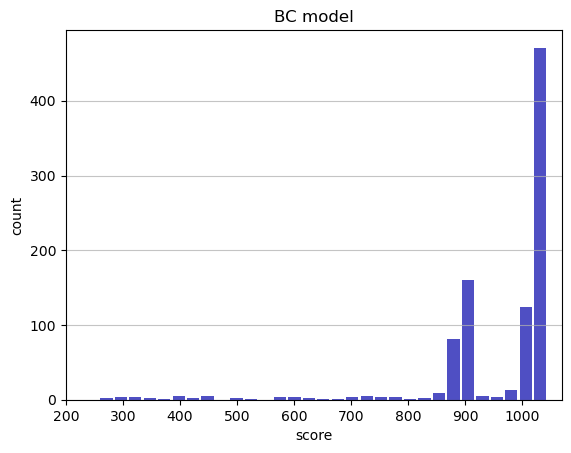

Track generation: 1091..1368 -> 277-tiles track
Epoch: 922
BC	mean: 960.39	variance: 127.24


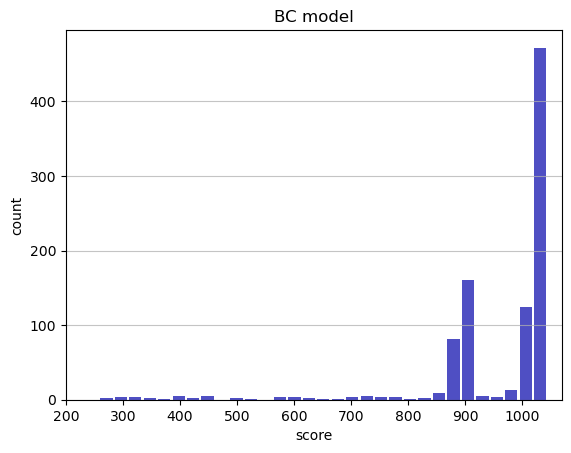

Track generation: 1124..1409 -> 285-tiles track
Epoch: 923
BC	mean: 960.47	variance: 127.19


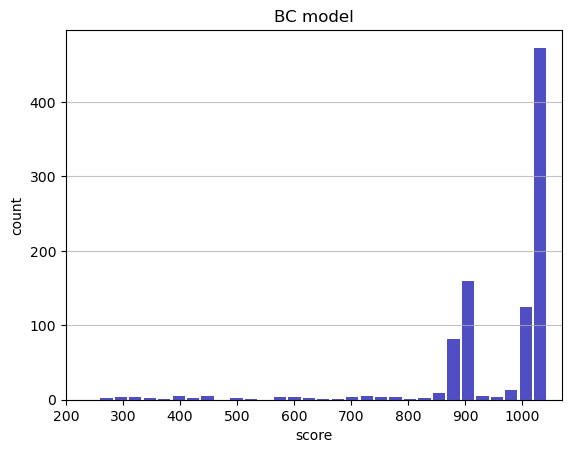

Track generation: 1147..1438 -> 291-tiles track
Epoch: 924
BC	mean: 960.54	variance: 127.14


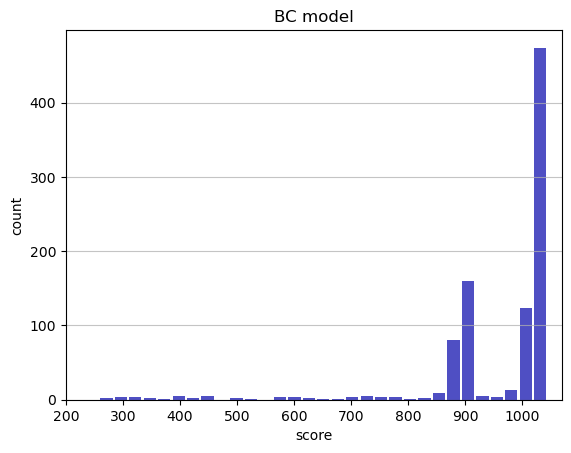

Track generation: 1039..1303 -> 264-tiles track
Epoch: 925
BC	mean: 960.48	variance: 127.08


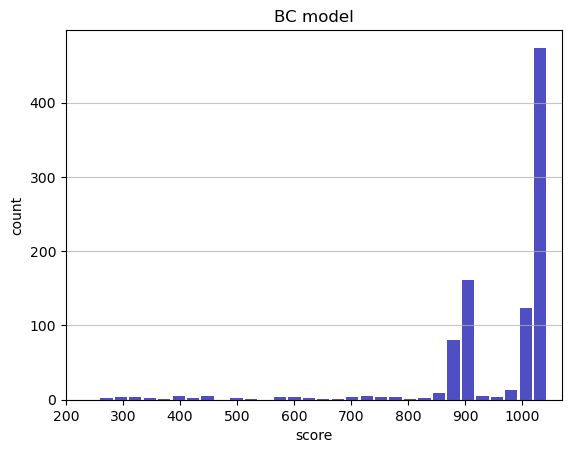

Track generation: 1188..1489 -> 301-tiles track
Epoch: 926
BC	mean: 960.55	variance: 127.03


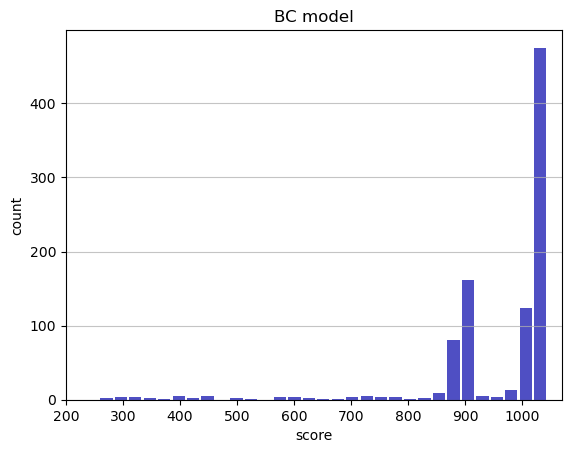

Track generation: 1084..1359 -> 275-tiles track
Epoch: 927
BC	mean: 960.50	variance: 126.97


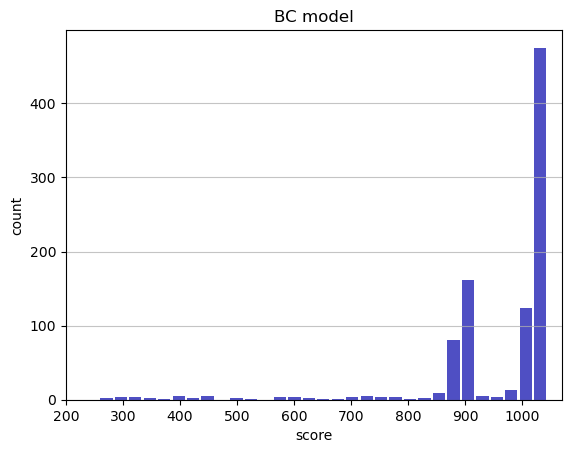

Track generation: 1047..1313 -> 266-tiles track
Epoch: 928
BC	mean: 960.59	variance: 126.93


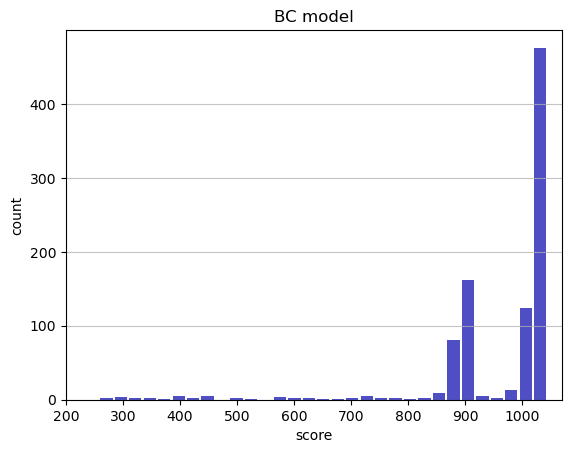

Track generation: 1161..1460 -> 299-tiles track
Epoch: 929
BC	mean: 960.65	variance: 126.87


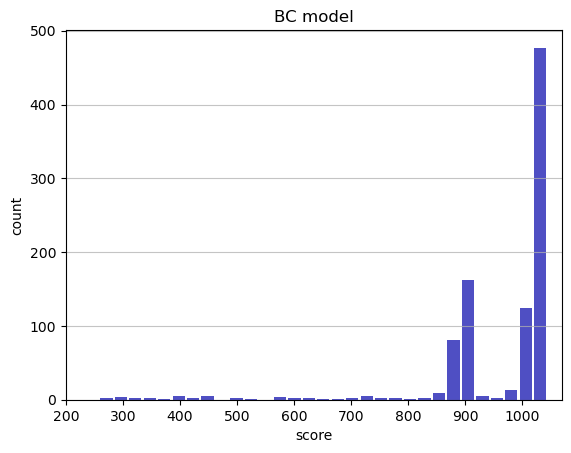

Track generation: 1119..1403 -> 284-tiles track
Epoch: 930
BC	mean: 960.57	variance: 126.83


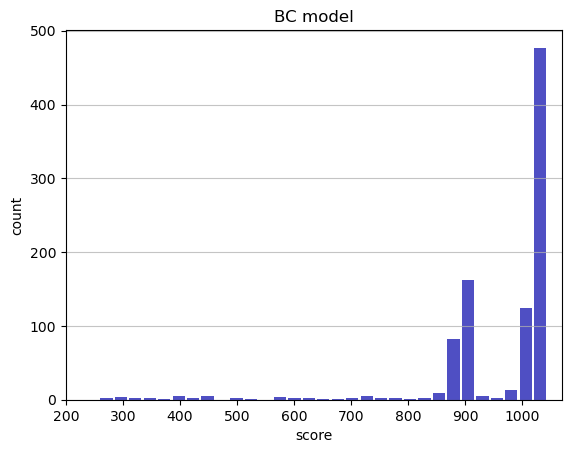

Track generation: 1173..1470 -> 297-tiles track
Epoch: 931
BC	mean: 960.50	variance: 126.78


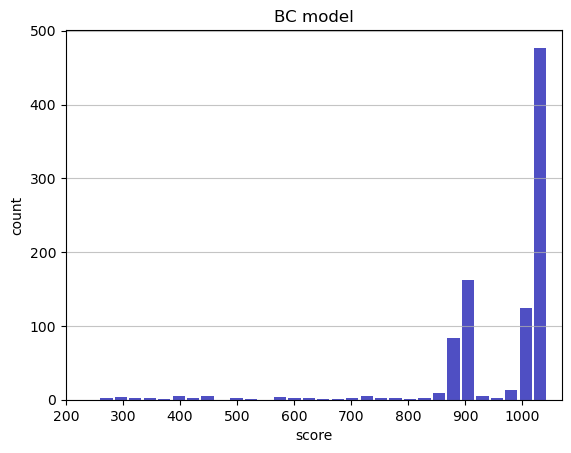

Track generation: 1111..1393 -> 282-tiles track
Epoch: 932
BC	mean: 960.57	variance: 126.74


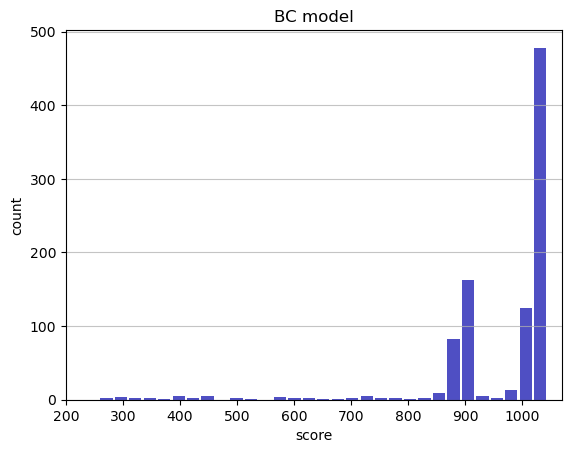

Track generation: 1019..1278 -> 259-tiles track
Epoch: 933
BC	mean: 960.65	variance: 126.69


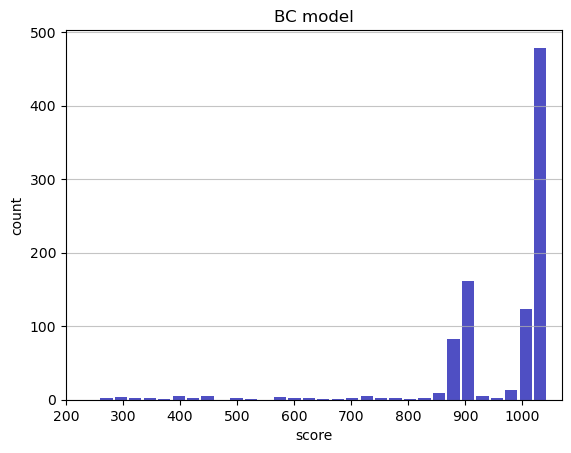

Track generation: 1228..1539 -> 311-tiles track
Epoch: 934
BC	mean: 960.59	variance: 126.64


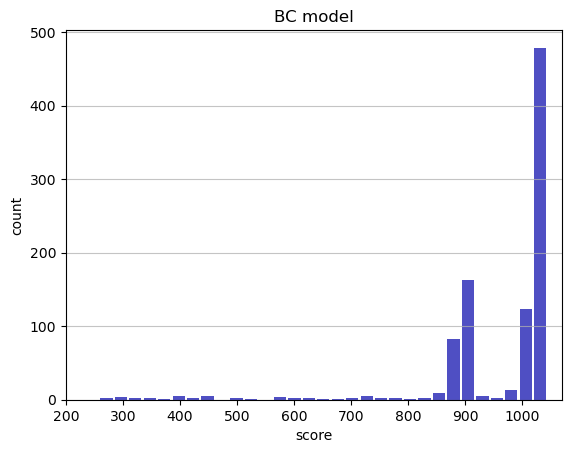

Track generation: 1208..1514 -> 306-tiles track
Epoch: 935
BC	mean: 960.66	variance: 126.59


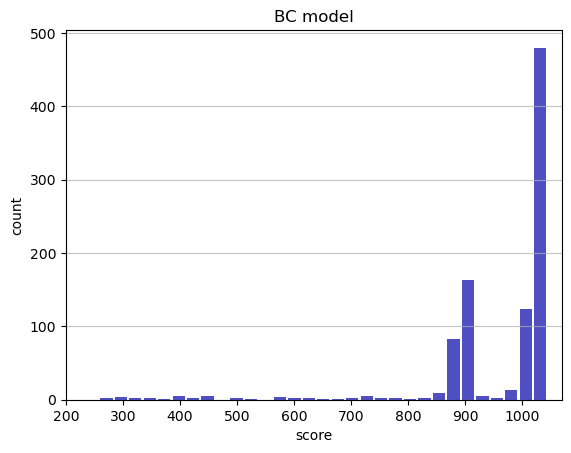

Track generation: 1166..1461 -> 295-tiles track
Epoch: 936
BC	mean: 960.72	variance: 126.53


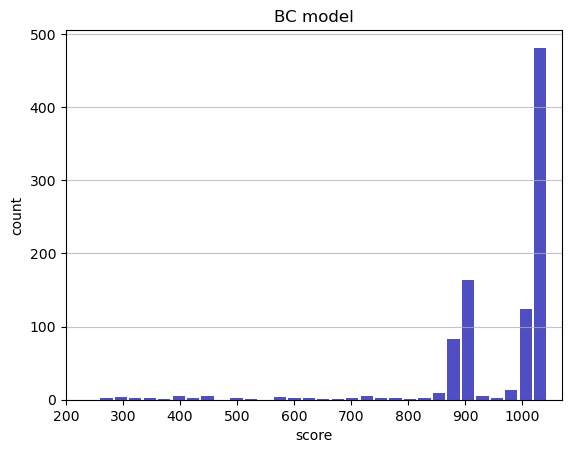

Track generation: 1319..1654 -> 335-tiles track
Epoch: 937
BC	mean: 960.73	variance: 126.47


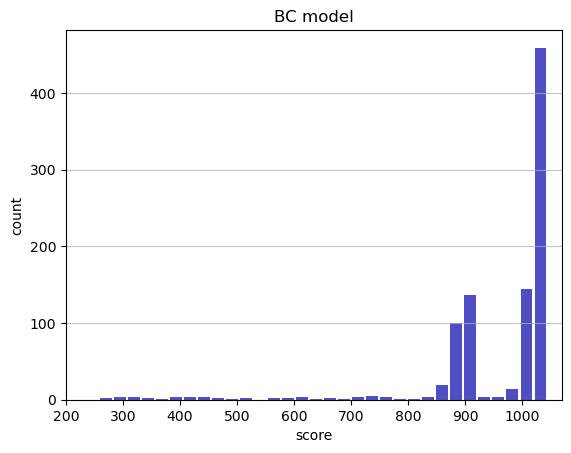

Track generation: 1175..1473 -> 298-tiles track
Epoch: 938
BC	mean: 960.80	variance: 126.42


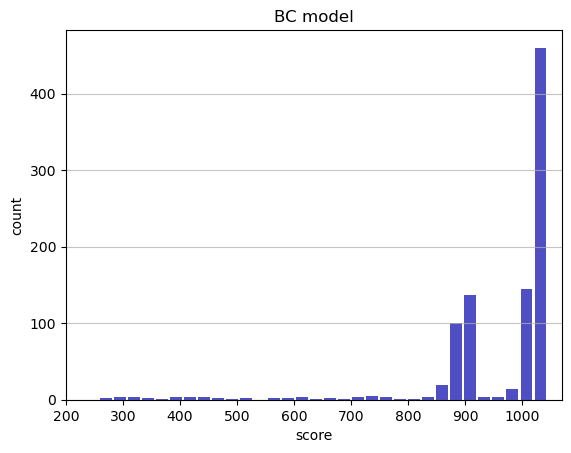

Track generation: 1213..1520 -> 307-tiles track
Epoch: 939
BC	mean: 960.70	variance: 126.39


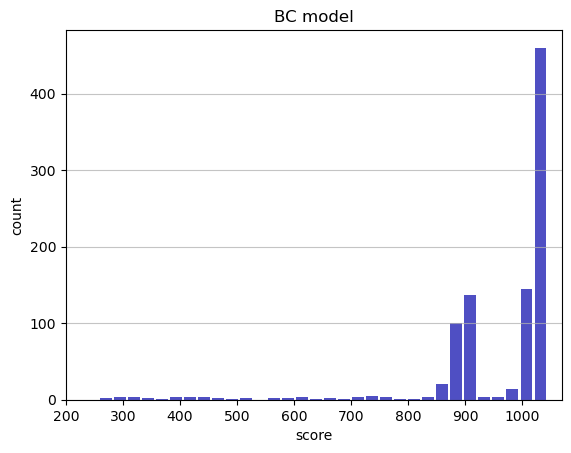

Track generation: 1009..1266 -> 257-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1384..1734 -> 350-tiles track
Epoch: 940
BC	mean: 960.75	variance: 126.33


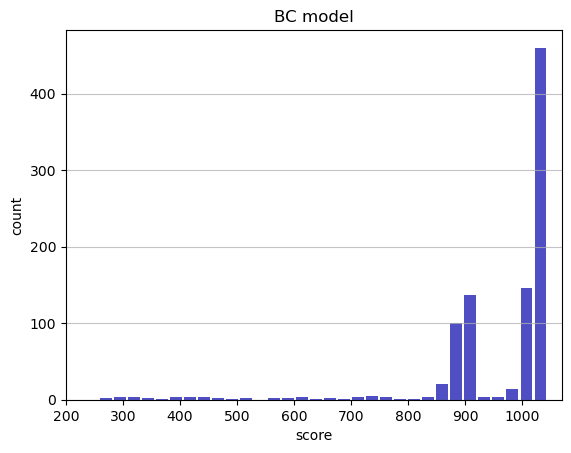

Track generation: 1132..1419 -> 287-tiles track
Epoch: 941
BC	mean: 960.81	variance: 126.28


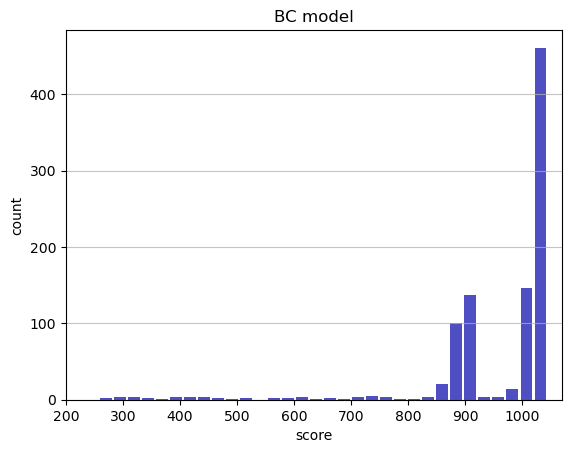

Track generation: 948..1196 -> 248-tiles track
Epoch: 942
BC	mean: 960.90	variance: 126.23


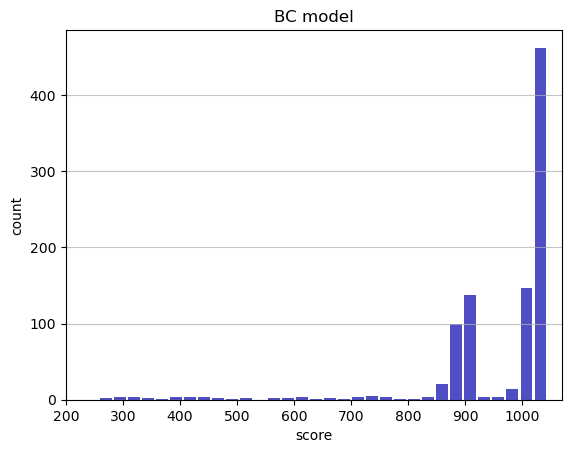

Track generation: 1151..1450 -> 299-tiles track
Epoch: 943
BC	mean: 960.96	variance: 126.18


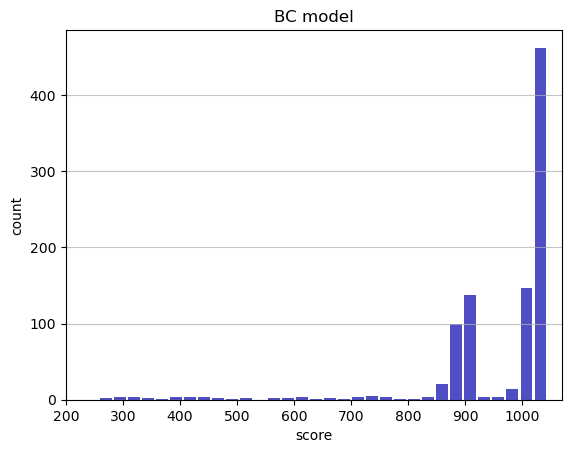

Track generation: 1147..1438 -> 291-tiles track
Epoch: 944
BC	mean: 960.86	variance: 126.15


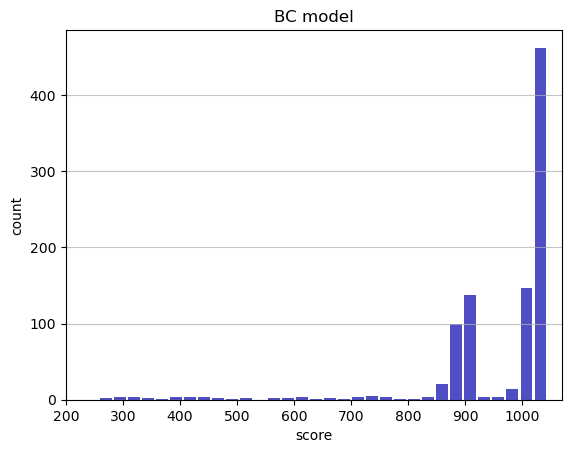

Track generation: 1162..1457 -> 295-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1212..1519 -> 307-tiles track
Epoch: 945
BC	mean: 960.74	variance: 126.14


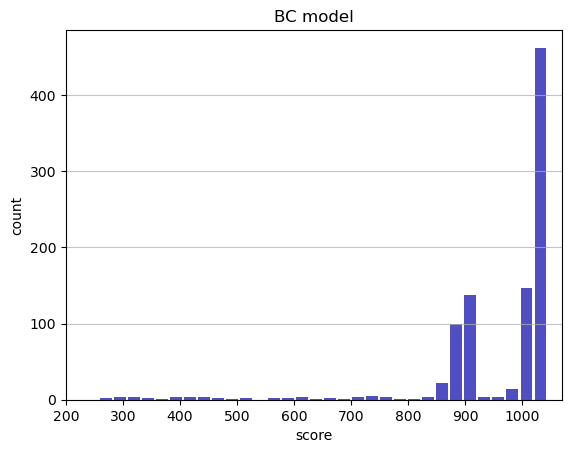

Track generation: 1245..1560 -> 315-tiles track
Epoch: 946
BC	mean: 960.11	variance: 127.54


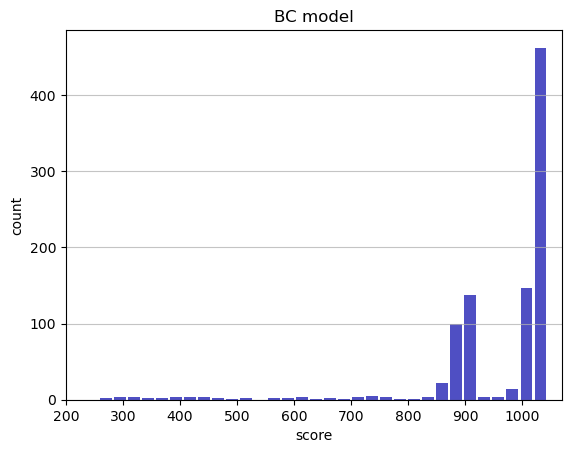

Track generation: 1162..1456 -> 294-tiles track
Epoch: 947
BC	mean: 960.18	variance: 127.49


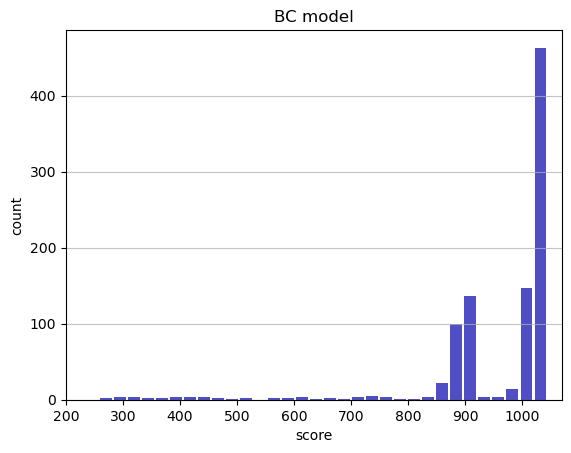

Track generation: 1104..1392 -> 288-tiles track
Epoch: 948
BC	mean: 960.25	variance: 127.44


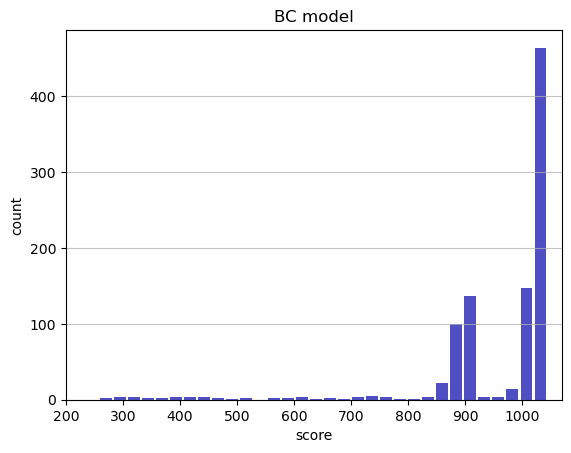

Track generation: 1512..1895 -> 383-tiles track
Epoch: 949
BC	mean: 960.22	variance: 127.38


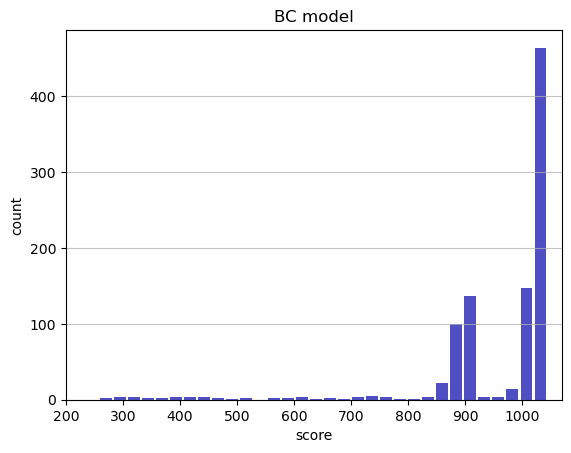

Track generation: 1132..1428 -> 296-tiles track
Epoch: 950
BC	mean: 959.59	variance: 128.77


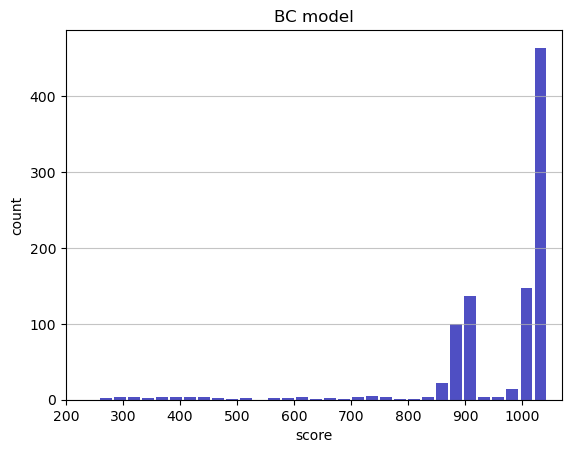

Track generation: 1097..1384 -> 287-tiles track
Epoch: 951
BC	mean: 959.66	variance: 128.72


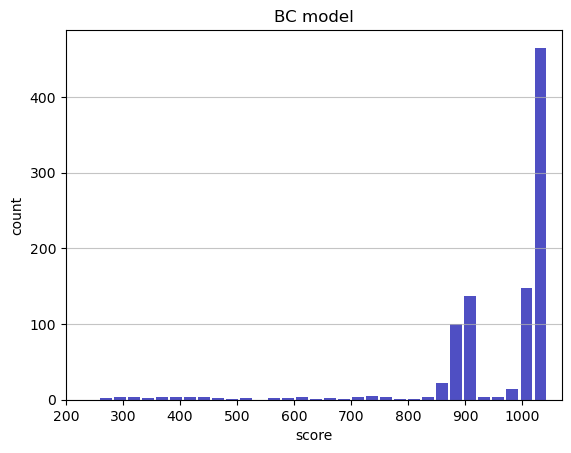

Track generation: 1157..1451 -> 294-tiles track
Epoch: 952
BC	mean: 959.59	variance: 128.67


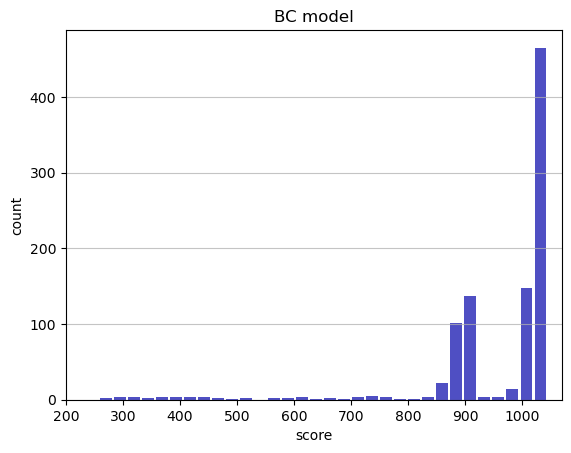

Track generation: 1248..1564 -> 316-tiles track
Epoch: 953
BC	mean: 959.52	variance: 128.62


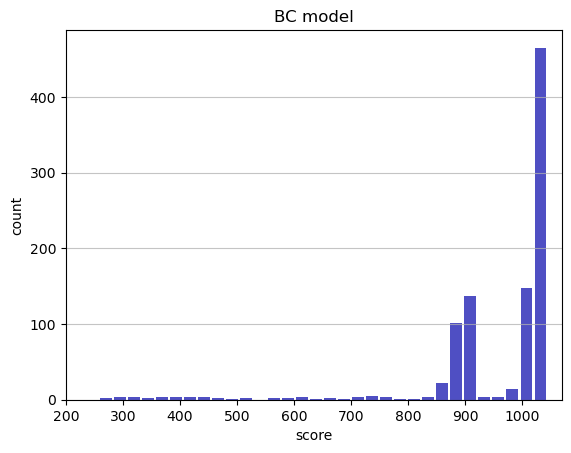

Track generation: 1272..1594 -> 322-tiles track
Epoch: 954
BC	mean: 959.58	variance: 128.57


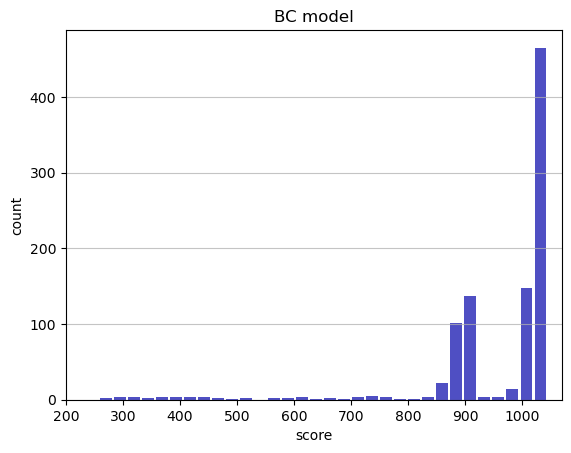

Track generation: 1341..1680 -> 339-tiles track
Epoch: 955
BC	mean: 959.51	variance: 128.52


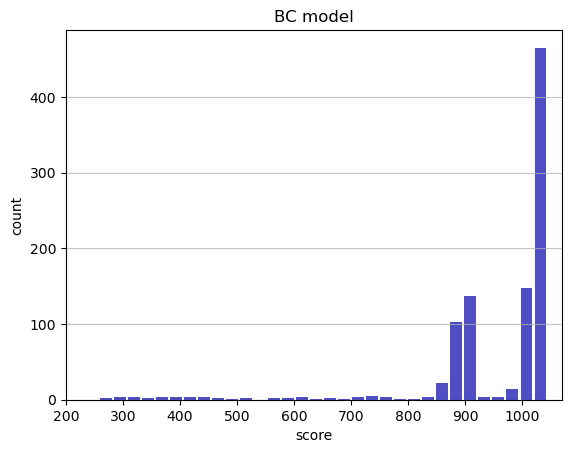

Track generation: 1057..1325 -> 268-tiles track
Epoch: 956
BC	mean: 959.59	variance: 128.47


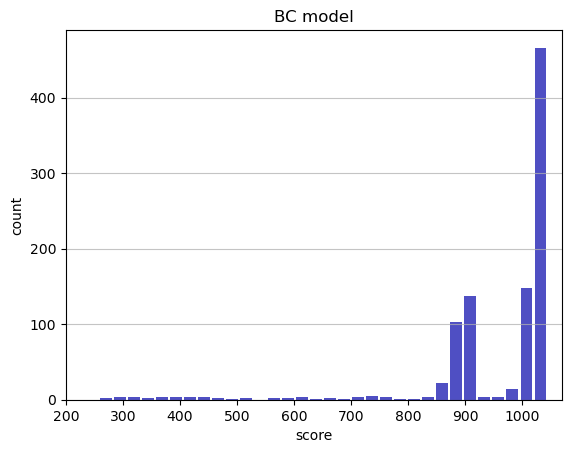

Track generation: 1000..1258 -> 258-tiles track
Epoch: 957
BC	mean: 959.66	variance: 128.43


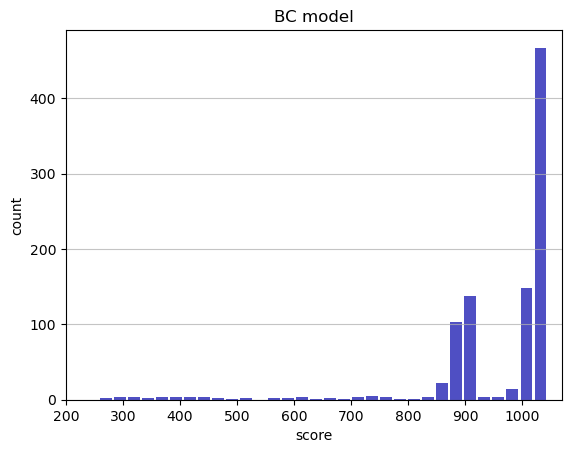

Track generation: 1093..1372 -> 279-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1064..1334 -> 270-tiles track
Epoch: 958
BC	mean: 959.74	variance: 128.38


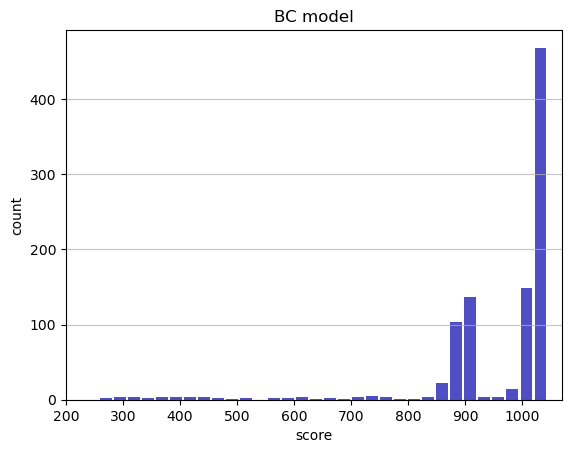

Track generation: 1256..1574 -> 318-tiles track
Epoch: 959
BC	mean: 959.67	variance: 128.33


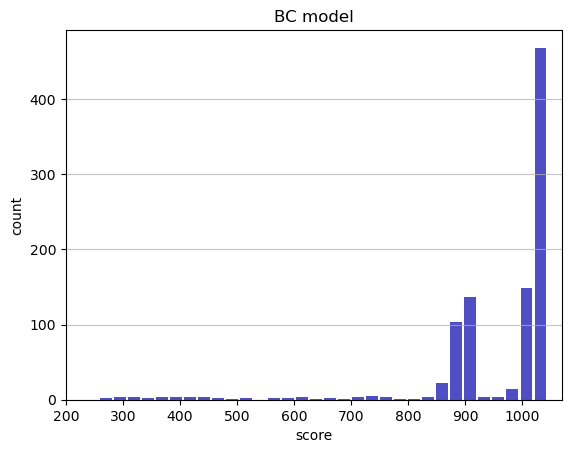

Track generation: 1107..1388 -> 281-tiles track
Epoch: 960
BC	mean: 959.75	variance: 128.29


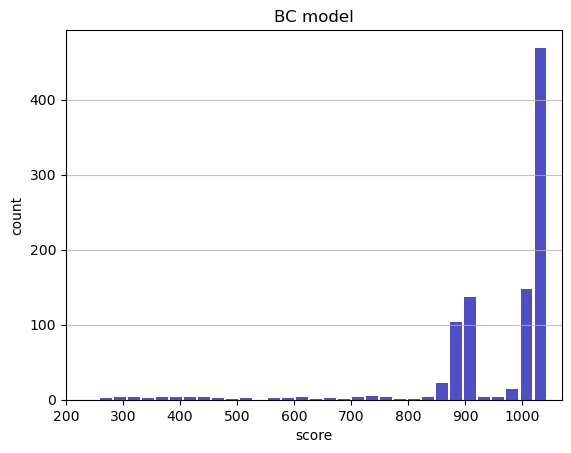

Track generation: 1239..1553 -> 314-tiles track
Epoch: 961
BC	mean: 959.82	variance: 128.24


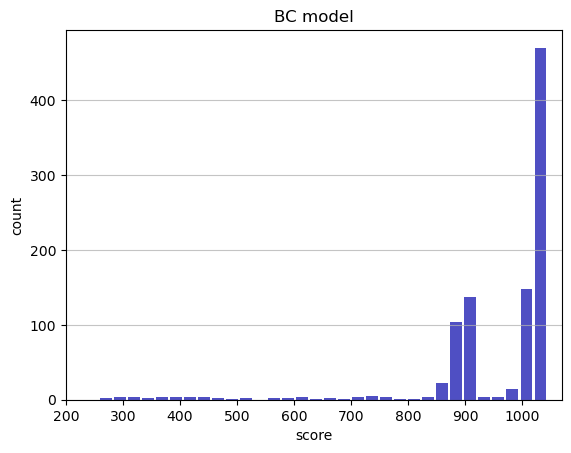

Track generation: 1158..1451 -> 293-tiles track
Epoch: 962
BC	mean: 959.75	variance: 128.19


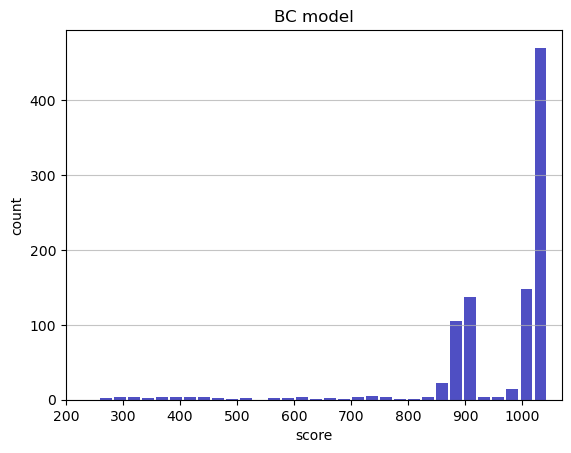

Track generation: 1188..1489 -> 301-tiles track
Epoch: 963
BC	mean: 959.81	variance: 128.14


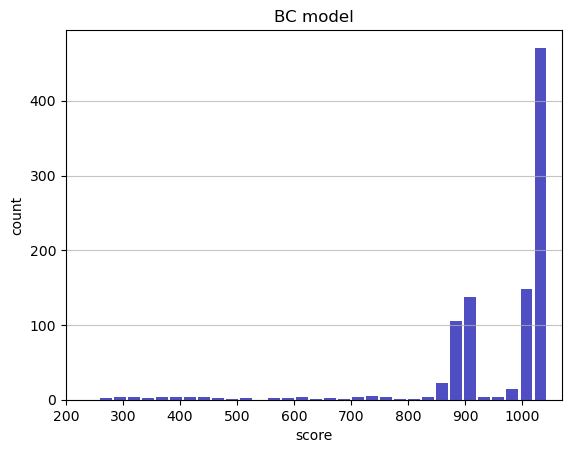

Track generation: 878..1109 -> 231-tiles track
Epoch: 964
BC	mean: 959.75	variance: 128.09


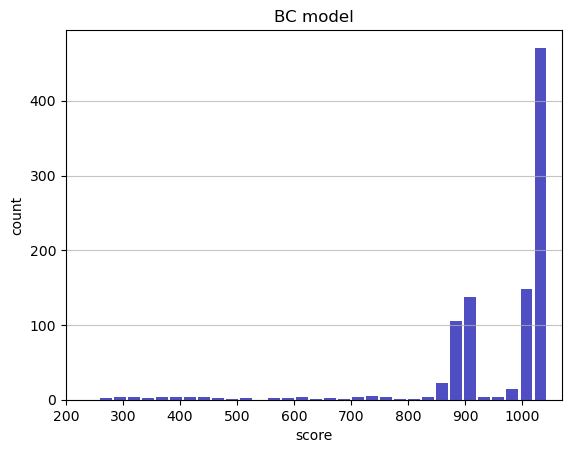

Track generation: 1144..1434 -> 290-tiles track
Epoch: 965
BC	mean: 959.82	variance: 128.04


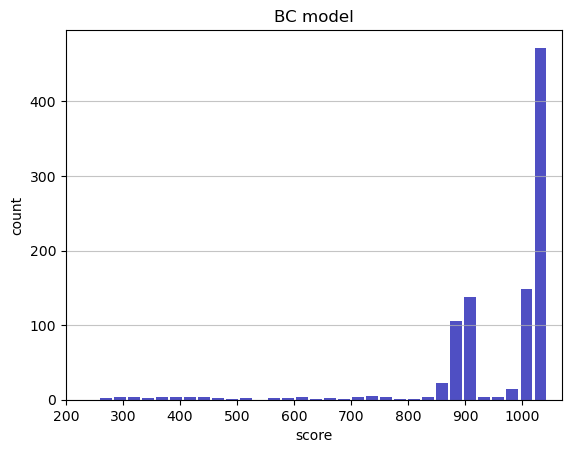

Track generation: 1099..1390 -> 291-tiles track
Epoch: 966
BC	mean: 959.89	variance: 127.99


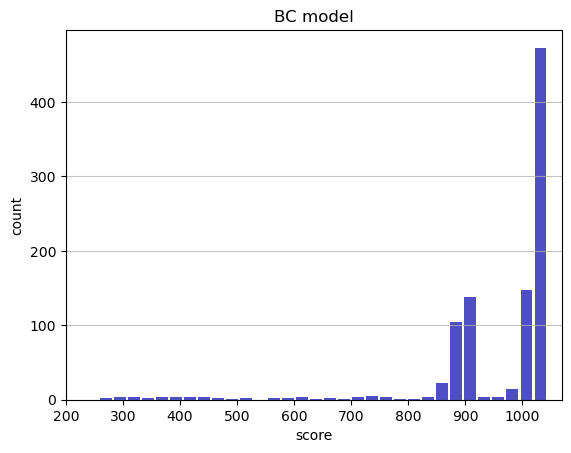

Track generation: 1122..1407 -> 285-tiles track
Epoch: 967
BC	mean: 959.83	variance: 127.94


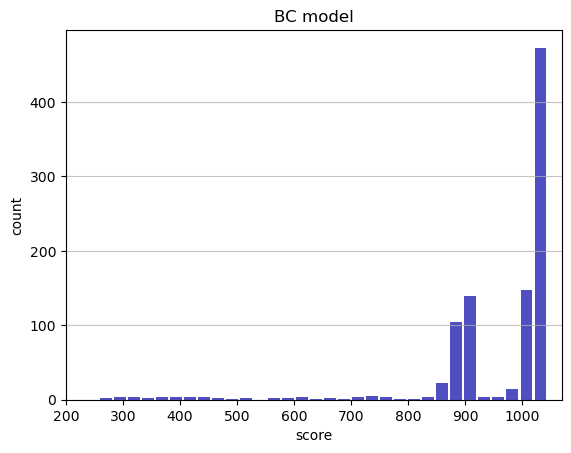

Track generation: 1231..1543 -> 312-tiles track
Epoch: 968
BC	mean: 959.89	variance: 127.89


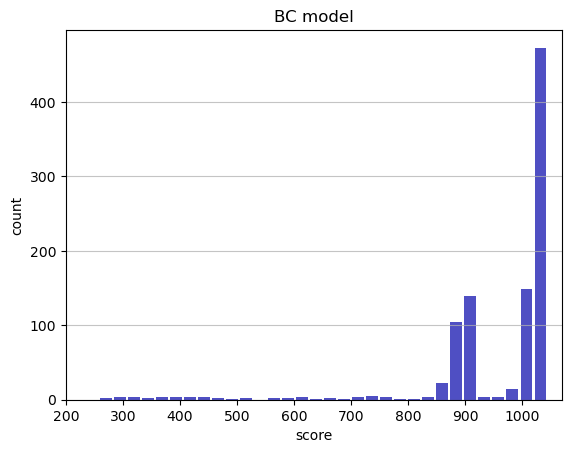

Track generation: 1176..1482 -> 306-tiles track
Epoch: 969
BC	mean: 959.95	variance: 127.84


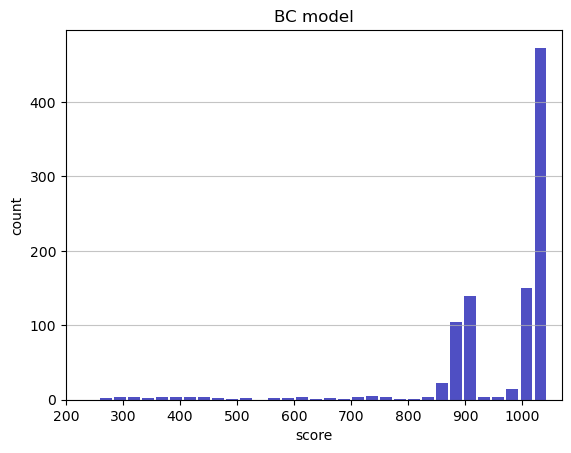

Track generation: 1264..1584 -> 320-tiles track
Epoch: 970
BC	mean: 959.99	variance: 127.78


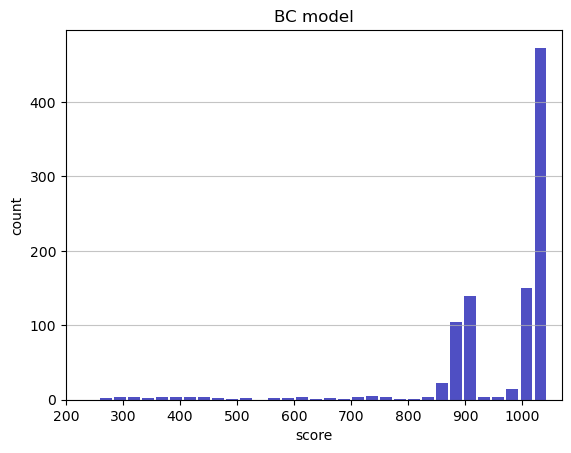

Track generation: 1372..1719 -> 347-tiles track
Epoch: 971
BC	mean: 959.34	variance: 129.30


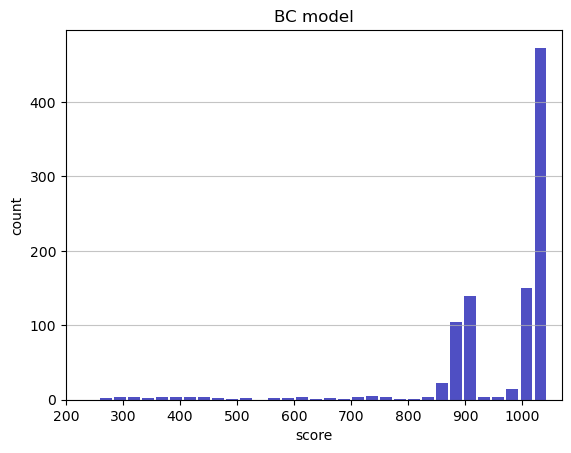

Track generation: 1165..1462 -> 297-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1264..1584 -> 320-tiles track
Epoch: 972
BC	mean: 959.39	variance: 129.25


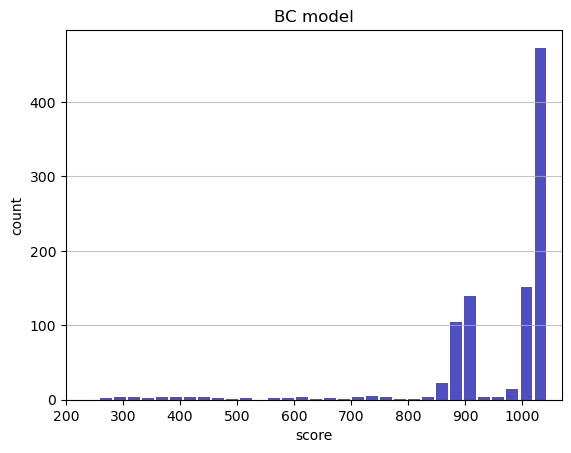

Track generation: 1272..1594 -> 322-tiles track
Epoch: 973
BC	mean: 959.45	variance: 129.19


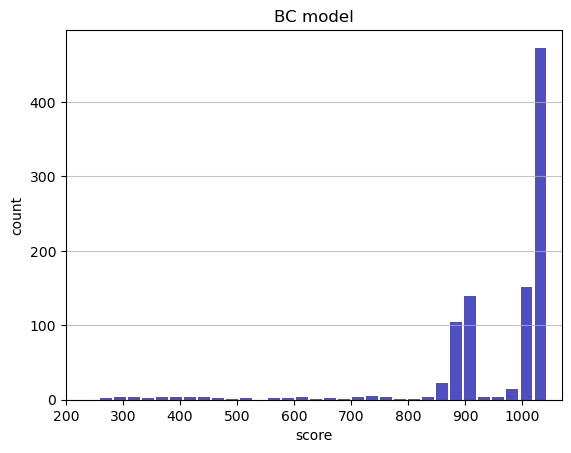

Track generation: 1175..1473 -> 298-tiles track
Epoch: 974
BC	mean: 959.40	variance: 129.14


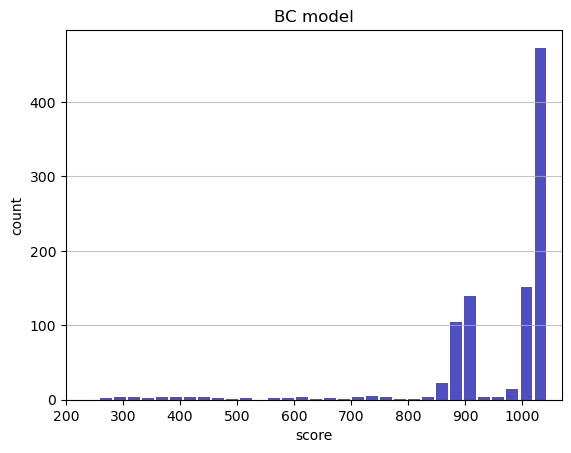

Track generation: 1071..1350 -> 279-tiles track
Epoch: 975
BC	mean: 959.47	variance: 129.09


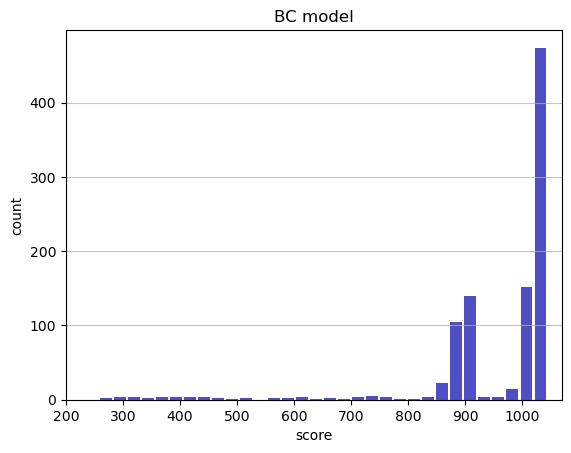

Track generation: 961..1212 -> 251-tiles track
Epoch: 976
BC	mean: 959.55	variance: 129.05


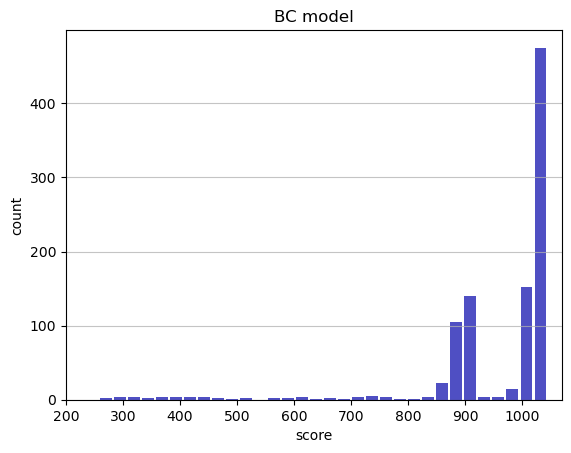

Track generation: 1316..1649 -> 333-tiles track
Epoch: 977
BC	mean: 959.58	variance: 128.99


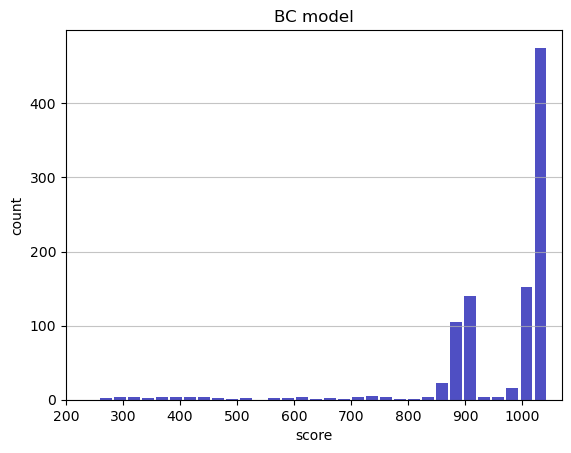

Track generation: 1189..1490 -> 301-tiles track
Epoch: 978
BC	mean: 959.51	variance: 128.94


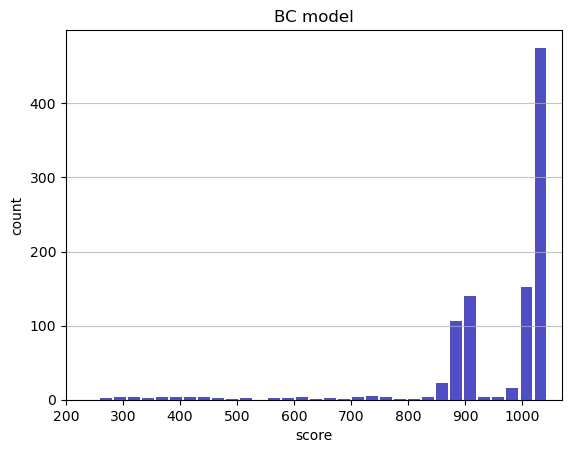

Track generation: 985..1235 -> 250-tiles track
Epoch: 979
BC	mean: 959.59	variance: 128.90


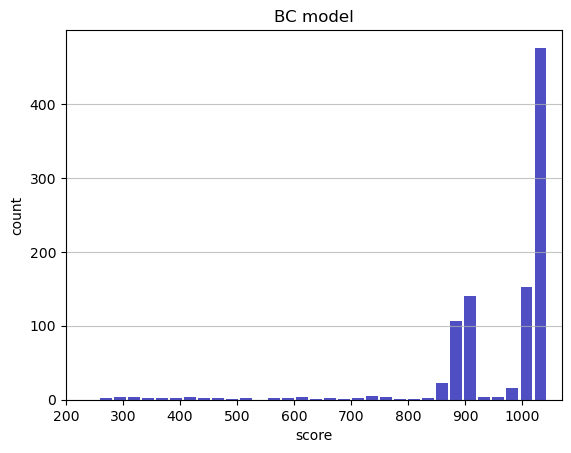

Track generation: 1110..1392 -> 282-tiles track
Epoch: 980
BC	mean: 959.65	variance: 128.85


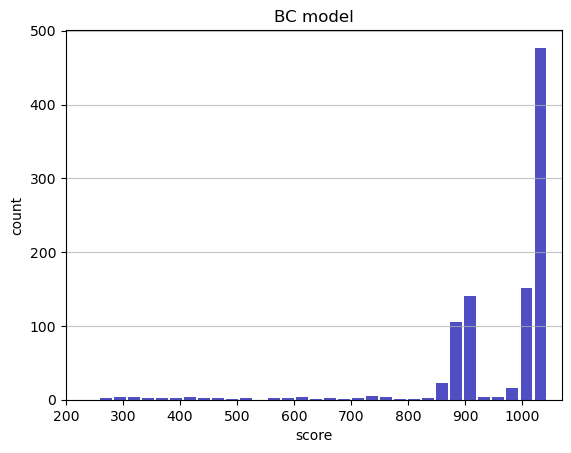

Track generation: 1171..1468 -> 297-tiles track
Epoch: 981
BC	mean: 959.72	variance: 128.80


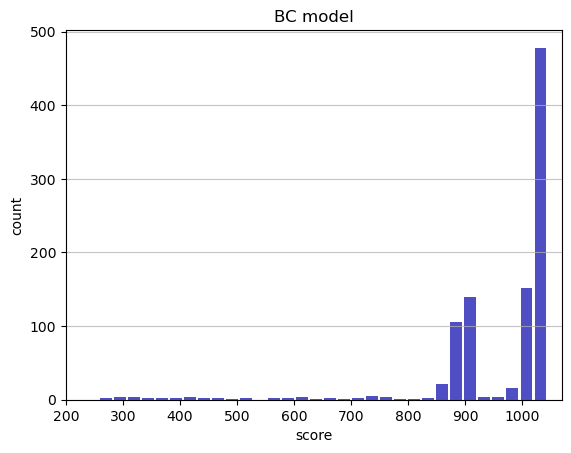

Track generation: 1127..1413 -> 286-tiles track
Epoch: 982
BC	mean: 959.79	variance: 128.75


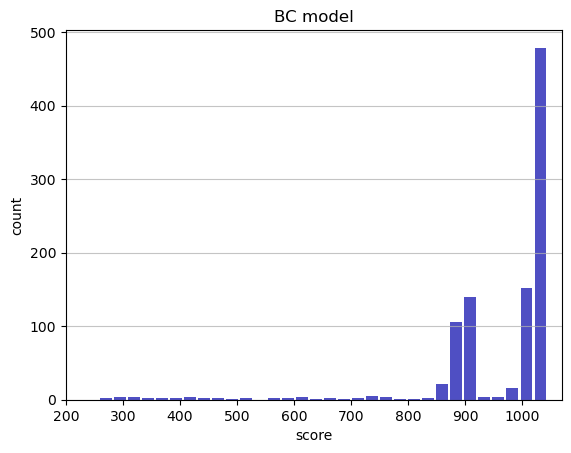

Track generation: 1325..1660 -> 335-tiles track
Epoch: 983
BC	mean: 959.83	variance: 128.69


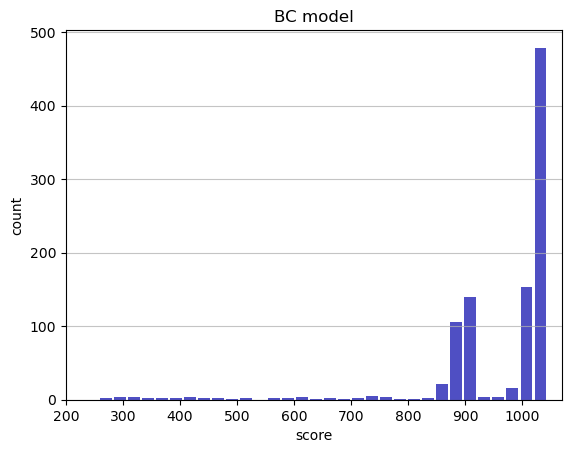

Track generation: 951..1193 -> 242-tiles track
Epoch: 984
BC	mean: 959.91	variance: 128.65


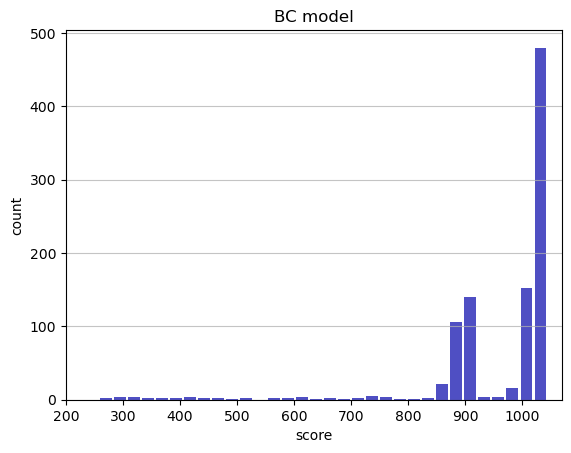

Track generation: 951..1193 -> 242-tiles track
Epoch: 985
BC	mean: 959.99	variance: 128.61


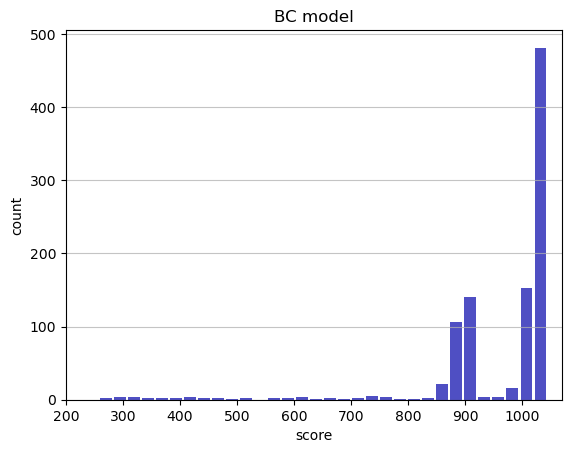

Track generation: 1115..1407 -> 292-tiles track
Epoch: 986
BC	mean: 960.06	variance: 128.56


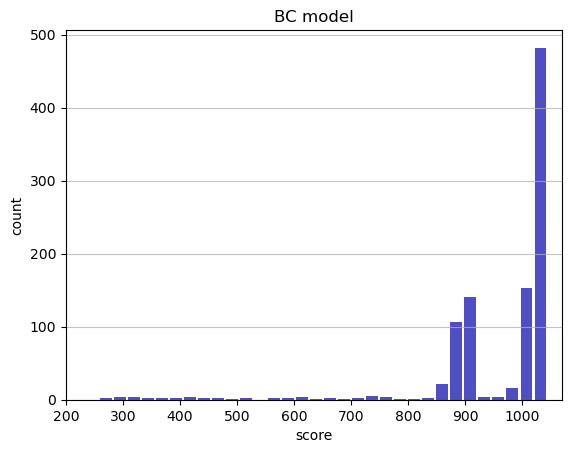

Track generation: 1132..1419 -> 287-tiles track
Epoch: 987
BC	mean: 959.99	variance: 128.52


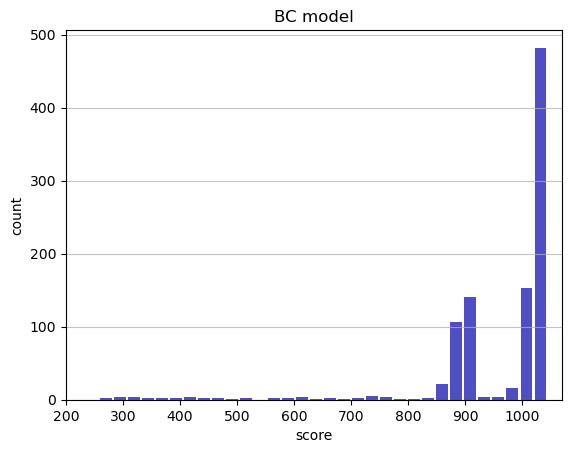

Track generation: 1240..1554 -> 314-tiles track
Epoch: 988
BC	mean: 959.93	variance: 128.47


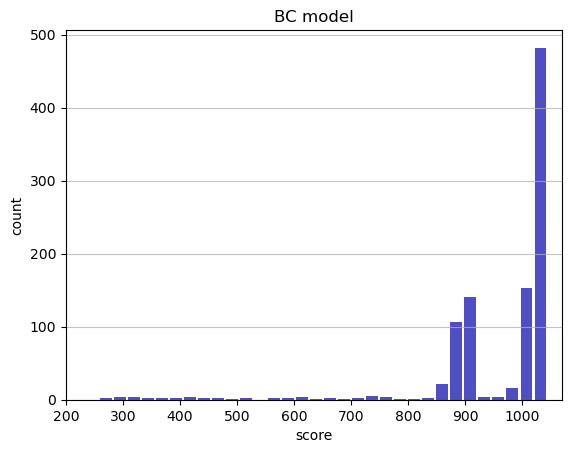

Track generation: 1043..1308 -> 265-tiles track
Epoch: 989
BC	mean: 960.00	variance: 128.42


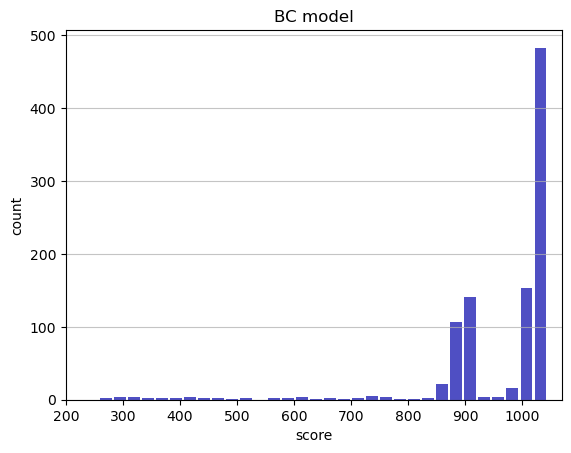

Track generation: 1163..1458 -> 295-tiles track
Epoch: 990
BC	mean: 960.07	variance: 128.38


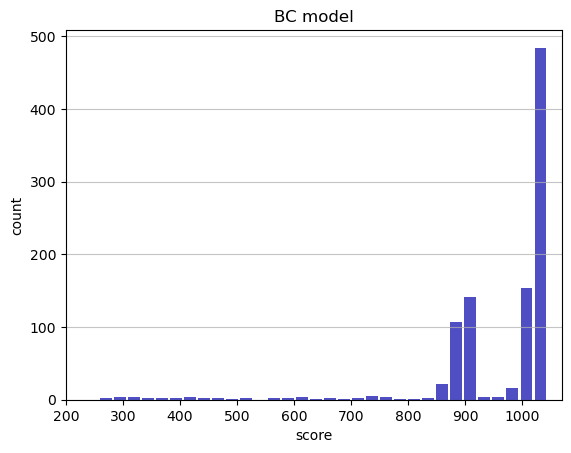

Track generation: 1245..1560 -> 315-tiles track
Epoch: 991
BC	mean: 960.01	variance: 128.33


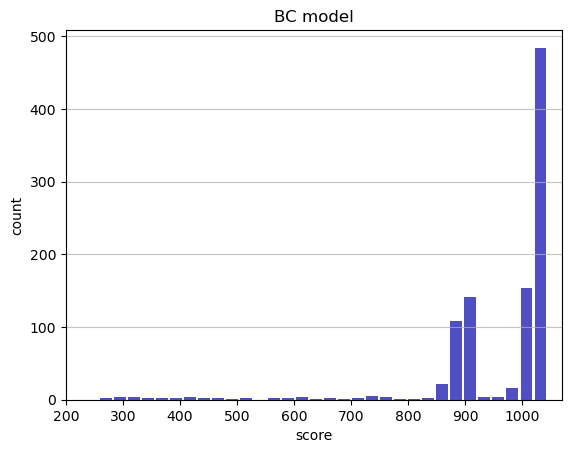

Track generation: 1203..1508 -> 305-tiles track
Epoch: 992
BC	mean: 960.07	variance: 128.28


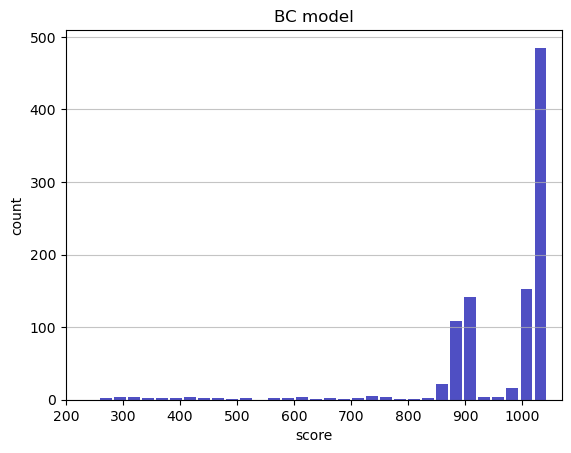

Track generation: 1218..1535 -> 317-tiles track
Epoch: 993
BC	mean: 960.13	variance: 128.23


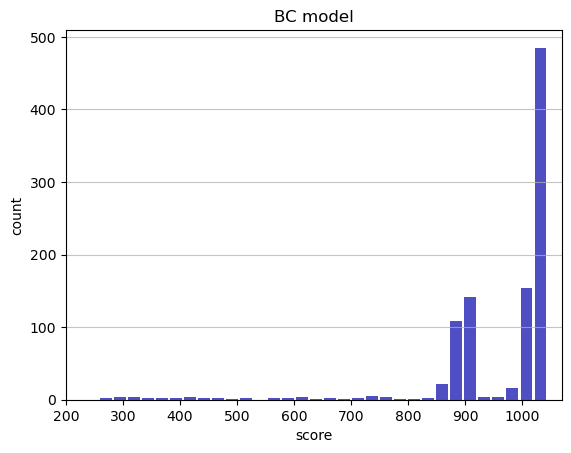

Track generation: 1244..1559 -> 315-tiles track
Epoch: 994
BC	mean: 960.19	variance: 128.18


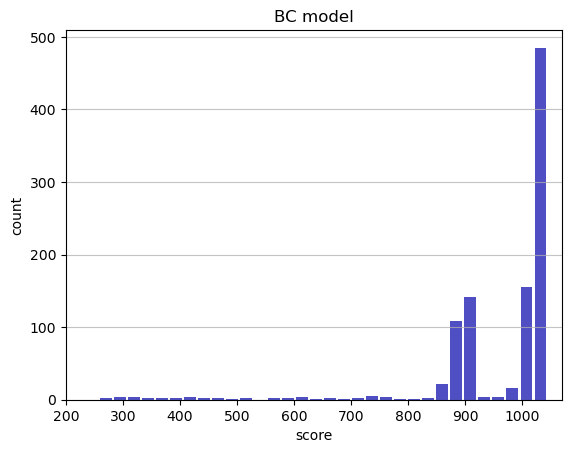

Track generation: 1264..1584 -> 320-tiles track
Epoch: 995
BC	mean: 960.12	variance: 128.13


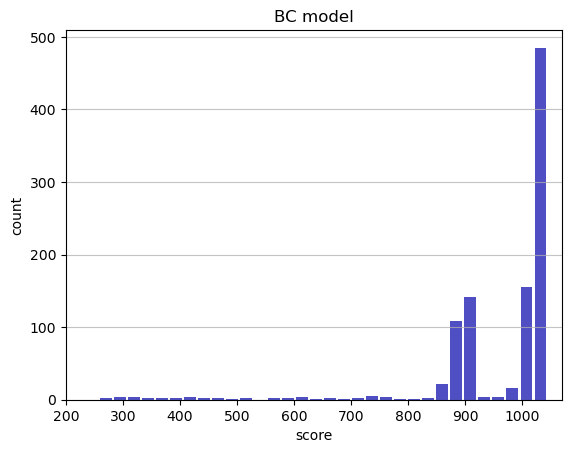

Track generation: 1149..1440 -> 291-tiles track
Epoch: 996
BC	mean: 960.18	variance: 128.08


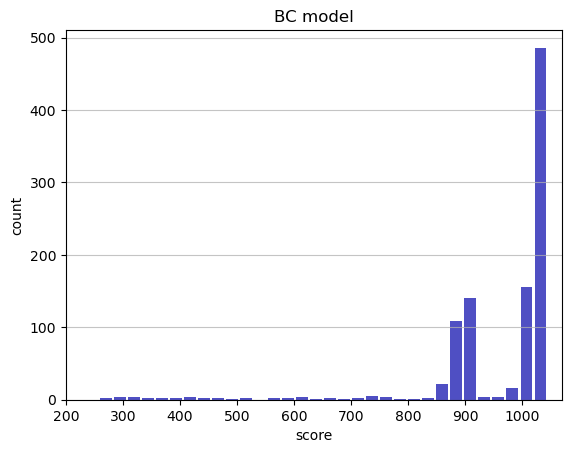

Track generation: 1108..1389 -> 281-tiles track
Epoch: 997
BC	mean: 960.12	variance: 128.03


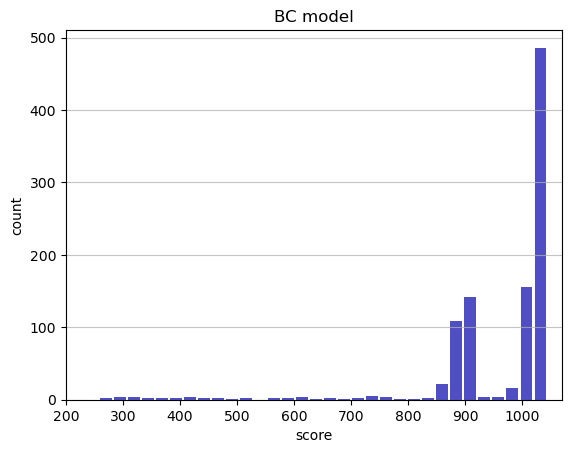

Track generation: 1157..1454 -> 297-tiles track
Epoch: 998
BC	mean: 960.18	variance: 127.98


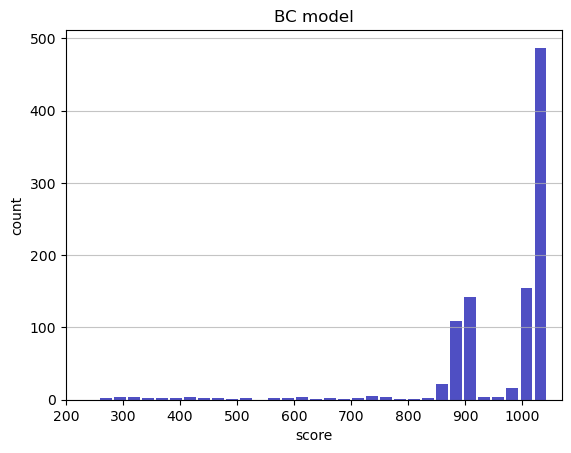

Track generation: 1195..1503 -> 308-tiles track
Epoch: 999
BC	mean: 960.24	variance: 127.93


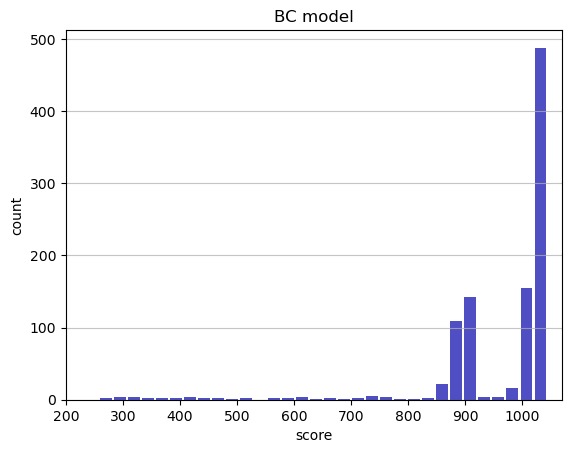

Track generation: 1050..1321 -> 271-tiles track
Epoch: 1000
BC	mean: 960.32	variance: 127.89


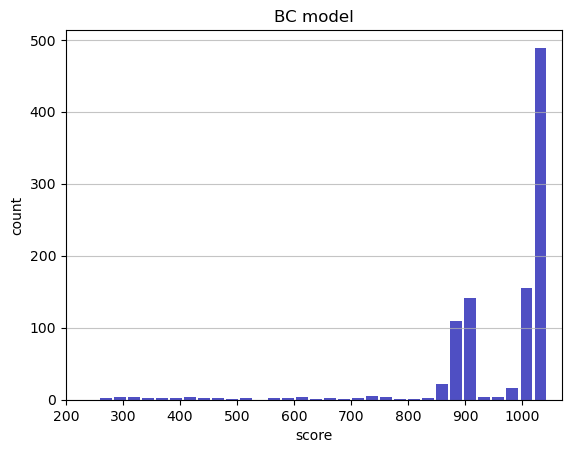

In [5]:
use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")

env = Env()
total_score = 0
scores = []

model = torch.load('./BC_model/BC_model27.pt')

epoch = 1000
for i_ep in range(1,epoch+1):
    score = 0
    state = env.reset()
    
    for t in range(1000):     
        action = model(torch.tensor(state.reshape(1,4,96,96)).cuda().float())[0].cpu().detach().numpy()
        
        state_, reward, done, die = env.step(action * np.array([2., 1., 1.]) + np.array([-1., 0., 0.]))
        
        env.render()
        score += reward
        state = state_
        if done or die:
            break
    
    total_score += score
    scores.append(score)
    
    print("Epoch: {}".format(i_ep))
    print('BC\tmean: {:.2f}\tvariance: {:.2f}'.format(np.array(scores).mean(), np.array(scores).std()))

    plt.figure()
    plt.hist(x=scores, bins='auto', color='#0504aa', alpha=0.7, rwidth=0.85)
    plt.grid(axis='y', alpha=0.75)
    plt.xlim(200,1070)
    plt.xlabel('score')
    plt.ylabel('count')
    plt.title('BC model')
    
    plt.show()
    
env.close()

Track generation: 1080..1354 -> 274-tiles track


C:\Users\awds2588\anaconda3\lib\site-packages\pyglet\image\codecs\wic.py:289: UserWarning: [WinError -2147417850] 執行緒模式設定後就不能再變更它。
  warnings.warn(str(err))


Epoch: 1
BC	mean: 824.15	variance: 0.00


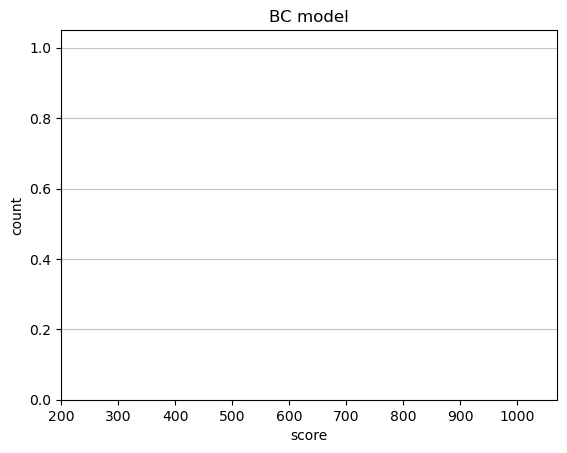

Track generation: 1031..1293 -> 262-tiles track
Epoch: 2
BC	mean: 830.33	variance: 6.18


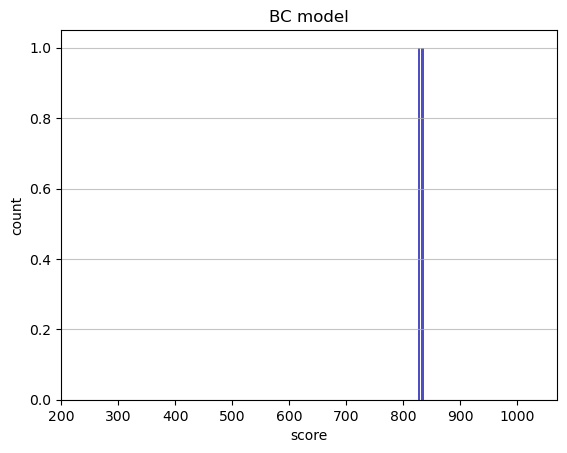

Track generation: 1060..1329 -> 269-tiles track
Epoch: 3
BC	mean: 725.66	variance: 148.11


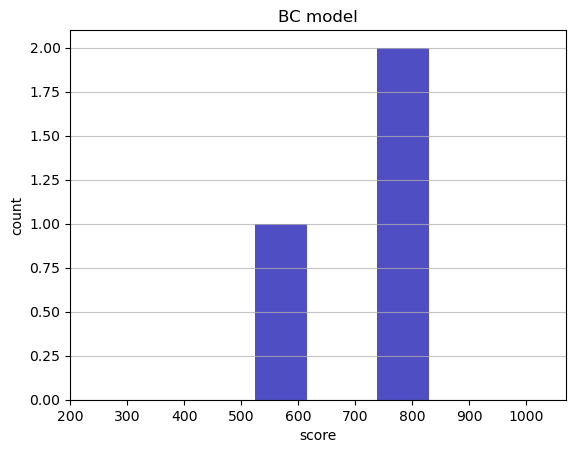

Track generation: 1123..1408 -> 285-tiles track
Epoch: 4
BC	mean: 768.80	variance: 148.44


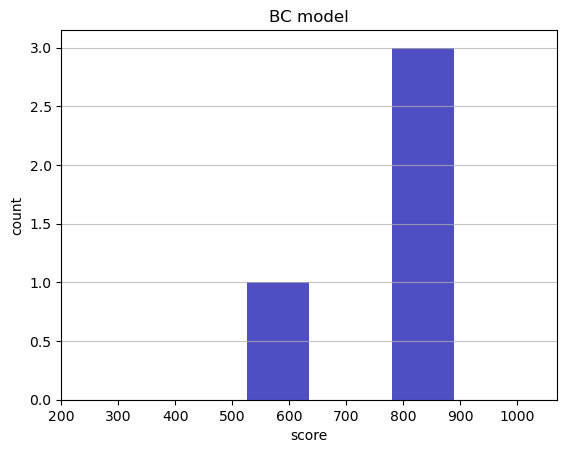

Track generation: 1289..1615 -> 326-tiles track
Epoch: 5
BC	mean: 783.55	variance: 136.01


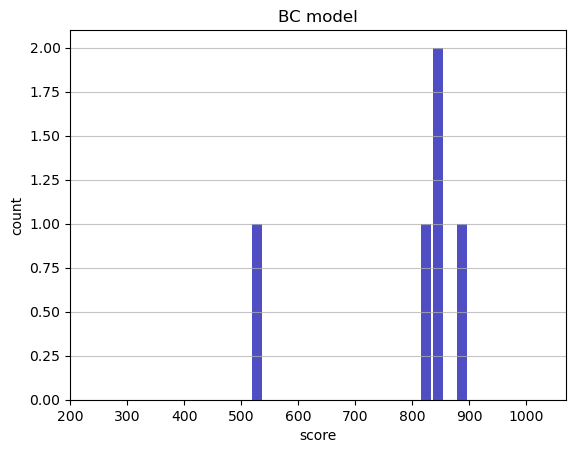

Track generation: 1139..1428 -> 289-tiles track
Epoch: 6
BC	mean: 712.47	variance: 201.69


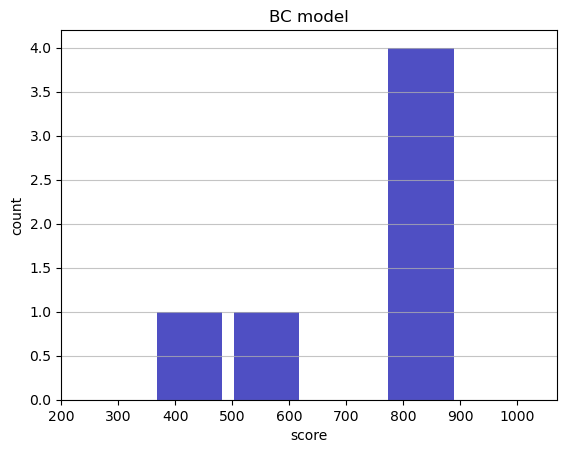

Track generation: 1028..1298 -> 270-tiles track
Epoch: 7
BC	mean: 720.06	variance: 187.65


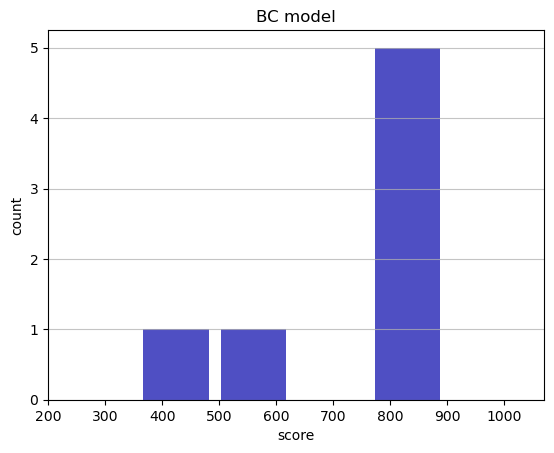

Track generation: 1209..1515 -> 306-tiles track
Epoch: 8
BC	mean: 672.34	variance: 216.22


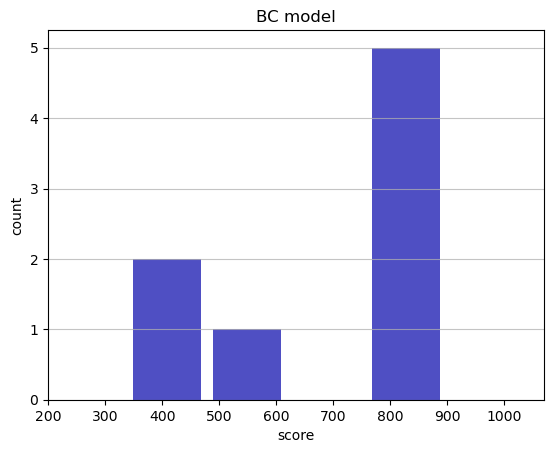

Track generation: 1112..1394 -> 282-tiles track
Epoch: 9
BC	mean: 686.97	variance: 208.01


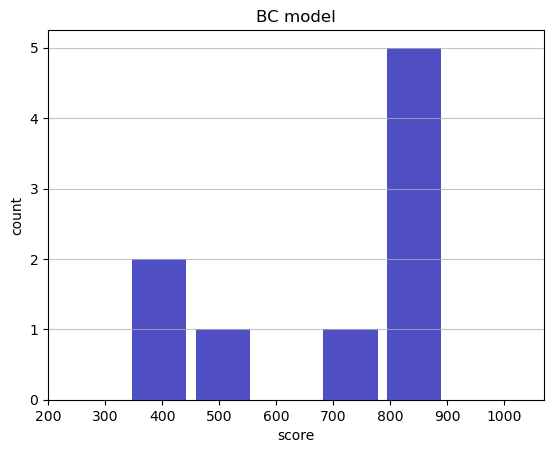

Track generation: 1169..1471 -> 302-tiles track
Epoch: 10
BC	mean: 630.00	variance: 261.07


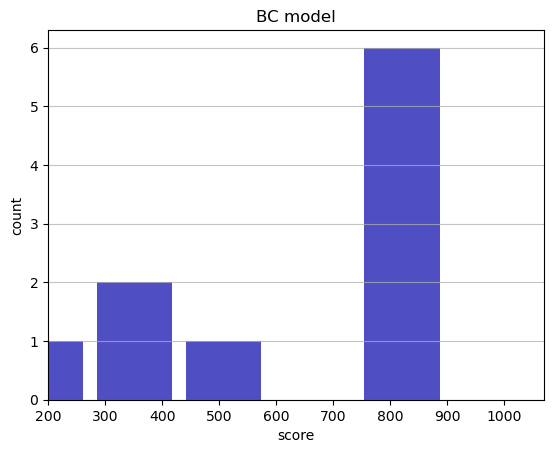

Track generation: 944..1189 -> 245-tiles track
Epoch: 11
BC	mean: 650.73	variance: 257.41


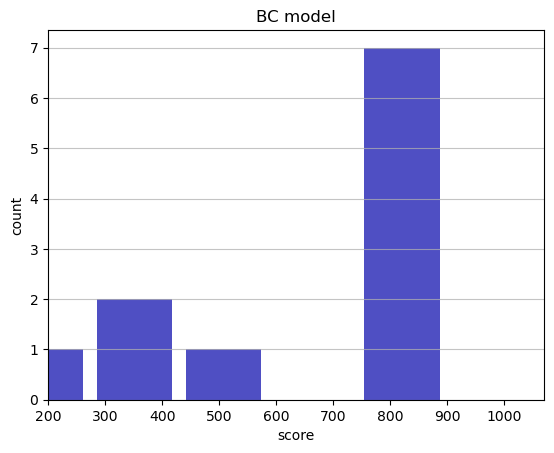

Track generation: 1056..1327 -> 271-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1068..1339 -> 271-tiles track
Epoch: 12
BC	mean: 631.86	variance: 254.27


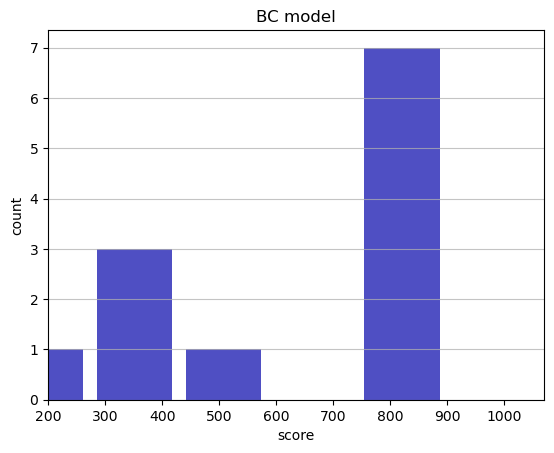

Track generation: 1115..1397 -> 282-tiles track
Epoch: 13
BC	mean: 649.97	variance: 252.22


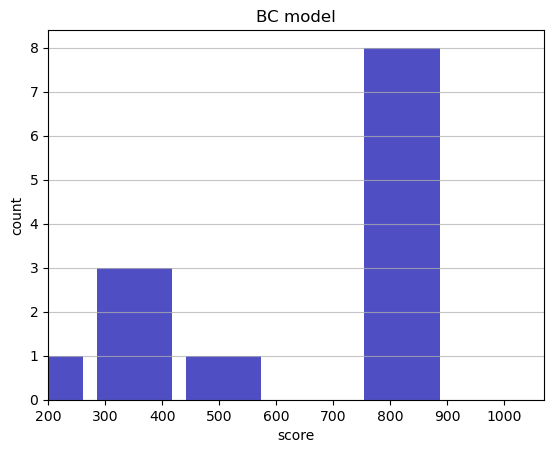

Track generation: 1091..1368 -> 277-tiles track
Epoch: 14
BC	mean: 637.86	variance: 246.94


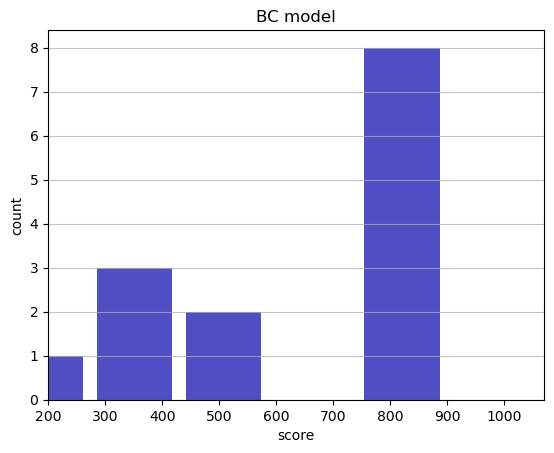

Track generation: 1116..1399 -> 283-tiles track
Epoch: 15
BC	mean: 612.43	variance: 256.84


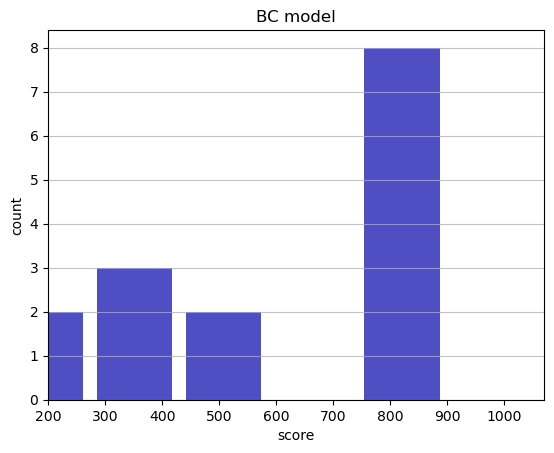

Track generation: 1173..1471 -> 298-tiles track
Epoch: 16
BC	mean: 626.10	variance: 254.26


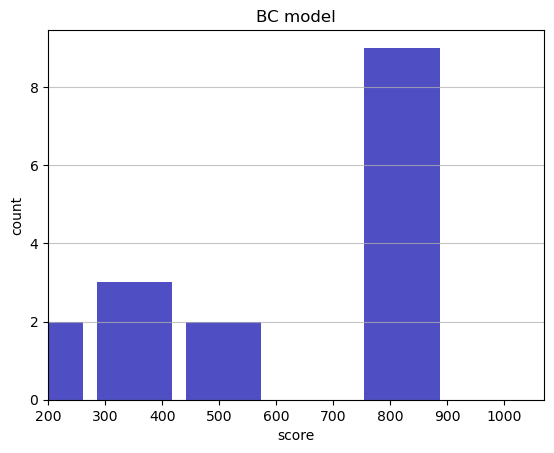

Track generation: 1277..1600 -> 323-tiles track
Epoch: 17
BC	mean: 618.20	variance: 248.68


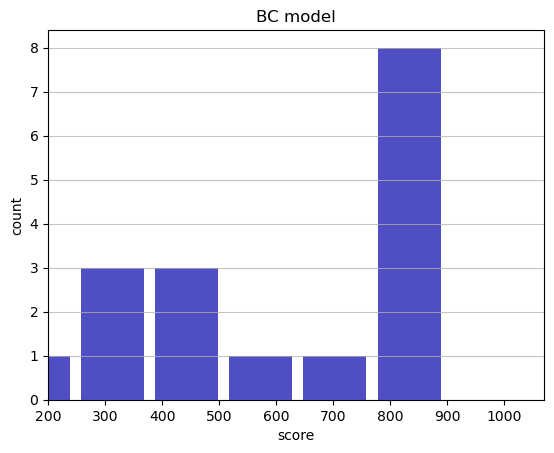

Track generation: 1094..1377 -> 283-tiles track
Epoch: 18
BC	mean: 633.32	variance: 249.59


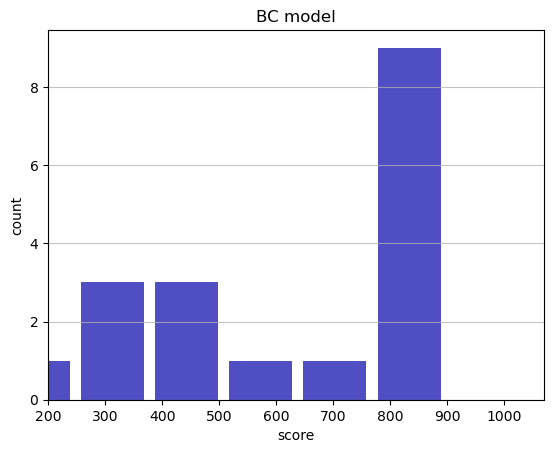

Track generation: 1060..1329 -> 269-tiles track
Epoch: 19
BC	mean: 616.28	variance: 253.47


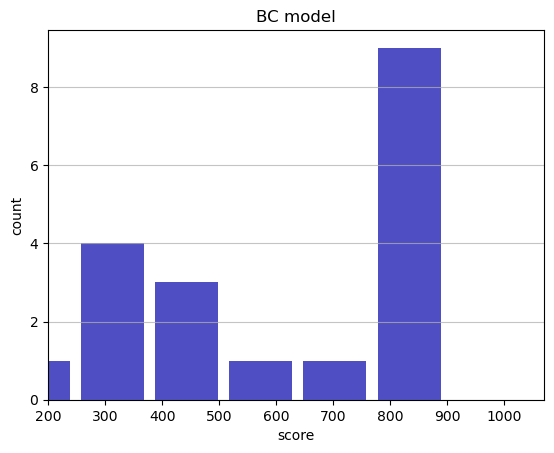

Track generation: 1252..1569 -> 317-tiles track
Epoch: 20
BC	mean: 602.54	variance: 254.20


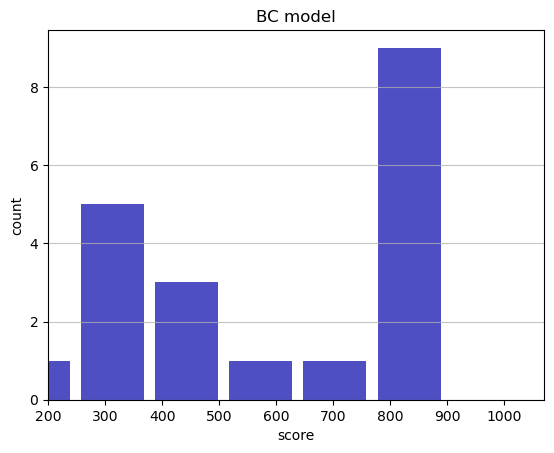

Track generation: 1245..1560 -> 315-tiles track
Epoch: 21
BC	mean: 614.35	variance: 253.64


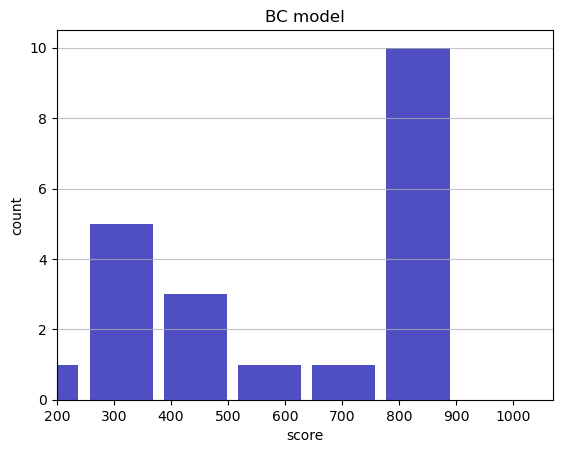

Track generation: 1421..1780 -> 359-tiles track
Epoch: 22
BC	mean: 599.87	variance: 256.53


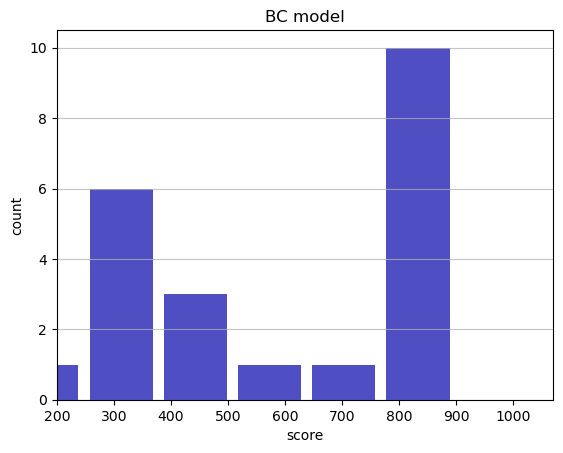

Track generation: 1127..1413 -> 286-tiles track
Epoch: 23
BC	mean: 612.27	variance: 257.54


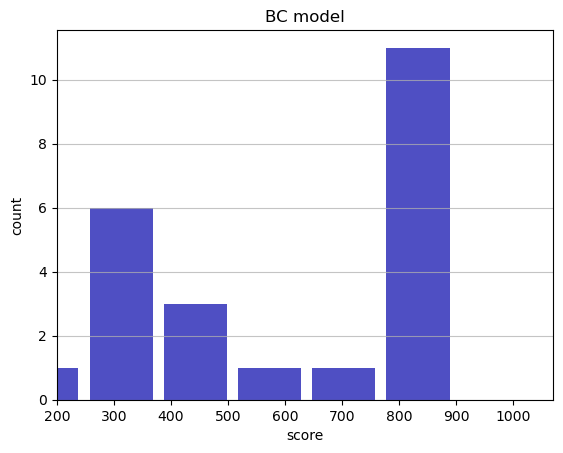

Track generation: 1238..1551 -> 313-tiles track
Epoch: 24
BC	mean: 618.67	variance: 253.98


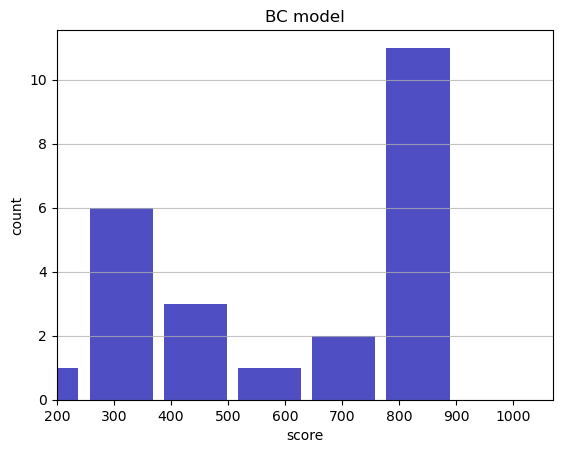

Track generation: 1297..1625 -> 328-tiles track
Epoch: 25
BC	mean: 606.94	variance: 255.40


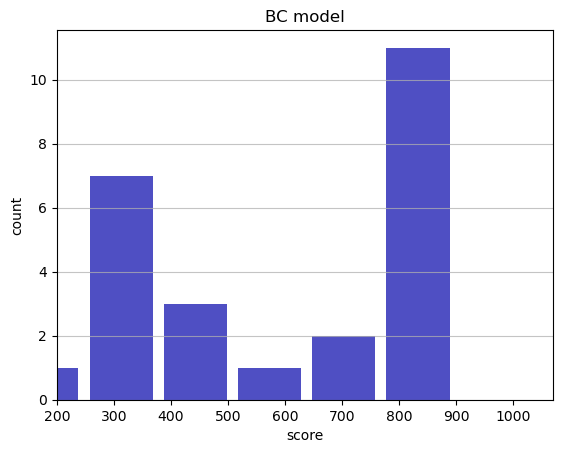

Track generation: 1187..1488 -> 301-tiles track
Epoch: 26
BC	mean: 595.26	variance: 257.17


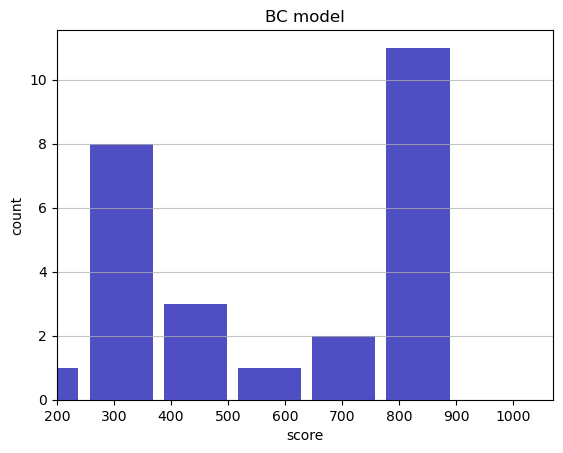

Track generation: 1124..1416 -> 292-tiles track
Epoch: 27
BC	mean: 588.80	variance: 254.50


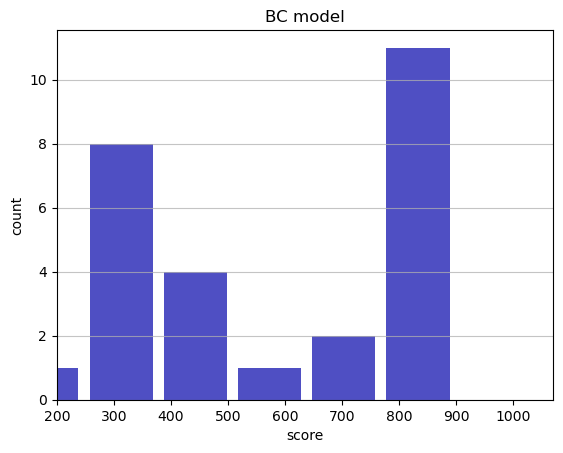

Track generation: 1270..1592 -> 322-tiles track
Epoch: 28
BC	mean: 589.49	variance: 249.94


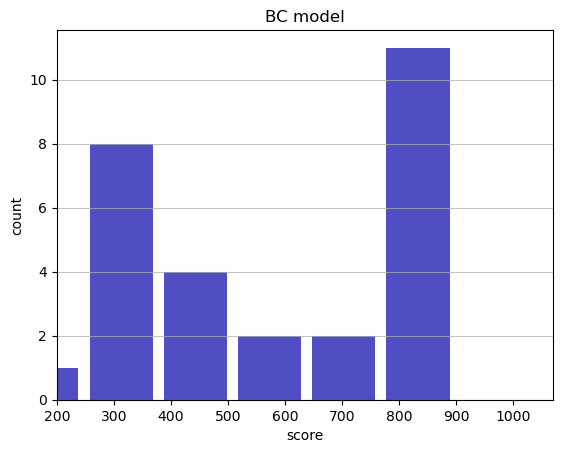

Track generation: 1005..1261 -> 256-tiles track
Epoch: 29
BC	mean: 597.47	variance: 249.19


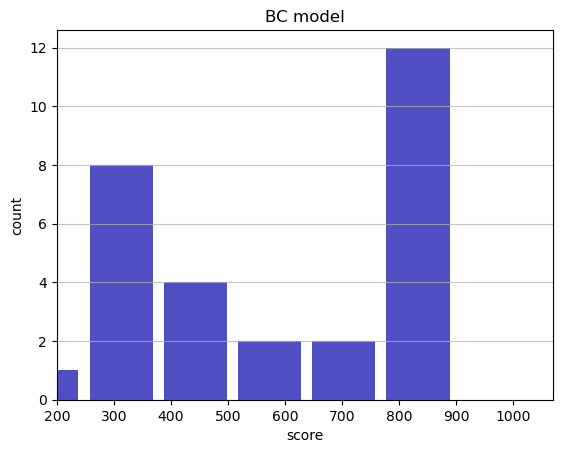

Track generation: 1157..1453 -> 296-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1242..1563 -> 321-tiles track
Epoch: 30
BC	mean: 604.85	variance: 248.20


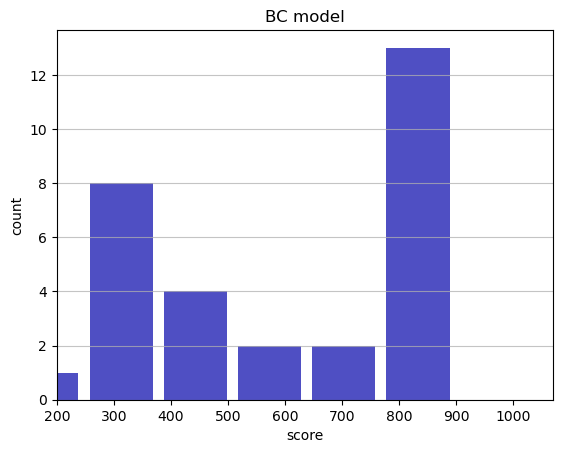

Track generation: 1168..1464 -> 296-tiles track
Epoch: 31
BC	mean: 596.18	variance: 248.74


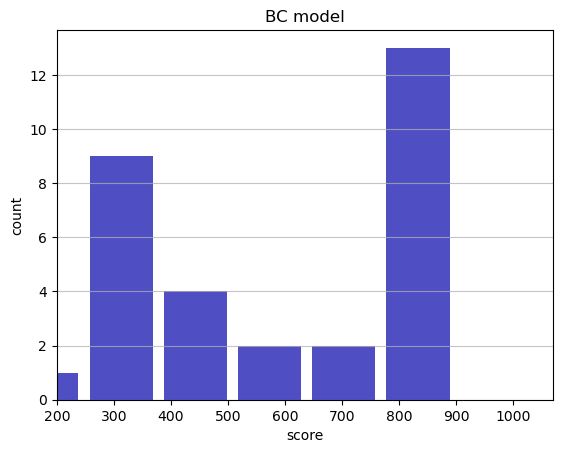

Track generation: 1097..1375 -> 278-tiles track
Epoch: 32
BC	mean: 602.71	variance: 247.51


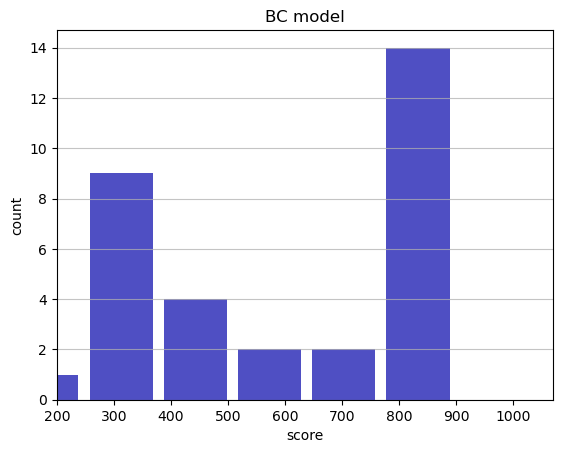

Track generation: 1175..1473 -> 298-tiles track
Epoch: 33
BC	mean: 612.71	variance: 250.21


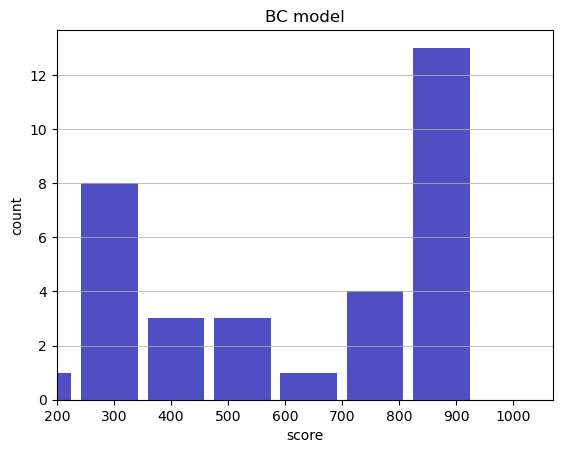

Track generation: 1236..1549 -> 313-tiles track
Epoch: 34
BC	mean: 619.65	variance: 249.70


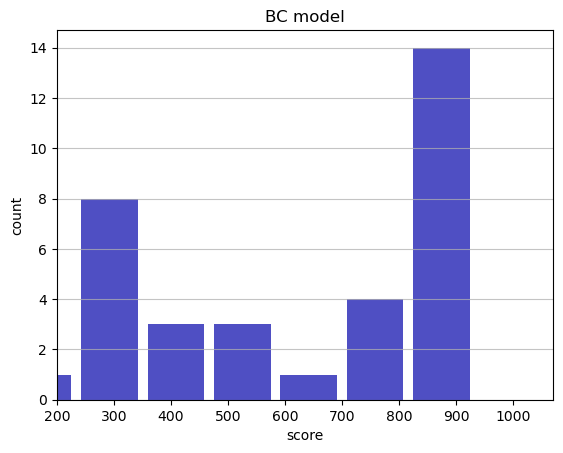

Track generation: 1064..1334 -> 270-tiles track
Epoch: 35
BC	mean: 627.54	variance: 250.38


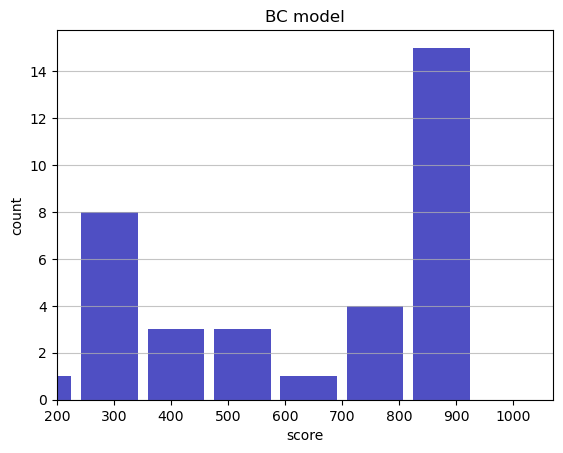

Track generation: 991..1247 -> 256-tiles track
Epoch: 36
BC	mean: 632.64	variance: 248.71


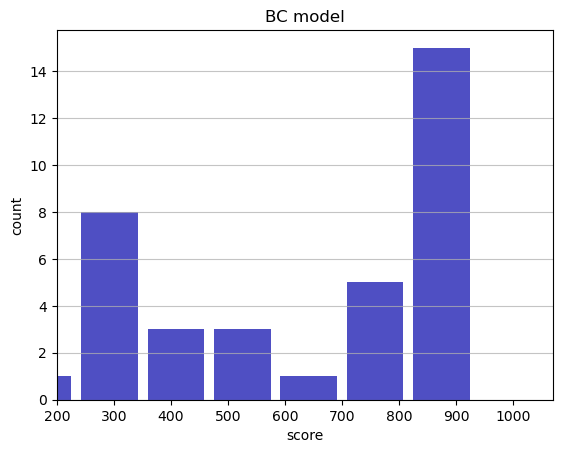

Track generation: 1139..1428 -> 289-tiles track
Epoch: 37
BC	mean: 624.08	variance: 250.65


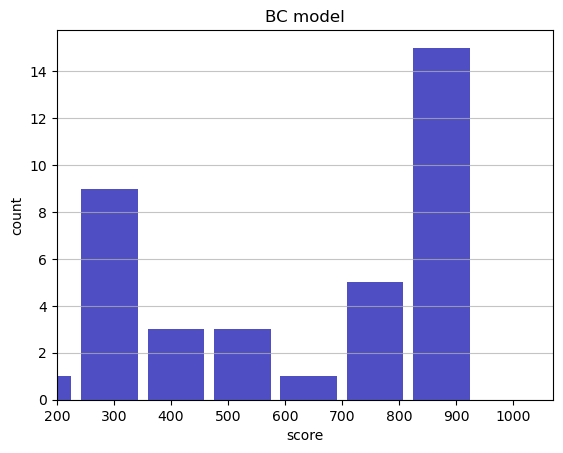

Track generation: 1116..1399 -> 283-tiles track
Epoch: 38
BC	mean: 616.13	variance: 252.00


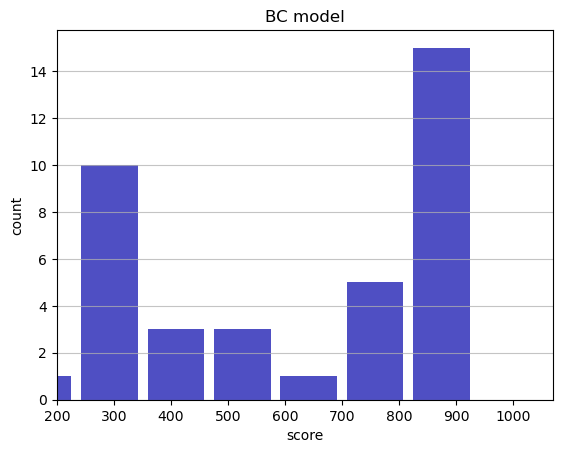

Track generation: 1280..1604 -> 324-tiles track
Epoch: 39
BC	mean: 621.77	variance: 251.16


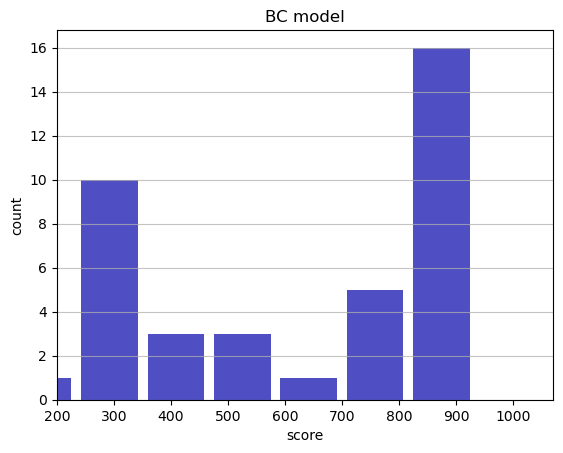

Track generation: 1172..1469 -> 297-tiles track
Epoch: 40
BC	mean: 614.93	variance: 251.65


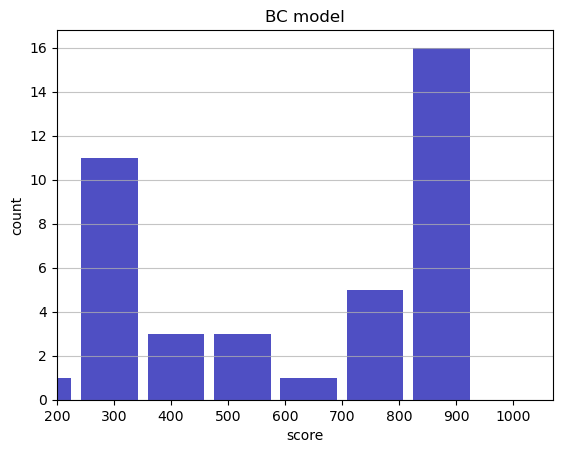

Track generation: 1176..1474 -> 298-tiles track
Epoch: 41
BC	mean: 613.04	variance: 248.85


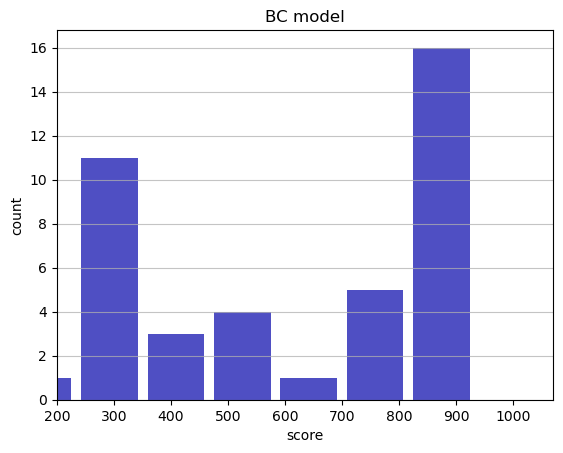

Track generation: 1163..1458 -> 295-tiles track
Epoch: 42
BC	mean: 617.91	variance: 247.85


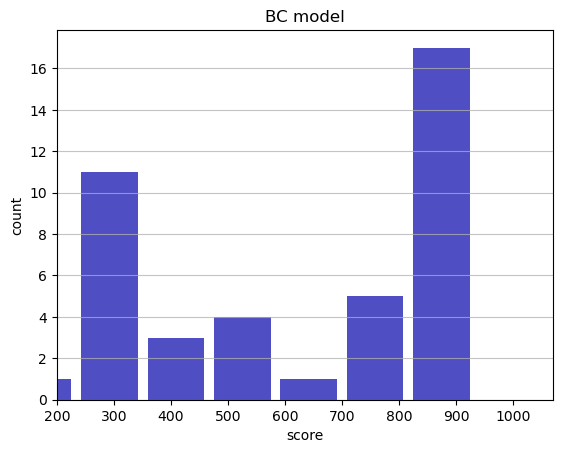

Track generation: 1164..1459 -> 295-tiles track
Epoch: 43
BC	mean: 622.80	variance: 246.98


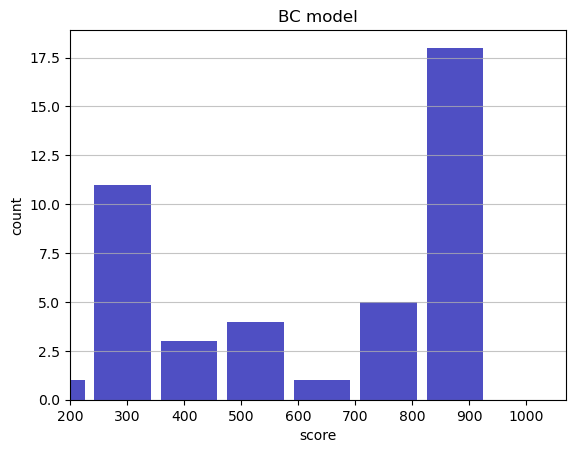

Track generation: 1087..1363 -> 276-tiles track
Epoch: 44
BC	mean: 627.95	variance: 246.48


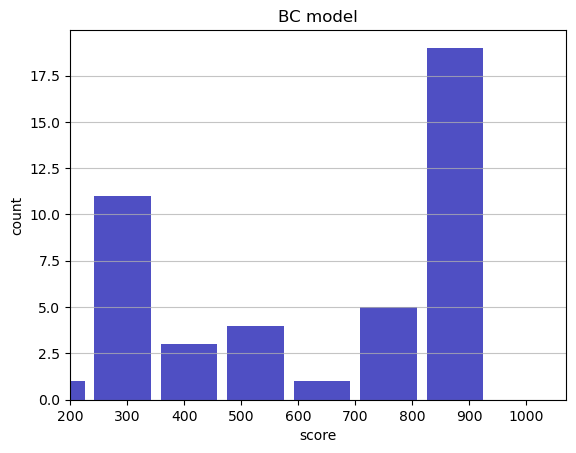

Track generation: 1094..1379 -> 285-tiles track
Epoch: 45
BC	mean: 635.59	variance: 248.94


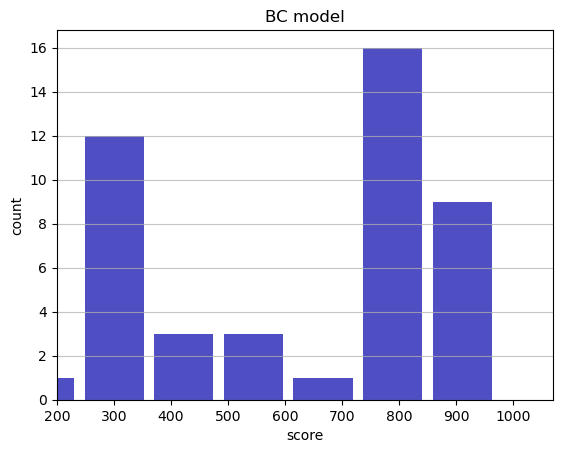

Track generation: 1081..1363 -> 282-tiles track
Epoch: 46
BC	mean: 639.05	variance: 247.32


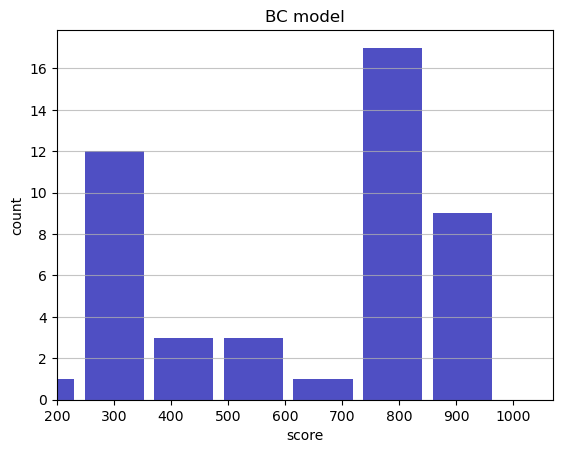

Track generation: 1142..1436 -> 294-tiles track
Epoch: 47
BC	mean: 643.04	variance: 246.16


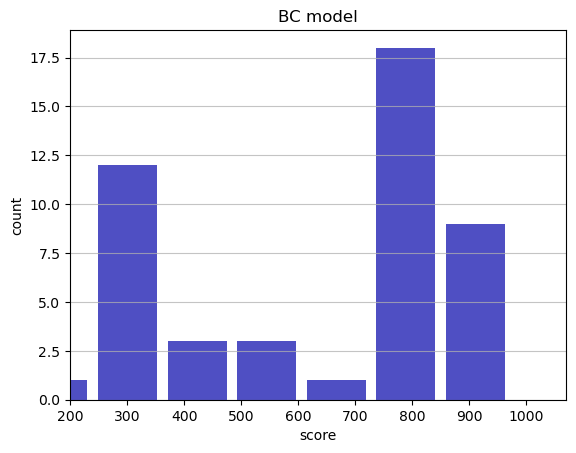

Track generation: 1040..1307 -> 267-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1156..1449 -> 293-tiles track
Epoch: 48
BC	mean: 641.10	variance: 243.95


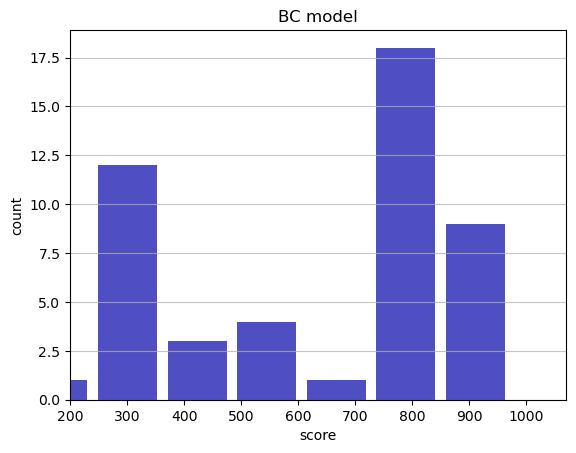

Track generation: 1119..1401 -> 282-tiles track
Epoch: 49
BC	mean: 636.03	variance: 243.99


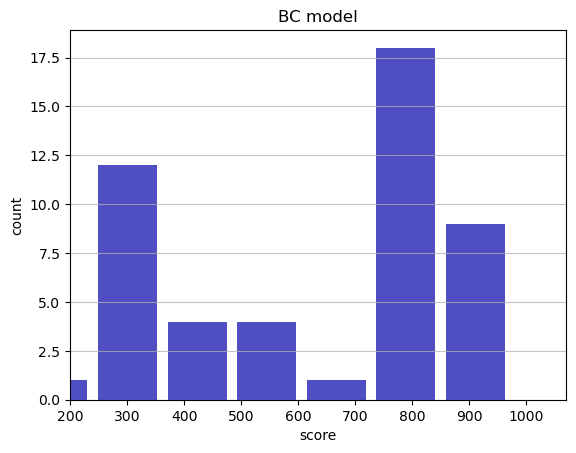

Track generation: 1011..1268 -> 257-tiles track
Epoch: 50
BC	mean: 639.50	variance: 242.75


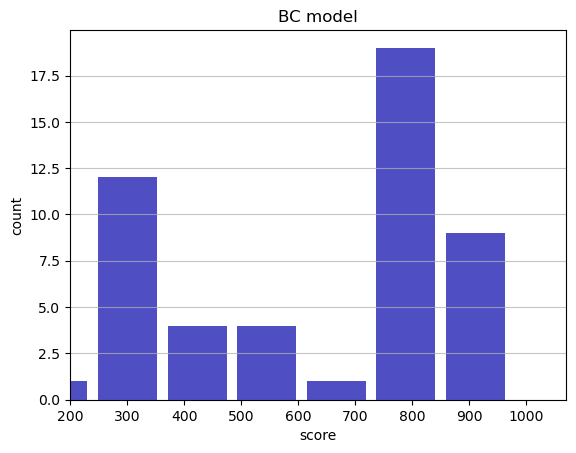

Track generation: 1364..1709 -> 345-tiles track
Epoch: 51
BC	mean: 642.40	variance: 241.24


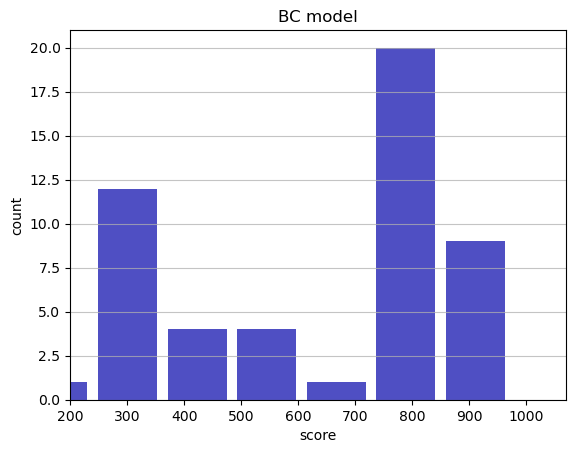

Track generation: 1011..1268 -> 257-tiles track
Epoch: 52
BC	mean: 646.20	variance: 240.44


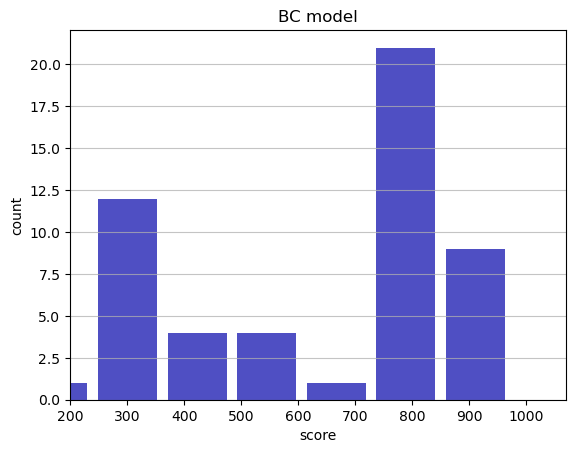

Track generation: 1120..1404 -> 284-tiles track
Epoch: 53
BC	mean: 645.57	variance: 238.20


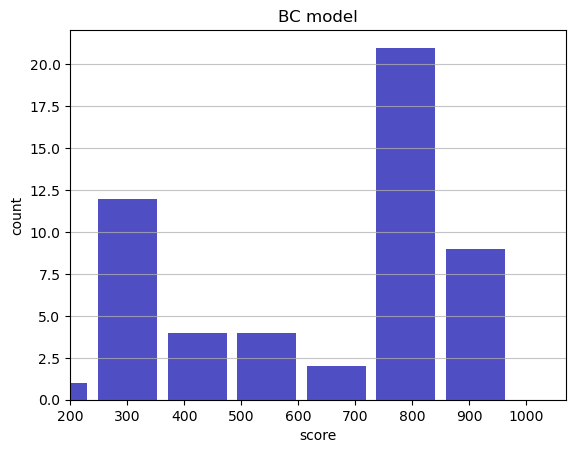

Track generation: 1055..1328 -> 273-tiles track
Epoch: 54
BC	mean: 651.32	variance: 239.66


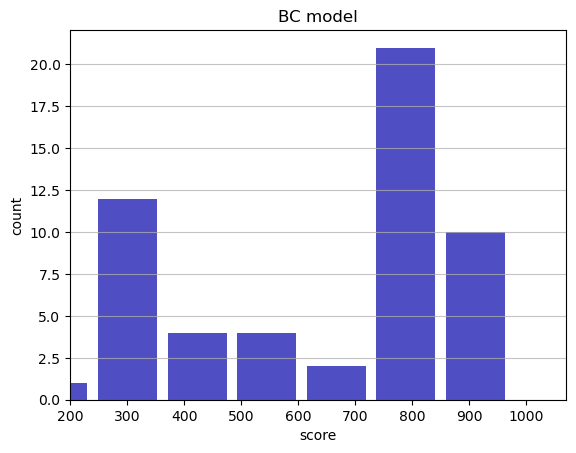

Track generation: 1316..1649 -> 333-tiles track
Epoch: 55
BC	mean: 647.45	variance: 239.17


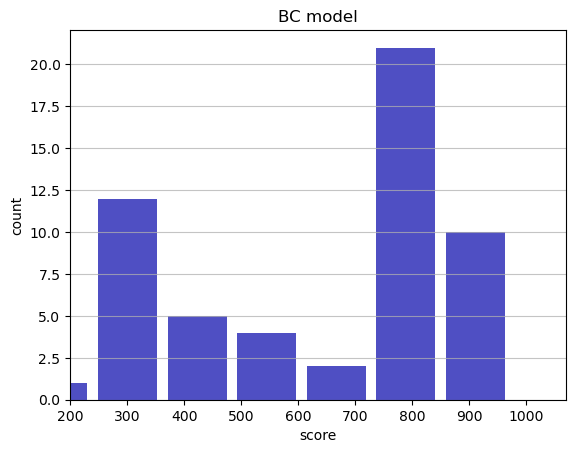

Track generation: 1094..1372 -> 278-tiles track
Epoch: 56
BC	mean: 651.15	variance: 238.62


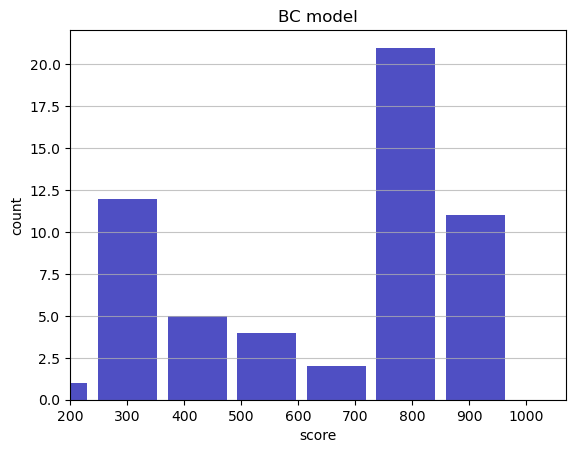

Track generation: 1219..1528 -> 309-tiles track
Epoch: 57
BC	mean: 654.11	variance: 237.55


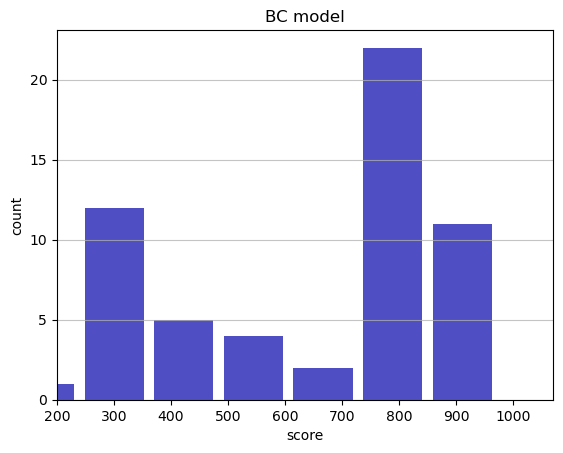

Track generation: 1160..1454 -> 294-tiles track
Epoch: 58
BC	mean: 647.31	variance: 241.01


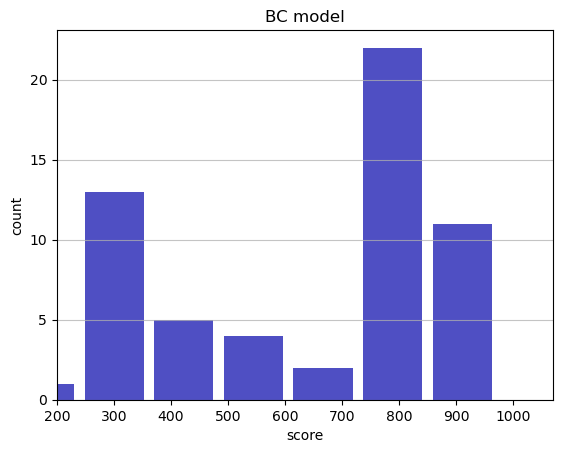

Track generation: 1141..1430 -> 289-tiles track
Epoch: 59
BC	mean: 651.07	variance: 240.66


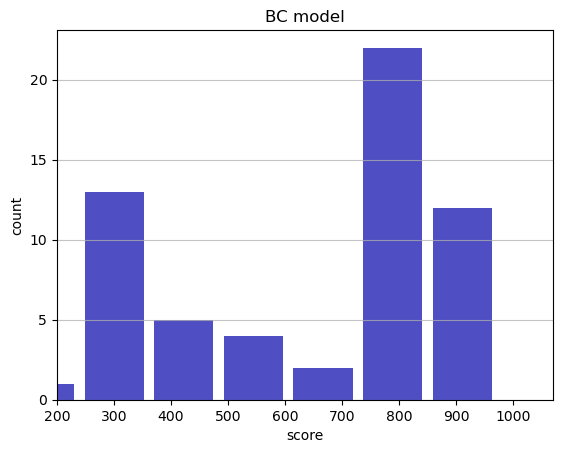

Track generation: 1081..1355 -> 274-tiles track
Epoch: 60
BC	mean: 654.20	variance: 239.86


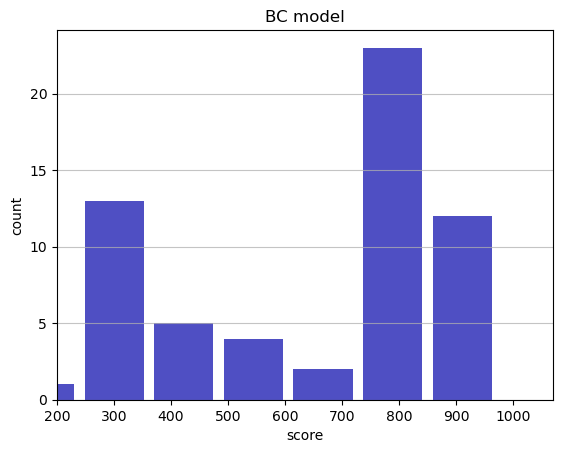

Track generation: 1303..1633 -> 330-tiles track
Epoch: 61
BC	mean: 658.38	variance: 240.08


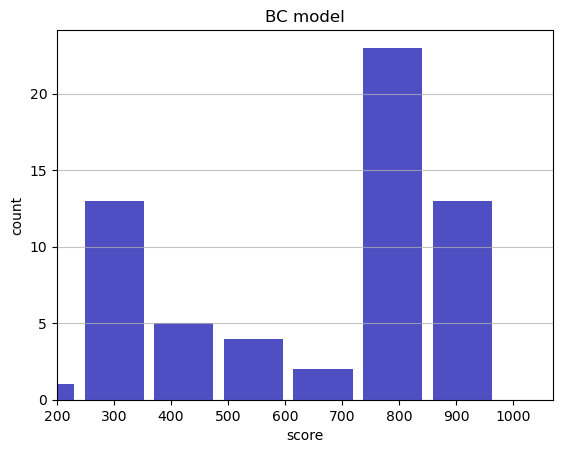

Track generation: 1223..1533 -> 310-tiles track
Epoch: 62
BC	mean: 652.29	variance: 242.82


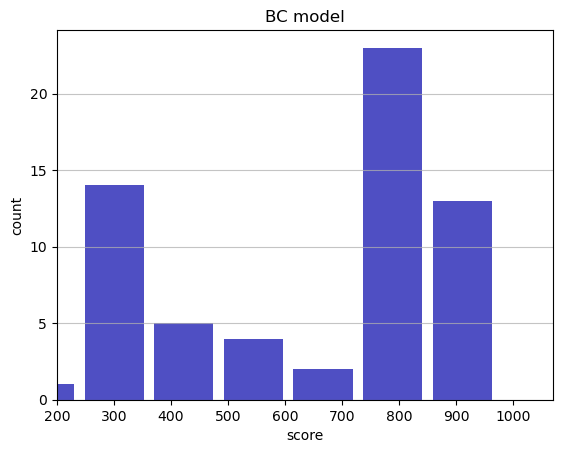

Track generation: 1207..1513 -> 306-tiles track
Epoch: 63
BC	mean: 655.63	variance: 242.32


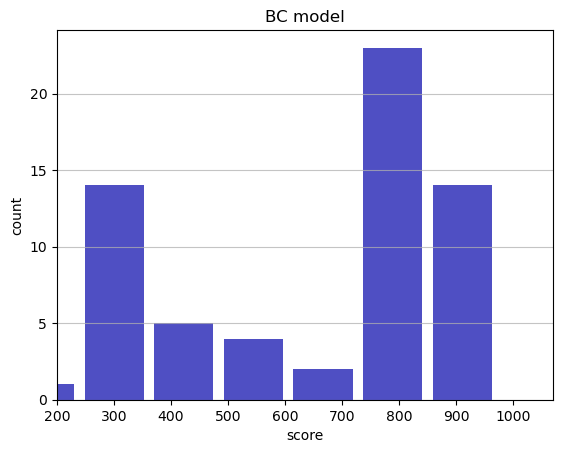

Track generation: 1203..1508 -> 305-tiles track
Epoch: 64
BC	mean: 658.89	variance: 241.81


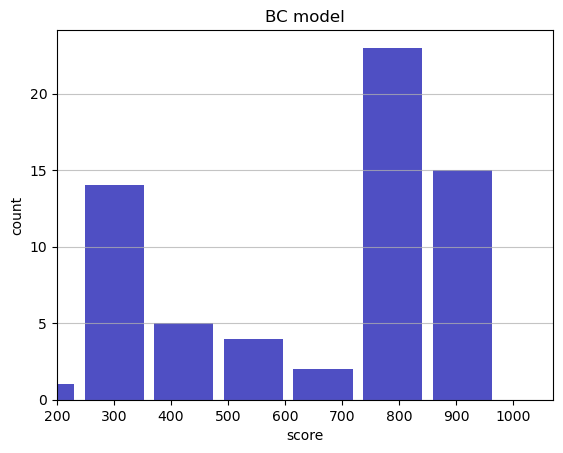

Track generation: 1195..1498 -> 303-tiles track
Epoch: 65
BC	mean: 660.53	variance: 240.30


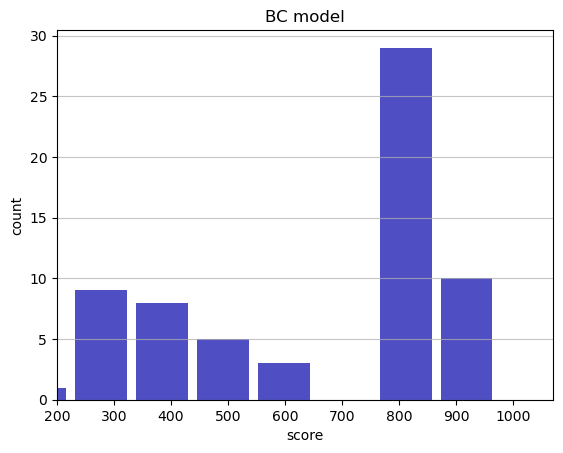

Track generation: 1103..1383 -> 280-tiles track
Epoch: 66
BC	mean: 662.98	variance: 239.29


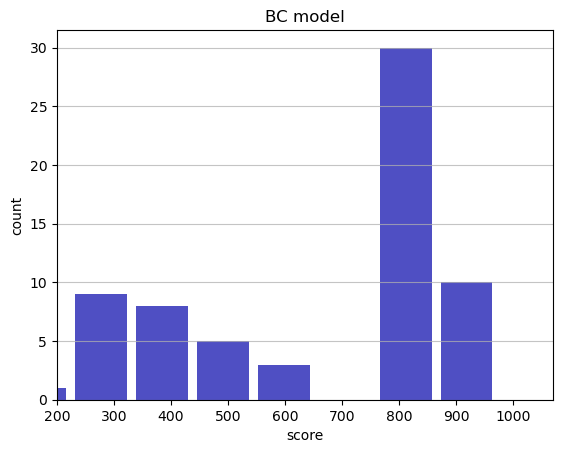

Track generation: 1072..1344 -> 272-tiles track
Epoch: 67
BC	mean: 657.91	variance: 241.04


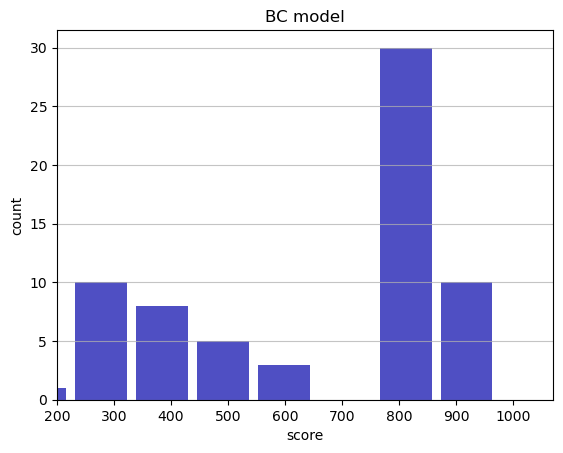

Track generation: 1145..1435 -> 290-tiles track
Epoch: 68
BC	mean: 660.61	variance: 240.28


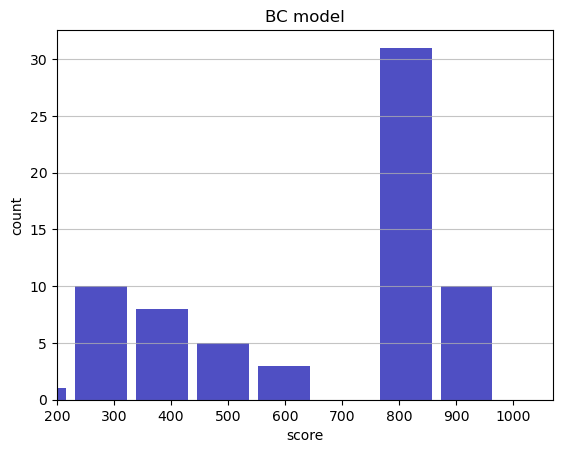

Track generation: 1095..1373 -> 278-tiles track
Epoch: 69
BC	mean: 664.64	variance: 240.83


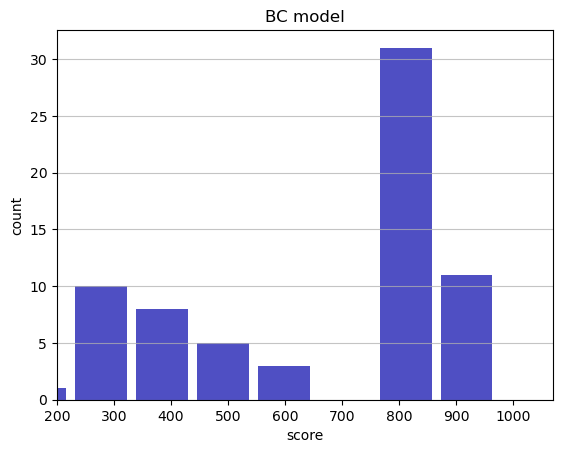

Track generation: 1244..1559 -> 315-tiles track
Epoch: 70
BC	mean: 665.35	variance: 239.18


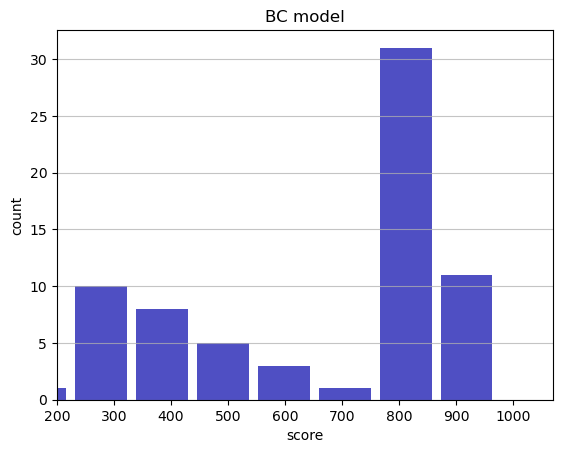

Track generation: 1271..1593 -> 322-tiles track
Epoch: 71
BC	mean: 667.33	variance: 238.07


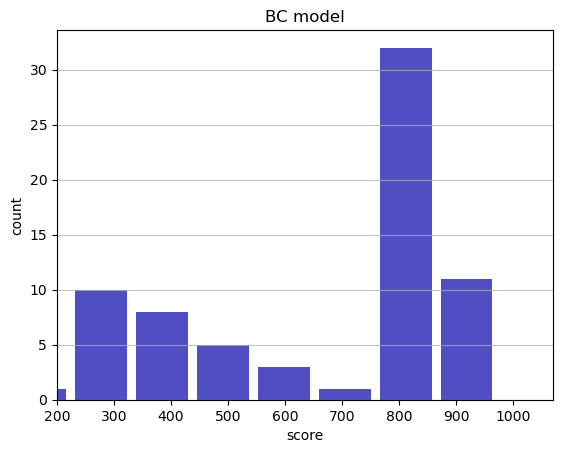

Track generation: 1132..1419 -> 287-tiles track
Epoch: 72
BC	mean: 670.00	variance: 237.48


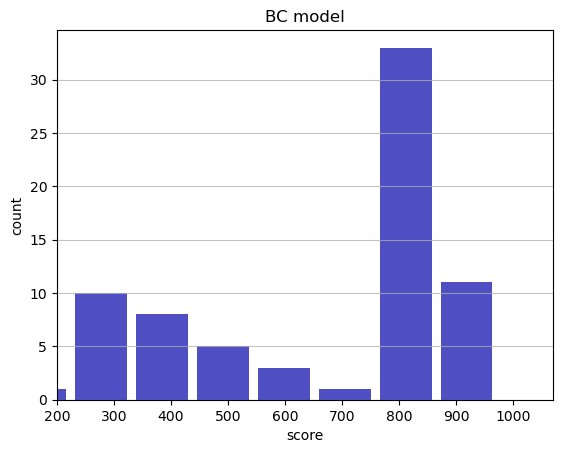

Track generation: 1202..1507 -> 305-tiles track
Epoch: 73
BC	mean: 671.90	variance: 236.40


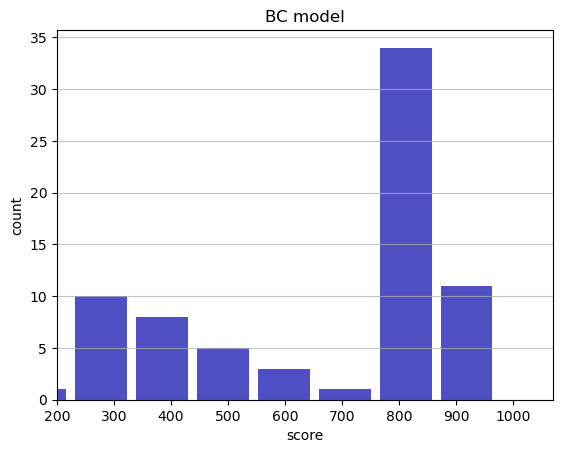

Track generation: 1124..1409 -> 285-tiles track
Epoch: 74
BC	mean: 674.24	variance: 235.64


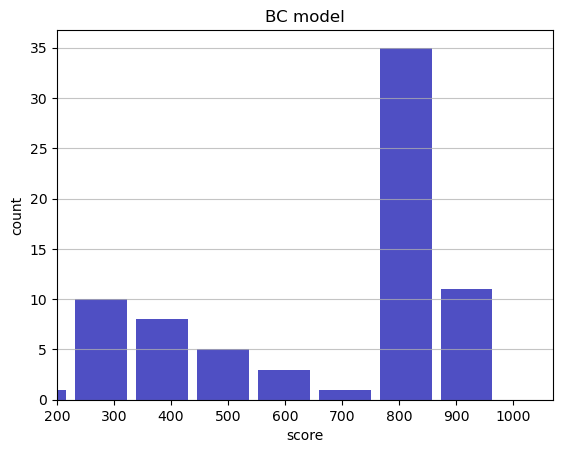

Track generation: 1131..1420 -> 289-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1040..1308 -> 268-tiles track
Epoch: 75
BC	mean: 671.73	variance: 235.06


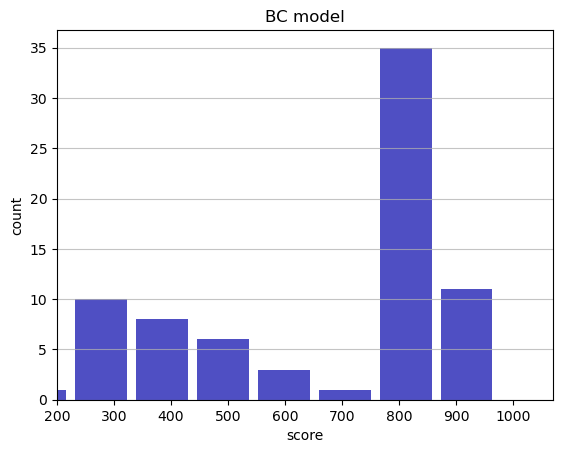

Track generation: 1125..1410 -> 285-tiles track
Epoch: 76
BC	mean: 666.41	variance: 238.02


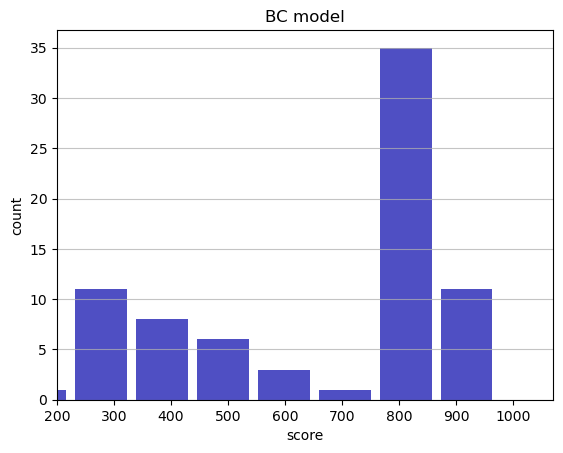

Track generation: 1138..1430 -> 292-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1106..1389 -> 283-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1179..1487 -> 308-tiles track
Epoch: 77
BC	mean: 663.64	variance: 237.70


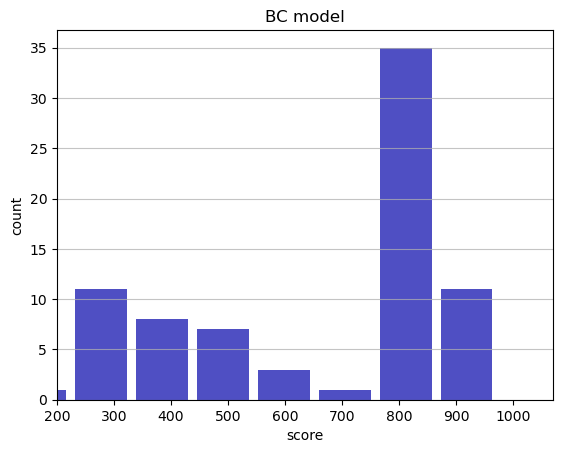

Track generation: 1182..1481 -> 299-tiles track
Epoch: 78
BC	mean: 660.16	variance: 238.13


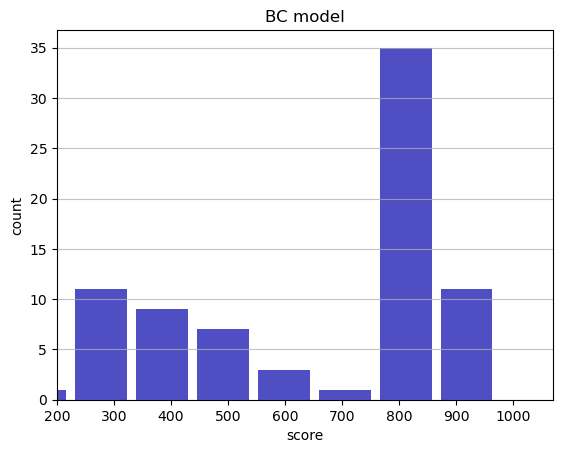

Track generation: 1278..1602 -> 324-tiles track
Epoch: 79
BC	mean: 662.97	variance: 237.92


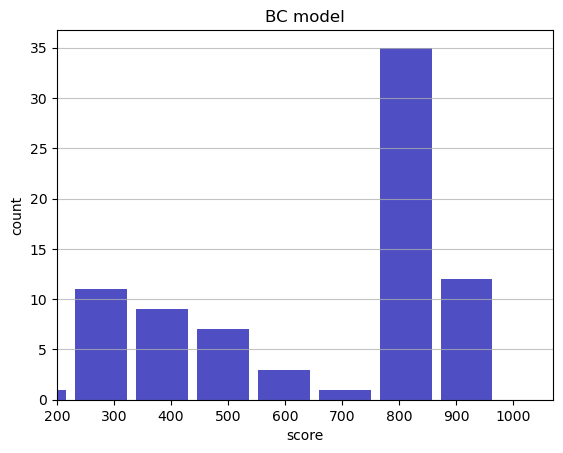

Track generation: 1077..1351 -> 274-tiles track
Epoch: 80
BC	mean: 661.74	variance: 236.68


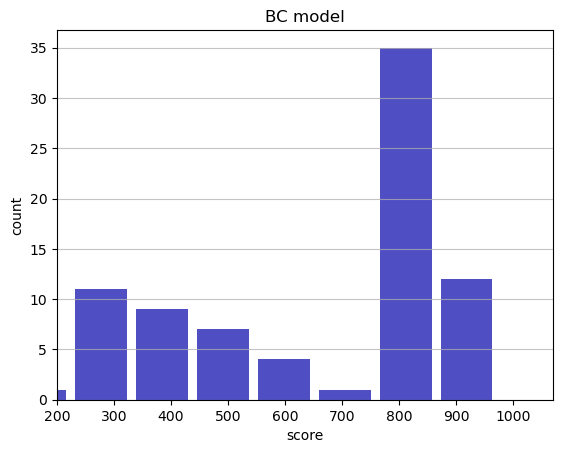

Track generation: 1050..1317 -> 267-tiles track
Epoch: 81
BC	mean: 657.91	variance: 237.69


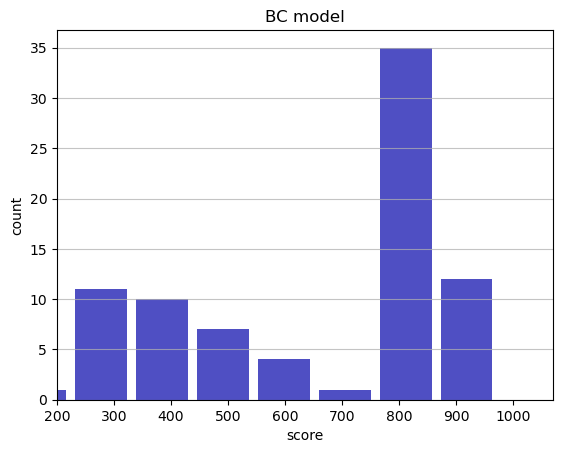

Track generation: 1151..1443 -> 292-tiles track
Epoch: 82
BC	mean: 659.72	variance: 236.80


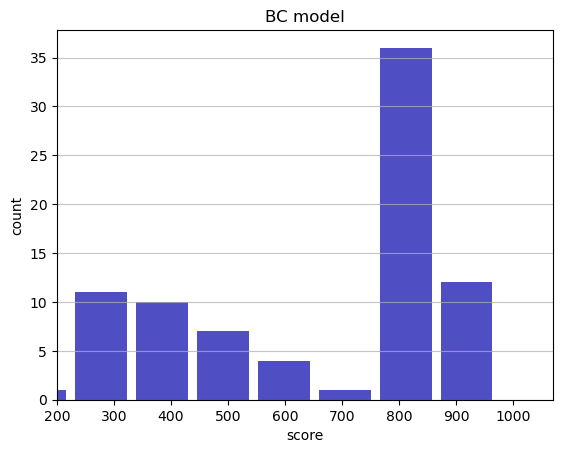

Track generation: 1218..1527 -> 309-tiles track
Epoch: 83
BC	mean: 656.67	variance: 236.98


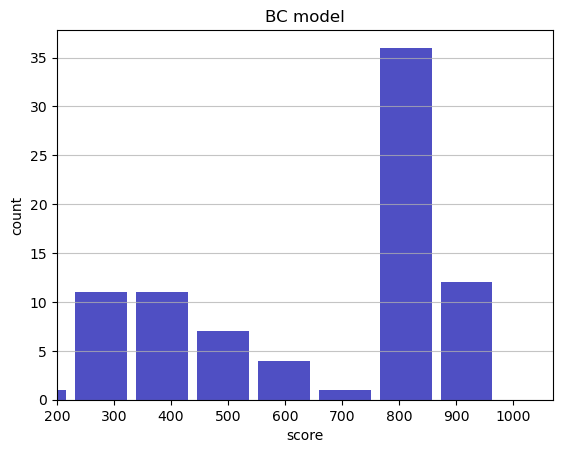

Track generation: 1044..1309 -> 265-tiles track
Epoch: 84
BC	mean: 658.11	variance: 235.93


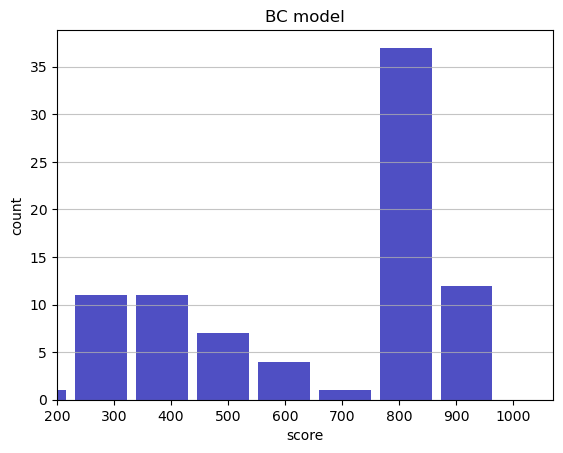

Track generation: 1051..1325 -> 274-tiles track
Epoch: 85
BC	mean: 652.23	variance: 240.65


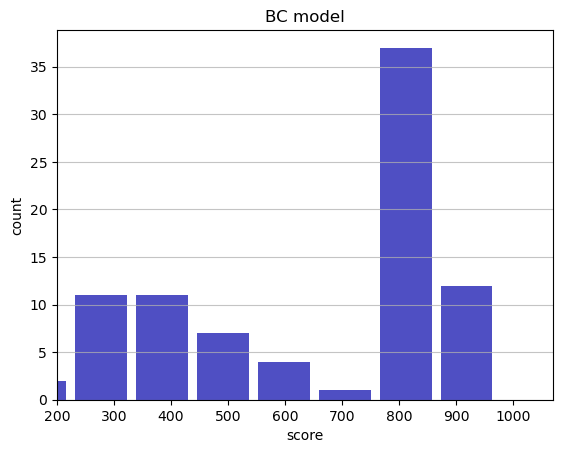

Track generation: 1159..1460 -> 301-tiles track
Epoch: 86
BC	mean: 654.40	variance: 240.08


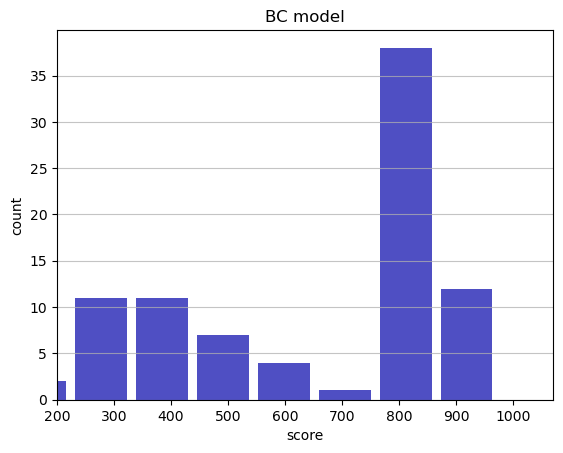

Track generation: 1047..1313 -> 266-tiles track
Epoch: 87
BC	mean: 650.63	variance: 241.23


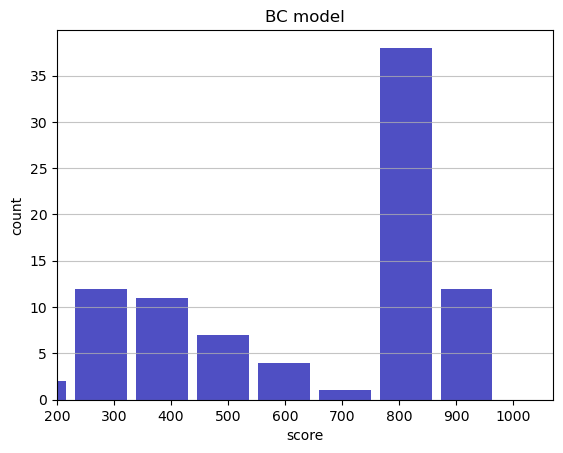

Track generation: 1092..1369 -> 277-tiles track
Epoch: 88
BC	mean: 652.85	variance: 240.75


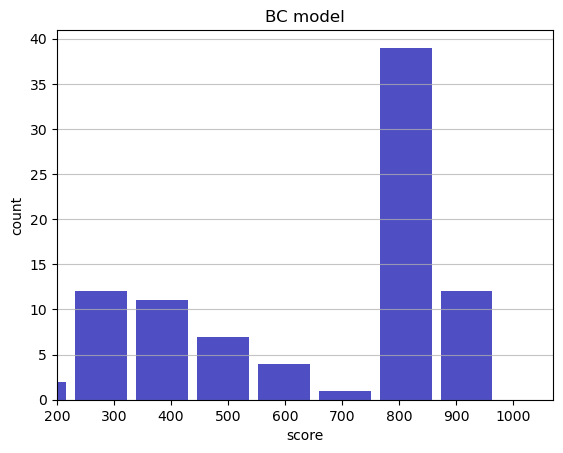

Track generation: 1168..1464 -> 296-tiles track
Epoch: 89
BC	mean: 648.89	variance: 242.25


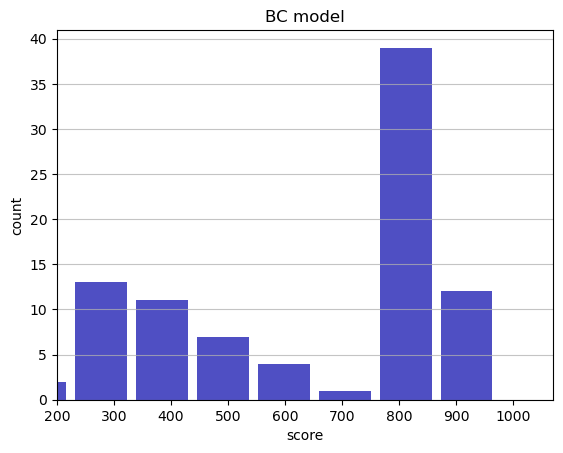

Track generation: 1071..1343 -> 272-tiles track
Epoch: 90
BC	mean: 651.40	variance: 242.05


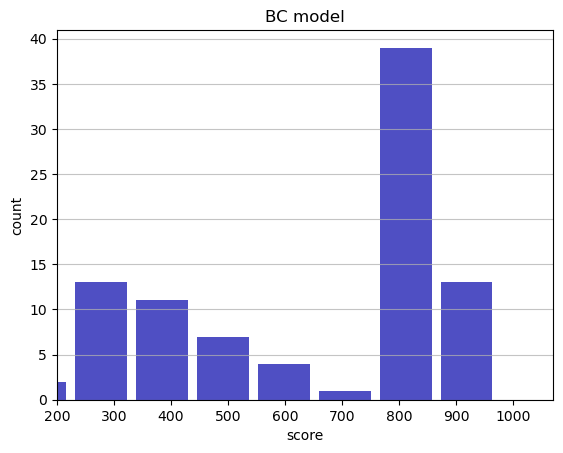

Track generation: 1098..1384 -> 286-tiles track
Epoch: 91
BC	mean: 648.59	variance: 242.19


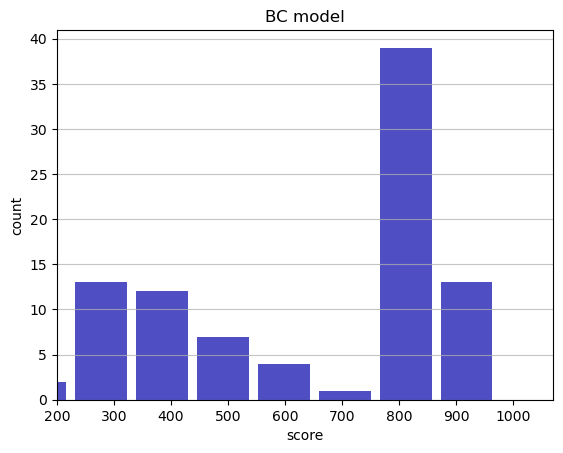

Track generation: 1076..1349 -> 273-tiles track
Epoch: 92
BC	mean: 645.34	variance: 242.86


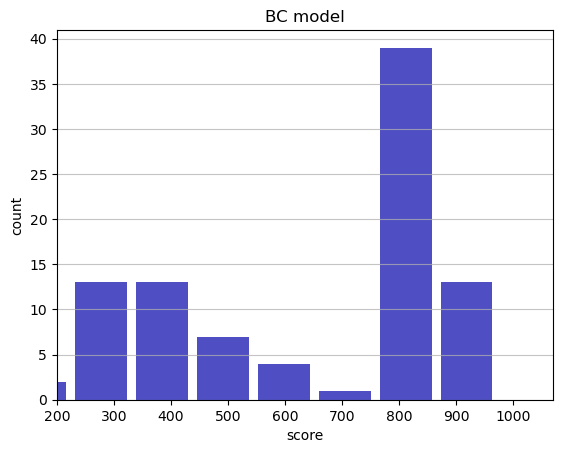

Track generation: 1235..1548 -> 313-tiles track
Epoch: 93
BC	mean: 641.99	variance: 243.68


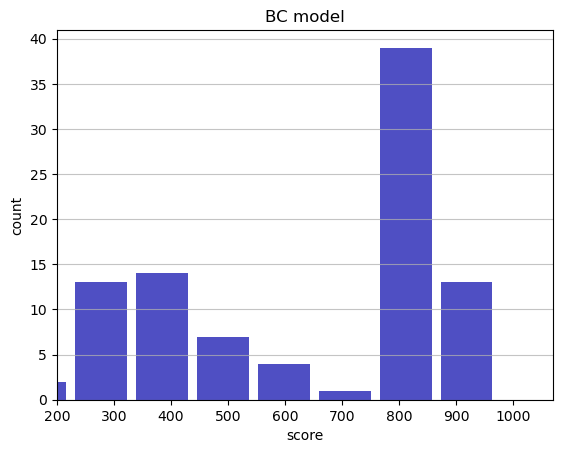

Track generation: 1072..1344 -> 272-tiles track
Epoch: 94
BC	mean: 641.38	variance: 242.45


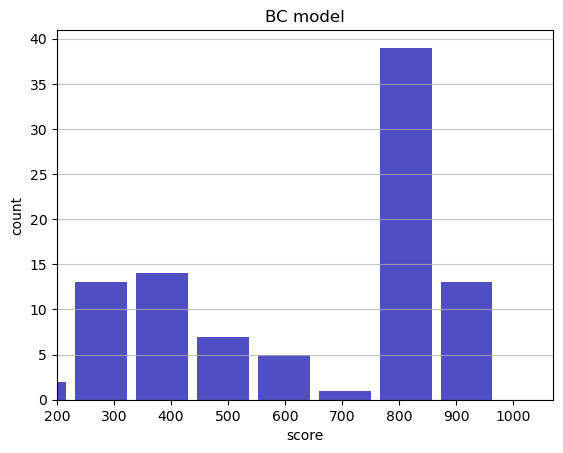

Track generation: 1227..1538 -> 311-tiles track
Epoch: 95
BC	mean: 641.32	variance: 241.17


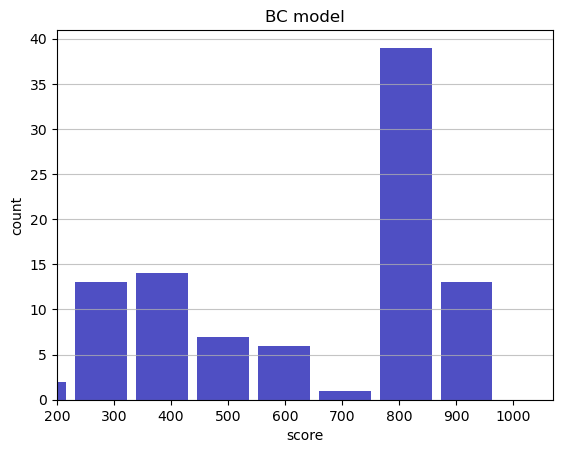

Track generation: 1134..1422 -> 288-tiles track
Epoch: 96
BC	mean: 638.96	variance: 241.01


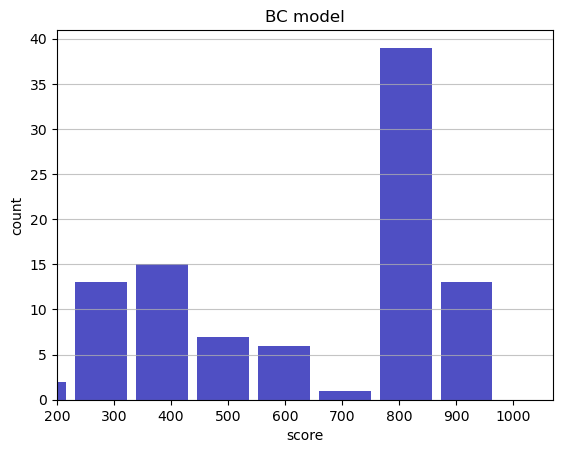

Track generation: 1127..1419 -> 292-tiles track
Epoch: 97
BC	mean: 636.26	variance: 241.22


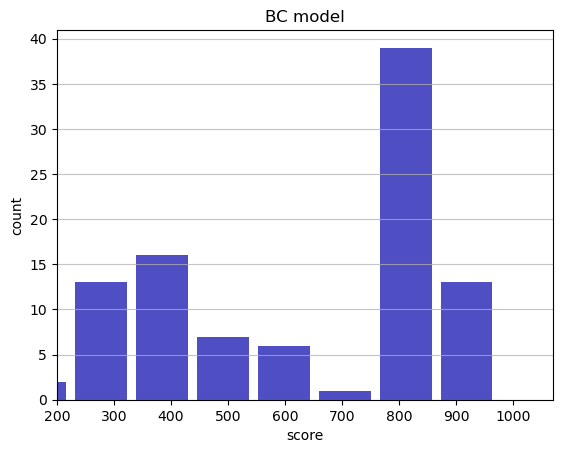

Track generation: 1071..1343 -> 272-tiles track
Epoch: 98
BC	mean: 635.44	variance: 240.12


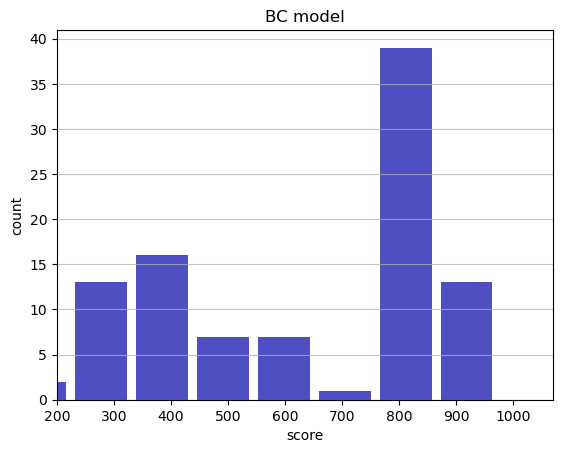

Track generation: 1259..1578 -> 319-tiles track
Epoch: 99
BC	mean: 632.87	variance: 240.26


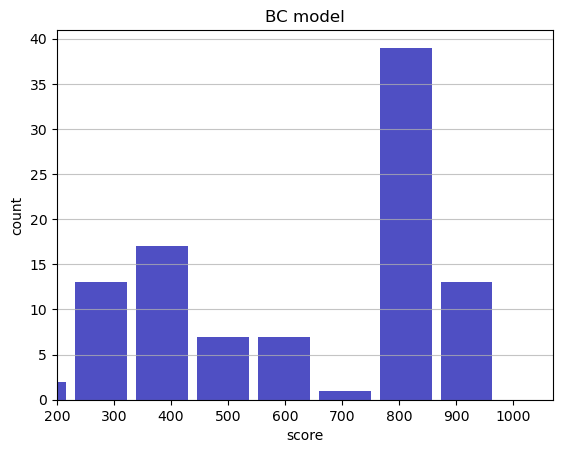

Track generation: 1166..1462 -> 296-tiles track
Epoch: 100
BC	mean: 634.87	variance: 239.89


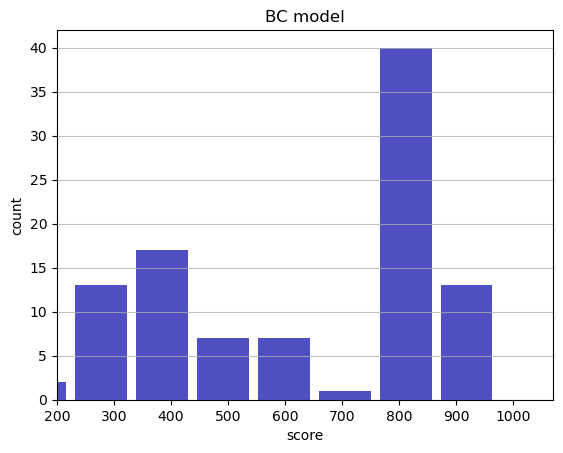

Track generation: 1085..1360 -> 275-tiles track
Epoch: 101
BC	mean: 632.36	variance: 240.02


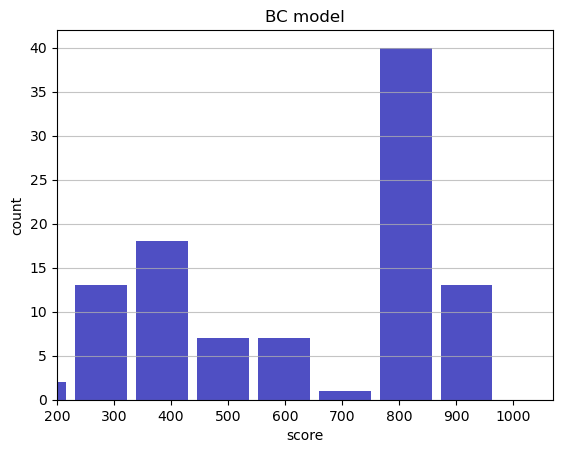

Track generation: 1153..1445 -> 292-tiles track
Epoch: 102
BC	mean: 634.47	variance: 239.79


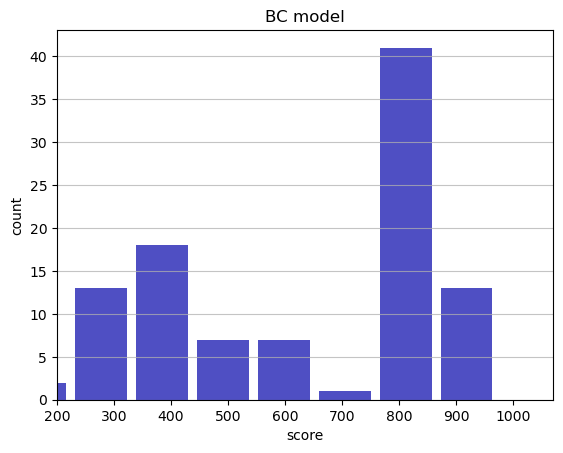

Track generation: 1131..1418 -> 287-tiles track
Epoch: 103
BC	mean: 636.67	variance: 239.65


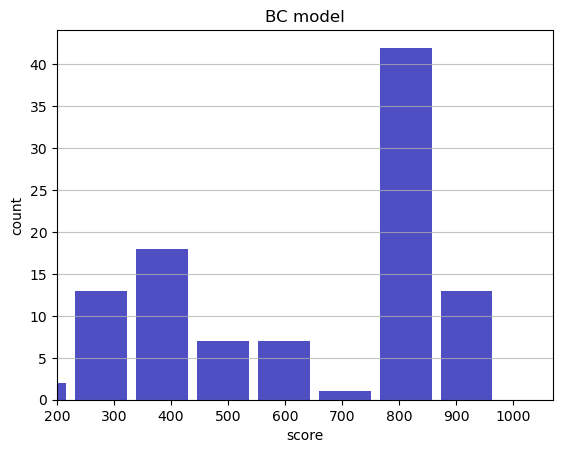

Track generation: 1108..1389 -> 281-tiles track
Epoch: 104
BC	mean: 633.74	variance: 240.34


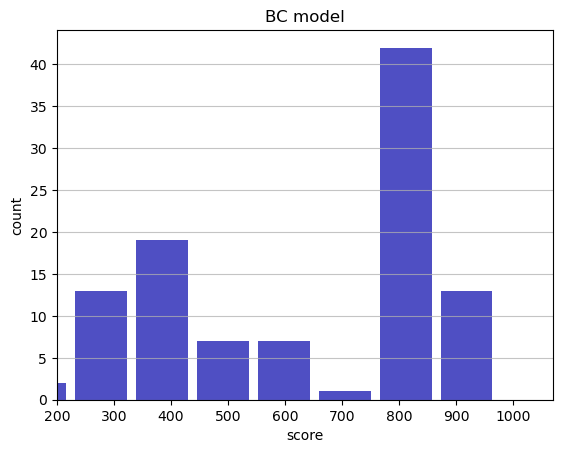

Track generation: 1258..1576 -> 318-tiles track
Epoch: 105
BC	mean: 636.03	variance: 240.34


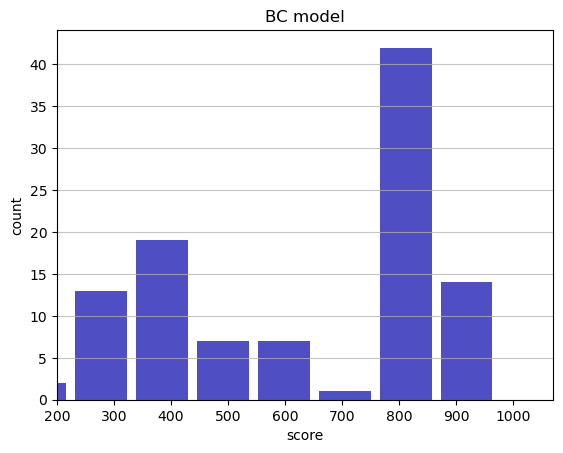

Track generation: 1122..1407 -> 285-tiles track
Epoch: 106
BC	mean: 637.74	variance: 239.84


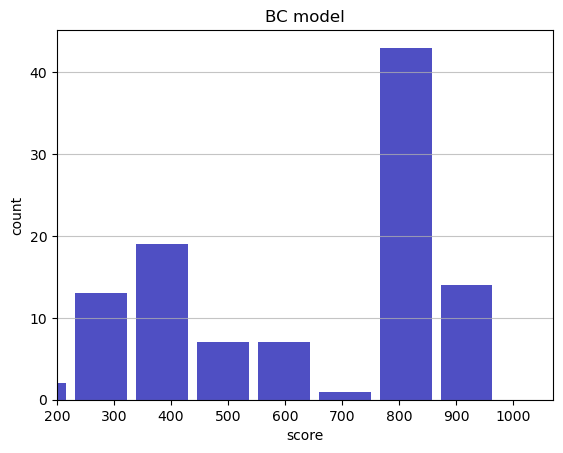

Track generation: 971..1218 -> 247-tiles track
Epoch: 107
BC	mean: 636.08	variance: 239.33


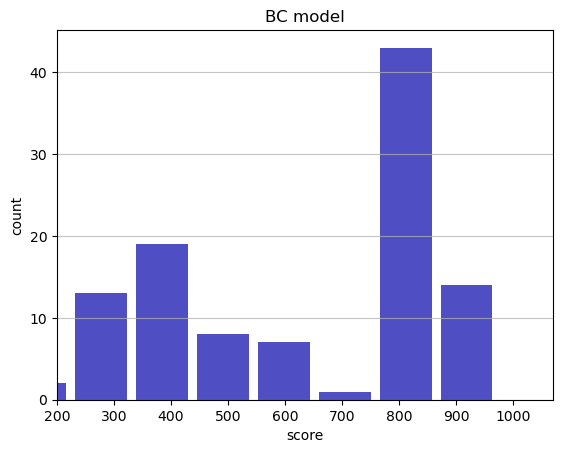

Track generation: 1020..1286 -> 266-tiles track
Epoch: 108
BC	mean: 633.26	variance: 239.99


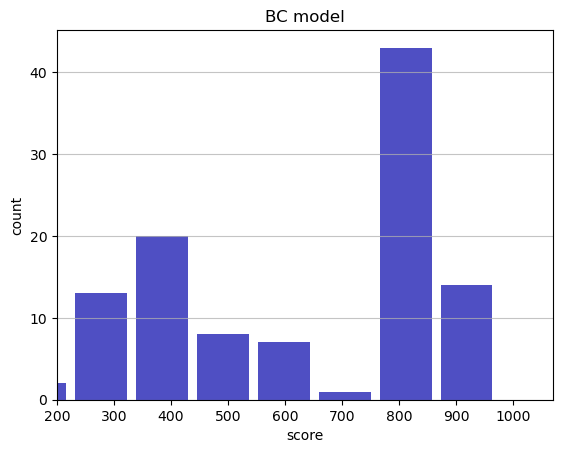

Track generation: 1025..1285 -> 260-tiles track
Epoch: 109
BC	mean: 631.34	variance: 239.72


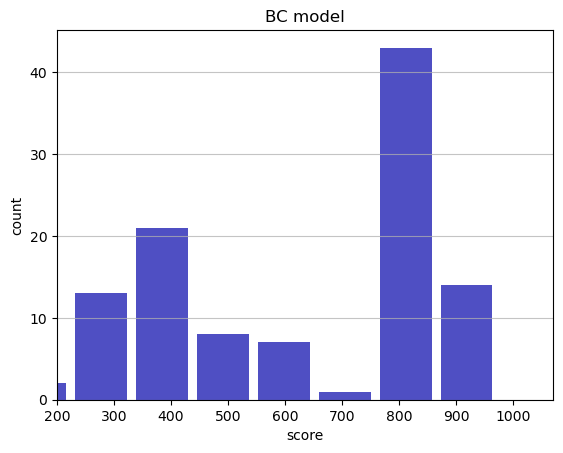

Track generation: 1157..1456 -> 299-tiles track
Epoch: 110
BC	mean: 628.08	variance: 241.05


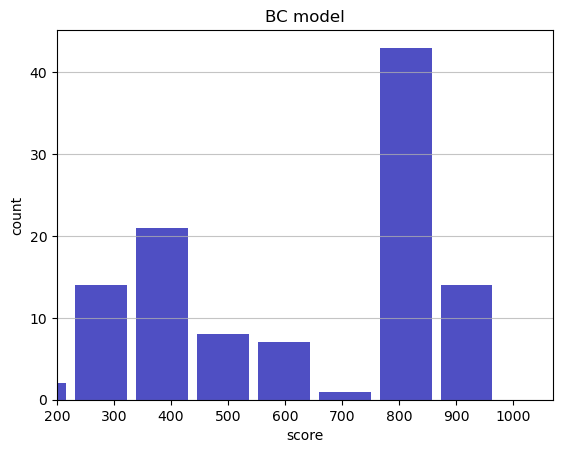

Track generation: 959..1207 -> 248-tiles track
Epoch: 111
BC	mean: 630.45	variance: 241.25


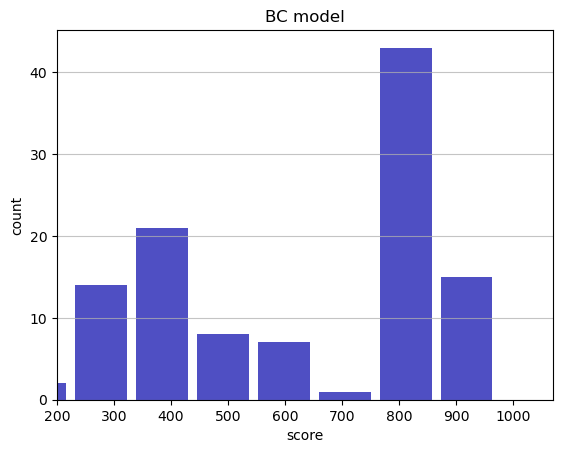

Track generation: 1091..1368 -> 277-tiles track
Epoch: 112
BC	mean: 632.68	variance: 241.32


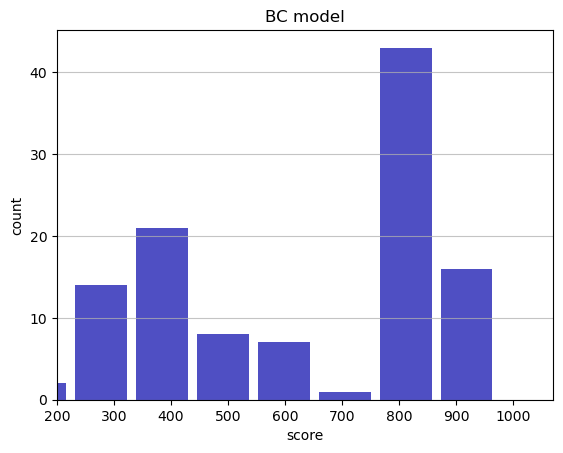

Track generation: 1387..1738 -> 351-tiles track
Epoch: 113
BC	mean: 633.06	variance: 240.28


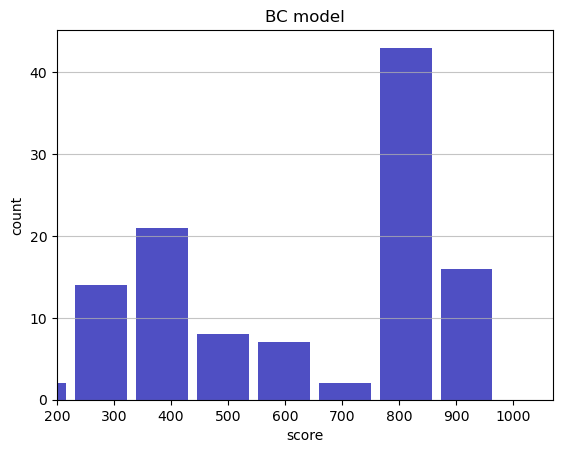

Track generation: 1322..1656 -> 334-tiles track
Epoch: 114
BC	mean: 631.71	variance: 239.65


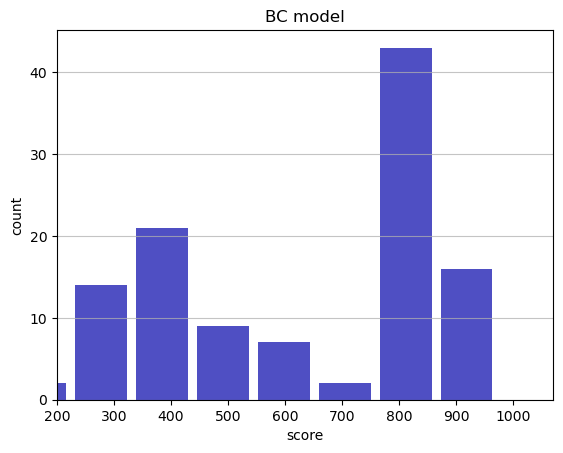

Track generation: 1157..1454 -> 297-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1232..1544 -> 312-tiles track
Epoch: 115
BC	mean: 634.19	variance: 240.07


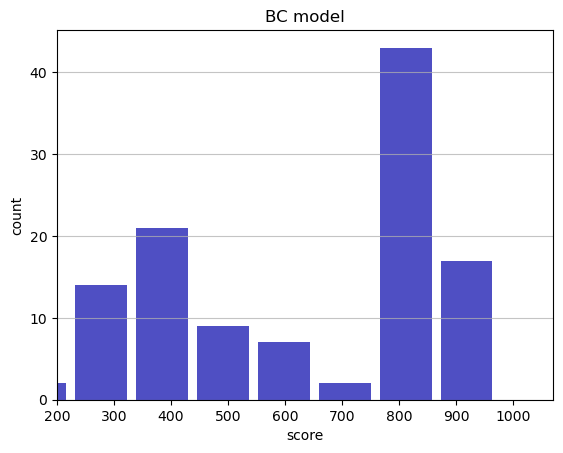

Track generation: 1176..1474 -> 298-tiles track
Epoch: 116
BC	mean: 635.83	variance: 239.68


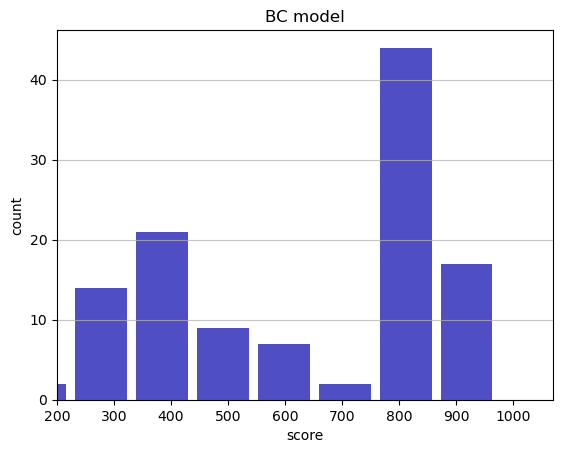

Track generation: 1265..1593 -> 328-tiles track
Epoch: 117
BC	mean: 632.82	variance: 240.83


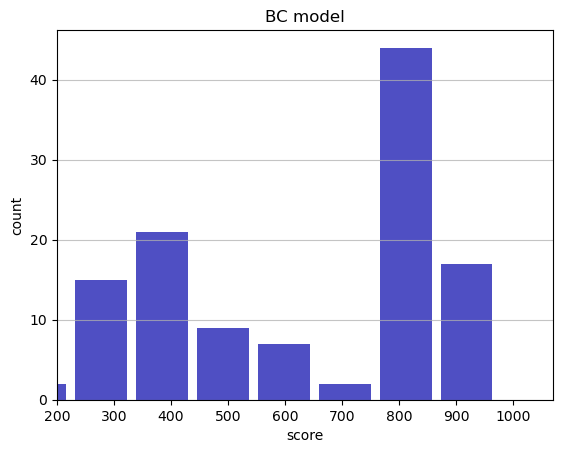

Track generation: 1096..1378 -> 282-tiles track
Epoch: 118
BC	mean: 634.41	variance: 240.43


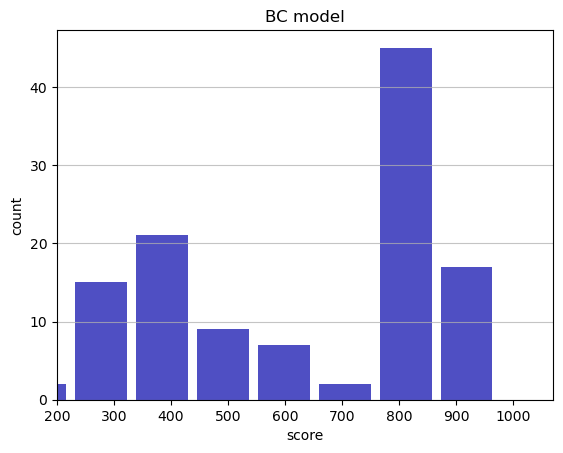

Track generation: 1205..1499 -> 294-tiles track
Epoch: 119
BC	mean: 635.08	variance: 239.52


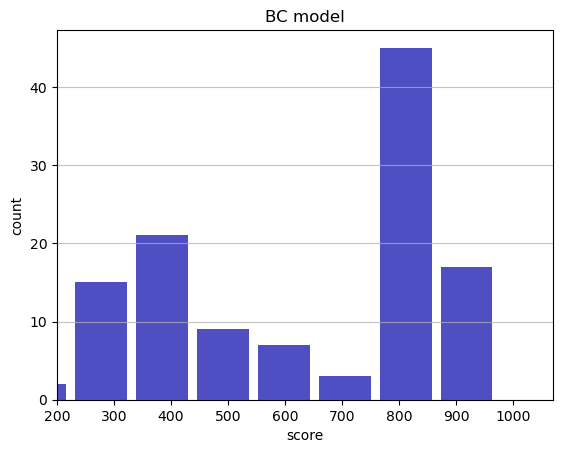

Track generation: 1189..1490 -> 301-tiles track
Epoch: 120
BC	mean: 635.37	variance: 238.54


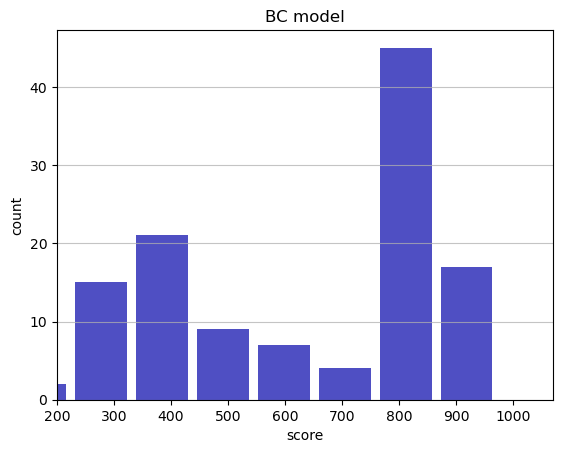

Track generation: 1111..1393 -> 282-tiles track
Epoch: 121
BC	mean: 634.26	variance: 237.87


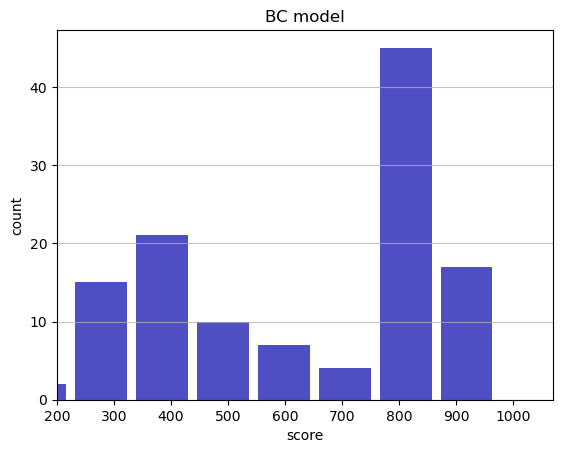

Track generation: 1339..1678 -> 339-tiles track
Epoch: 122
BC	mean: 633.65	variance: 236.98


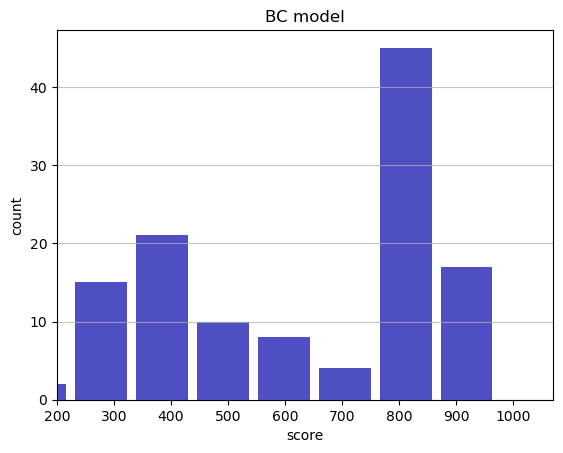

Track generation: 1087..1333 -> 246-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1212..1519 -> 307-tiles track
Epoch: 123
BC	mean: 630.62	variance: 238.37


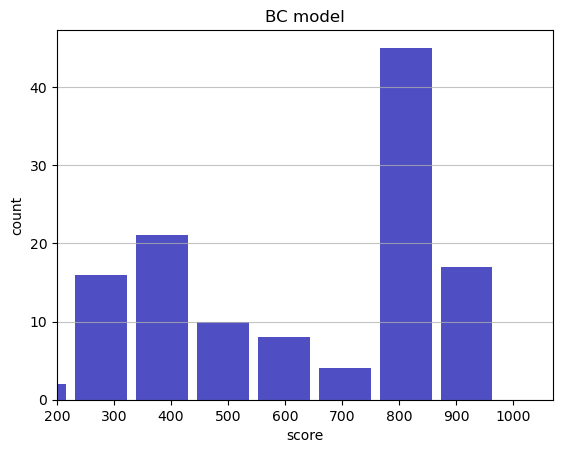

Track generation: 1041..1309 -> 268-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1178..1477 -> 299-tiles track
Epoch: 124
BC	mean: 632.31	variance: 238.14


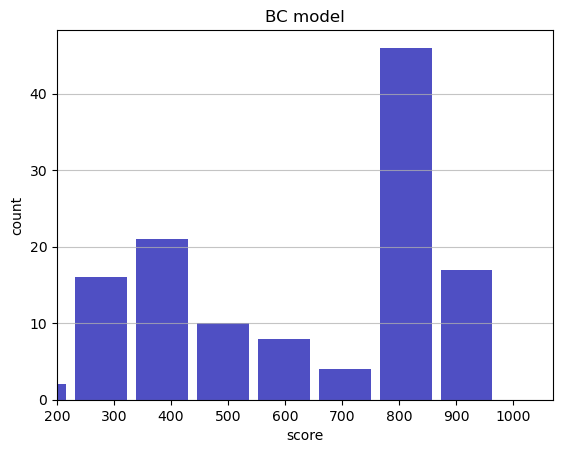

Track generation: 1196..1499 -> 303-tiles track
Epoch: 125
BC	mean: 629.96	variance: 238.62


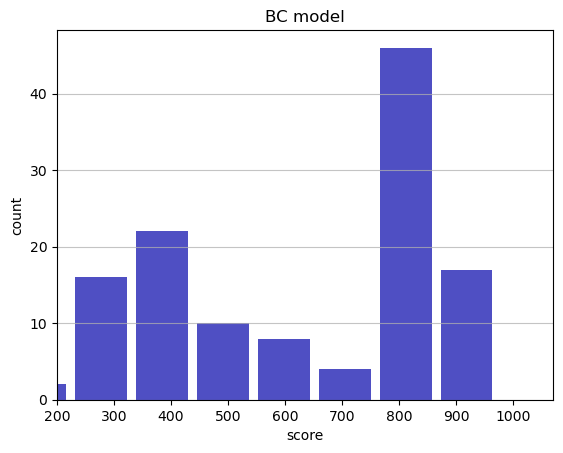

Track generation: 1180..1479 -> 299-tiles track
Epoch: 126
BC	mean: 628.64	variance: 238.13


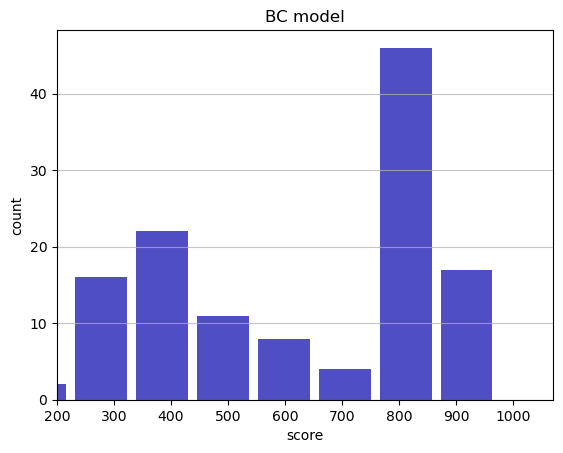

Track generation: 1095..1379 -> 284-tiles track
Epoch: 127
BC	mean: 628.58	variance: 237.19


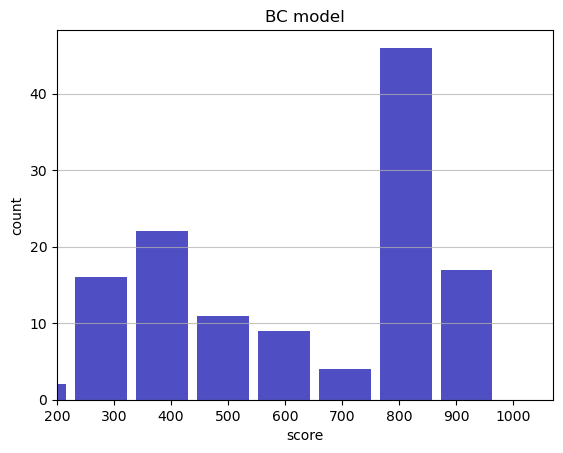

Track generation: 1096..1374 -> 278-tiles track
Epoch: 128
BC	mean: 626.40	variance: 237.53


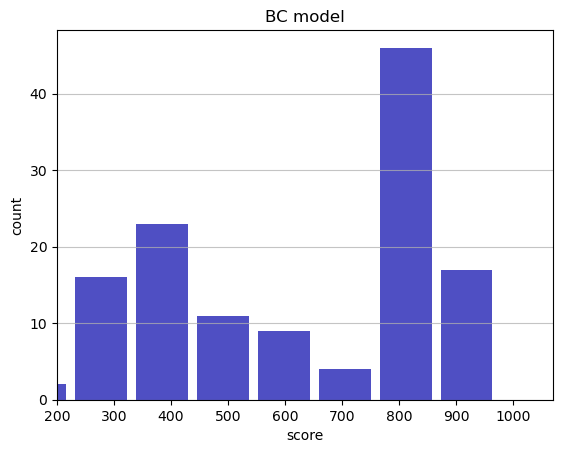

Track generation: 1219..1528 -> 309-tiles track
Epoch: 129
BC	mean: 628.07	variance: 237.36


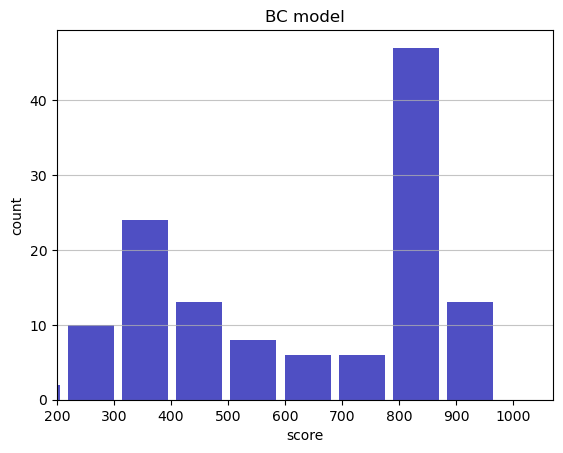

Track generation: 1351..1693 -> 342-tiles track
Epoch: 130
BC	mean: 629.25	variance: 236.82


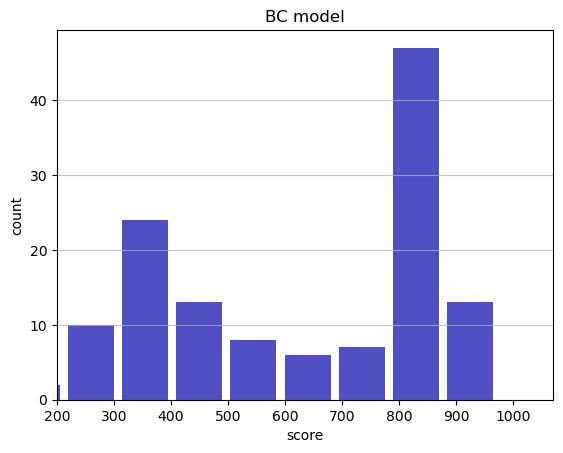

Track generation: 1085..1360 -> 275-tiles track
Epoch: 131
BC	mean: 631.11	variance: 236.86


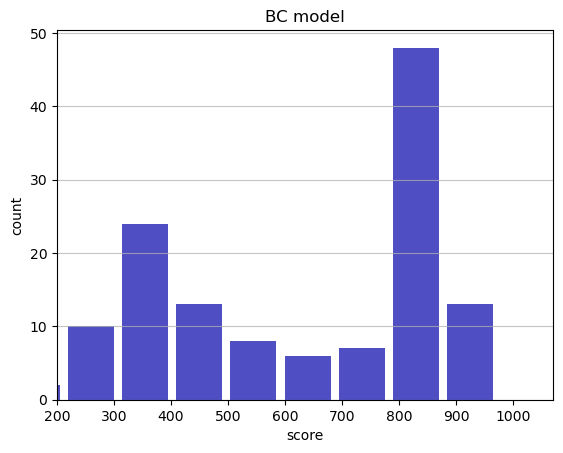

Track generation: 1102..1385 -> 283-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1107..1388 -> 281-tiles track
Epoch: 132
BC	mean: 632.70	variance: 236.67


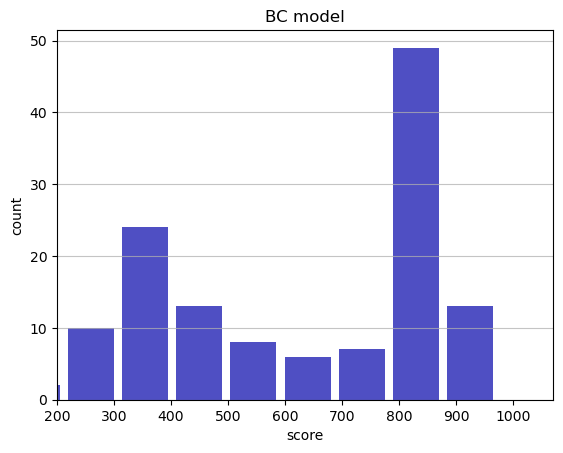

Track generation: 1245..1560 -> 315-tiles track
Epoch: 133
BC	mean: 630.06	variance: 237.73


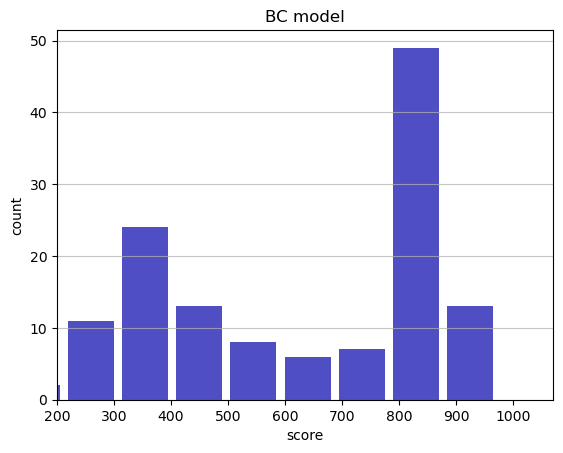

Track generation: 1140..1429 -> 289-tiles track
Epoch: 134
BC	mean: 627.96	variance: 238.07


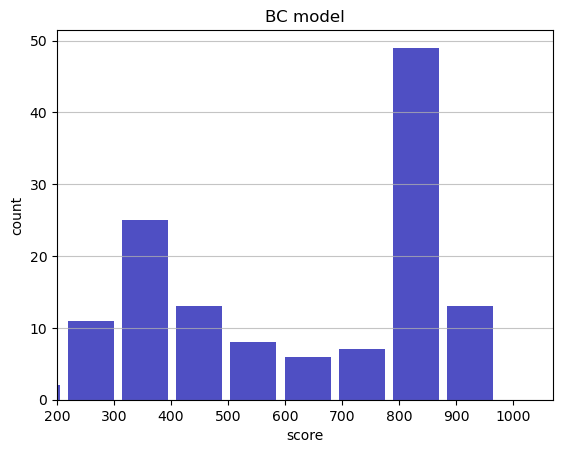

Track generation: 1063..1333 -> 270-tiles track
Epoch: 135
BC	mean: 629.81	variance: 238.15


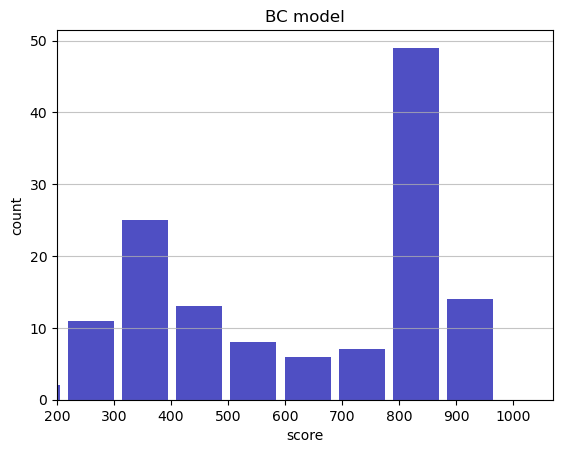

Track generation: 1161..1461 -> 300-tiles track
Epoch: 136
BC	mean: 631.28	variance: 237.89


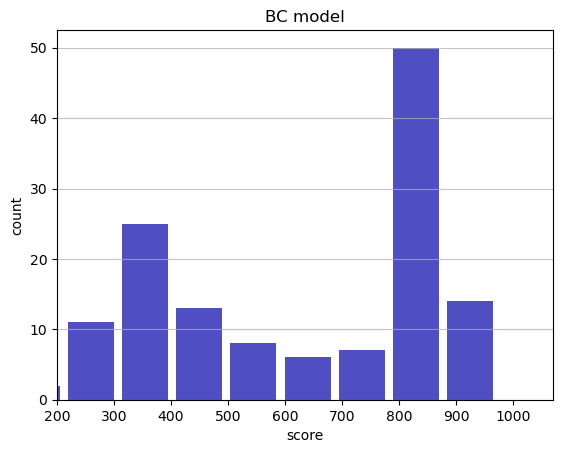

Track generation: 1203..1508 -> 305-tiles track
Epoch: 137
BC	mean: 628.58	variance: 239.11


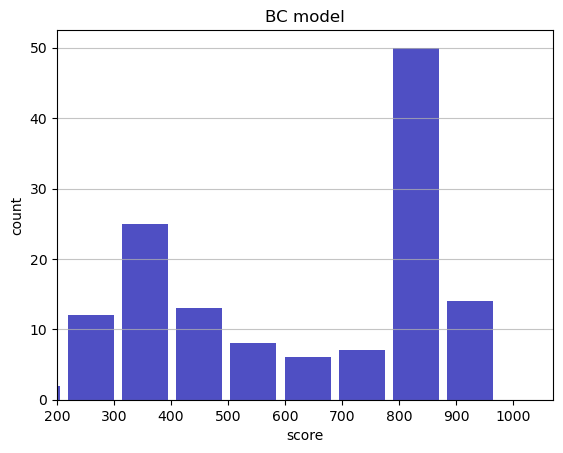

Track generation: 1271..1593 -> 322-tiles track
Epoch: 138
BC	mean: 628.64	variance: 238.24


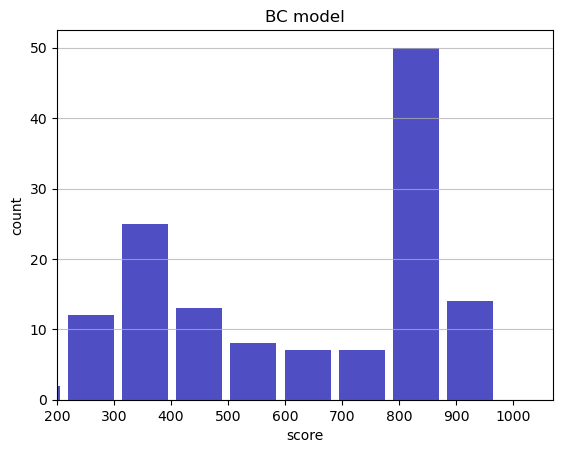

Track generation: 1163..1458 -> 295-tiles track
Epoch: 139
BC	mean: 627.50	variance: 237.76


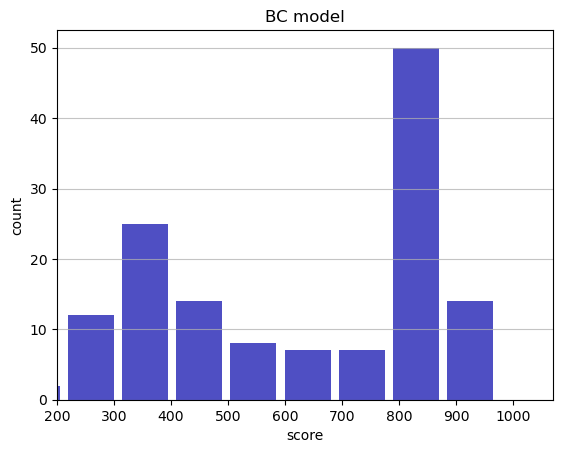

Track generation: 1223..1533 -> 310-tiles track
Epoch: 140
BC	mean: 628.83	variance: 237.43


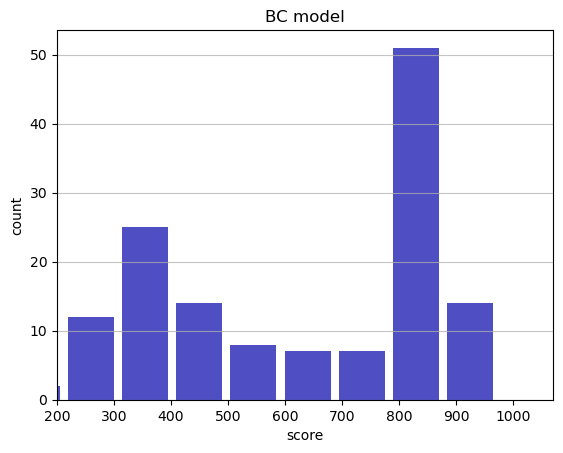

Track generation: 1031..1293 -> 262-tiles track
Epoch: 141
BC	mean: 627.61	variance: 237.03


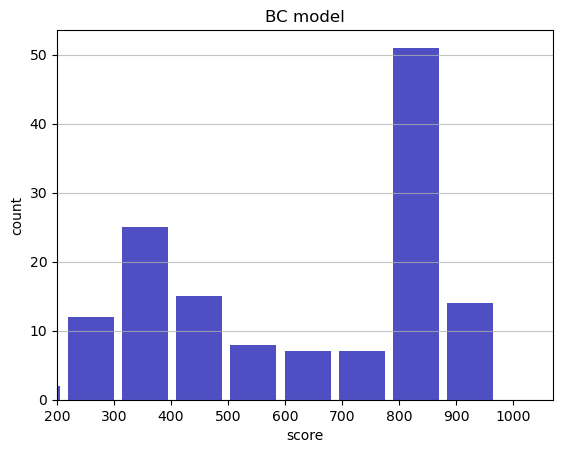

Track generation: 1047..1317 -> 270-tiles track
Epoch: 142
BC	mean: 629.30	variance: 237.04


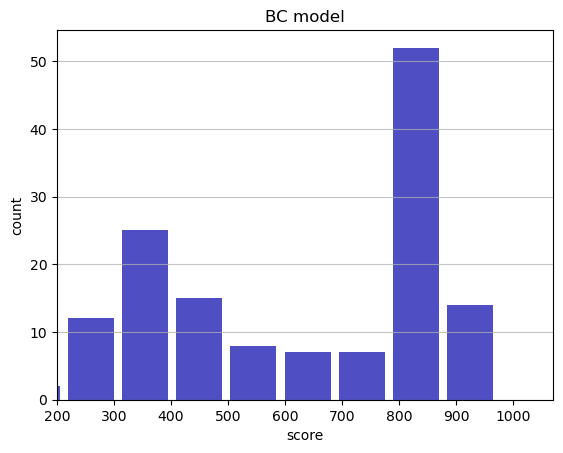

Track generation: 1207..1513 -> 306-tiles track
Epoch: 143
BC	mean: 626.86	variance: 237.99


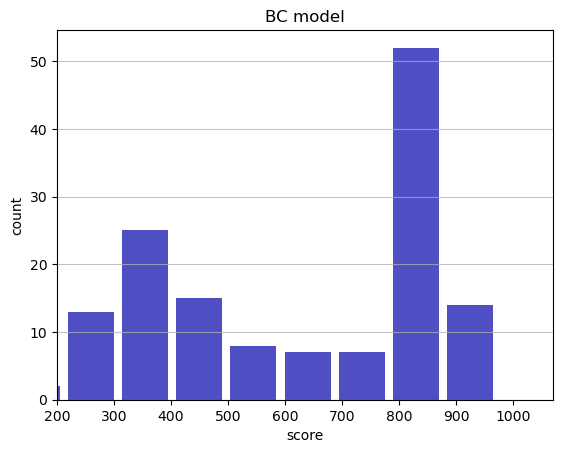

Track generation: 1140..1429 -> 289-tiles track
Epoch: 144
BC	mean: 628.03	variance: 237.58


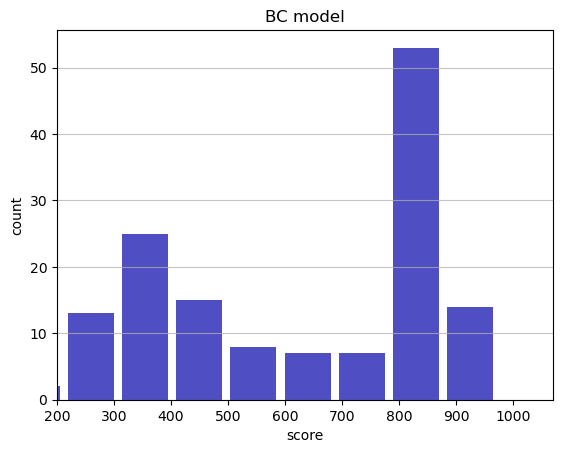

Track generation: 1237..1556 -> 319-tiles track
Epoch: 145
BC	mean: 629.36	variance: 237.30


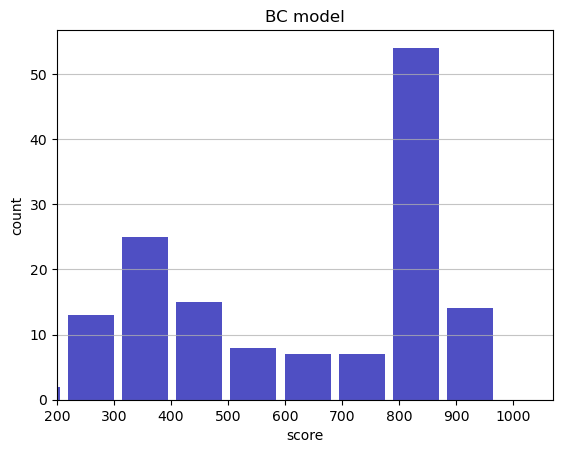

Track generation: 1132..1419 -> 287-tiles track
Epoch: 146
BC	mean: 630.95	variance: 237.25


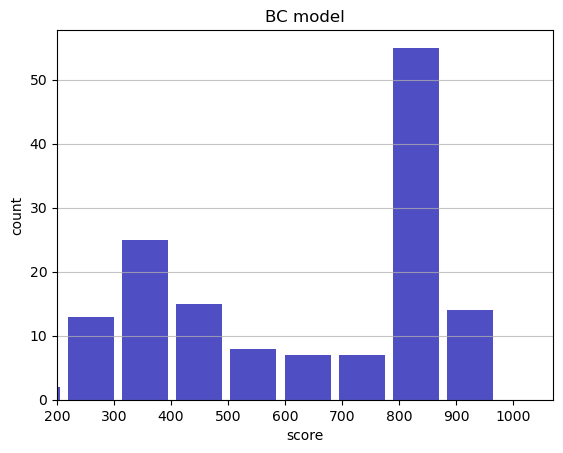

Track generation: 1201..1505 -> 304-tiles track
Epoch: 147
BC	mean: 628.66	variance: 238.05


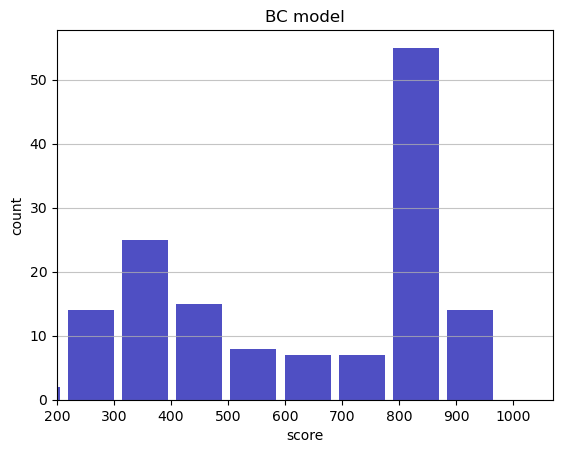

Track generation: 1071..1347 -> 276-tiles track
Epoch: 148
BC	mean: 630.37	variance: 238.15


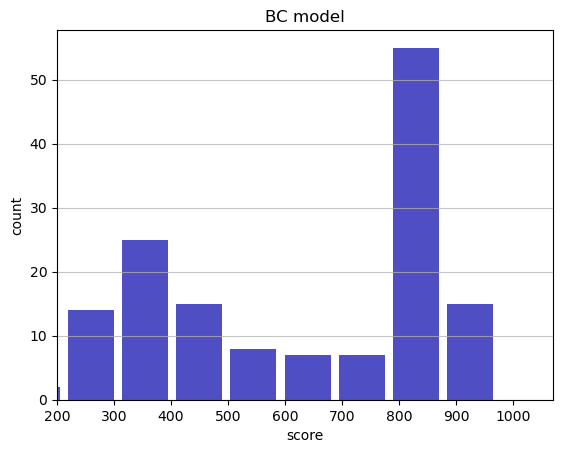

Track generation: 1048..1314 -> 266-tiles track
Epoch: 149
BC	mean: 629.50	variance: 237.59


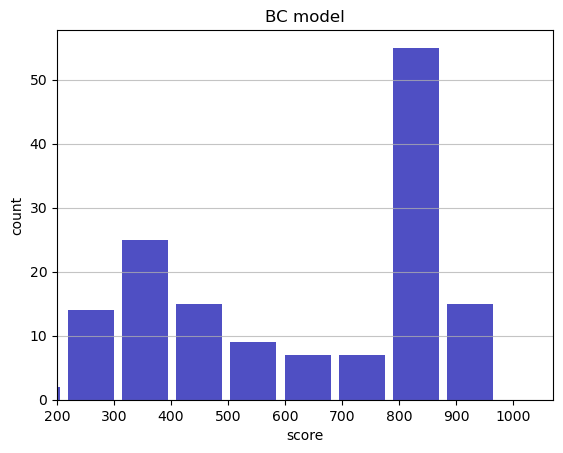

Track generation: 1007..1267 -> 260-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1026..1291 -> 265-tiles track
Epoch: 150
BC	mean: 631.35	variance: 237.87


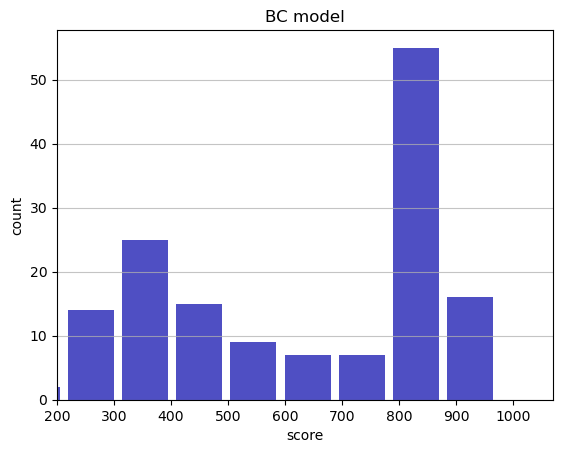

Track generation: 1193..1495 -> 302-tiles track
Epoch: 151
BC	mean: 629.36	variance: 238.33


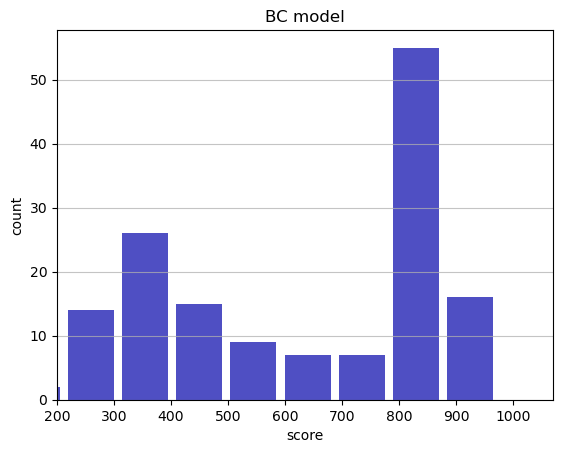

Track generation: 1108..1389 -> 281-tiles track
Epoch: 152
BC	mean: 630.52	variance: 237.97


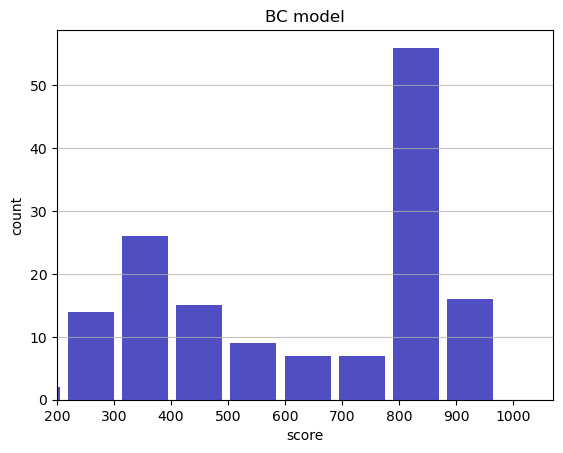

Track generation: 1119..1403 -> 284-tiles track
Epoch: 153
BC	mean: 628.75	variance: 238.19


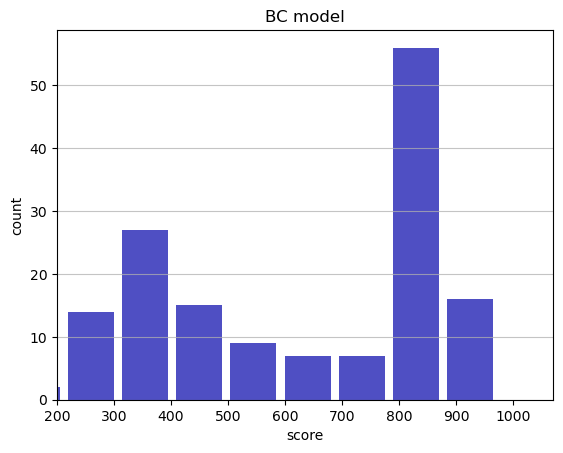

Track generation: 1115..1405 -> 290-tiles track
Epoch: 154
BC	mean: 627.64	variance: 237.81


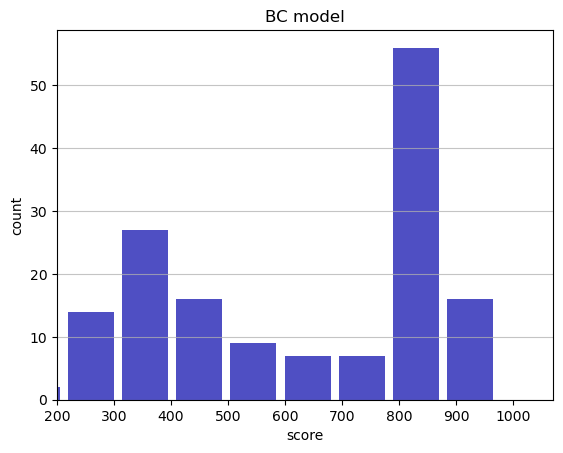

Track generation: 1092..1369 -> 277-tiles track
Epoch: 155
BC	mean: 629.13	variance: 237.77


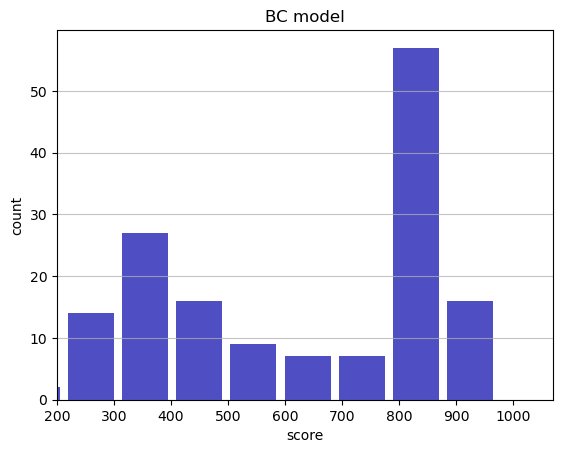

Track generation: 1247..1563 -> 316-tiles track
Epoch: 156
BC	mean: 630.44	variance: 237.57


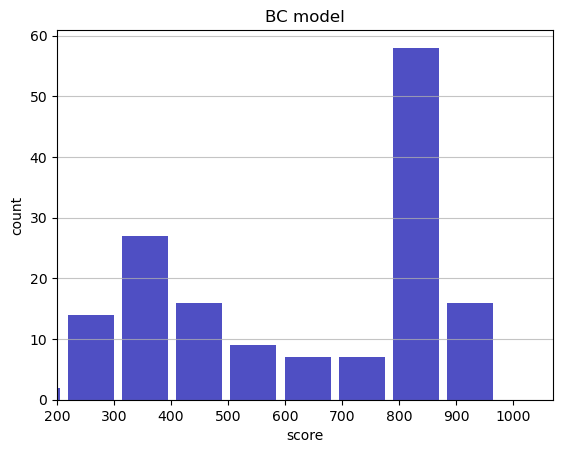

Track generation: 1217..1525 -> 308-tiles track
Epoch: 157
BC	mean: 631.49	variance: 237.17


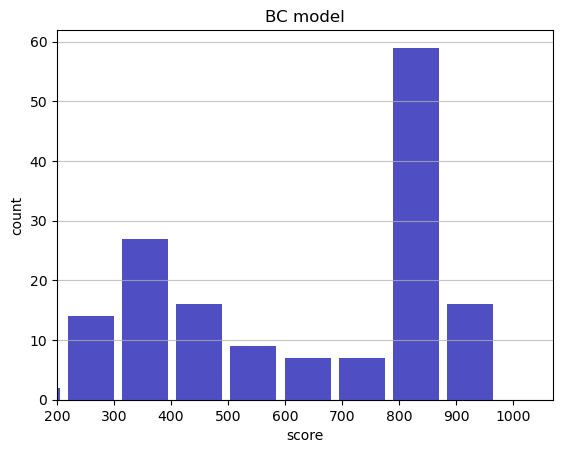

Track generation: 1124..1413 -> 289-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1158..1459 -> 301-tiles track
Epoch: 158
BC	mean: 632.77	variance: 236.96


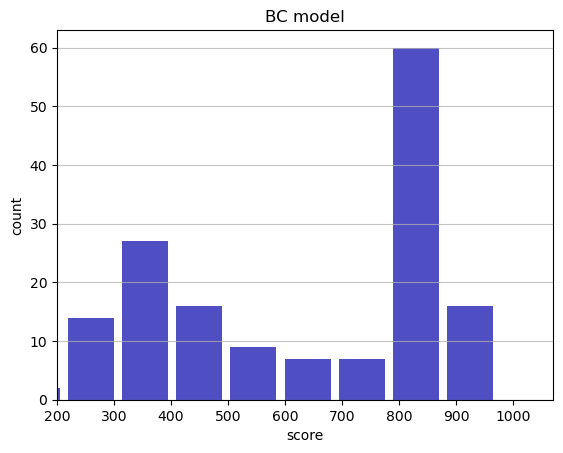

Track generation: 1138..1433 -> 295-tiles track
Epoch: 159
BC	mean: 633.53	variance: 236.41


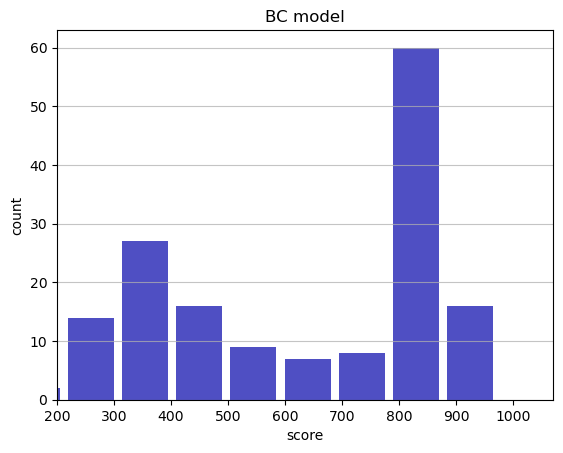

Track generation: 1214..1526 -> 312-tiles track
Epoch: 160
BC	mean: 633.17	variance: 235.72


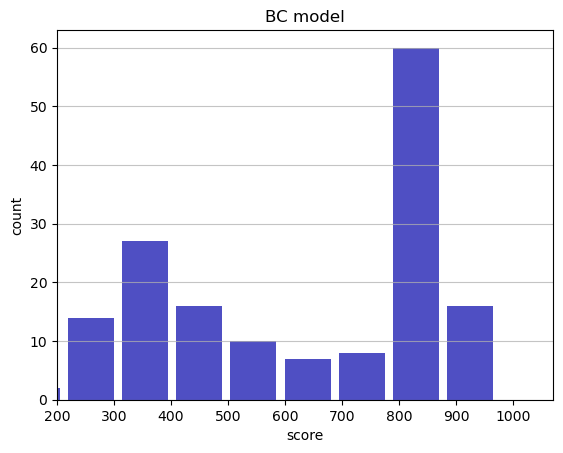

Track generation: 1319..1653 -> 334-tiles track
Epoch: 161
BC	mean: 632.79	variance: 235.03


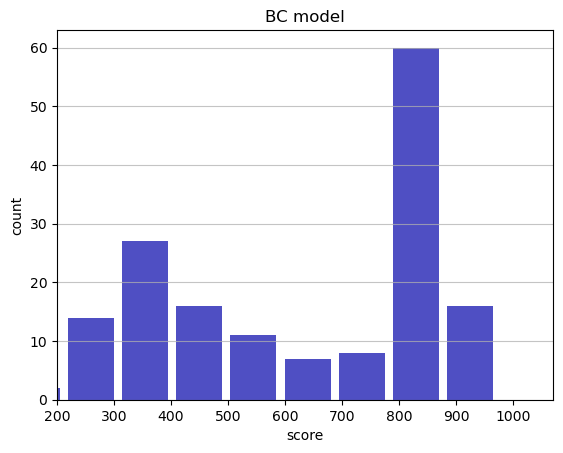

Track generation: 1021..1280 -> 259-tiles track
Epoch: 162
BC	mean: 634.28	variance: 235.07


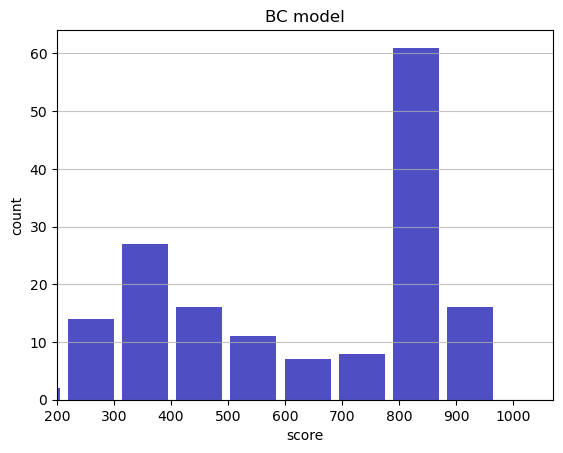

Track generation: 1123..1408 -> 285-tiles track
Epoch: 163
BC	mean: 635.72	variance: 235.06


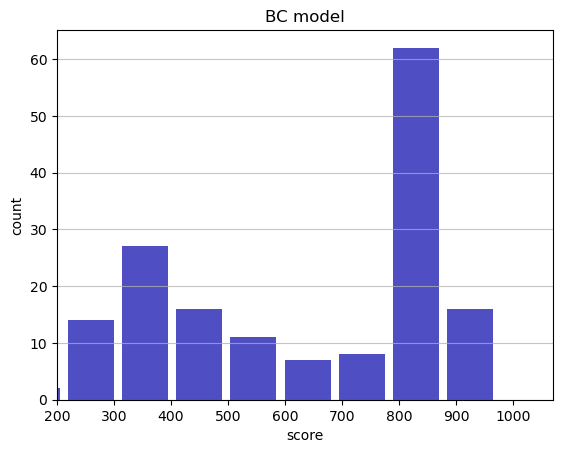

Track generation: 1109..1391 -> 282-tiles track
Epoch: 164
BC	mean: 637.02	variance: 234.94


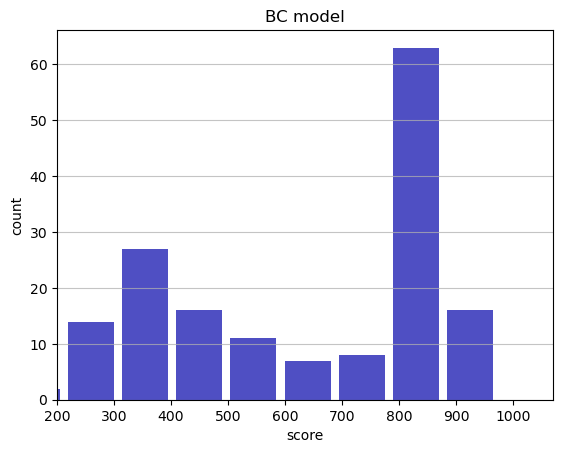

Track generation: 1075..1348 -> 273-tiles track
Epoch: 165
BC	mean: 635.74	variance: 234.80


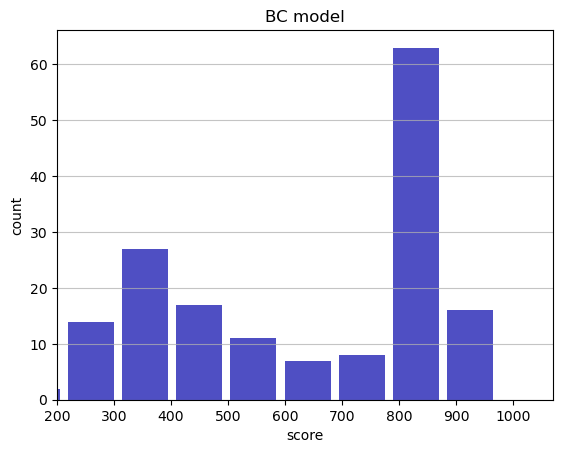

Track generation: 1171..1468 -> 297-tiles track
Epoch: 166
BC	mean: 633.84	variance: 235.36


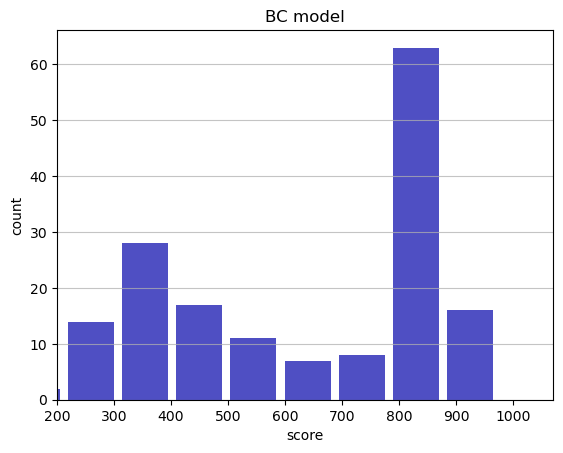

Track generation: 1051..1318 -> 267-tiles track
Epoch: 167
BC	mean: 632.96	variance: 234.93


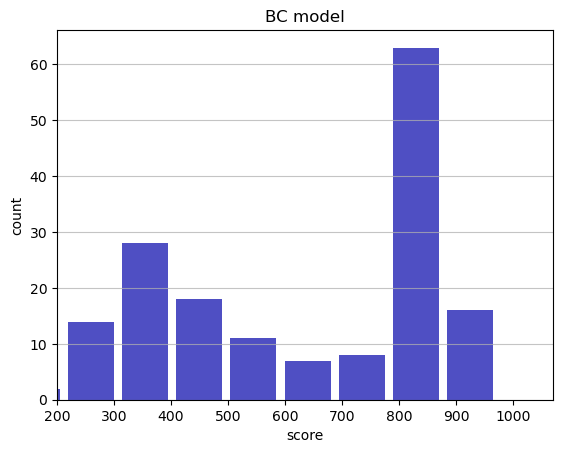

Track generation: 1152..1444 -> 292-tiles track
Epoch: 168
BC	mean: 634.34	variance: 234.91


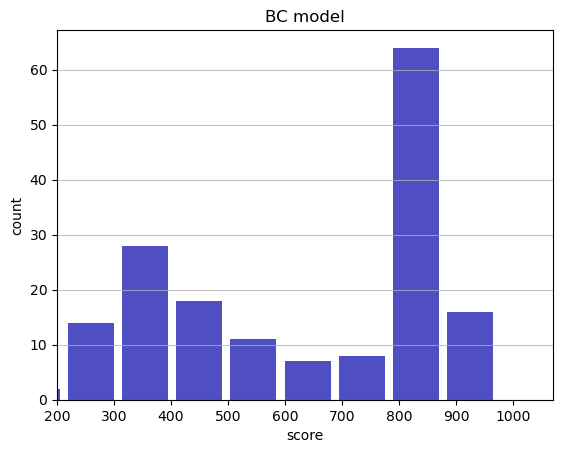

Track generation: 1124..1409 -> 285-tiles track
Epoch: 169
BC	mean: 633.19	variance: 234.69


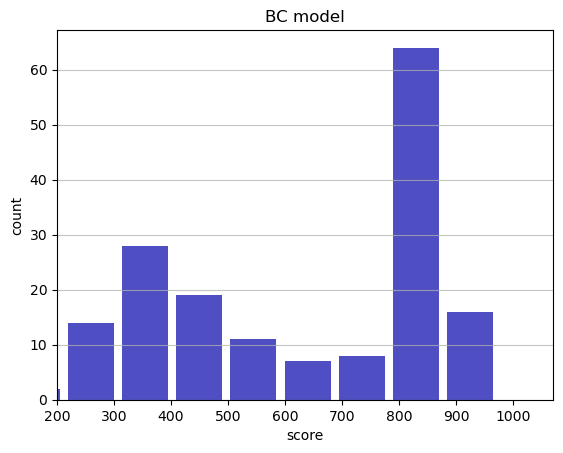

Track generation: 1072..1346 -> 274-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1199..1503 -> 304-tiles track
Epoch: 170
BC	mean: 634.59	variance: 234.70


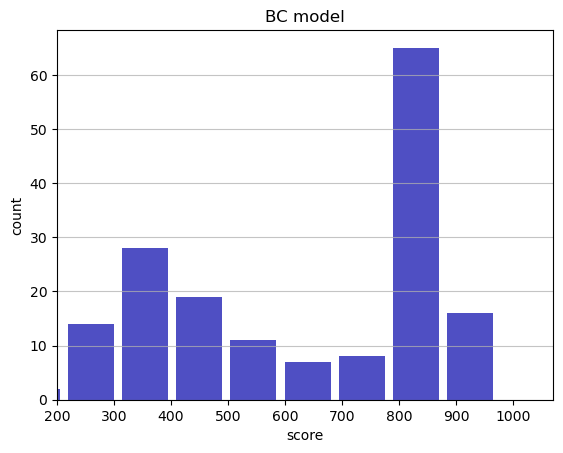

Track generation: 1195..1498 -> 303-tiles track
Epoch: 171
BC	mean: 633.81	variance: 234.23


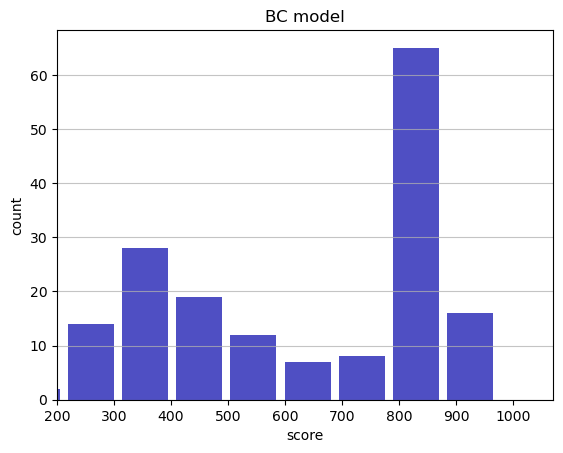

Track generation: 1145..1444 -> 299-tiles track
Epoch: 172
BC	mean: 632.88	variance: 233.86


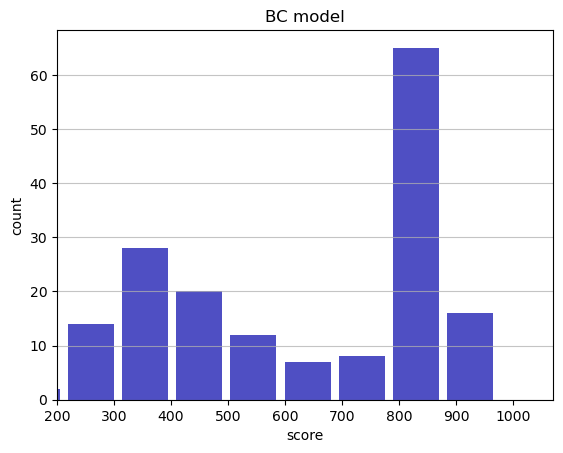

Track generation: 1067..1338 -> 271-tiles track
Epoch: 173
BC	mean: 633.92	variance: 233.58


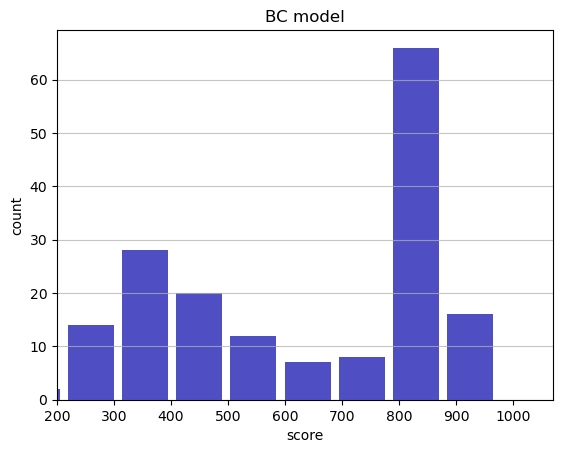

Track generation: 1283..1608 -> 325-tiles track
Epoch: 174
BC	mean: 631.77	variance: 234.61


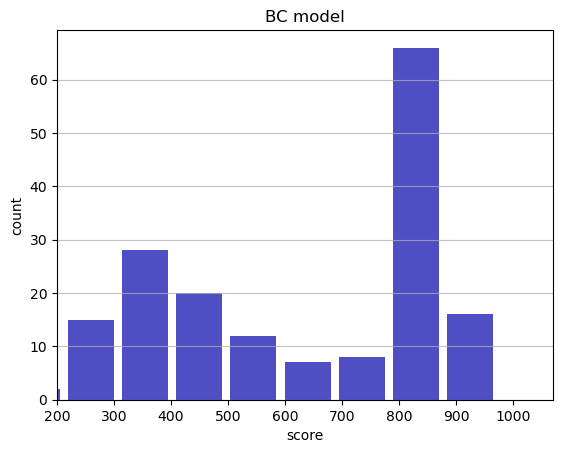

Track generation: 1087..1363 -> 276-tiles track
Epoch: 175
BC	mean: 633.02	variance: 234.52


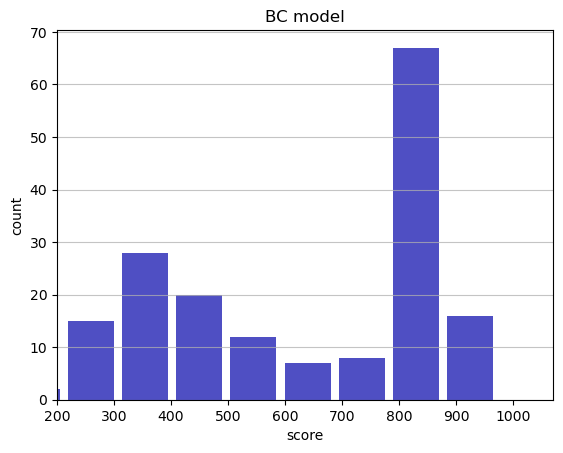

Track generation: 1476..1856 -> 380-tiles track
Epoch: 176
BC	mean: 631.15	variance: 235.16


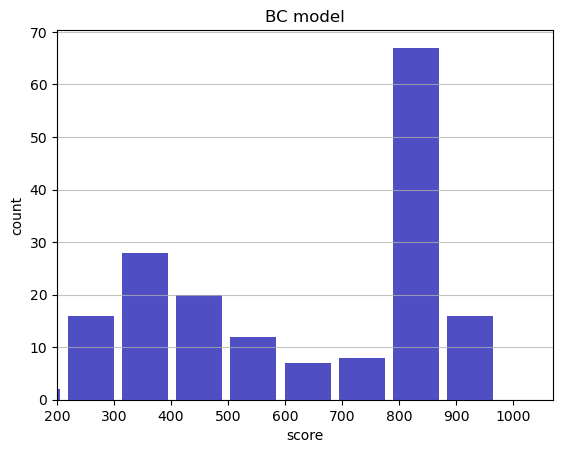

Track generation: 1141..1430 -> 289-tiles track
Epoch: 177
BC	mean: 632.28	variance: 234.97


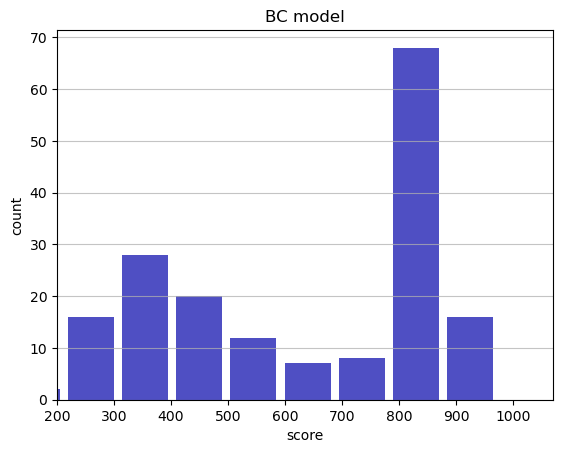

Track generation: 1084..1368 -> 284-tiles track
Epoch: 178
BC	mean: 633.79	variance: 235.17


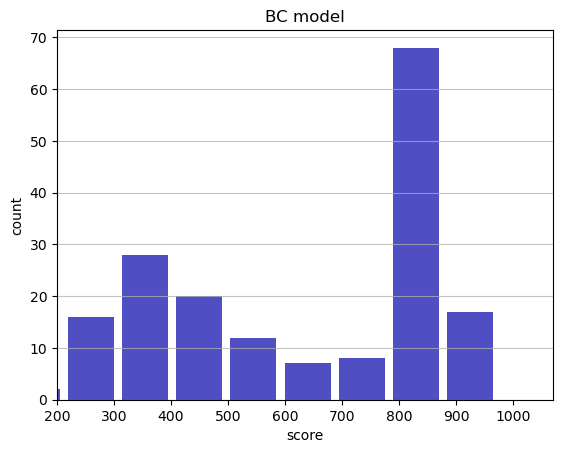

Track generation: 950..1198 -> 248-tiles track
Epoch: 179
BC	mean: 633.91	variance: 234.52


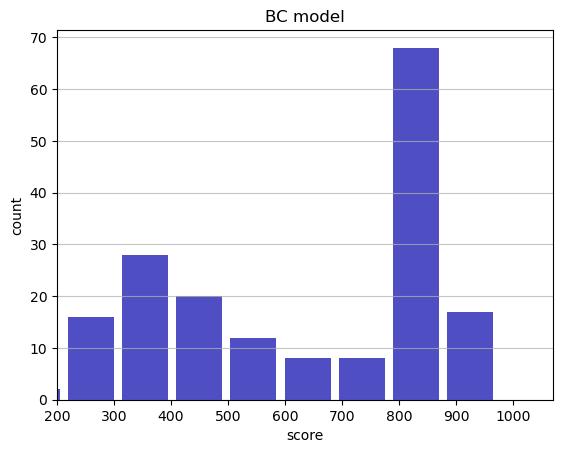

Track generation: 969..1220 -> 251-tiles track
Epoch: 180
BC	mean: 635.38	variance: 234.68


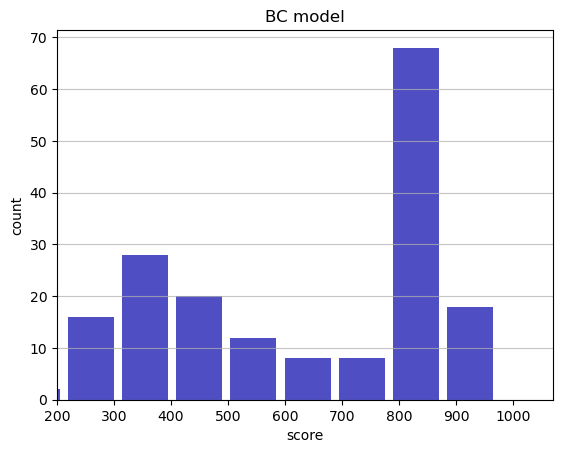

Track generation: 1153..1445 -> 292-tiles track
Epoch: 181
BC	mean: 633.37	variance: 235.57


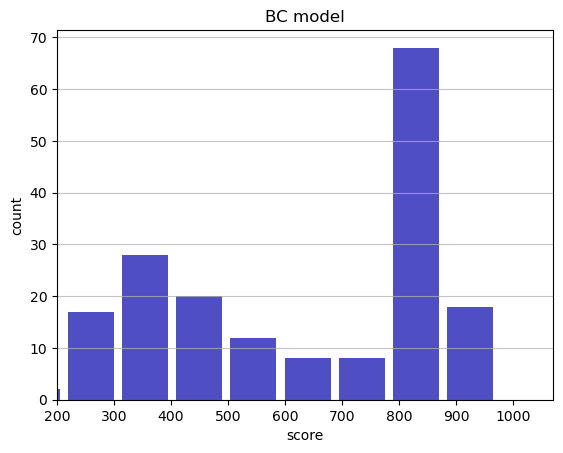

Track generation: 1243..1558 -> 315-tiles track
Epoch: 182
BC	mean: 631.88	variance: 235.79


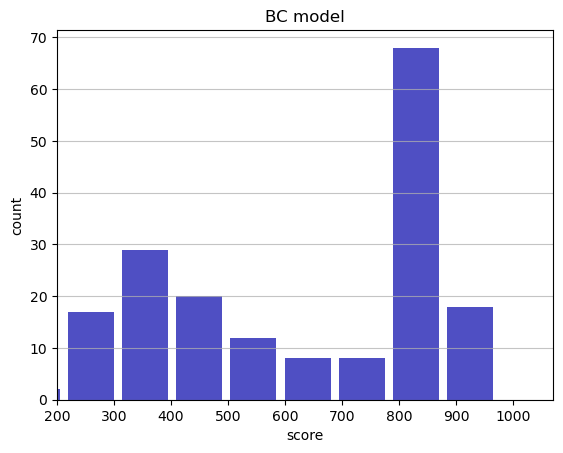

Track generation: 1107..1396 -> 289-tiles track
Epoch: 183
BC	mean: 632.93	variance: 235.57


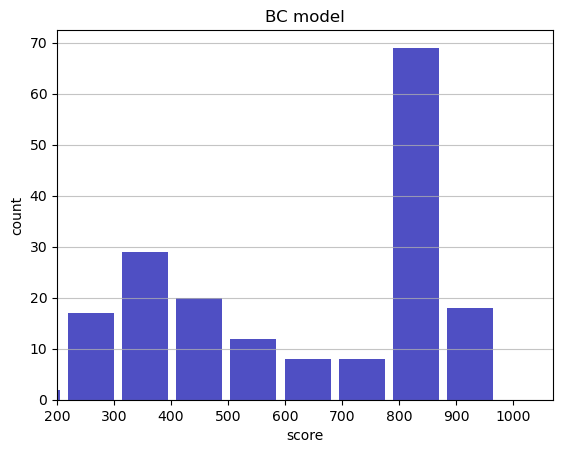

Track generation: 1102..1382 -> 280-tiles track
Epoch: 184
BC	mean: 631.24	variance: 236.03


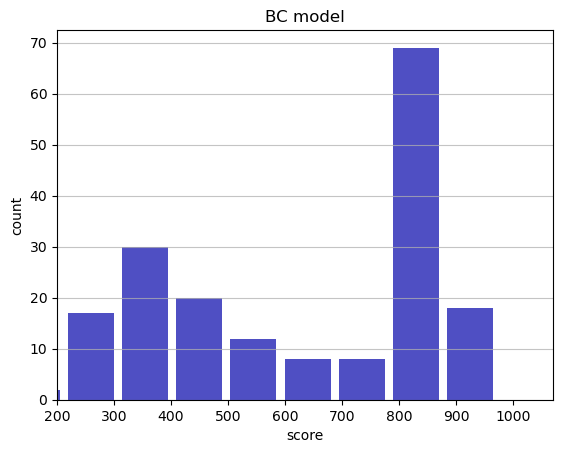

Track generation: 1158..1452 -> 294-tiles track
Epoch: 185
BC	mean: 632.56	variance: 236.07


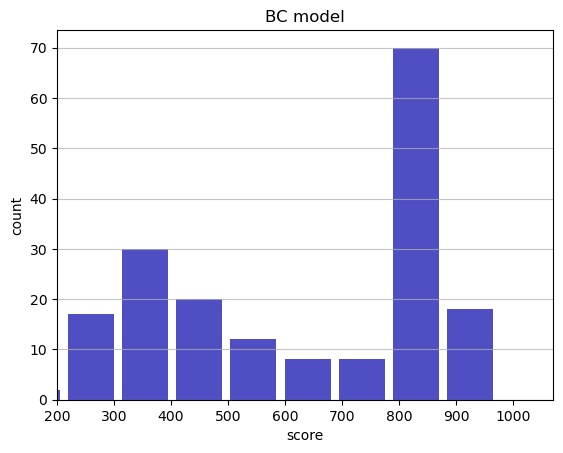

Track generation: 1043..1313 -> 270-tiles track
Epoch: 186
BC	mean: 632.95	variance: 235.49


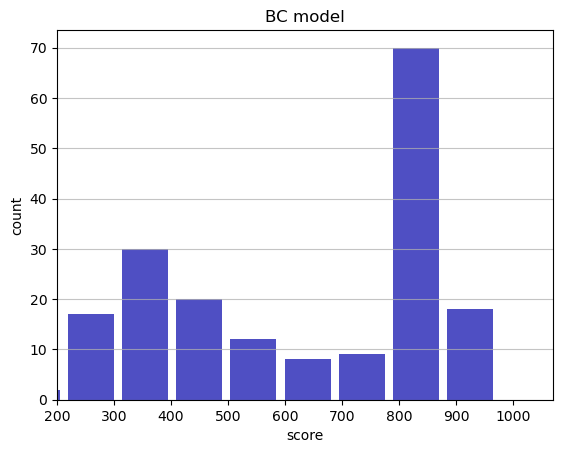

Track generation: 1124..1409 -> 285-tiles track
Epoch: 187
BC	mean: 633.90	variance: 235.22


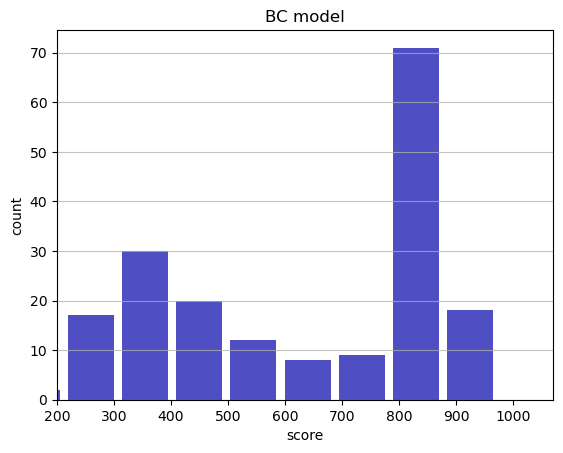

Track generation: 1083..1358 -> 275-tiles track
Epoch: 188
BC	mean: 631.94	variance: 236.11


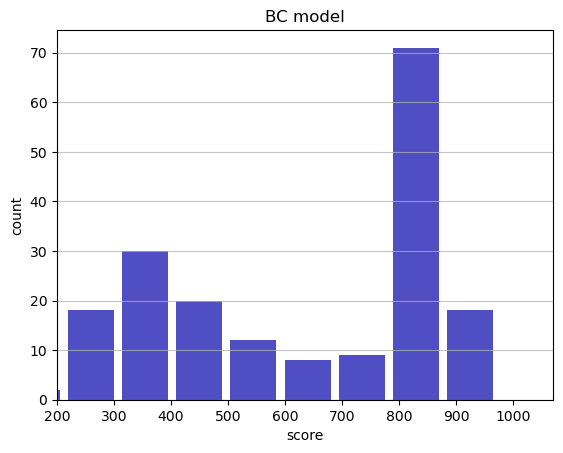

Track generation: 1224..1534 -> 310-tiles track
Epoch: 189
BC	mean: 632.53	variance: 235.63


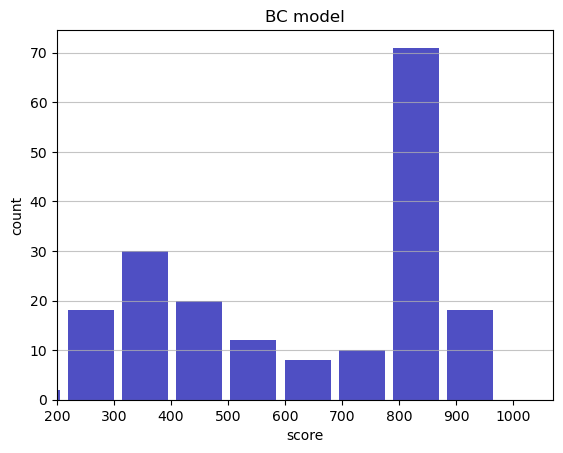

Track generation: 1217..1525 -> 308-tiles track
Epoch: 190
BC	mean: 632.29	variance: 235.03


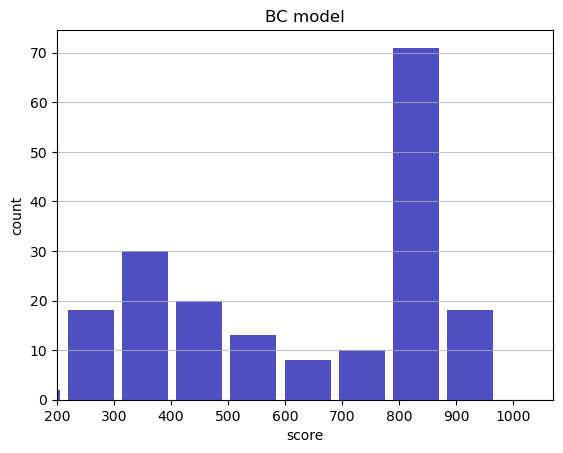

Track generation: 1154..1446 -> 292-tiles track
Epoch: 191
BC	mean: 630.32	variance: 235.97


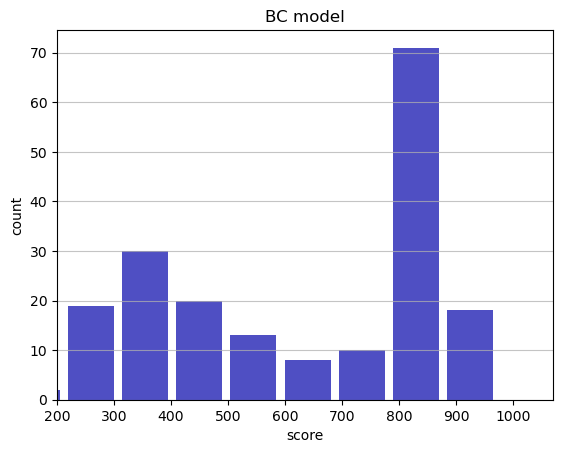

Track generation: 1048..1314 -> 266-tiles track
Epoch: 192
BC	mean: 631.66	variance: 236.08


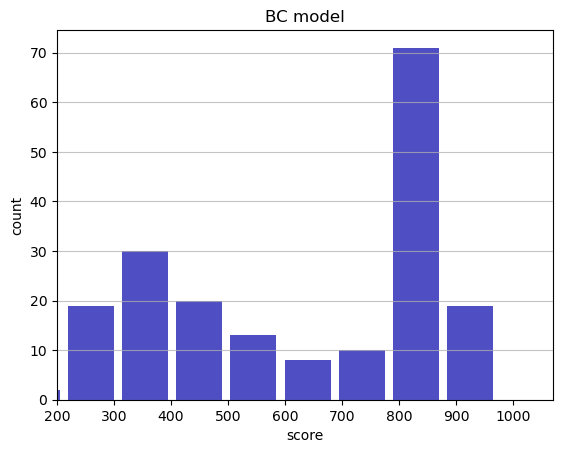

Track generation: 1279..1608 -> 329-tiles track
Epoch: 193
BC	mean: 631.29	variance: 235.53


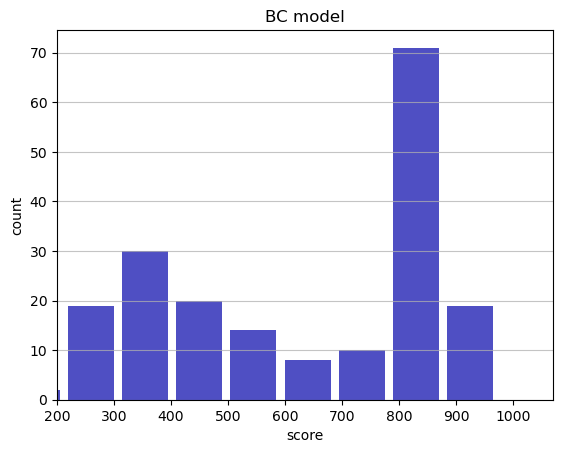

Track generation: 1061..1330 -> 269-tiles track
Epoch: 194
BC	mean: 629.85	variance: 235.76


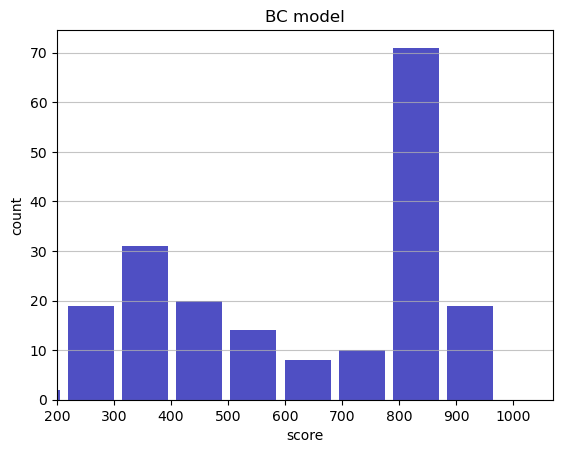

Track generation: 1253..1570 -> 317-tiles track
Epoch: 195
BC	mean: 628.36	variance: 236.07


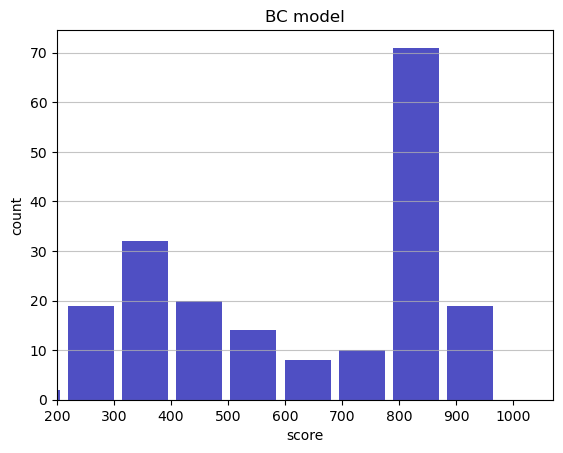

Track generation: 1167..1463 -> 296-tiles track
Epoch: 196
BC	mean: 627.55	variance: 235.75


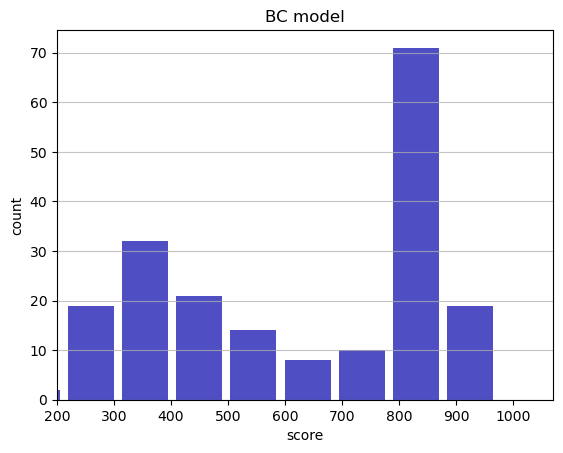

Track generation: 1187..1494 -> 307-tiles track
Epoch: 197
BC	mean: 626.55	variance: 235.56


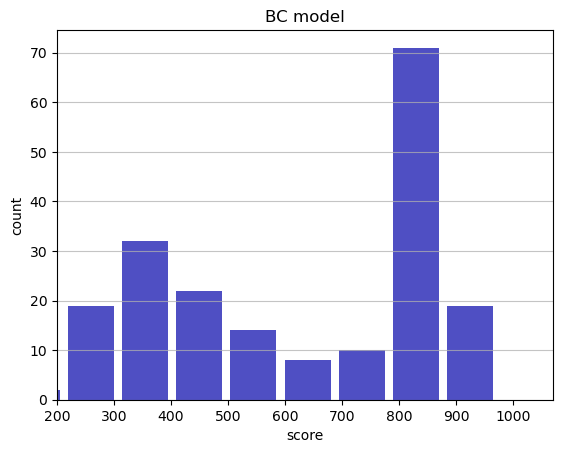

Track generation: 1236..1549 -> 313-tiles track
Epoch: 198
BC	mean: 626.21	variance: 235.02


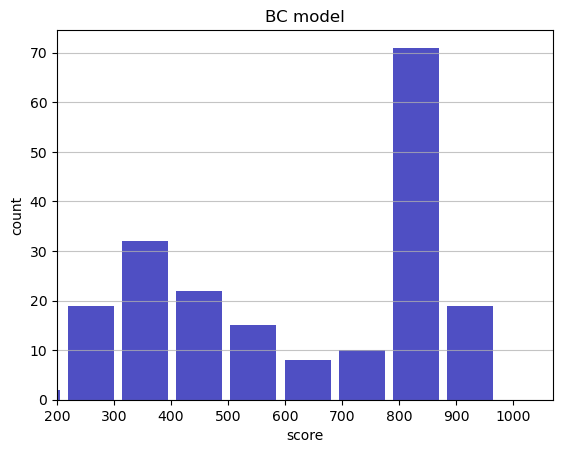

Track generation: 1199..1503 -> 304-tiles track
Epoch: 199
BC	mean: 625.13	variance: 234.92


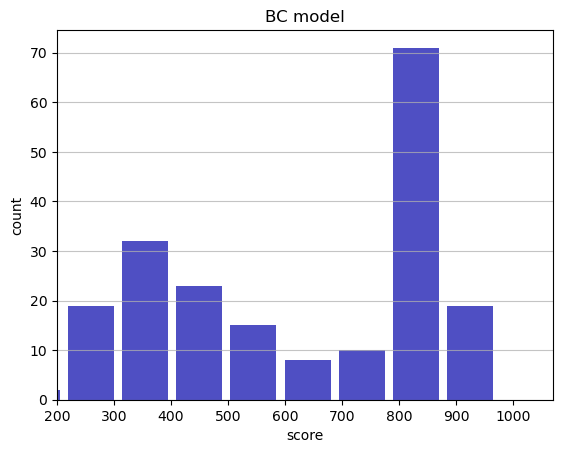

Track generation: 1102..1390 -> 288-tiles track
Epoch: 200
BC	mean: 624.40	variance: 234.56


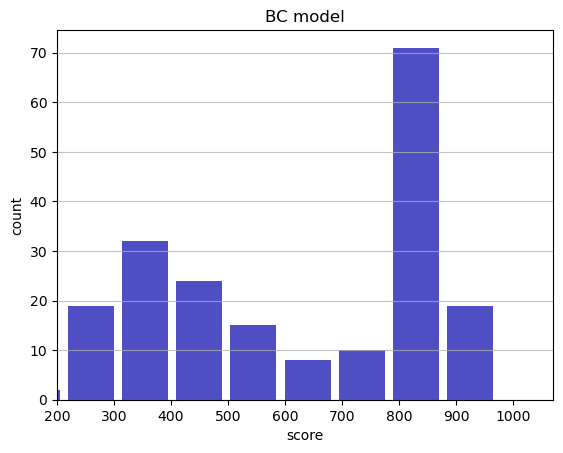

Track generation: 1093..1377 -> 284-tiles track
Epoch: 201
BC	mean: 622.69	variance: 235.22


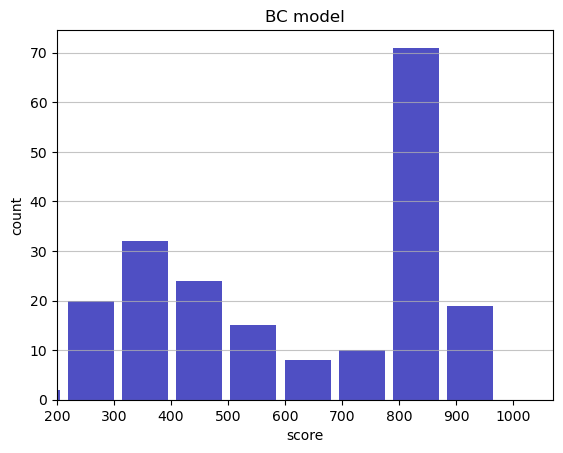

Track generation: 1113..1395 -> 282-tiles track
Epoch: 202
BC	mean: 620.94	variance: 235.94


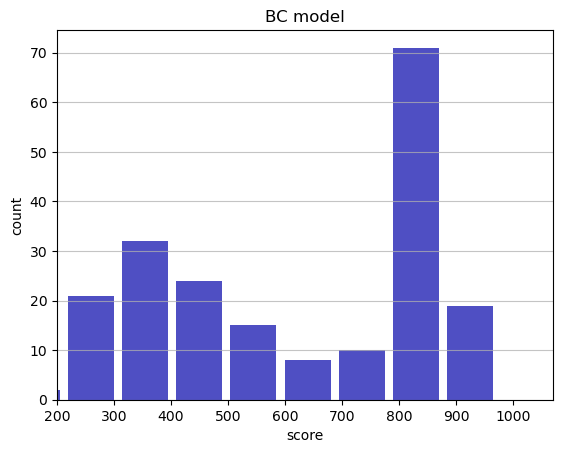

Track generation: 1166..1462 -> 296-tiles track
Epoch: 203
BC	mean: 619.50	variance: 236.24


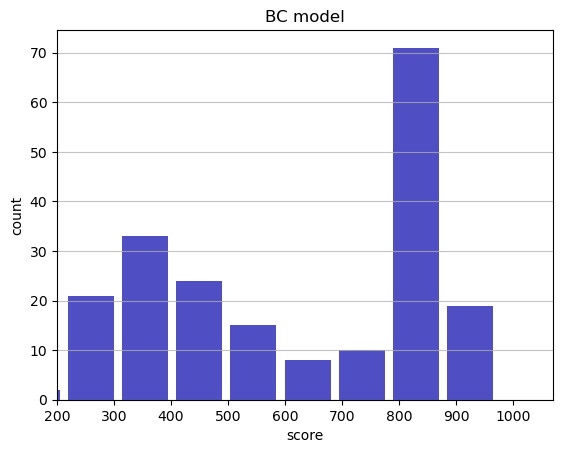

Track generation: 1169..1465 -> 296-tiles track
Epoch: 204
BC	mean: 618.12	variance: 236.49


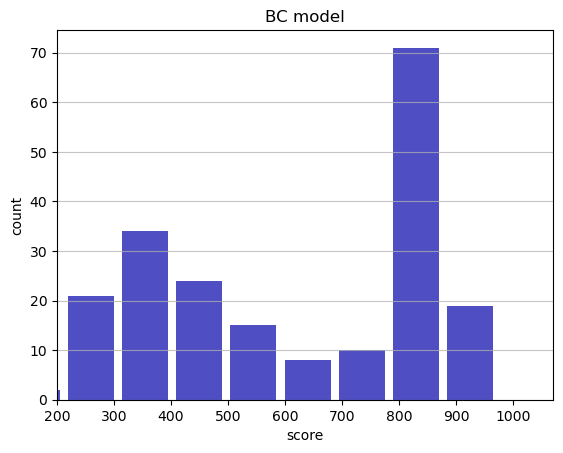

Track generation: 1233..1547 -> 314-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1202..1506 -> 304-tiles track
Epoch: 205
BC	mean: 619.03	variance: 236.26


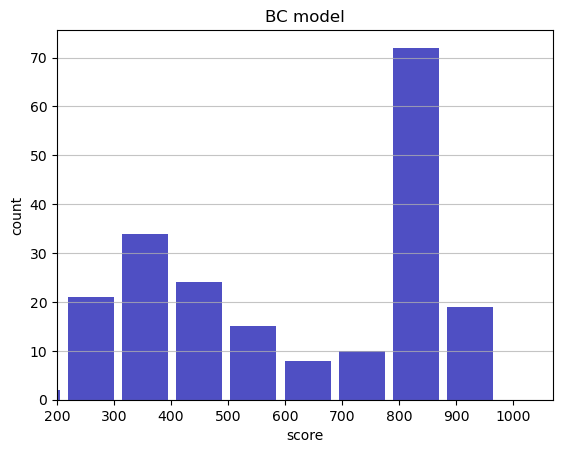

Track generation: 1136..1424 -> 288-tiles track
Epoch: 206
BC	mean: 620.21	variance: 236.30


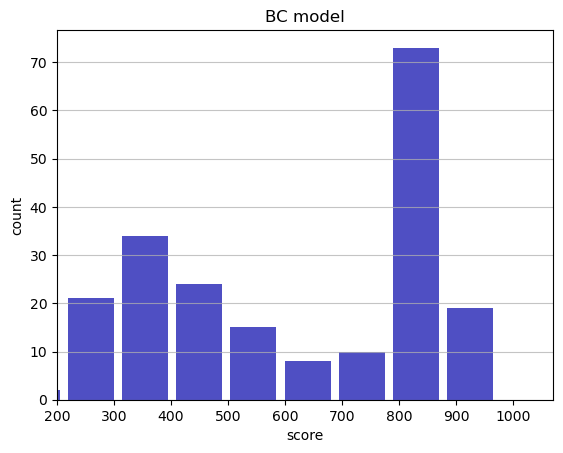

Track generation: 1148..1439 -> 291-tiles track
Epoch: 207
BC	mean: 618.87	variance: 236.51


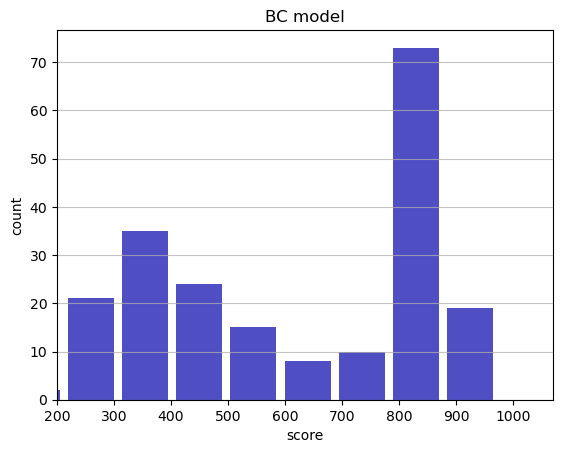

Track generation: 1428..1789 -> 361-tiles track
Epoch: 208
BC	mean: 620.30	variance: 236.84


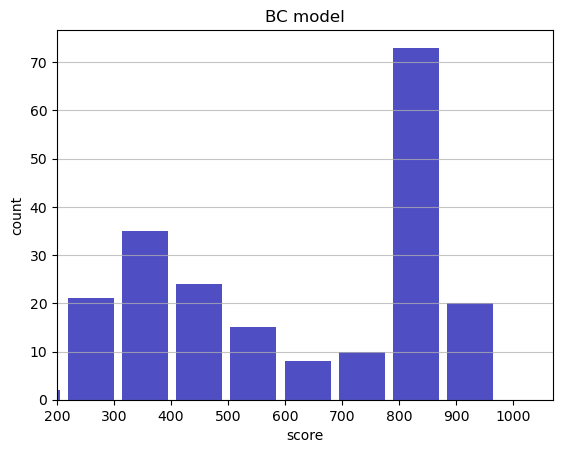

Track generation: 973..1225 -> 252-tiles track
Epoch: 209
BC	mean: 621.41	variance: 236.81


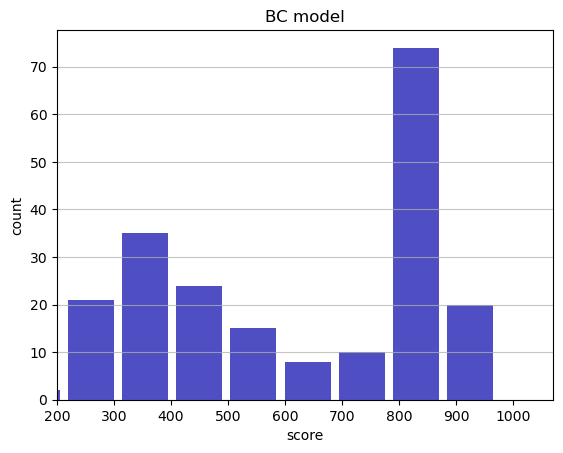

Track generation: 1125..1410 -> 285-tiles track
Epoch: 210
BC	mean: 619.57	variance: 237.74


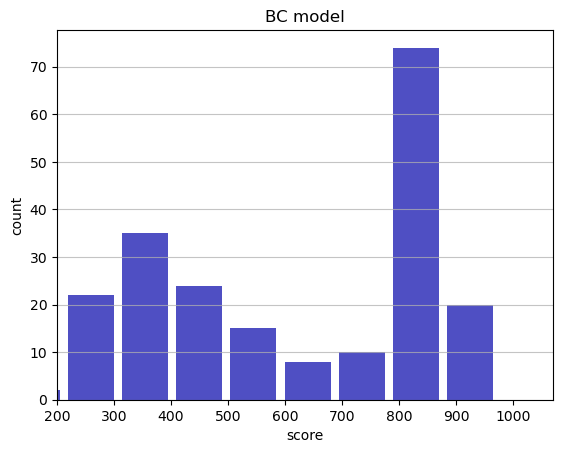

Track generation: 1212..1519 -> 307-tiles track
Epoch: 211
BC	mean: 619.94	variance: 237.23


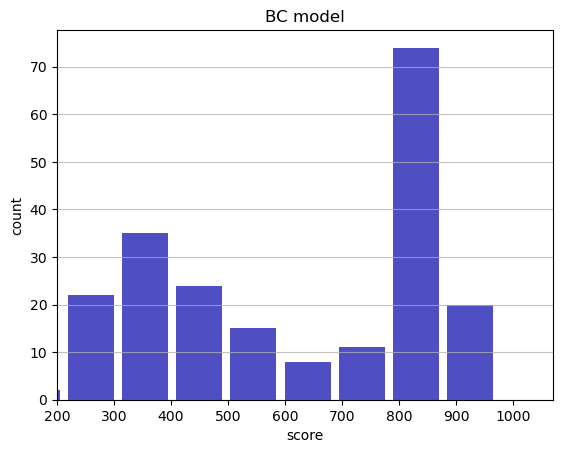

Track generation: 1321..1655 -> 334-tiles track
Epoch: 212
BC	mean: 619.62	variance: 236.72


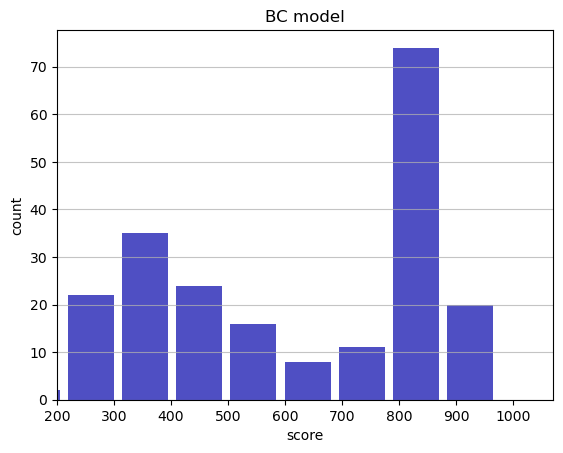

Track generation: 1053..1320 -> 267-tiles track
Epoch: 213
BC	mean: 618.53	variance: 236.70


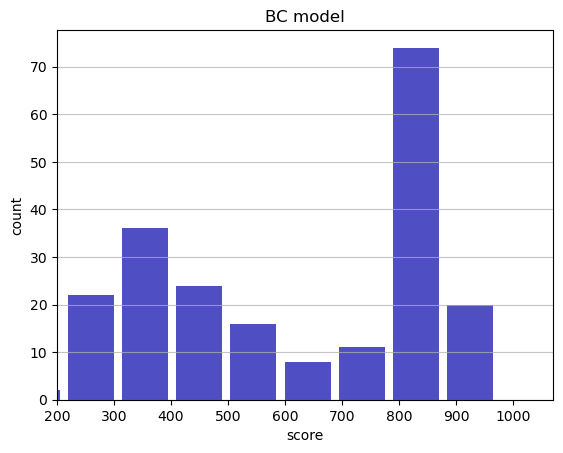

Track generation: 1031..1295 -> 264-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1050..1317 -> 267-tiles track
Epoch: 214
BC	mean: 617.11	variance: 237.05


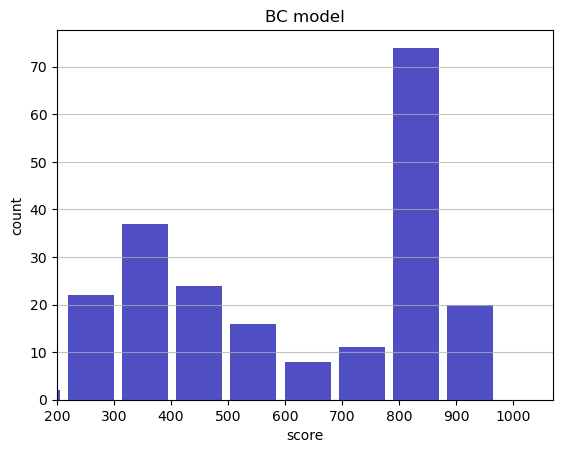

Track generation: 958..1209 -> 251-tiles track
Epoch: 215
BC	mean: 615.94	variance: 237.12


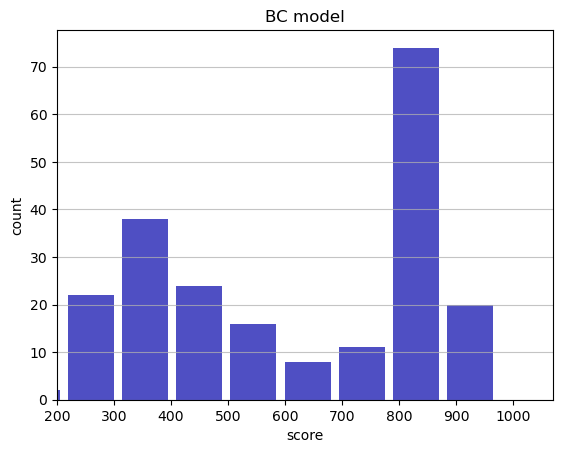

Track generation: 1244..1559 -> 315-tiles track
Epoch: 216
BC	mean: 615.16	variance: 236.85


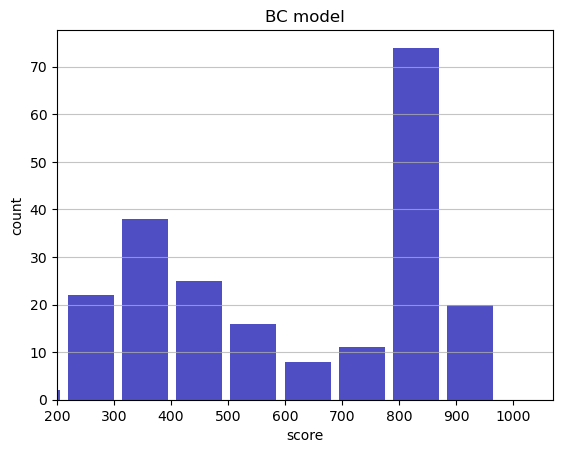

Track generation: 1313..1646 -> 333-tiles track
Epoch: 217
BC	mean: 613.66	variance: 237.32


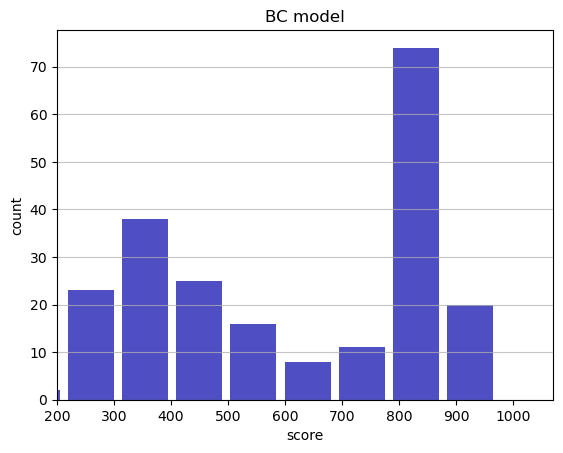

Track generation: 1047..1313 -> 266-tiles track
Epoch: 218
BC	mean: 612.66	variance: 237.24


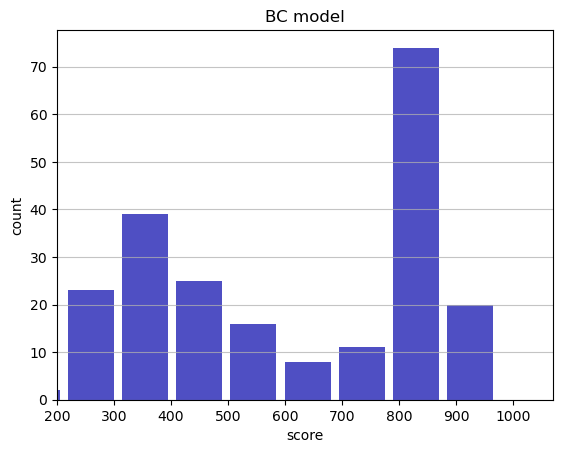

Track generation: 1080..1354 -> 274-tiles track
Epoch: 219
BC	mean: 613.86	variance: 237.37


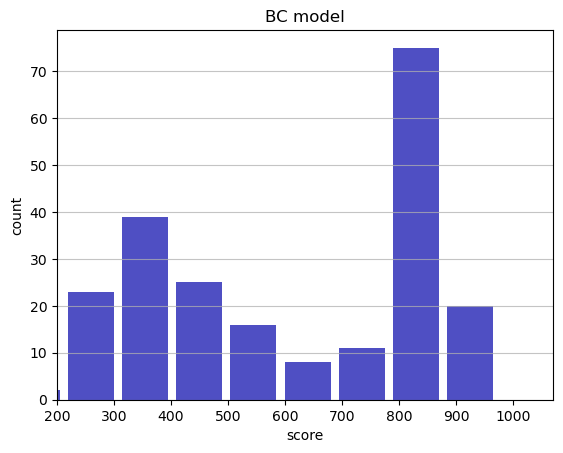

Track generation: 1170..1466 -> 296-tiles track
Epoch: 220
BC	mean: 613.01	variance: 237.16


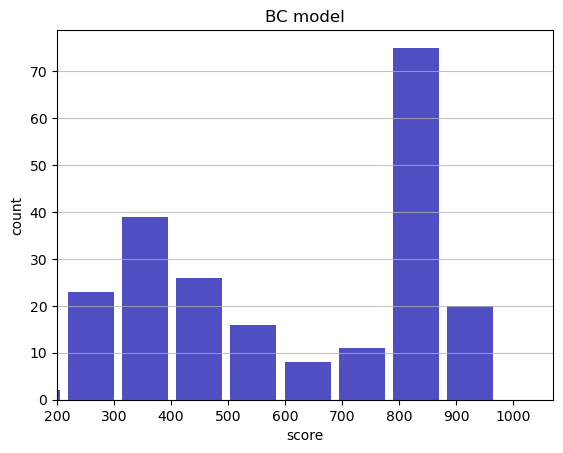

Track generation: 1057..1328 -> 271-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1264..1584 -> 320-tiles track
Epoch: 221
BC	mean: 614.27	variance: 237.37


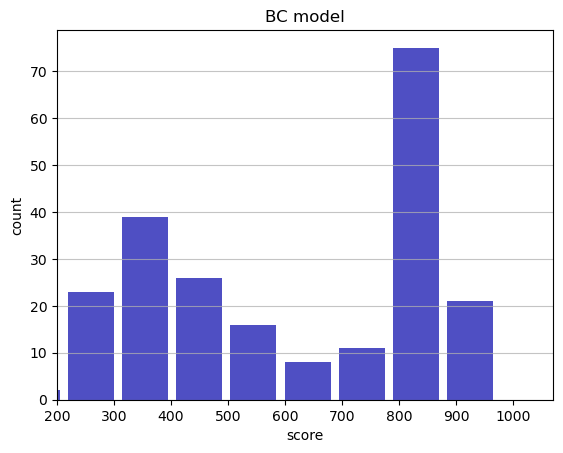

Track generation: 1156..1449 -> 293-tiles track
Epoch: 222
BC	mean: 615.34	variance: 237.36


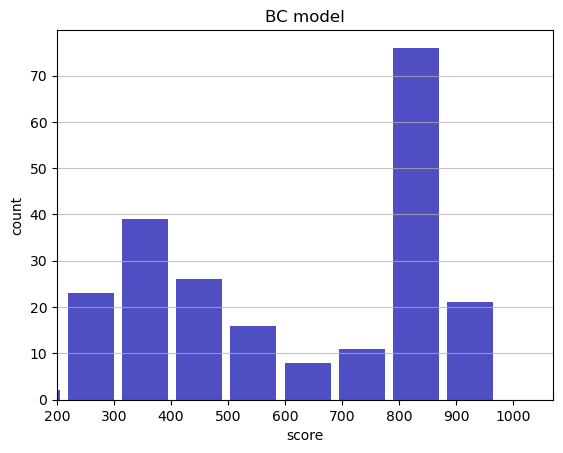

Track generation: 1299..1627 -> 328-tiles track
Epoch: 223
BC	mean: 613.65	variance: 238.16


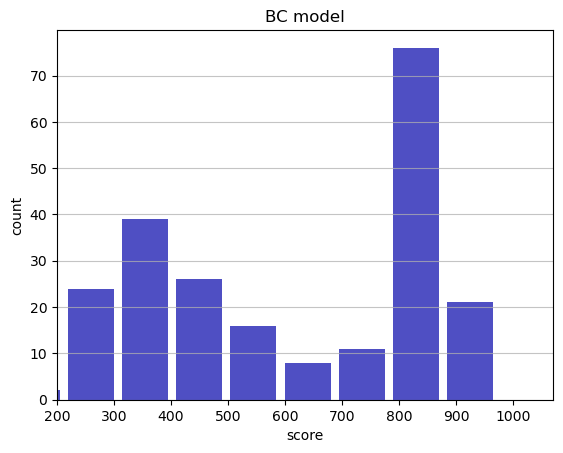

Track generation: 1012..1267 -> 255-tiles track
Epoch: 224
BC	mean: 613.30	variance: 237.68


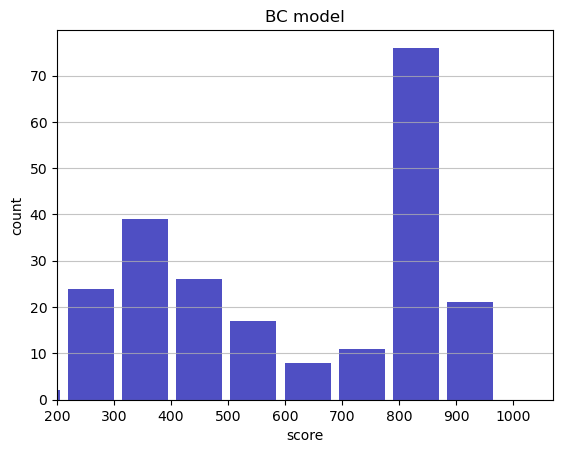

Track generation: 1224..1542 -> 318-tiles track
Epoch: 225
BC	mean: 611.96	variance: 238.00


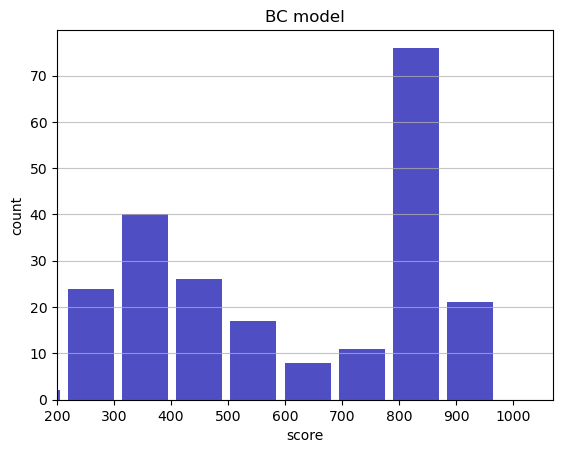

Track generation: 1068..1339 -> 271-tiles track
Epoch: 226
BC	mean: 610.80	variance: 238.11


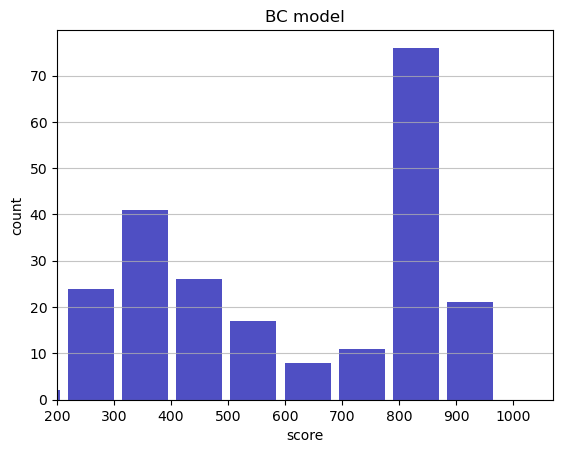

Track generation: 1166..1461 -> 295-tiles track
Epoch: 227
BC	mean: 609.65	variance: 238.21


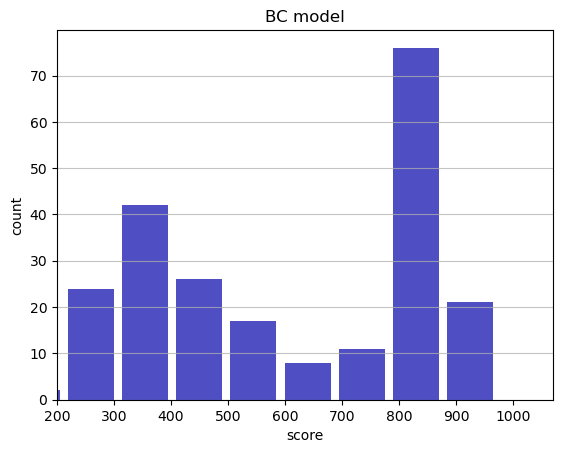

Track generation: 1296..1624 -> 328-tiles track
Epoch: 228
BC	mean: 608.21	variance: 238.67


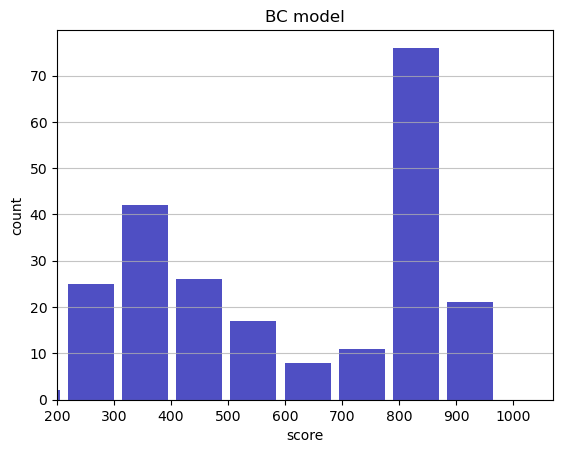

Track generation: 1103..1383 -> 280-tiles track
Epoch: 229
BC	mean: 609.28	variance: 238.69


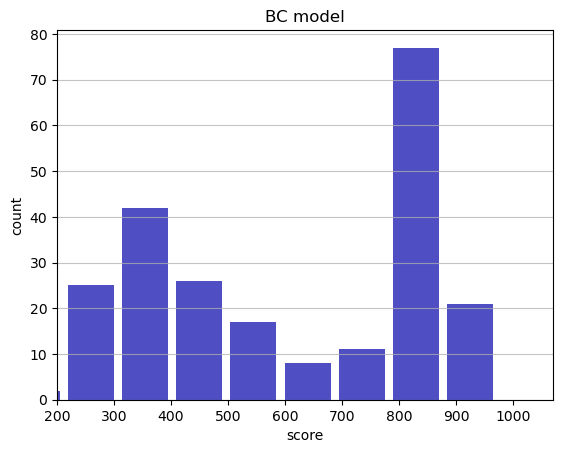

Track generation: 1132..1419 -> 287-tiles track
Epoch: 230
BC	mean: 610.40	variance: 238.78


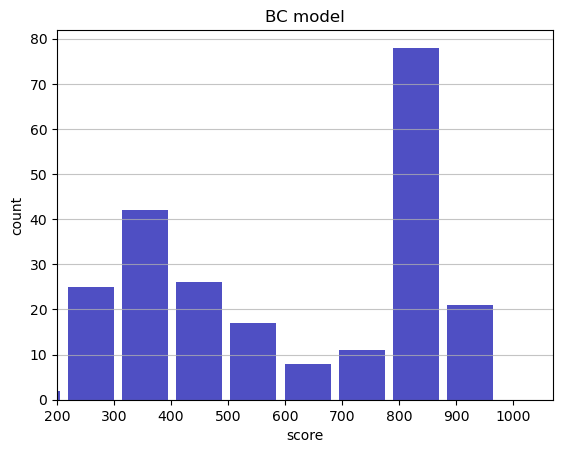

Track generation: 1103..1383 -> 280-tiles track
Epoch: 231
BC	mean: 609.47	variance: 238.68


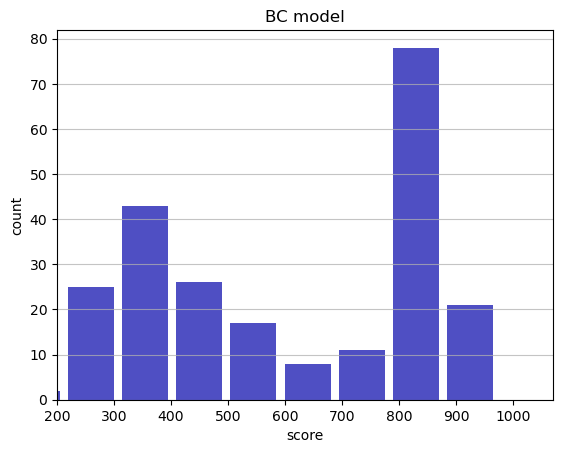

Track generation: 1244..1569 -> 325-tiles track
Epoch: 232
BC	mean: 609.19	variance: 238.20


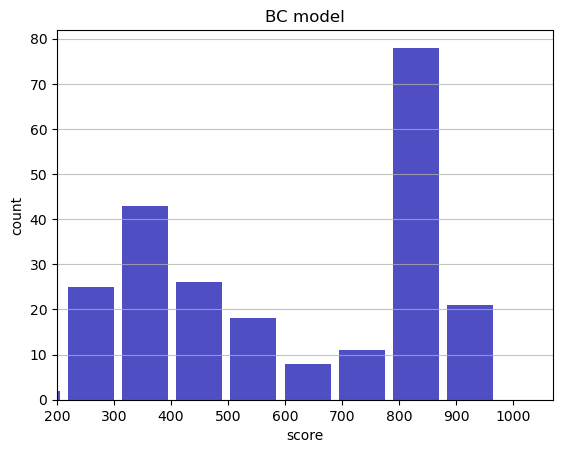

Track generation: 1134..1425 -> 291-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1135..1423 -> 288-tiles track
Epoch: 233
BC	mean: 607.71	variance: 238.75


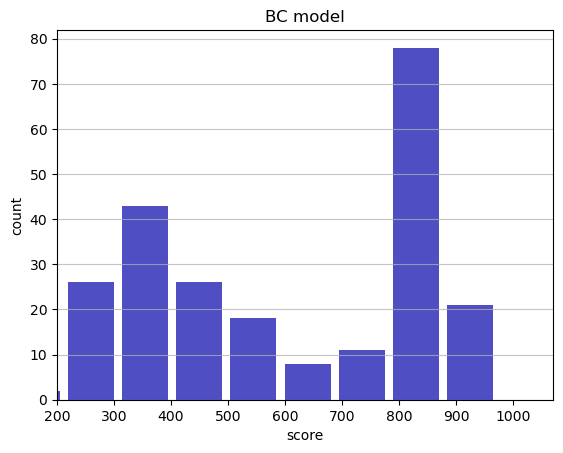

Track generation: 1072..1344 -> 272-tiles track
Epoch: 234
BC	mean: 608.84	variance: 238.87


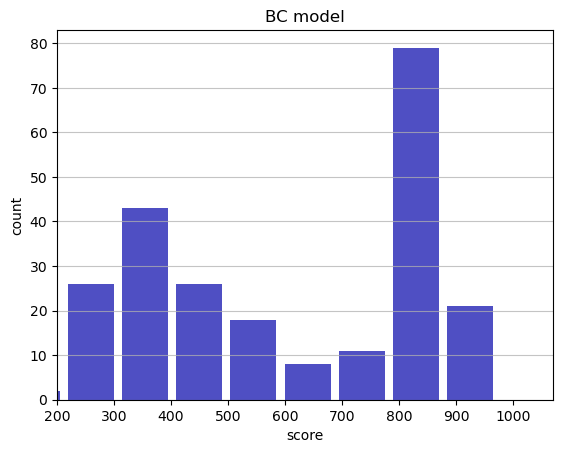

Track generation: 1228..1538 -> 310-tiles track
Epoch: 235
BC	mean: 607.21	variance: 239.67


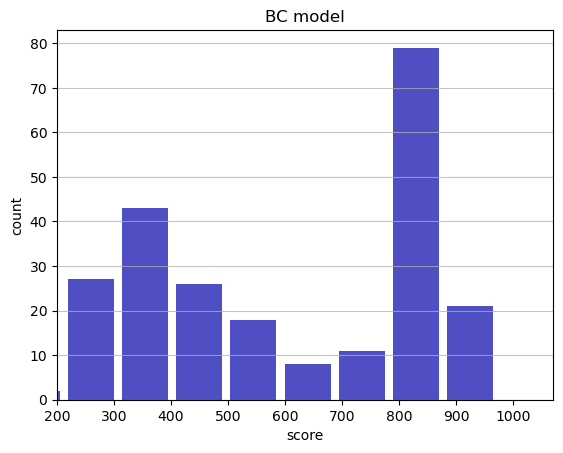

Track generation: 1247..1563 -> 316-tiles track
Epoch: 236
BC	mean: 607.09	variance: 239.17


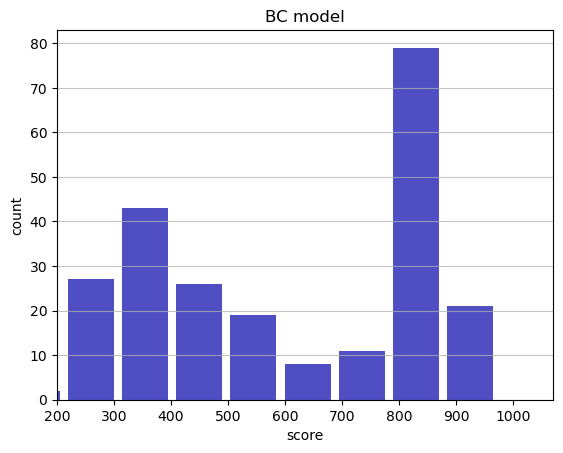

Track generation: 1095..1373 -> 278-tiles track
Epoch: 237
BC	mean: 607.33	variance: 238.69


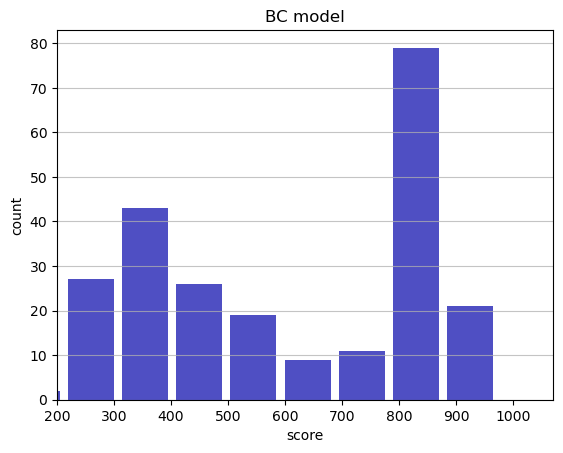

Track generation: 1088..1364 -> 276-tiles track
Epoch: 238
BC	mean: 608.09	variance: 238.47


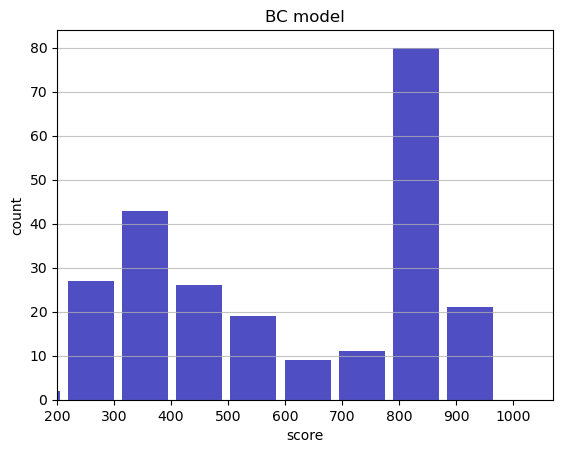

Track generation: 1255..1573 -> 318-tiles track
Epoch: 239
BC	mean: 607.61	variance: 238.09


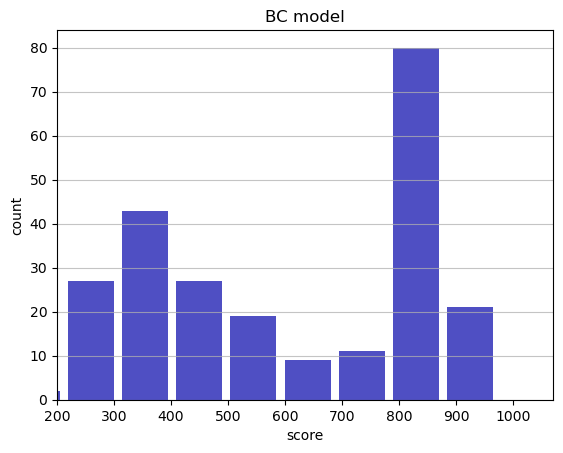

Track generation: 1064..1334 -> 270-tiles track
Epoch: 240
BC	mean: 606.35	variance: 238.39


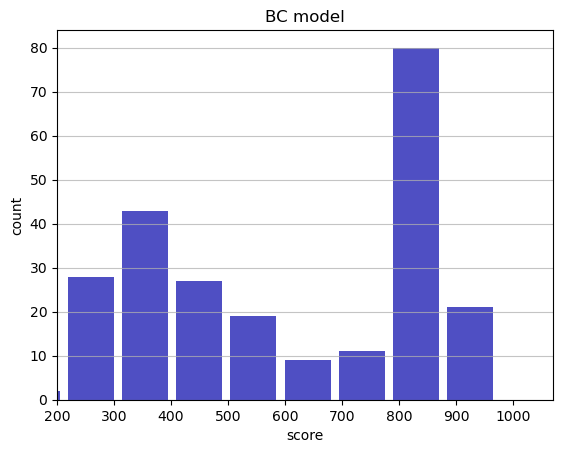

Track generation: 1160..1454 -> 294-tiles track
Epoch: 241
BC	mean: 605.63	variance: 238.16


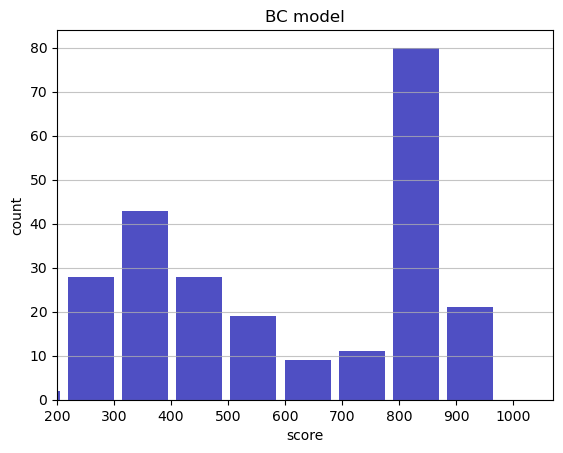

Track generation: 1060..1338 -> 278-tiles track
Epoch: 242
BC	mean: 605.65	variance: 237.67


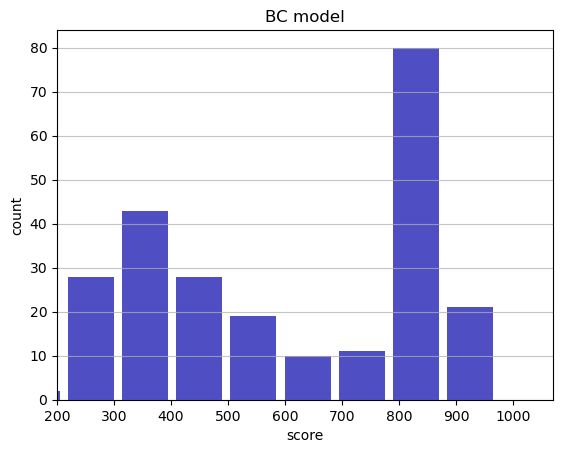

Track generation: 1148..1439 -> 291-tiles track
Epoch: 243
BC	mean: 605.25	variance: 237.26


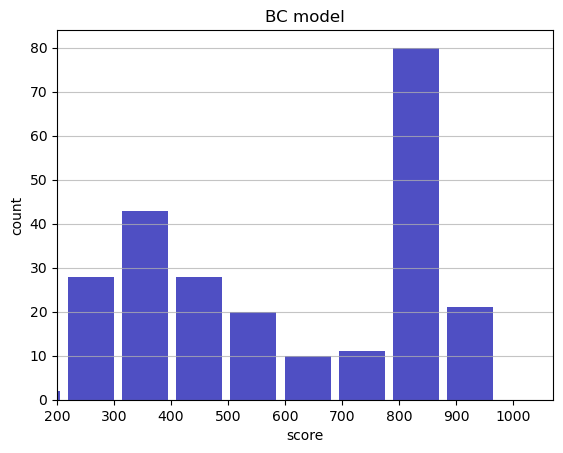

Track generation: 1187..1488 -> 301-tiles track
Epoch: 244
BC	mean: 603.83	variance: 237.81


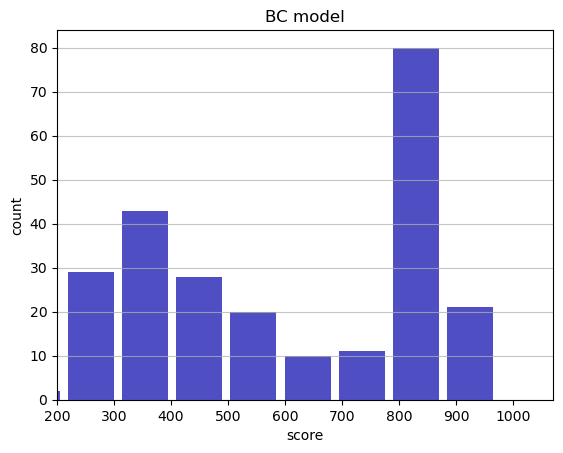

Track generation: 1284..1618 -> 334-tiles track
Epoch: 245
BC	mean: 603.92	variance: 237.33


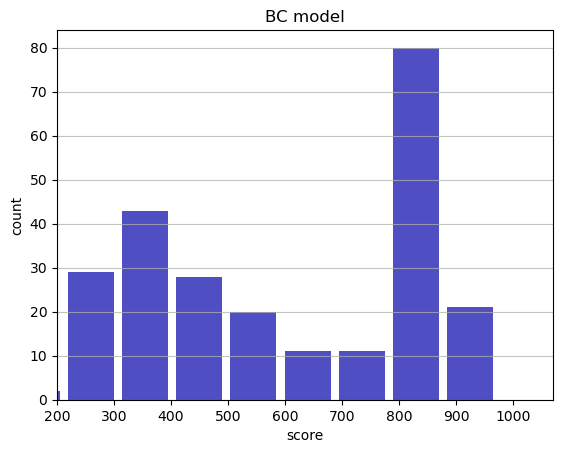

Track generation: 1143..1433 -> 290-tiles track
Epoch: 246
BC	mean: 602.88	variance: 237.40


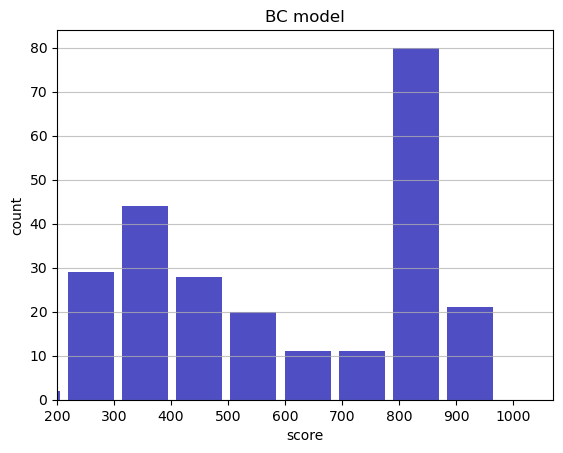

Track generation: 1059..1328 -> 269-tiles track
Epoch: 247
BC	mean: 603.86	variance: 237.42


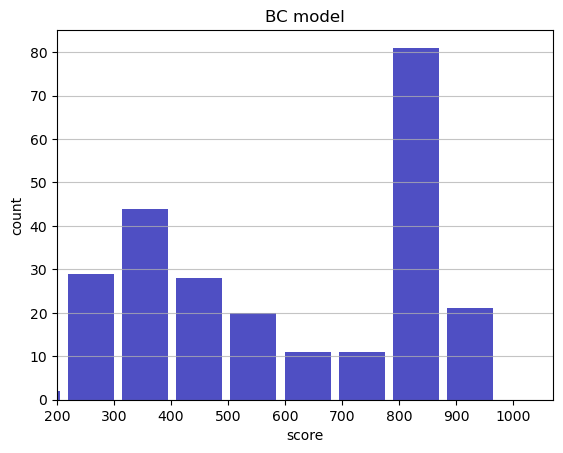

Track generation: 1292..1621 -> 329-tiles track
Epoch: 248
BC	mean: 605.14	variance: 237.79


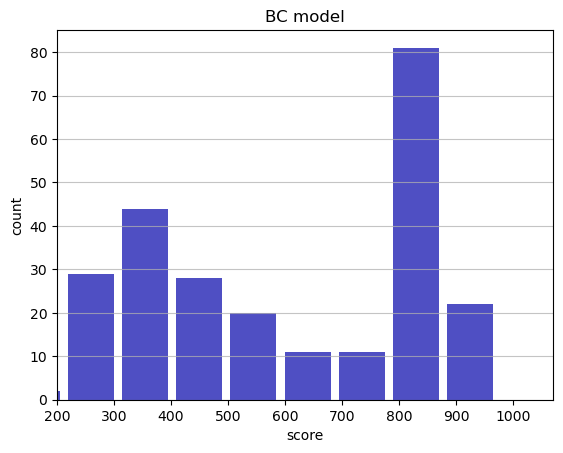

Track generation: 1118..1402 -> 284-tiles track
Epoch: 249
BC	mean: 605.06	variance: 237.32


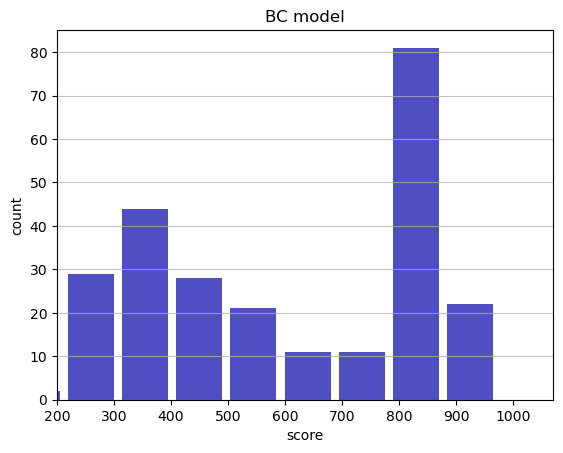

Track generation: 1215..1523 -> 308-tiles track
Epoch: 250
BC	mean: 603.91	variance: 237.54


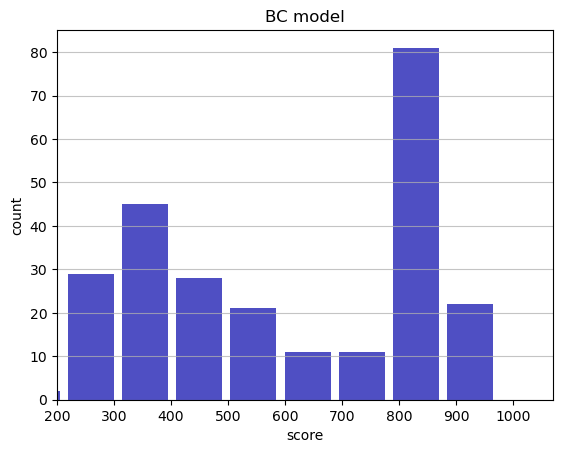

Track generation: 1128..1414 -> 286-tiles track
Epoch: 251
BC	mean: 603.72	variance: 237.08


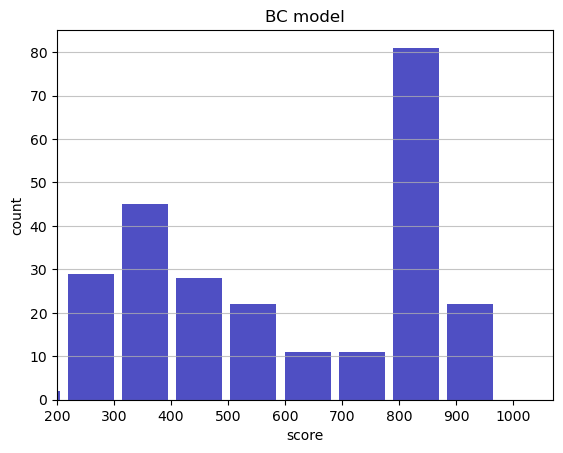

Track generation: 1224..1534 -> 310-tiles track
Epoch: 252
BC	mean: 603.57	variance: 236.62


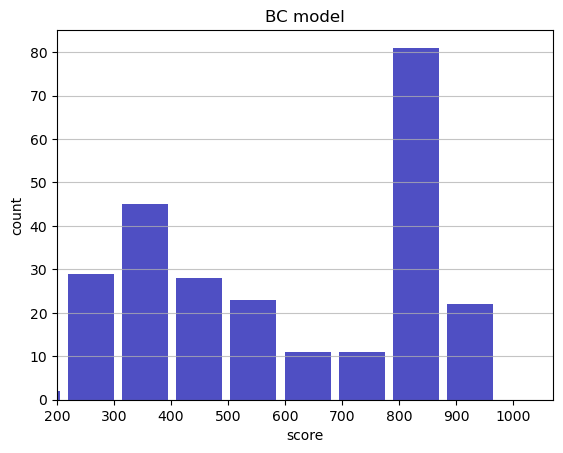

Track generation: 1264..1584 -> 320-tiles track
Epoch: 253
BC	mean: 602.37	variance: 236.92


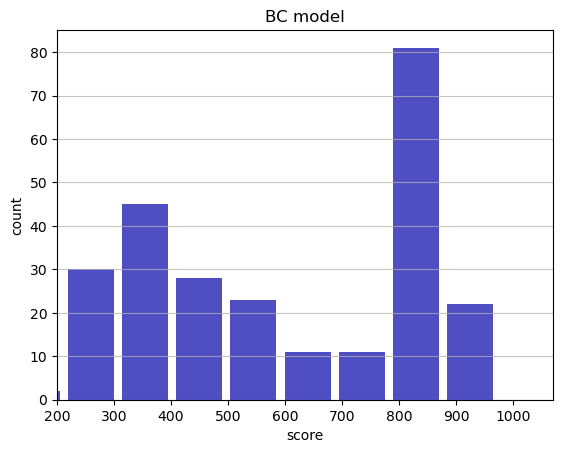

Track generation: 1091..1376 -> 285-tiles track
Epoch: 254
BC	mean: 601.42	variance: 236.94


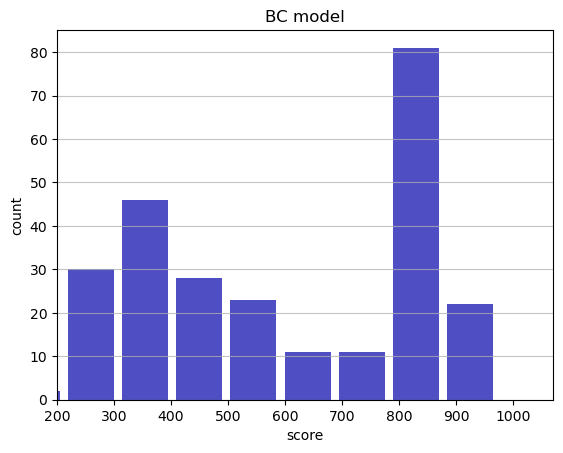

Track generation: 1125..1410 -> 285-tiles track
Epoch: 255
BC	mean: 600.06	variance: 237.46


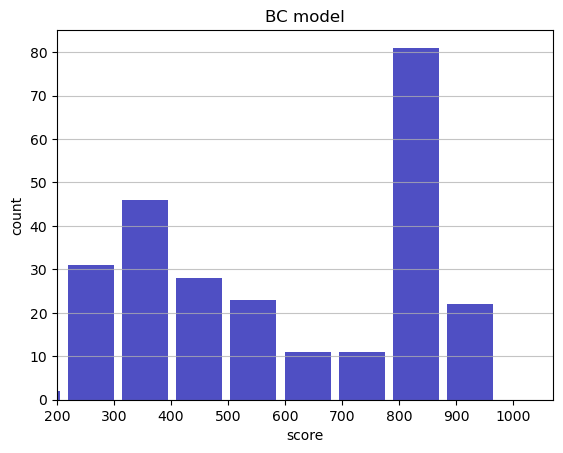

Track generation: 1014..1276 -> 262-tiles track
Epoch: 256
BC	mean: 601.07	variance: 237.53


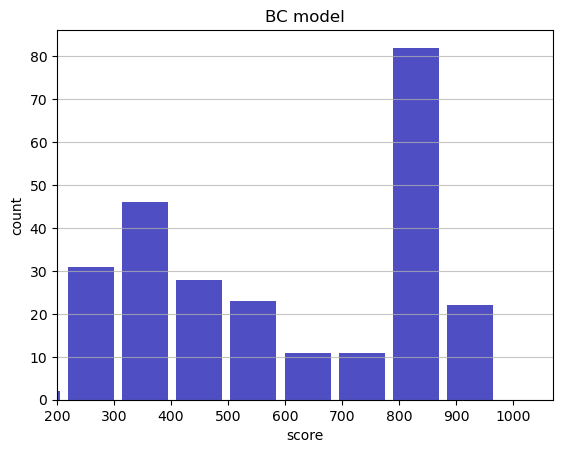

Track generation: 1137..1429 -> 292-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1096..1374 -> 278-tiles track
Epoch: 257
BC	mean: 599.89	variance: 237.82


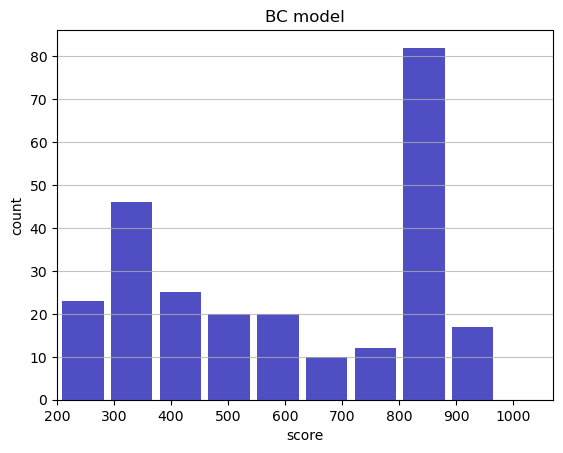

Track generation: 1240..1554 -> 314-tiles track
Epoch: 258
BC	mean: 599.08	variance: 237.71


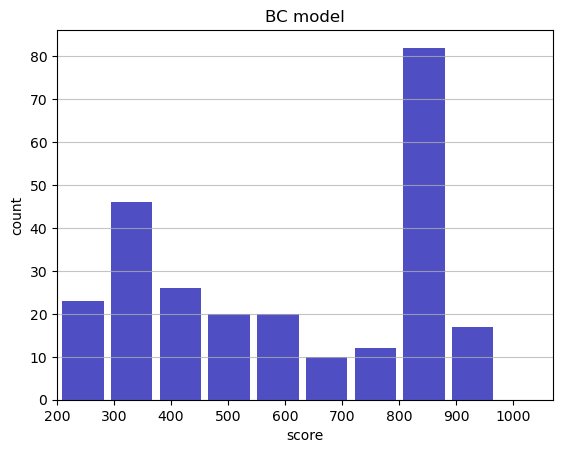

Track generation: 1033..1299 -> 266-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1204..1509 -> 305-tiles track
Epoch: 259
BC	mean: 598.89	variance: 237.27


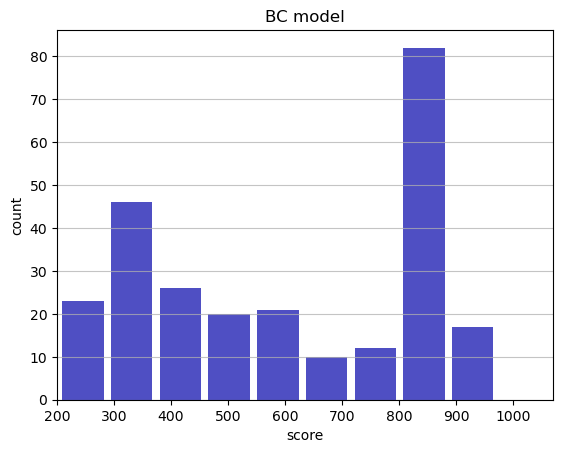

Track generation: 1192..1494 -> 302-tiles track
Epoch: 260
BC	mean: 598.49	variance: 236.90


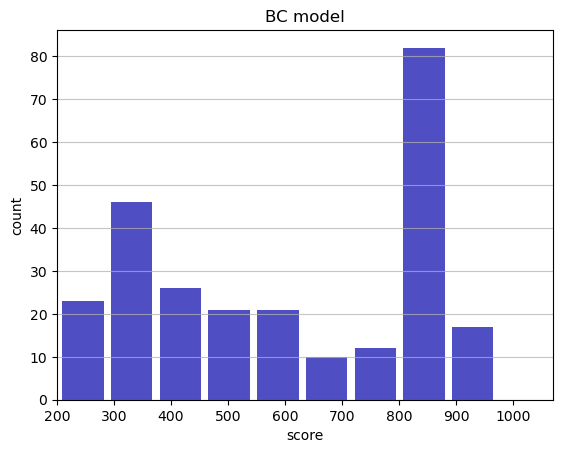

Track generation: 1359..1702 -> 343-tiles track
Epoch: 261
BC	mean: 597.40	variance: 237.11


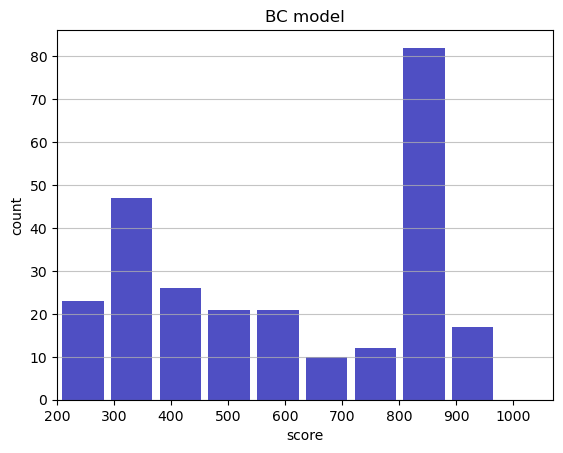

Track generation: 1192..1494 -> 302-tiles track
Epoch: 262
BC	mean: 596.04	variance: 237.67


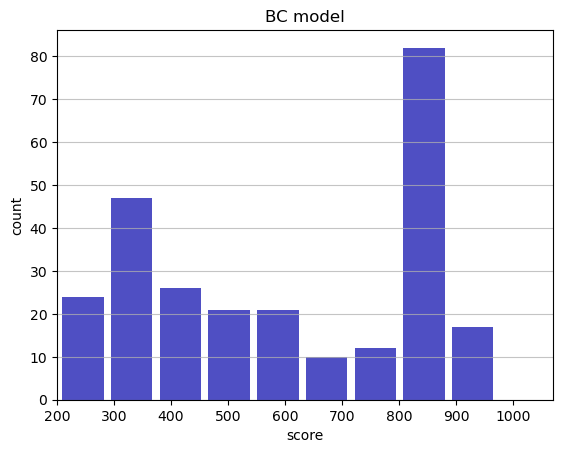

Track generation: 1175..1473 -> 298-tiles track
Epoch: 263
BC	mean: 594.82	variance: 238.03


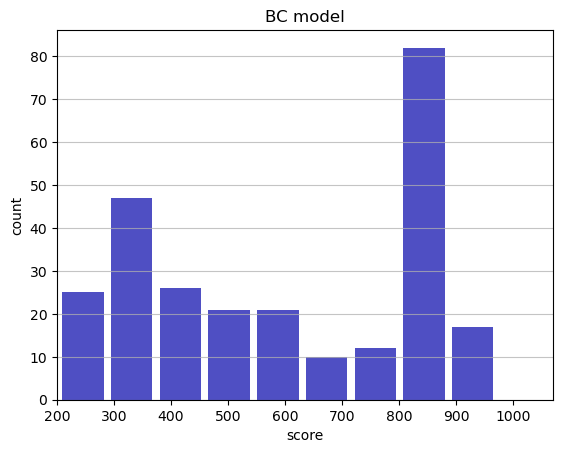

Track generation: 1090..1366 -> 276-tiles track
Epoch: 264
BC	mean: 595.69	variance: 238.00


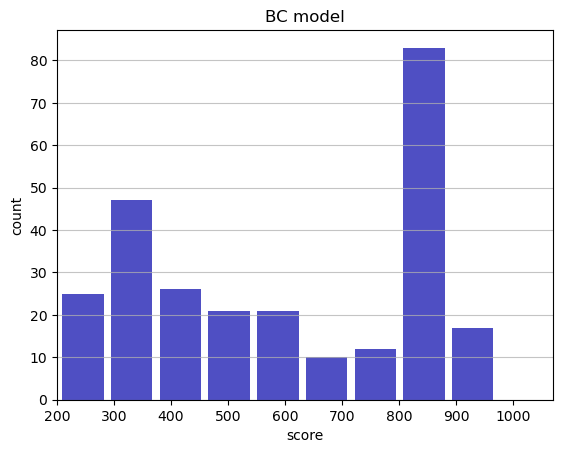

Track generation: 1180..1479 -> 299-tiles track
Epoch: 265
BC	mean: 596.72	variance: 238.13


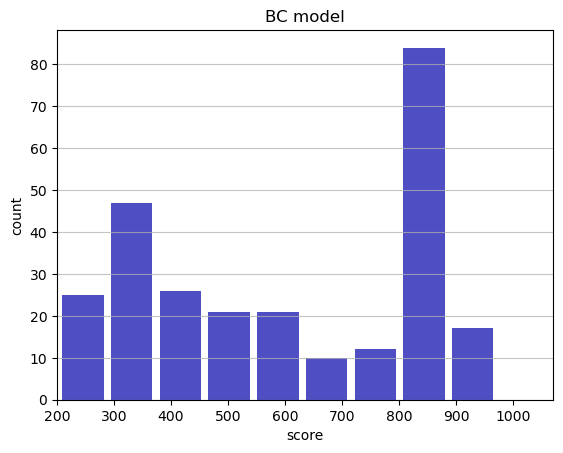

Track generation: 998..1251 -> 253-tiles track
Epoch: 266
BC	mean: 595.91	variance: 238.04


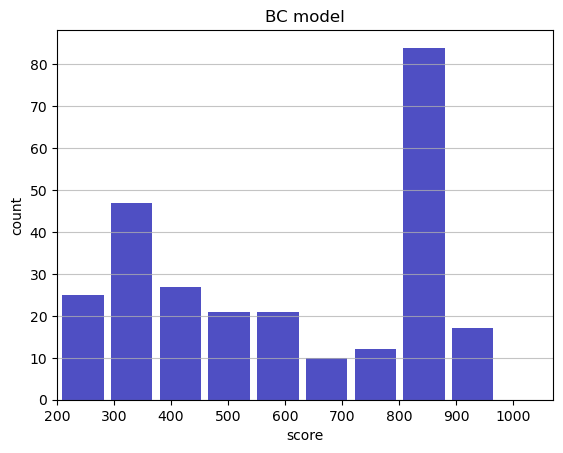

Track generation: 1104..1384 -> 280-tiles track
Epoch: 267
BC	mean: 594.60	variance: 238.56


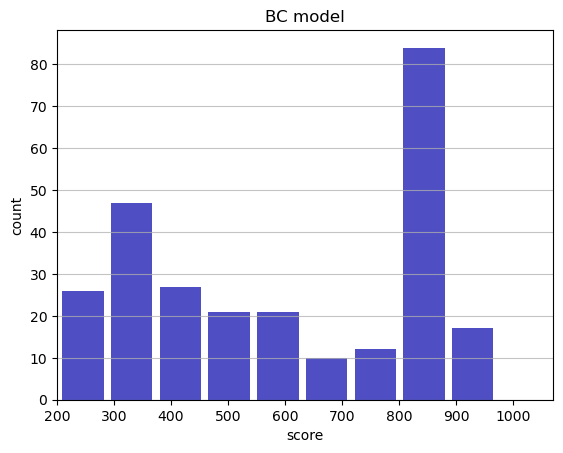

Track generation: 1079..1360 -> 281-tiles track
Epoch: 268
BC	mean: 593.60	variance: 238.68


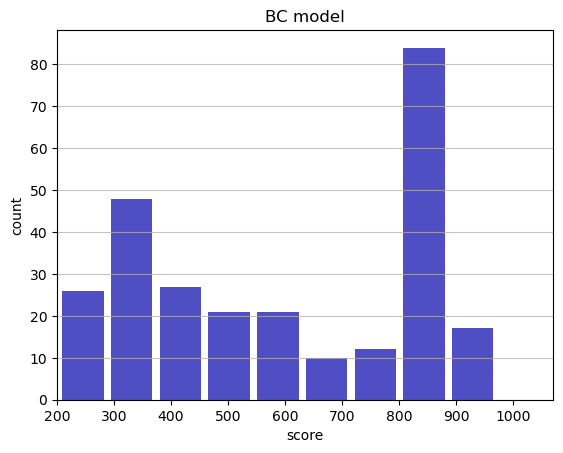

Track generation: 1153..1445 -> 292-tiles track
Epoch: 269
BC	mean: 594.55	variance: 238.74


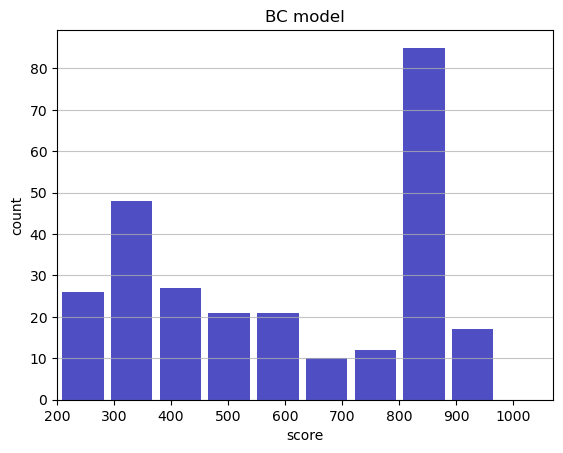

Track generation: 1337..1675 -> 338-tiles track
Epoch: 270
BC	mean: 594.81	variance: 238.34


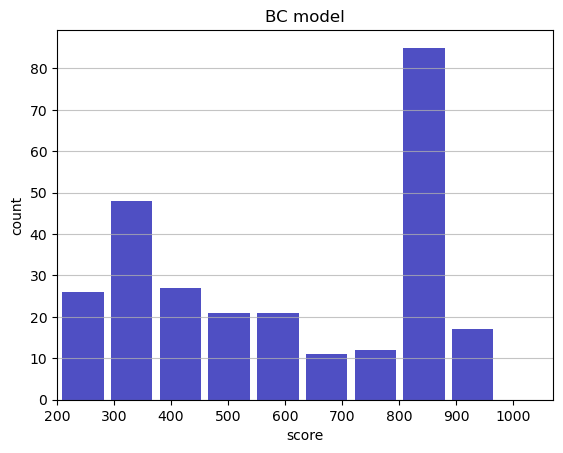

Track generation: 1044..1318 -> 274-tiles track
Epoch: 271
BC	mean: 595.74	variance: 238.38


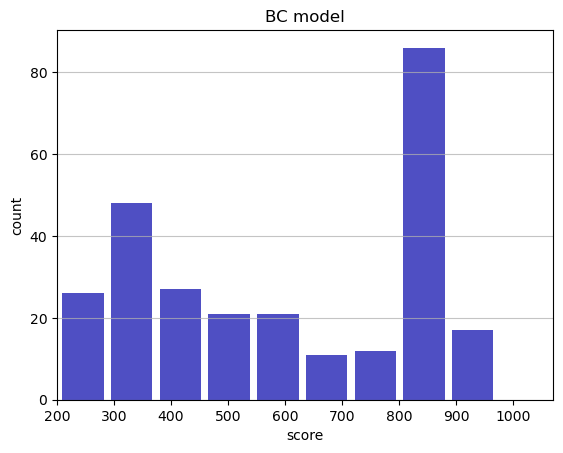

Track generation: 1179..1478 -> 299-tiles track
Epoch: 272
BC	mean: 594.65	variance: 238.62


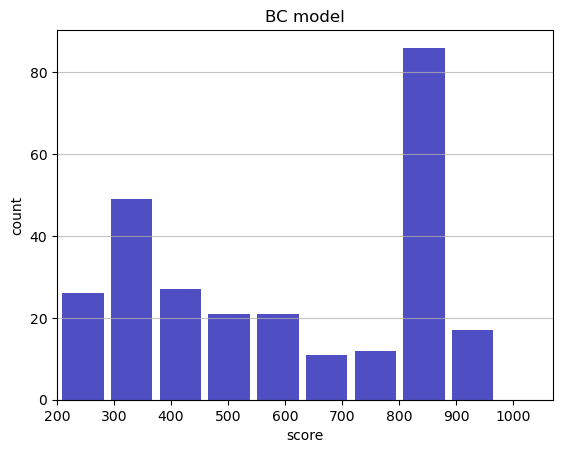

Track generation: 931..1175 -> 244-tiles track
Epoch: 273
BC	mean: 594.35	variance: 238.24


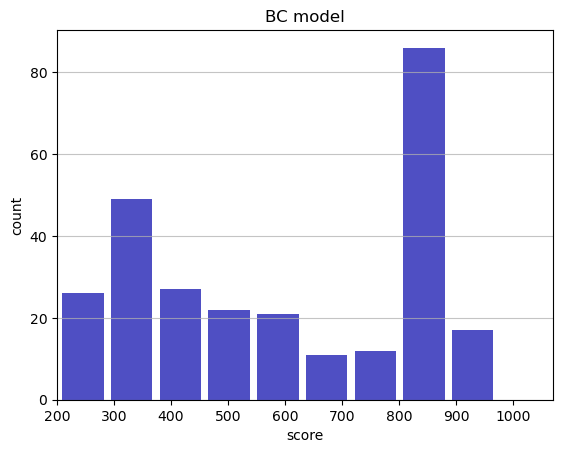

Track generation: 963..1216 -> 253-tiles track
Epoch: 274
BC	mean: 595.22	variance: 238.24


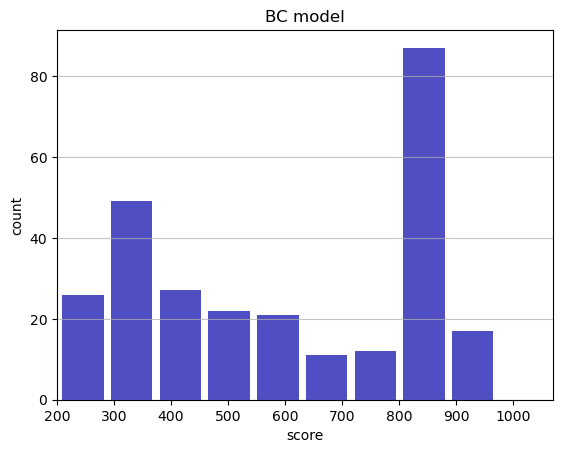

Track generation: 1164..1459 -> 295-tiles track
Epoch: 275
BC	mean: 594.42	variance: 238.18


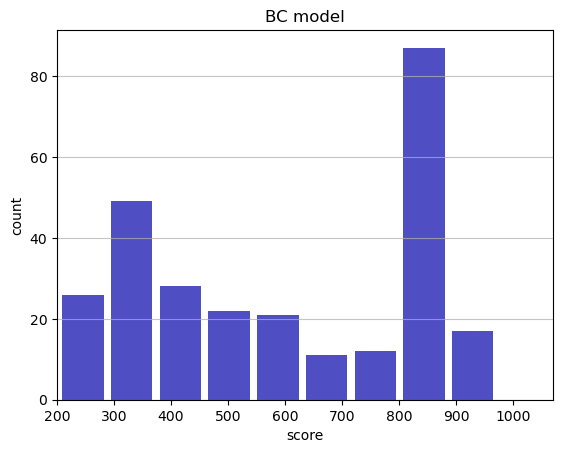

Track generation: 1341..1680 -> 339-tiles track
Epoch: 276
BC	mean: 593.79	variance: 237.97


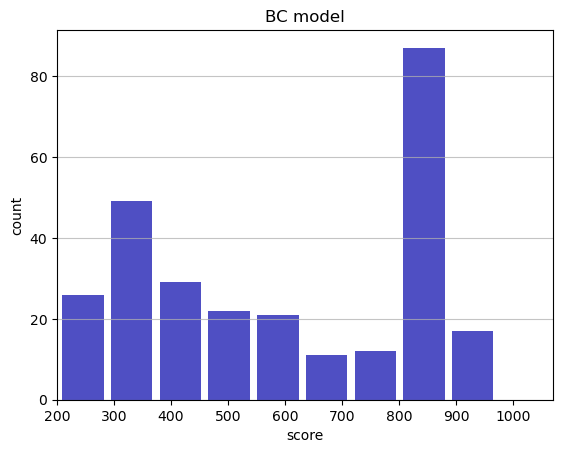

Track generation: 1119..1403 -> 284-tiles track
Epoch: 277
BC	mean: 594.65	variance: 237.97


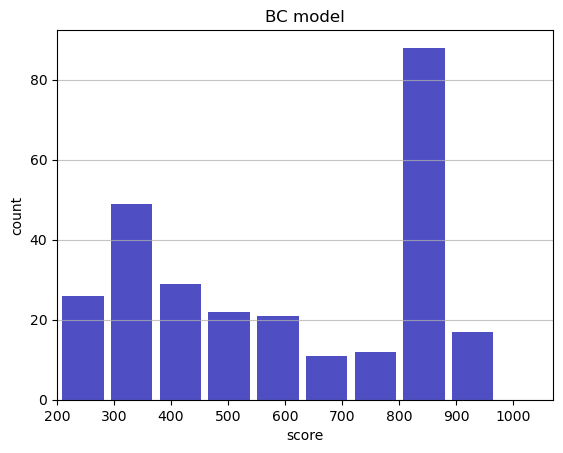

Track generation: 1184..1484 -> 300-tiles track
Epoch: 278
BC	mean: 595.84	variance: 238.37


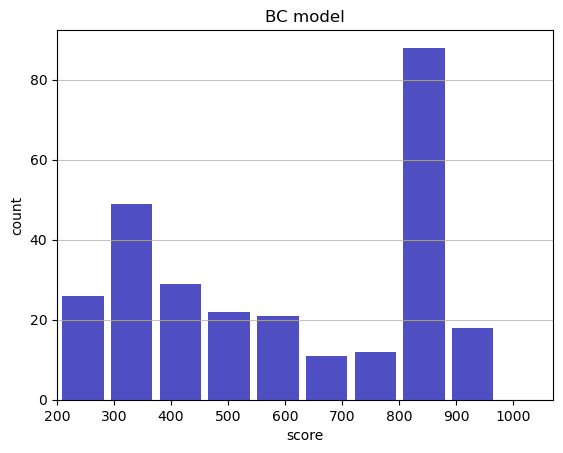

Track generation: 1436..1799 -> 363-tiles track
Epoch: 279
BC	mean: 595.97	variance: 237.95


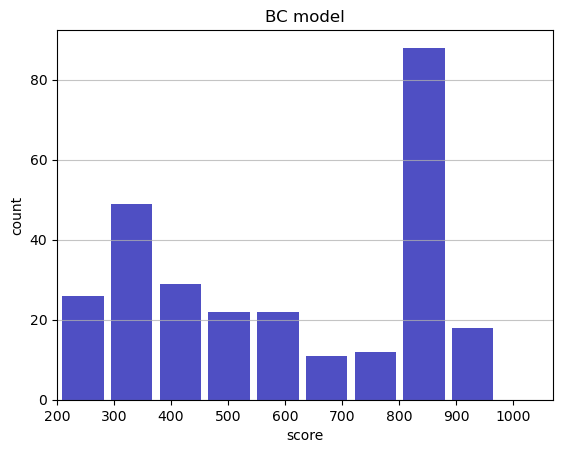

Track generation: 1097..1375 -> 278-tiles track
Epoch: 280
BC	mean: 596.78	variance: 237.91


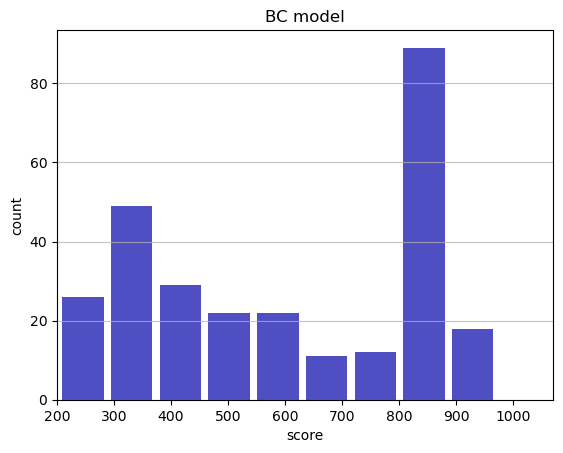

Track generation: 1034..1294 -> 260-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1103..1383 -> 280-tiles track
Epoch: 281
BC	mean: 597.70	variance: 237.99


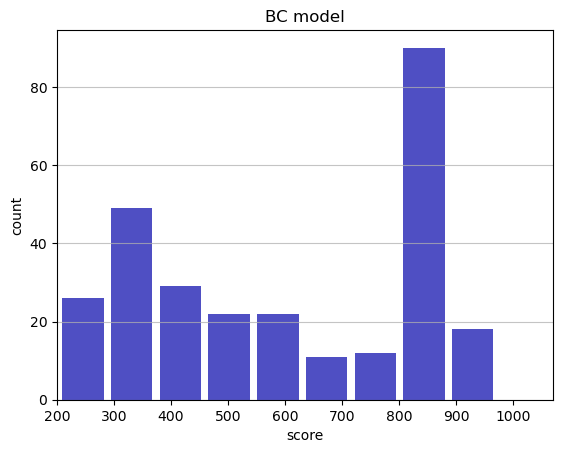

Track generation: 1045..1315 -> 270-tiles track
Epoch: 282
BC	mean: 599.24	variance: 238.95


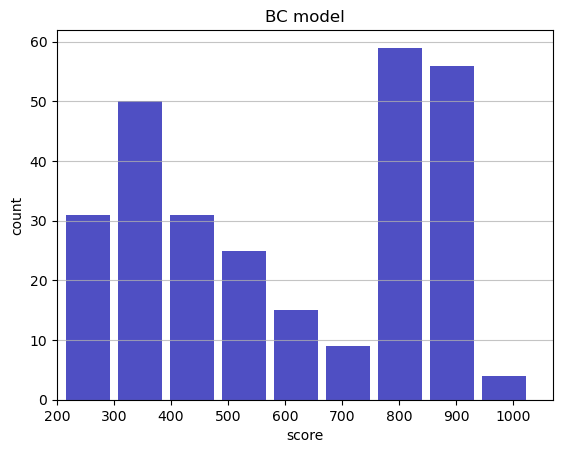

Track generation: 1248..1564 -> 316-tiles track
Epoch: 283
BC	mean: 600.04	variance: 238.91


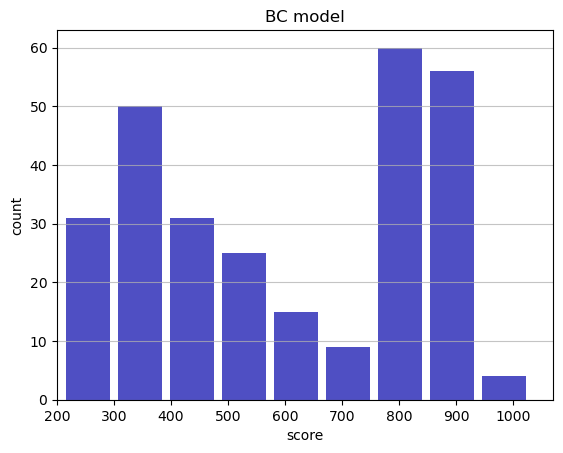

Track generation: 1245..1560 -> 315-tiles track
Epoch: 284
BC	mean: 598.77	variance: 239.43


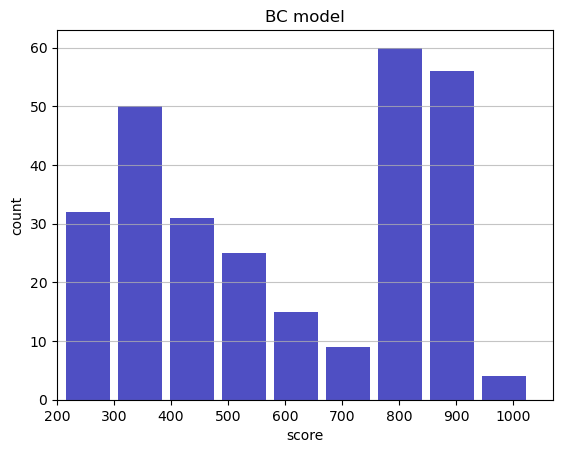

Track generation: 921..1160 -> 239-tiles track
Epoch: 285
BC	mean: 599.41	variance: 239.25


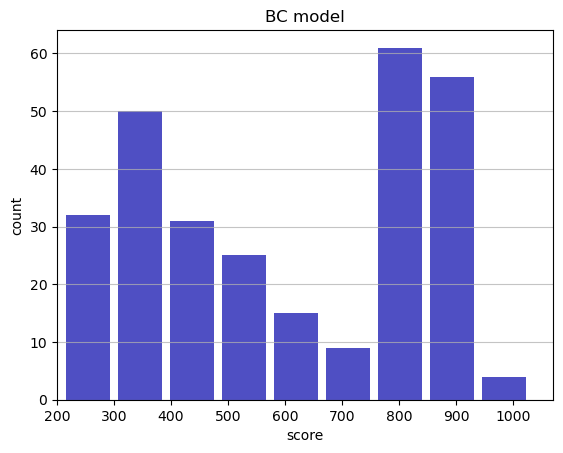

Track generation: 1095..1373 -> 278-tiles track
Epoch: 286
BC	mean: 598.59	variance: 239.23


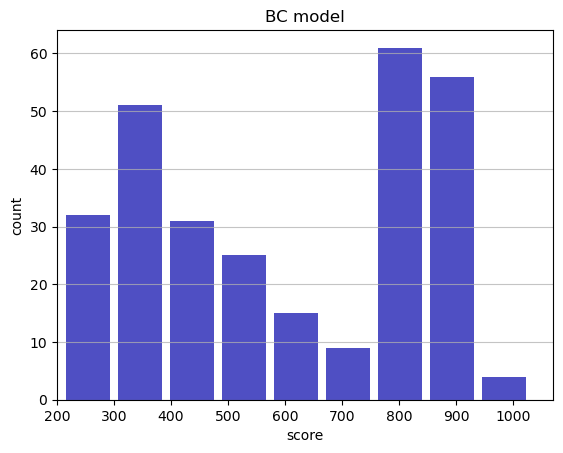

Track generation: 1132..1419 -> 287-tiles track
Epoch: 287
BC	mean: 599.51	variance: 239.31


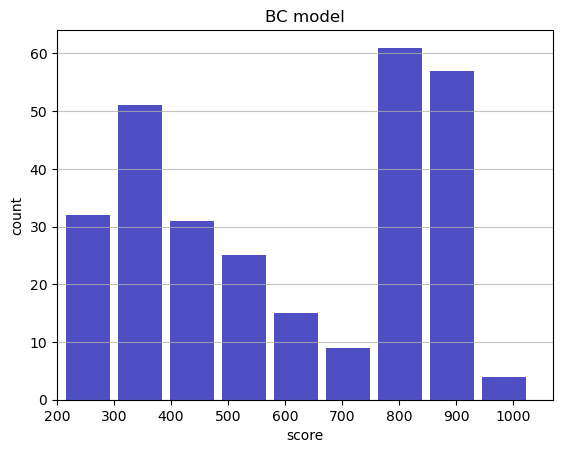

Track generation: 1253..1571 -> 318-tiles track
Epoch: 288
BC	mean: 600.40	variance: 239.37


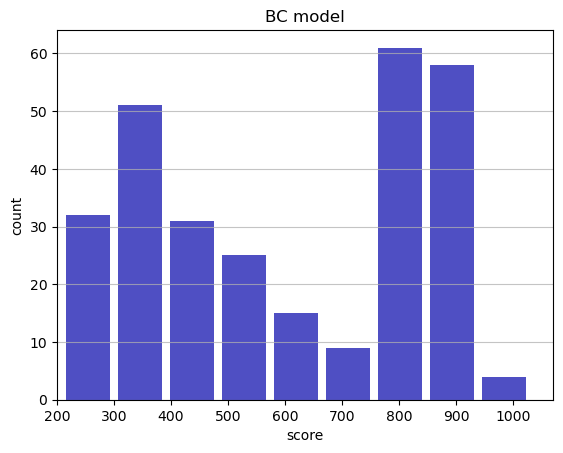

Track generation: 1199..1503 -> 304-tiles track
Epoch: 289
BC	mean: 601.36	variance: 239.51


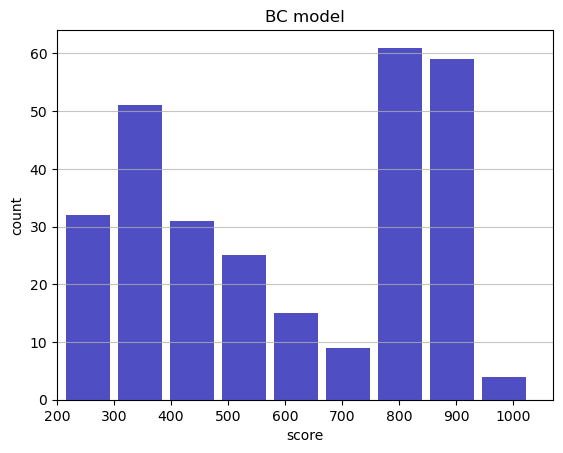

Track generation: 1080..1360 -> 280-tiles track
Epoch: 290
BC	mean: 602.58	variance: 240.00


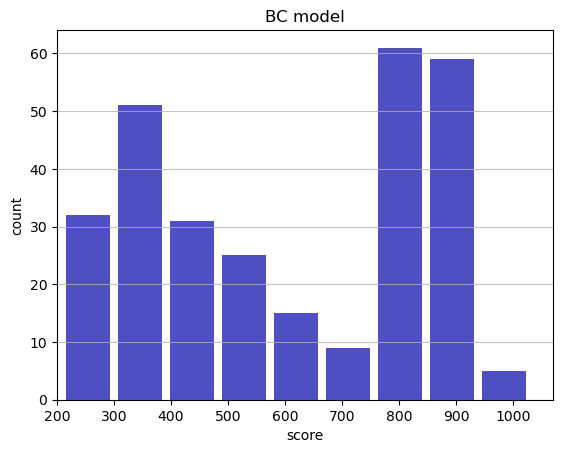

Track generation: 1067..1342 -> 275-tiles track
Epoch: 291
BC	mean: 601.92	variance: 239.85


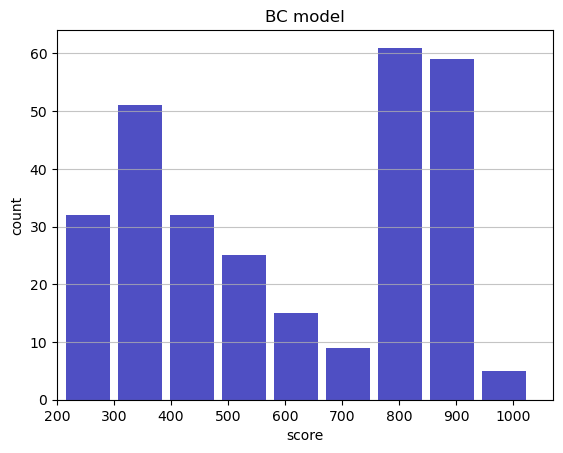

Track generation: 1168..1464 -> 296-tiles track
Epoch: 292
BC	mean: 600.79	variance: 240.22


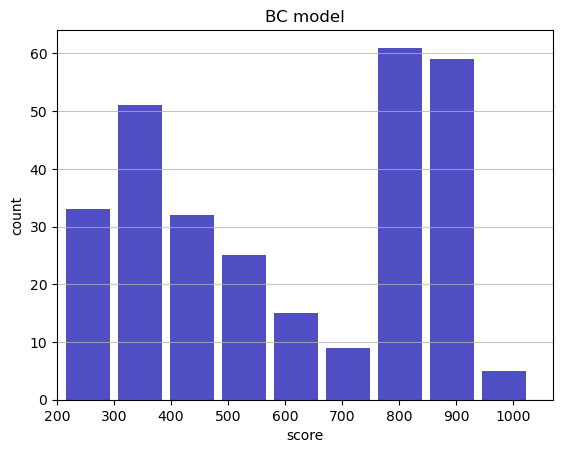

Track generation: 1093..1372 -> 279-tiles track
Epoch: 293
BC	mean: 599.95	variance: 240.25


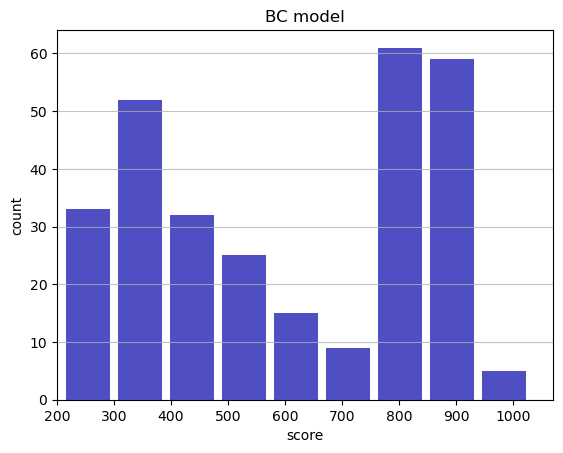

Track generation: 1306..1637 -> 331-tiles track
Epoch: 294
BC	mean: 601.13	variance: 240.69


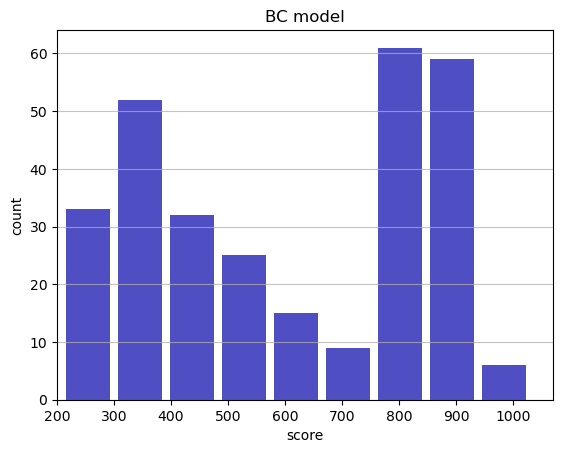

Track generation: 1074..1354 -> 280-tiles track
Epoch: 295
BC	mean: 601.07	variance: 240.29


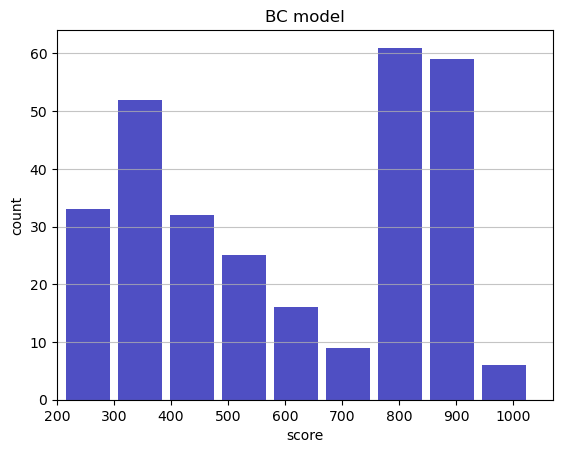

Track generation: 1123..1408 -> 285-tiles track
Epoch: 296
BC	mean: 600.03	variance: 240.54


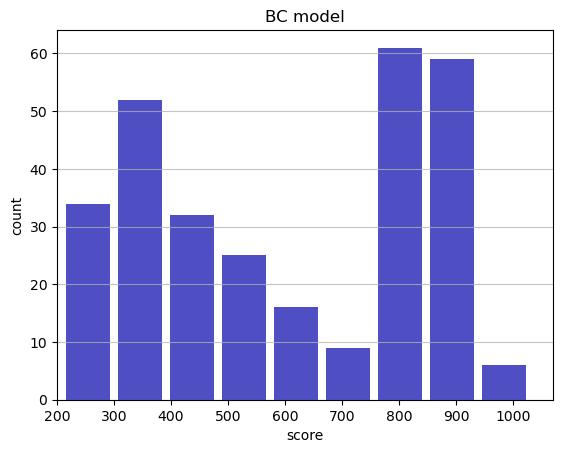

Track generation: 1048..1319 -> 271-tiles track
Epoch: 297
BC	mean: 600.27	variance: 240.17


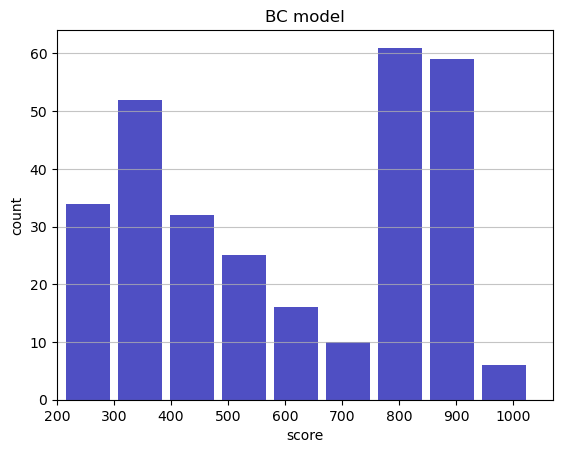

Track generation: 1176..1474 -> 298-tiles track
Epoch: 298
BC	mean: 599.10	variance: 240.62


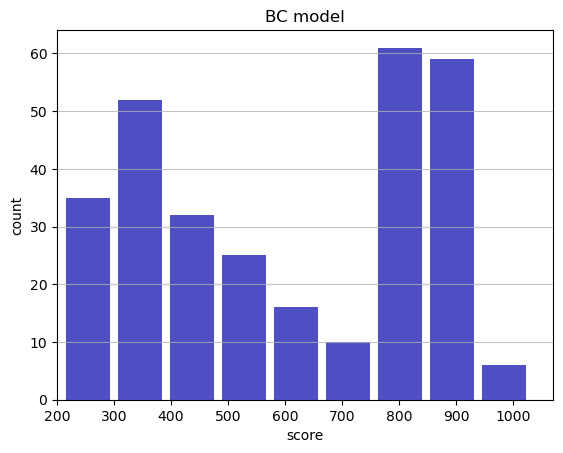

Track generation: 1249..1565 -> 316-tiles track
Epoch: 299
BC	mean: 599.87	variance: 240.58


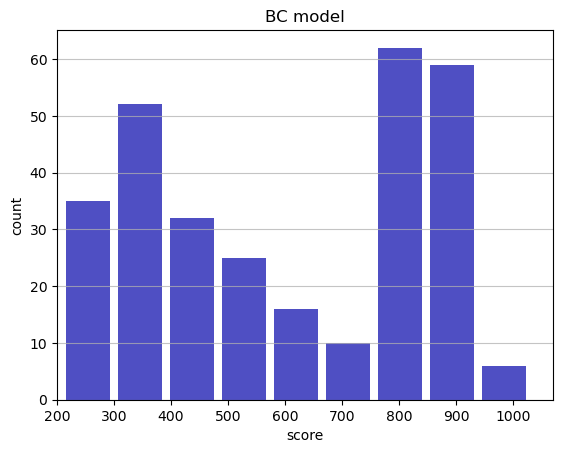

Track generation: 1060..1329 -> 269-tiles track
Epoch: 300
BC	mean: 600.59	variance: 240.50


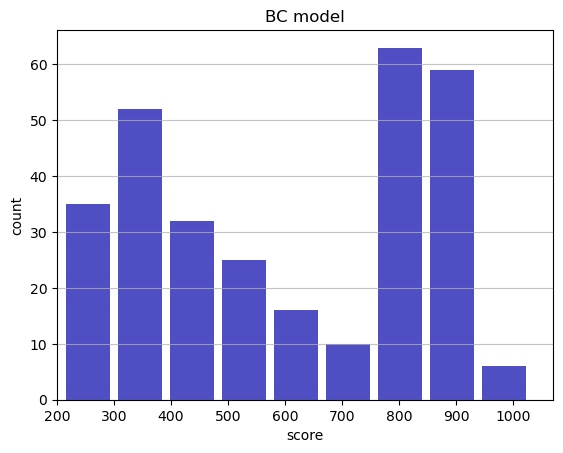

Track generation: 1200..1504 -> 304-tiles track
Epoch: 301
BC	mean: 601.27	variance: 240.39


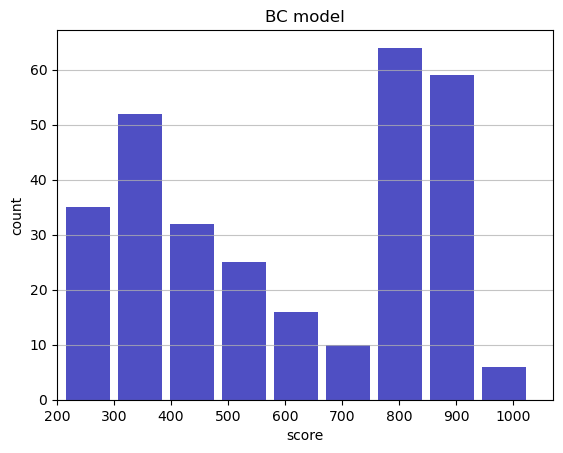

Track generation: 1085..1364 -> 279-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1009..1269 -> 260-tiles track
Epoch: 302
BC	mean: 602.12	variance: 240.44


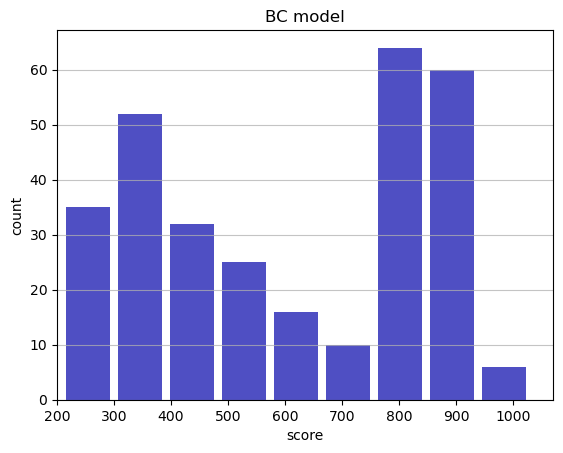

Track generation: 1090..1371 -> 281-tiles track
Epoch: 303
BC	mean: 601.52	variance: 240.27


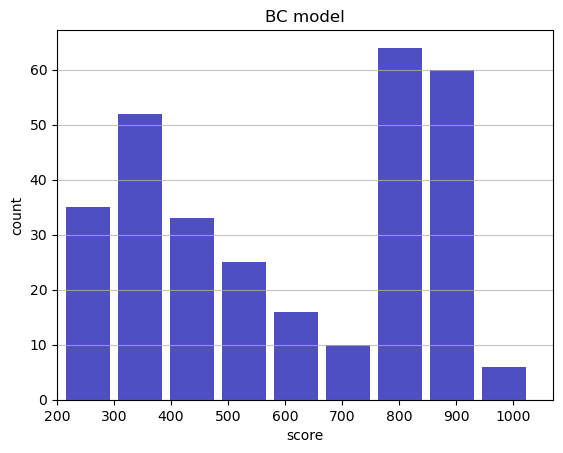

Track generation: 1112..1394 -> 282-tiles track
Epoch: 304
BC	mean: 601.50	variance: 239.88


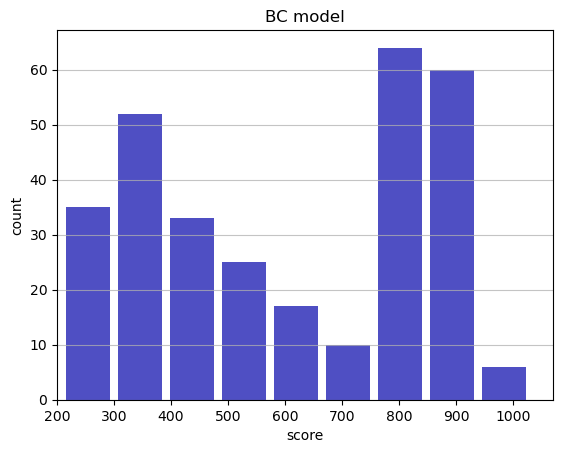

Track generation: 1091..1374 -> 283-tiles track
Epoch: 305
BC	mean: 601.17	variance: 239.55


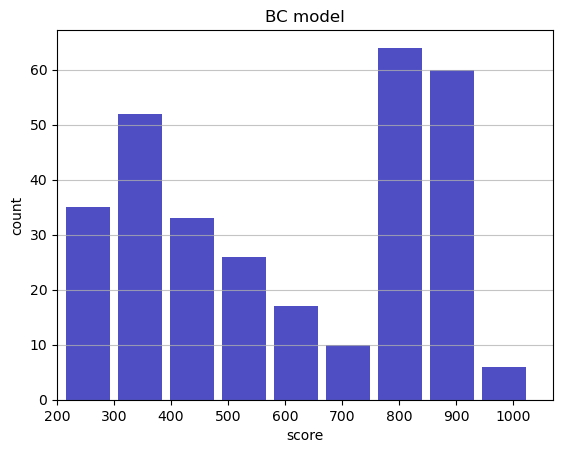

Track generation: 1151..1443 -> 292-tiles track
Epoch: 306
BC	mean: 601.89	variance: 239.49


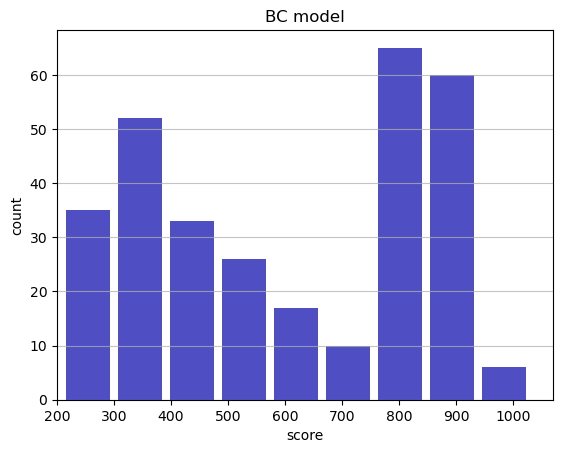

Track generation: 1093..1371 -> 278-tiles track
Epoch: 307
BC	mean: 601.60	variance: 239.15


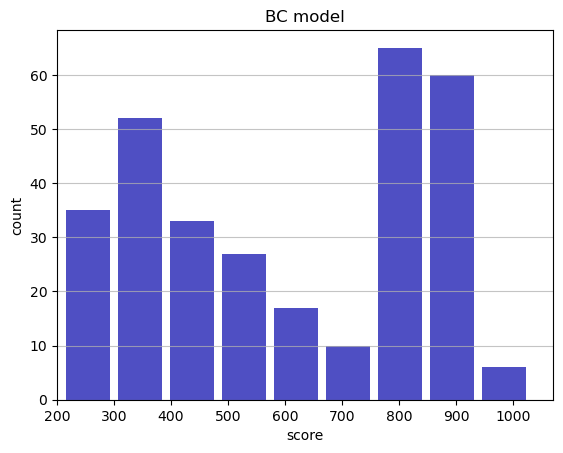

Track generation: 1116..1407 -> 291-tiles track
Epoch: 308
BC	mean: 601.45	variance: 238.78


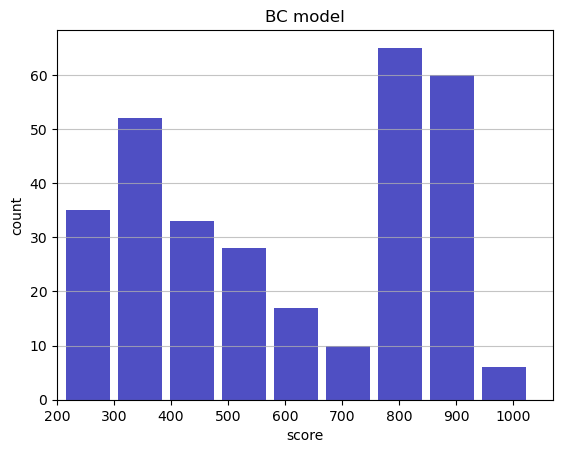

Track generation: 1106..1392 -> 286-tiles track
Epoch: 309
BC	mean: 601.20	variance: 238.43


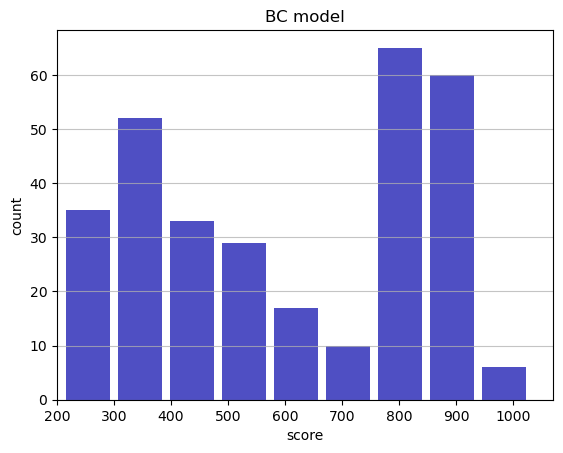

Track generation: 1348..1689 -> 341-tiles track
Epoch: 310
BC	mean: 600.03	variance: 238.93


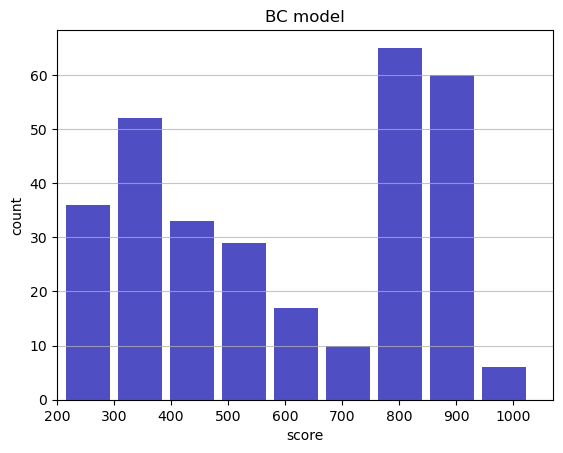

Track generation: 1143..1433 -> 290-tiles track
Epoch: 311
BC	mean: 600.72	variance: 238.85


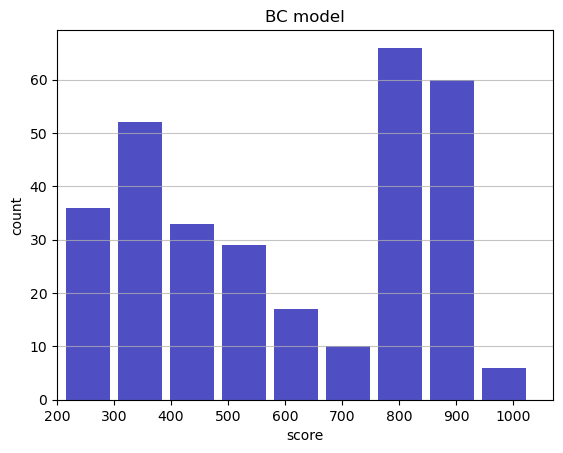

Track generation: 1303..1633 -> 330-tiles track
Epoch: 312
BC	mean: 600.38	variance: 238.55


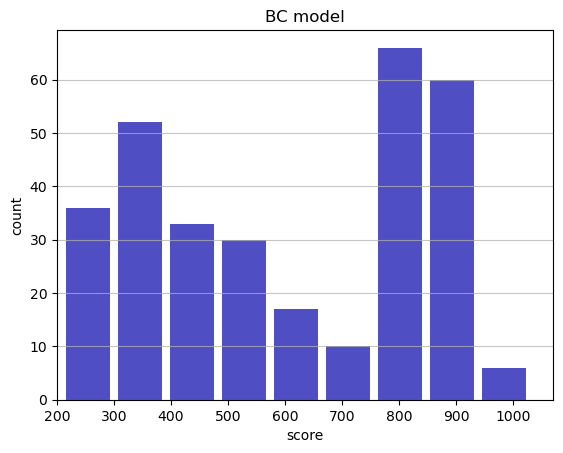

Track generation: 1012..1269 -> 257-tiles track
Epoch: 313
BC	mean: 601.18	variance: 238.59


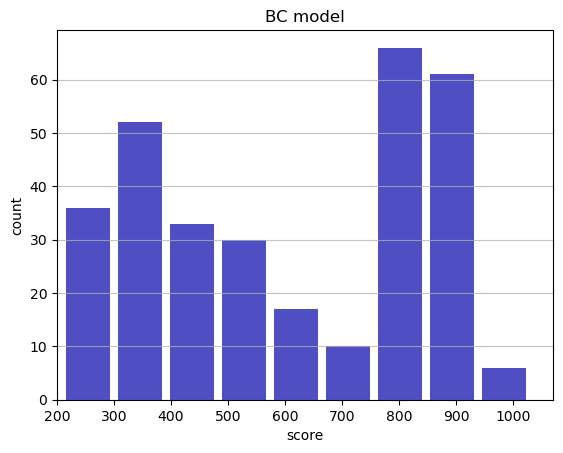

Track generation: 1108..1392 -> 284-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1133..1420 -> 287-tiles track
Epoch: 314
BC	mean: 600.23	variance: 238.80


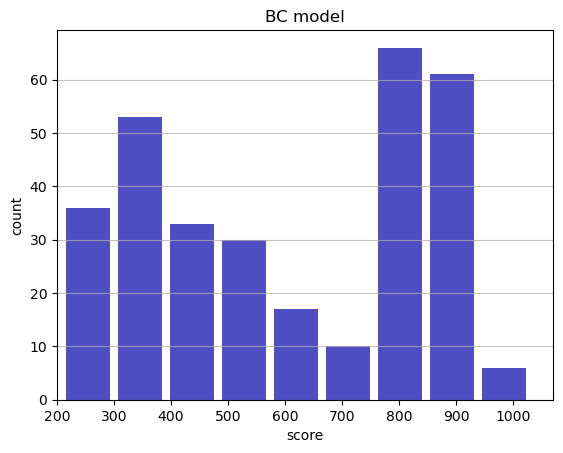

Track generation: 1196..1500 -> 304-tiles track
Epoch: 315
BC	mean: 600.17	variance: 238.42


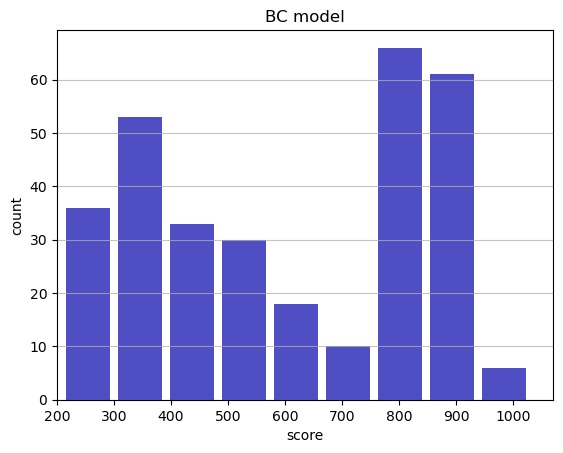

Track generation: 1175..1473 -> 298-tiles track
Epoch: 316
BC	mean: 599.33	variance: 238.51


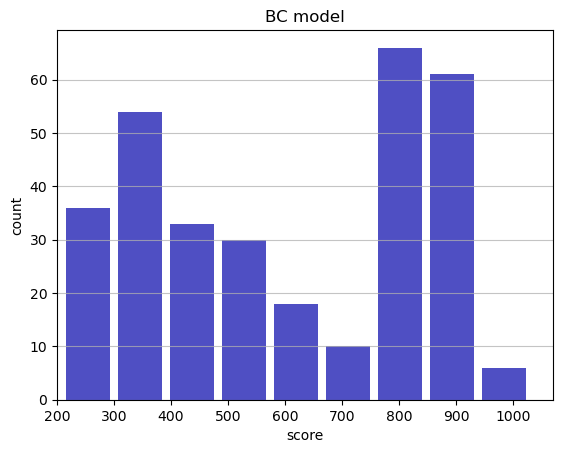

Track generation: 1144..1434 -> 290-tiles track
Epoch: 317
BC	mean: 598.50	variance: 238.59


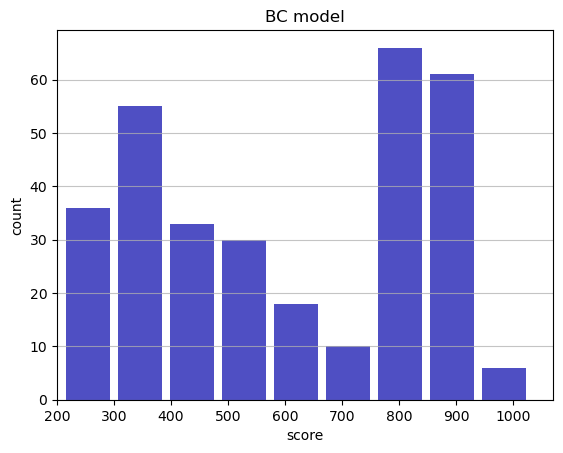

Track generation: 1246..1562 -> 316-tiles track
Epoch: 318
BC	mean: 599.55	variance: 238.95


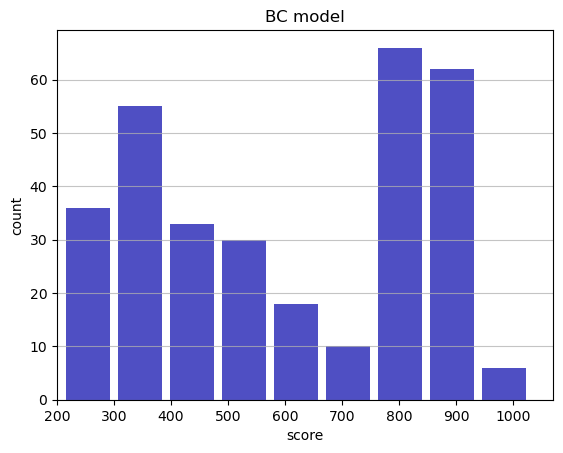

Track generation: 1268..1589 -> 321-tiles track
Epoch: 319
BC	mean: 600.55	variance: 239.24


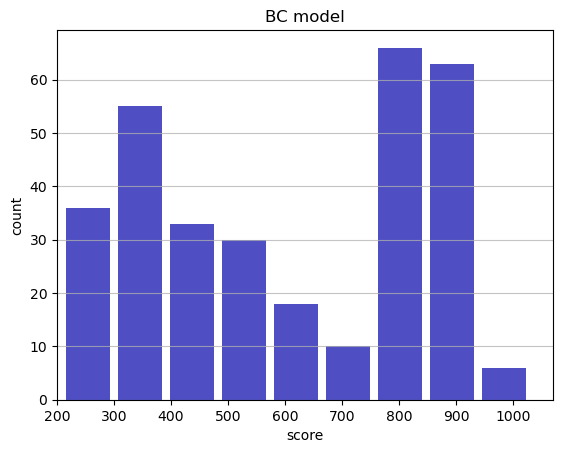

Track generation: 1091..1368 -> 277-tiles track
Epoch: 320
BC	mean: 601.34	variance: 239.28


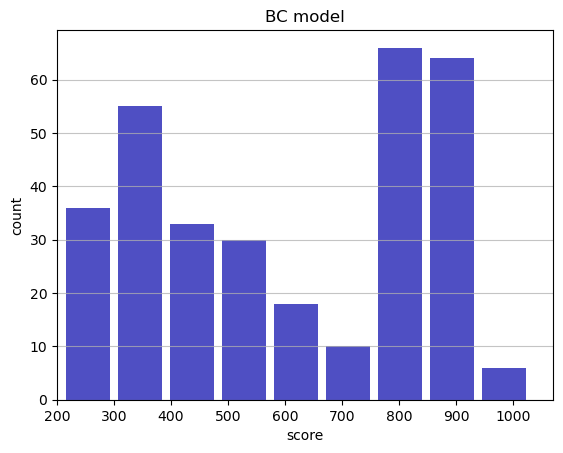

Track generation: 1244..1559 -> 315-tiles track
Epoch: 321
BC	mean: 600.43	variance: 239.46


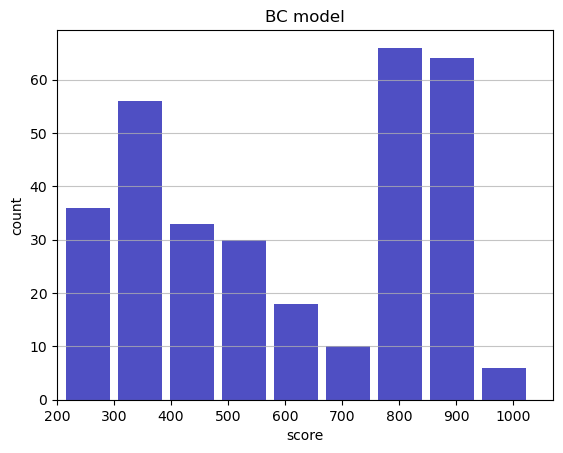

Track generation: 1226..1539 -> 313-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1214..1524 -> 310-tiles track
Epoch: 322
BC	mean: 601.34	variance: 239.64


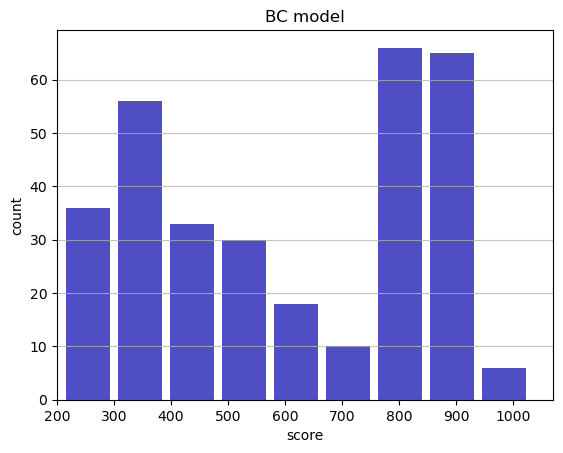

Track generation: 1195..1498 -> 303-tiles track
Epoch: 323
BC	mean: 600.28	variance: 240.02


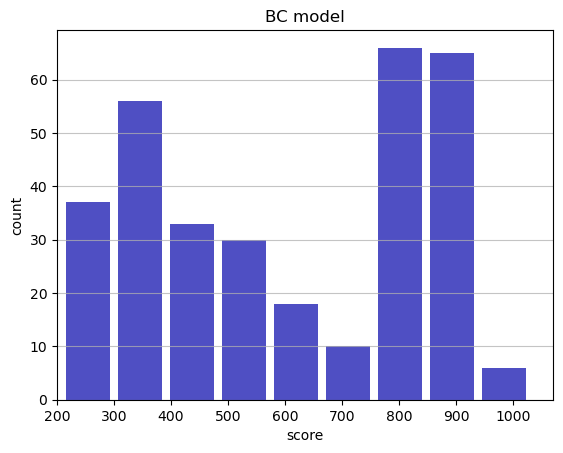

Track generation: 1084..1359 -> 275-tiles track
Epoch: 324
BC	mean: 601.08	variance: 240.08


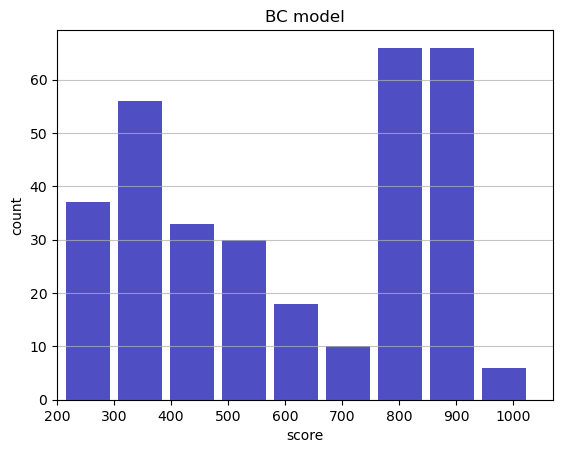

Track generation: 1062..1340 -> 278-tiles track
Epoch: 325
BC	mean: 599.78	variance: 240.85


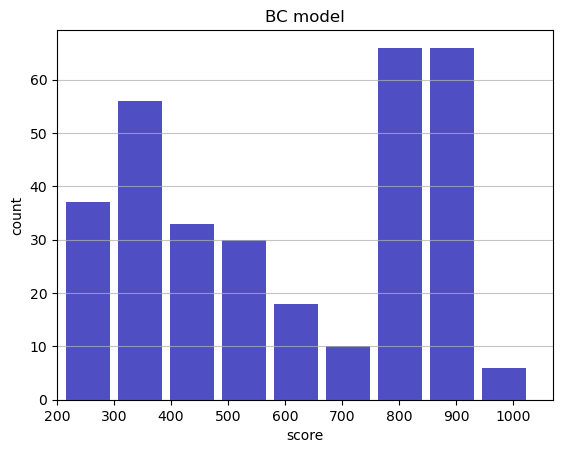

Track generation: 1064..1334 -> 270-tiles track
Epoch: 326
BC	mean: 600.52	variance: 240.85


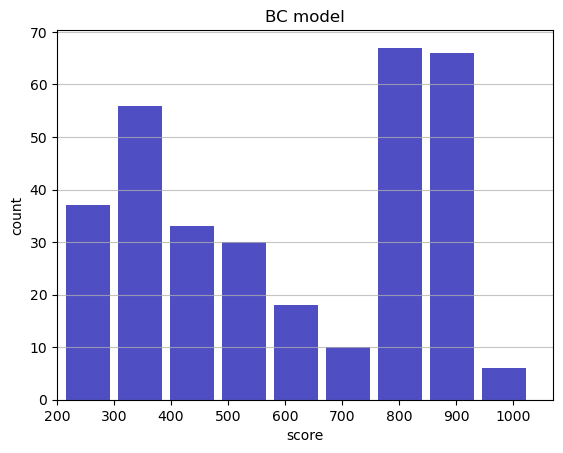

Track generation: 1184..1483 -> 299-tiles track
Epoch: 327
BC	mean: 599.63	variance: 241.02


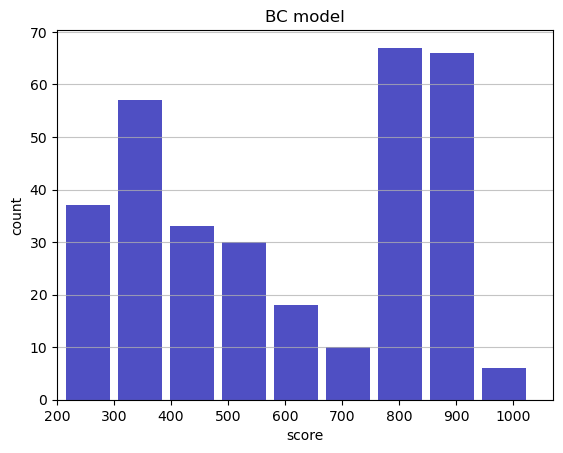

Track generation: 1136..1432 -> 296-tiles track
Epoch: 328
BC	mean: 599.51	variance: 240.66


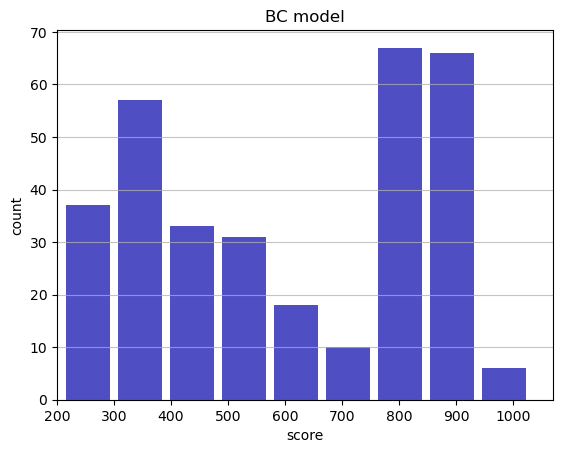

Track generation: 1097..1375 -> 278-tiles track
Epoch: 329
BC	mean: 598.75	variance: 240.69


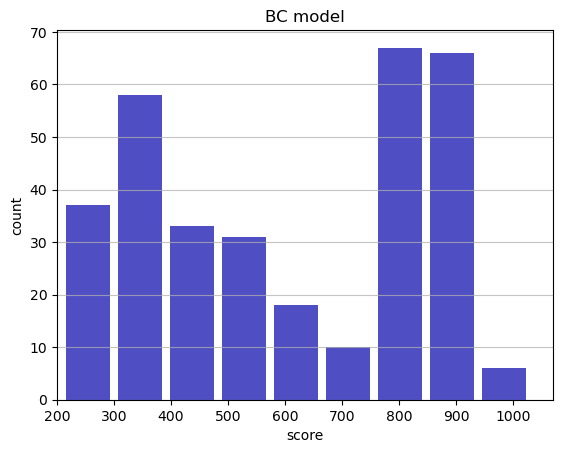

Track generation: 1002..1259 -> 257-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1254..1572 -> 318-tiles track
Epoch: 330
BC	mean: 599.06	variance: 240.39


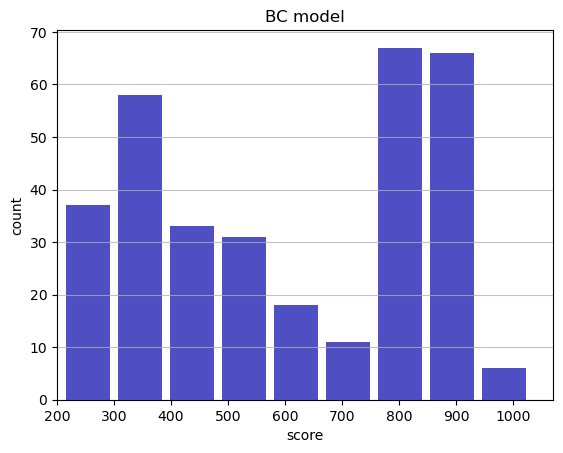

Track generation: 1047..1313 -> 266-tiles track
Epoch: 331
BC	mean: 598.58	variance: 240.19


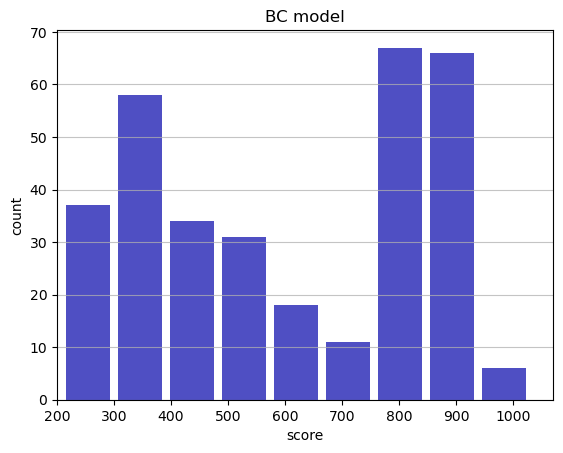

Track generation: 1021..1286 -> 265-tiles track
Epoch: 332
BC	mean: 598.77	variance: 239.85


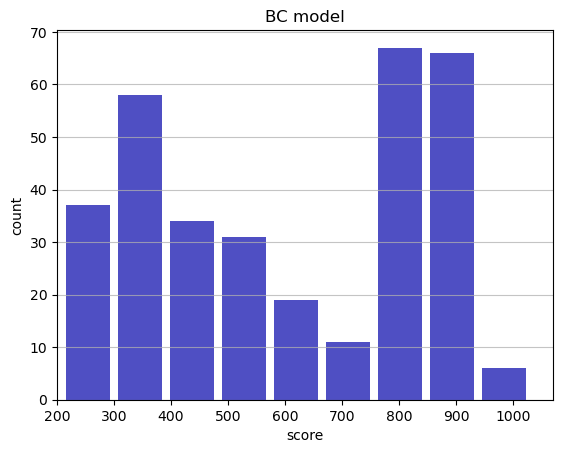

Track generation: 1017..1275 -> 258-tiles track
Epoch: 333
BC	mean: 599.43	variance: 239.79


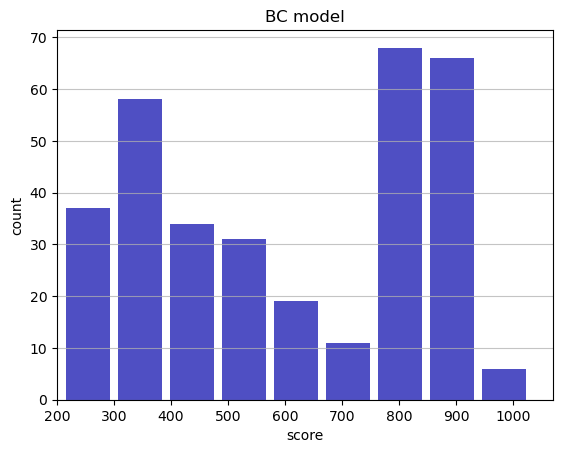

Track generation: 1091..1370 -> 279-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 999..1255 -> 256-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1471..1843 -> 372-tiles track
Epoch: 334
BC	mean: 598.39	variance: 240.18


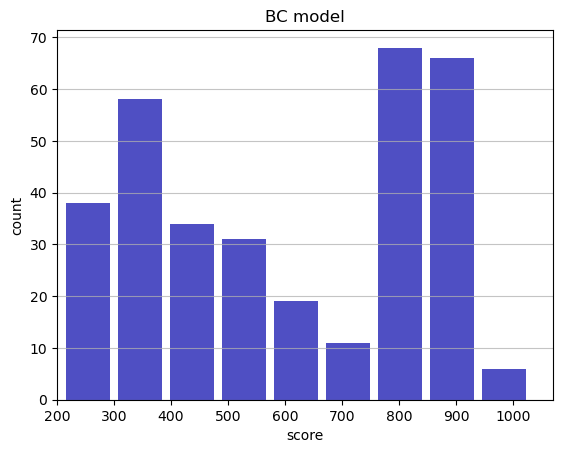

Track generation: 1355..1698 -> 343-tiles track
Epoch: 335
BC	mean: 598.17	variance: 239.85


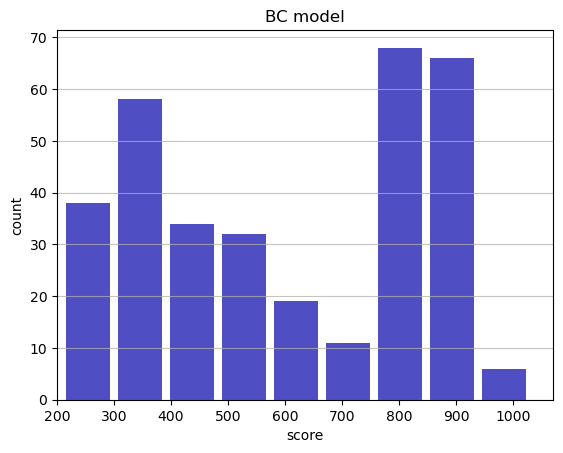

Track generation: 1027..1291 -> 264-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1028..1292 -> 264-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1012..1275 -> 263-tiles track
Epoch: 336
BC	mean: 597.52	variance: 239.80


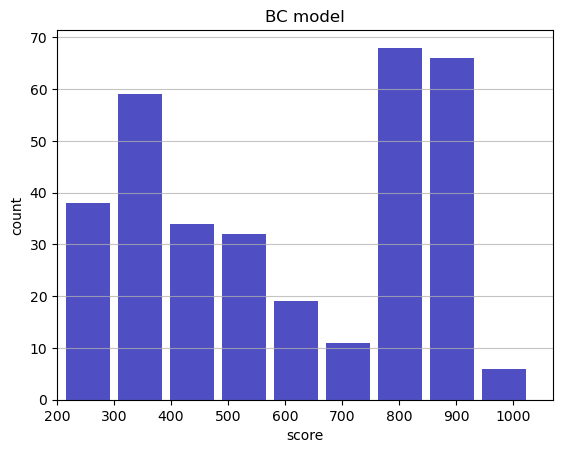

Track generation: 1286..1612 -> 326-tiles track
Epoch: 337
BC	mean: 596.55	variance: 240.11


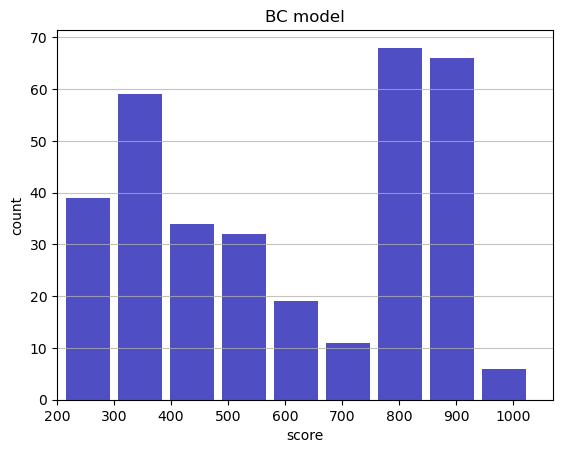

Track generation: 961..1211 -> 250-tiles track
Epoch: 338
BC	mean: 596.55	variance: 239.75


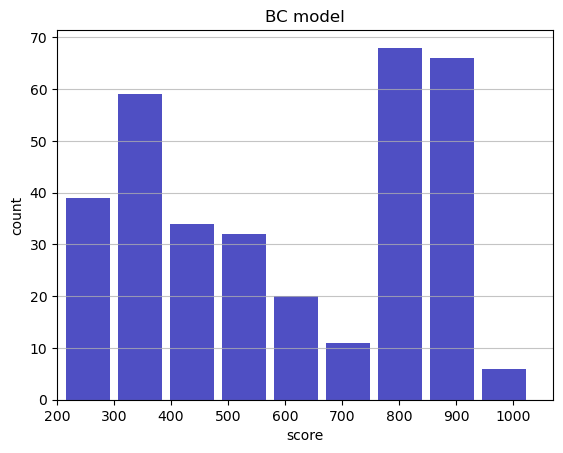

Track generation: 970..1220 -> 250-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1187..1488 -> 301-tiles track
Epoch: 339
BC	mean: 597.05	variance: 239.58


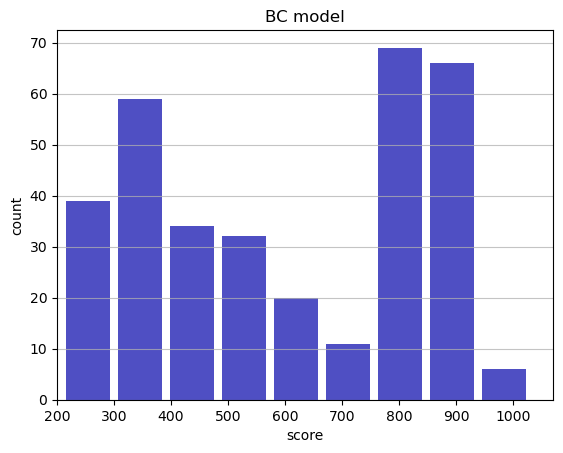

Track generation: 1136..1424 -> 288-tiles track
Epoch: 340
BC	mean: 597.46	variance: 239.34


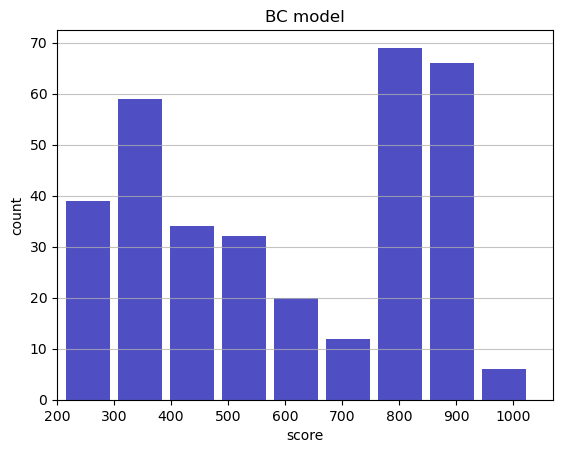

Track generation: 1132..1418 -> 286-tiles track
Epoch: 341
BC	mean: 596.69	variance: 239.42


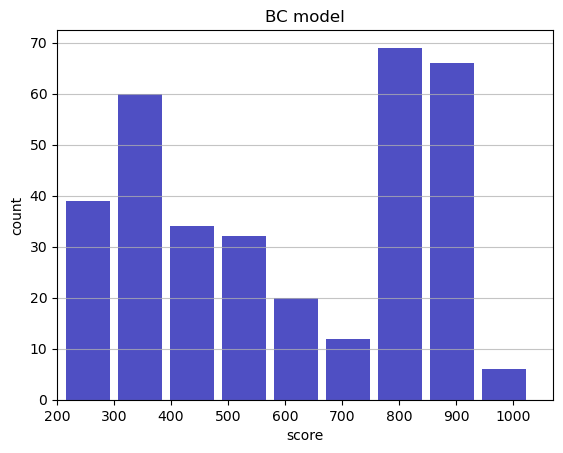

Track generation: 1204..1517 -> 313-tiles track
Epoch: 342
BC	mean: 596.11	variance: 239.30


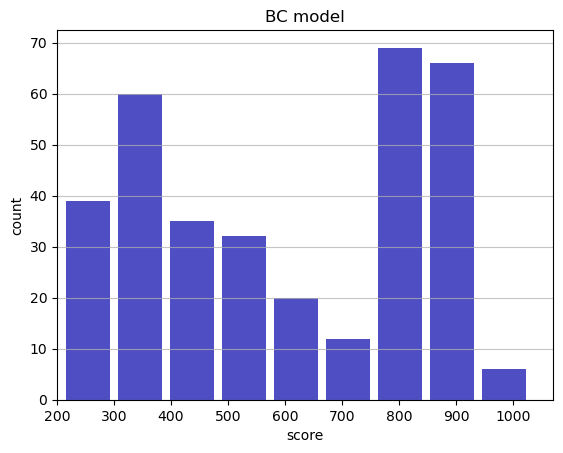

Track generation: 1204..1509 -> 305-tiles track
Epoch: 343
BC	mean: 596.81	variance: 239.30


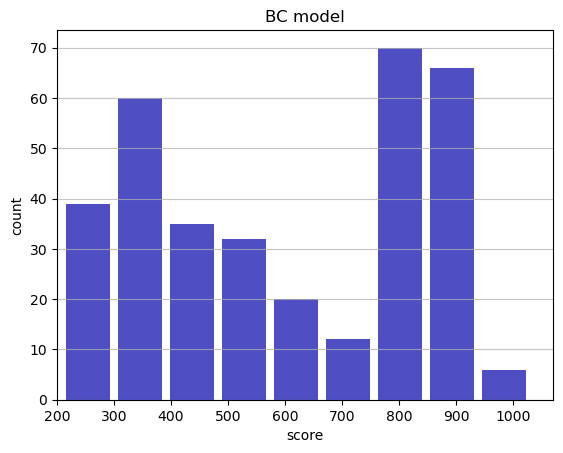

Track generation: 1049..1321 -> 272-tiles track
Epoch: 344
BC	mean: 597.45	variance: 239.24


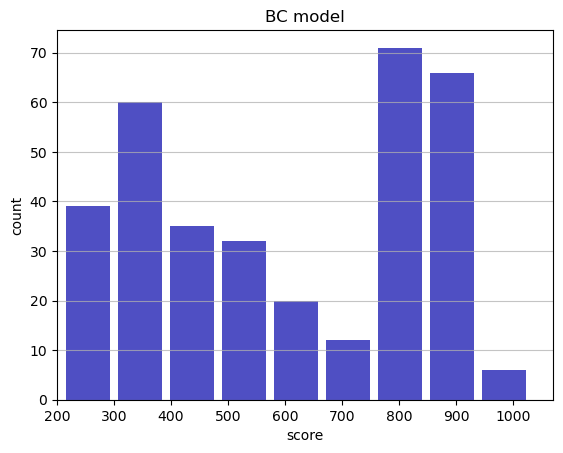

Track generation: 1359..1703 -> 344-tiles track
Epoch: 345
BC	mean: 596.58	variance: 239.44


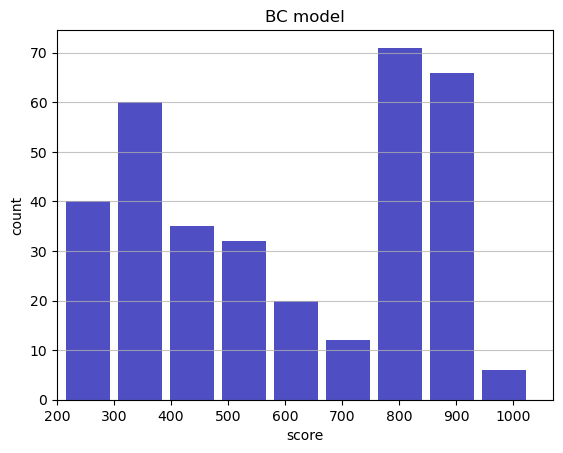

Track generation: 1076..1348 -> 272-tiles track
Epoch: 346
BC	mean: 597.34	variance: 239.51


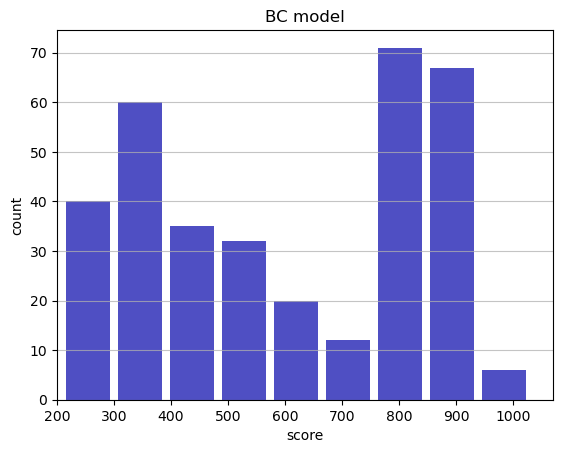

Track generation: 1045..1318 -> 273-tiles track
Epoch: 347
BC	mean: 596.80	variance: 239.38


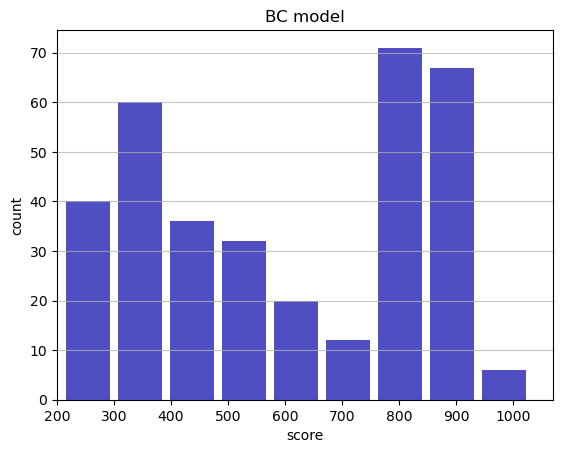

Track generation: 1121..1410 -> 289-tiles track
Epoch: 348
BC	mean: 596.09	variance: 239.39


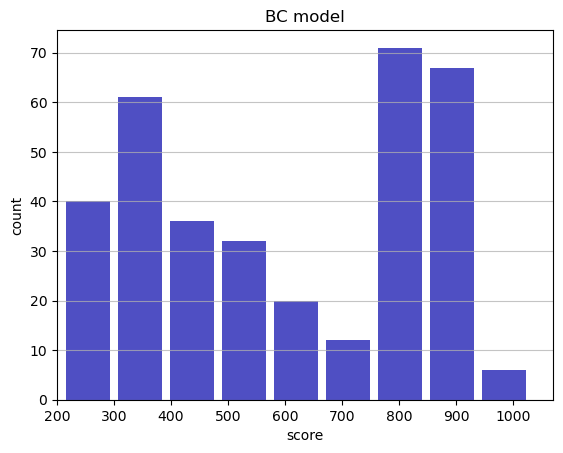

Track generation: 993..1246 -> 253-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1113..1395 -> 282-tiles track
Epoch: 349
BC	mean: 596.81	variance: 239.43


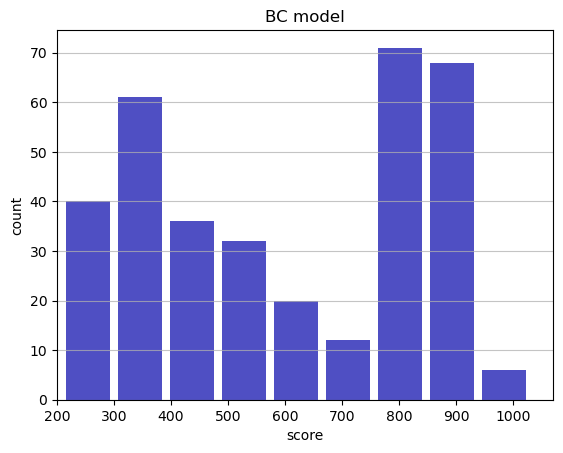

Track generation: 1130..1416 -> 286-tiles track
Epoch: 350
BC	mean: 596.12	variance: 239.44


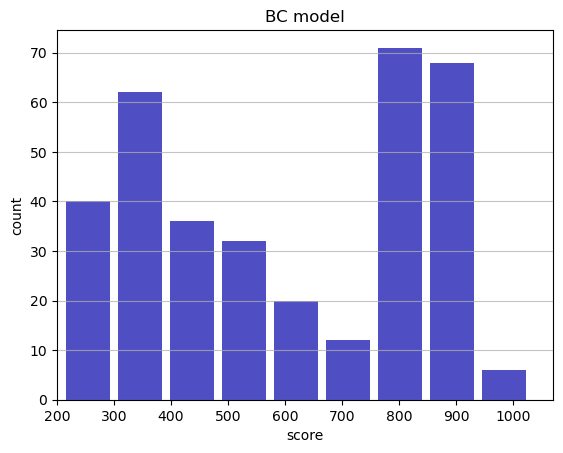

Track generation: 1131..1418 -> 287-tiles track
Epoch: 351
BC	mean: 596.93	variance: 239.58


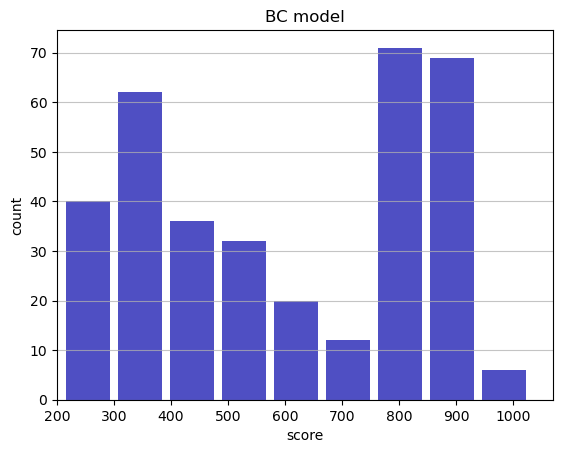

Track generation: 1170..1473 -> 303-tiles track
Epoch: 352
BC	mean: 596.06	variance: 239.78


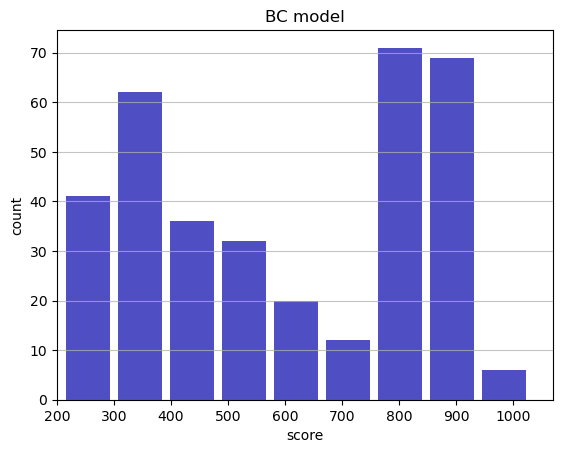

Track generation: 1145..1435 -> 290-tiles track
Epoch: 353
BC	mean: 595.11	variance: 240.11


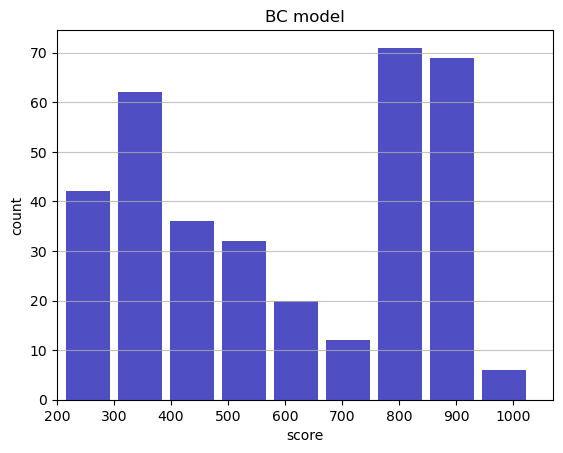

Track generation: 1139..1428 -> 289-tiles track
Epoch: 354
BC	mean: 594.59	variance: 239.97


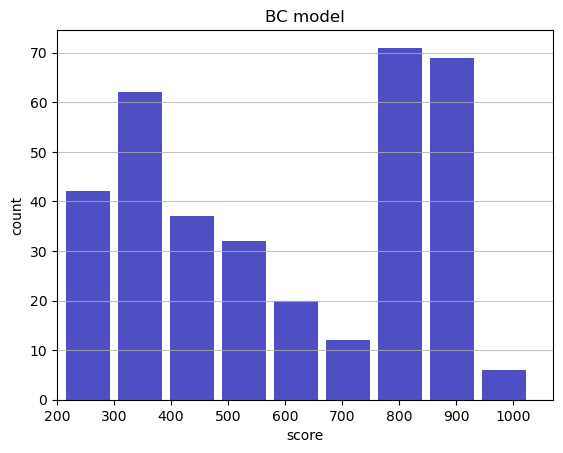

Track generation: 1250..1569 -> 319-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1108..1389 -> 281-tiles track
Epoch: 355
BC	mean: 595.35	variance: 240.05


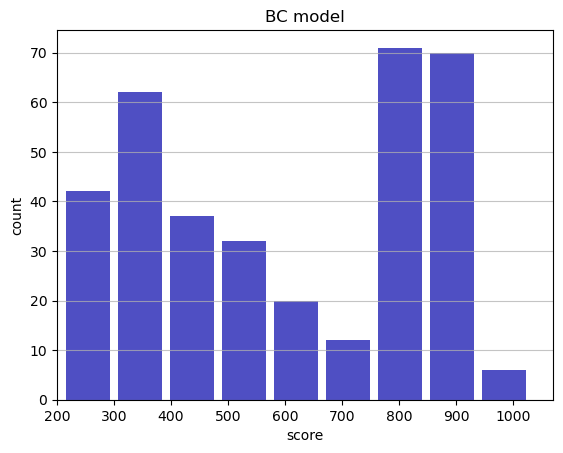

Track generation: 1271..1593 -> 322-tiles track
Epoch: 356
BC	mean: 595.32	variance: 239.72


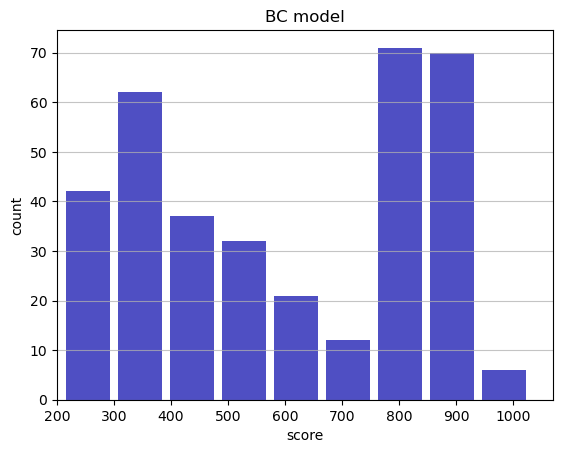

Track generation: 1147..1438 -> 291-tiles track
Epoch: 357
BC	mean: 595.12	variance: 239.41


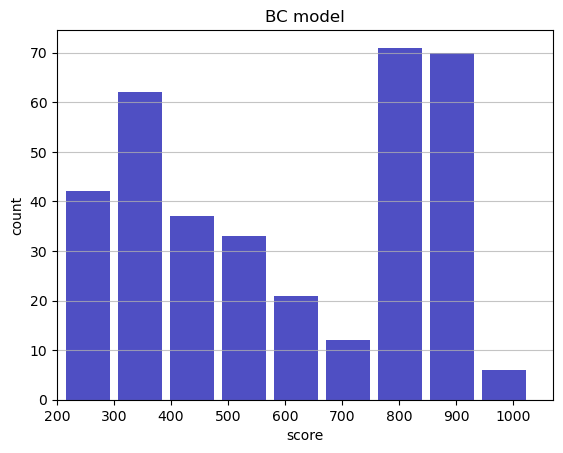

Track generation: 1167..1463 -> 296-tiles track
Epoch: 358
BC	mean: 594.23	variance: 239.66


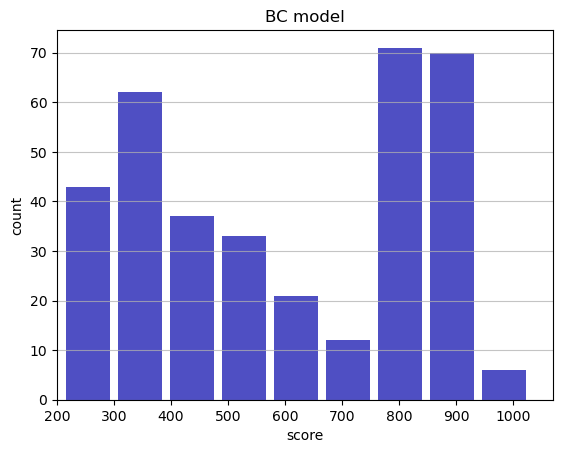

Track generation: 1200..1504 -> 304-tiles track
Epoch: 359
BC	mean: 595.02	variance: 239.78


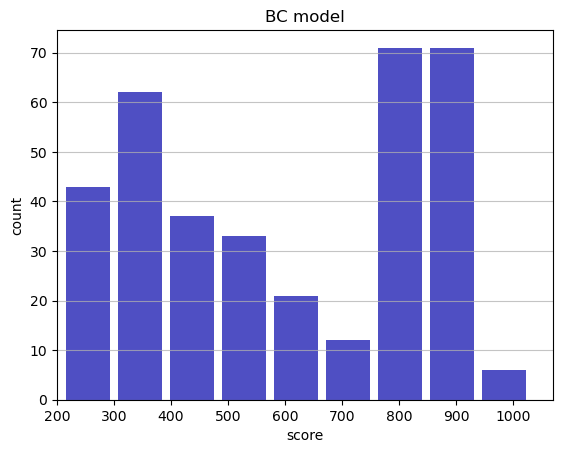

Track generation: 1202..1507 -> 305-tiles track
Epoch: 360
BC	mean: 595.77	variance: 239.87


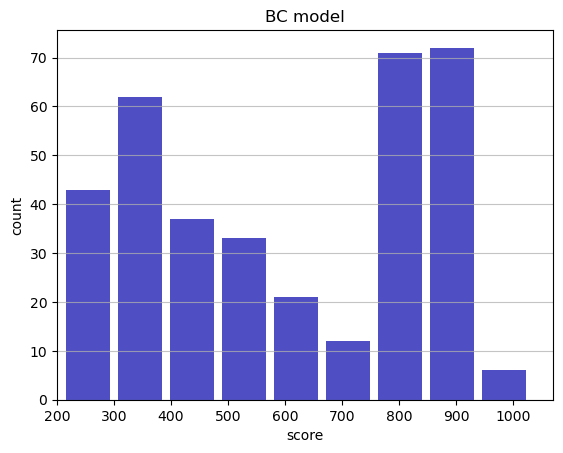

Track generation: 1259..1578 -> 319-tiles track
Epoch: 361
BC	mean: 596.31	variance: 239.76


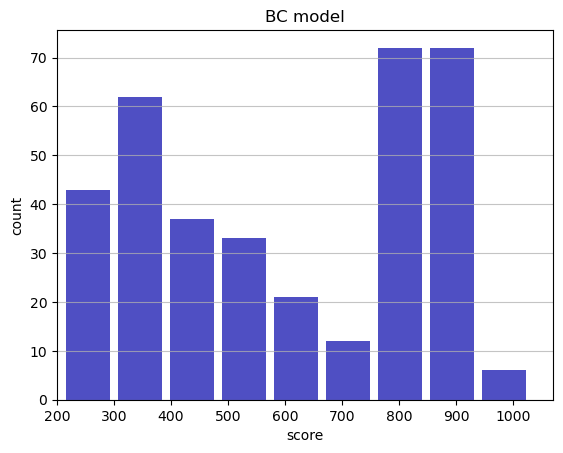

Track generation: 1204..1509 -> 305-tiles track
Epoch: 362
BC	mean: 596.57	variance: 239.48


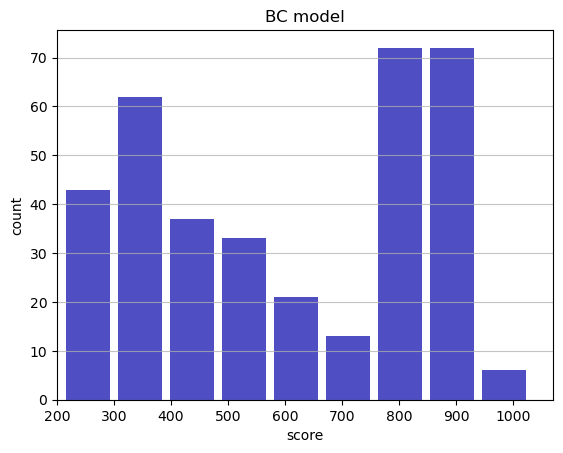

Track generation: 1007..1265 -> 258-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1119..1403 -> 284-tiles track
Epoch: 363
BC	mean: 596.41	variance: 239.17


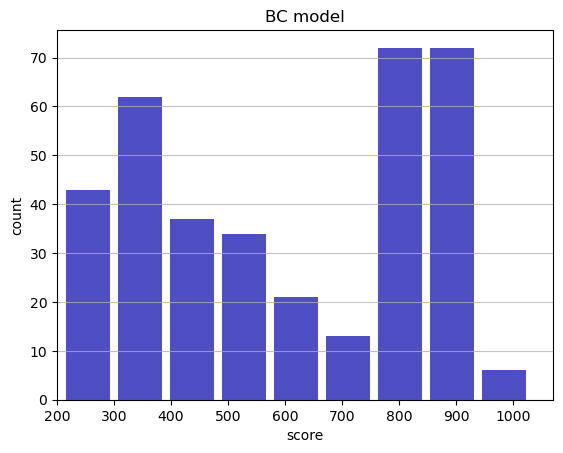

Track generation: 1192..1495 -> 303-tiles track
Epoch: 364
BC	mean: 597.16	variance: 239.26


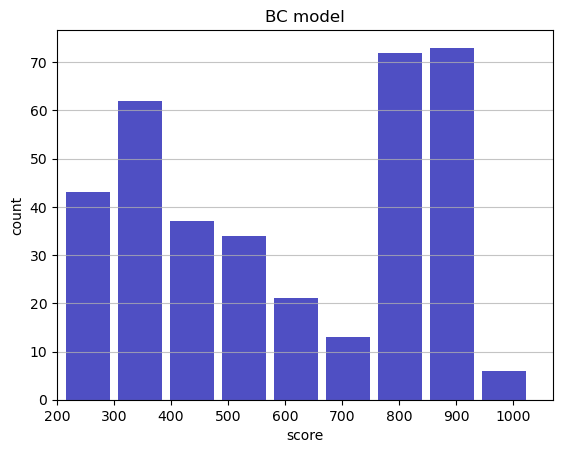

Track generation: 1421..1780 -> 359-tiles track
Epoch: 365
BC	mean: 598.03	variance: 239.51


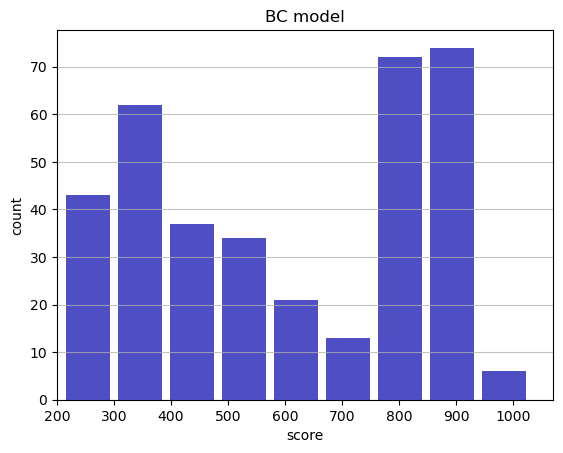

Track generation: 1051..1326 -> 275-tiles track
Epoch: 366
BC	mean: 599.05	variance: 239.97


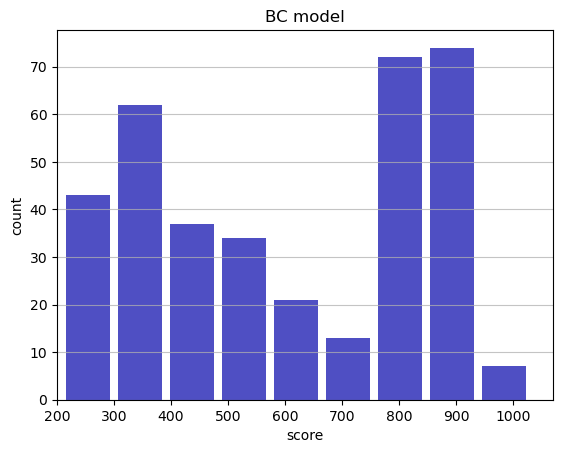

Track generation: 1194..1502 -> 308-tiles track
Epoch: 367
BC	mean: 598.06	variance: 240.39


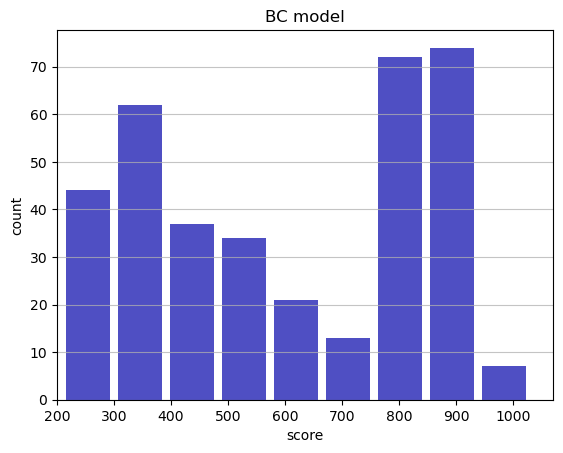

Track generation: 1168..1464 -> 296-tiles track
Epoch: 368
BC	mean: 597.29	variance: 240.52


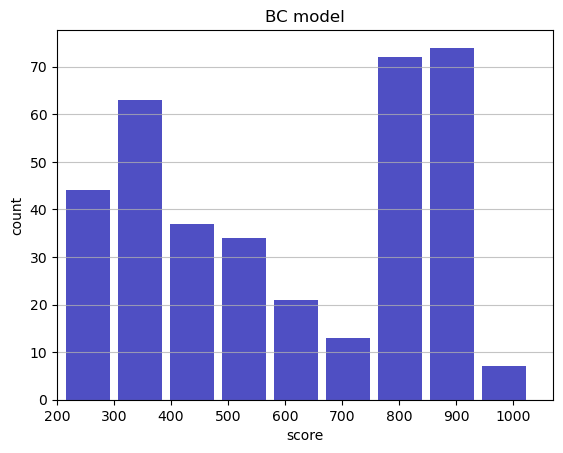

Track generation: 1139..1427 -> 288-tiles track
Epoch: 369
BC	mean: 597.96	variance: 240.54


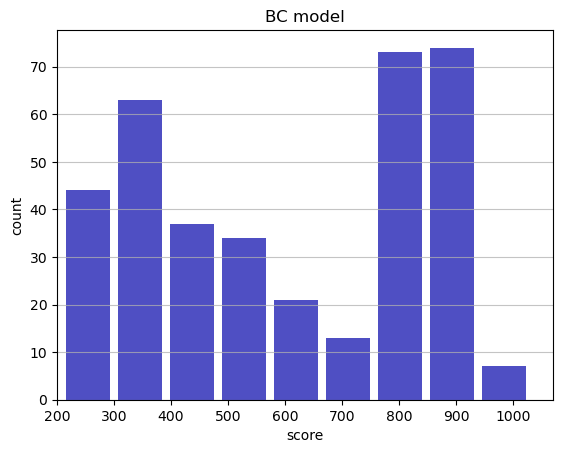

Track generation: 861..1085 -> 224-tiles track
Epoch: 370
BC	mean: 597.90	variance: 240.22


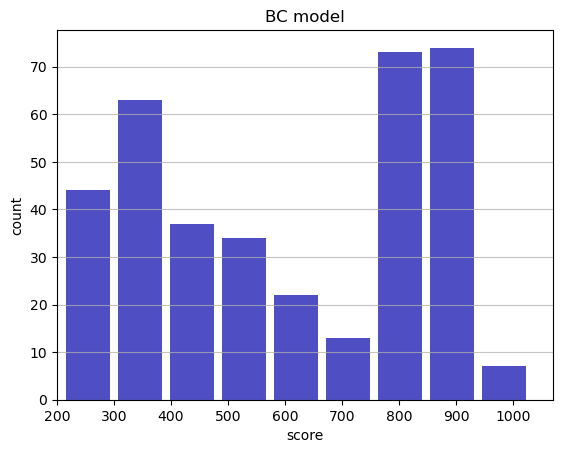

Track generation: 1167..1463 -> 296-tiles track
Epoch: 371
BC	mean: 598.55	variance: 240.22


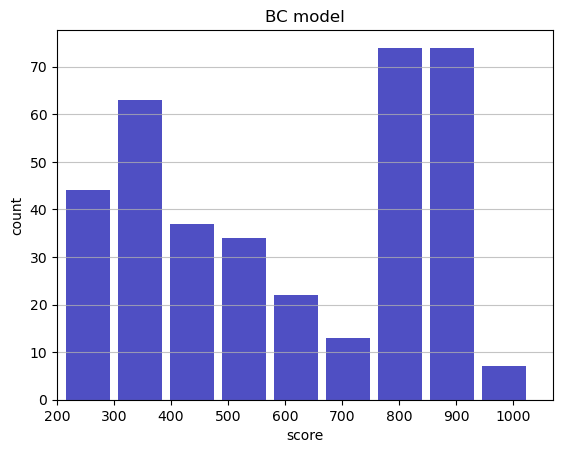

Track generation: 1167..1463 -> 296-tiles track
Epoch: 372
BC	mean: 598.47	variance: 239.90


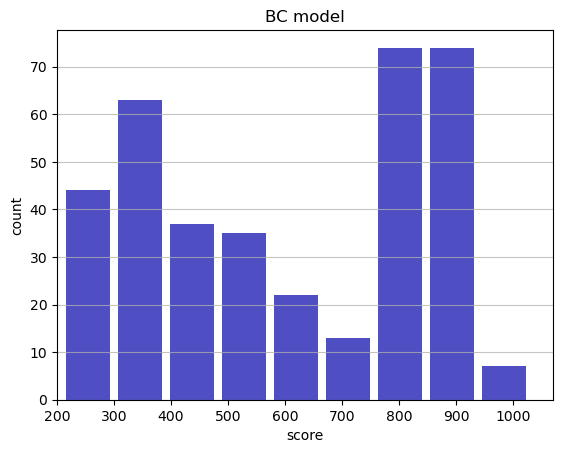

Track generation: 1191..1493 -> 302-tiles track
Epoch: 373
BC	mean: 597.55	variance: 240.23


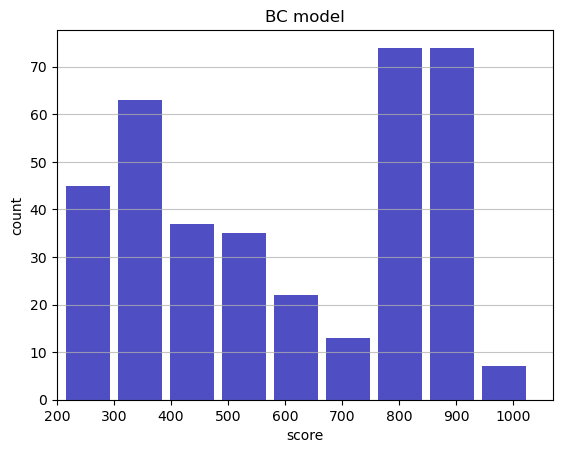

Track generation: 1076..1349 -> 273-tiles track
Epoch: 374
BC	mean: 597.95	variance: 240.03


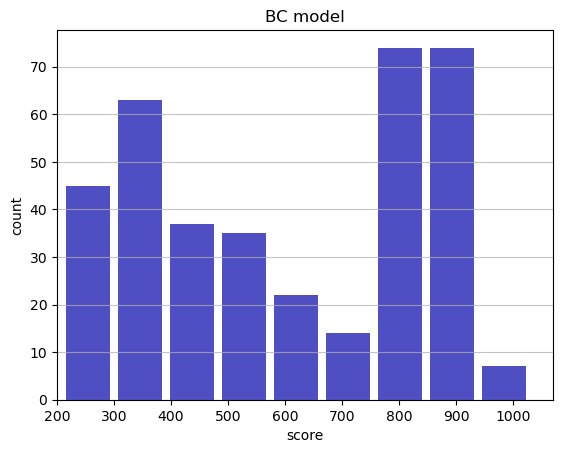

Track generation: 1220..1529 -> 309-tiles track
Epoch: 375
BC	mean: 597.22	variance: 240.14


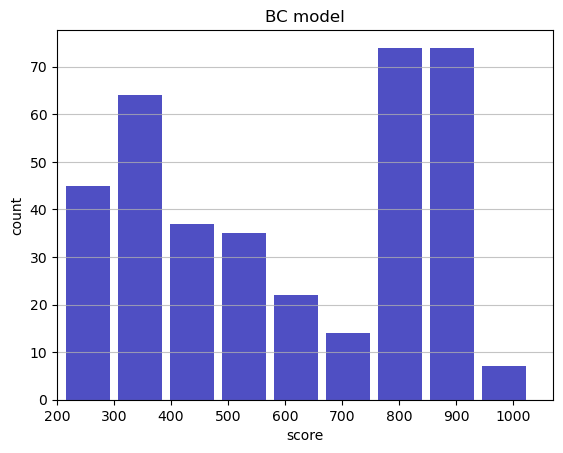

Track generation: 1219..1528 -> 309-tiles track
Epoch: 376
BC	mean: 596.29	variance: 240.49


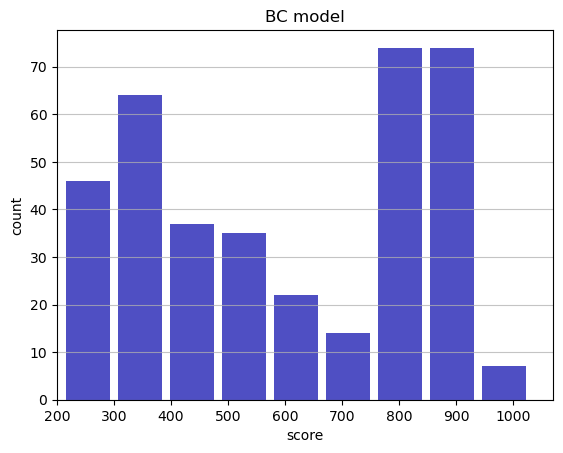

Track generation: 1255..1573 -> 318-tiles track
Epoch: 377
BC	mean: 596.93	variance: 240.48


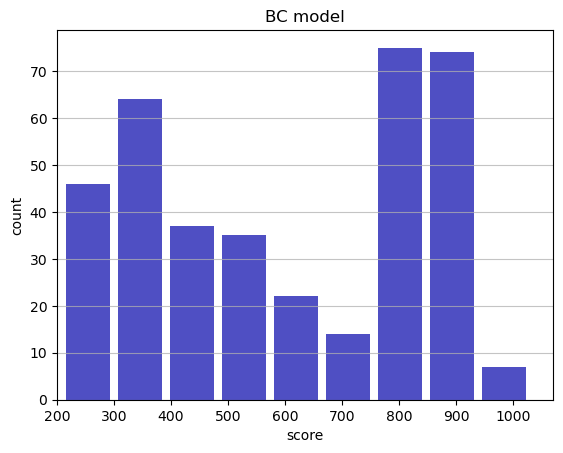

Track generation: 1022..1287 -> 265-tiles track
Epoch: 378
BC	mean: 596.67	variance: 240.22


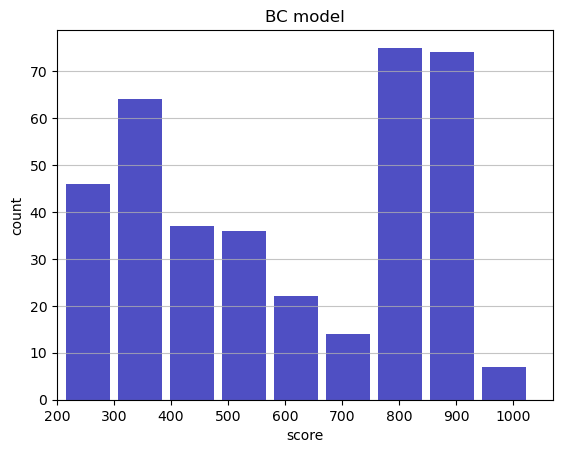

Track generation: 1224..1534 -> 310-tiles track
Epoch: 379
BC	mean: 596.10	variance: 240.16


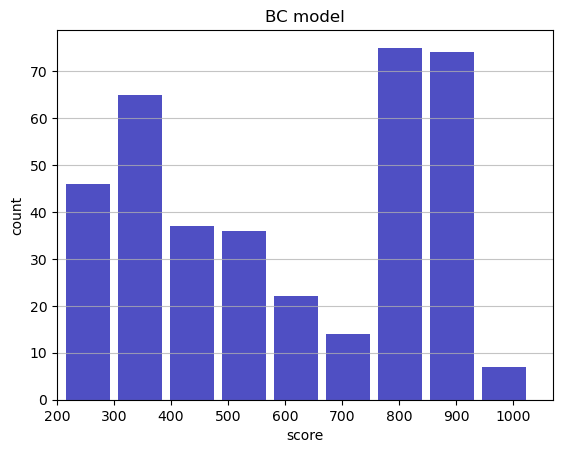

Track generation: 1180..1479 -> 299-tiles track
Epoch: 380
BC	mean: 595.29	variance: 240.35


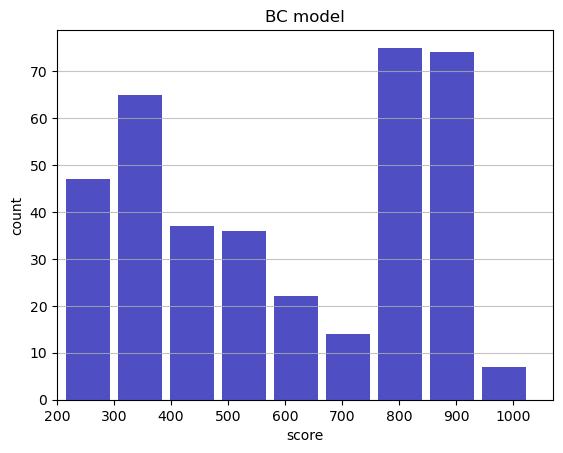

Track generation: 1133..1420 -> 287-tiles track
Epoch: 381
BC	mean: 595.70	variance: 240.17


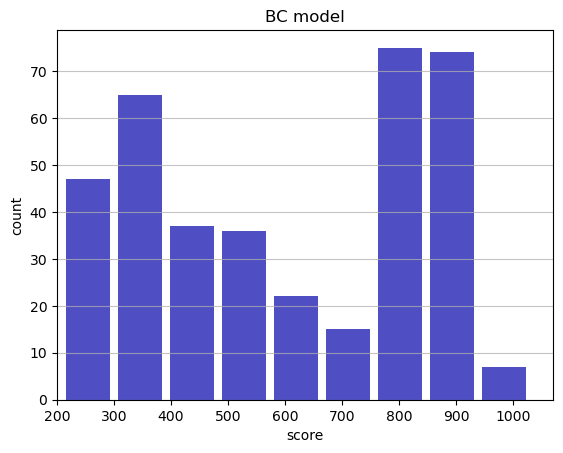

Track generation: 1051..1325 -> 274-tiles track
Epoch: 382
BC	mean: 596.80	variance: 240.81


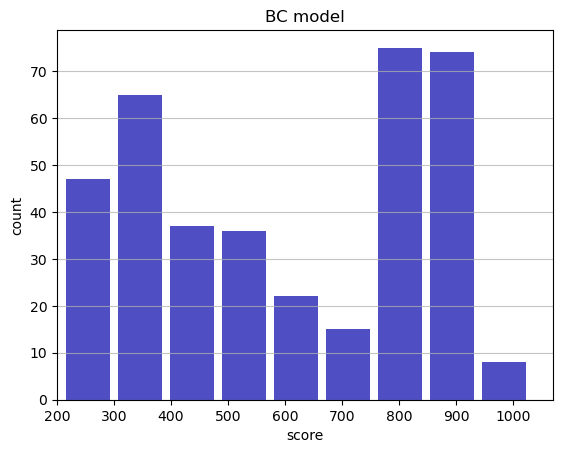

Track generation: 1175..1473 -> 298-tiles track
Epoch: 383
BC	mean: 597.47	variance: 240.85


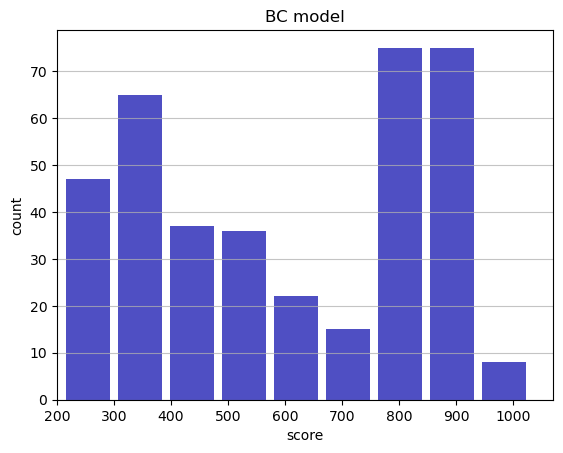

Track generation: 1063..1333 -> 270-tiles track
Epoch: 384
BC	mean: 598.11	variance: 240.86


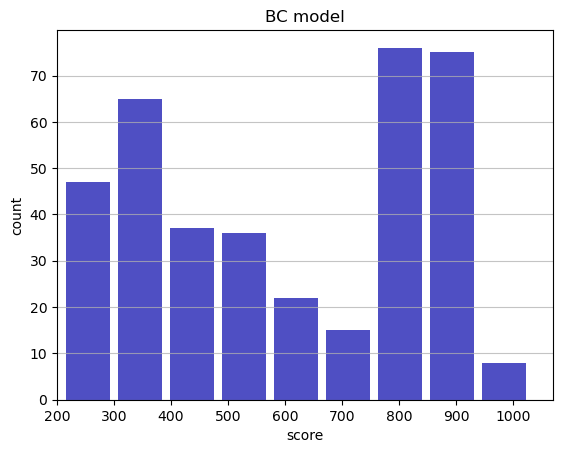

Track generation: 1245..1566 -> 321-tiles track
Epoch: 385
BC	mean: 597.33	variance: 241.03


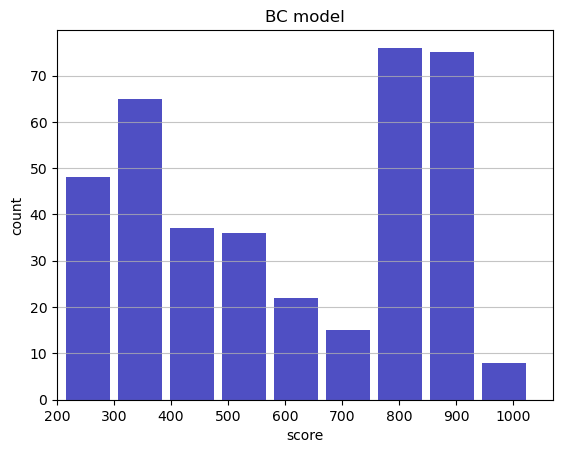

Track generation: 1129..1415 -> 286-tiles track
Epoch: 386
BC	mean: 596.81	variance: 240.93


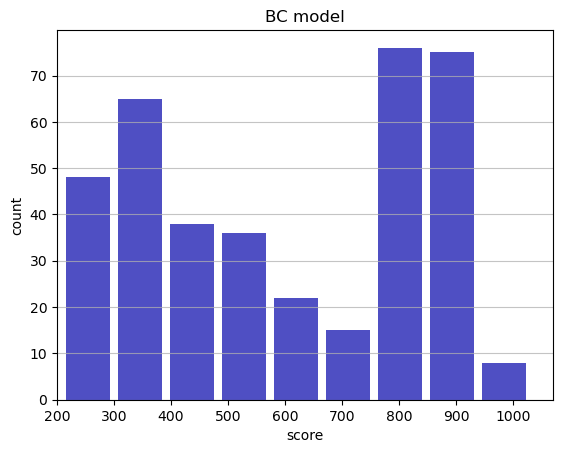

Track generation: 1243..1558 -> 315-tiles track
Epoch: 387
BC	mean: 597.07	variance: 240.67


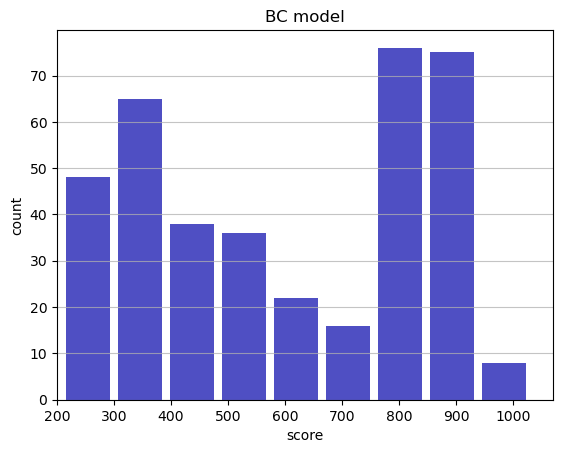

Track generation: 1240..1554 -> 314-tiles track
Epoch: 388
BC	mean: 597.04	variance: 240.36


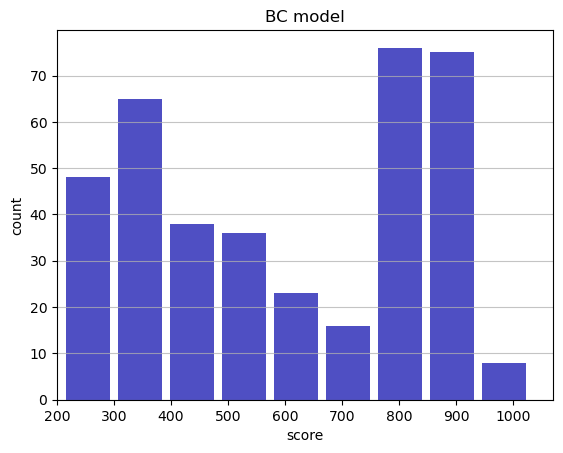

Track generation: 1108..1389 -> 281-tiles track
Epoch: 389
BC	mean: 596.89	variance: 240.07


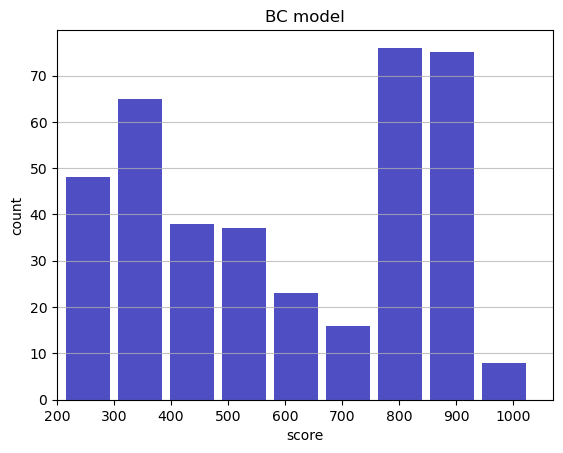

Track generation: 1116..1399 -> 283-tiles track
Epoch: 390
BC	mean: 597.34	variance: 239.92


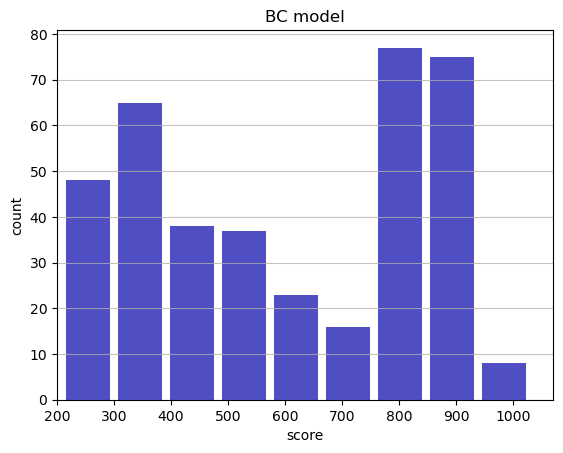

Track generation: 1063..1340 -> 277-tiles track
Epoch: 391
BC	mean: 597.48	variance: 239.63


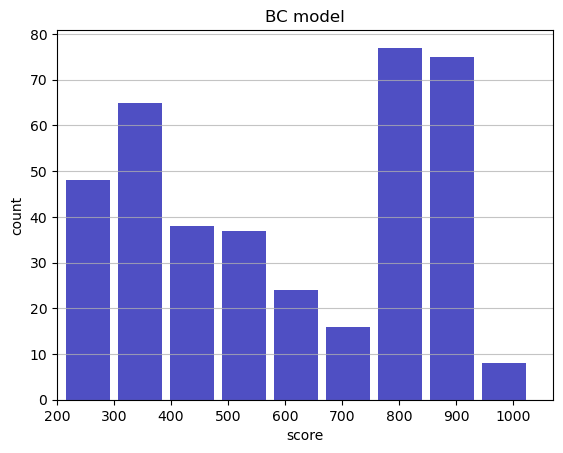

Track generation: 1300..1629 -> 329-tiles track
Epoch: 392
BC	mean: 597.06	variance: 239.47


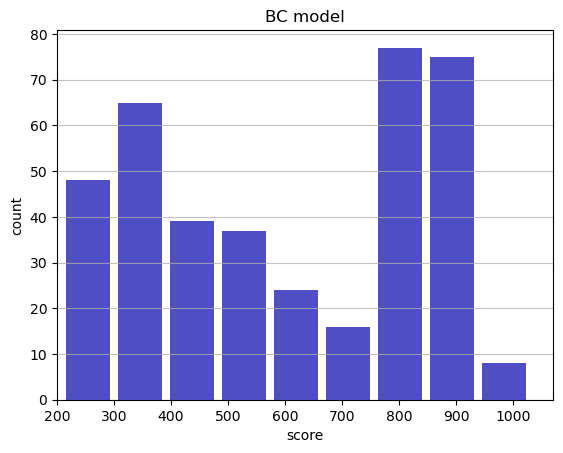

Track generation: 1149..1471 -> 322-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1197..1500 -> 303-tiles track
Epoch: 393
BC	mean: 597.71	variance: 239.51


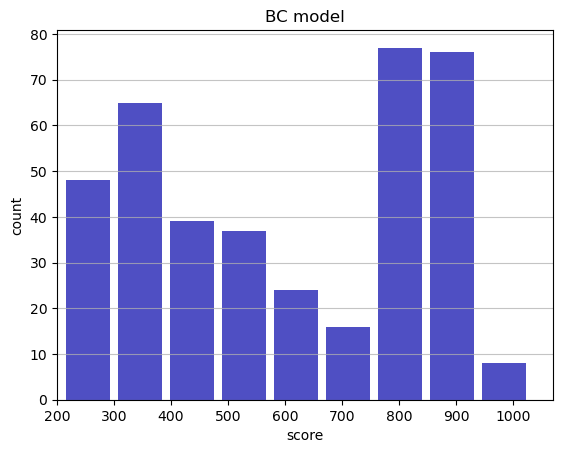

Track generation: 1160..1454 -> 294-tiles track
Epoch: 394
BC	mean: 597.14	variance: 239.47


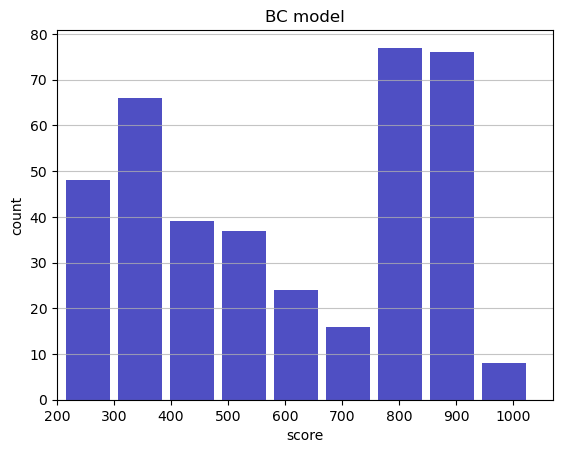

Track generation: 1415..1773 -> 358-tiles track
Epoch: 395
BC	mean: 596.15	variance: 239.97


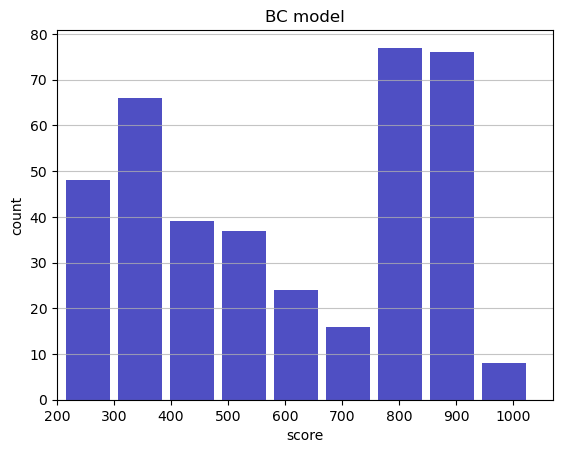

Track generation: 1083..1357 -> 274-tiles track
Epoch: 396
BC	mean: 596.81	variance: 240.04


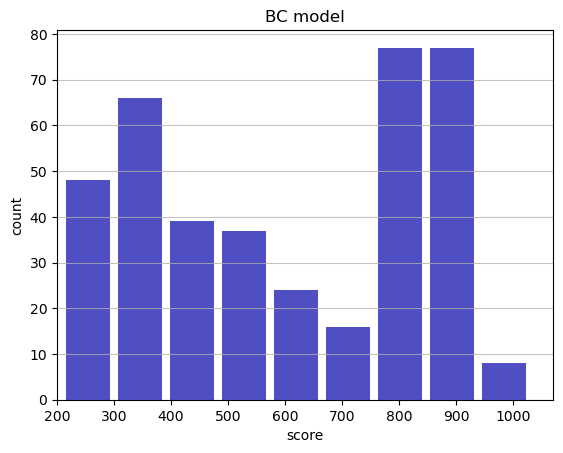

Track generation: 1174..1474 -> 300-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1027..1288 -> 261-tiles track
Epoch: 397
BC	mean: 596.15	variance: 240.10


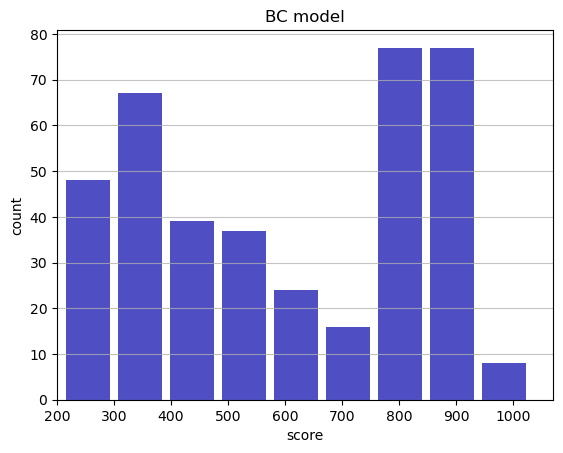

Track generation: 1224..1534 -> 310-tiles track
Epoch: 398
BC	mean: 596.72	variance: 240.06


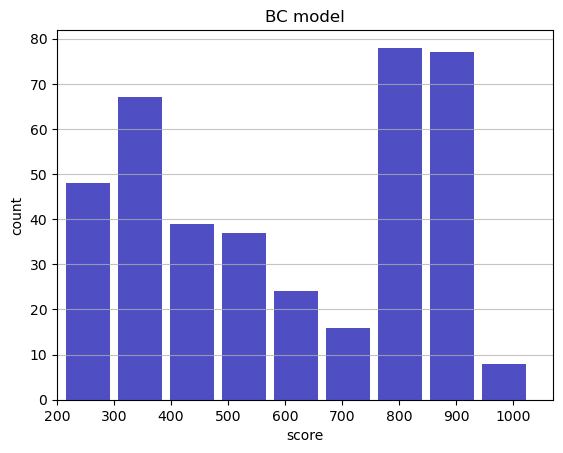

Track generation: 1076..1354 -> 278-tiles track
Epoch: 399
BC	mean: 596.20	variance: 239.98


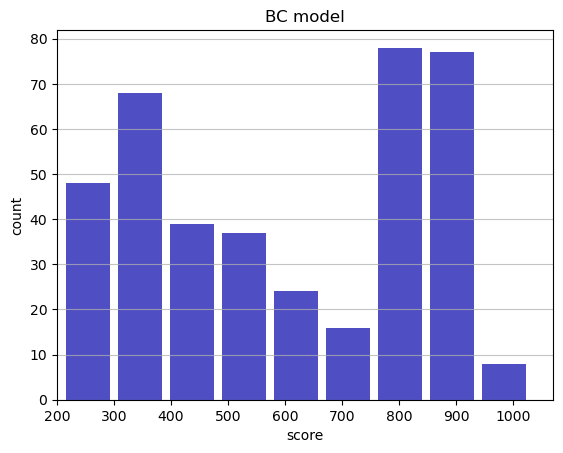

Track generation: 1096..1374 -> 278-tiles track
Epoch: 400
BC	mean: 596.79	variance: 239.97


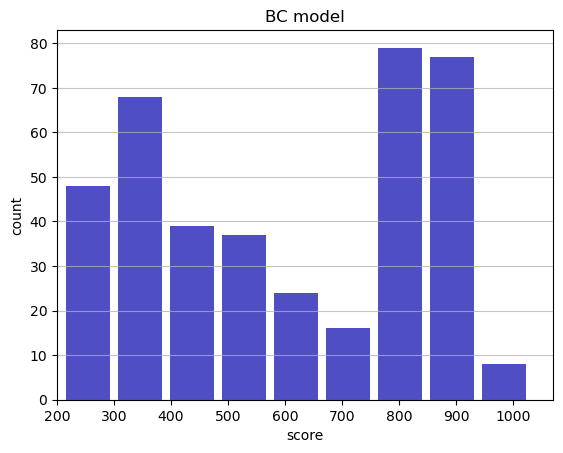

Track generation: 1192..1500 -> 308-tiles track
Epoch: 401
BC	mean: 595.61	variance: 240.85


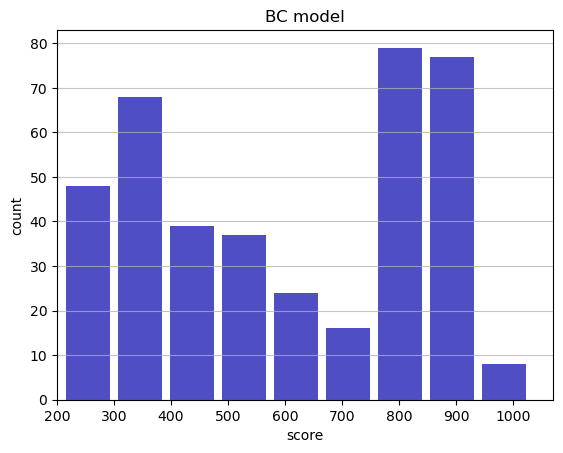

Track generation: 1116..1399 -> 283-tiles track
Epoch: 402
BC	mean: 596.18	variance: 240.82


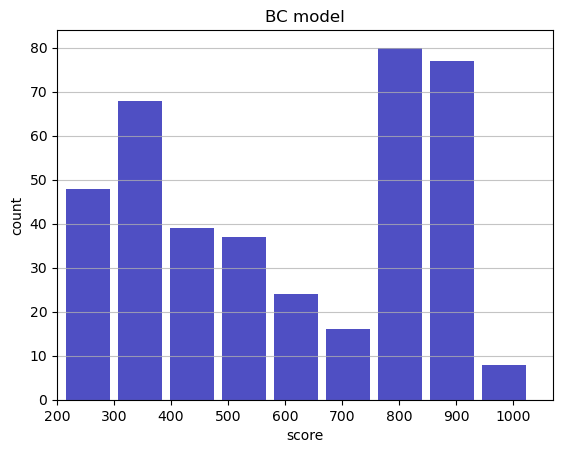

Track generation: 1187..1488 -> 301-tiles track
Epoch: 403
BC	mean: 596.36	variance: 240.55


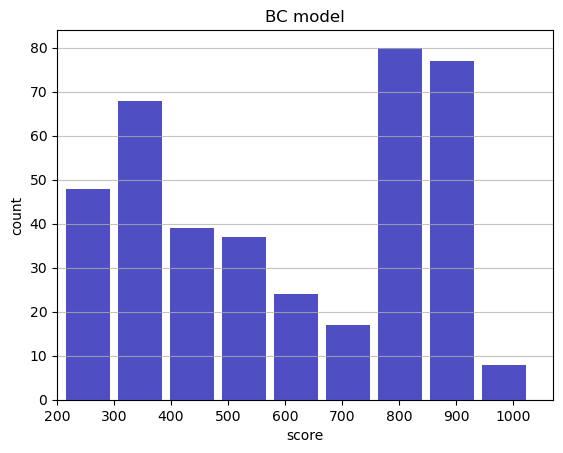

Track generation: 1232..1544 -> 312-tiles track
Epoch: 404
BC	mean: 595.55	variance: 240.81


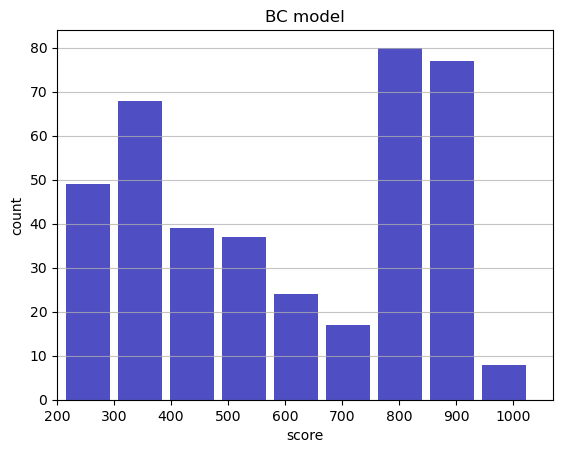

Track generation: 1184..1484 -> 300-tiles track
Epoch: 405
BC	mean: 596.29	variance: 240.97


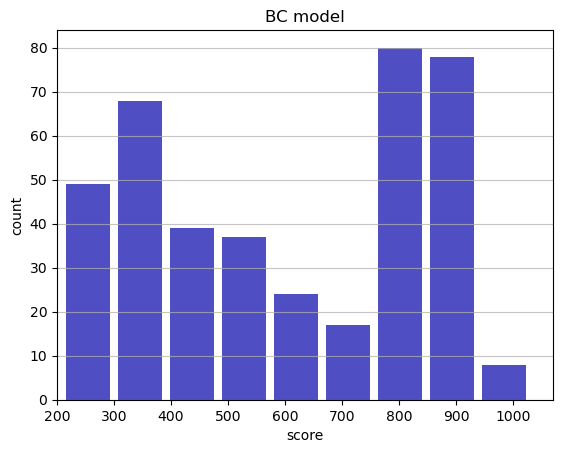

Track generation: 1080..1354 -> 274-tiles track
Epoch: 406
BC	mean: 596.94	variance: 241.03


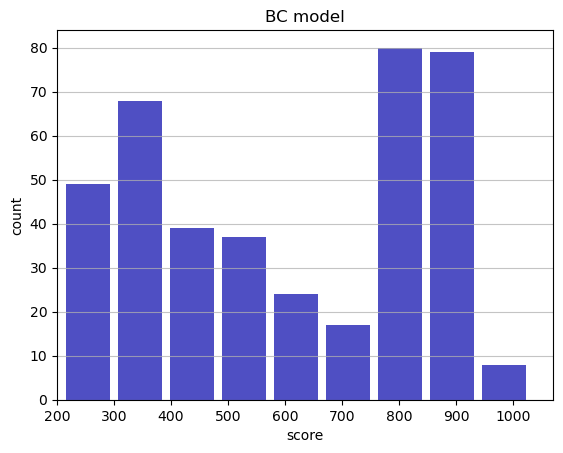

Track generation: 1350..1692 -> 342-tiles track
Epoch: 407
BC	mean: 596.24	variance: 241.14


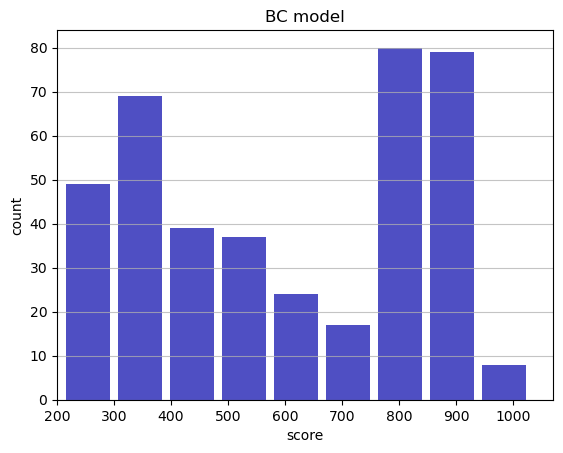

Track generation: 1341..1680 -> 339-tiles track
Epoch: 408
BC	mean: 595.88	variance: 240.95


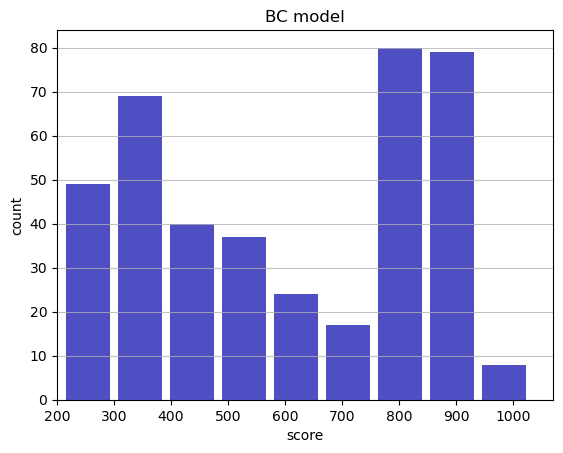

Track generation: 1027..1288 -> 261-tiles track
Epoch: 409
BC	mean: 596.54	variance: 241.03


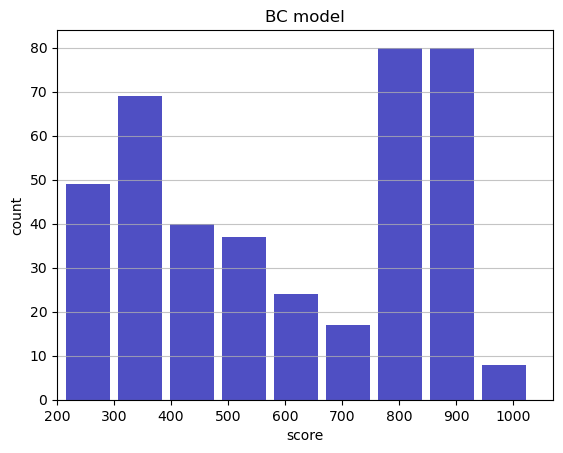

Track generation: 1253..1570 -> 317-tiles track
Epoch: 410
BC	mean: 597.12	variance: 241.01


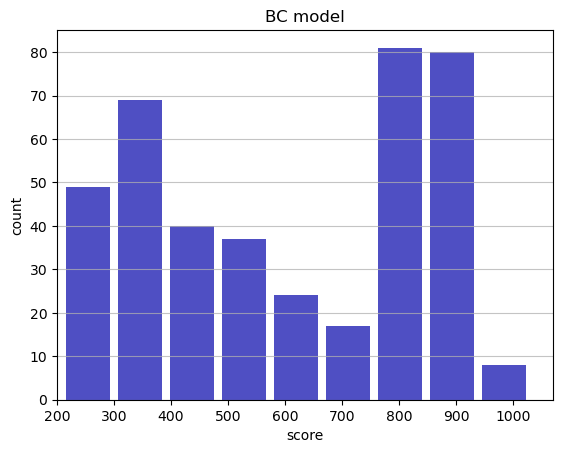

Track generation: 1007..1269 -> 262-tiles track
Epoch: 411
BC	mean: 597.85	variance: 241.18


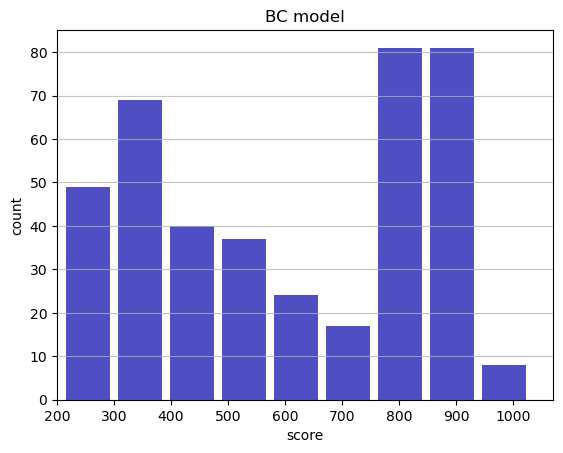

Track generation: 1088..1364 -> 276-tiles track
Epoch: 412
BC	mean: 597.38	variance: 241.08


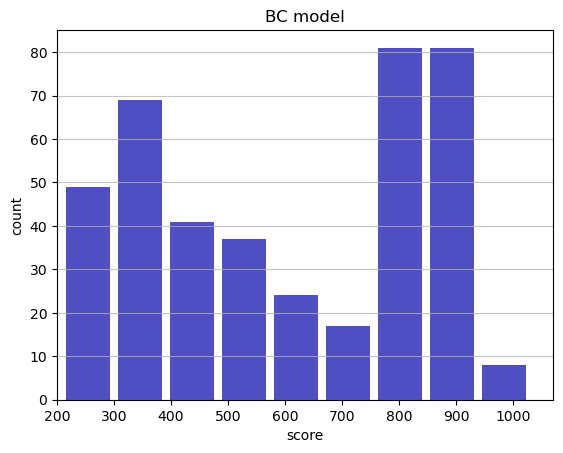

Track generation: 944..1192 -> 248-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1056..1327 -> 271-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1076..1349 -> 273-tiles track
Epoch: 413
BC	mean: 597.19	variance: 240.82


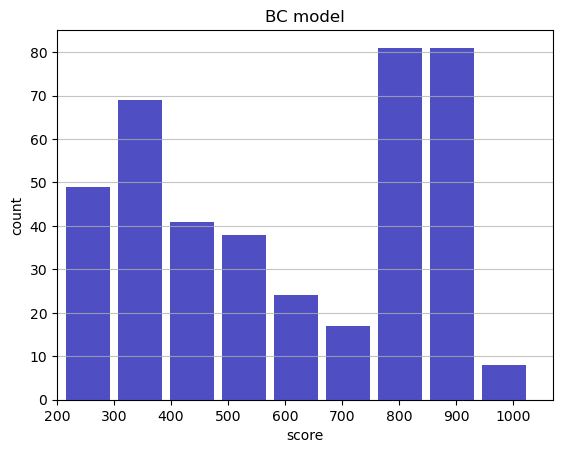

Track generation: 1188..1489 -> 301-tiles track
Epoch: 414
BC	mean: 597.82	variance: 240.87


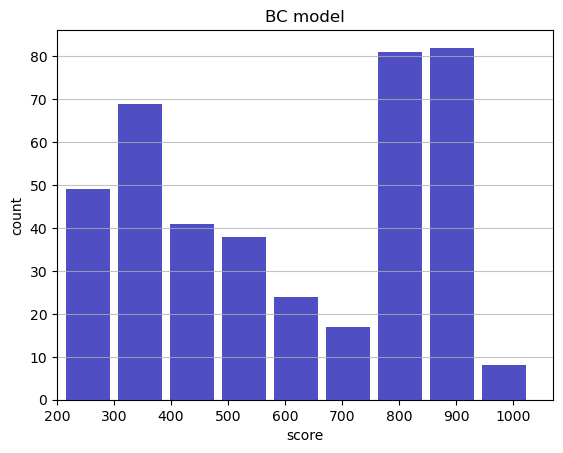

Track generation: 1148..1439 -> 291-tiles track
Epoch: 415
BC	mean: 597.24	variance: 240.86


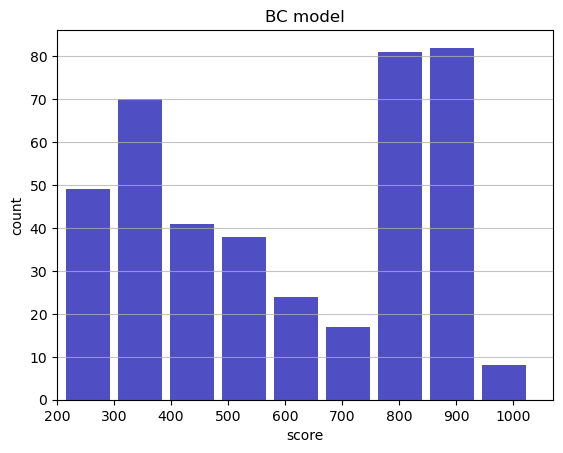

Track generation: 1092..1369 -> 277-tiles track
Epoch: 416
BC	mean: 597.18	variance: 240.58


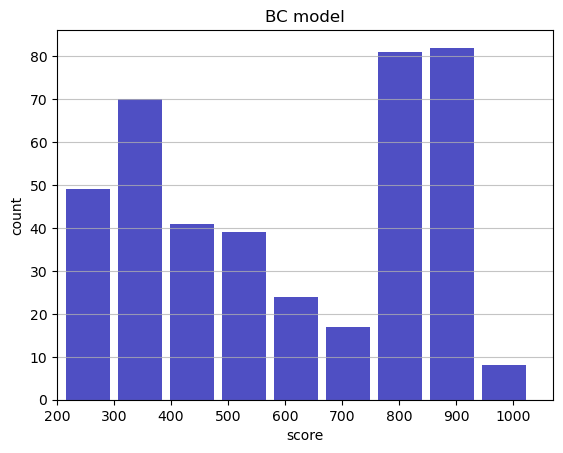

Track generation: 1162..1463 -> 301-tiles track
Epoch: 417
BC	mean: 596.40	variance: 240.81


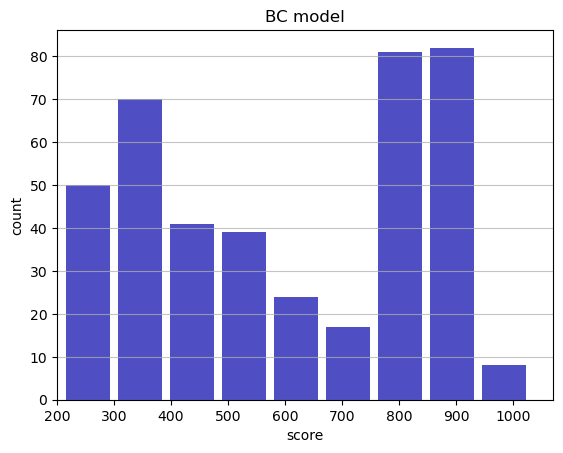

Track generation: 1156..1449 -> 293-tiles track
Epoch: 418
BC	mean: 596.99	variance: 240.83


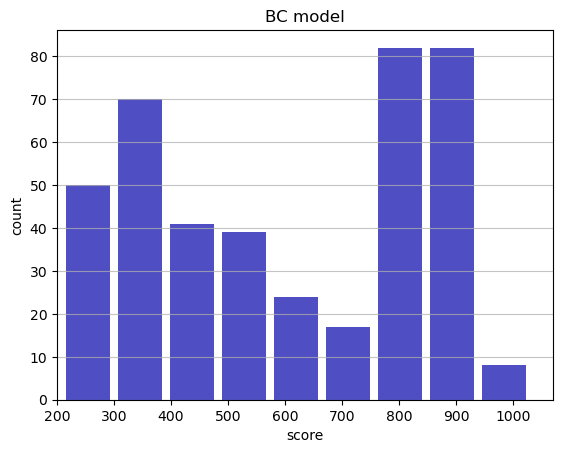

Track generation: 1028..1289 -> 261-tiles track
Epoch: 419
BC	mean: 596.29	variance: 240.97


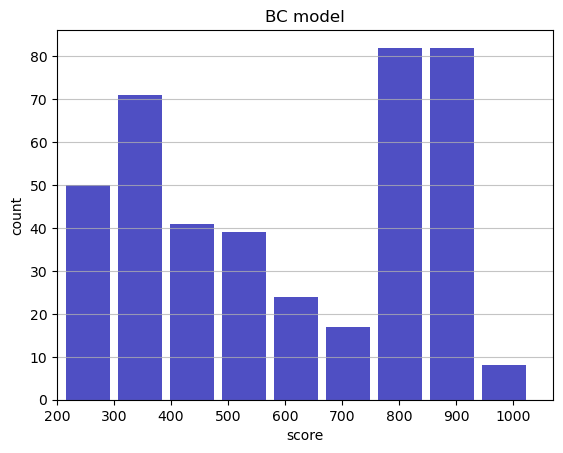

Track generation: 1188..1489 -> 301-tiles track
Epoch: 420
BC	mean: 595.56	variance: 241.15


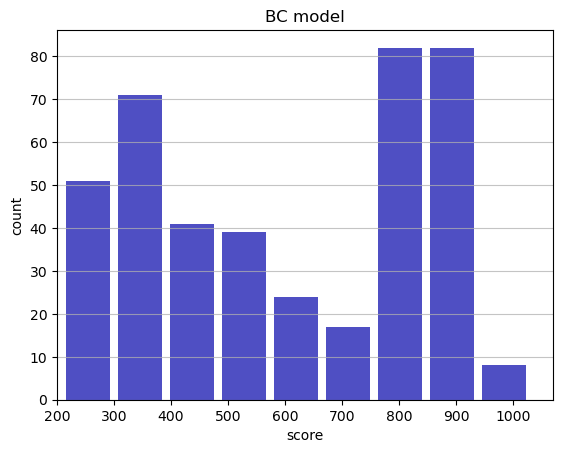

Track generation: 1267..1588 -> 321-tiles track
Epoch: 421
BC	mean: 595.86	variance: 240.94


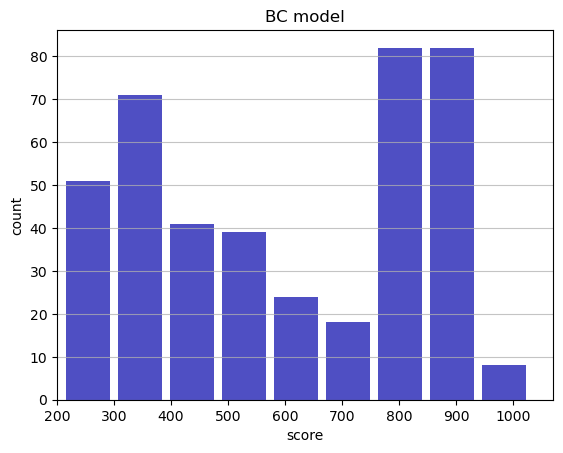

Track generation: 1210..1517 -> 307-tiles track
Epoch: 422
BC	mean: 595.26	variance: 240.96


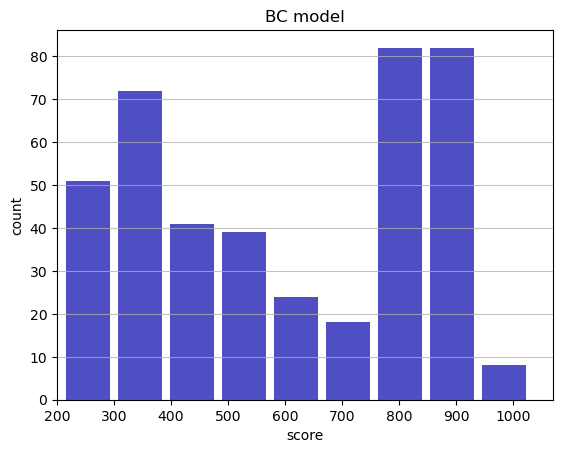

Track generation: 1128..1414 -> 286-tiles track
Epoch: 423
BC	mean: 594.65	variance: 241.01


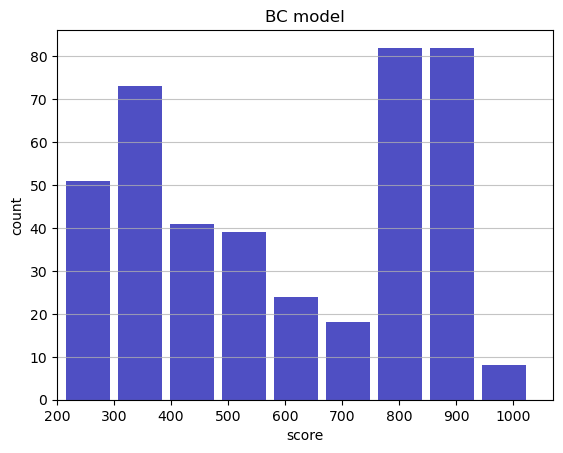

Track generation: 1141..1430 -> 289-tiles track
Epoch: 424
BC	mean: 595.34	variance: 241.14


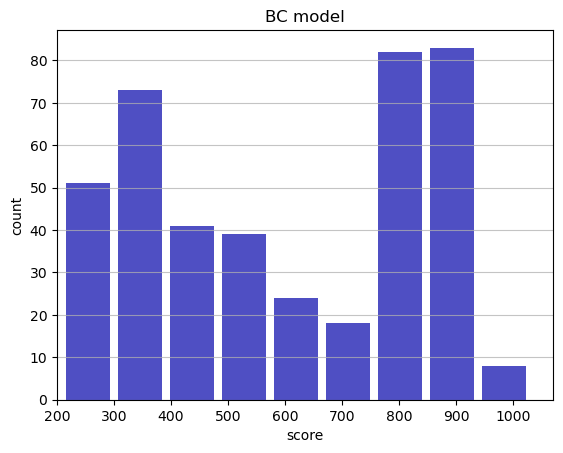

Track generation: 1203..1508 -> 305-tiles track
Epoch: 425
BC	mean: 595.92	variance: 241.16


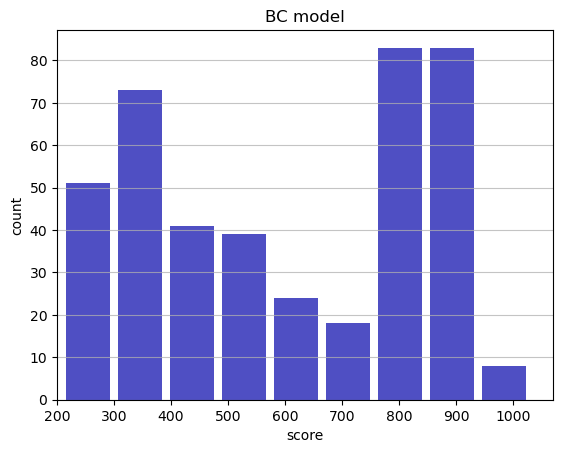

Track generation: 1138..1427 -> 289-tiles track
Epoch: 426
BC	mean: 595.94	variance: 240.88


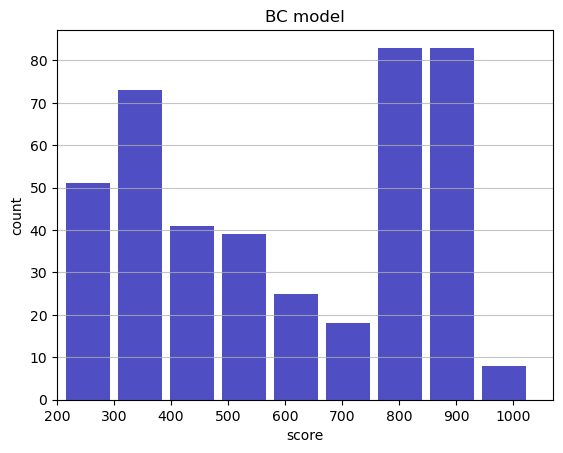

Track generation: 1151..1443 -> 292-tiles track
Epoch: 427
BC	mean: 596.54	variance: 240.91


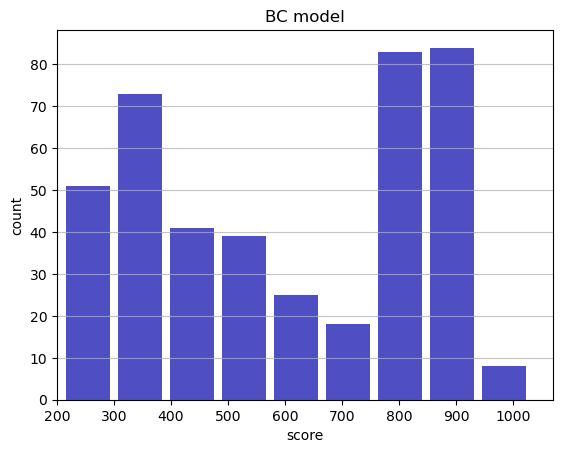

Track generation: 1140..1429 -> 289-tiles track
Epoch: 428
BC	mean: 596.02	variance: 240.86


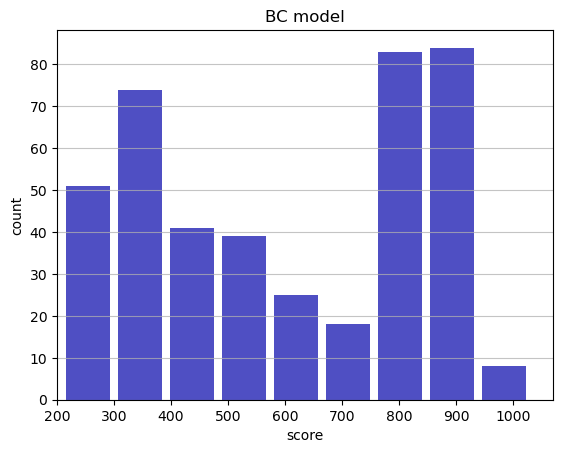

Track generation: 1084..1359 -> 275-tiles track
Epoch: 429
BC	mean: 596.55	variance: 240.83


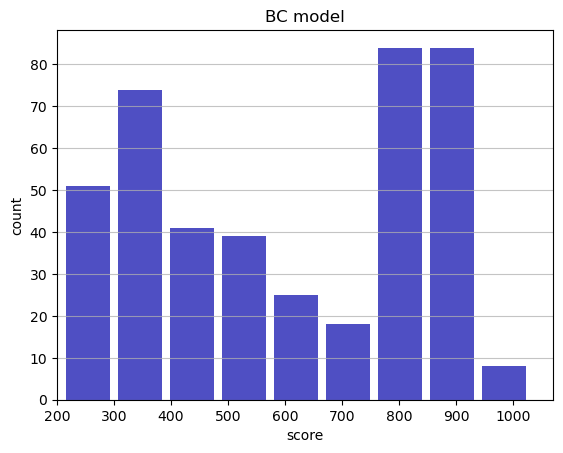

Track generation: 1228..1539 -> 311-tiles track
Epoch: 430
BC	mean: 595.98	variance: 240.84


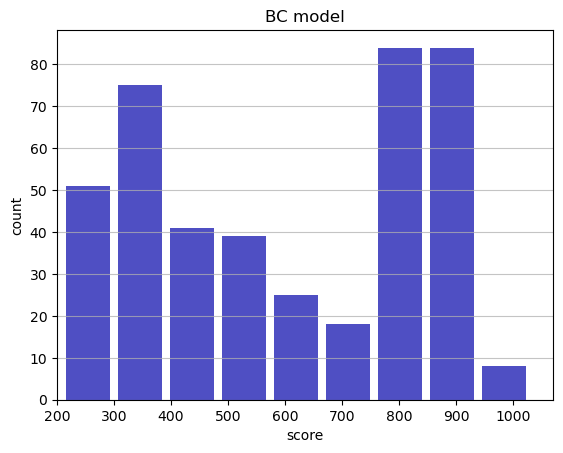

Track generation: 1098..1376 -> 278-tiles track
Epoch: 431
BC	mean: 596.55	variance: 240.84


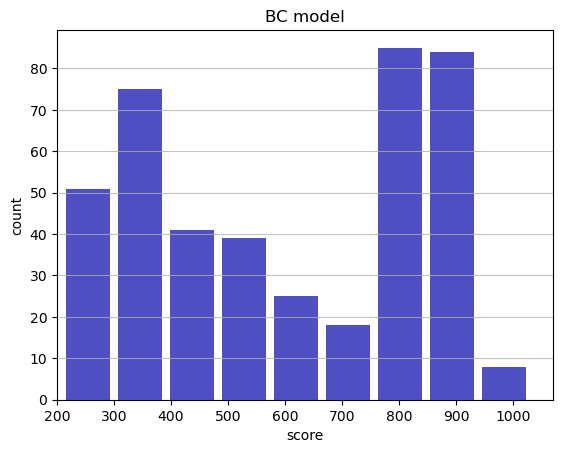

Track generation: 1156..1442 -> 286-tiles track
Epoch: 432
BC	mean: 597.05	variance: 240.79


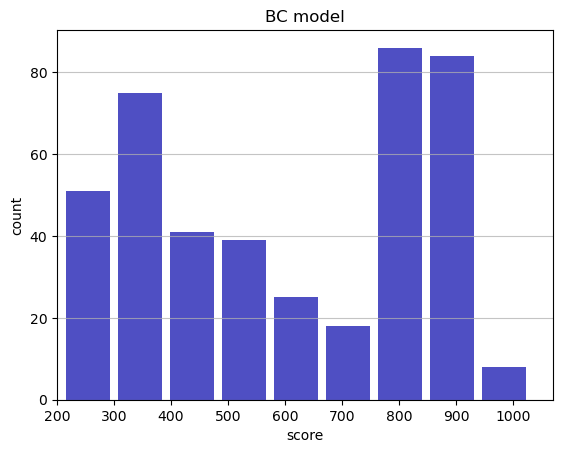

Track generation: 1021..1283 -> 262-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1209..1516 -> 307-tiles track
Epoch: 433
BC	mean: 596.43	variance: 240.86


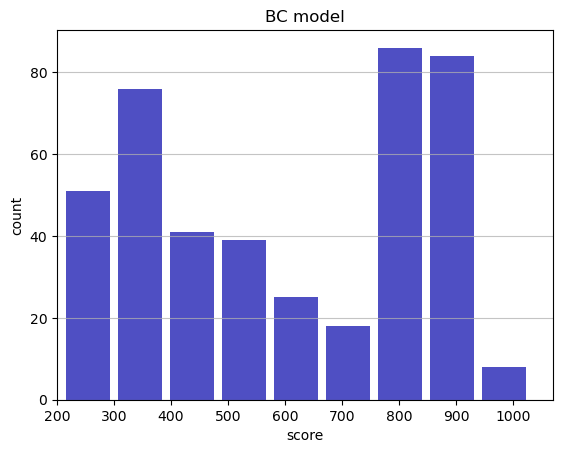

Track generation: 1052..1326 -> 274-tiles track
Epoch: 434
BC	mean: 596.46	variance: 240.58


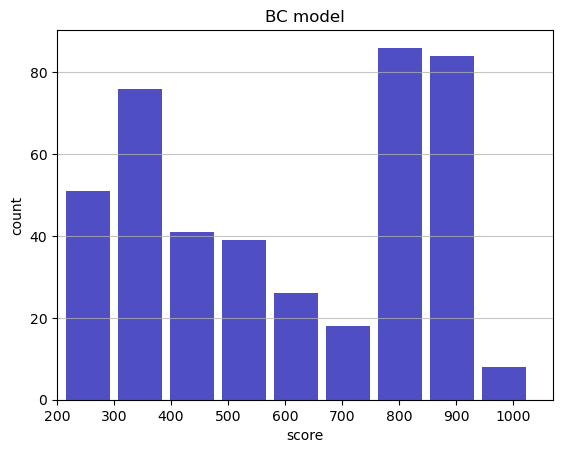

Track generation: 1223..1533 -> 310-tiles track
Epoch: 435
BC	mean: 596.90	variance: 240.48


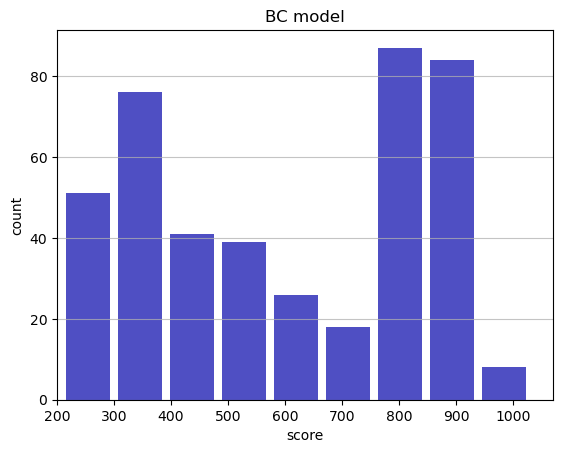

Track generation: 1039..1311 -> 272-tiles track
Epoch: 436
BC	mean: 596.12	variance: 240.75


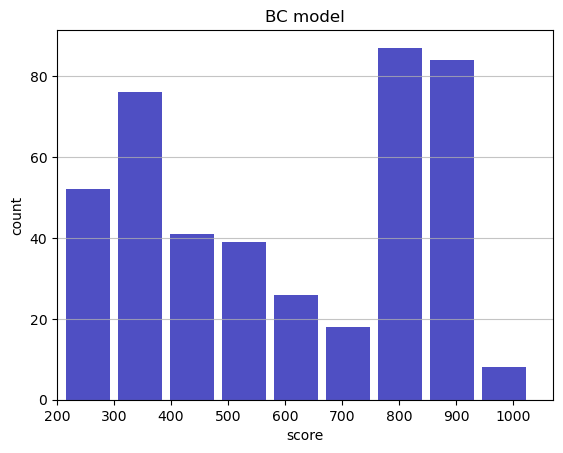

Track generation: 1123..1408 -> 285-tiles track
Epoch: 437
BC	mean: 596.64	variance: 240.73


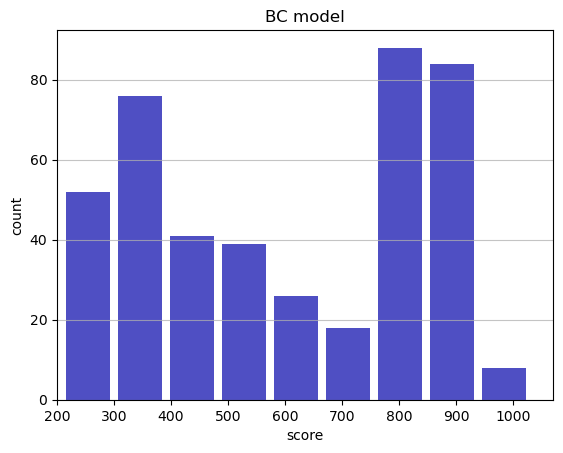

Track generation: 1196..1499 -> 303-tiles track
Epoch: 438
BC	mean: 596.03	variance: 240.79


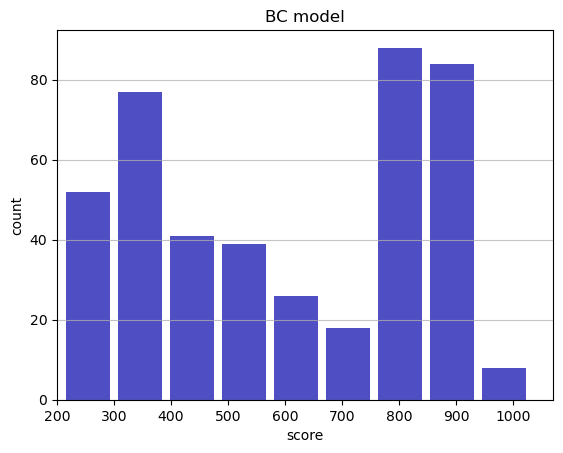

Track generation: 1182..1482 -> 300-tiles track
Epoch: 439
BC	mean: 596.59	variance: 240.80


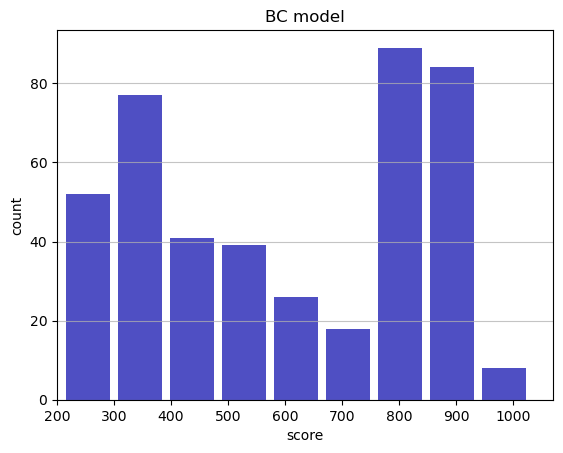

Track generation: 1256..1573 -> 317-tiles track
Epoch: 440
BC	mean: 595.93	variance: 240.93


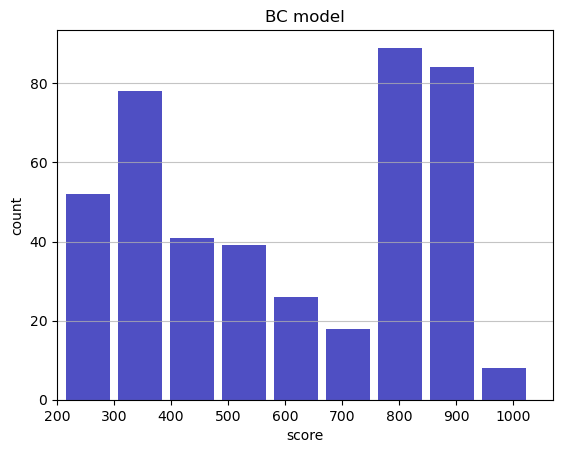

Track generation: 1299..1628 -> 329-tiles track
Epoch: 441
BC	mean: 595.56	variance: 240.77


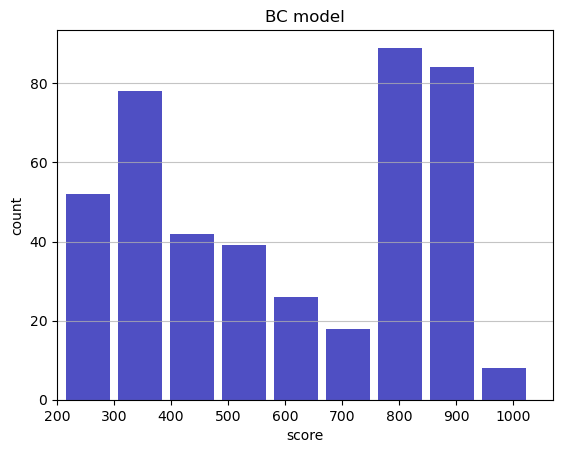

Track generation: 1131..1424 -> 293-tiles track
Epoch: 442
BC	mean: 594.89	variance: 240.91


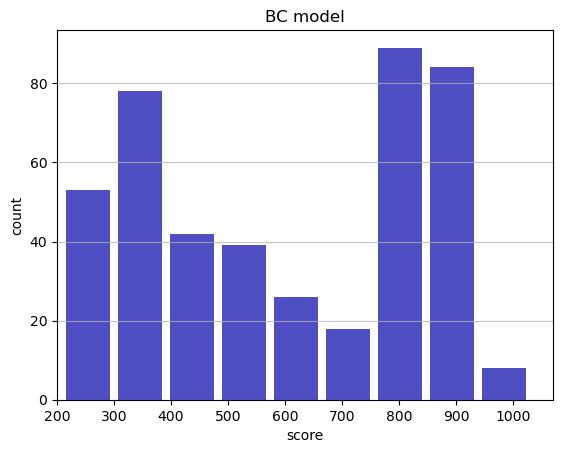

Track generation: 1152..1444 -> 292-tiles track
Epoch: 443
BC	mean: 594.39	variance: 240.88


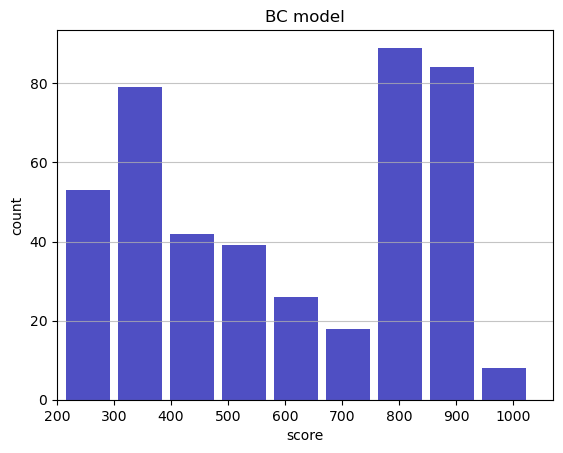

Track generation: 1083..1358 -> 275-tiles track
Epoch: 444
BC	mean: 595.04	variance: 241.00


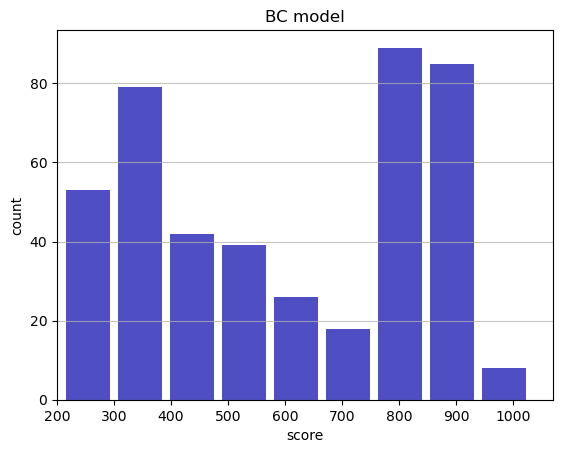

Track generation: 1121..1415 -> 294-tiles track
Epoch: 445
BC	mean: 595.63	variance: 241.04


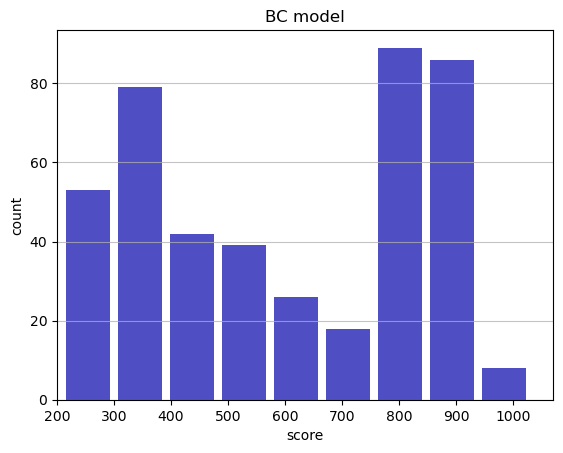

Track generation: 1302..1632 -> 330-tiles track
Epoch: 446
BC	mean: 596.44	variance: 241.38


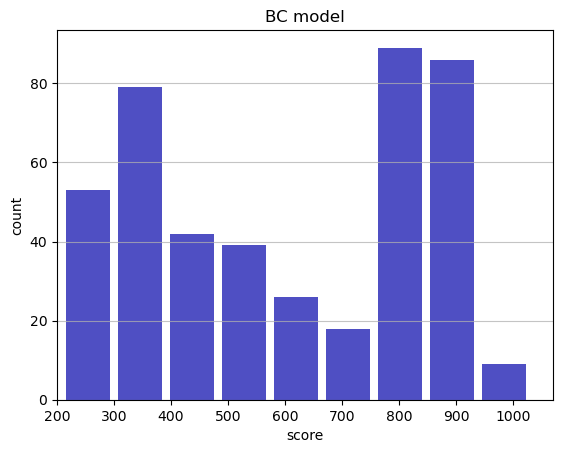

Track generation: 1295..1623 -> 328-tiles track
Epoch: 447
BC	mean: 595.72	variance: 241.58


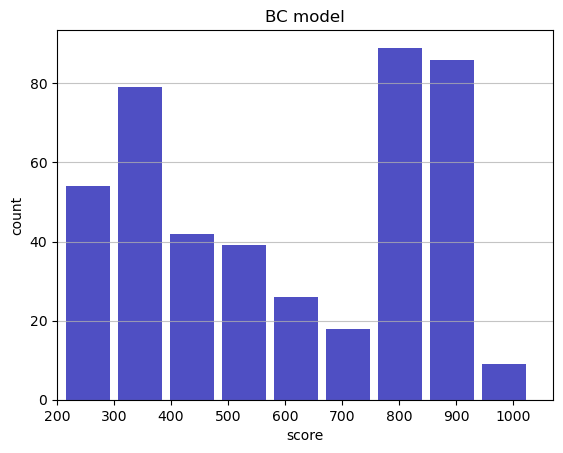

Track generation: 1428..1789 -> 361-tiles track
Epoch: 448
BC	mean: 596.23	variance: 241.55


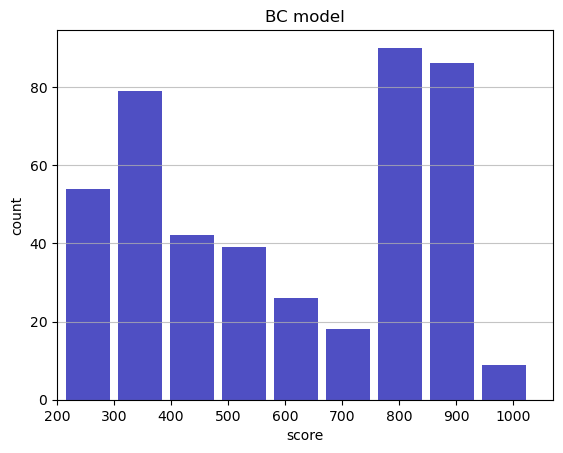

Track generation: 1127..1413 -> 286-tiles track
Epoch: 449
BC	mean: 596.84	variance: 241.63


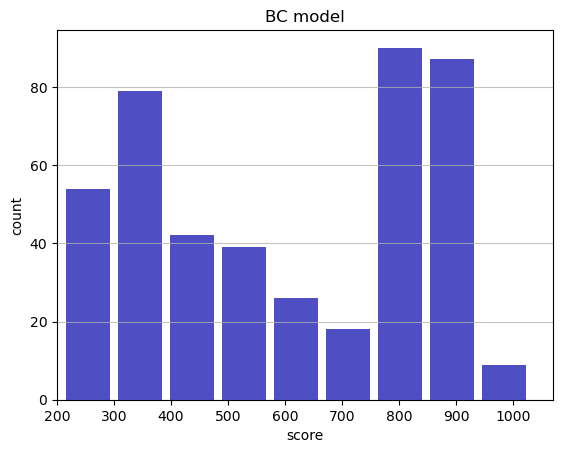

Track generation: 1183..1483 -> 300-tiles track
Epoch: 450
BC	mean: 596.93	variance: 241.37


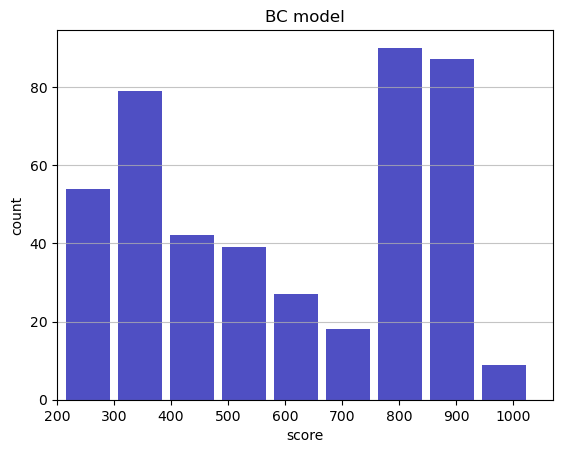

Track generation: 1027..1297 -> 270-tiles track
Epoch: 451
BC	mean: 596.79	variance: 241.12


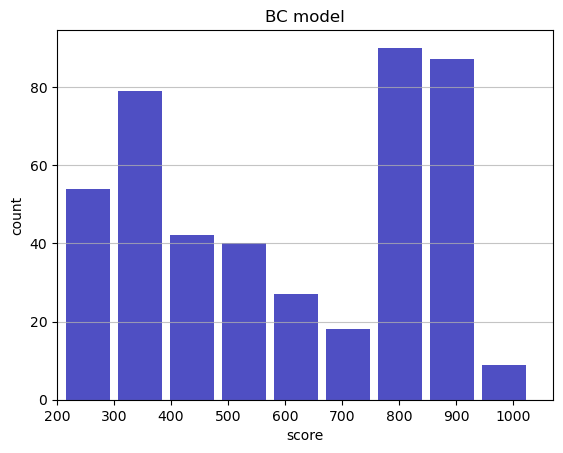

Track generation: 1460..1829 -> 369-tiles track
Epoch: 452
BC	mean: 596.46	variance: 240.95


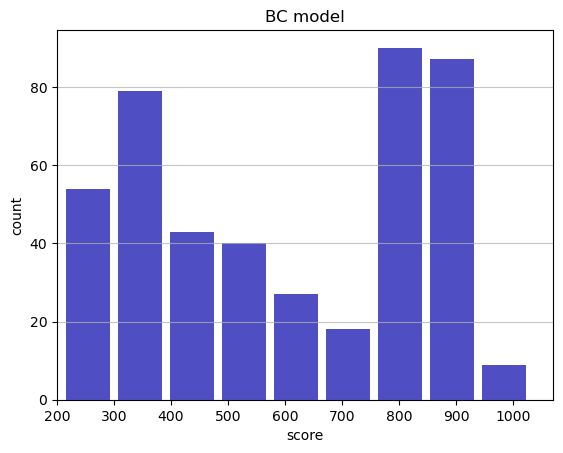

Track generation: 1186..1486 -> 300-tiles track
Epoch: 453
BC	mean: 597.06	variance: 241.02


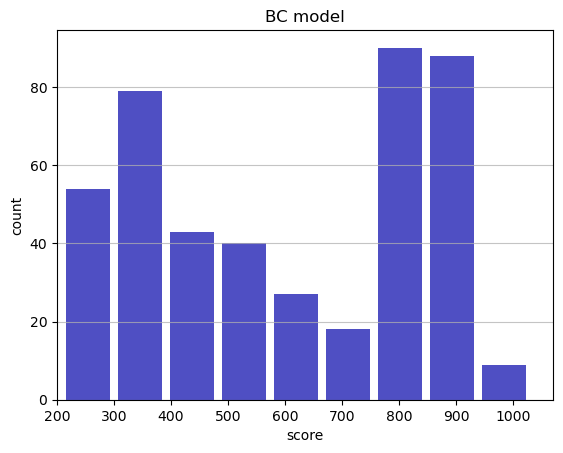

Track generation: 1248..1564 -> 316-tiles track
Epoch: 454
BC	mean: 596.77	variance: 240.83


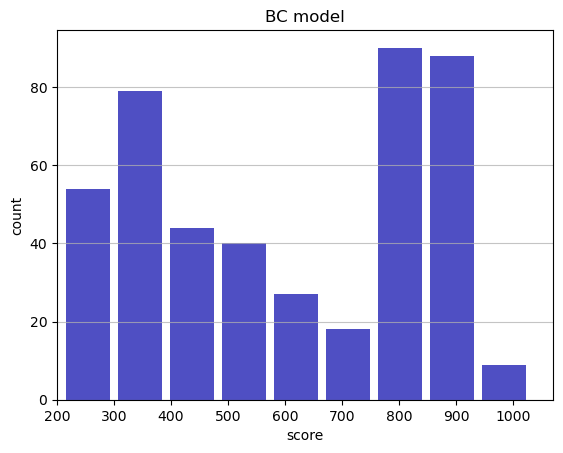

Track generation: 1110..1400 -> 290-tiles track
Epoch: 455
BC	mean: 596.51	variance: 240.62


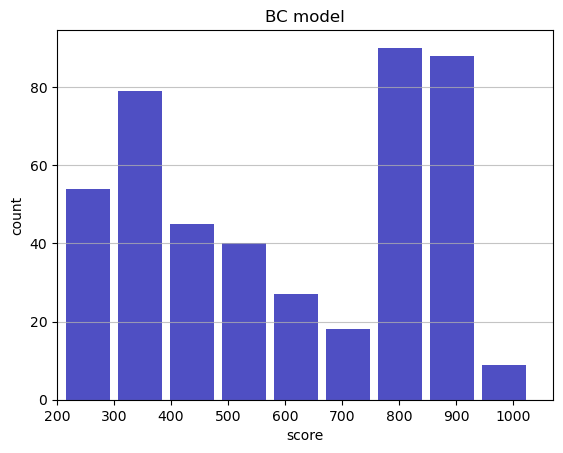

Track generation: 1127..1420 -> 293-tiles track
Epoch: 456
BC	mean: 596.68	variance: 240.39


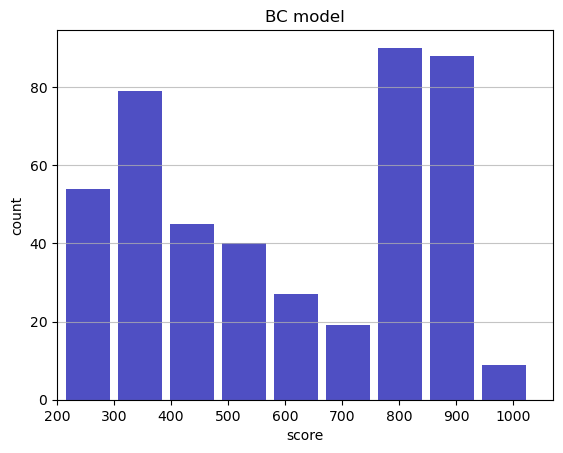

Track generation: 1048..1322 -> 274-tiles track
Epoch: 457
BC	mean: 597.60	variance: 240.91


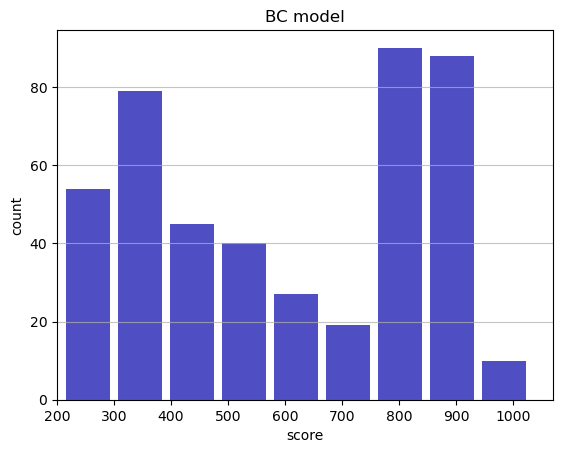

Track generation: 1203..1508 -> 305-tiles track
Epoch: 458
BC	mean: 598.34	variance: 241.18


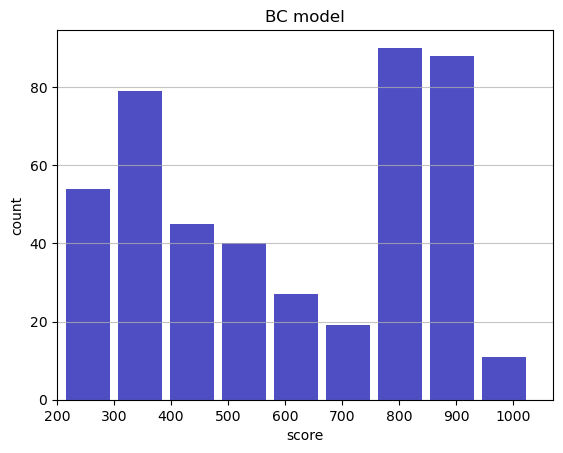

Track generation: 1223..1533 -> 310-tiles track
Epoch: 459
BC	mean: 597.72	variance: 241.28


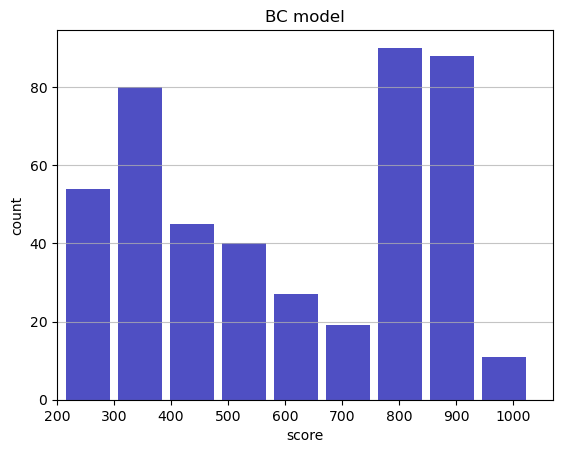

Track generation: 1336..1674 -> 338-tiles track
Epoch: 460
BC	mean: 597.72	variance: 241.02


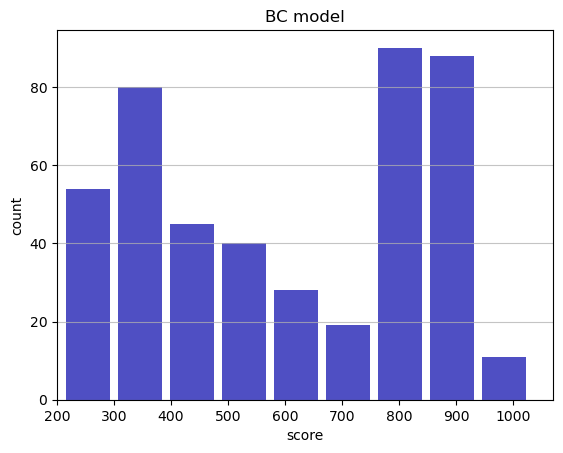

Track generation: 1208..1514 -> 306-tiles track
Epoch: 461
BC	mean: 598.19	variance: 240.97


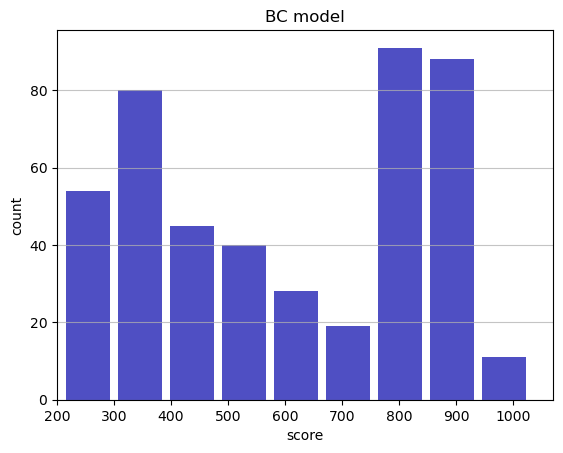

Track generation: 1245..1560 -> 315-tiles track
Epoch: 462
BC	mean: 598.70	variance: 240.96


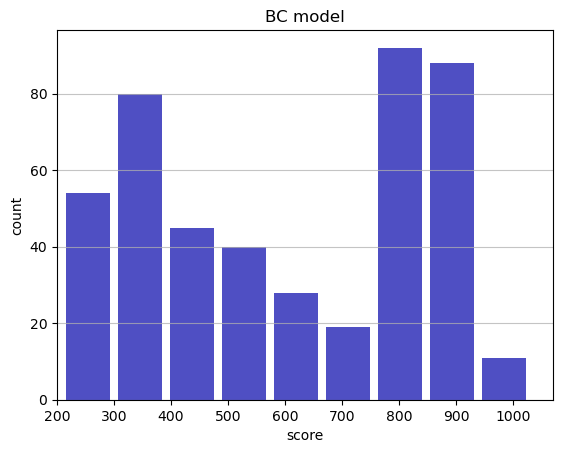

Track generation: 1306..1636 -> 330-tiles track
Epoch: 463
BC	mean: 598.29	variance: 240.86


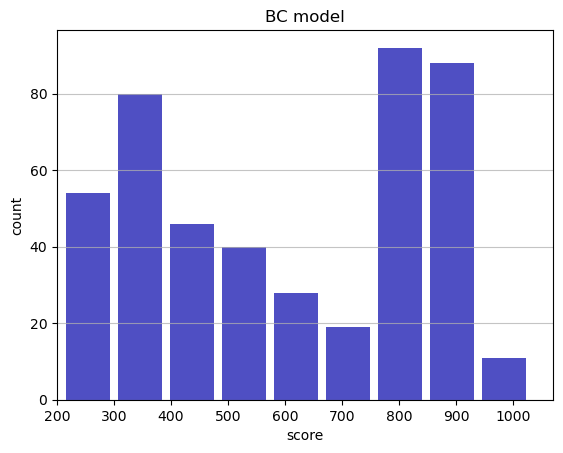

Track generation: 1018..1283 -> 265-tiles track
Epoch: 464
BC	mean: 598.46	variance: 240.63


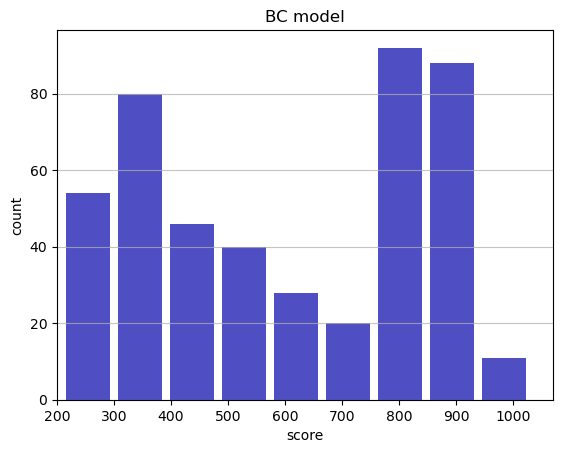

Track generation: 1240..1553 -> 313-tiles track
Epoch: 465
BC	mean: 597.95	variance: 240.63


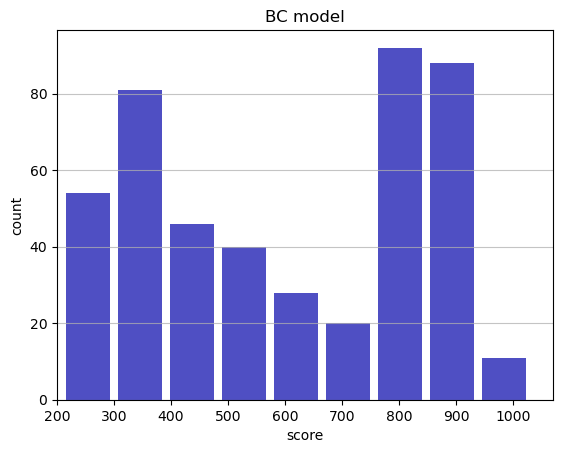

Track generation: 1288..1615 -> 327-tiles track
Epoch: 466
BC	mean: 597.73	variance: 240.42


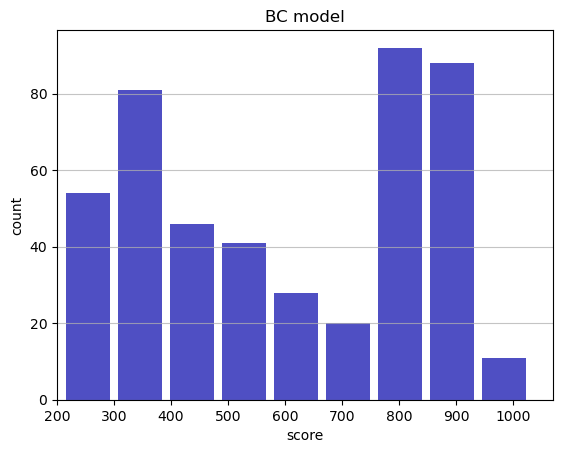

Track generation: 1081..1355 -> 274-tiles track
Epoch: 467
BC	mean: 597.05	variance: 240.60


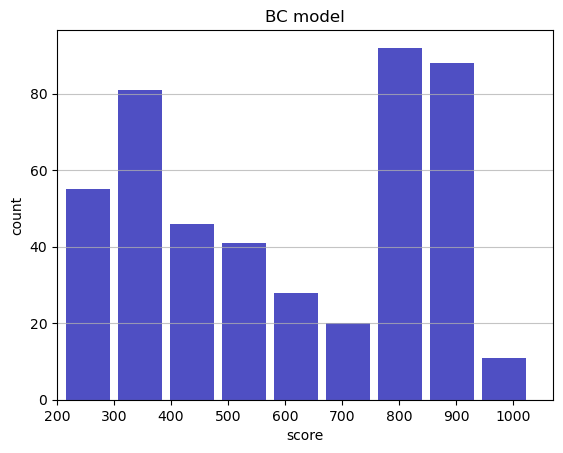

Track generation: 1206..1512 -> 306-tiles track
Epoch: 468
BC	mean: 596.33	variance: 240.85


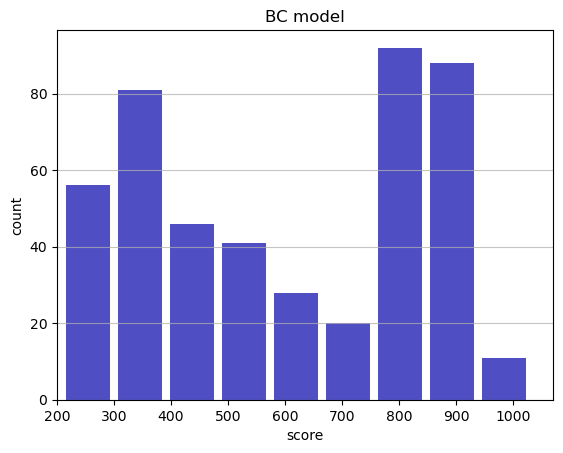

Track generation: 1175..1473 -> 298-tiles track
Epoch: 469
BC	mean: 596.01	variance: 240.69


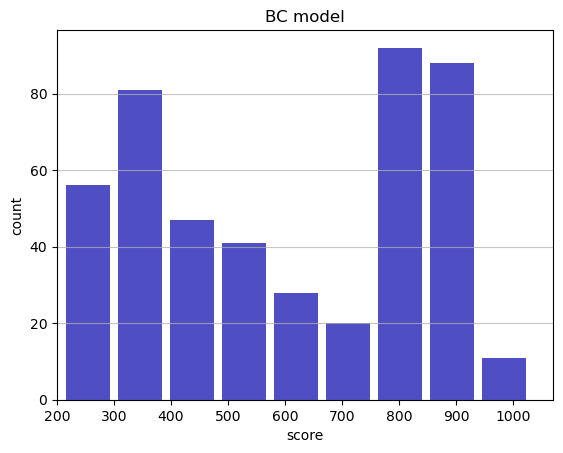

Track generation: 1069..1340 -> 271-tiles track
Epoch: 470
BC	mean: 595.78	variance: 240.49


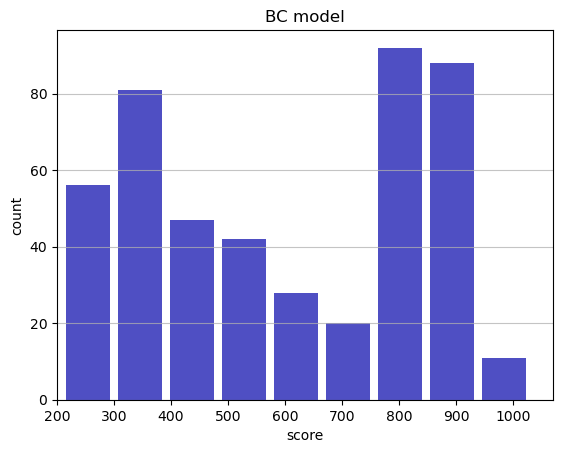

Track generation: 1195..1498 -> 303-tiles track
Epoch: 471
BC	mean: 596.23	variance: 240.42


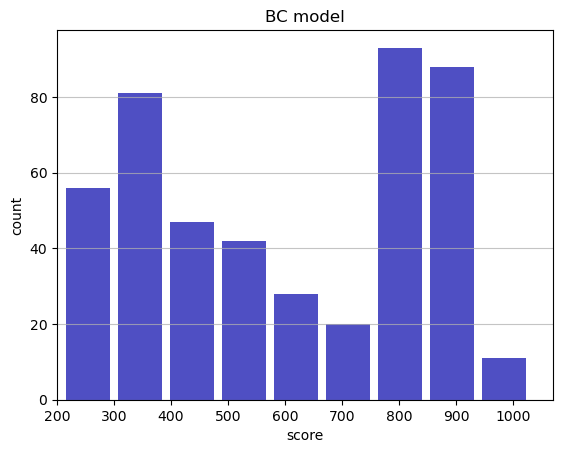

Track generation: 1111..1393 -> 282-tiles track
Epoch: 472
BC	mean: 595.60	variance: 240.56


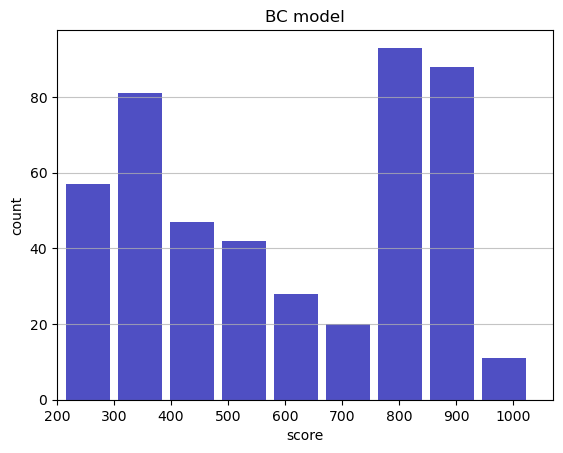

Track generation: 1200..1504 -> 304-tiles track
Epoch: 473
BC	mean: 595.11	variance: 240.54


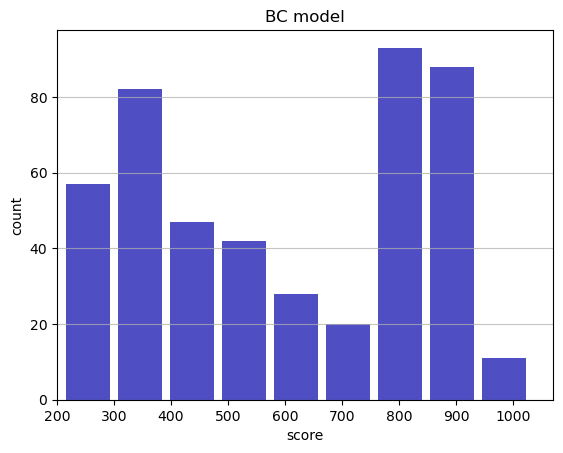

Track generation: 1144..1434 -> 290-tiles track
Epoch: 474
BC	mean: 595.66	variance: 240.59


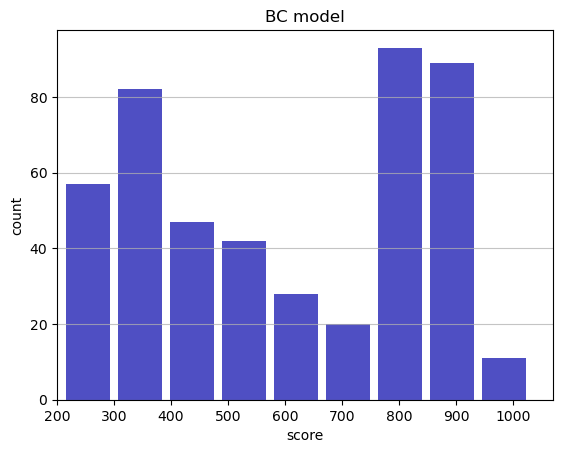

Track generation: 1047..1313 -> 266-tiles track
Epoch: 475
BC	mean: 595.16	variance: 240.59


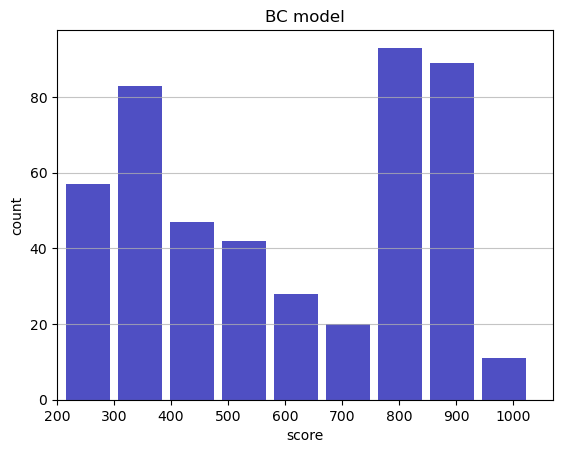

Track generation: 1207..1513 -> 306-tiles track
Epoch: 476
BC	mean: 594.51	variance: 240.74


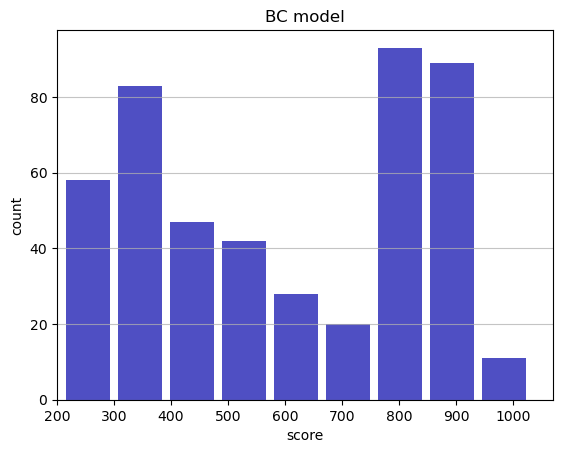

Track generation: 1094..1376 -> 282-tiles track
Epoch: 477
BC	mean: 593.94	variance: 240.81


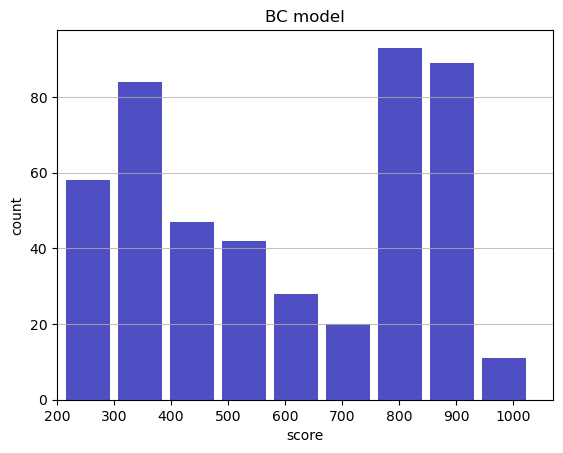

Track generation: 1238..1552 -> 314-tiles track
Epoch: 478
BC	mean: 594.55	variance: 240.93


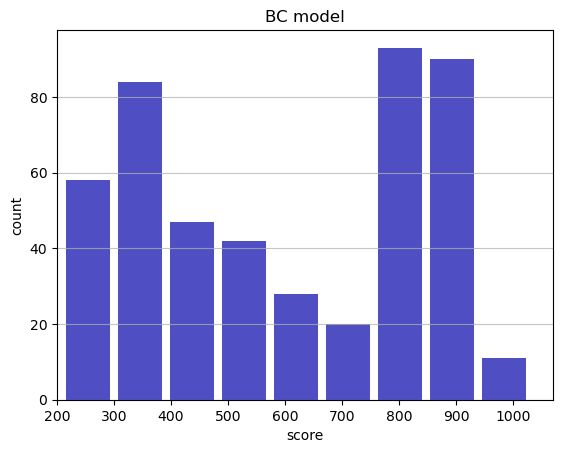

Track generation: 1140..1429 -> 289-tiles track
Epoch: 479
BC	mean: 594.27	variance: 240.75


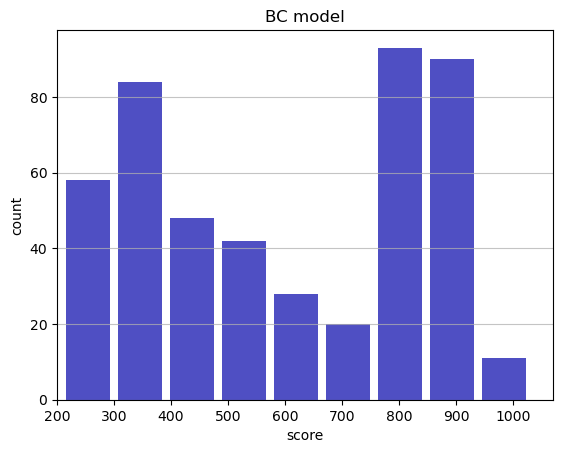

Track generation: 1044..1309 -> 265-tiles track
Epoch: 480
BC	mean: 594.82	variance: 240.80


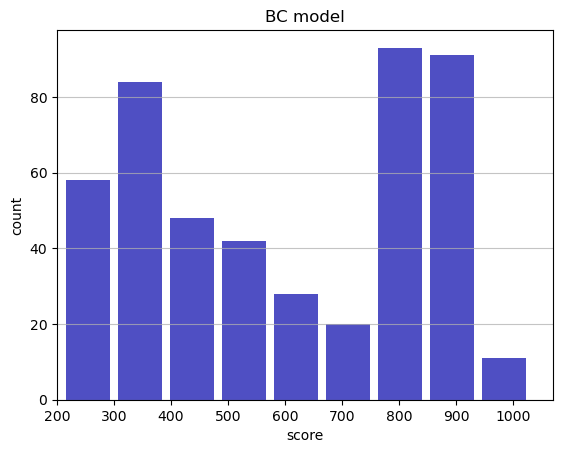

Track generation: 1149..1440 -> 291-tiles track
Epoch: 481
BC	mean: 595.39	variance: 240.87


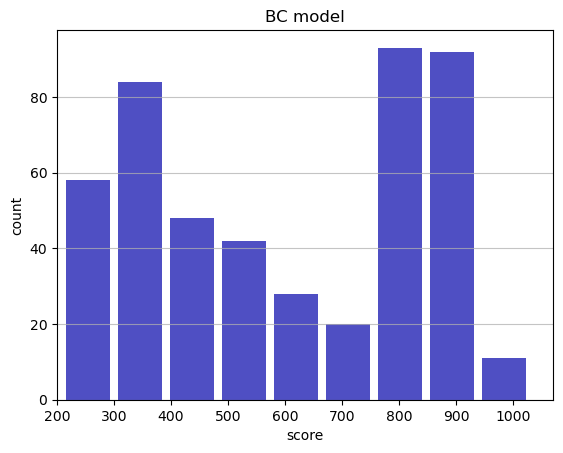

Track generation: 1145..1435 -> 290-tiles track
Epoch: 482
BC	mean: 594.97	variance: 240.80


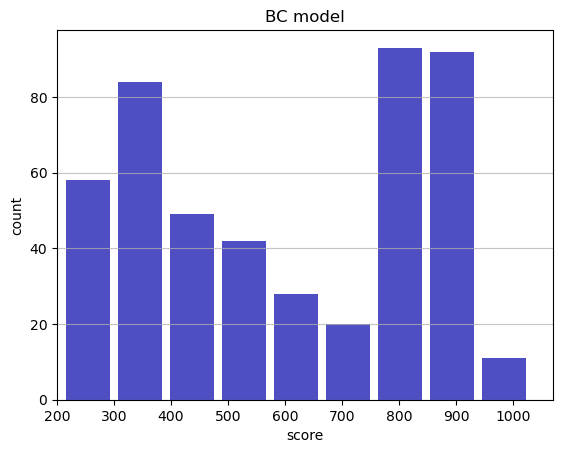

Track generation: 966..1219 -> 253-tiles track
Epoch: 483
BC	mean: 595.60	variance: 240.95


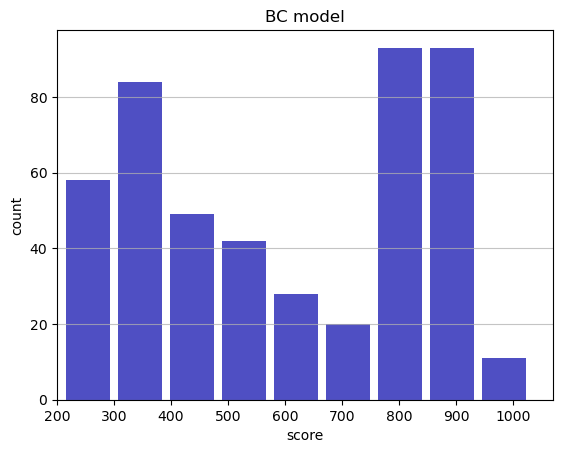

Track generation: 1143..1442 -> 299-tiles track
Epoch: 484
BC	mean: 595.58	variance: 240.70


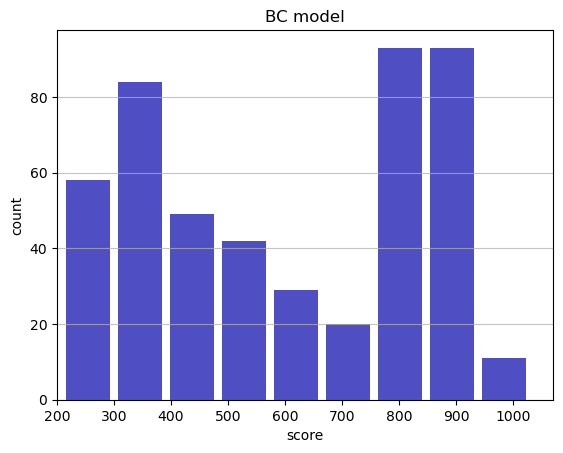

Track generation: 1052..1321 -> 269-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1072..1349 -> 277-tiles track
Epoch: 485
BC	mean: 595.10	variance: 240.69


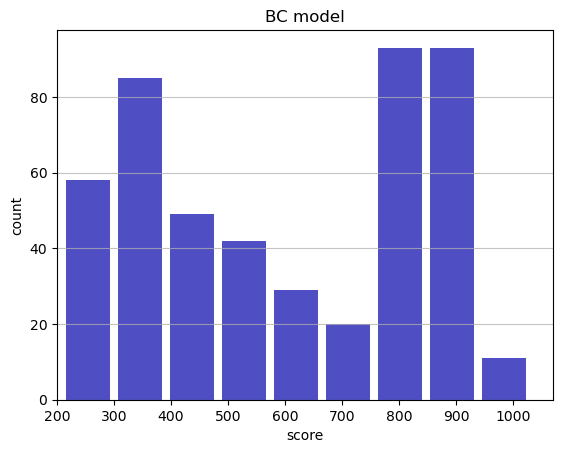

Track generation: 1224..1534 -> 310-tiles track
Epoch: 486
BC	mean: 595.37	variance: 240.51


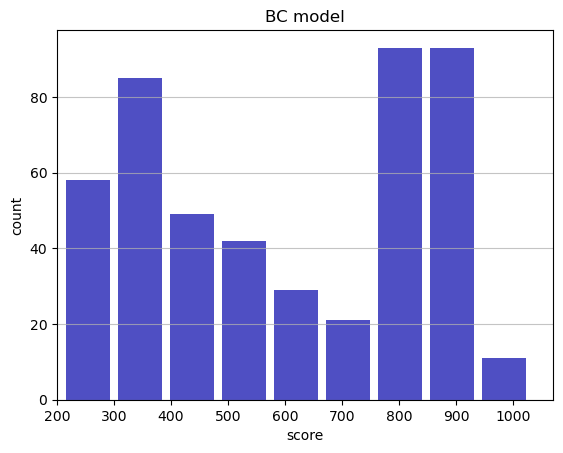

Track generation: 946..1190 -> 244-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1123..1408 -> 285-tiles track
Epoch: 487
BC	mean: 595.92	variance: 240.58


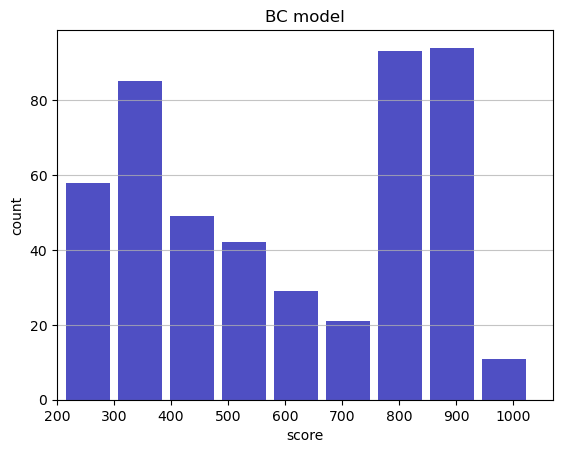

Track generation: 1224..1533 -> 309-tiles track
Epoch: 488
BC	mean: 595.35	variance: 240.66


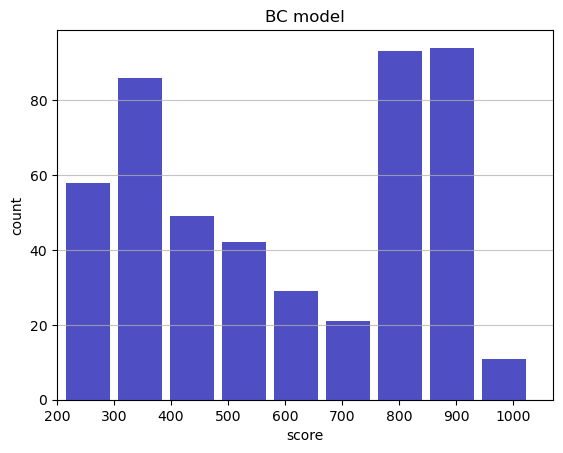

Track generation: 1083..1358 -> 275-tiles track
Epoch: 489
BC	mean: 594.99	variance: 240.54


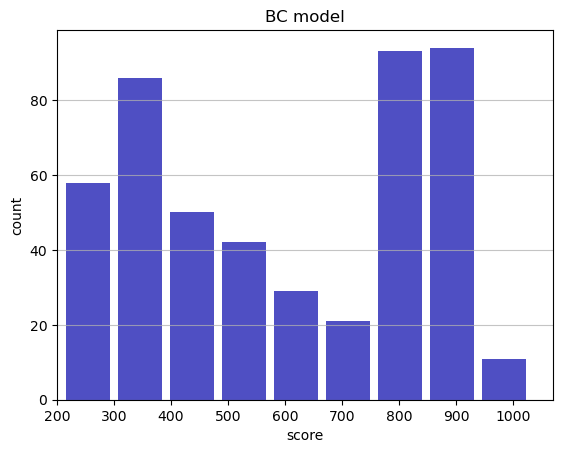

Track generation: 1056..1324 -> 268-tiles track
Epoch: 490
BC	mean: 595.56	variance: 240.61


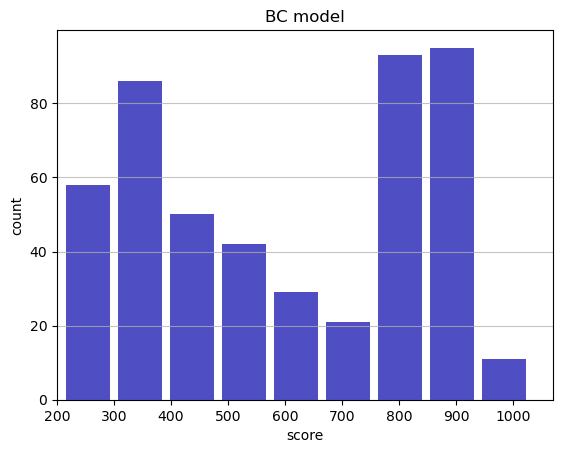

Track generation: 916..1157 -> 241-tiles track
Epoch: 491
BC	mean: 596.10	variance: 240.67


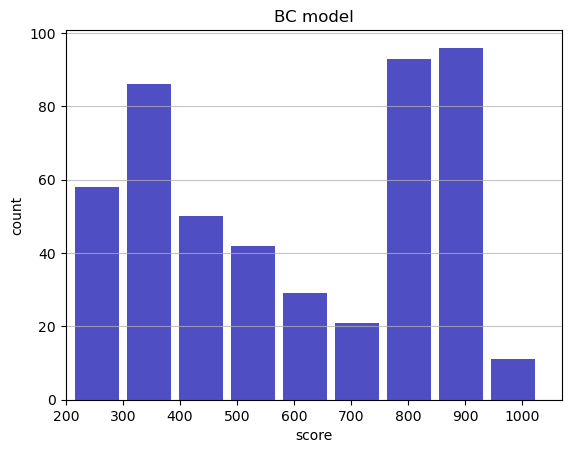

Track generation: 1095..1373 -> 278-tiles track
Epoch: 492
BC	mean: 596.57	variance: 240.65


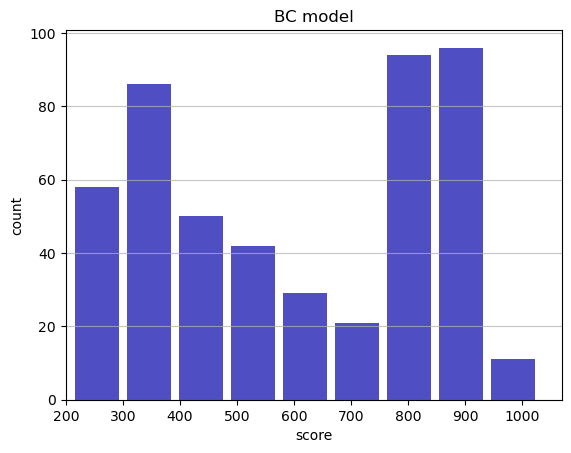

Track generation: 1200..1504 -> 304-tiles track
Epoch: 493
BC	mean: 597.00	variance: 240.60


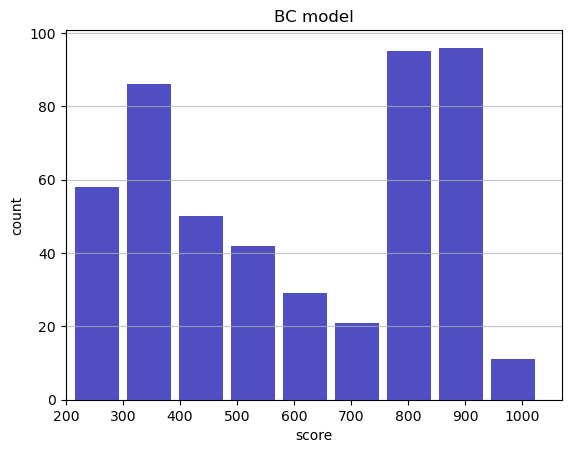

Track generation: 1116..1399 -> 283-tiles track
Epoch: 494
BC	mean: 596.58	variance: 240.55


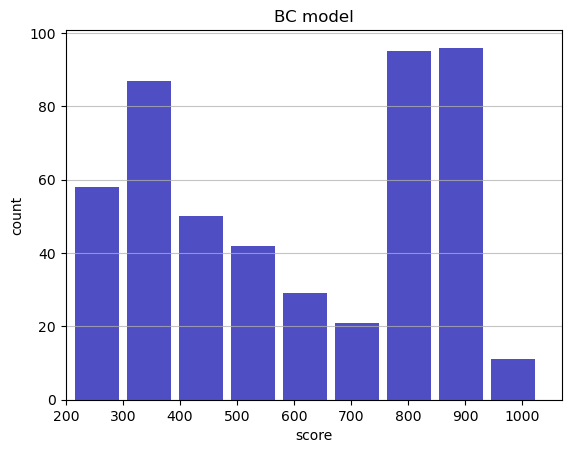

Track generation: 1128..1414 -> 286-tiles track
Epoch: 495
BC	mean: 597.01	variance: 240.49


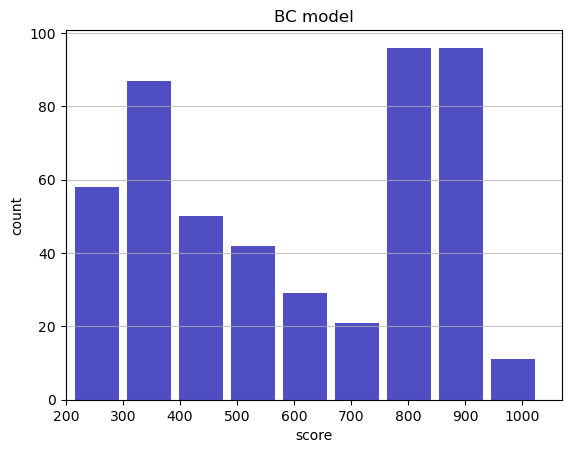

Track generation: 1056..1324 -> 268-tiles track
Epoch: 496
BC	mean: 597.44	variance: 240.45


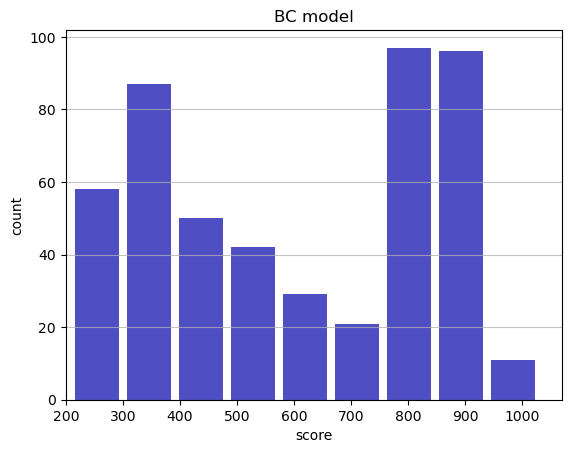

Track generation: 1032..1294 -> 262-tiles track
Epoch: 497
BC	mean: 596.93	variance: 240.48


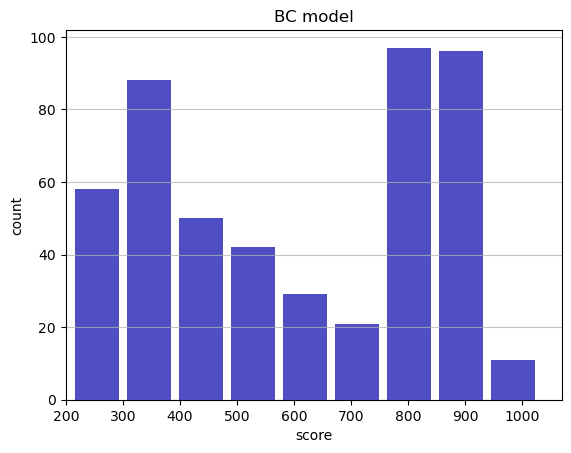

Track generation: 1057..1331 -> 274-tiles track
Epoch: 498
BC	mean: 597.64	variance: 240.75


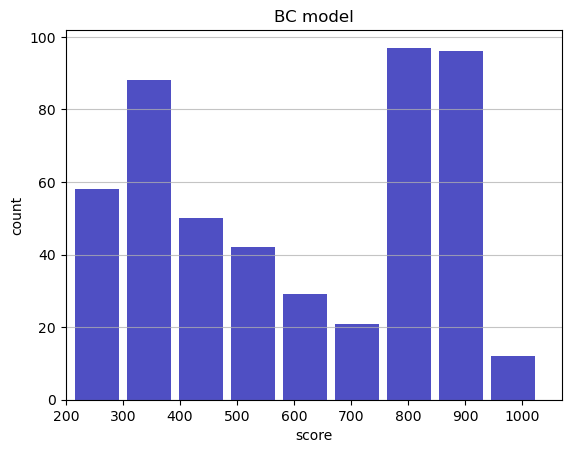

Track generation: 1179..1483 -> 304-tiles track
Epoch: 499
BC	mean: 597.61	variance: 240.51


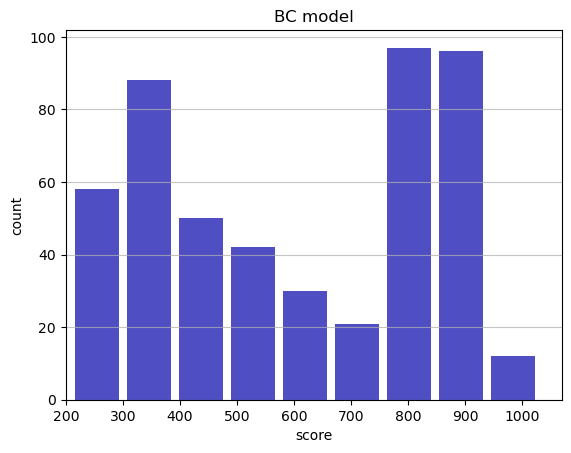

Track generation: 1136..1424 -> 288-tiles track
Epoch: 500
BC	mean: 597.00	variance: 240.64


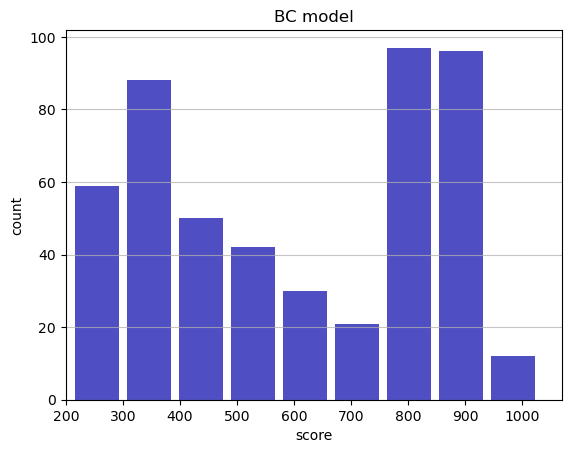

Track generation: 1192..1494 -> 302-tiles track
Epoch: 501
BC	mean: 597.26	variance: 240.47


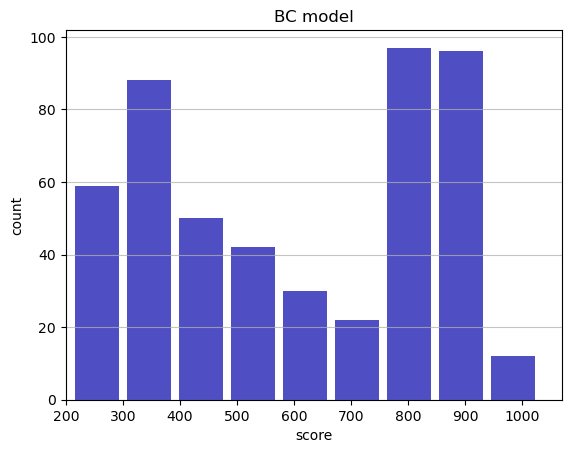

Track generation: 1070..1344 -> 274-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1160..1464 -> 304-tiles track
Epoch: 502
BC	mean: 596.69	variance: 240.57


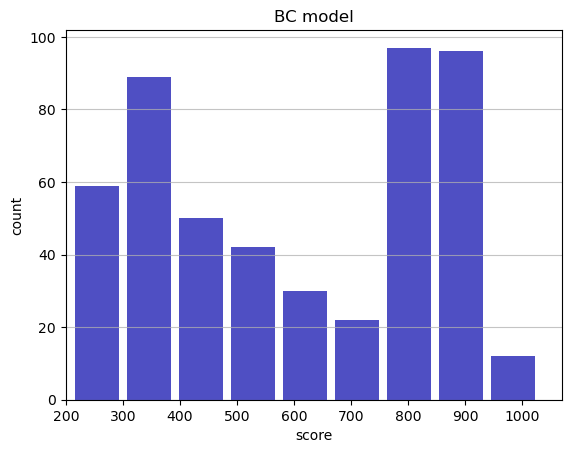

Track generation: 982..1232 -> 250-tiles track
Epoch: 503
BC	mean: 597.20	variance: 240.61


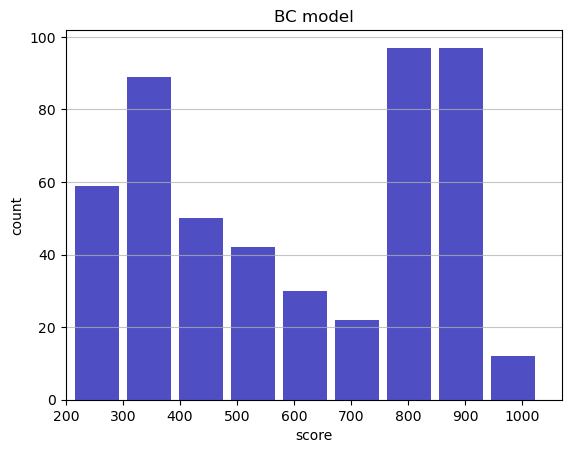

Track generation: 1125..1410 -> 285-tiles track
Epoch: 504
BC	mean: 597.63	variance: 240.56


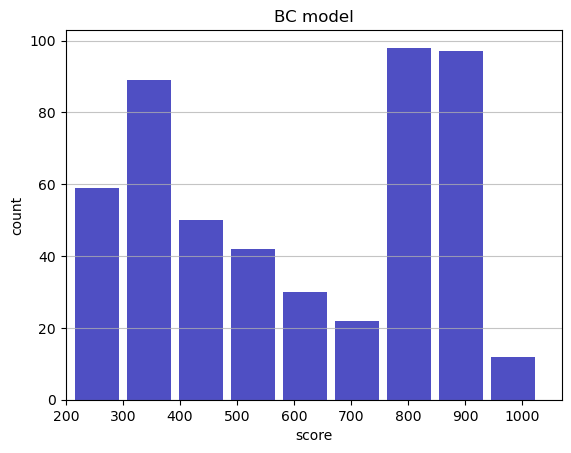

Track generation: 1119..1411 -> 292-tiles track
Epoch: 505
BC	mean: 597.41	variance: 240.38


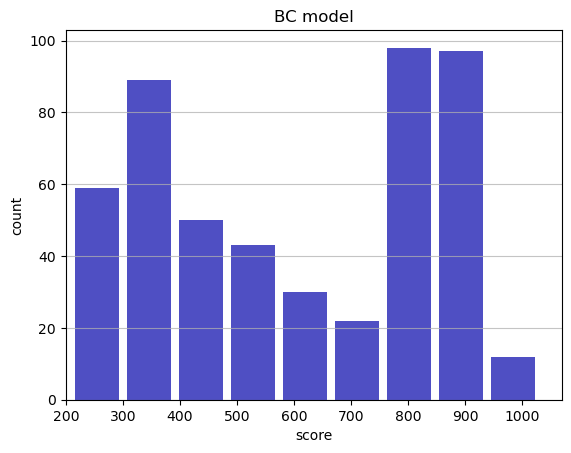

Track generation: 1300..1629 -> 329-tiles track
Epoch: 506
BC	mean: 596.73	variance: 240.62


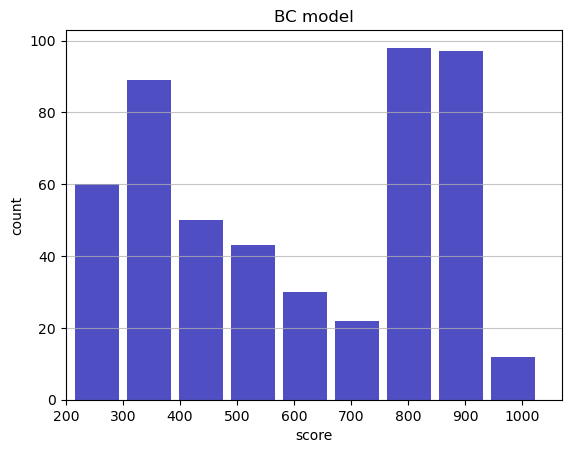

Track generation: 1170..1467 -> 297-tiles track
Epoch: 507
BC	mean: 596.10	variance: 240.81


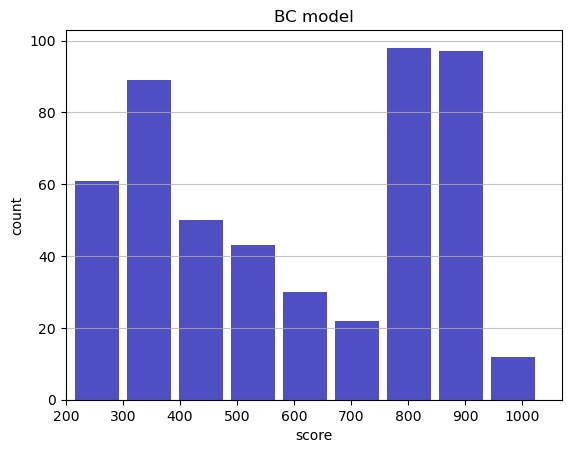

Track generation: 894..1127 -> 233-tiles track
Epoch: 508
BC	mean: 596.62	variance: 240.86


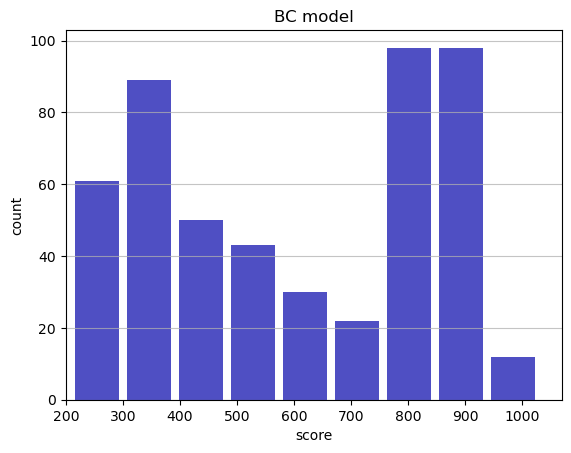

Track generation: 1048..1321 -> 273-tiles track
Epoch: 509
BC	mean: 596.60	variance: 240.62


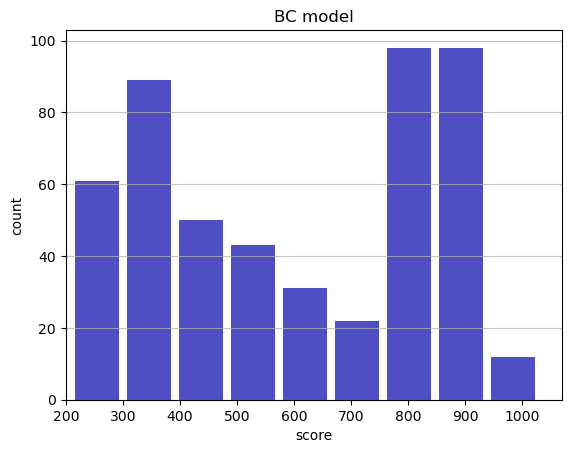

Track generation: 1112..1394 -> 282-tiles track
Epoch: 510
BC	mean: 597.18	variance: 240.73


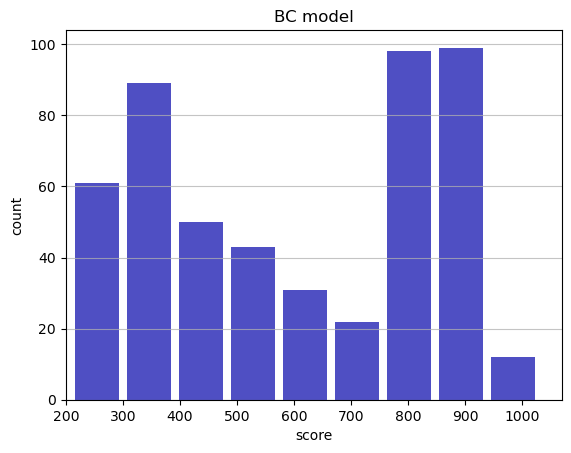

Track generation: 1094..1413 -> 319-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1123..1414 -> 291-tiles track
Epoch: 511
BC	mean: 596.81	variance: 240.64


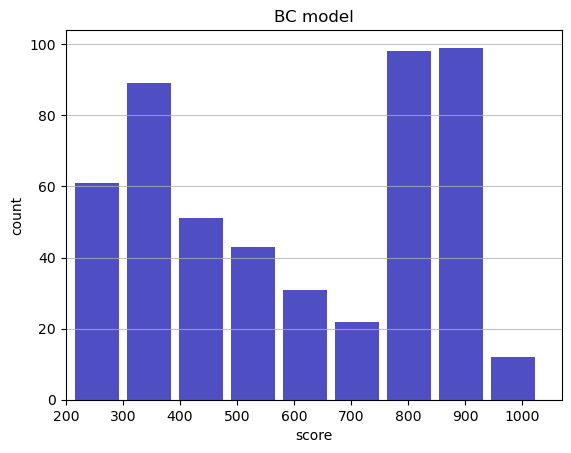

Track generation: 1005..1267 -> 262-tiles track
Epoch: 512
BC	mean: 597.35	variance: 240.73


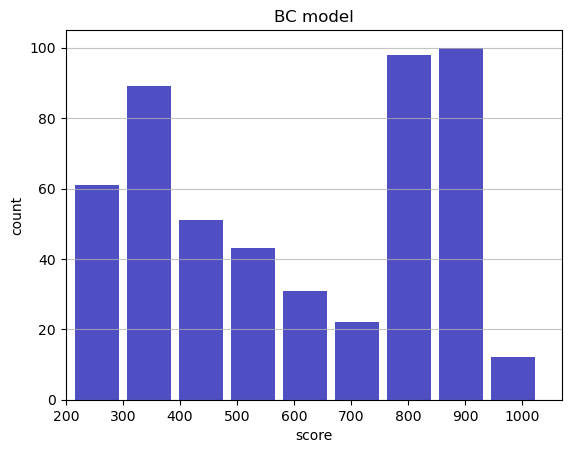

Track generation: 1184..1484 -> 300-tiles track
Epoch: 513
BC	mean: 596.89	variance: 240.72


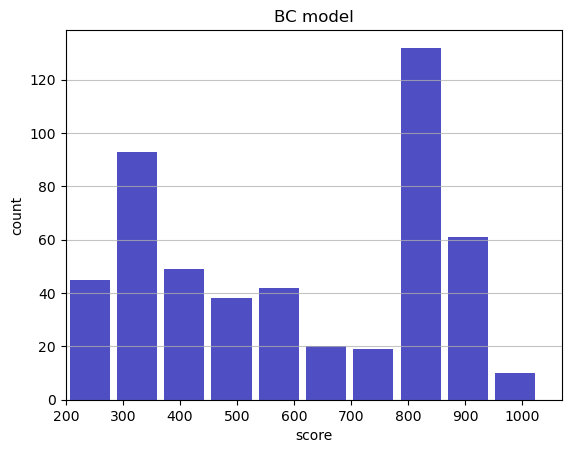

Track generation: 1084..1368 -> 284-tiles track
Epoch: 514
BC	mean: 596.03	variance: 241.27


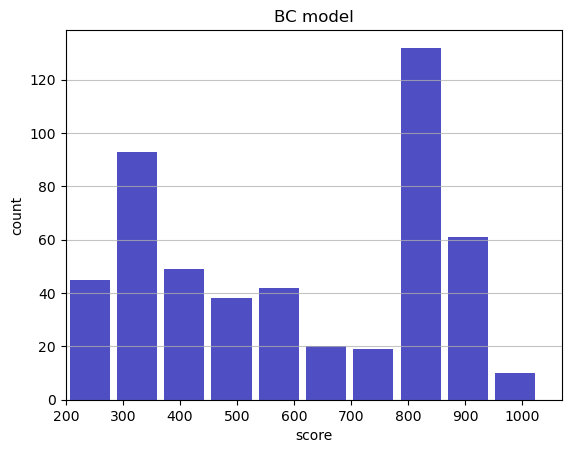

Track generation: 1118..1410 -> 292-tiles track
Epoch: 515
BC	mean: 596.45	variance: 241.22


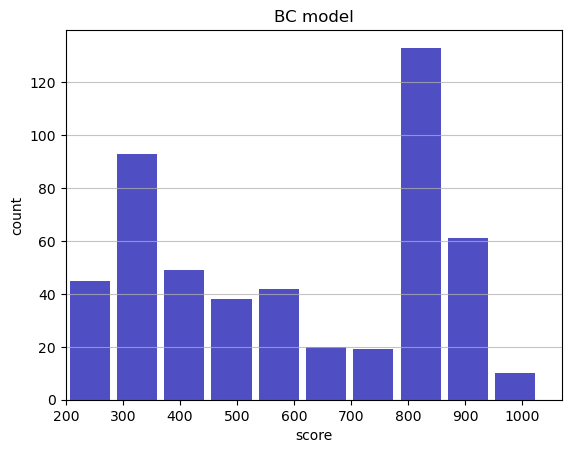

Track generation: 1070..1343 -> 273-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1157..1451 -> 294-tiles track
Epoch: 516
BC	mean: 596.04	variance: 241.16


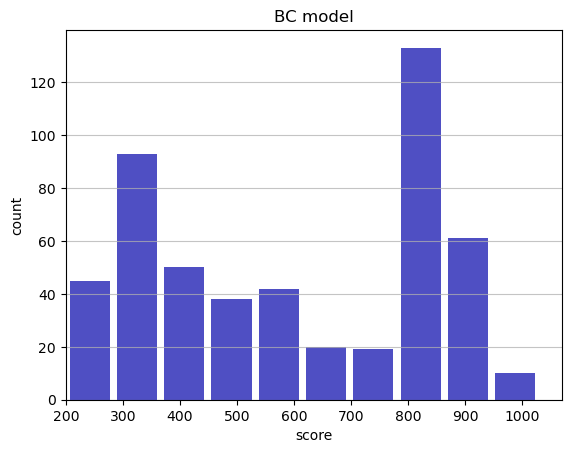

Track generation: 1074..1353 -> 279-tiles track
Epoch: 517
BC	mean: 595.57	variance: 241.16


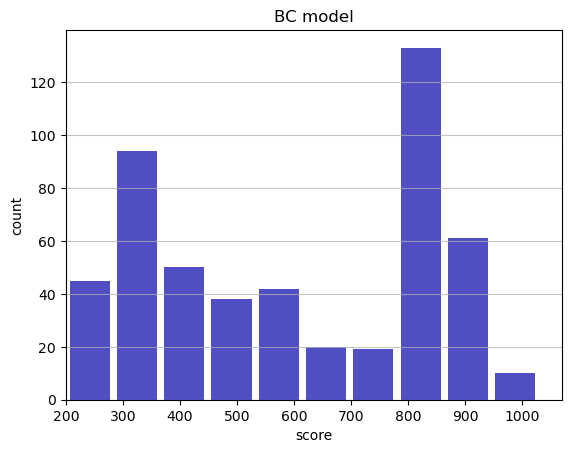

Track generation: 1148..1439 -> 291-tiles track
Epoch: 518
BC	mean: 595.54	variance: 240.93


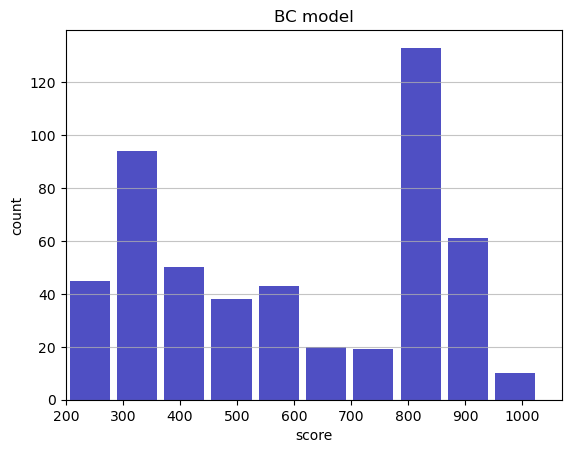

Track generation: 1356..1699 -> 343-tiles track
Epoch: 519
BC	mean: 594.86	variance: 241.19


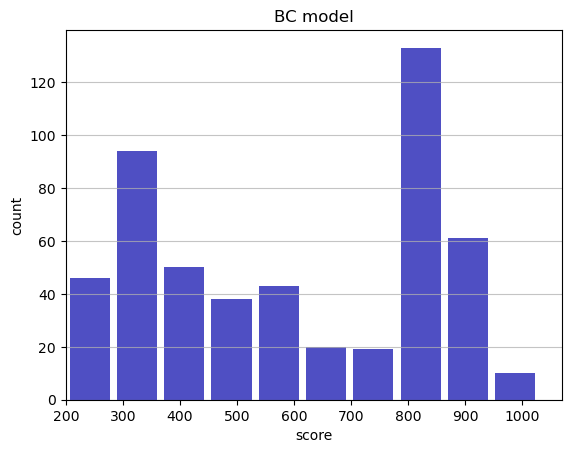

Track generation: 1158..1451 -> 293-tiles track
Epoch: 520
BC	mean: 594.50	variance: 241.10


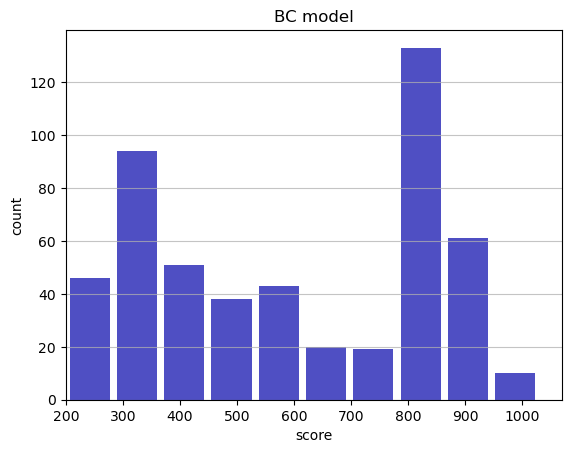

Track generation: 1232..1553 -> 321-tiles track
Epoch: 521
BC	mean: 594.68	variance: 240.91


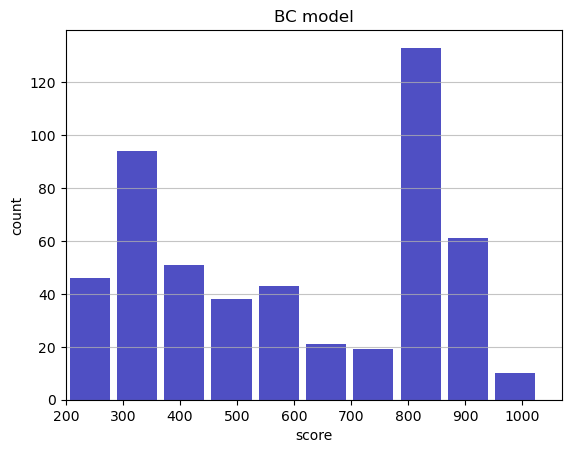

Track generation: 1115..1398 -> 283-tiles track
Epoch: 522
BC	mean: 594.13	variance: 241.01


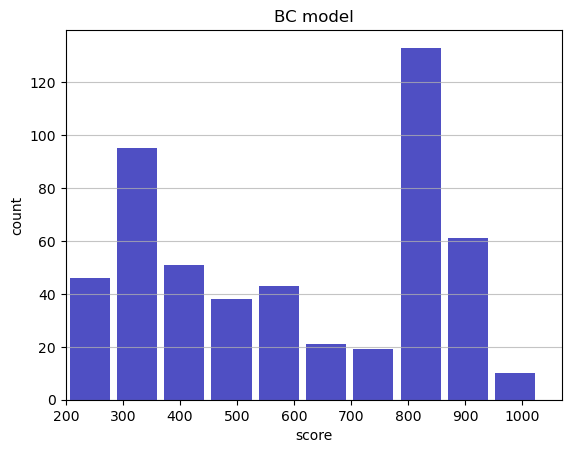

Track generation: 1166..1461 -> 295-tiles track
Epoch: 523
BC	mean: 594.59	variance: 241.01


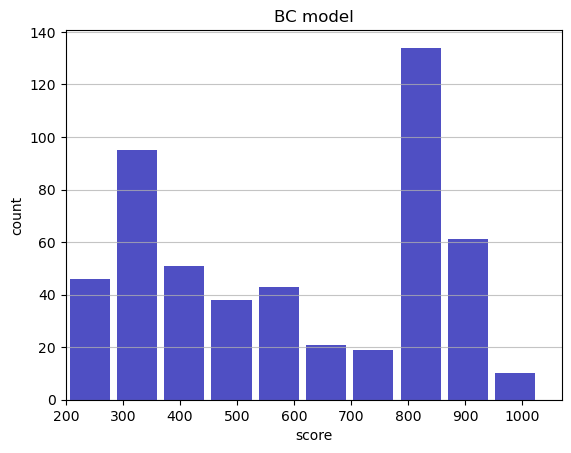

Track generation: 1205..1510 -> 305-tiles track
Epoch: 524
BC	mean: 595.17	variance: 241.14


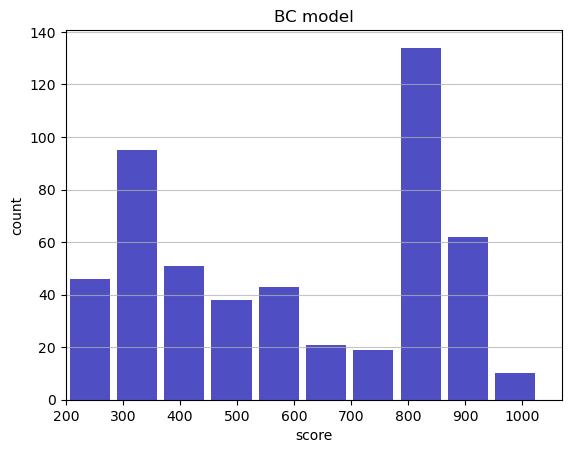

Track generation: 1122..1412 -> 290-tiles track
Epoch: 525
BC	mean: 594.97	variance: 240.95


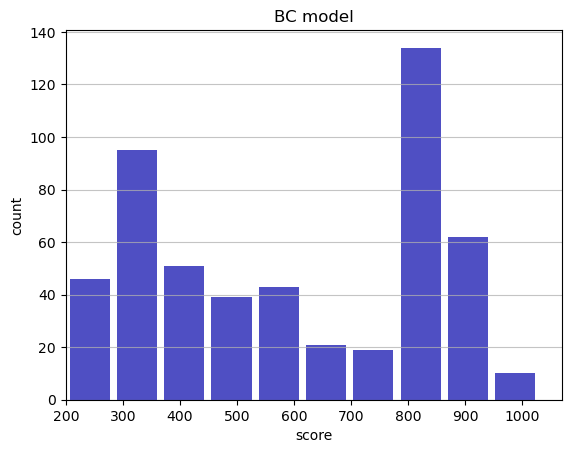

Track generation: 1092..1369 -> 277-tiles track
Epoch: 526
BC	mean: 595.54	variance: 241.07


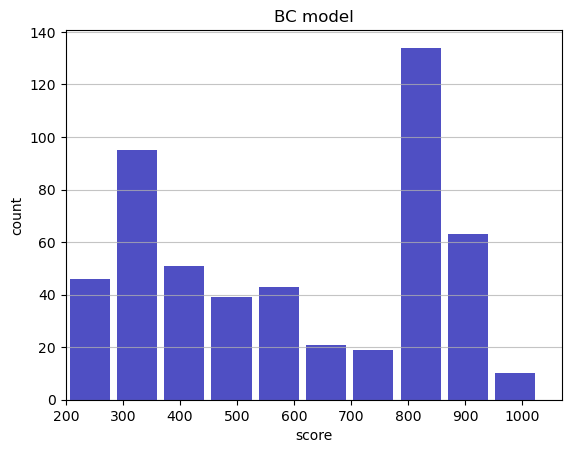

Track generation: 1096..1380 -> 284-tiles track
Epoch: 527
BC	mean: 595.02	variance: 241.15


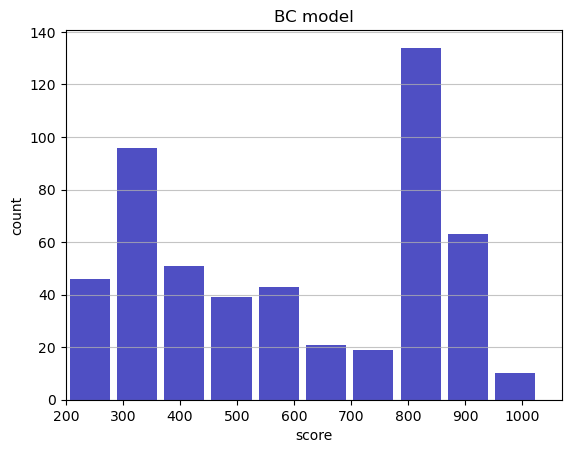

Track generation: 1074..1346 -> 272-tiles track
Epoch: 528
BC	mean: 594.52	variance: 241.19


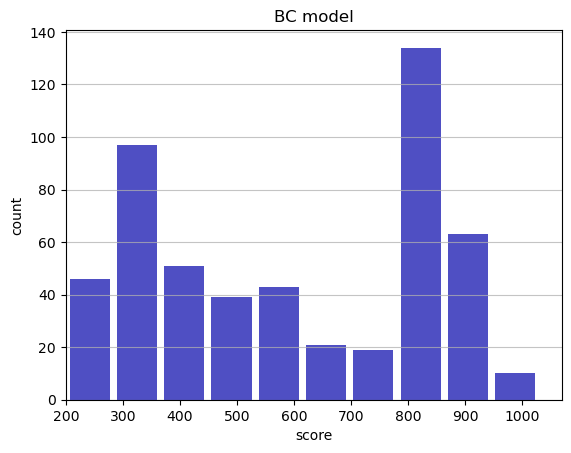

Track generation: 1227..1538 -> 311-tiles track
Epoch: 529
BC	mean: 593.88	variance: 241.40


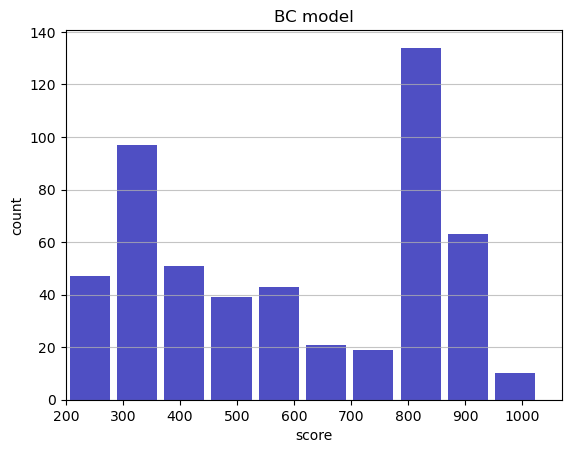

Track generation: 1177..1475 -> 298-tiles track
Epoch: 530
BC	mean: 594.40	variance: 241.47


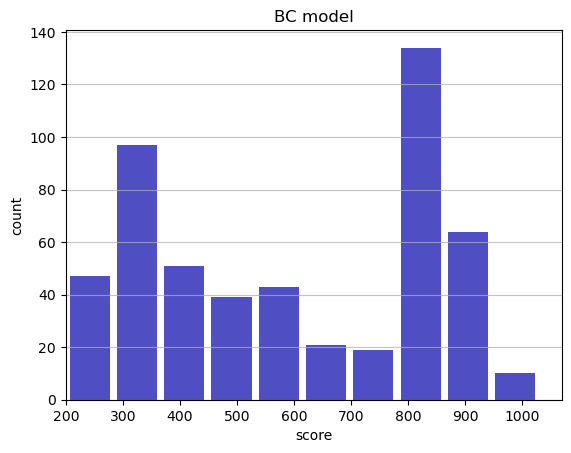

Track generation: 1284..1616 -> 332-tiles track
Epoch: 531
BC	mean: 593.72	variance: 241.76


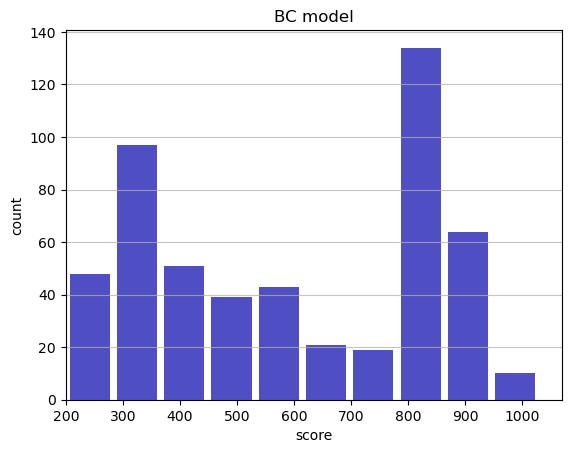

Track generation: 1199..1503 -> 304-tiles track
Epoch: 532
BC	mean: 593.04	variance: 242.03


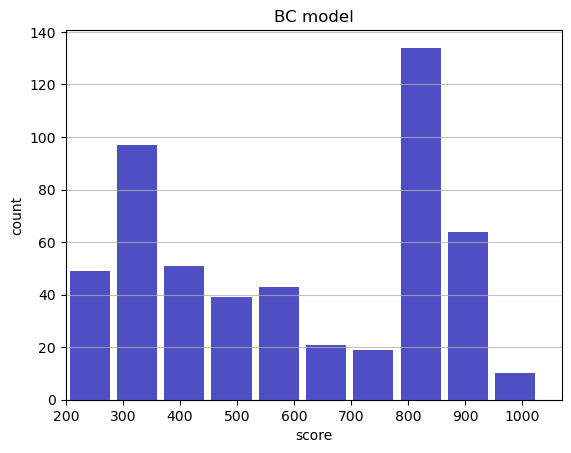

Track generation: 1287..1613 -> 326-tiles track
Epoch: 533
BC	mean: 593.19	variance: 241.83


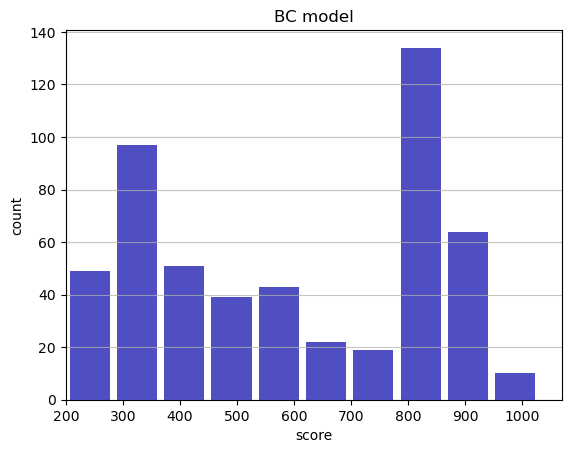

Track generation: 1155..1448 -> 293-tiles track
Epoch: 534
BC	mean: 592.67	variance: 241.91


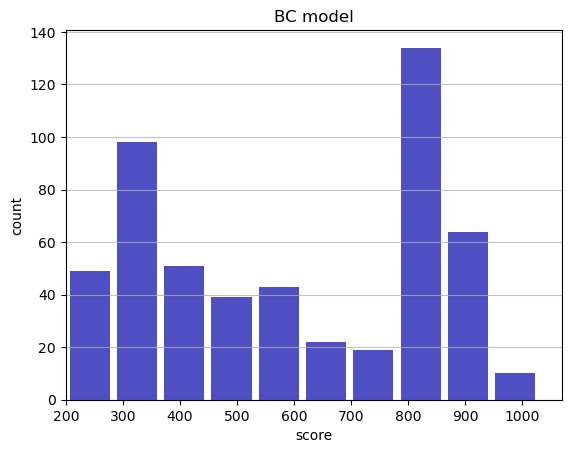

Track generation: 1224..1534 -> 310-tiles track
Epoch: 535
BC	mean: 592.00	variance: 242.18


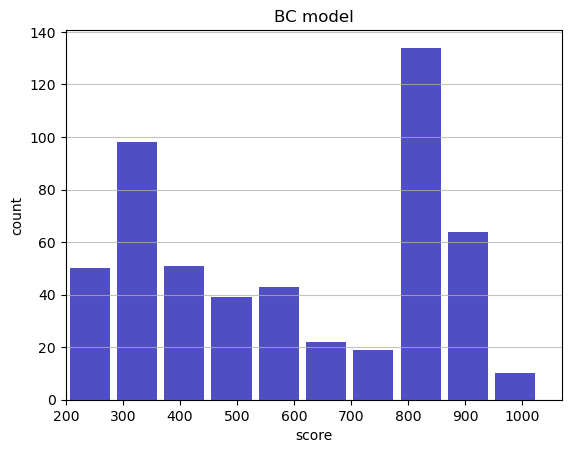

Track generation: 1175..1473 -> 298-tiles track
Epoch: 536
BC	mean: 592.13	variance: 241.98


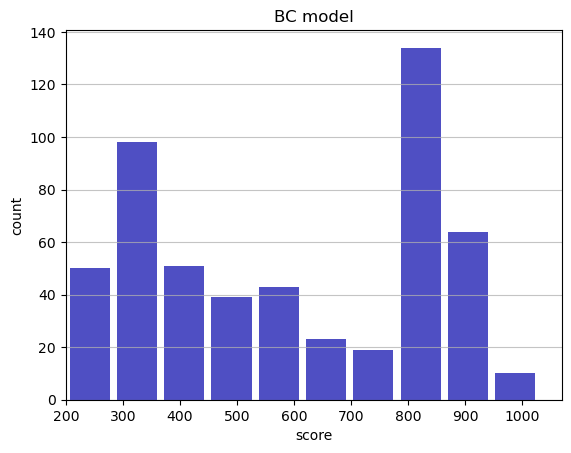

Track generation: 1230..1542 -> 312-tiles track
Epoch: 537
BC	mean: 591.63	variance: 242.04


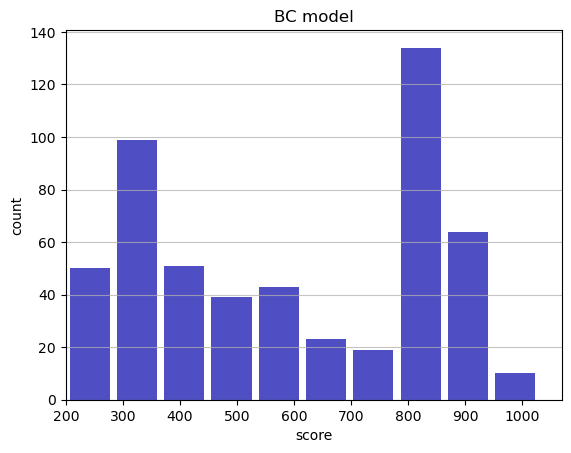

Track generation: 1185..1485 -> 300-tiles track
Epoch: 538
BC	mean: 592.08	variance: 242.04


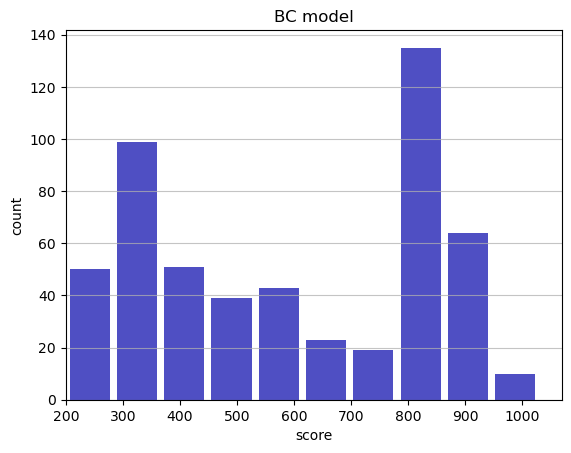

Track generation: 1112..1399 -> 287-tiles track
Epoch: 539
BC	mean: 592.50	variance: 242.01


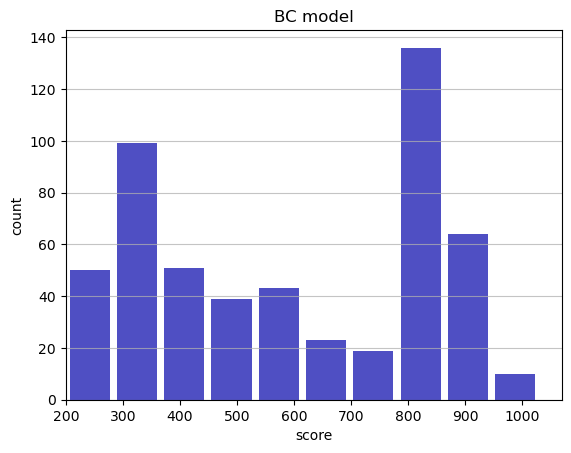

Track generation: 1156..1452 -> 296-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1184..1484 -> 300-tiles track
Epoch: 540
BC	mean: 593.01	variance: 242.08


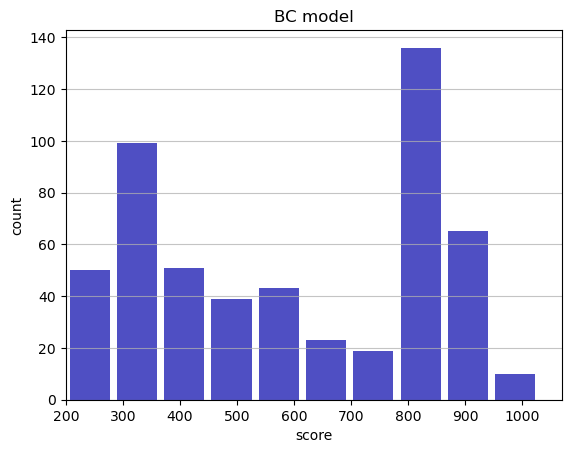

Track generation: 1172..1469 -> 297-tiles track
Epoch: 541
BC	mean: 593.43	variance: 242.05


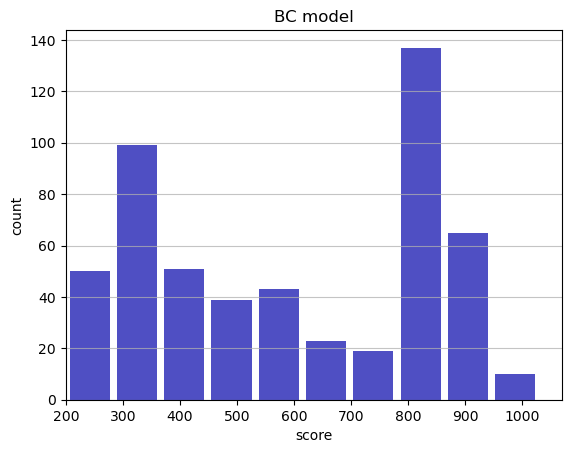

Track generation: 1095..1373 -> 278-tiles track
Epoch: 542
BC	mean: 593.95	variance: 242.13


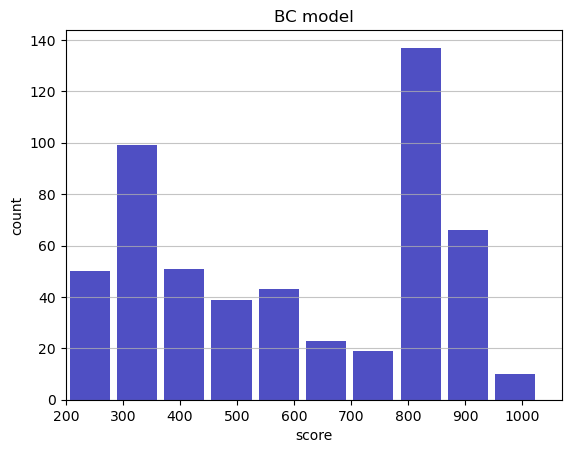

Track generation: 1178..1471 -> 293-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1207..1513 -> 306-tiles track
Epoch: 543
BC	mean: 593.32	variance: 242.35


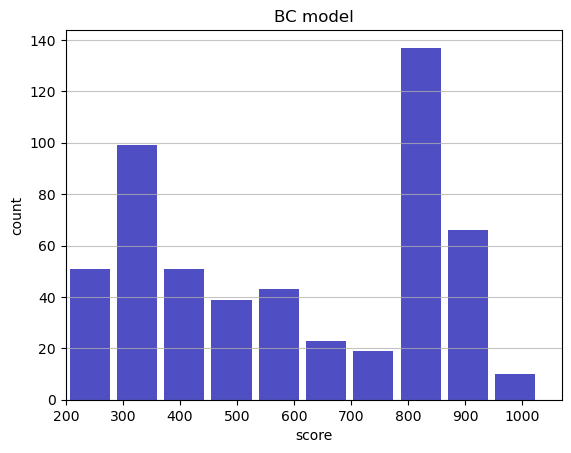

Track generation: 1111..1393 -> 282-tiles track
Epoch: 544
BC	mean: 593.82	variance: 242.40


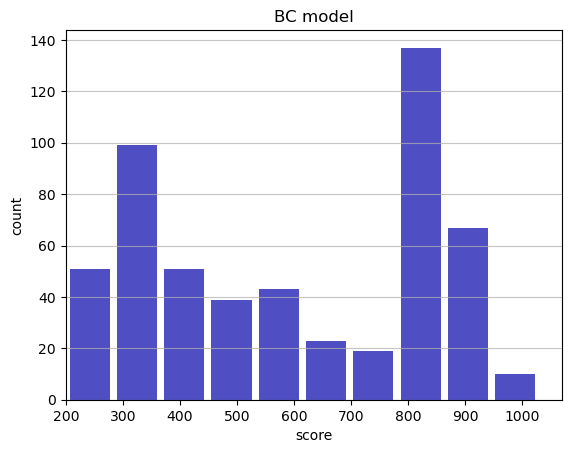

Track generation: 1212..1519 -> 307-tiles track
Epoch: 545
BC	mean: 593.35	variance: 242.42


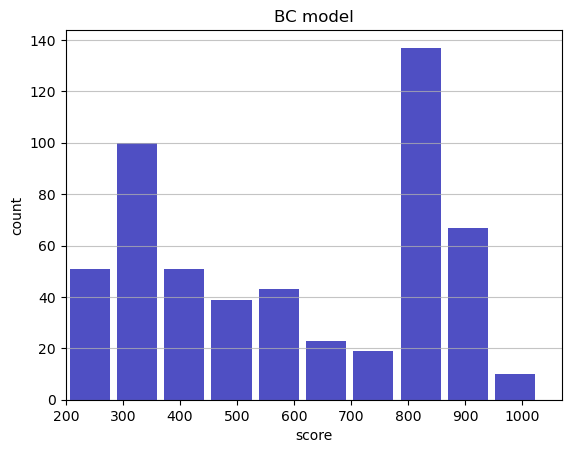

Track generation: 1208..1519 -> 311-tiles track
Epoch: 546
BC	mean: 593.39	variance: 242.20


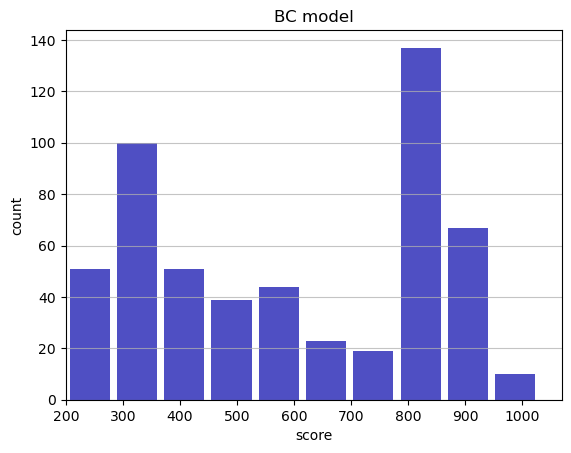

Track generation: 1158..1461 -> 303-tiles track
Epoch: 547
BC	mean: 593.83	variance: 242.20


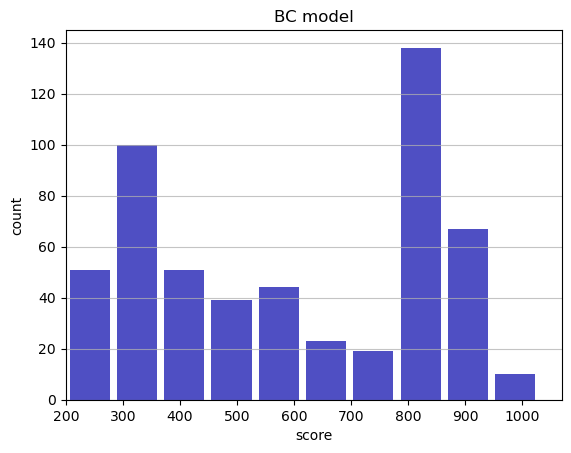

Track generation: 1113..1401 -> 288-tiles track
Epoch: 548
BC	mean: 594.18	variance: 242.12


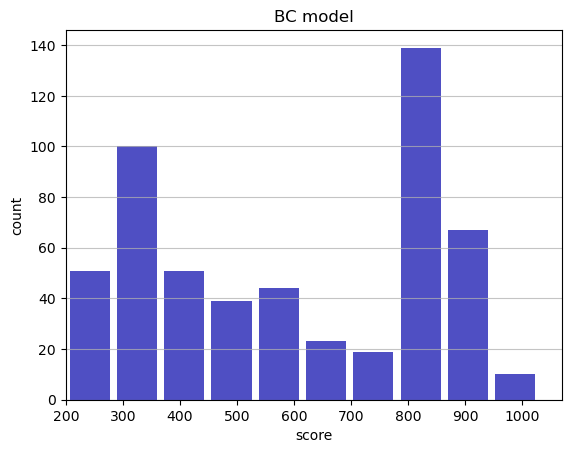

Track generation: 1074..1347 -> 273-tiles track
Epoch: 549
BC	mean: 593.64	variance: 242.22


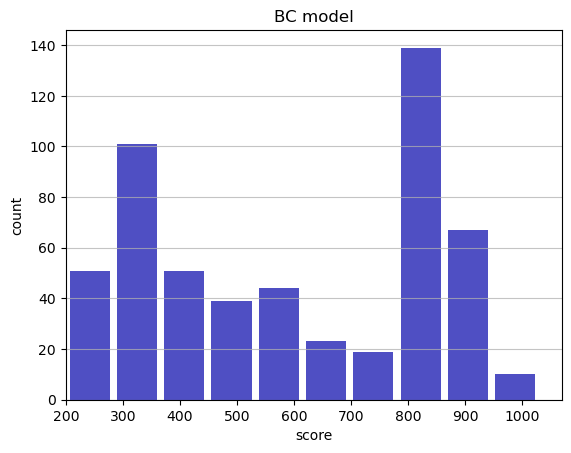

Track generation: 1127..1413 -> 286-tiles track
Epoch: 550
BC	mean: 594.09	variance: 242.22


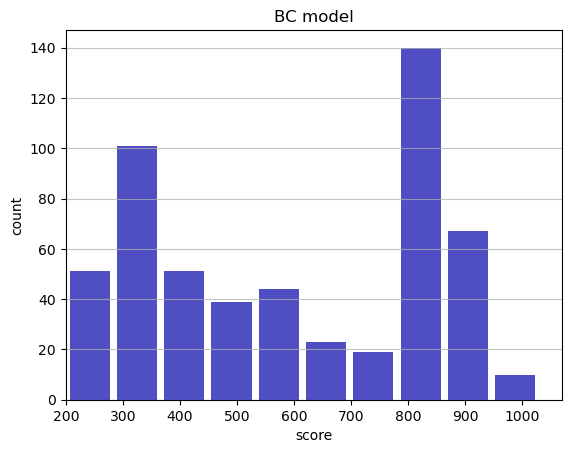

Track generation: 1110..1397 -> 287-tiles track
Epoch: 551
BC	mean: 593.93	variance: 242.03


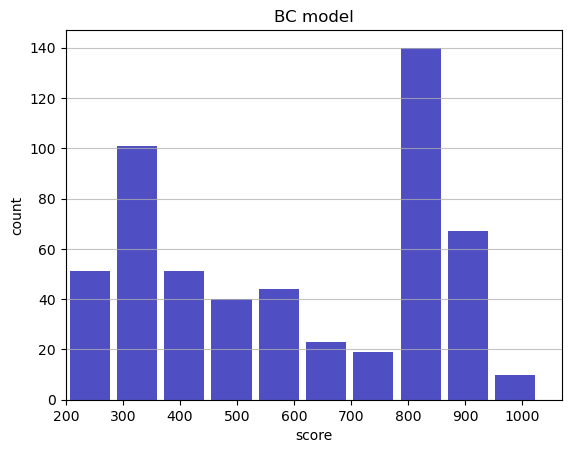

Track generation: 1088..1364 -> 276-tiles track
Epoch: 552
BC	mean: 594.44	variance: 242.10


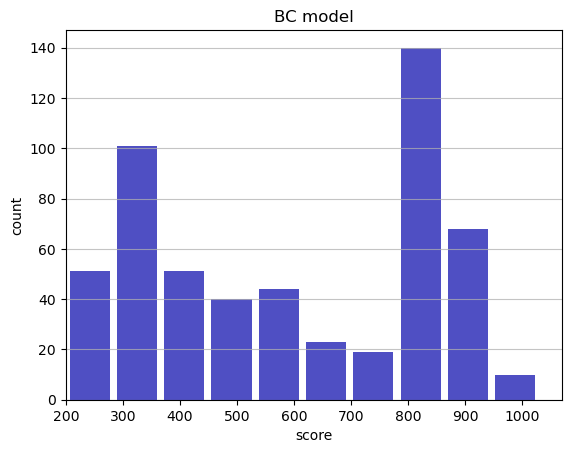

Track generation: 1088..1364 -> 276-tiles track
Epoch: 553
BC	mean: 594.08	variance: 242.03


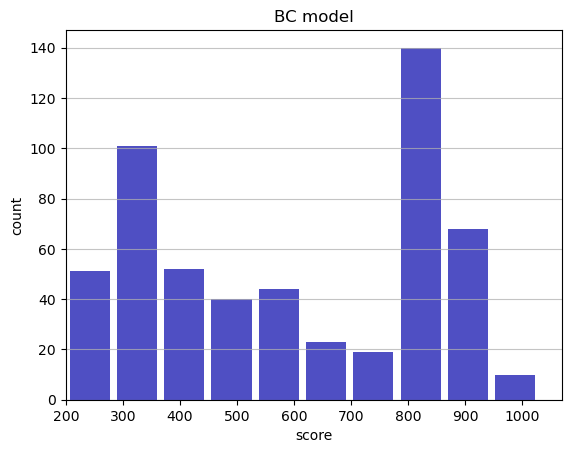

Track generation: 1175..1473 -> 298-tiles track
Epoch: 554
BC	mean: 594.53	variance: 242.04


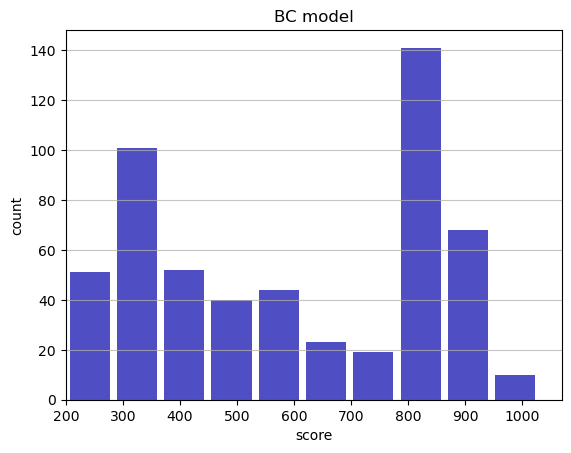

Track generation: 1262..1581 -> 319-tiles track
Epoch: 555
BC	mean: 594.71	variance: 241.86


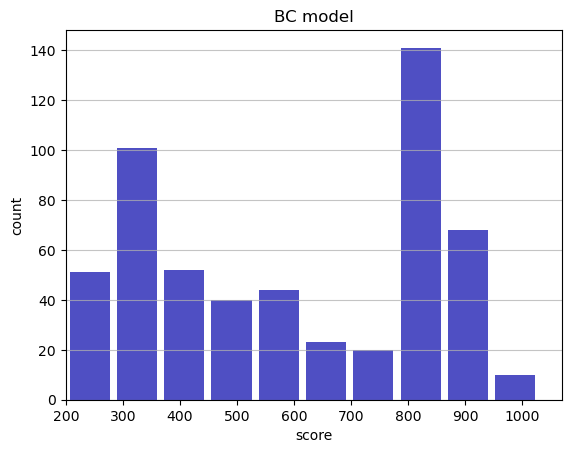

Track generation: 1144..1434 -> 290-tiles track
Epoch: 556
BC	mean: 594.16	variance: 241.99


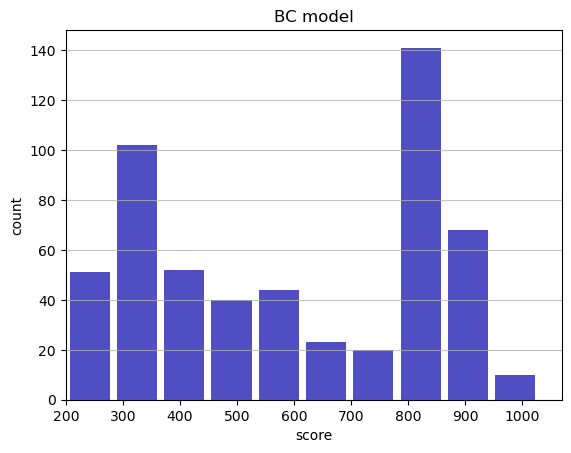

Track generation: 1096..1369 -> 273-tiles track
Epoch: 557
BC	mean: 594.69	variance: 242.09


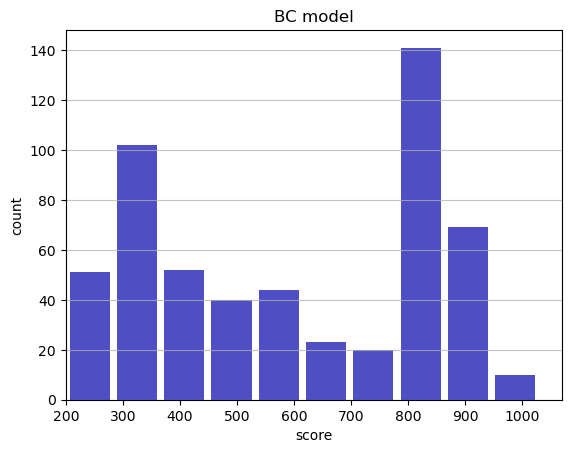

Track generation: 1128..1414 -> 286-tiles track
Epoch: 558
BC	mean: 594.21	variance: 242.14


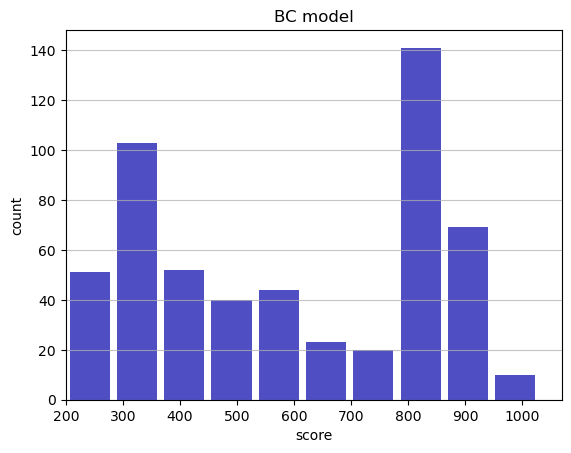

Track generation: 1228..1539 -> 311-tiles track
Epoch: 559
BC	mean: 594.67	variance: 242.17


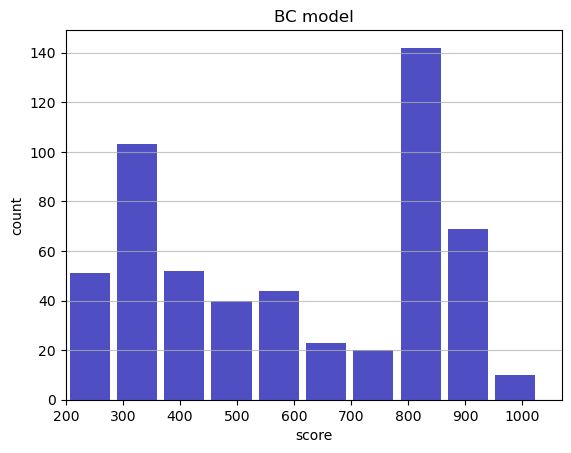

Track generation: 1217..1525 -> 308-tiles track
Epoch: 560
BC	mean: 594.29	variance: 242.11


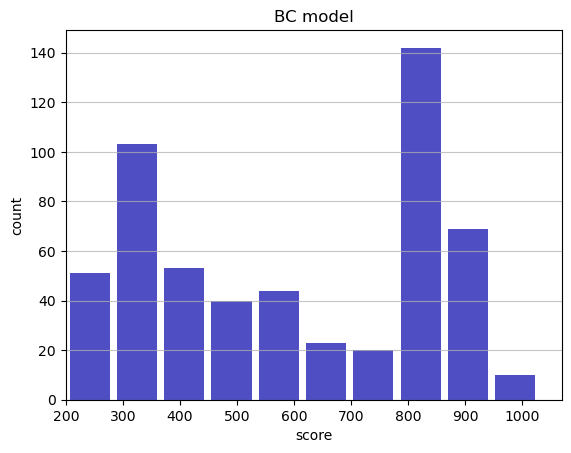

Track generation: 1126..1411 -> 285-tiles track
Epoch: 561
BC	mean: 593.84	variance: 242.13


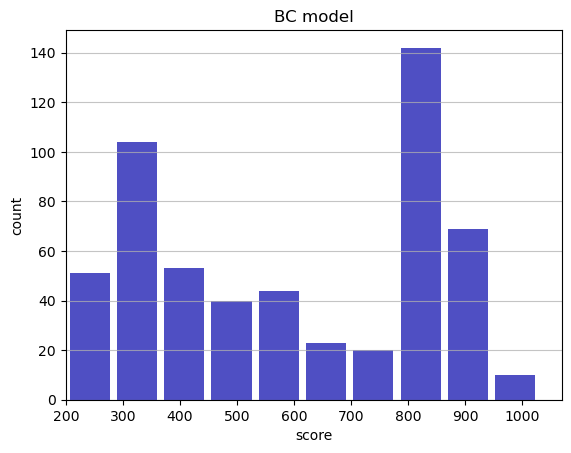

Track generation: 1096..1378 -> 282-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1095..1373 -> 278-tiles track
Epoch: 562
BC	mean: 594.30	variance: 242.16


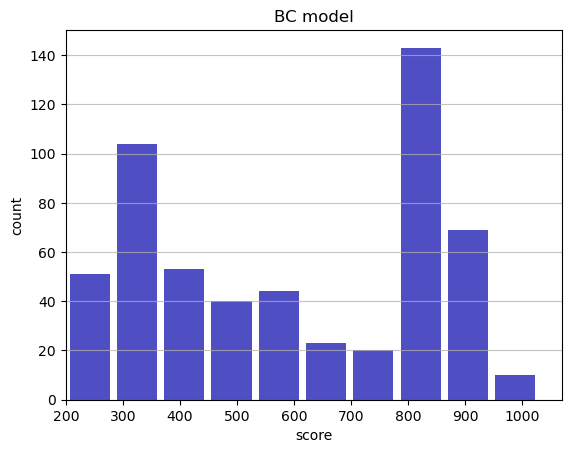

Track generation: 1008..1264 -> 256-tiles track
Epoch: 563
BC	mean: 593.97	variance: 242.08


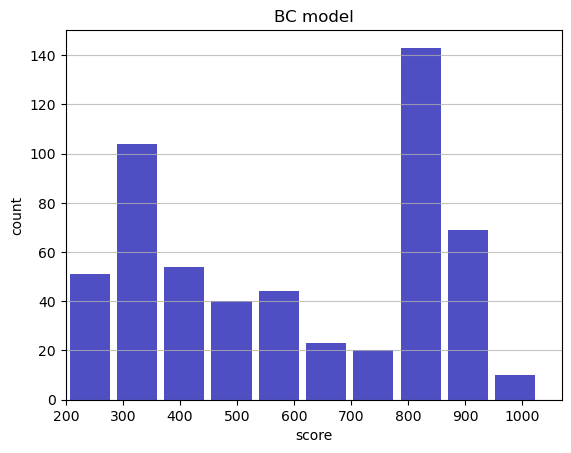

Track generation: 1052..1319 -> 267-tiles track
Epoch: 564
BC	mean: 594.37	variance: 242.05


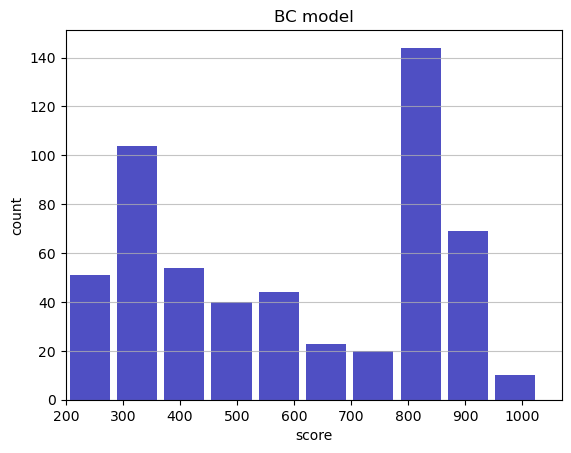

Track generation: 1041..1310 -> 269-tiles track
Epoch: 565
BC	mean: 593.95	variance: 242.04


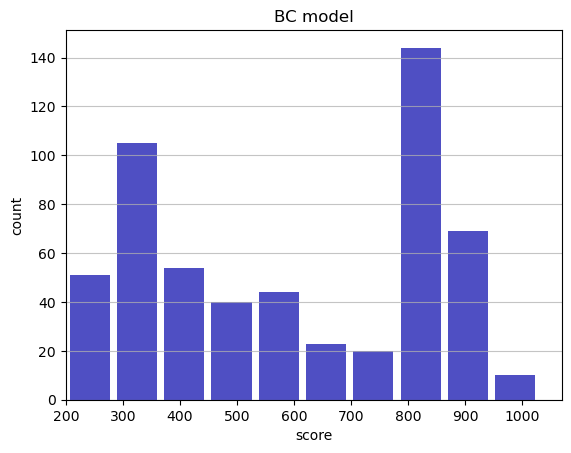

Track generation: 1200..1504 -> 304-tiles track
Epoch: 566
BC	mean: 593.37	variance: 242.22


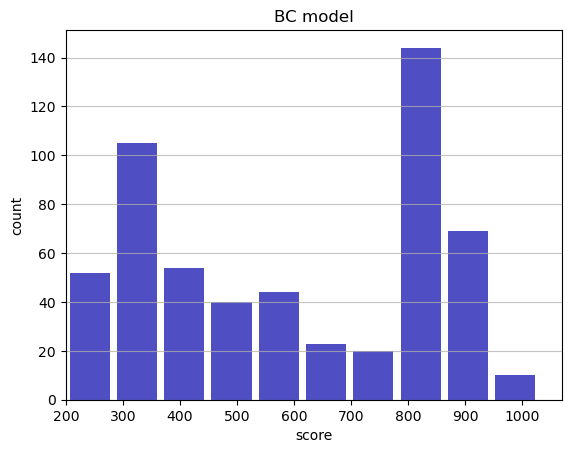

Track generation: 1124..1409 -> 285-tiles track
Epoch: 567
BC	mean: 593.21	variance: 242.04


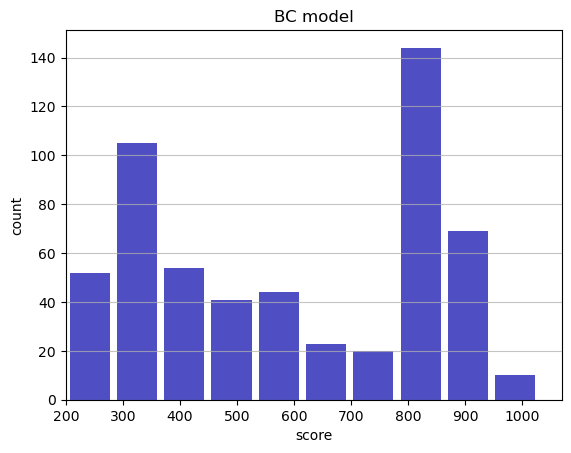

Track generation: 1273..1602 -> 329-tiles track
Epoch: 568
BC	mean: 592.71	variance: 242.11


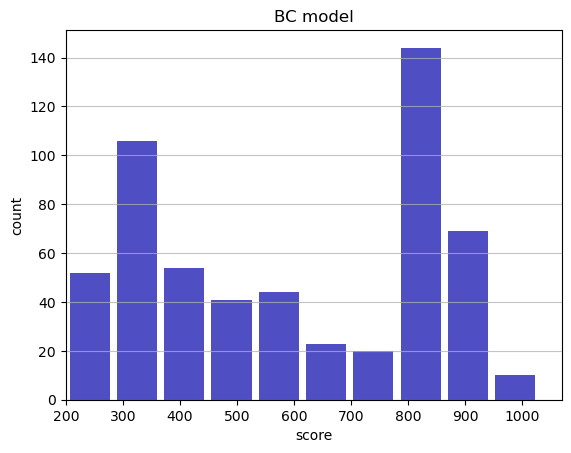

Track generation: 1451..1818 -> 367-tiles track
Epoch: 569
BC	mean: 592.95	variance: 241.97


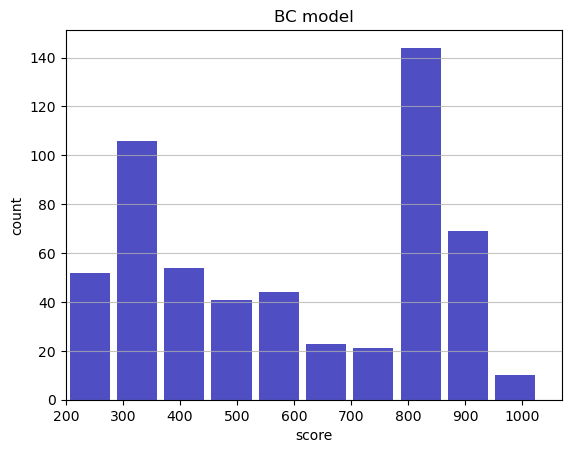

Track generation: 1202..1506 -> 304-tiles track
Epoch: 570
BC	mean: 592.64	variance: 241.87


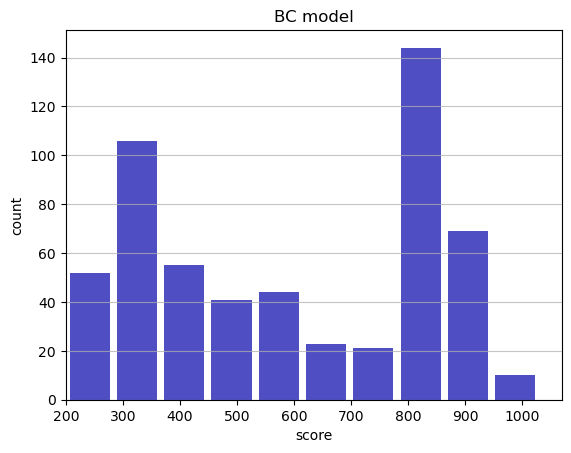

Track generation: 1025..1285 -> 260-tiles track
Epoch: 571
BC	mean: 593.08	variance: 241.89


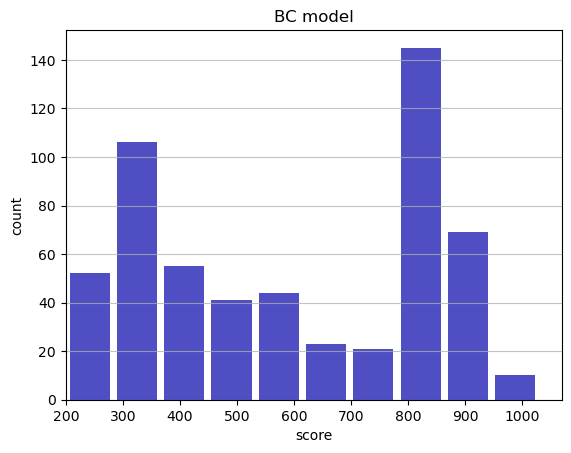

Track generation: 1076..1354 -> 278-tiles track
Epoch: 572
BC	mean: 593.03	variance: 241.68


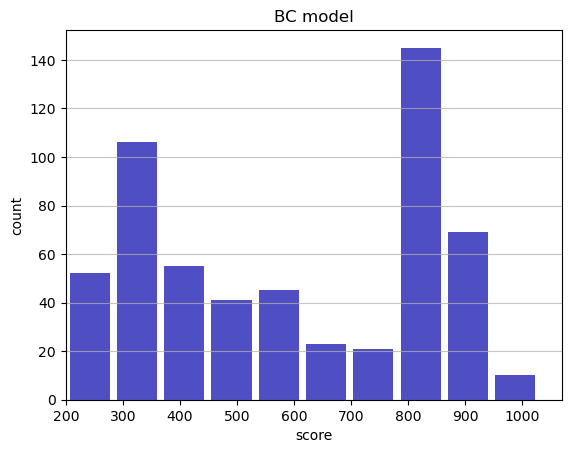

Track generation: 1226..1536 -> 310-tiles track
Epoch: 573
BC	mean: 592.68	variance: 241.61


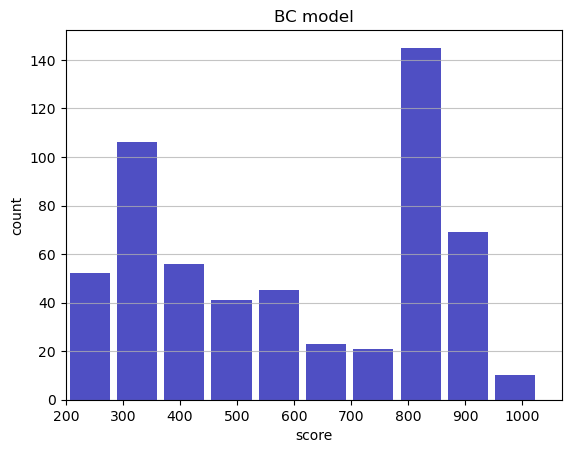

Track generation: 1265..1585 -> 320-tiles track
Epoch: 574
BC	mean: 592.14	variance: 241.75


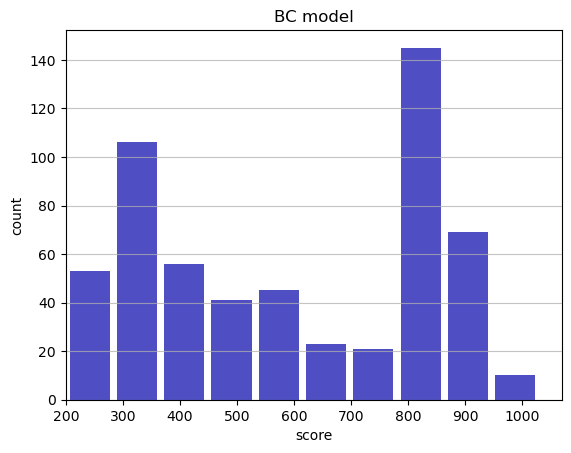

Track generation: 1028..1289 -> 261-tiles track
Epoch: 575
BC	mean: 592.50	variance: 241.70


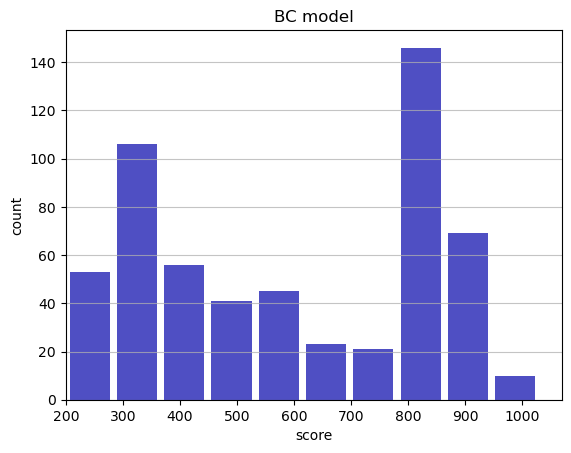

Track generation: 1188..1489 -> 301-tiles track
Epoch: 576
BC	mean: 592.89	variance: 241.67


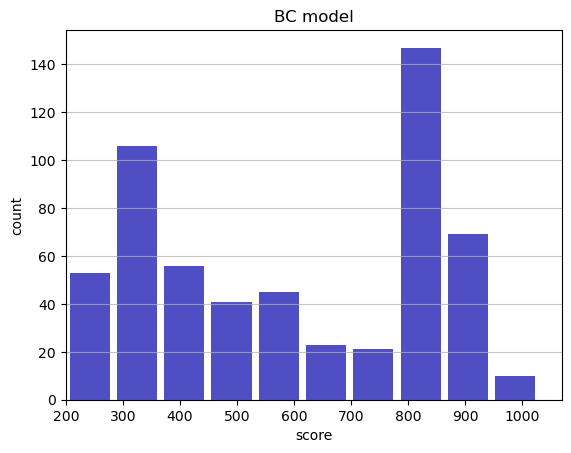

Track generation: 1147..1444 -> 297-tiles track
Epoch: 577
BC	mean: 592.76	variance: 241.48


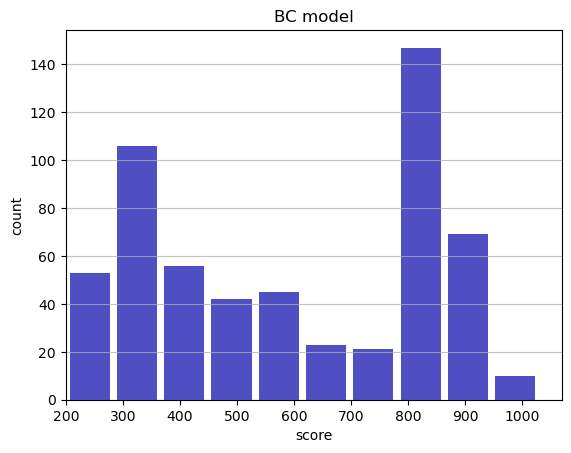

Track generation: 1149..1446 -> 297-tiles track
Epoch: 578
BC	mean: 592.42	variance: 241.41


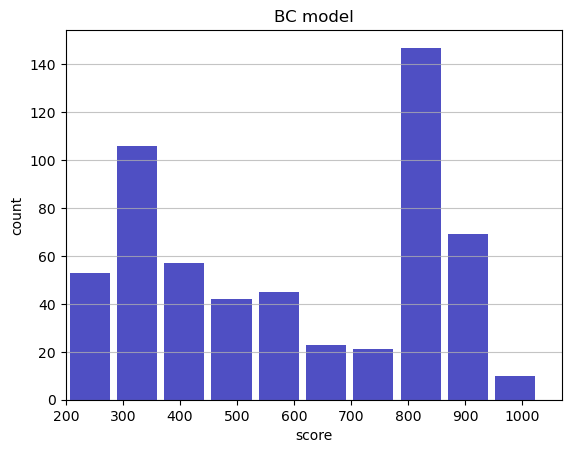

Track generation: 1254..1572 -> 318-tiles track
Epoch: 579
BC	mean: 591.86	variance: 241.58


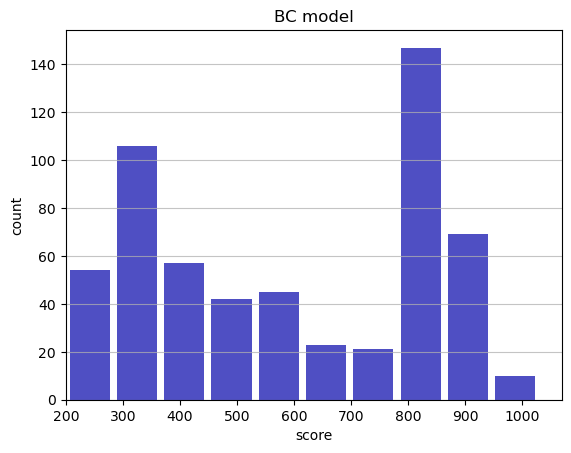

Track generation: 1124..1409 -> 285-tiles track
Epoch: 580
BC	mean: 591.39	variance: 241.63


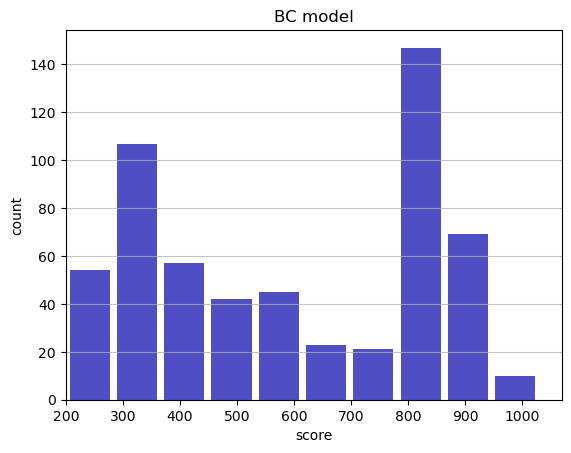

Track generation: 1156..1449 -> 293-tiles track
Epoch: 581
BC	mean: 591.79	variance: 241.62


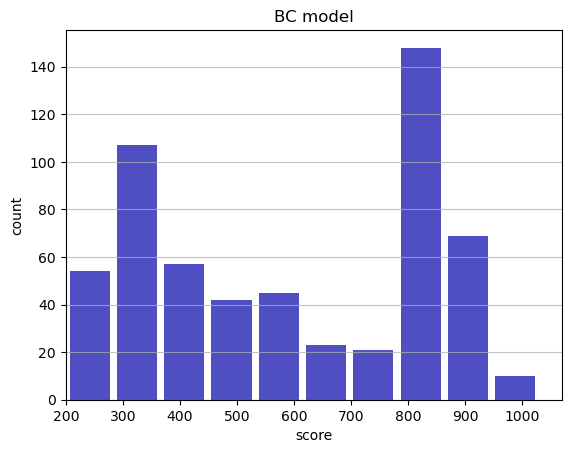

Track generation: 1005..1263 -> 258-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1247..1563 -> 316-tiles track
Epoch: 582
BC	mean: 592.40	variance: 241.85


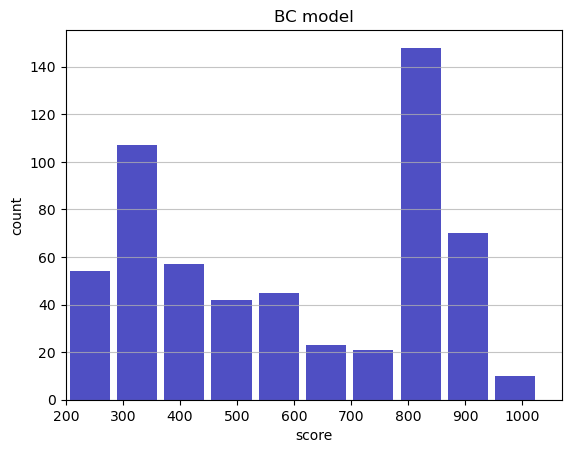

Track generation: 1331..1668 -> 337-tiles track
Epoch: 583
BC	mean: 592.42	variance: 241.65


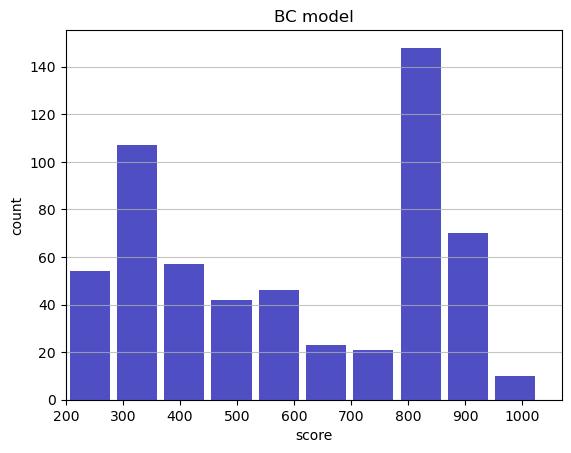

Track generation: 1087..1369 -> 282-tiles track
Epoch: 584
BC	mean: 592.78	variance: 241.60


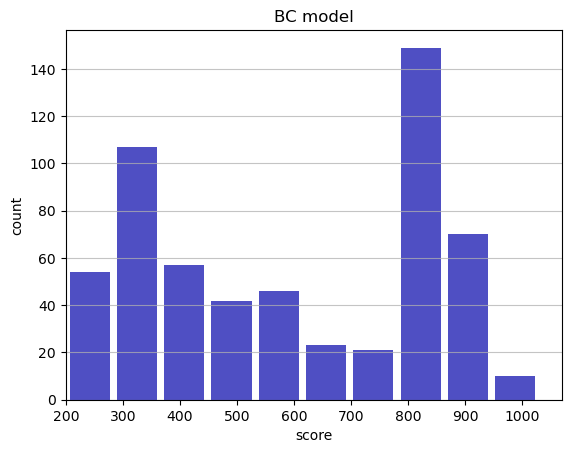

Track generation: 993..1245 -> 252-tiles track
Epoch: 585
BC	mean: 592.50	variance: 241.49


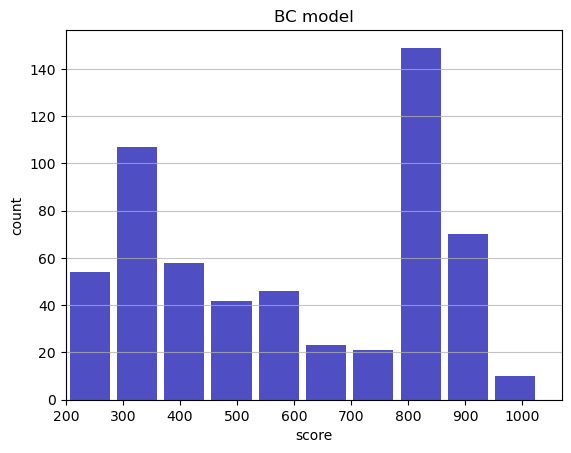

Track generation: 1095..1373 -> 278-tiles track
Epoch: 586
BC	mean: 592.41	variance: 241.29


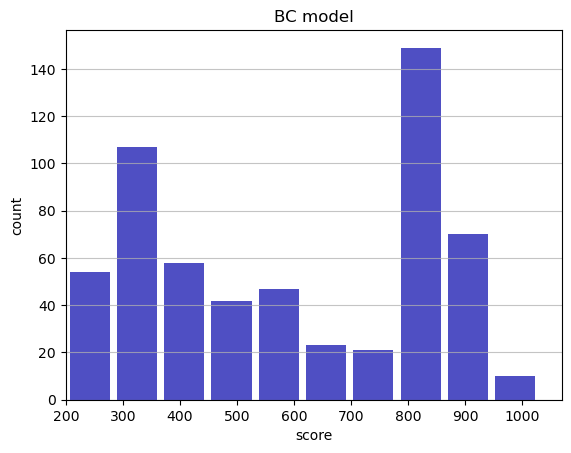

Track generation: 1226..1536 -> 310-tiles track
Epoch: 587
BC	mean: 591.98	variance: 241.31


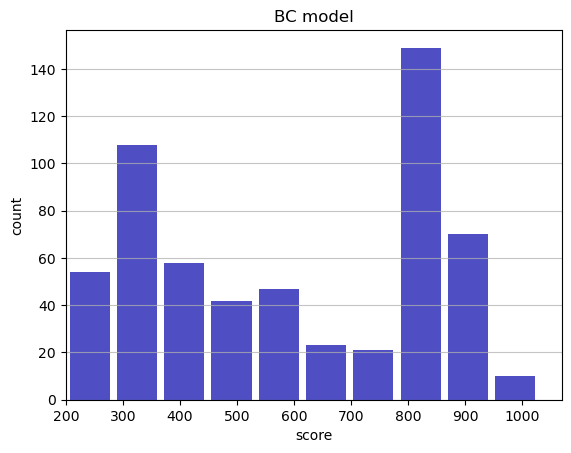

Track generation: 1002..1265 -> 263-tiles track
Epoch: 588
BC	mean: 592.41	variance: 241.32


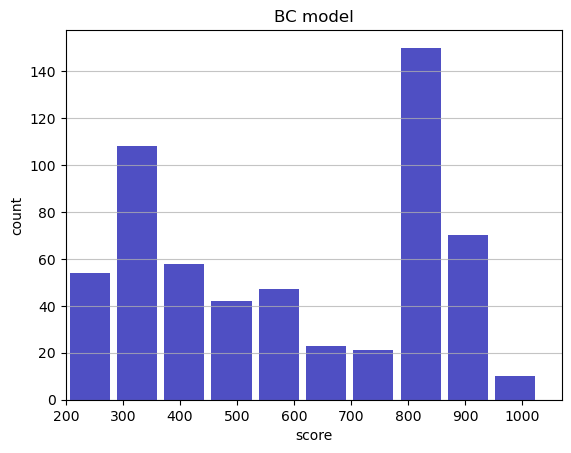

Track generation: 1160..1459 -> 299-tiles track
Epoch: 589
BC	mean: 592.83	variance: 241.34


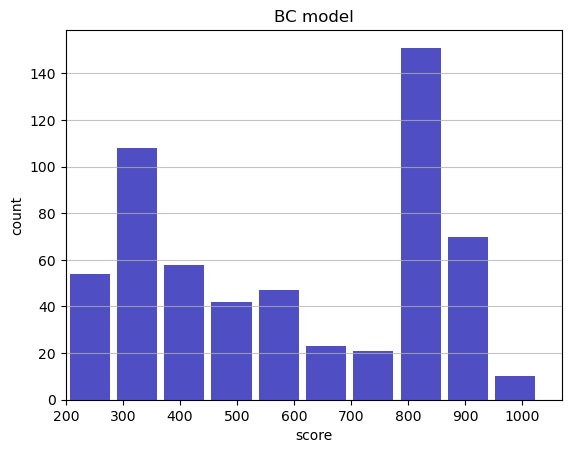

Track generation: 1167..1463 -> 296-tiles track
Epoch: 590
BC	mean: 592.79	variance: 241.14


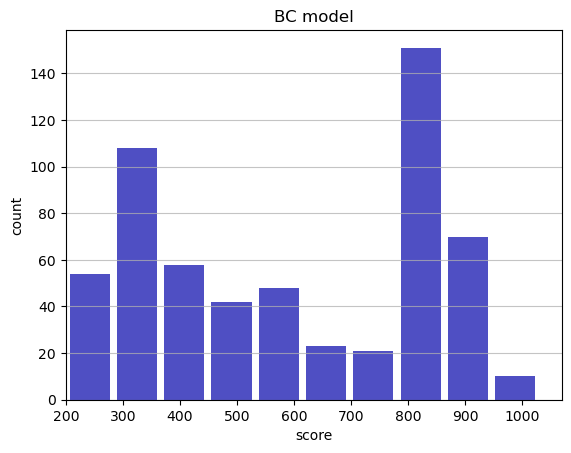

Track generation: 1096..1374 -> 278-tiles track
Epoch: 591
BC	mean: 593.23	variance: 241.17


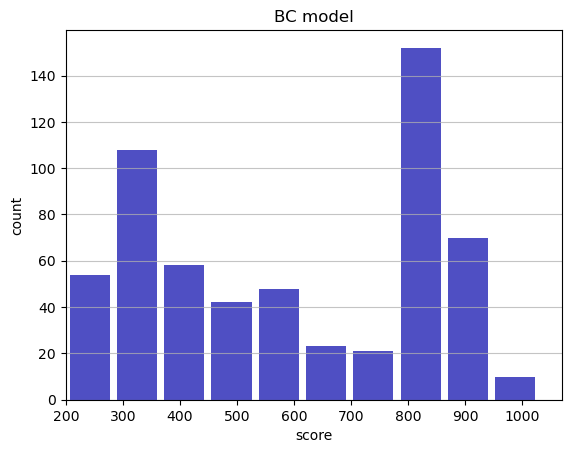

Track generation: 1146..1437 -> 291-tiles track
Epoch: 592
BC	mean: 593.18	variance: 240.97


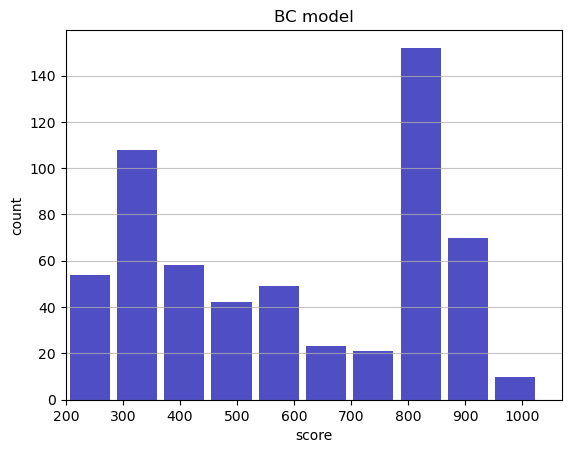

Track generation: 1212..1518 -> 306-tiles track
Epoch: 593
BC	mean: 593.28	variance: 240.78


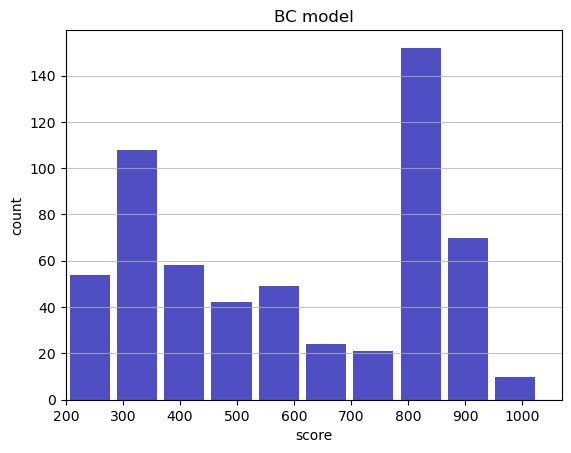

Track generation: 1107..1388 -> 281-tiles track
Epoch: 594
BC	mean: 592.83	variance: 240.82


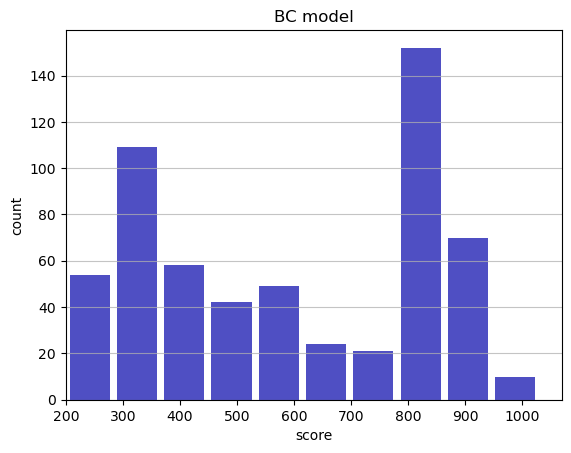

Track generation: 921..1161 -> 240-tiles track
Epoch: 595
BC	mean: 593.46	variance: 241.10


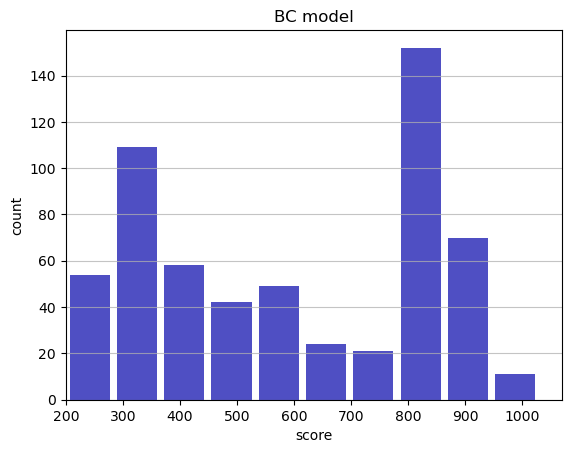

Track generation: 1038..1311 -> 273-tiles track
Epoch: 596
BC	mean: 593.91	variance: 241.15


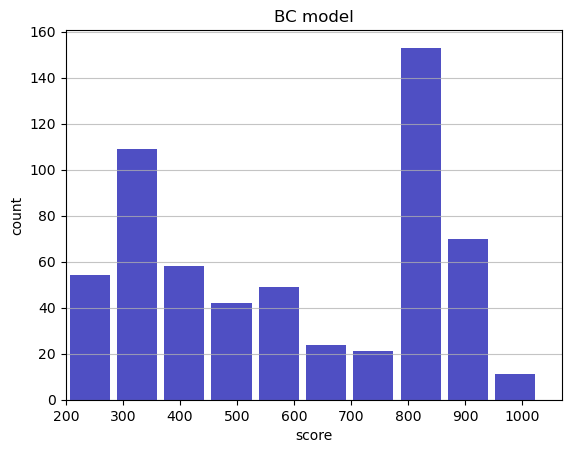

Track generation: 1264..1584 -> 320-tiles track
Epoch: 597
BC	mean: 594.25	variance: 241.09


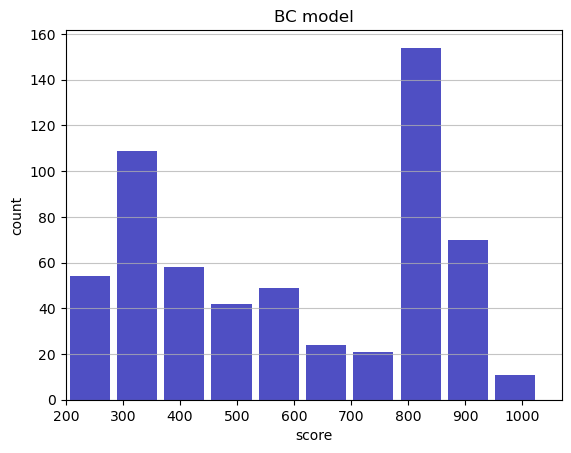

Track generation: 1159..1453 -> 294-tiles track
Epoch: 598
BC	mean: 594.31	variance: 240.89


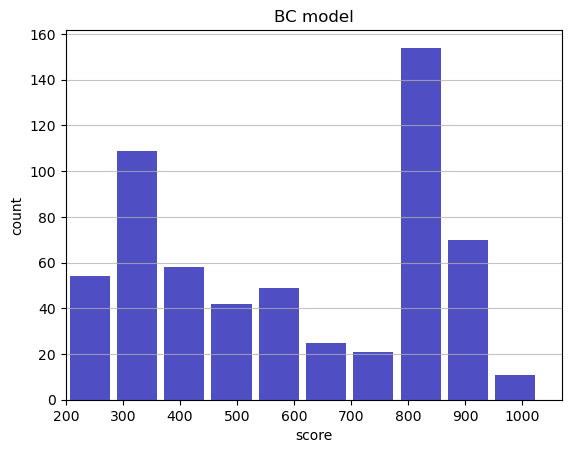

Track generation: 1105..1385 -> 280-tiles track
Epoch: 599
BC	mean: 594.71	variance: 240.89


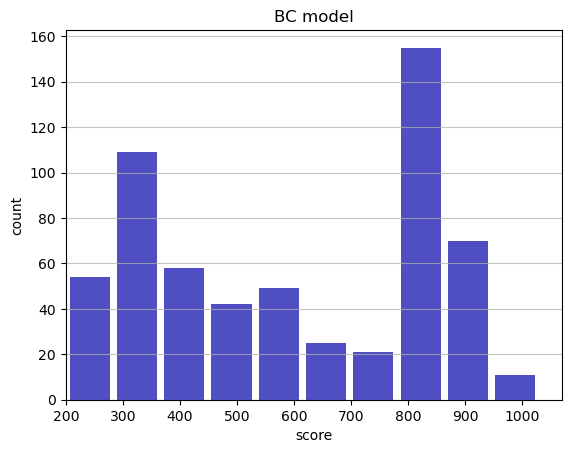

Track generation: 1242..1557 -> 315-tiles track
Epoch: 600
BC	mean: 594.15	variance: 241.07


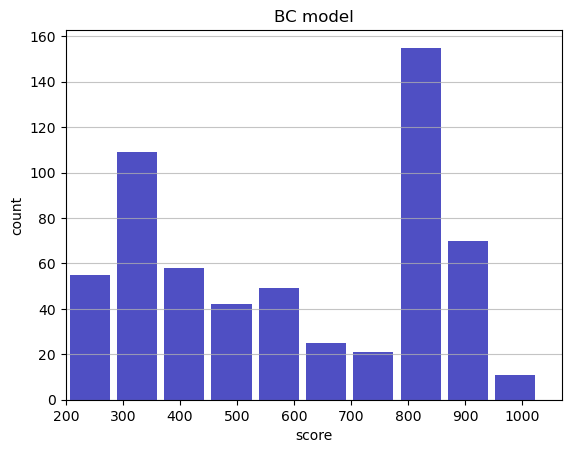

Track generation: 1419..1778 -> 359-tiles track
Epoch: 601
BC	mean: 594.17	variance: 240.87


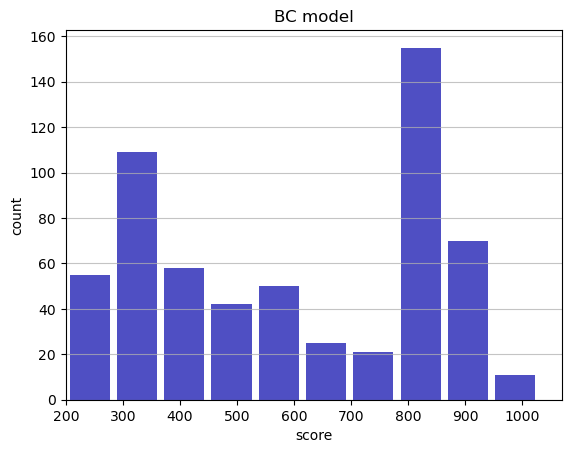

Track generation: 1052..1319 -> 267-tiles track
Epoch: 602
BC	mean: 594.54	variance: 240.84


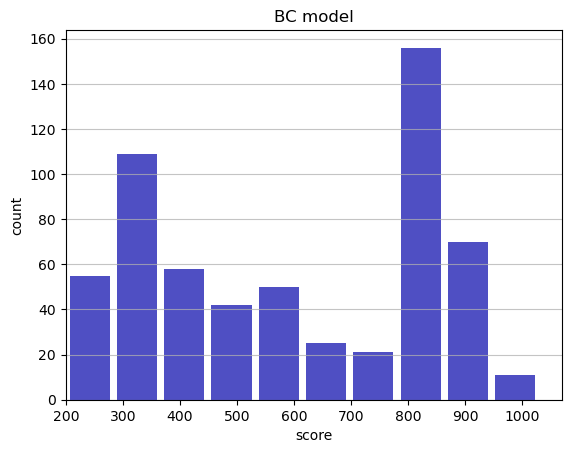

Track generation: 1171..1468 -> 297-tiles track
Epoch: 603
BC	mean: 594.88	variance: 240.79


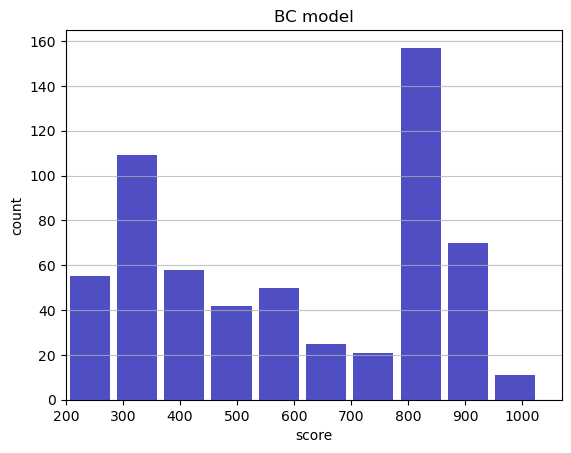

Track generation: 1252..1569 -> 317-tiles track
Epoch: 604
BC	mean: 594.38	variance: 240.91


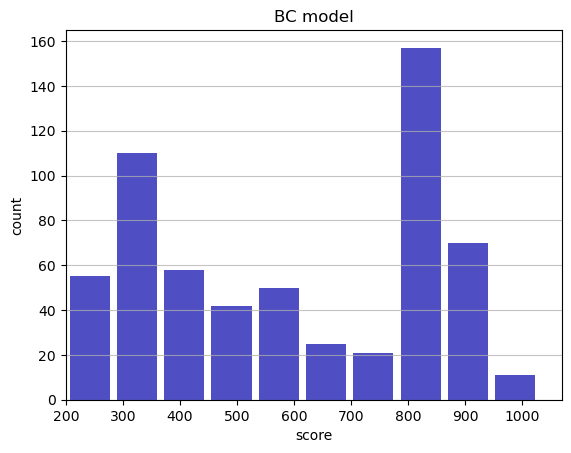

Track generation: 1127..1413 -> 286-tiles track
Epoch: 605
BC	mean: 594.80	variance: 240.93


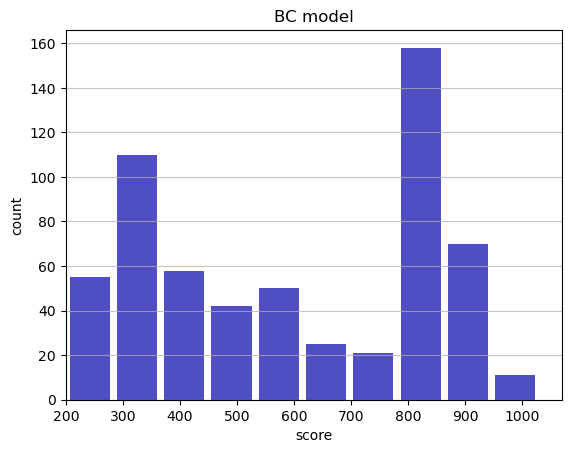

Track generation: 1121..1405 -> 284-tiles track
Epoch: 606
BC	mean: 594.51	variance: 240.83


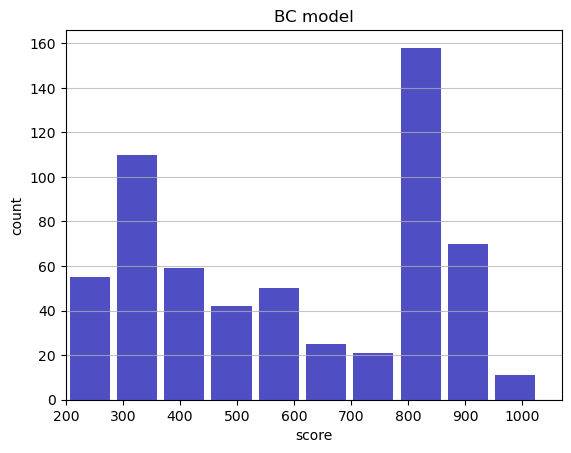

Track generation: 1289..1615 -> 326-tiles track
Epoch: 607
BC	mean: 593.87	variance: 241.15


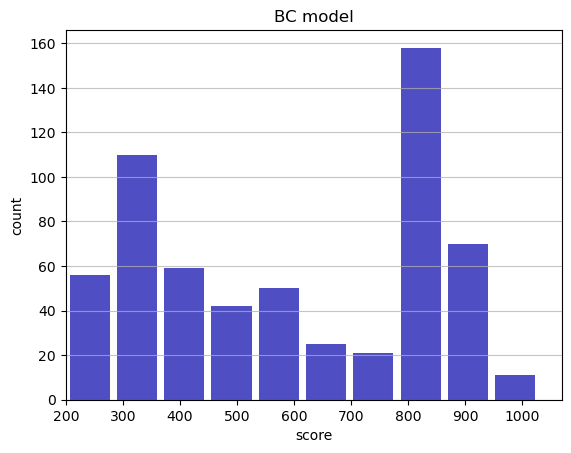

Track generation: 1071..1343 -> 272-tiles track
Epoch: 608
BC	mean: 593.44	variance: 241.19


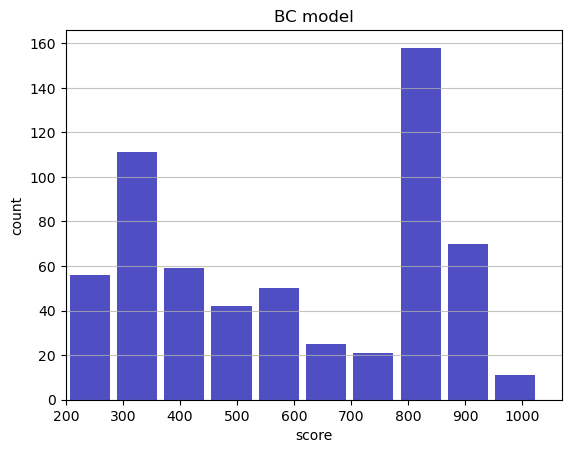

Track generation: 1210..1517 -> 307-tiles track
Epoch: 609
BC	mean: 592.95	variance: 241.29


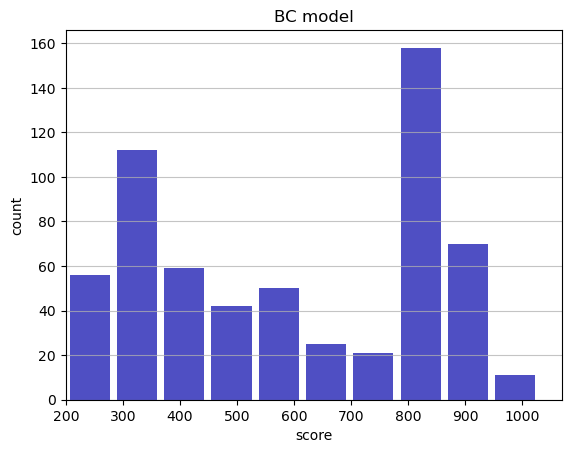

Track generation: 1111..1395 -> 284-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1150..1442 -> 292-tiles track
Epoch: 610
BC	mean: 593.46	variance: 241.43


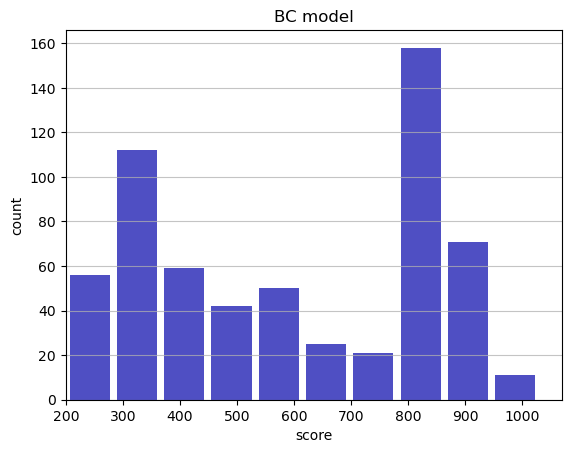

Track generation: 1101..1380 -> 279-tiles track
Epoch: 611
BC	mean: 593.09	variance: 241.40


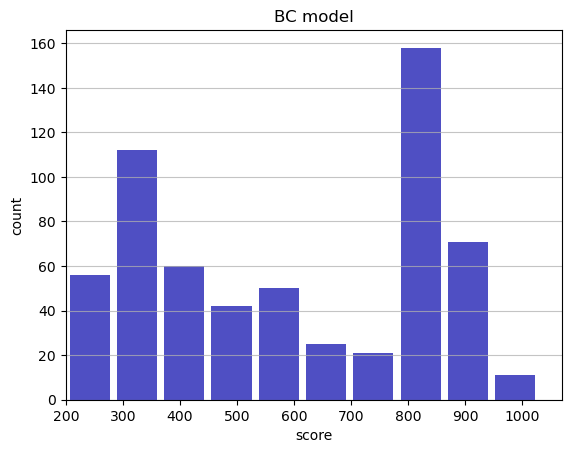

Track generation: 1062..1332 -> 270-tiles track
Epoch: 612
BC	mean: 593.56	variance: 241.47


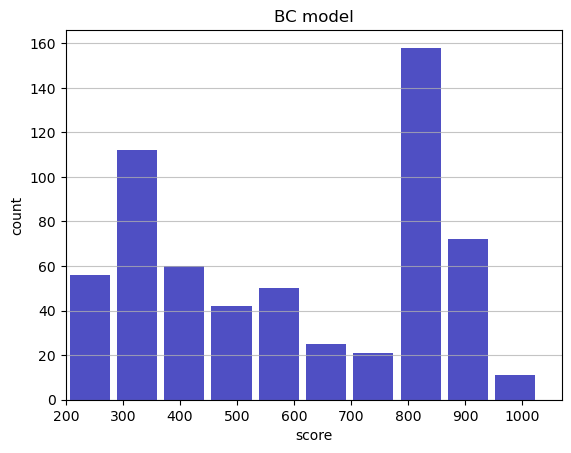

Track generation: 1059..1335 -> 276-tiles track
Epoch: 613
BC	mean: 593.12	variance: 241.52


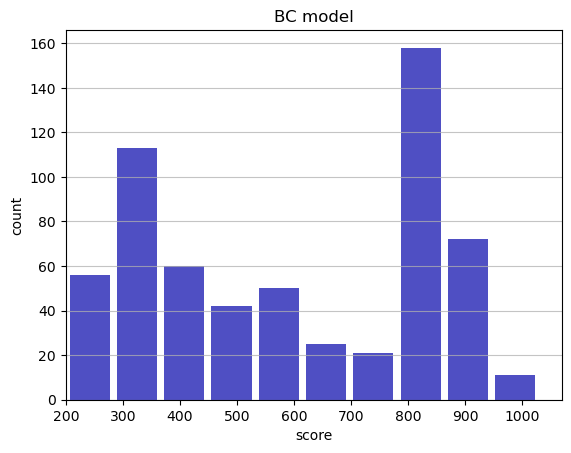

Track generation: 1259..1586 -> 327-tiles track
Epoch: 614
BC	mean: 593.44	variance: 241.45


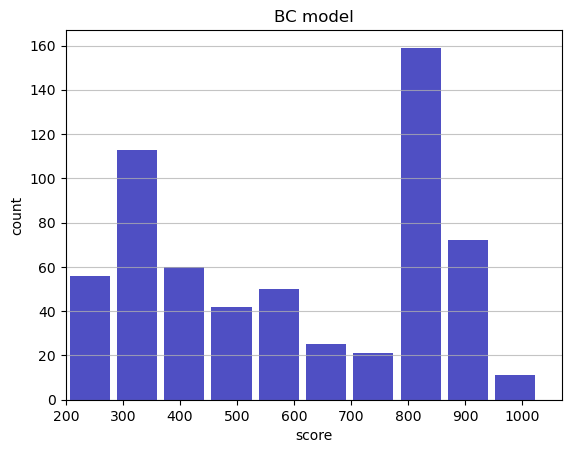

Track generation: 1100..1381 -> 281-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 974..1228 -> 254-tiles track
Epoch: 615
BC	mean: 593.40	variance: 241.26


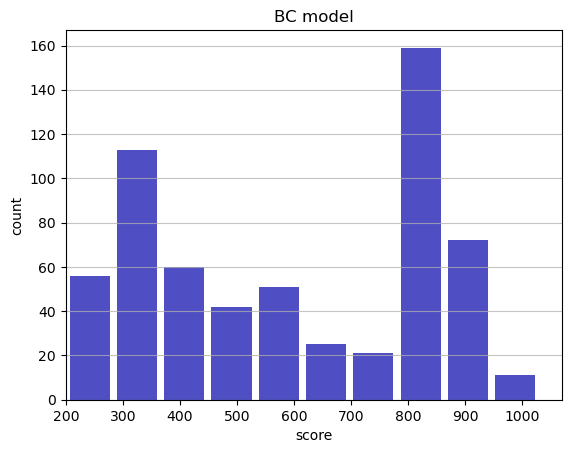

Track generation: 1260..1579 -> 319-tiles track
Epoch: 616
BC	mean: 592.94	variance: 241.33


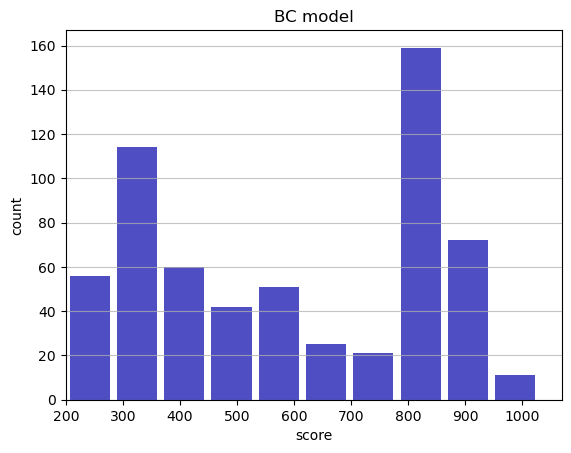

Track generation: 1277..1601 -> 324-tiles track
Epoch: 617
BC	mean: 593.50	variance: 241.53


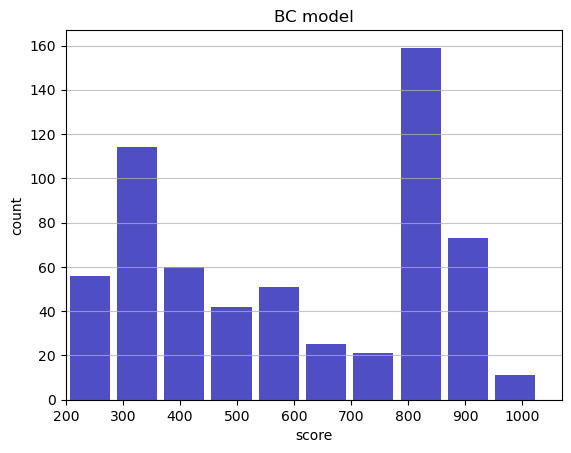

Track generation: 1155..1448 -> 293-tiles track
Epoch: 618
BC	mean: 593.57	variance: 241.34


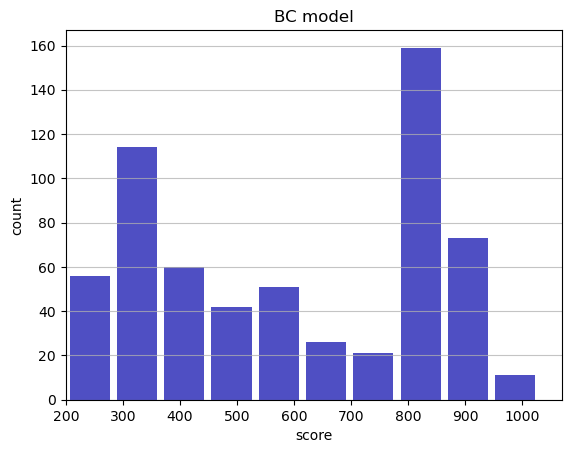

Track generation: 1152..1444 -> 292-tiles track
Epoch: 619
BC	mean: 593.71	variance: 241.17


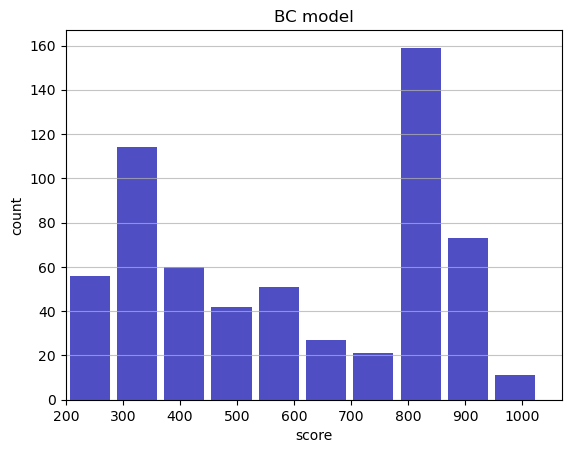

Track generation: 1144..1434 -> 290-tiles track
Epoch: 620
BC	mean: 593.37	variance: 241.13


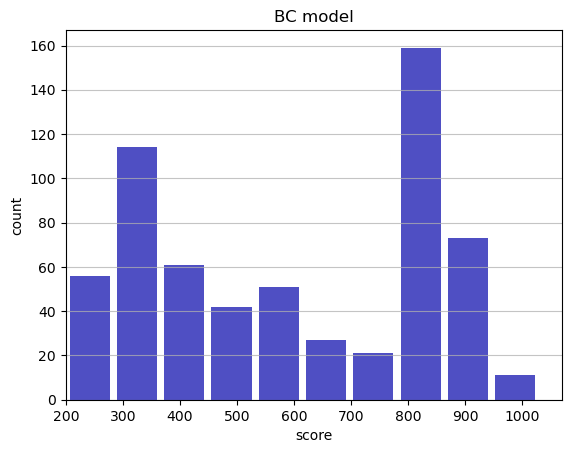

Track generation: 1147..1438 -> 291-tiles track
Epoch: 621
BC	mean: 593.57	variance: 240.98


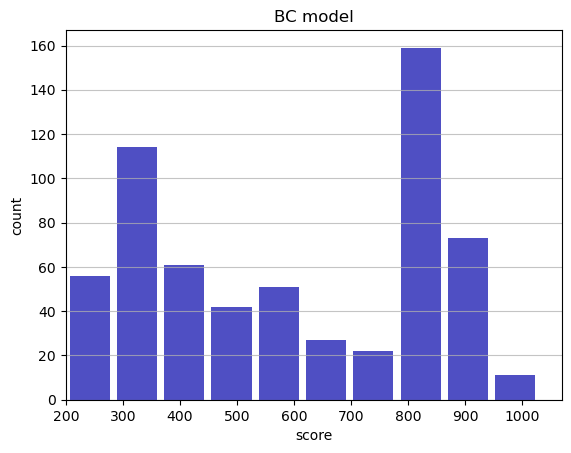

Track generation: 1211..1518 -> 307-tiles track
Epoch: 622
BC	mean: 593.11	variance: 241.06


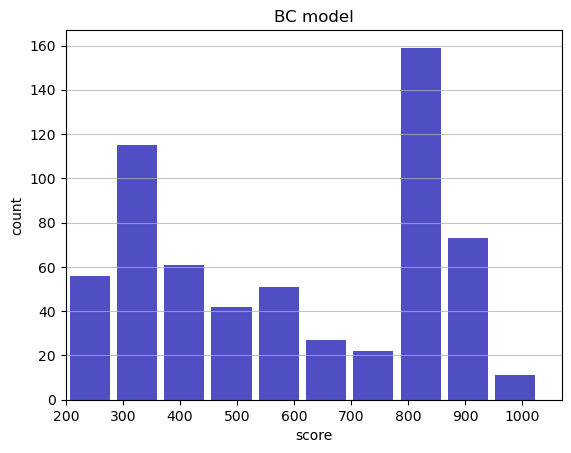

Track generation: 1137..1435 -> 298-tiles track
Epoch: 623
BC	mean: 592.90	variance: 240.92


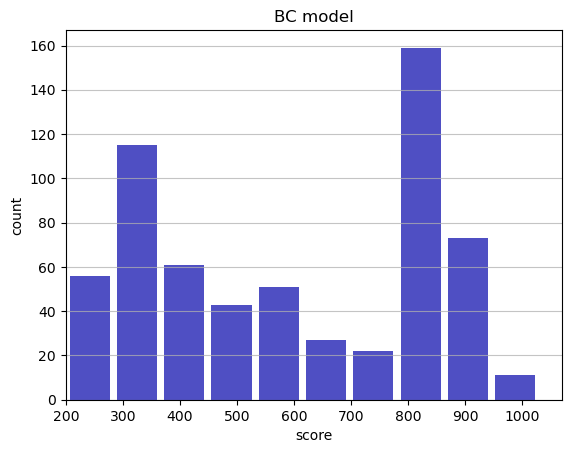

Track generation: 1188..1489 -> 301-tiles track
Epoch: 624
BC	mean: 592.38	variance: 241.08


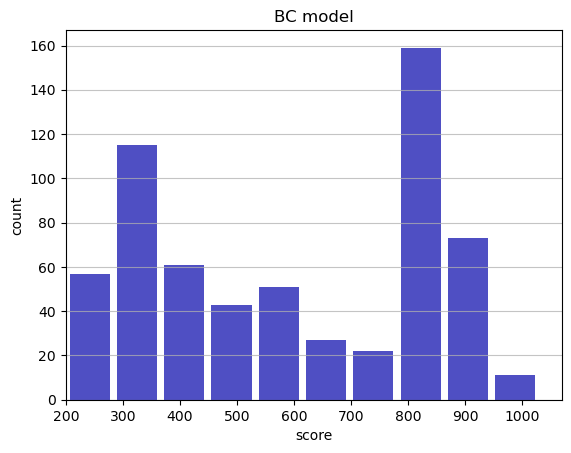

Track generation: 1016..1274 -> 258-tiles track
Epoch: 625
BC	mean: 592.02	variance: 241.05


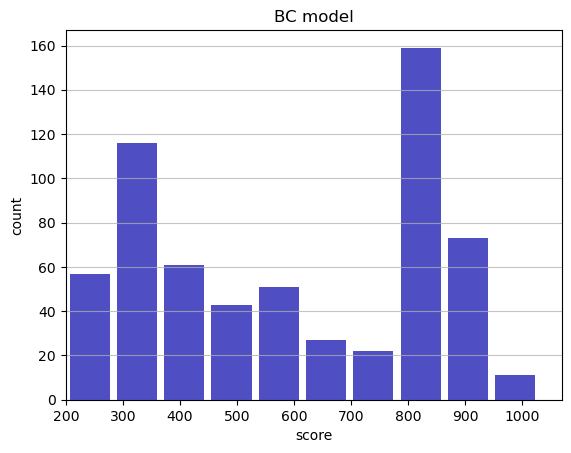

Track generation: 1200..1504 -> 304-tiles track
Epoch: 626
BC	mean: 592.42	variance: 241.07


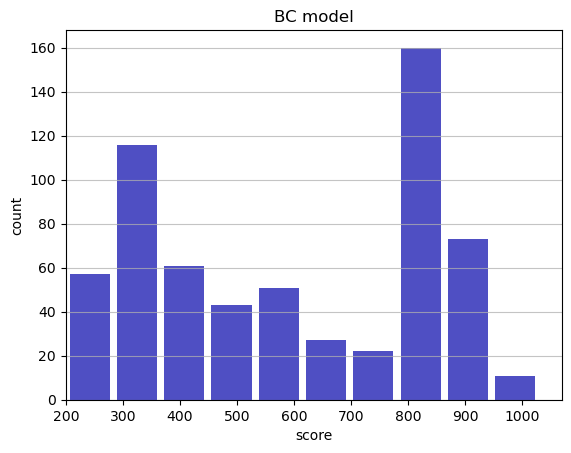

Track generation: 1116..1399 -> 283-tiles track
Epoch: 627
BC	mean: 592.76	variance: 241.03


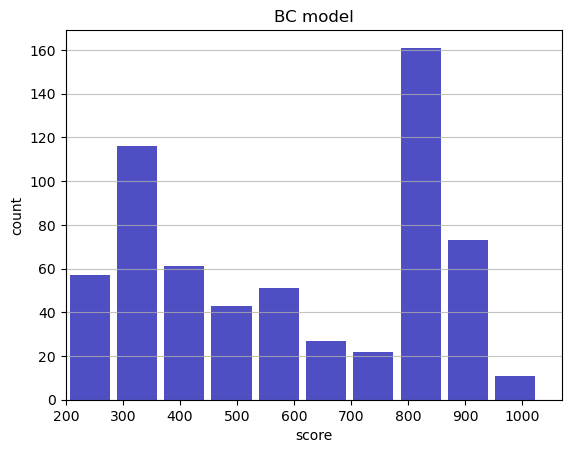

Track generation: 1103..1389 -> 286-tiles track
Epoch: 628
BC	mean: 592.68	variance: 240.85


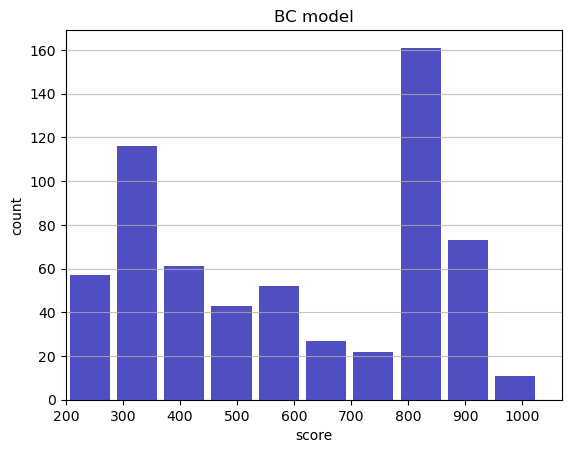

Track generation: 1064..1334 -> 270-tiles track
Epoch: 629
BC	mean: 593.09	variance: 240.89


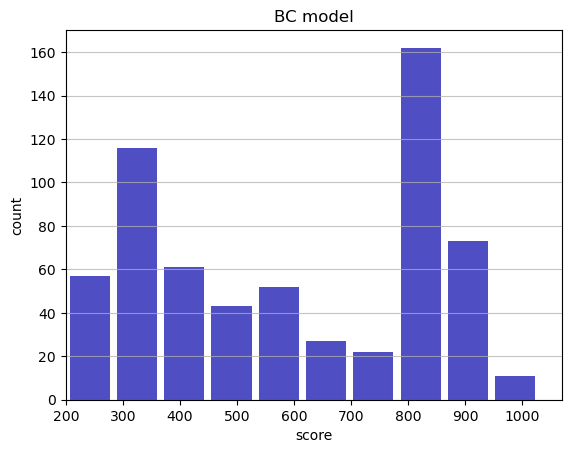

Track generation: 981..1234 -> 253-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1119..1403 -> 284-tiles track
Epoch: 630
BC	mean: 593.50	variance: 240.92


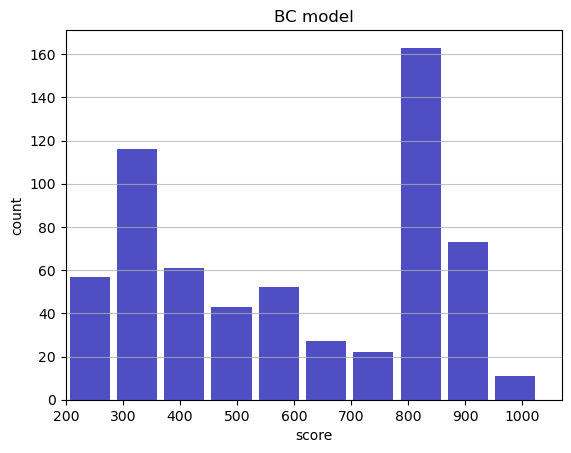

Track generation: 1147..1438 -> 291-tiles track
Epoch: 631
BC	mean: 593.94	variance: 240.97


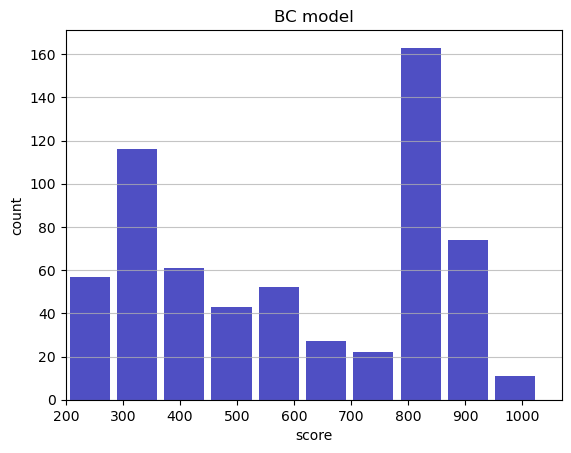

Track generation: 1080..1354 -> 274-tiles track
Epoch: 632
BC	mean: 593.57	variance: 240.95


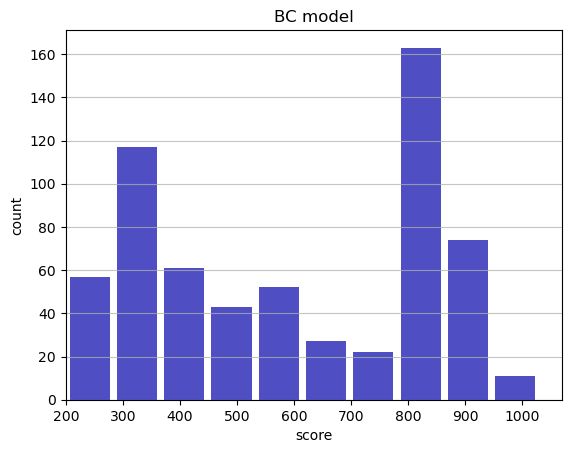

Track generation: 1055..1323 -> 268-tiles track
Epoch: 633
BC	mean: 593.95	variance: 240.96


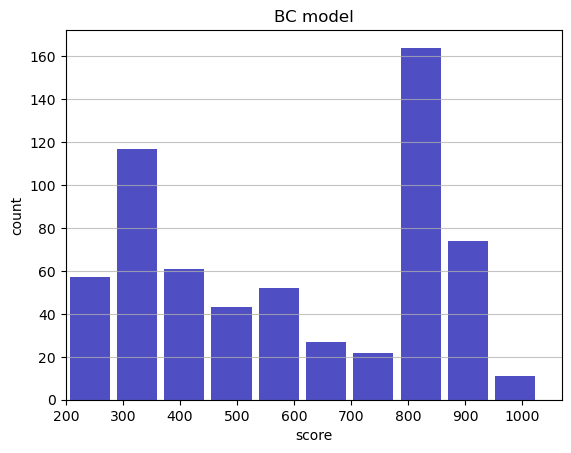

Track generation: 1211..1518 -> 307-tiles track
Epoch: 634
BC	mean: 593.98	variance: 240.77


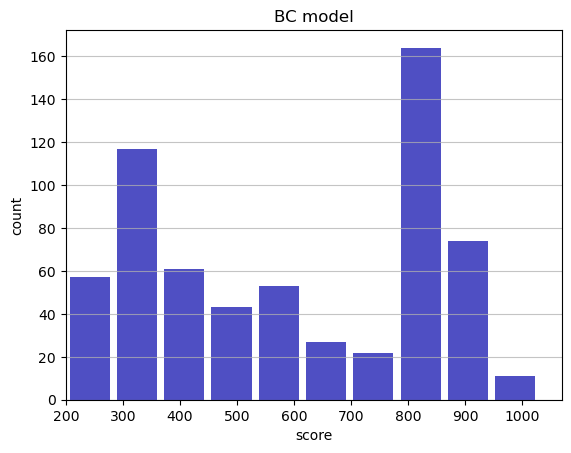

Track generation: 1106..1396 -> 290-tiles track
Epoch: 635
BC	mean: 593.73	variance: 240.66


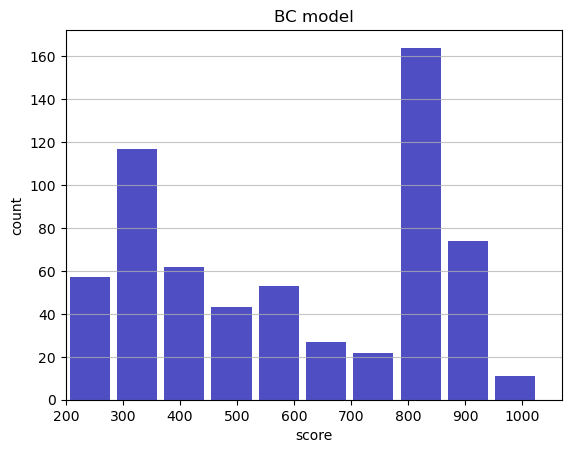

Track generation: 1279..1603 -> 324-tiles track
Epoch: 636
BC	mean: 594.34	variance: 240.96


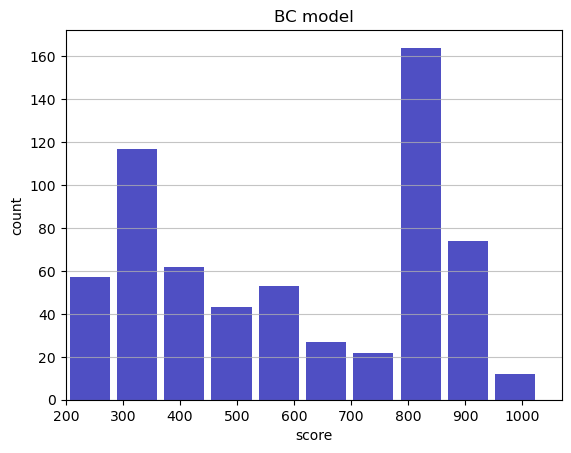

Track generation: 1196..1499 -> 303-tiles track
Epoch: 637
BC	mean: 594.75	variance: 241.00


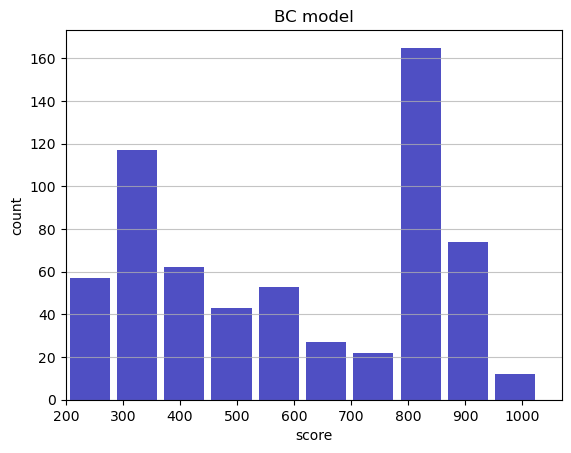

Track generation: 1070..1342 -> 272-tiles track
Epoch: 638
BC	mean: 594.41	variance: 240.96


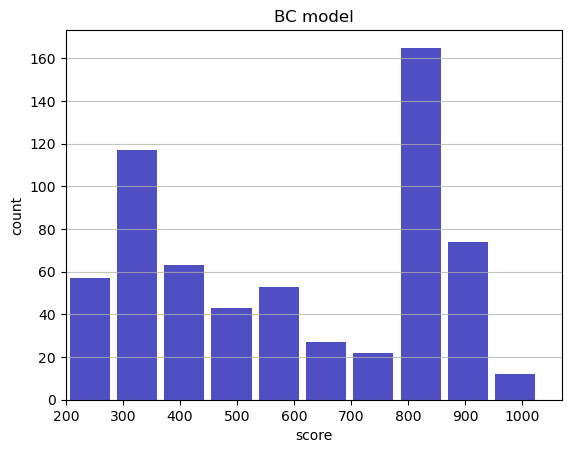

Track generation: 1159..1453 -> 294-tiles track
Epoch: 639
BC	mean: 594.16	variance: 240.86


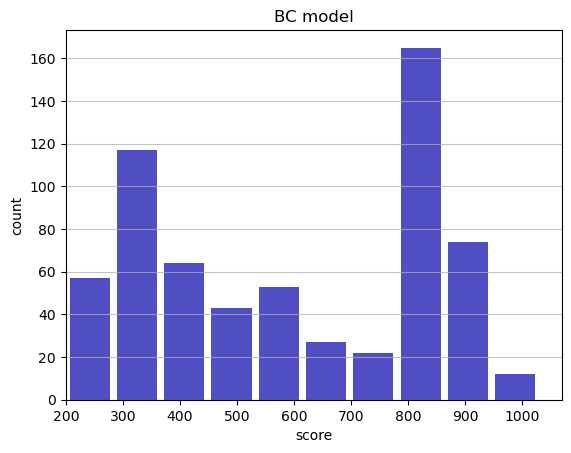

Track generation: 972..1219 -> 247-tiles track
Epoch: 640
BC	mean: 594.49	variance: 240.82


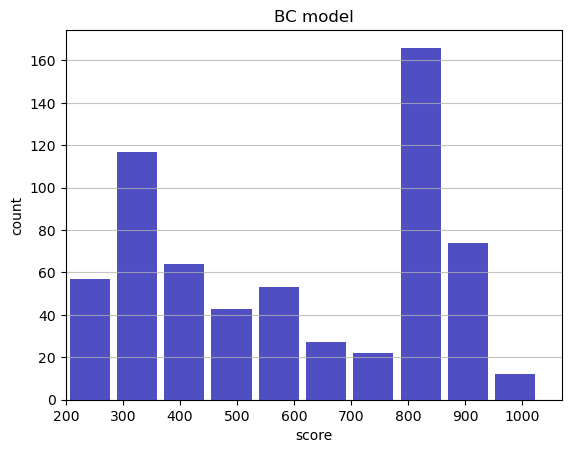

Track generation: 1075..1348 -> 273-tiles track
Epoch: 641
BC	mean: 594.66	variance: 240.67


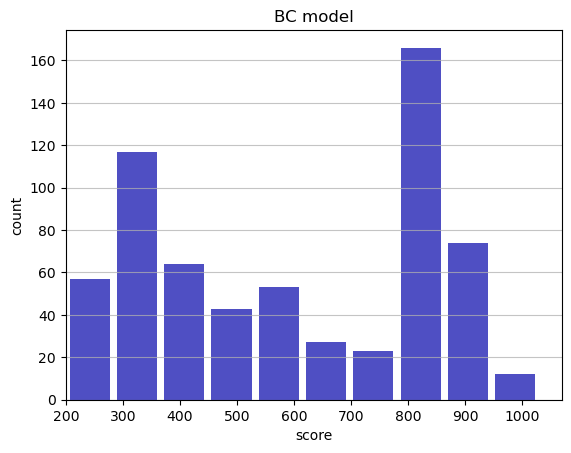

Track generation: 987..1238 -> 251-tiles track
Epoch: 642
BC	mean: 594.28	variance: 240.68


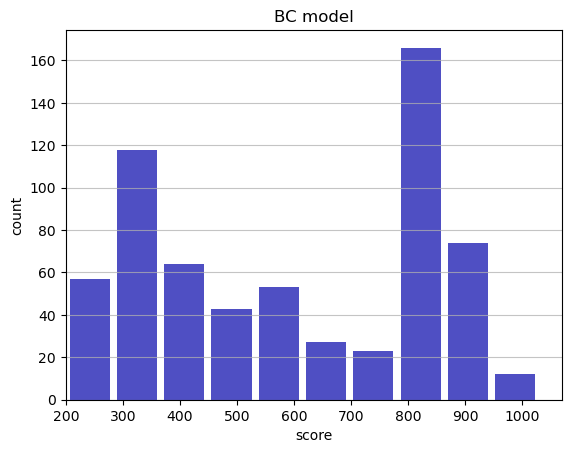

Track generation: 1115..1402 -> 287-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1115..1398 -> 283-tiles track
Epoch: 643
BC	mean: 594.66	variance: 240.68


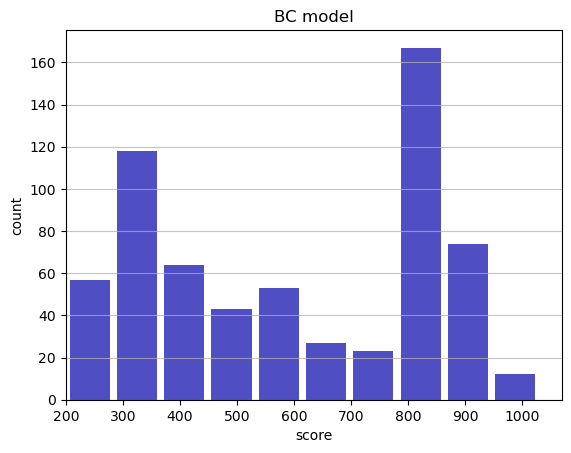

Track generation: 1132..1419 -> 287-tiles track
Epoch: 644
BC	mean: 594.75	variance: 240.50


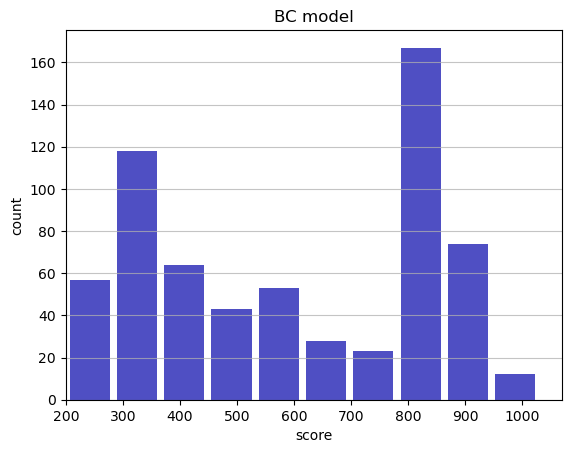

Track generation: 1060..1329 -> 269-tiles track
Epoch: 645
BC	mean: 594.42	variance: 240.47


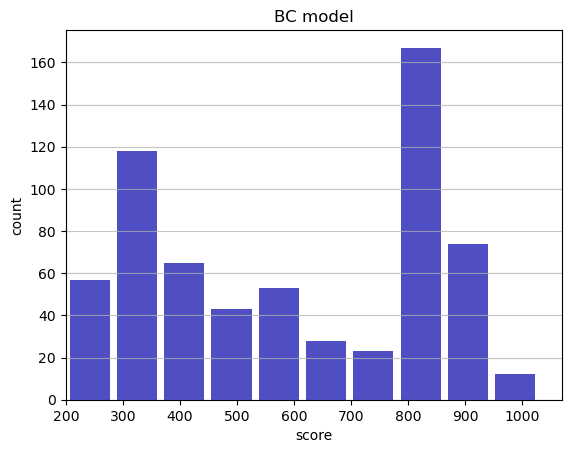

Track generation: 1184..1485 -> 301-tiles track
Epoch: 646
BC	mean: 594.07	variance: 240.44


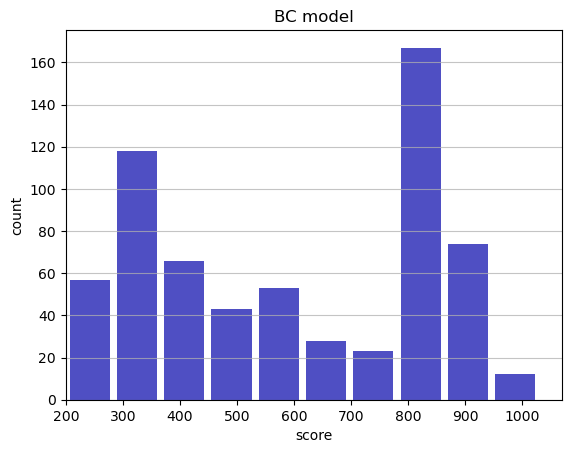

Track generation: 1248..1564 -> 316-tiles track
Epoch: 647
BC	mean: 594.62	variance: 240.66


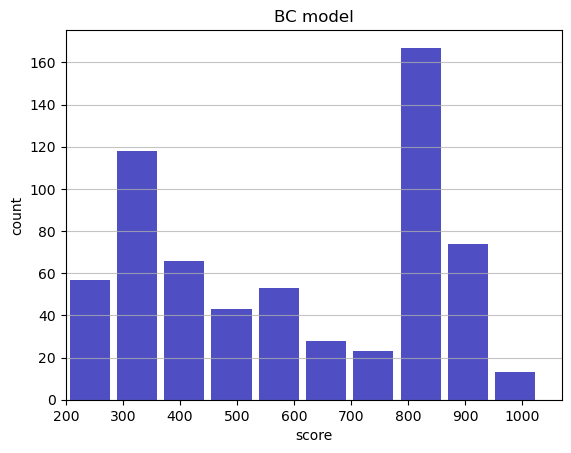

Track generation: 1097..1375 -> 278-tiles track
Epoch: 648
BC	mean: 595.05	variance: 240.73


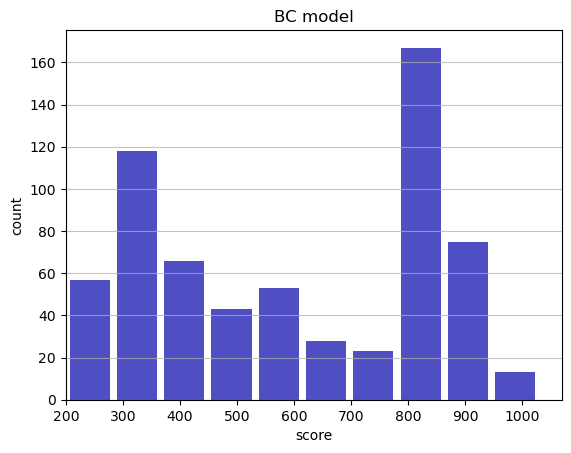

Track generation: 1064..1334 -> 270-tiles track
Epoch: 649
BC	mean: 595.48	variance: 240.79


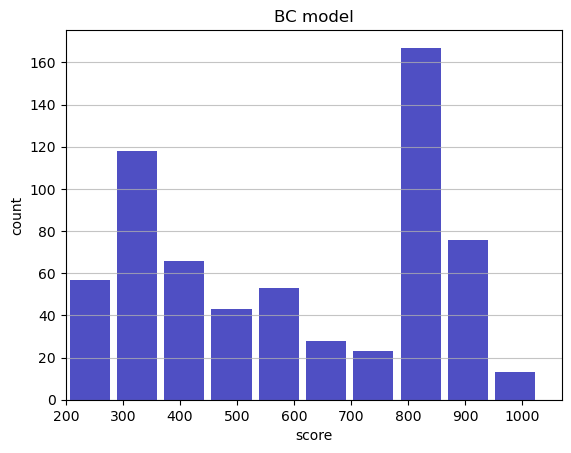

Track generation: 1151..1443 -> 292-tiles track
Epoch: 650
BC	mean: 595.89	variance: 240.83


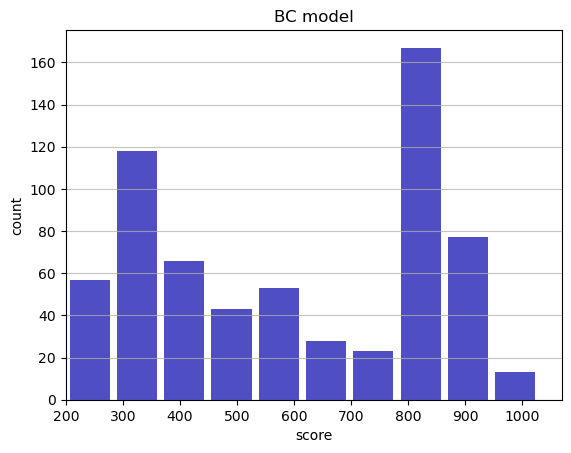

Track generation: 1221..1531 -> 310-tiles track
Epoch: 651
BC	mean: 595.67	variance: 240.71


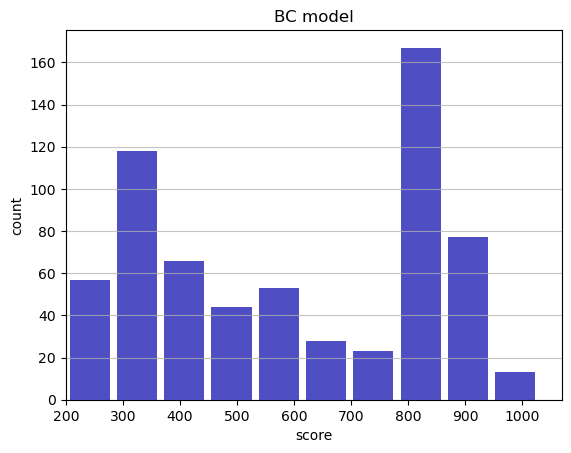

Track generation: 1167..1463 -> 296-tiles track
Epoch: 652
BC	mean: 595.26	variance: 240.75


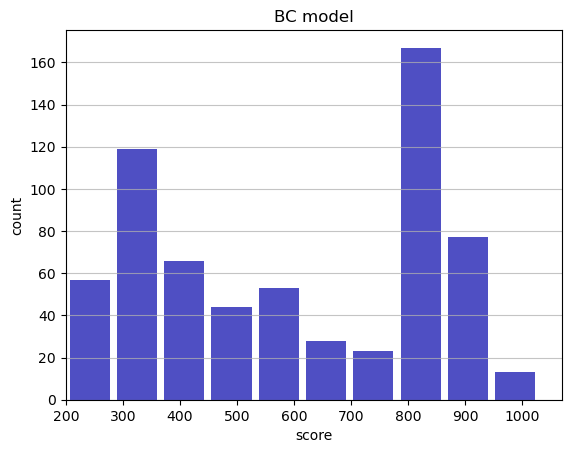

Track generation: 1120..1404 -> 284-tiles track
Epoch: 653
BC	mean: 594.91	variance: 240.73


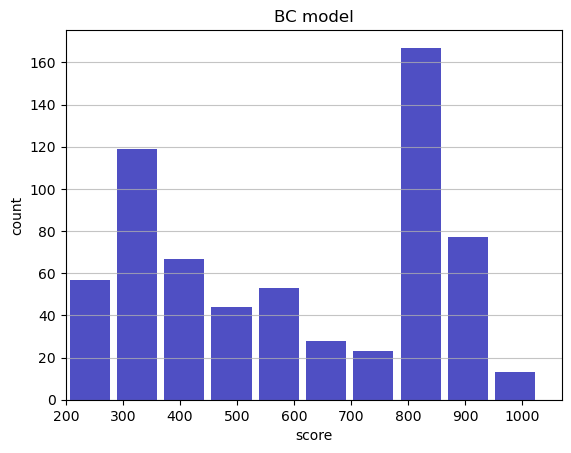

Track generation: 1231..1548 -> 317-tiles track
Epoch: 654
BC	mean: 594.51	variance: 240.76


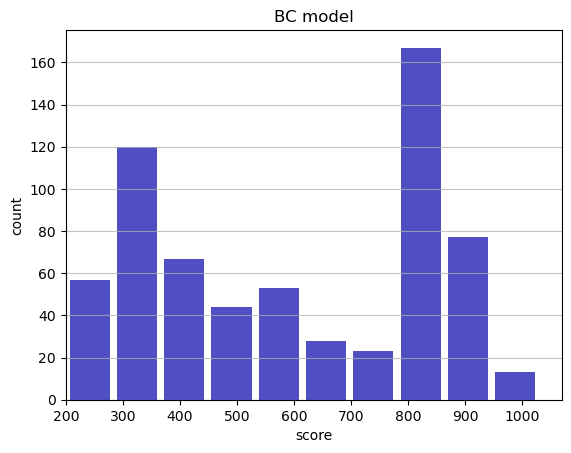

Track generation: 1085..1360 -> 275-tiles track
Epoch: 655
BC	mean: 594.18	variance: 240.73


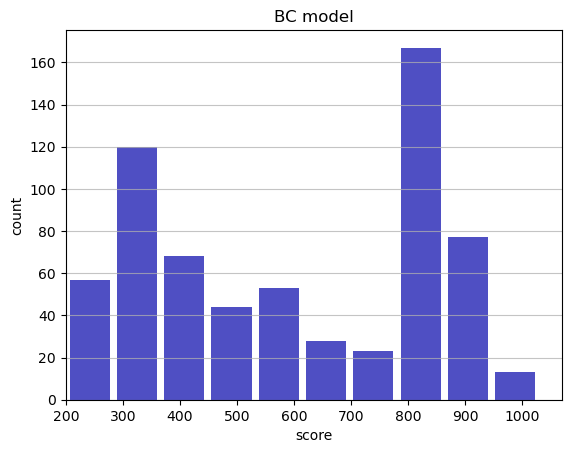

Track generation: 1047..1319 -> 272-tiles track
Epoch: 656
BC	mean: 594.37	variance: 240.59


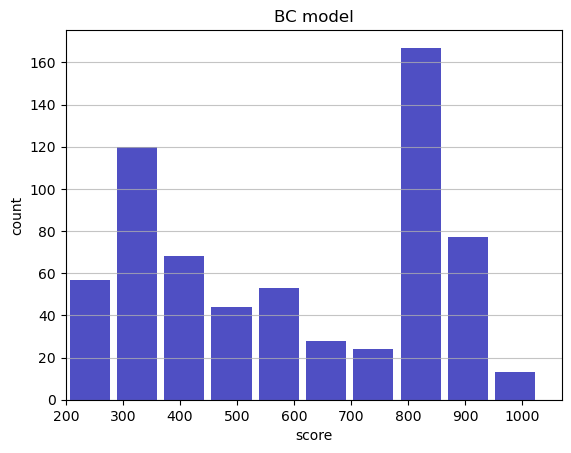

Track generation: 1053..1320 -> 267-tiles track
Epoch: 657
BC	mean: 594.79	variance: 240.65


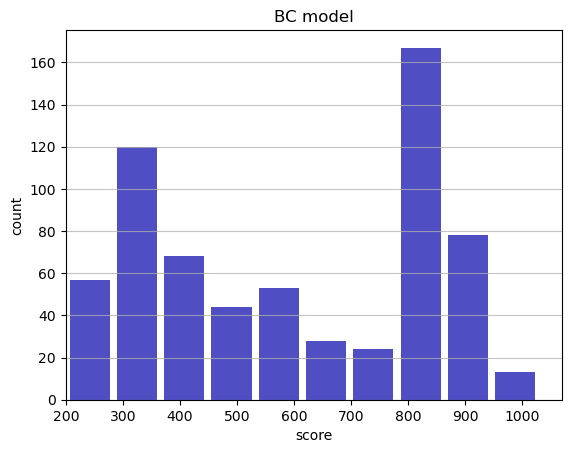

Track generation: 1103..1389 -> 286-tiles track
Epoch: 658
BC	mean: 594.59	variance: 240.52


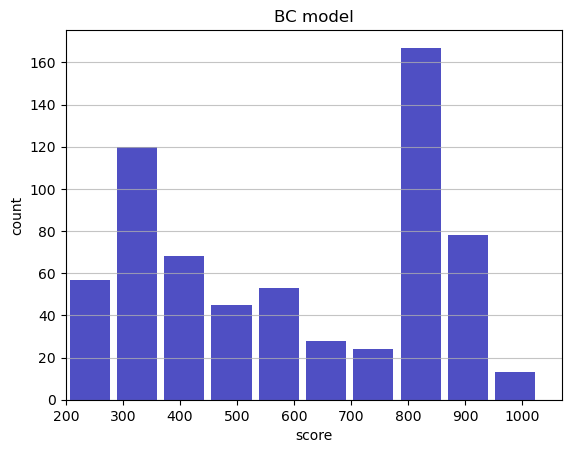

Track generation: 993..1255 -> 262-tiles track
Epoch: 659
BC	mean: 594.99	variance: 240.56


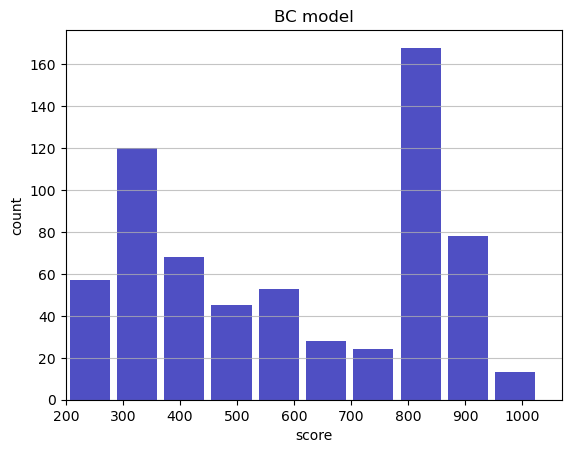

Track generation: 1288..1614 -> 326-tiles track
Epoch: 660
BC	mean: 595.12	variance: 240.40


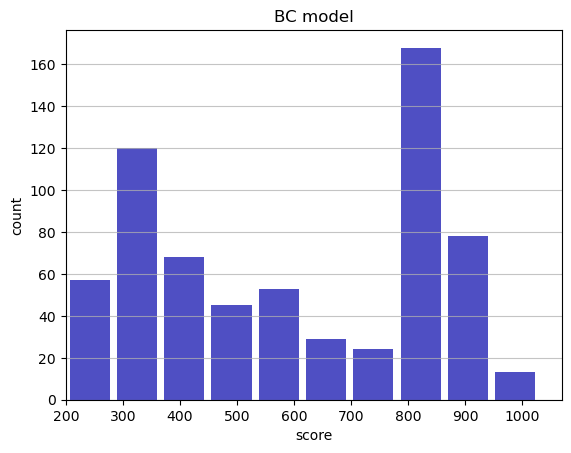

Track generation: 980..1234 -> 254-tiles track
Epoch: 661
BC	mean: 594.81	variance: 240.35


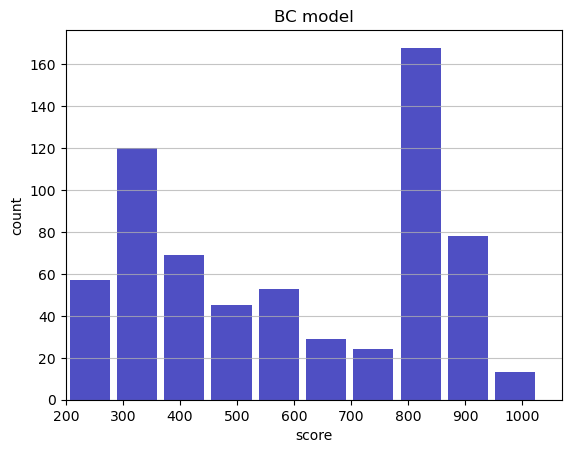

Track generation: 935..1179 -> 244-tiles track
Epoch: 662
BC	mean: 595.09	variance: 240.27


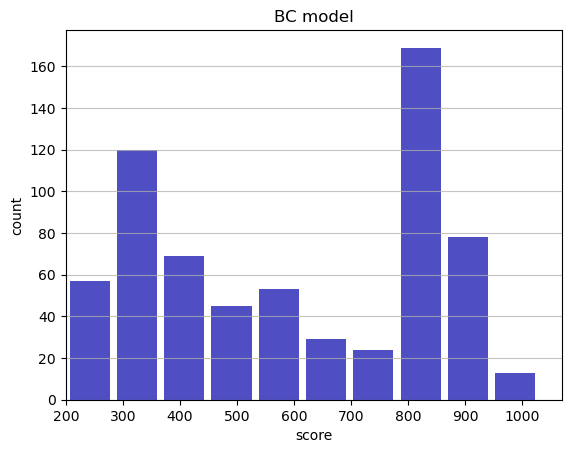

Track generation: 1069..1341 -> 272-tiles track
Epoch: 663
BC	mean: 595.52	variance: 240.34


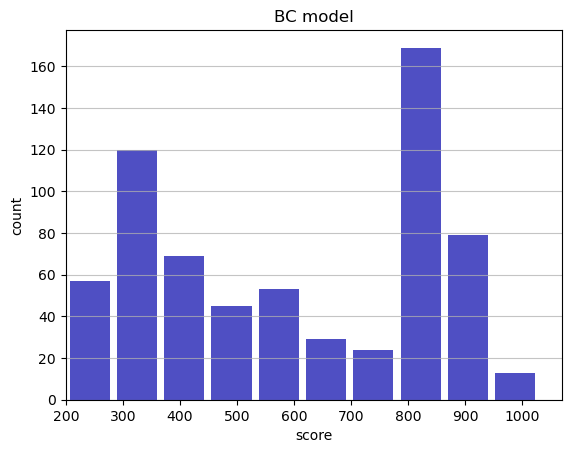

Track generation: 1288..1614 -> 326-tiles track
Epoch: 664
BC	mean: 595.01	variance: 240.52


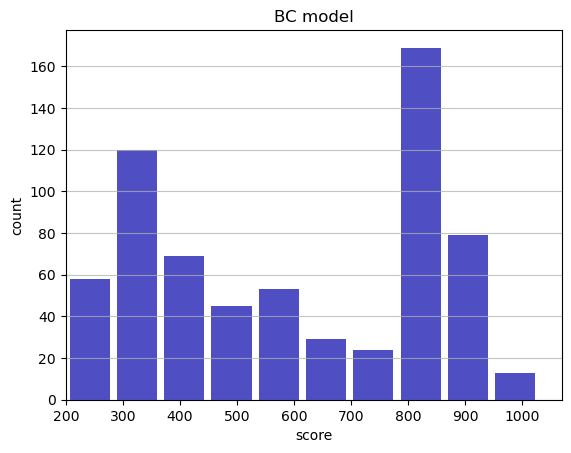

Track generation: 1259..1577 -> 318-tiles track
Epoch: 665
BC	mean: 594.75	variance: 240.43


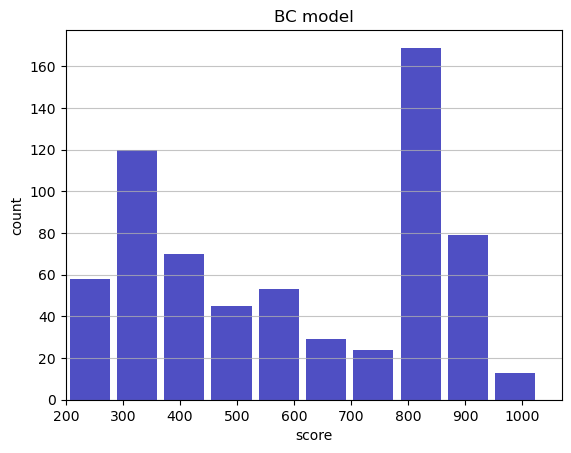

Track generation: 1060..1329 -> 269-tiles track
Epoch: 666
BC	mean: 595.14	variance: 240.46


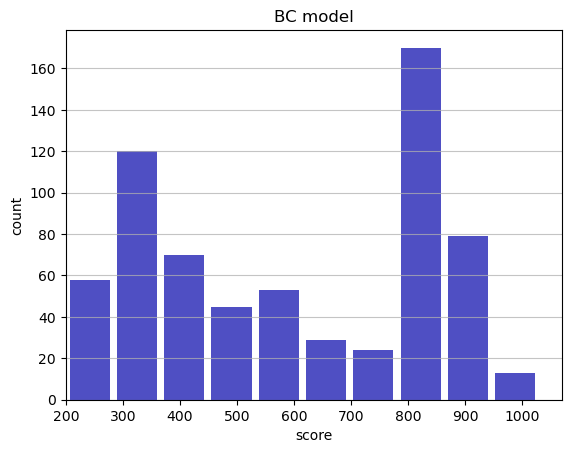

Track generation: 853..1073 -> 220-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1158..1450 -> 292-tiles track
Epoch: 667
BC	mean: 595.53	variance: 240.49


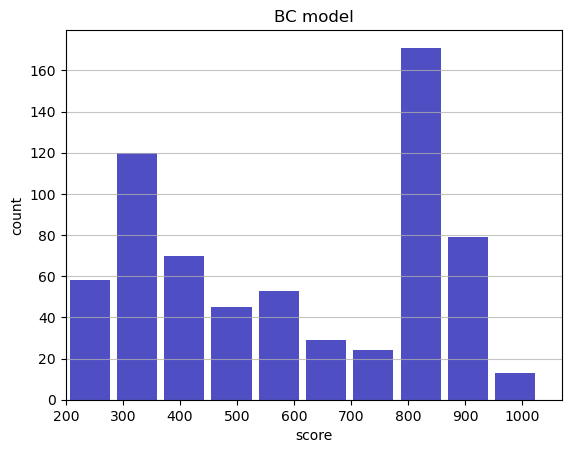

Track generation: 1058..1334 -> 276-tiles track
Epoch: 668
BC	mean: 595.84	variance: 240.44


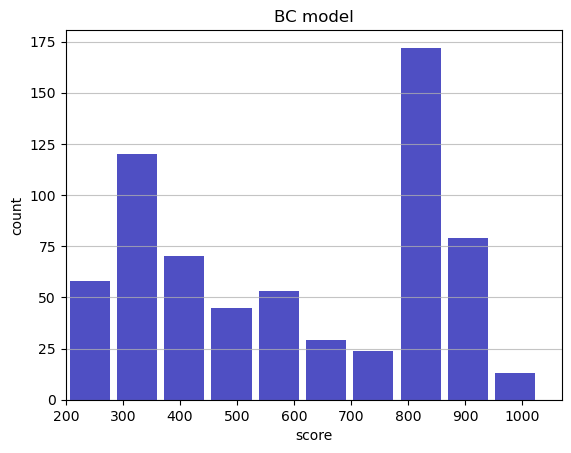

Track generation: 1171..1474 -> 303-tiles track
Epoch: 669
BC	mean: 595.92	variance: 240.27


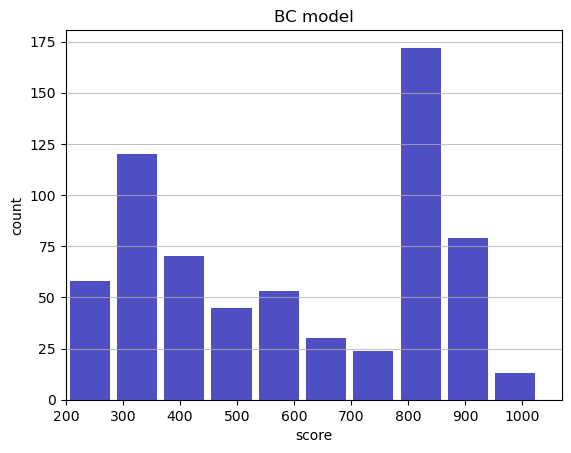

Track generation: 1300..1629 -> 329-tiles track
Epoch: 670
BC	mean: 596.09	variance: 240.14


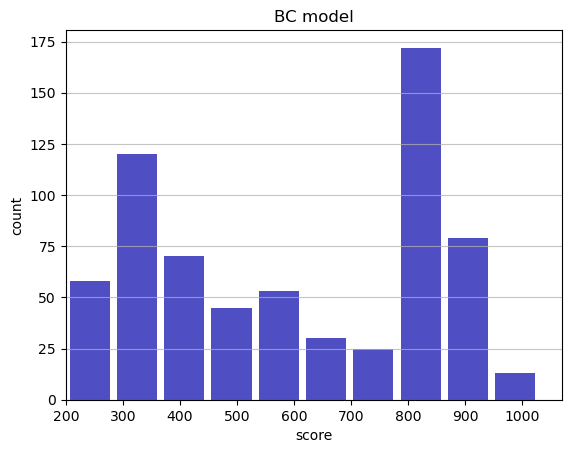

Track generation: 1184..1485 -> 301-tiles track
Epoch: 671
BC	mean: 595.98	variance: 239.97


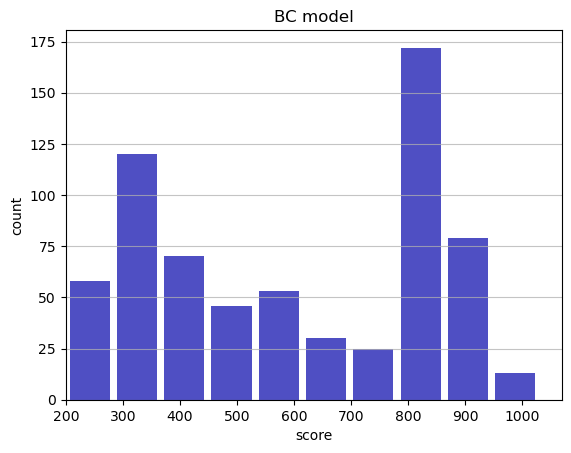

Track generation: 1055..1323 -> 268-tiles track
Epoch: 672
BC	mean: 596.37	variance: 240.00


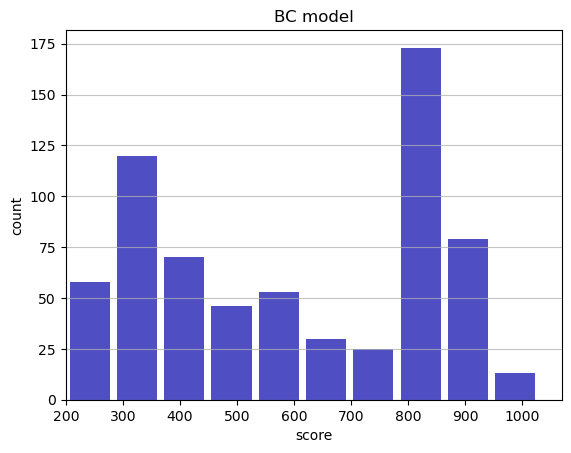

Track generation: 1176..1474 -> 298-tiles track
Epoch: 673
BC	mean: 595.97	variance: 240.04


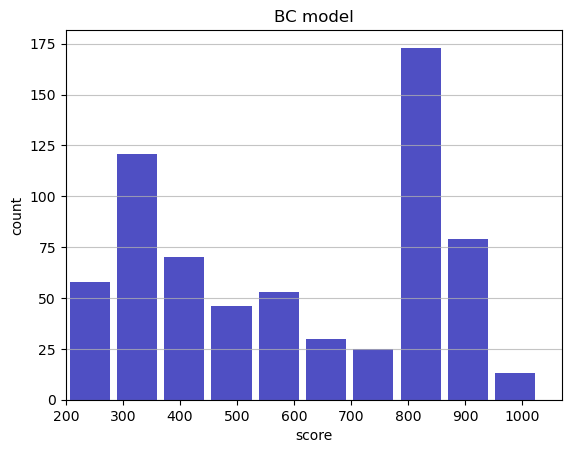

Track generation: 1113..1401 -> 288-tiles track
Epoch: 674
BC	mean: 595.55	variance: 240.12


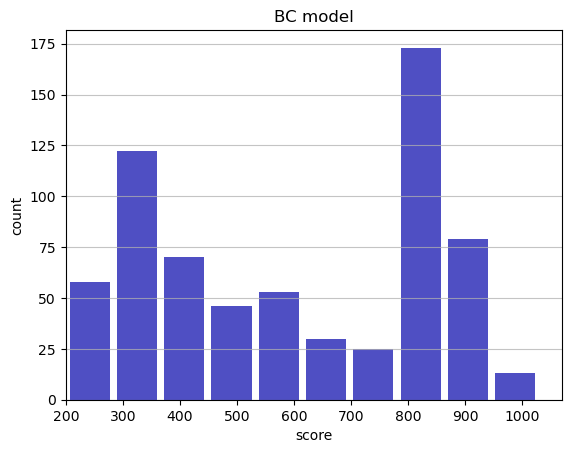

Track generation: 1000..1256 -> 256-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1095..1373 -> 278-tiles track
Epoch: 675
BC	mean: 595.13	variance: 240.18


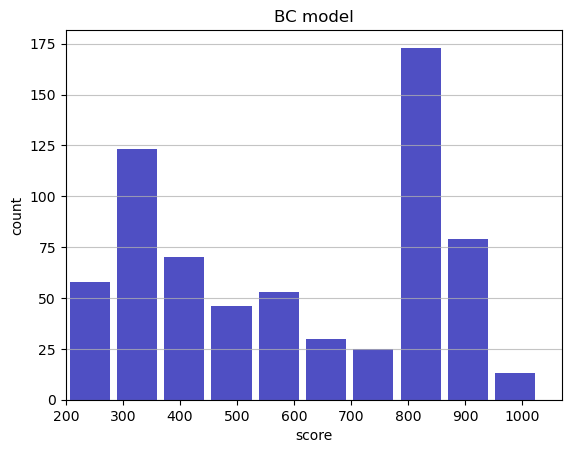

Track generation: 1126..1416 -> 290-tiles track
Epoch: 676
BC	mean: 594.85	variance: 240.12


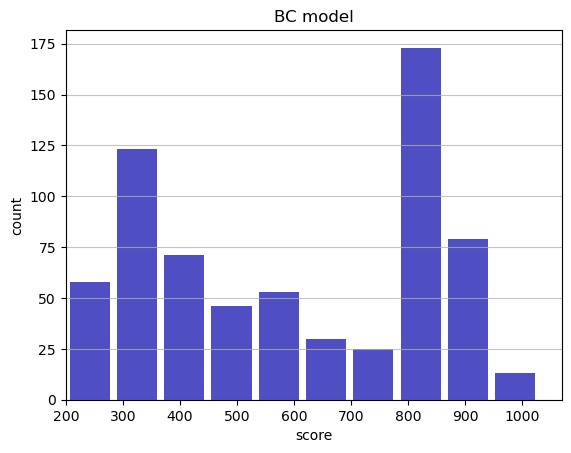

Track generation: 1111..1393 -> 282-tiles track
Epoch: 677
BC	mean: 595.21	variance: 240.13


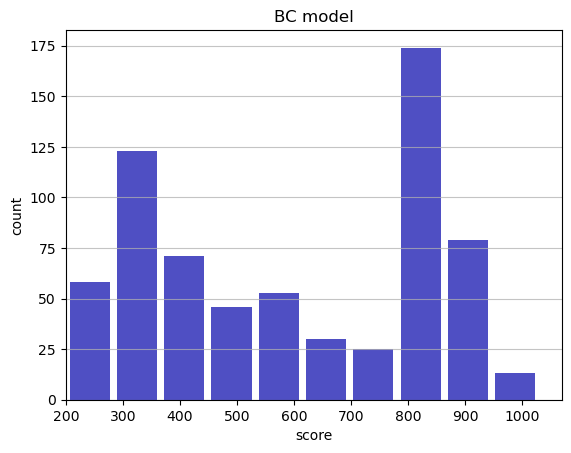

Track generation: 1034..1297 -> 263-tiles track
Epoch: 678
BC	mean: 595.17	variance: 239.95


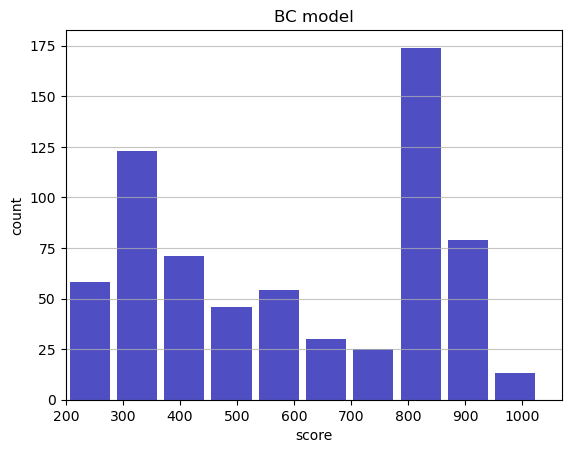

Track generation: 1252..1569 -> 317-tiles track
Epoch: 679
BC	mean: 594.83	variance: 239.94


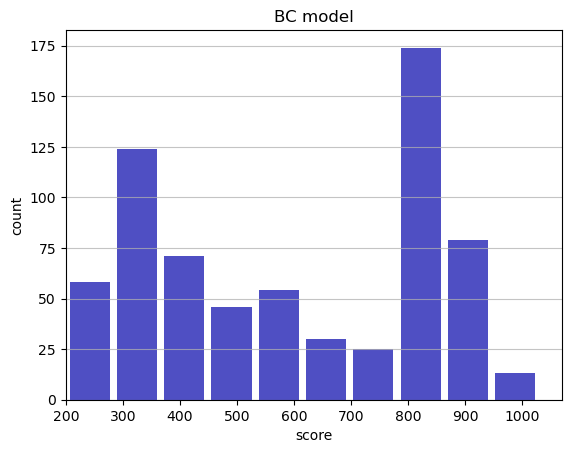

Track generation: 1183..1483 -> 300-tiles track
Epoch: 680
BC	mean: 595.22	variance: 239.98


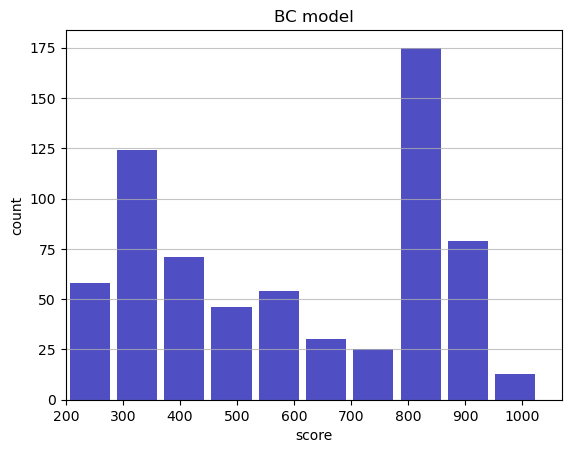

Track generation: 1332..1669 -> 337-tiles track
Epoch: 681
BC	mean: 595.26	variance: 239.80


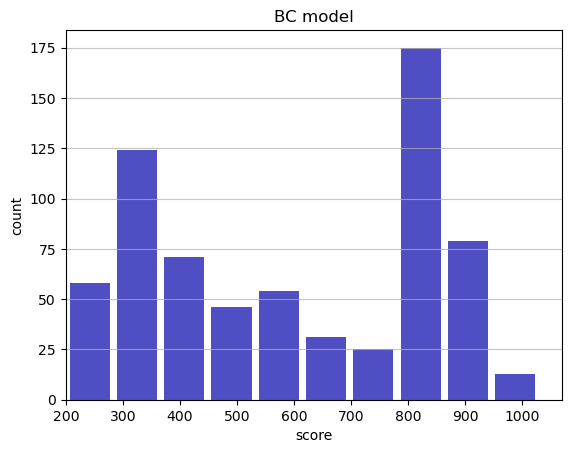

Track generation: 1191..1493 -> 302-tiles track
Epoch: 682
BC	mean: 595.33	variance: 239.63


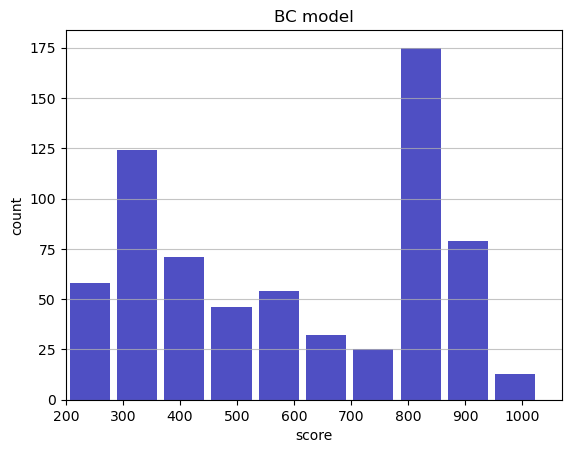

Track generation: 1179..1478 -> 299-tiles track
Epoch: 683
BC	mean: 595.16	variance: 239.50


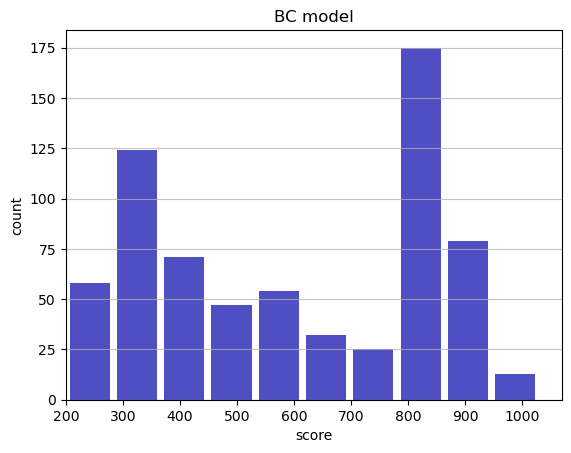

Track generation: 1312..1645 -> 333-tiles track
Epoch: 684
BC	mean: 594.72	variance: 239.60


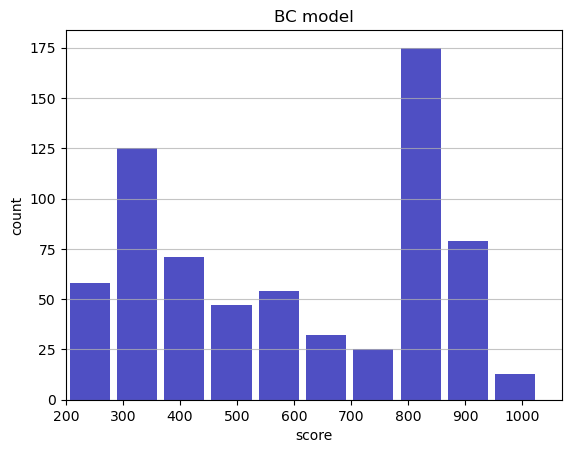

Track generation: 1100..1387 -> 287-tiles track
Epoch: 685
BC	mean: 594.33	variance: 239.65


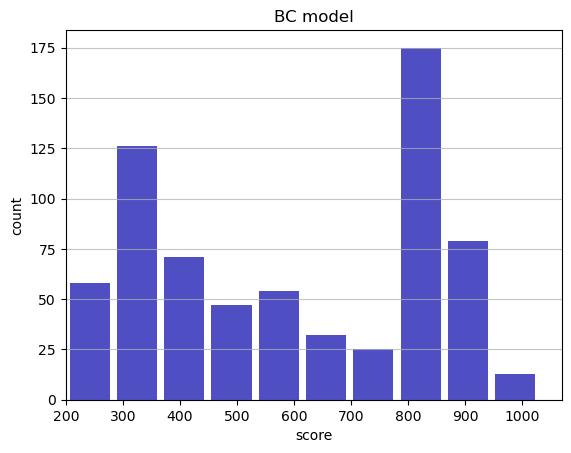

Track generation: 1284..1610 -> 326-tiles track
Epoch: 686
BC	mean: 594.52	variance: 239.53


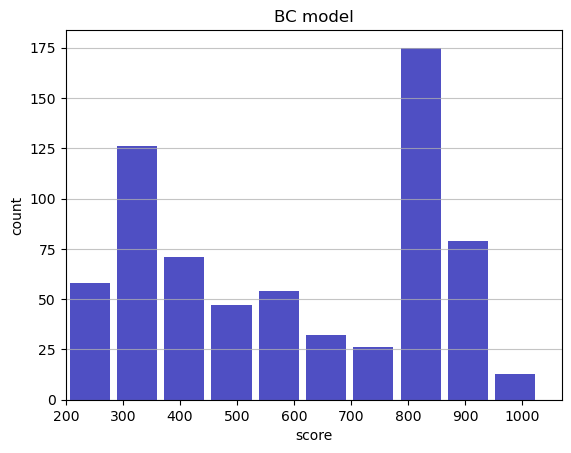

Track generation: 1161..1455 -> 294-tiles track
Epoch: 687
BC	mean: 594.21	variance: 239.50


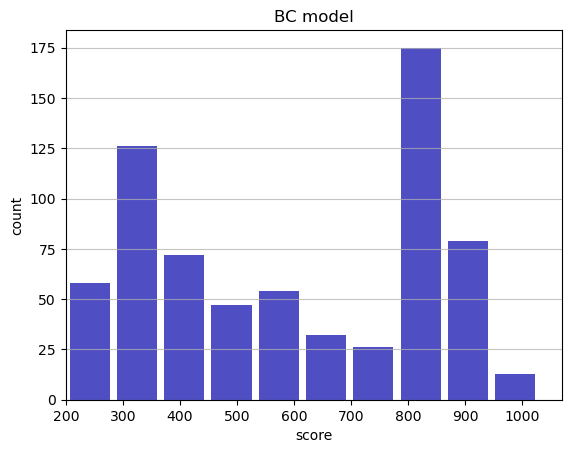

Track generation: 1107..1388 -> 281-tiles track
Epoch: 688
BC	mean: 594.30	variance: 239.34


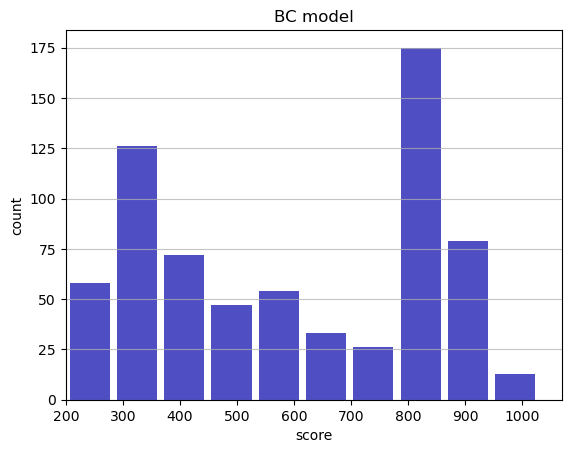

Track generation: 1191..1492 -> 301-tiles track
Epoch: 689
BC	mean: 593.89	variance: 239.40


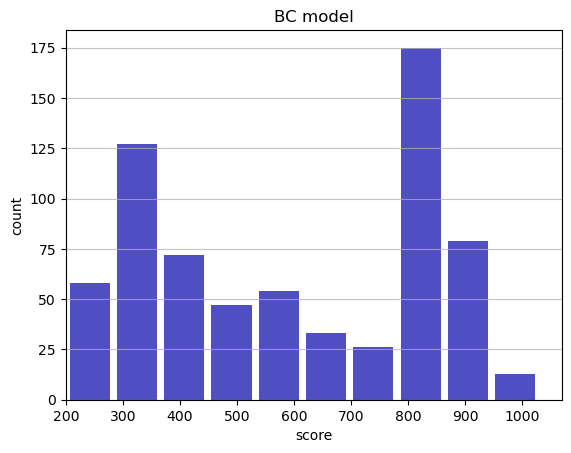

Track generation: 1106..1387 -> 281-tiles track
Epoch: 690
BC	mean: 593.68	variance: 239.29


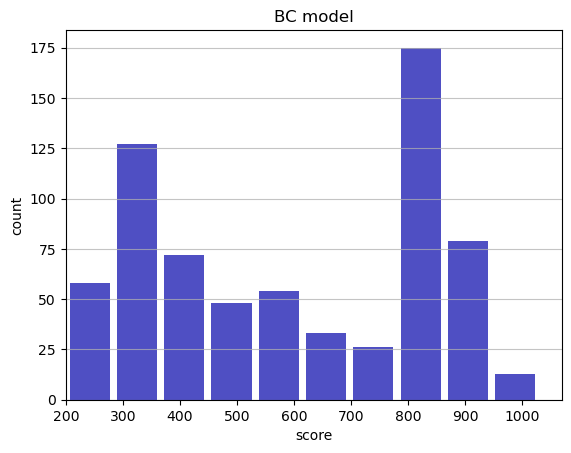

Track generation: 1175..1473 -> 298-tiles track
Epoch: 691
BC	mean: 593.64	variance: 239.12


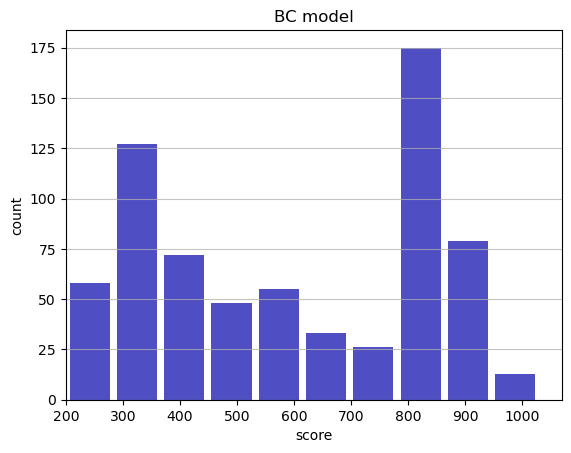

Track generation: 1079..1352 -> 273-tiles track
Epoch: 692
BC	mean: 594.06	variance: 239.20


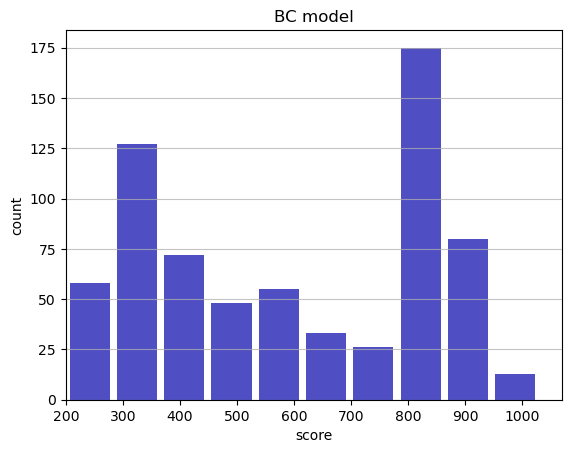

Track generation: 1138..1432 -> 294-tiles track
Epoch: 693
BC	mean: 594.68	variance: 239.58


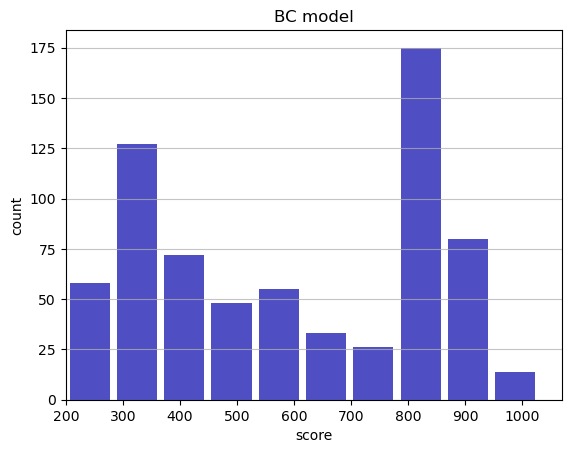

Track generation: 1164..1459 -> 295-tiles track
Epoch: 694
BC	mean: 595.00	variance: 239.56


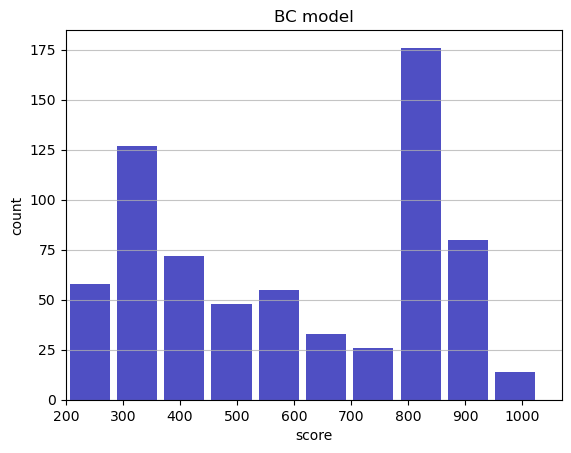

Track generation: 1267..1588 -> 321-tiles track
Epoch: 695
BC	mean: 594.64	variance: 239.58


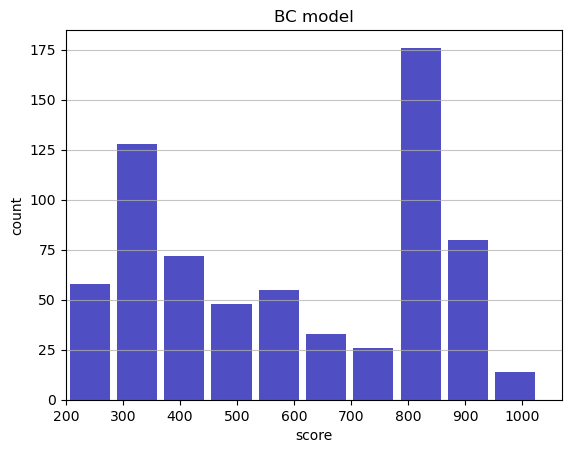

Track generation: 1220..1529 -> 309-tiles track
Epoch: 696
BC	mean: 594.48	variance: 239.44


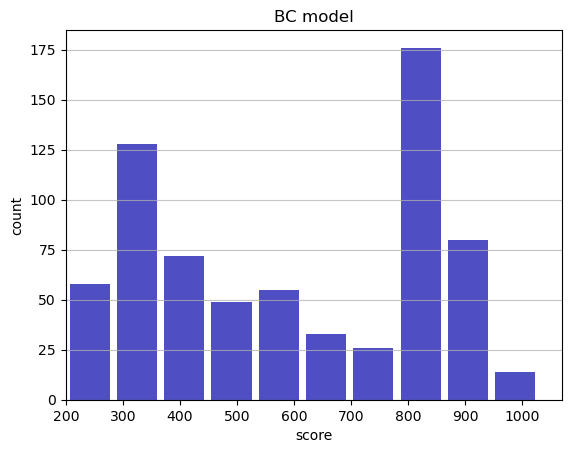

Track generation: 1275..1598 -> 323-tiles track
Epoch: 697
BC	mean: 594.98	variance: 239.63


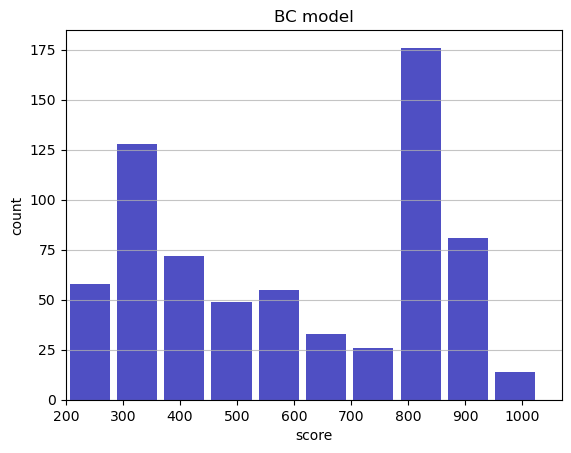

Track generation: 1067..1342 -> 275-tiles track
Epoch: 698
BC	mean: 595.25	variance: 239.57


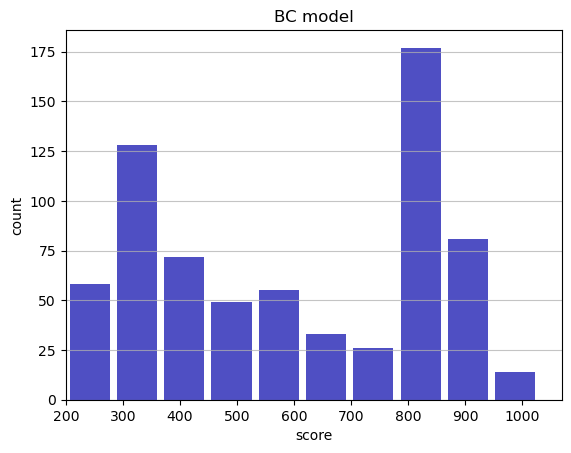

Track generation: 1237..1550 -> 313-tiles track
Epoch: 699
BC	mean: 595.78	variance: 239.80


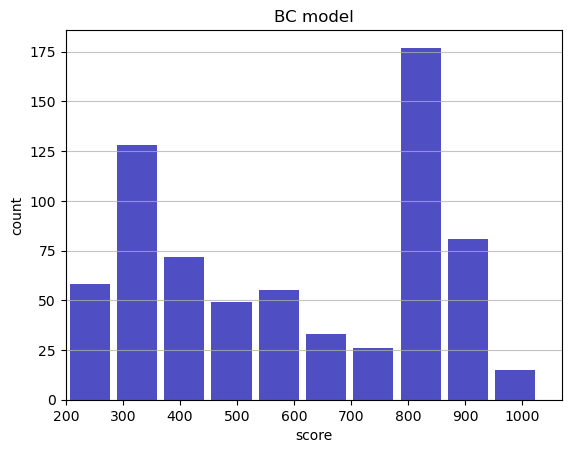

Track generation: 1126..1418 -> 292-tiles track
Epoch: 700
BC	mean: 595.36	variance: 239.88


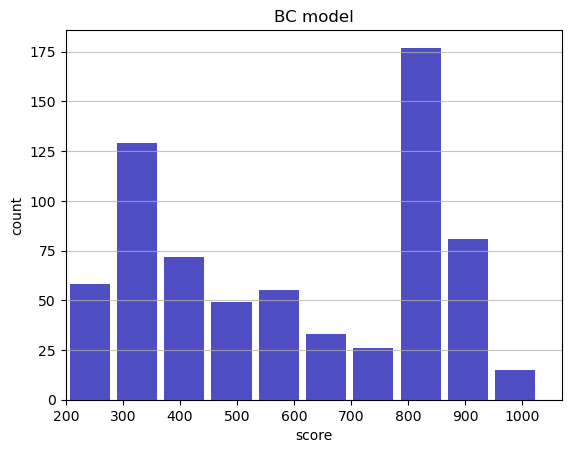

Track generation: 1143..1433 -> 290-tiles track
Epoch: 701
BC	mean: 595.25	variance: 239.72


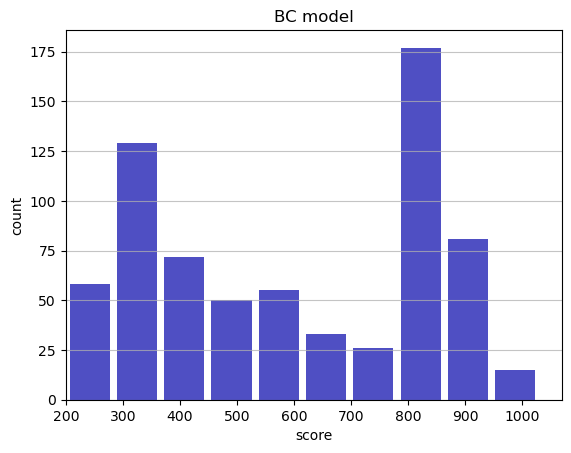

Track generation: 1318..1659 -> 341-tiles track
Epoch: 702
BC	mean: 595.62	variance: 239.75


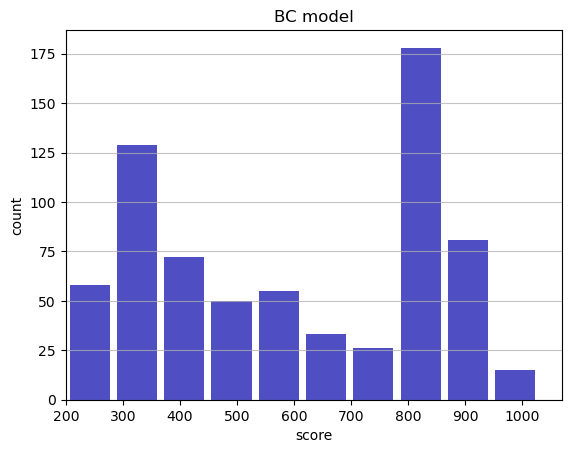

Track generation: 1116..1409 -> 293-tiles track
Epoch: 703
BC	mean: 595.99	variance: 239.79


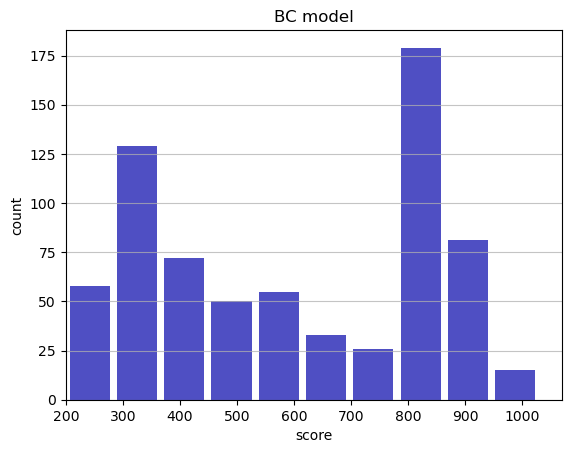

Track generation: 1116..1399 -> 283-tiles track
Epoch: 704
BC	mean: 596.15	variance: 239.66


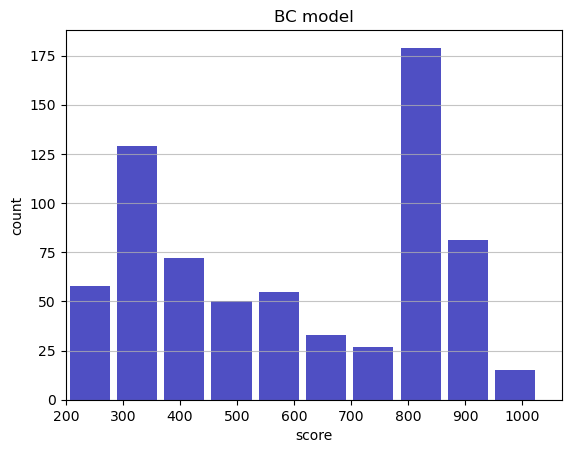

Track generation: 1082..1362 -> 280-tiles track
Epoch: 705
BC	mean: 596.58	variance: 239.75


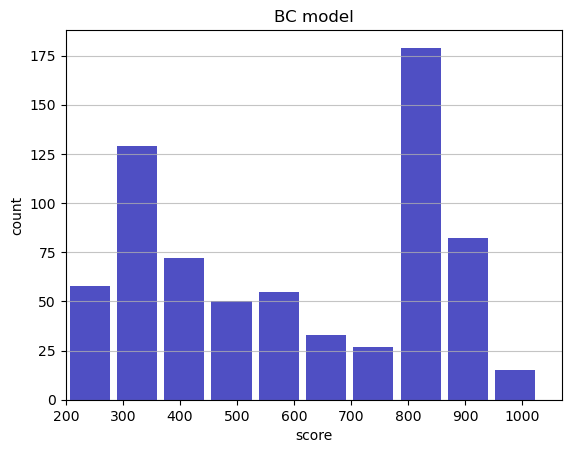

Track generation: 1072..1344 -> 272-tiles track
Epoch: 706
BC	mean: 596.92	variance: 239.76


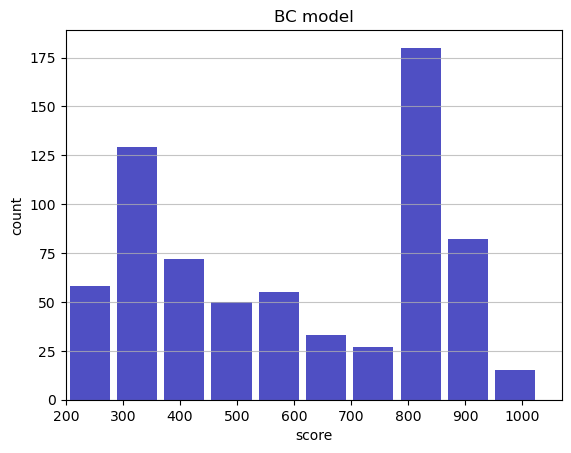

Track generation: 1167..1463 -> 296-tiles track
Epoch: 707
BC	mean: 596.81	variance: 239.61


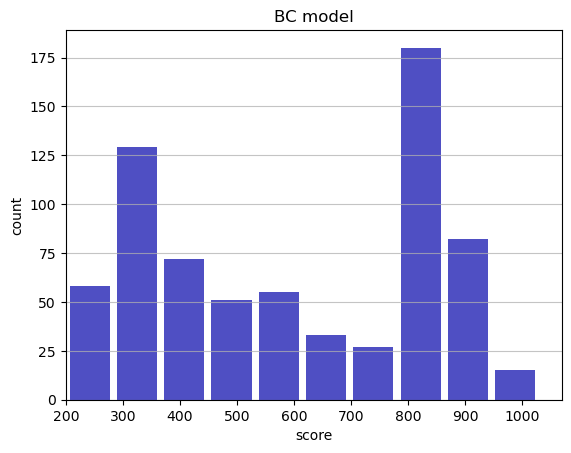

Track generation: 1269..1590 -> 321-tiles track
Epoch: 708
BC	mean: 596.45	variance: 239.62


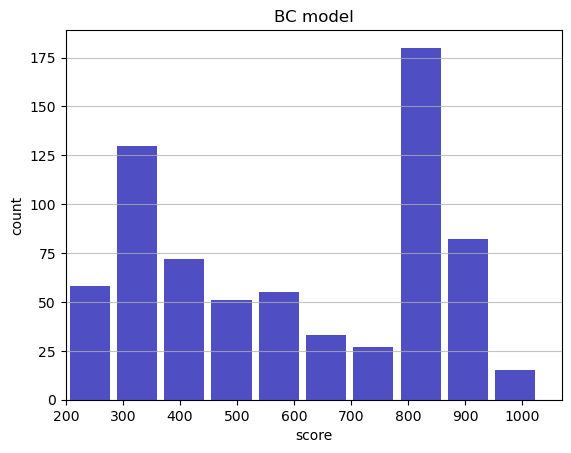

Track generation: 1209..1515 -> 306-tiles track
Epoch: 709
BC	mean: 596.77	variance: 239.60


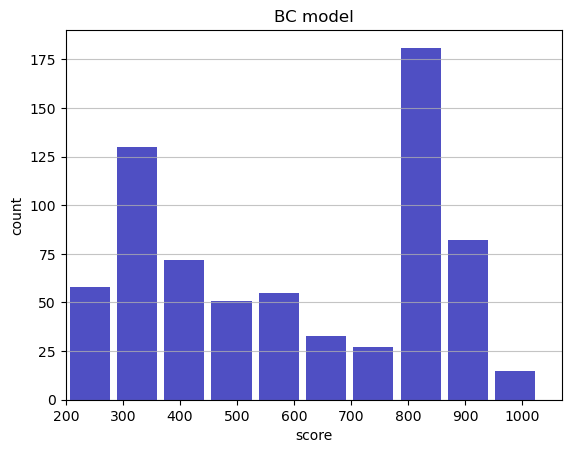

Track generation: 1109..1390 -> 281-tiles track
Epoch: 710
BC	mean: 596.41	variance: 239.62


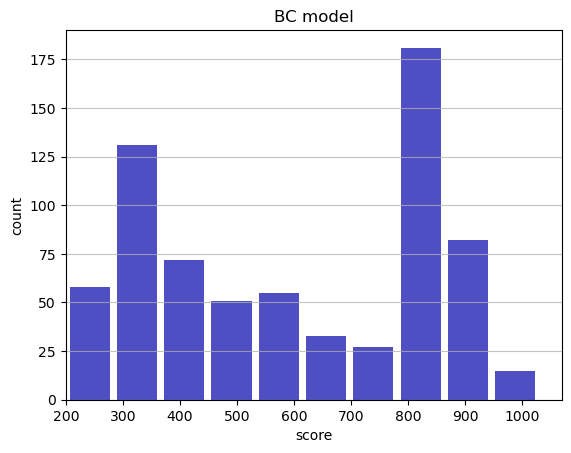

Track generation: 1112..1394 -> 282-tiles track
Epoch: 711
BC	mean: 596.50	variance: 239.47


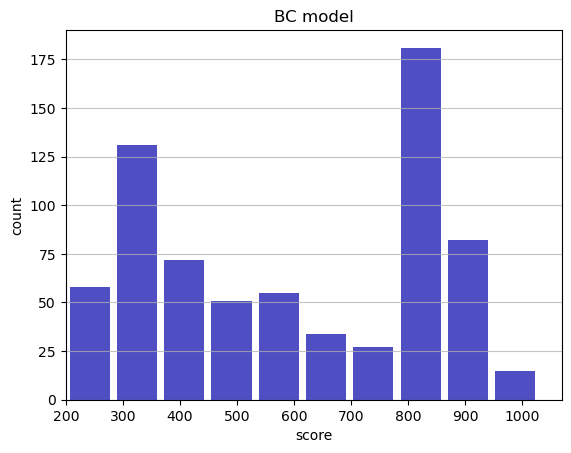

Track generation: 1248..1573 -> 325-tiles track
Epoch: 712
BC	mean: 596.72	variance: 239.37


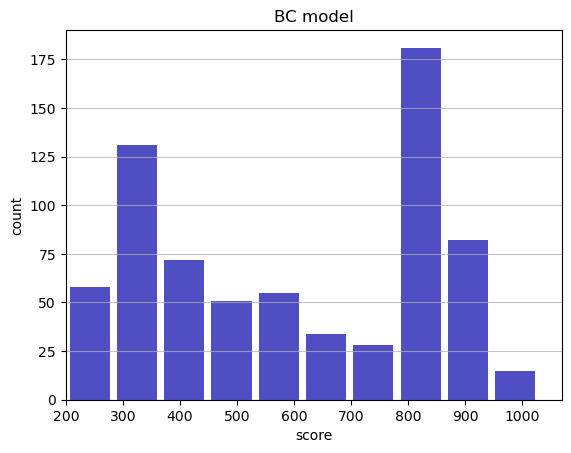

Track generation: 1192..1494 -> 302-tiles track
Epoch: 713
BC	mean: 596.64	variance: 239.22


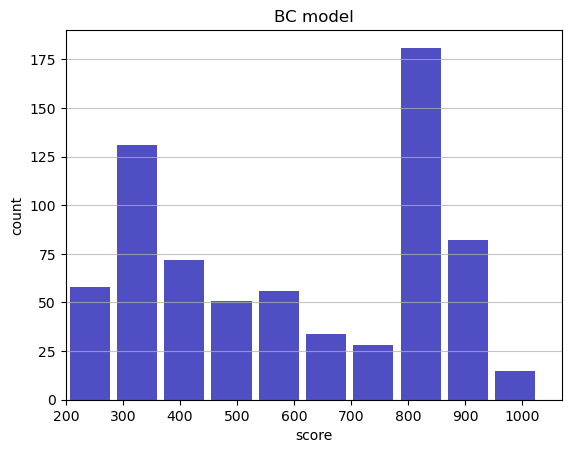

Track generation: 1179..1478 -> 299-tiles track
Epoch: 714
BC	mean: 596.92	variance: 239.17


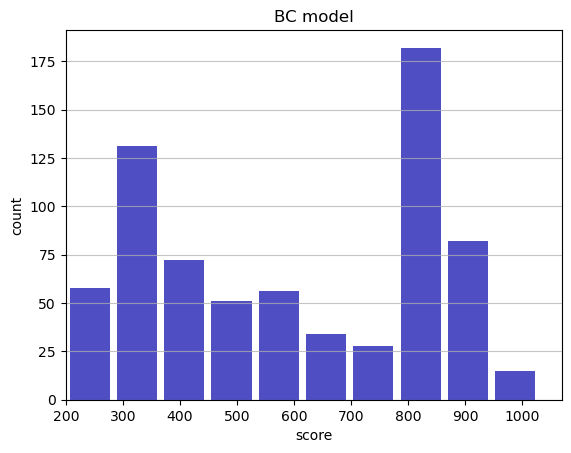

Track generation: 984..1235 -> 251-tiles track
Epoch: 715
BC	mean: 597.26	variance: 239.17


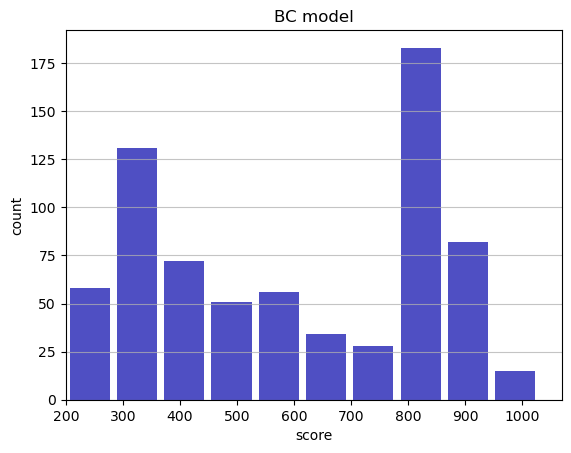

Track generation: 1242..1557 -> 315-tiles track
Epoch: 716
BC	mean: 597.23	variance: 239.01


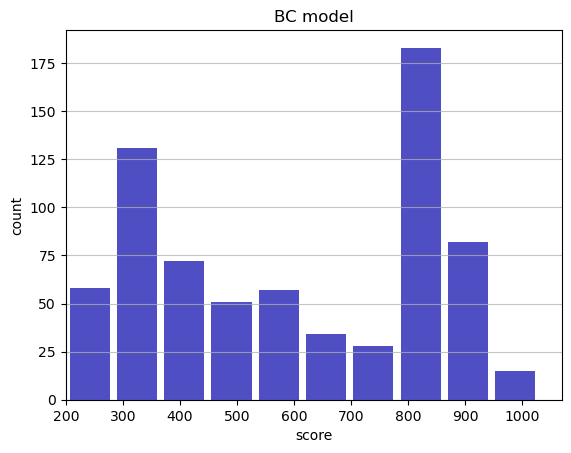

Track generation: 1090..1367 -> 277-tiles track
Epoch: 717
BC	mean: 597.57	variance: 239.01


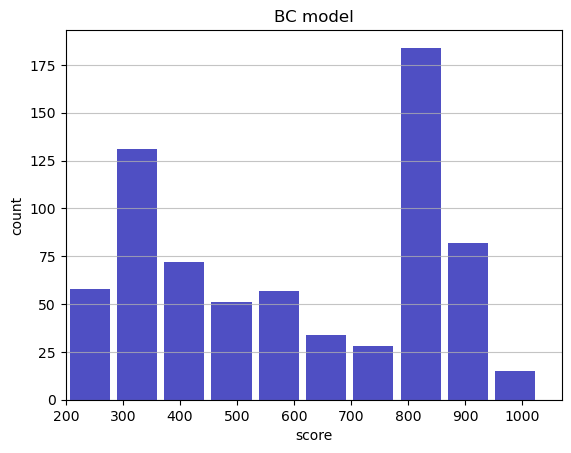

Track generation: 1215..1523 -> 308-tiles track
Epoch: 718
BC	mean: 598.06	variance: 239.20


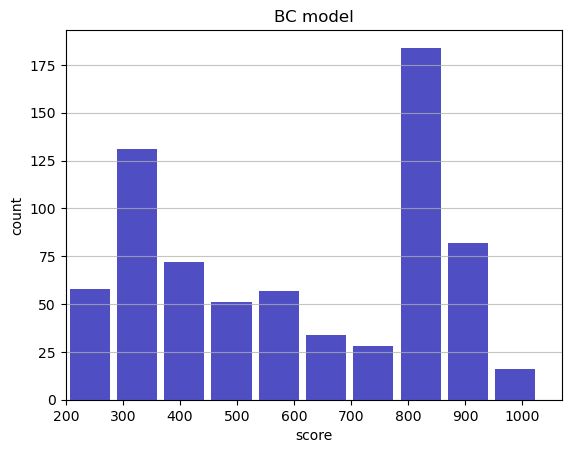

Track generation: 1193..1495 -> 302-tiles track
Epoch: 719
BC	mean: 597.70	variance: 239.23


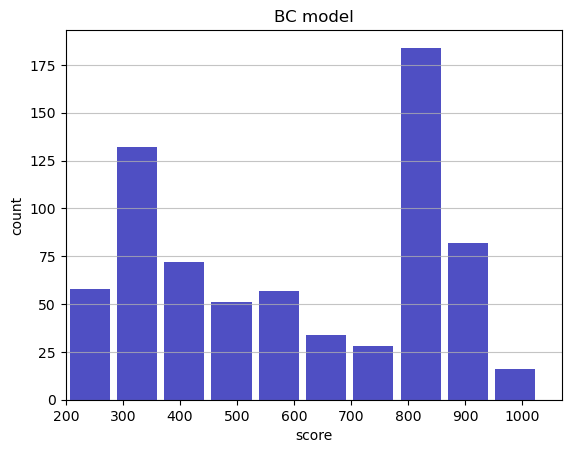

Track generation: 1115..1398 -> 283-tiles track
Epoch: 720
BC	mean: 598.04	variance: 239.24


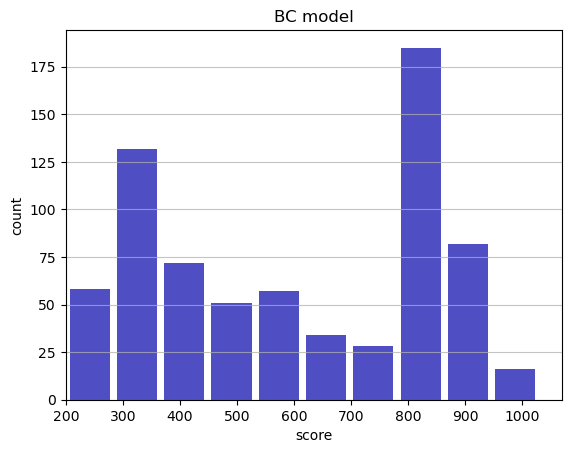

Track generation: 1120..1410 -> 290-tiles track
Epoch: 721
BC	mean: 598.41	variance: 239.28


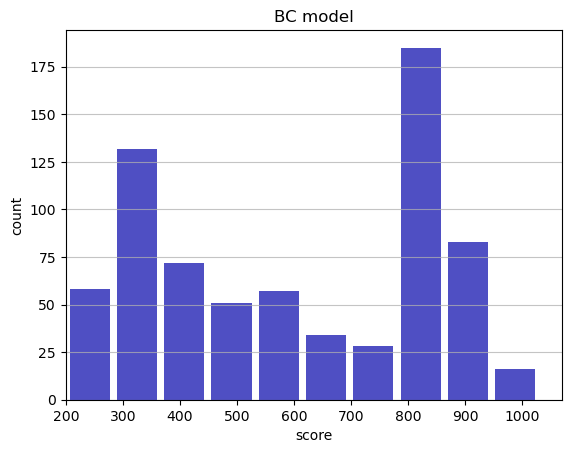

Track generation: 1131..1417 -> 286-tiles track
Epoch: 722
BC	mean: 598.77	variance: 239.31


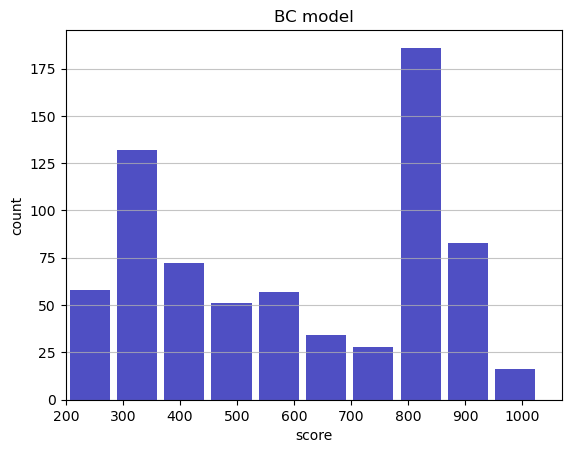

Track generation: 1239..1553 -> 314-tiles track
Epoch: 723
BC	mean: 599.16	variance: 239.37


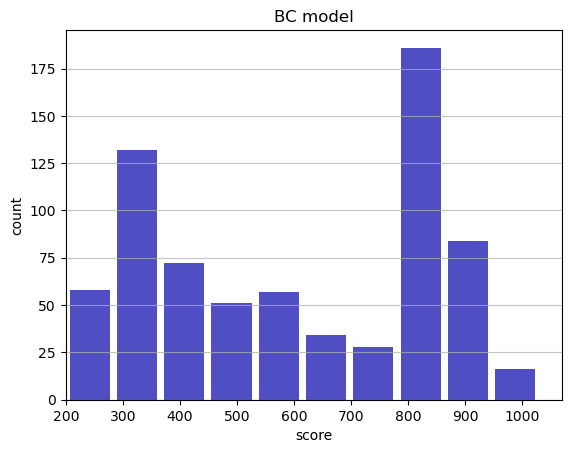

Track generation: 1167..1463 -> 296-tiles track
Epoch: 724
BC	mean: 599.45	variance: 239.33


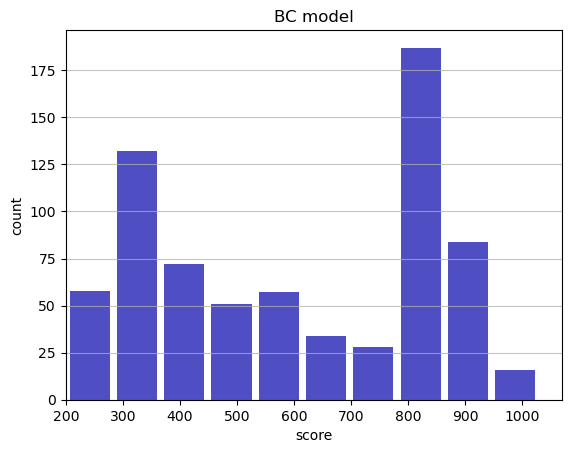

Track generation: 1239..1553 -> 314-tiles track
Epoch: 725
BC	mean: 599.63	variance: 239.21


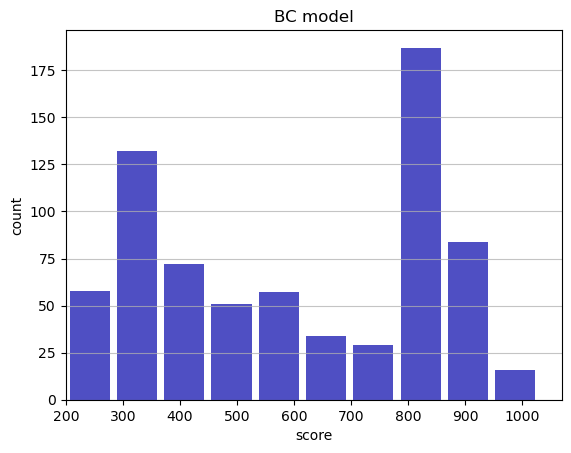

Track generation: 1298..1634 -> 336-tiles track
Epoch: 726
BC	mean: 599.45	variance: 239.10


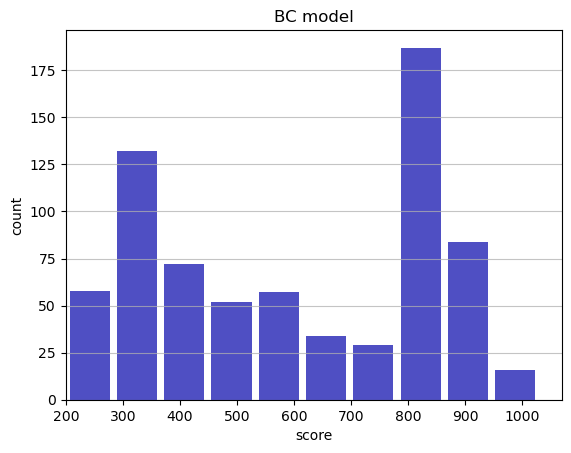

Track generation: 965..1210 -> 245-tiles track
Epoch: 727
BC	mean: 599.78	variance: 239.11


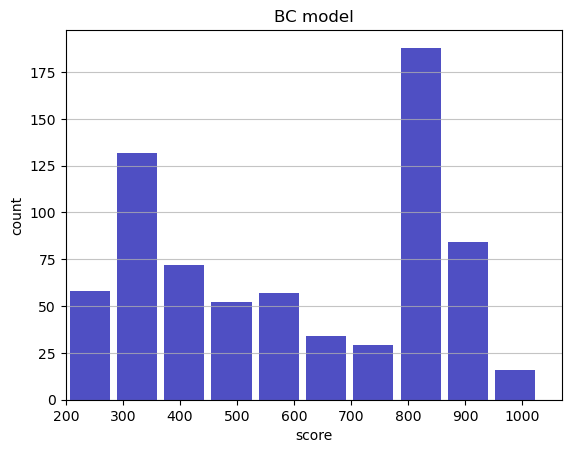

Track generation: 1223..1533 -> 310-tiles track
Epoch: 728
BC	mean: 600.06	variance: 239.06


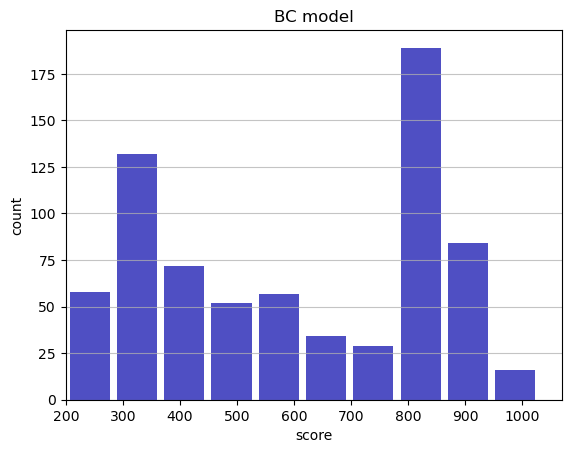

Track generation: 1024..1288 -> 264-tiles track
Epoch: 729
BC	mean: 600.40	variance: 239.08


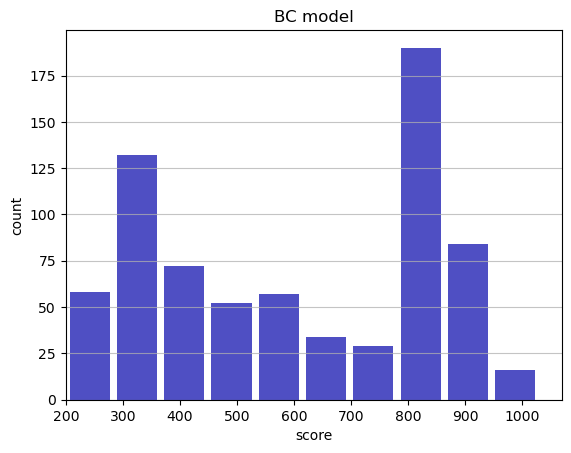

Track generation: 1037..1256 -> 219-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 961..1205 -> 244-tiles track
Epoch: 730
BC	mean: 600.71	variance: 239.06


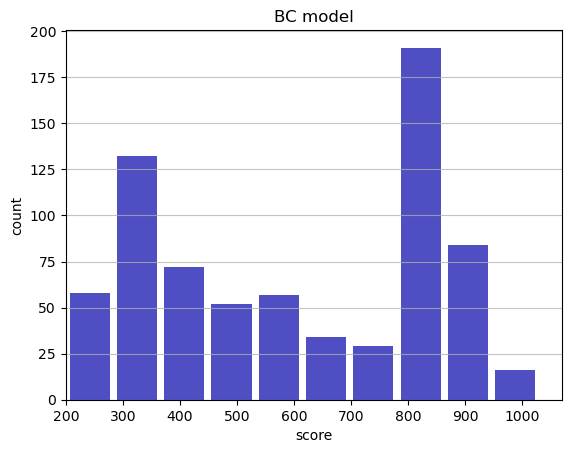

Track generation: 1308..1639 -> 331-tiles track
Epoch: 731
BC	mean: 600.23	variance: 239.25


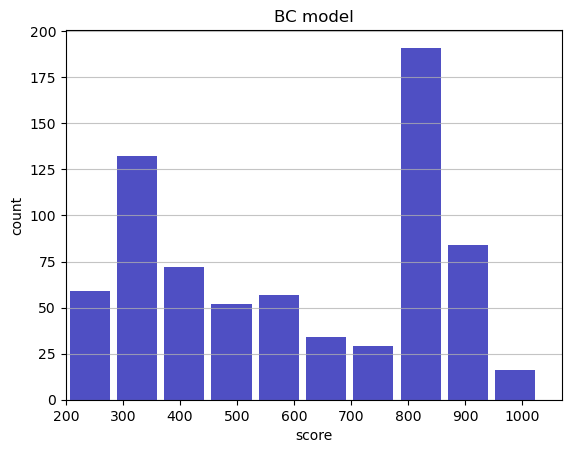

Track generation: 1002..1259 -> 257-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 920..1162 -> 242-tiles track
Epoch: 732
BC	mean: 600.08	variance: 239.12


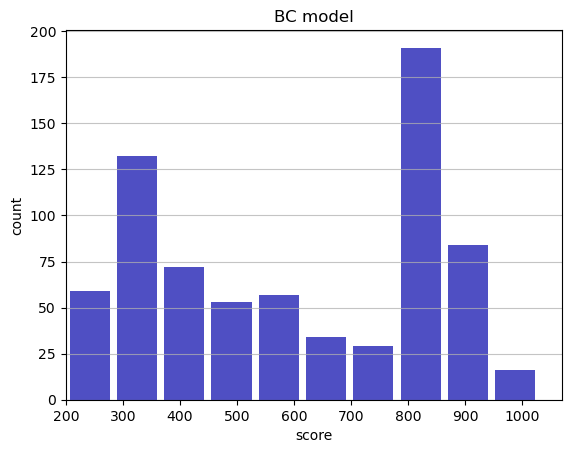

Track generation: 1208..1514 -> 306-tiles track
Epoch: 733
BC	mean: 600.15	variance: 238.97


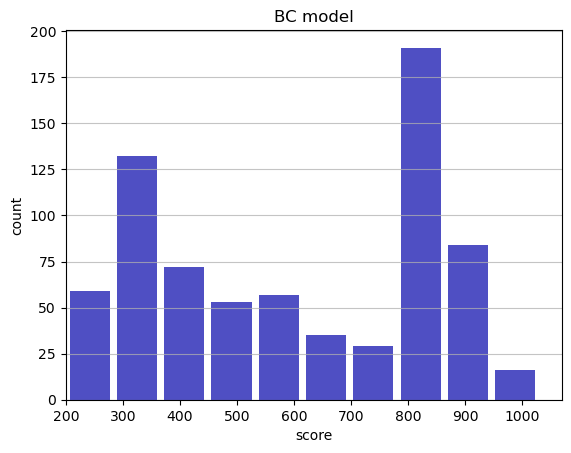

Track generation: 1114..1406 -> 292-tiles track
Epoch: 734
BC	mean: 600.53	variance: 239.03


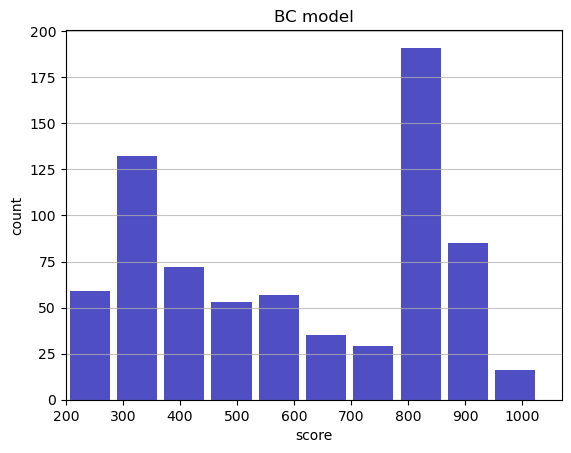

Track generation: 1109..1390 -> 281-tiles track
Epoch: 735
BC	mean: 600.25	variance: 238.98


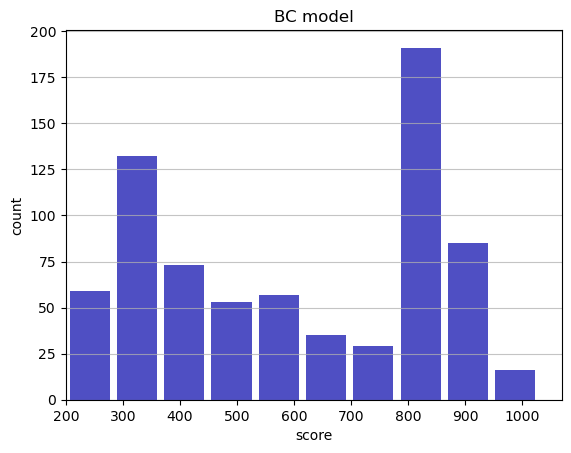

Track generation: 1071..1343 -> 272-tiles track
Epoch: 736
BC	mean: 600.61	variance: 239.01


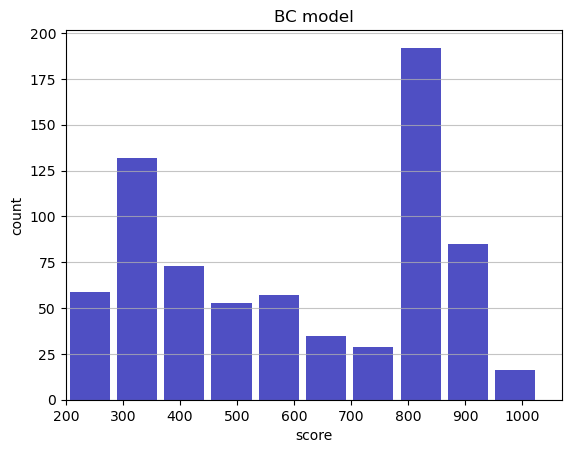

Track generation: 1131..1418 -> 287-tiles track
Epoch: 737
BC	mean: 600.26	variance: 239.04


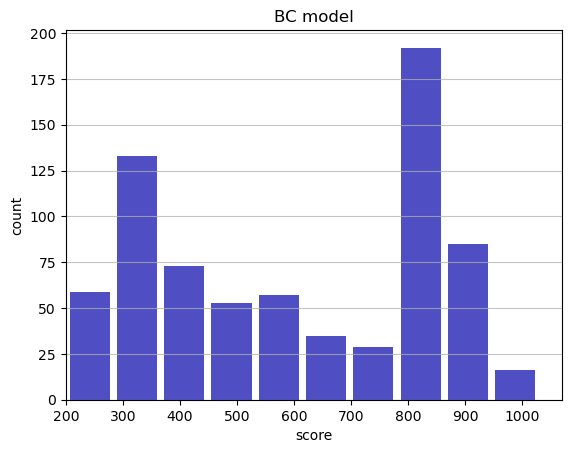

Track generation: 1212..1524 -> 312-tiles track
Epoch: 738
BC	mean: 599.89	variance: 239.08


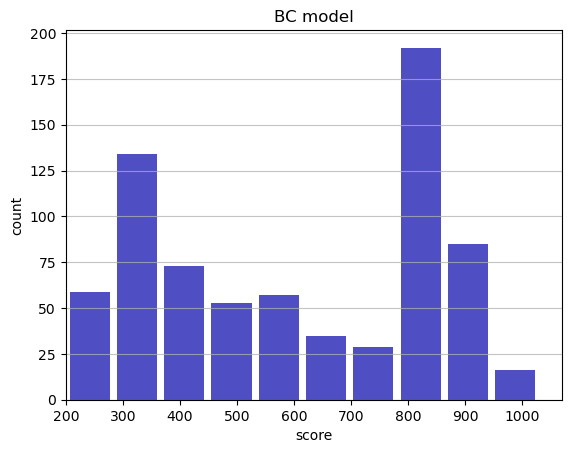

Track generation: 1137..1430 -> 293-tiles track
Epoch: 739
BC	mean: 600.28	variance: 239.15


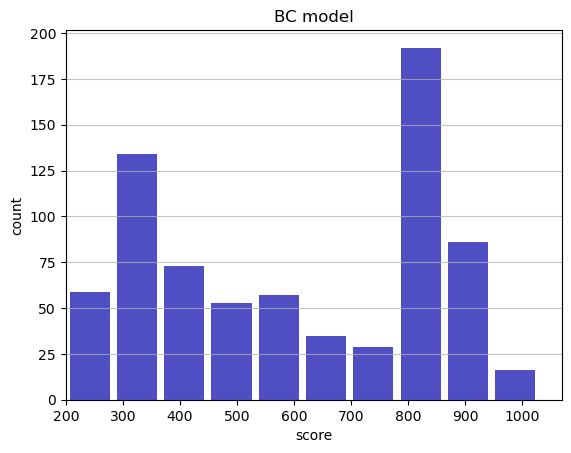

Track generation: 1356..1699 -> 343-tiles track
Epoch: 740
BC	mean: 600.27	variance: 238.99


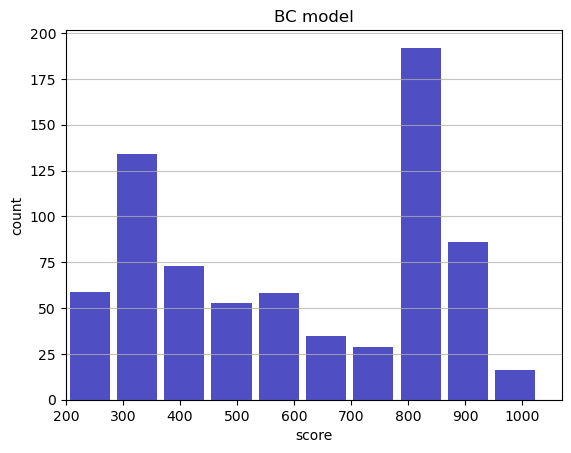

Track generation: 1107..1388 -> 281-tiles track
Epoch: 741
BC	mean: 599.94	variance: 239.00


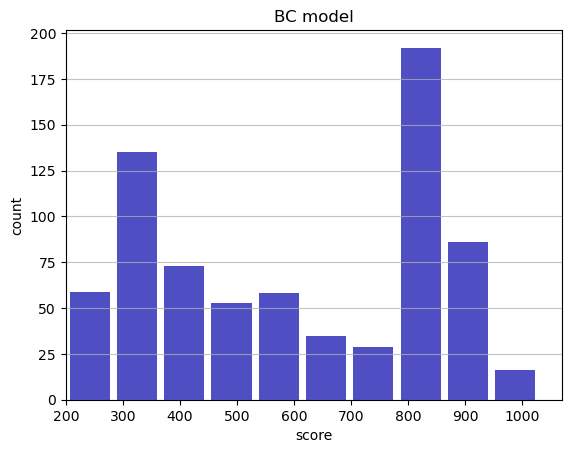

Track generation: 877..1107 -> 230-tiles track
Epoch: 742
BC	mean: 600.14	variance: 238.90


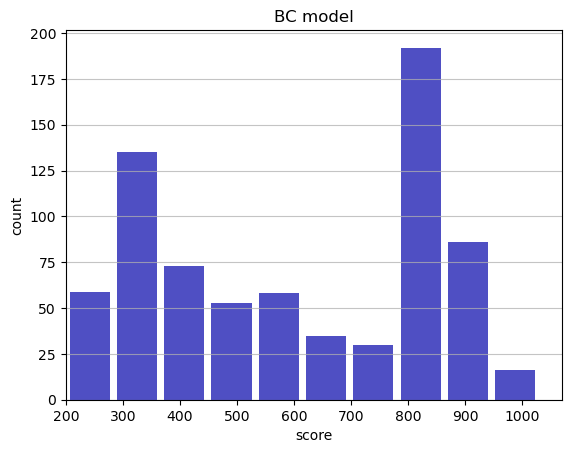

Track generation: 1159..1453 -> 294-tiles track
Epoch: 743
BC	mean: 600.47	variance: 238.91


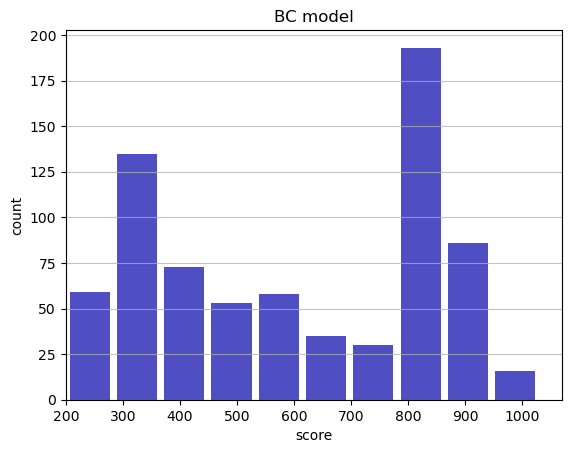

Track generation: 1240..1554 -> 314-tiles track
Epoch: 744
BC	mean: 600.21	variance: 238.85


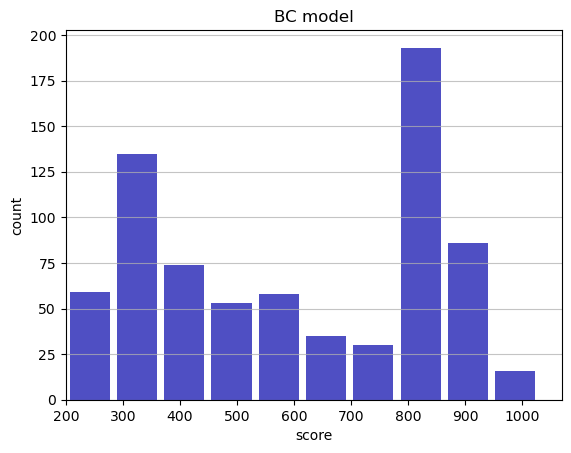

Track generation: 992..1245 -> 253-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1176..1474 -> 298-tiles track
Epoch: 745
BC	mean: 600.55	variance: 238.87


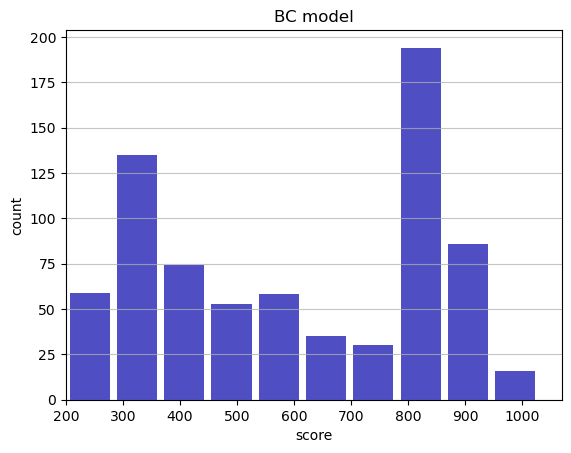

Track generation: 1182..1482 -> 300-tiles track
Epoch: 746
BC	mean: 600.84	variance: 238.84


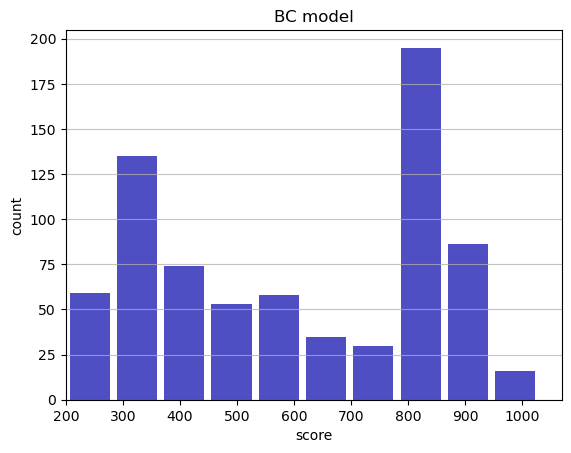

Track generation: 1164..1459 -> 295-tiles track
Epoch: 747
BC	mean: 601.19	variance: 238.87


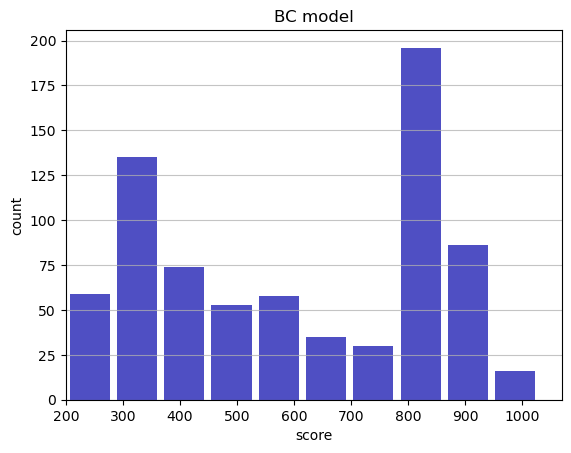

Track generation: 1049..1317 -> 268-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1203..1508 -> 305-tiles track
Epoch: 748
BC	mean: 600.74	variance: 239.01


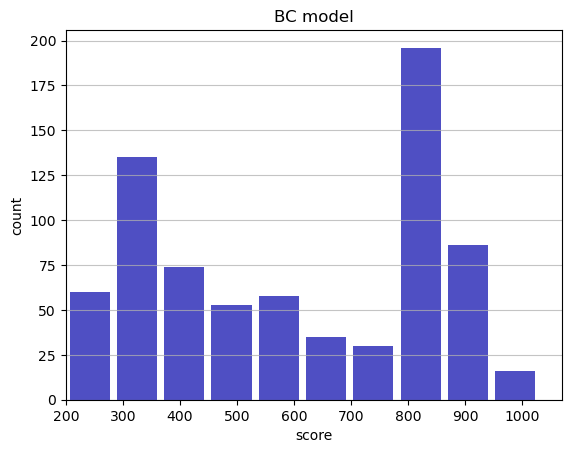

Track generation: 1108..1396 -> 288-tiles track
Epoch: 749
BC	mean: 601.09	variance: 239.04


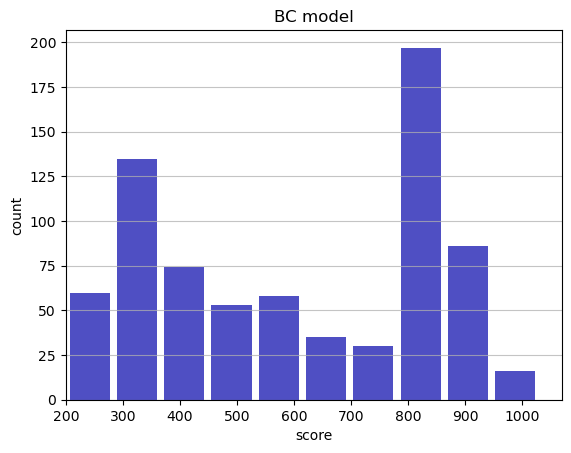

Track generation: 1197..1509 -> 312-tiles track
Epoch: 750
BC	mean: 600.83	variance: 238.98


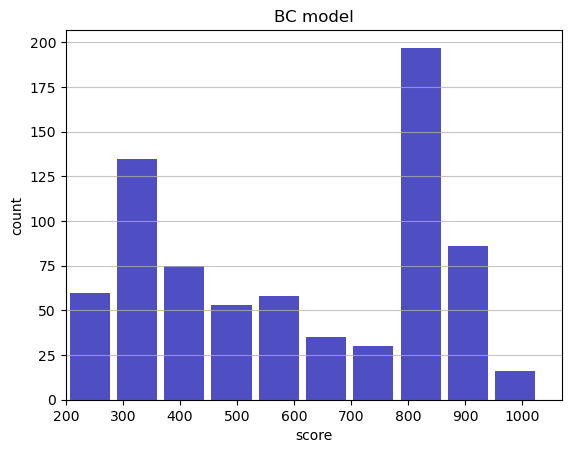

Track generation: 1004..1269 -> 265-tiles track
Epoch: 751
BC	mean: 601.29	variance: 239.15


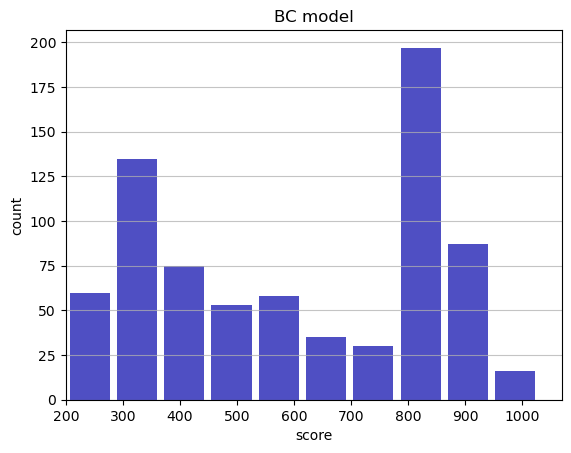

Track generation: 1220..1529 -> 309-tiles track
Epoch: 752
BC	mean: 601.59	variance: 239.14


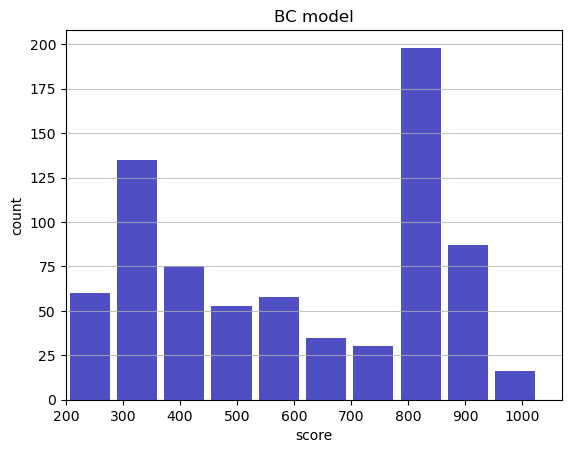

Track generation: 1235..1548 -> 313-tiles track
Epoch: 753
BC	mean: 601.92	variance: 239.14


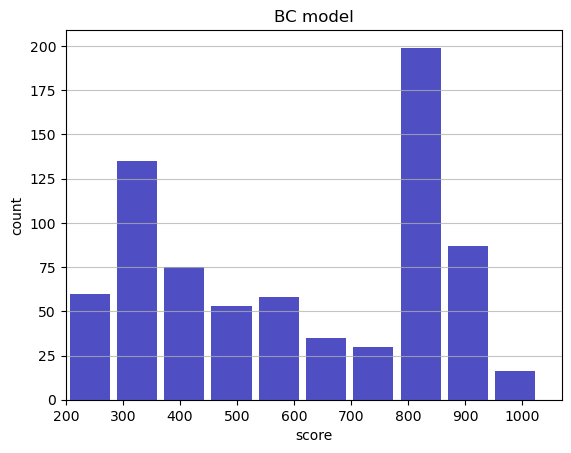

Track generation: 1115..1405 -> 290-tiles track
Epoch: 754
BC	mean: 601.94	variance: 238.99


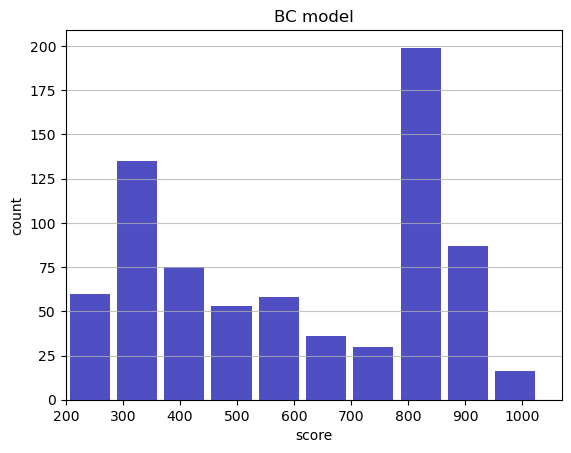

Track generation: 1095..1373 -> 278-tiles track
Epoch: 755
BC	mean: 602.08	variance: 238.86


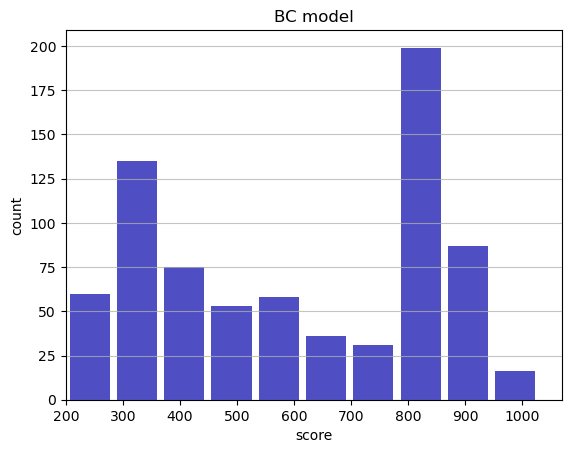

Track generation: 1208..1514 -> 306-tiles track
Epoch: 756
BC	mean: 601.65	variance: 238.99


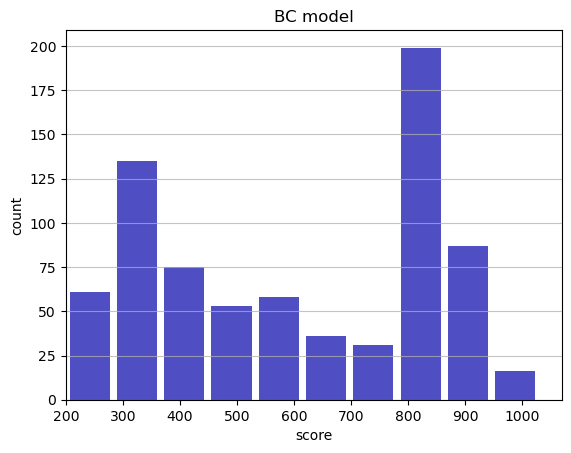

Track generation: 1257..1575 -> 318-tiles track
Epoch: 757
BC	mean: 601.27	variance: 239.06


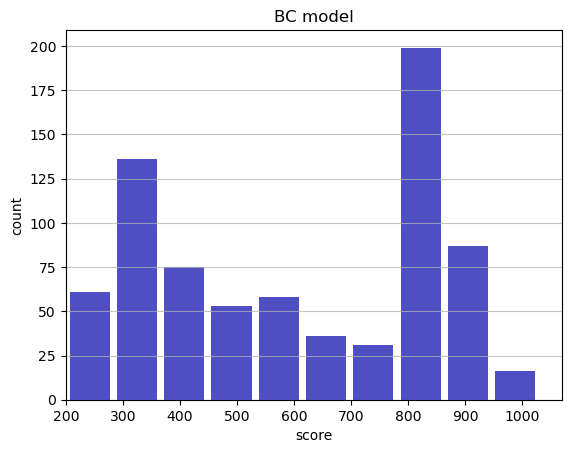

Track generation: 1175..1480 -> 305-tiles track
Epoch: 758
BC	mean: 600.86	variance: 239.17


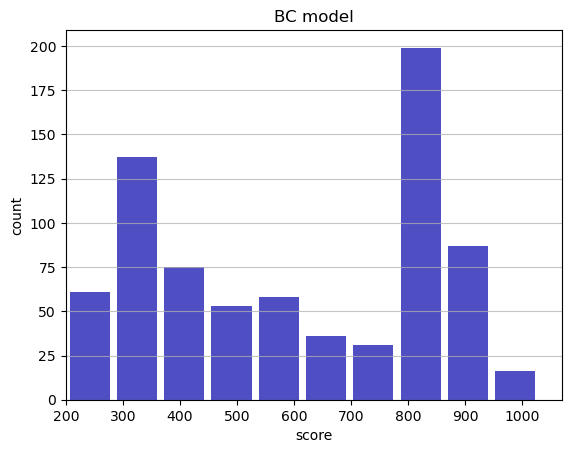

Track generation: 1247..1563 -> 316-tiles track
Epoch: 759
BC	mean: 600.44	variance: 239.29


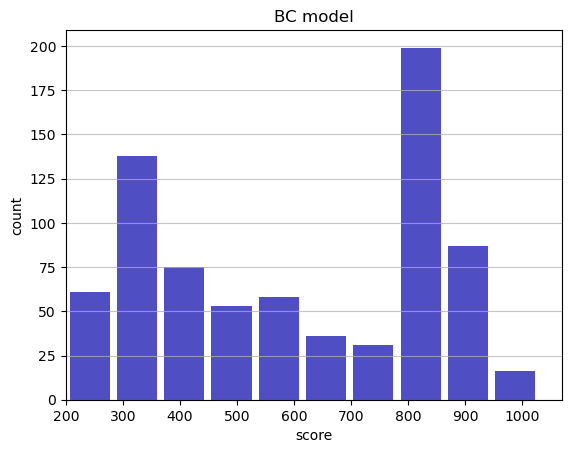

Track generation: 1265..1584 -> 319-tiles track
Epoch: 760
BC	mean: 600.80	variance: 239.33


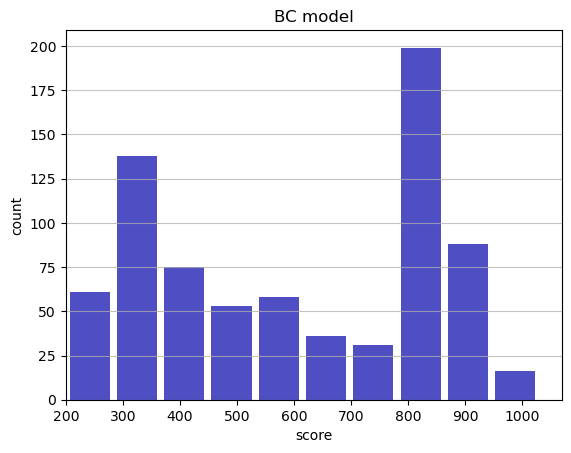

Track generation: 1227..1543 -> 316-tiles track
Epoch: 761
BC	mean: 600.31	variance: 239.56


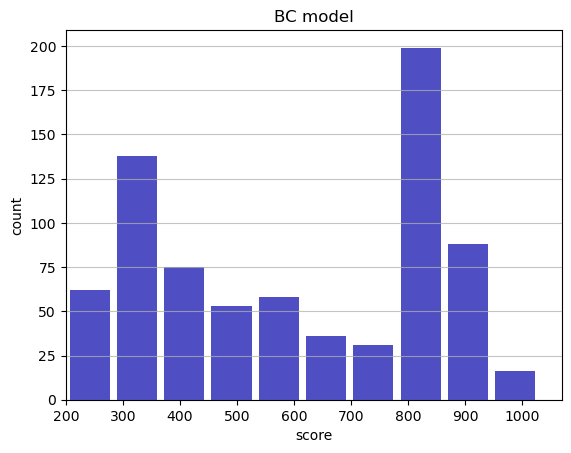

Track generation: 1062..1339 -> 277-tiles track
Epoch: 762
BC	mean: 600.73	variance: 239.69


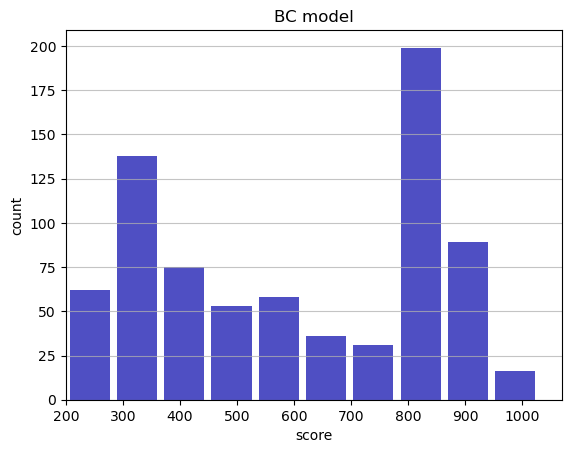

Track generation: 1186..1485 -> 299-tiles track
Epoch: 763
BC	mean: 600.32	variance: 239.80


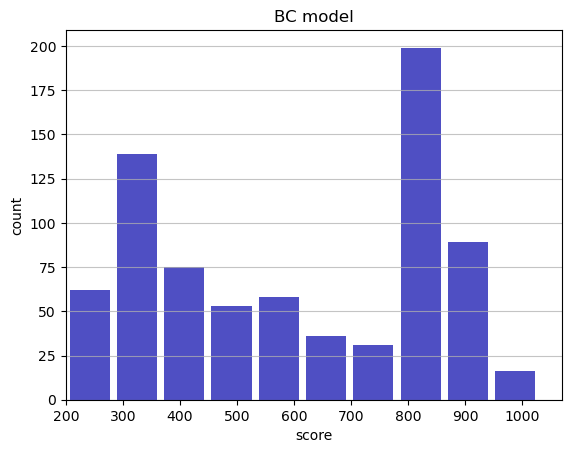

Track generation: 1201..1505 -> 304-tiles track
Epoch: 764
BC	mean: 600.64	variance: 239.80


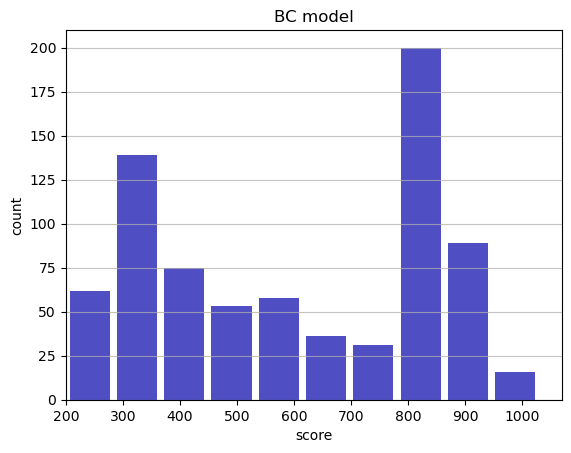

Track generation: 1118..1403 -> 285-tiles track
Epoch: 765
BC	mean: 600.30	variance: 239.84


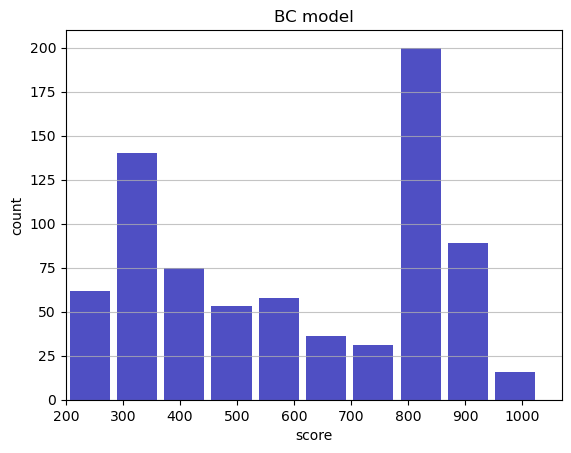

Track generation: 1328..1668 -> 340-tiles track
Epoch: 766
BC	mean: 600.75	variance: 240.01


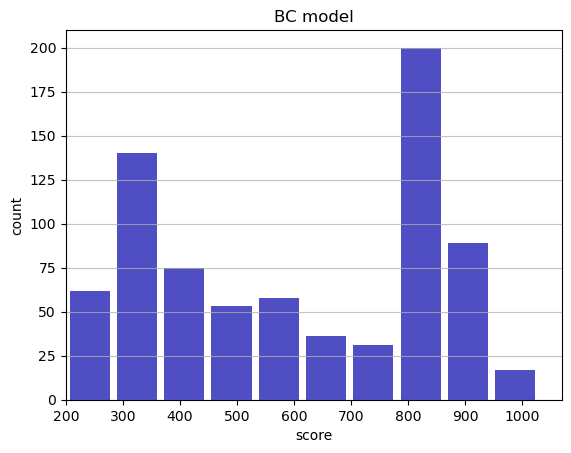

Track generation: 1007..1263 -> 256-tiles track
Epoch: 767
BC	mean: 600.82	variance: 239.87


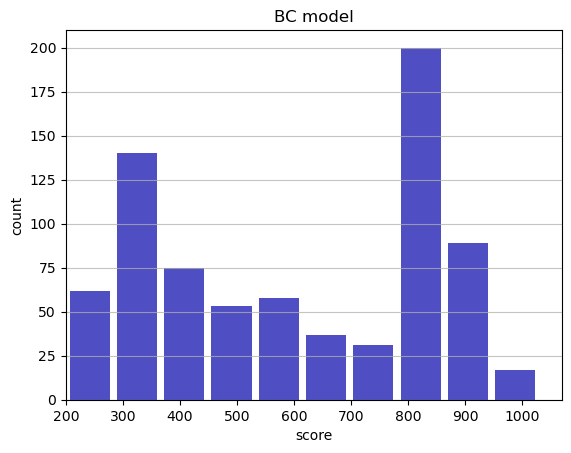

Track generation: 1156..1458 -> 302-tiles track
Epoch: 768
BC	mean: 601.15	variance: 239.89


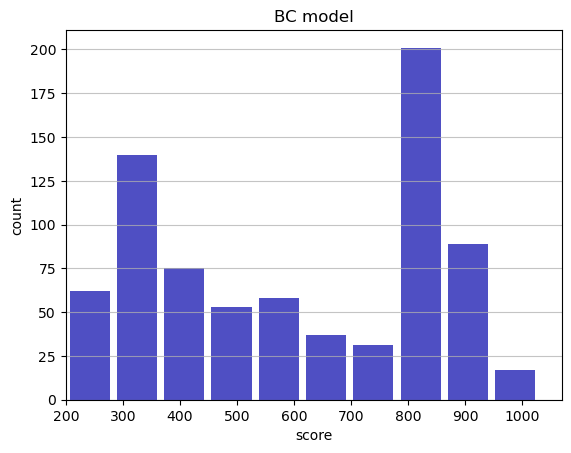

Track generation: 985..1240 -> 255-tiles track
Epoch: 769
BC	mean: 601.49	variance: 239.91


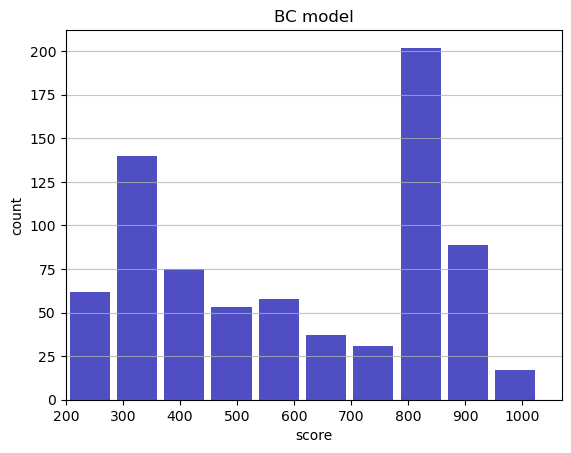

Track generation: 1083..1358 -> 275-tiles track
Epoch: 770
BC	mean: 601.07	variance: 240.03


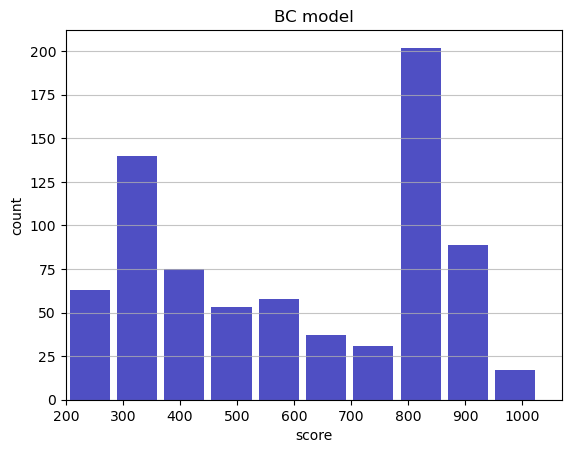

Track generation: 1295..1617 -> 322-tiles track
Epoch: 771
BC	mean: 601.50	variance: 240.17


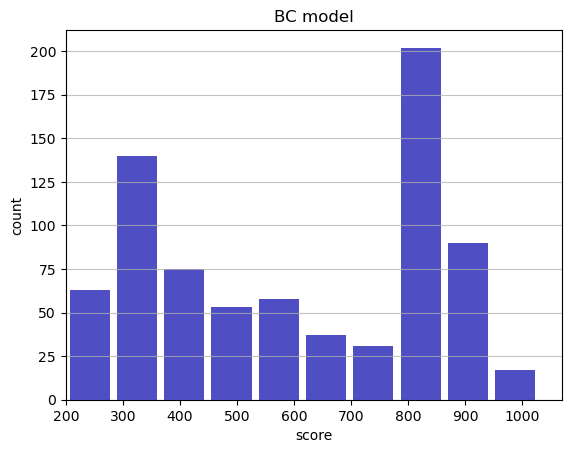

Track generation: 1133..1420 -> 287-tiles track
Epoch: 772
BC	mean: 601.18	variance: 240.18


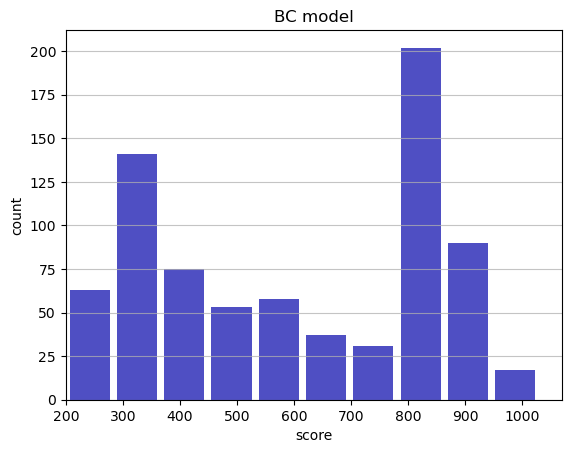

Track generation: 1068..1339 -> 271-tiles track
Epoch: 773
BC	mean: 601.05	variance: 240.05


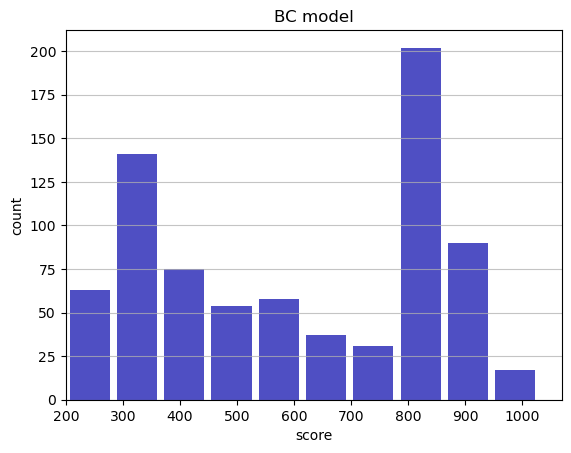

Track generation: 1052..1319 -> 267-tiles track
Epoch: 774
BC	mean: 601.36	variance: 240.05


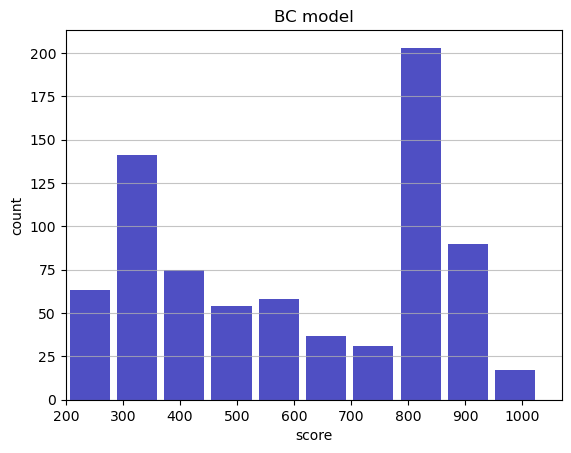

Track generation: 1294..1622 -> 328-tiles track
Epoch: 775
BC	mean: 601.28	variance: 239.90


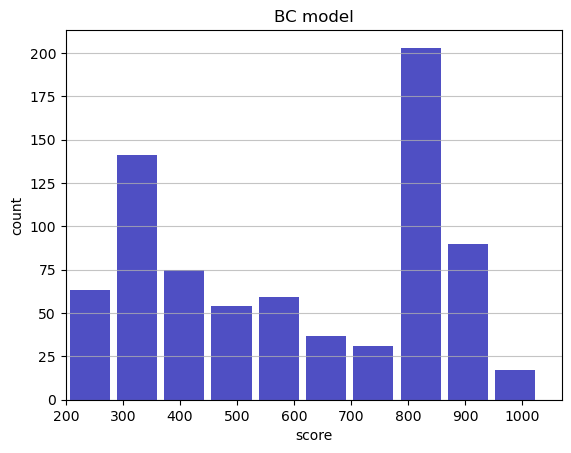

Track generation: 1109..1399 -> 290-tiles track
Epoch: 776
BC	mean: 601.45	variance: 239.79


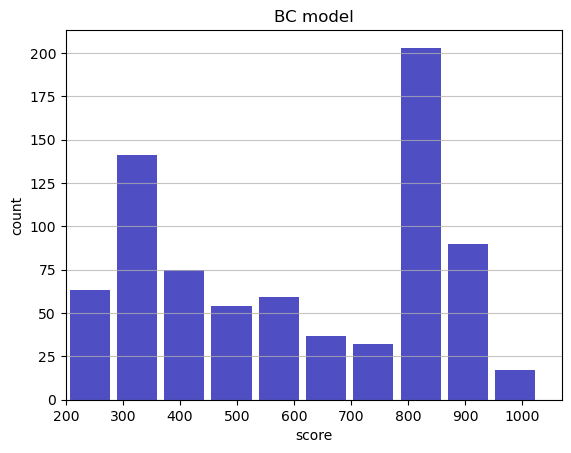

Track generation: 1067..1338 -> 271-tiles track
Epoch: 777
BC	mean: 601.12	variance: 239.82


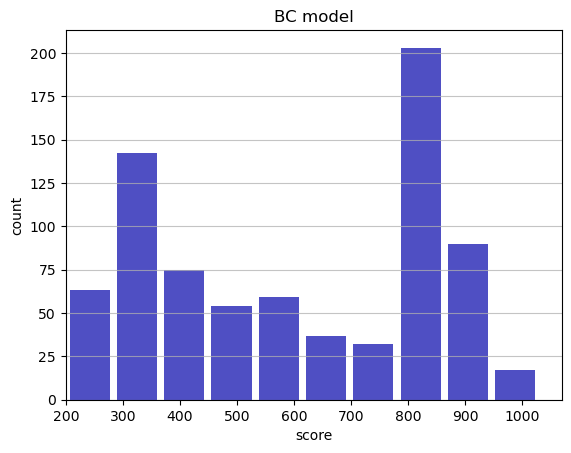

Track generation: 1112..1394 -> 282-tiles track
Epoch: 778
BC	mean: 600.85	variance: 239.78


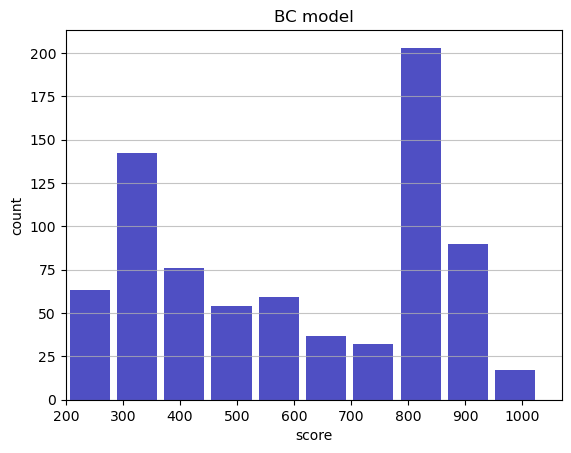

Track generation: 1047..1313 -> 266-tiles track
Epoch: 779
BC	mean: 600.58	variance: 239.75


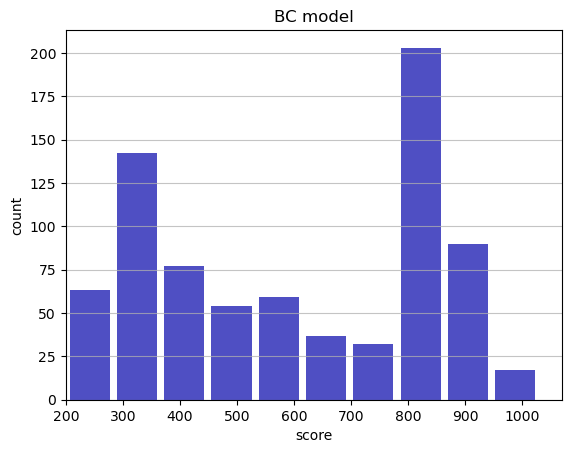

Track generation: 1245..1561 -> 316-tiles track
Epoch: 780
BC	mean: 600.27	variance: 239.75


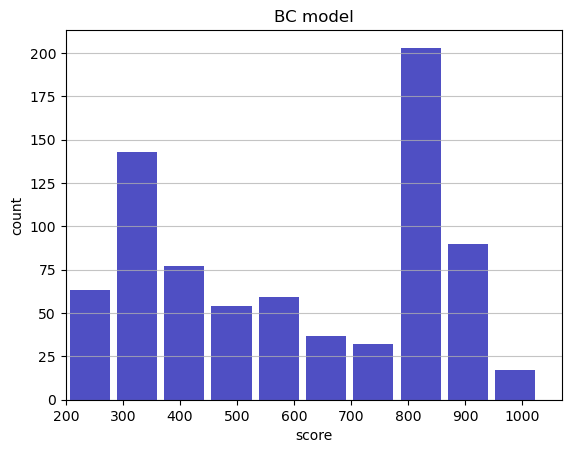

Track generation: 1308..1639 -> 331-tiles track
Epoch: 781
BC	mean: 599.82	variance: 239.93


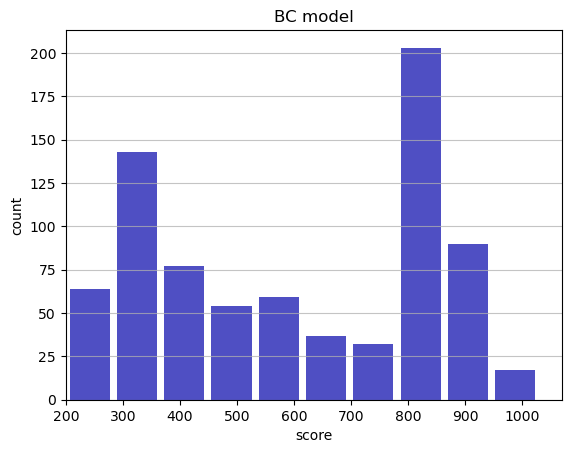

Track generation: 1213..1520 -> 307-tiles track
Epoch: 782
BC	mean: 600.12	variance: 239.92


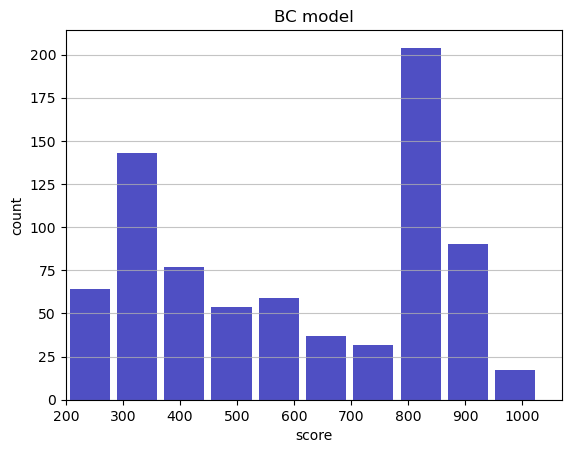

Track generation: 1146..1437 -> 291-tiles track
Epoch: 783
BC	mean: 600.04	variance: 239.78


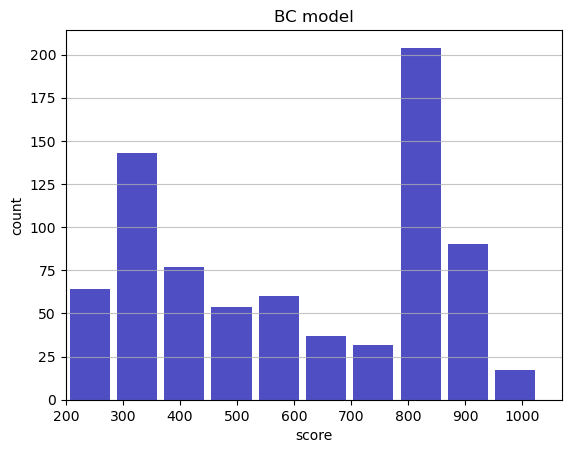

Track generation: 1081..1359 -> 278-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1273..1602 -> 329-tiles track
Epoch: 784
BC	mean: 600.17	variance: 239.65


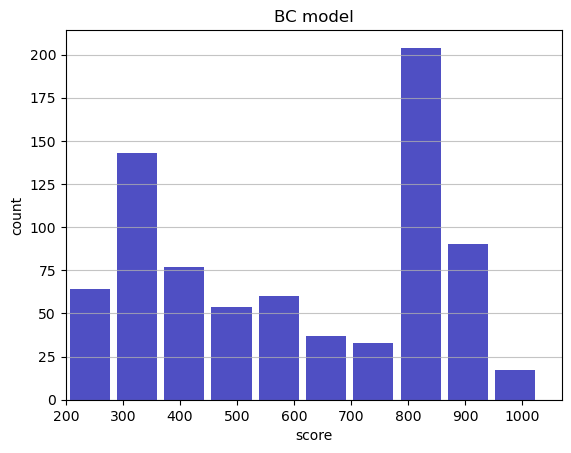

Track generation: 1210..1527 -> 317-tiles track
Epoch: 785
BC	mean: 599.95	variance: 239.58


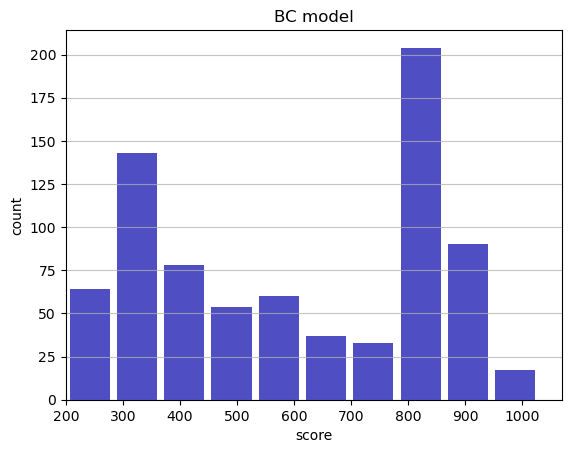

Track generation: 1161..1455 -> 294-tiles track
Epoch: 786
BC	mean: 600.18	variance: 239.51


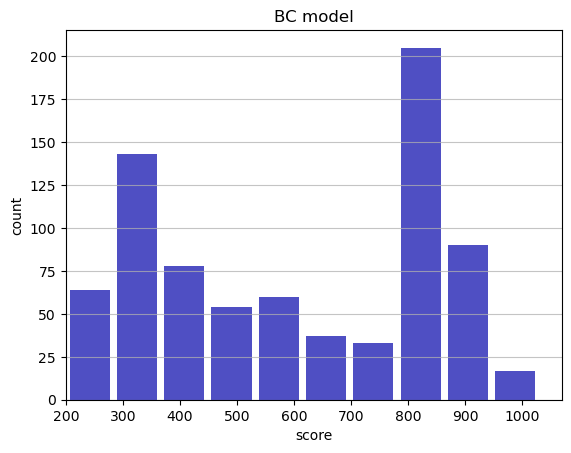

Track generation: 1123..1410 -> 287-tiles track
Epoch: 787
BC	mean: 600.22	variance: 239.36


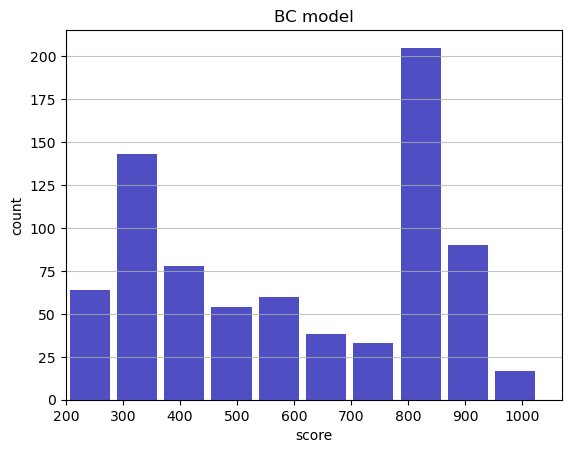

Track generation: 1176..1474 -> 298-tiles track
Epoch: 788
BC	mean: 600.62	variance: 239.47


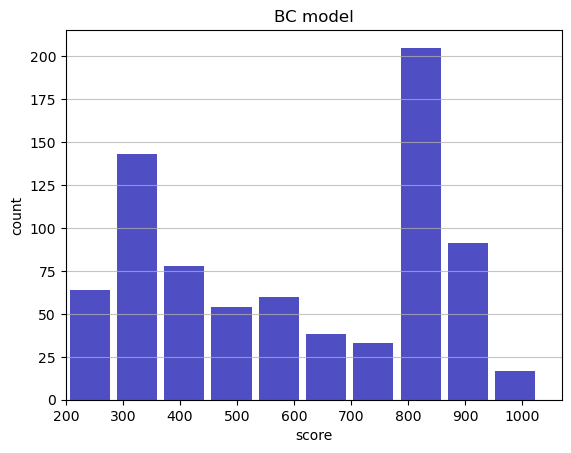

Track generation: 1121..1405 -> 284-tiles track
Epoch: 789
BC	mean: 600.89	variance: 239.44


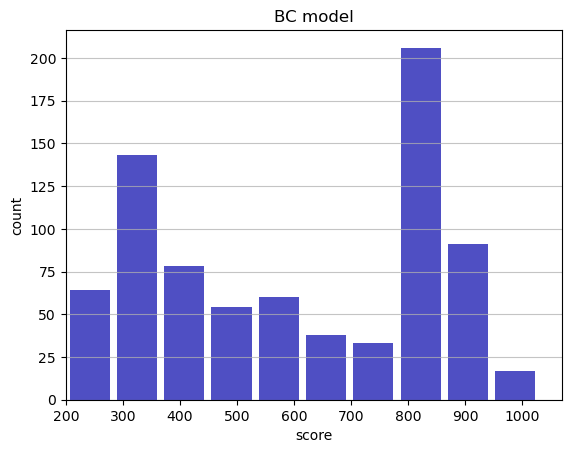

Track generation: 1062..1332 -> 270-tiles track
Epoch: 790
BC	mean: 601.22	variance: 239.47


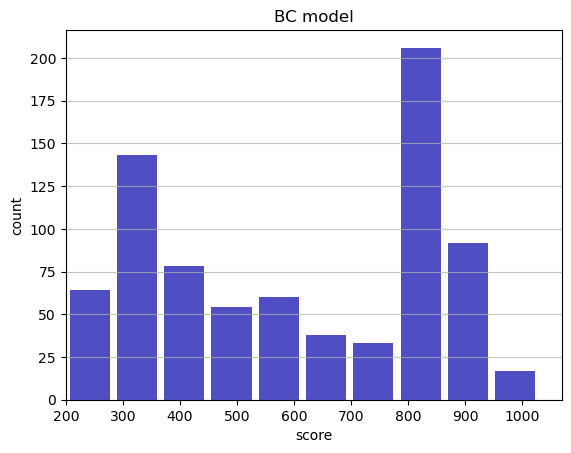

Track generation: 1063..1333 -> 270-tiles track
Epoch: 791
BC	mean: 600.98	variance: 239.42


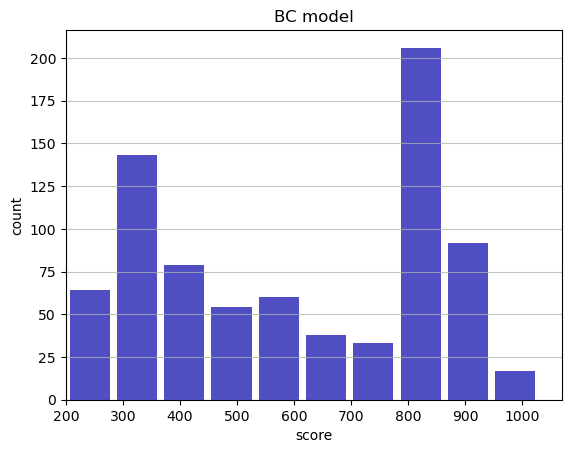

Track generation: 1090..1372 -> 282-tiles track
Epoch: 792
BC	mean: 601.34	variance: 239.49


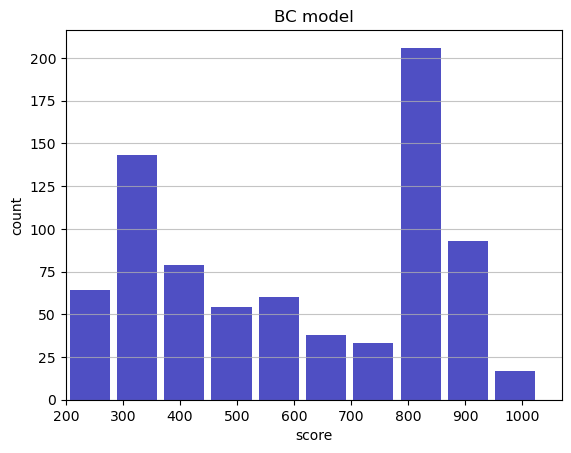

Track generation: 1031..1293 -> 262-tiles track
Epoch: 793
BC	mean: 601.07	variance: 239.46


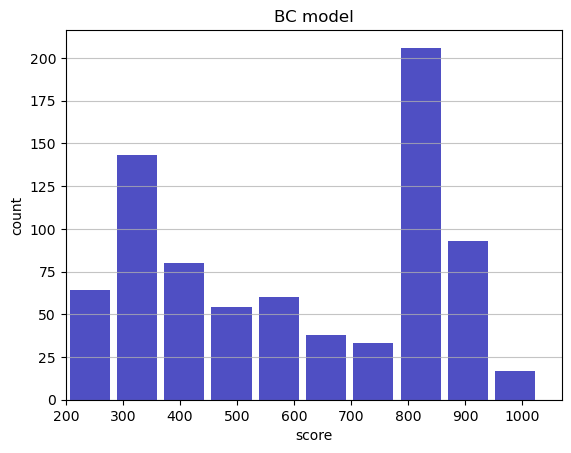

Track generation: 1069..1340 -> 271-tiles track
Epoch: 794
BC	mean: 600.72	variance: 239.51


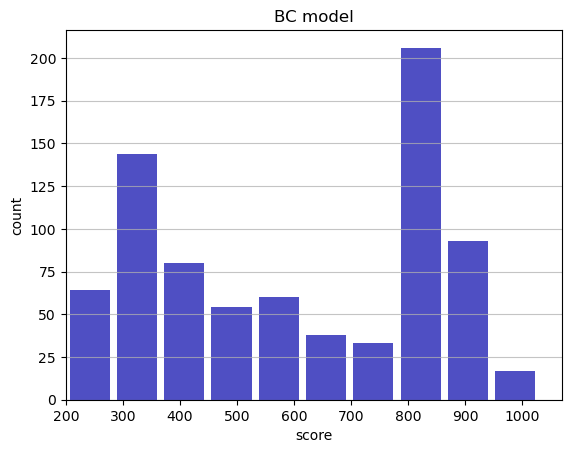

Track generation: 1150..1451 -> 301-tiles track
Epoch: 795
BC	mean: 600.75	variance: 239.36


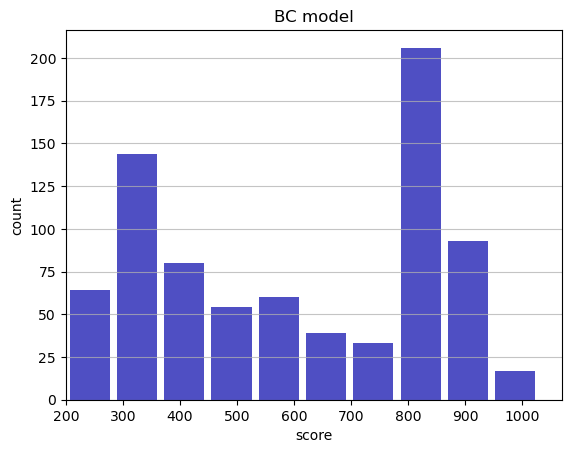

Track generation: 1276..1599 -> 323-tiles track
Epoch: 796
BC	mean: 600.40	variance: 239.42


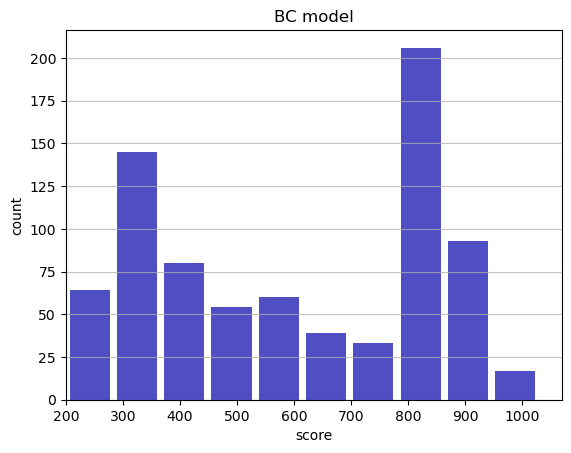

Track generation: 1231..1543 -> 312-tiles track
Epoch: 797
BC	mean: 600.48	variance: 239.28


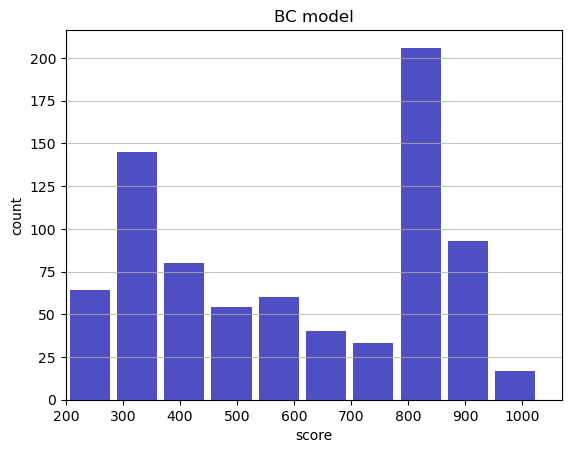

Track generation: 1137..1432 -> 295-tiles track
Epoch: 798
BC	mean: 600.84	variance: 239.34


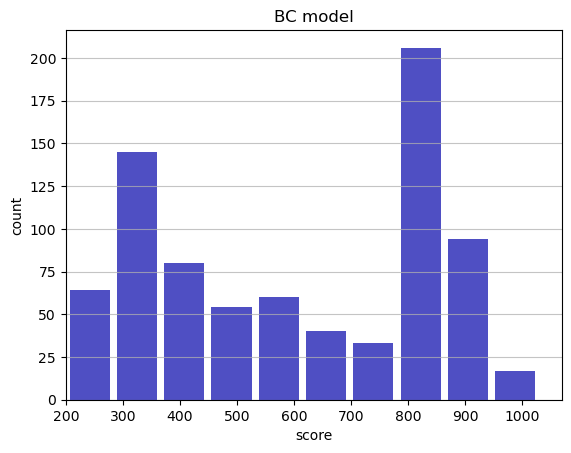

Track generation: 1371..1718 -> 347-tiles track
Epoch: 799
BC	mean: 601.26	variance: 239.49


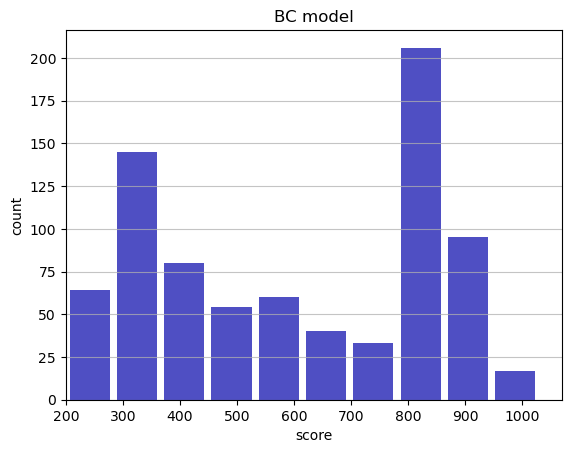

Track generation: 1044..1310 -> 266-tiles track
Epoch: 800
BC	mean: 600.89	variance: 239.57


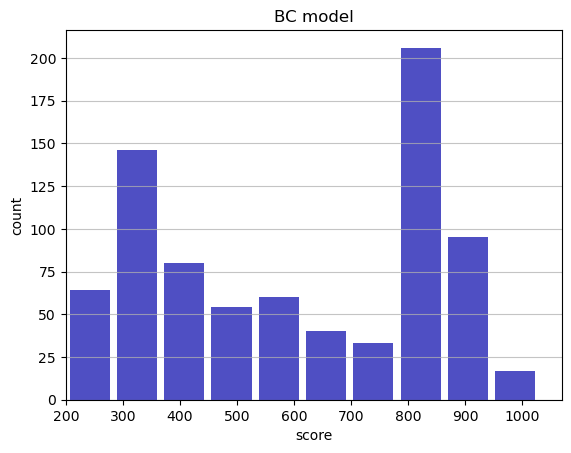

Track generation: 1219..1528 -> 309-tiles track
Epoch: 801
BC	mean: 600.55	variance: 239.62


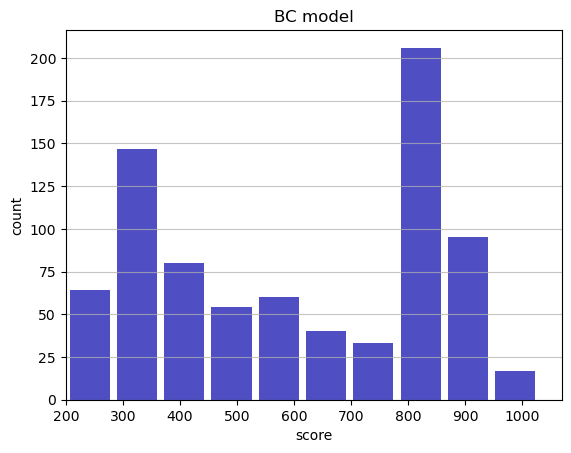

Track generation: 1164..1459 -> 295-tiles track
Epoch: 802
BC	mean: 600.57	variance: 239.47


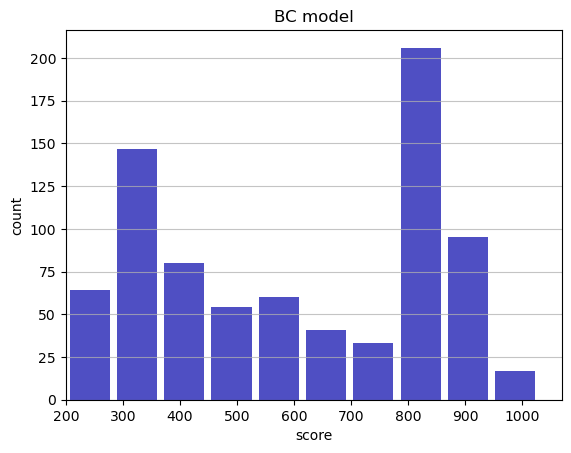

Track generation: 912..1150 -> 238-tiles track
Epoch: 803
BC	mean: 600.40	variance: 239.37


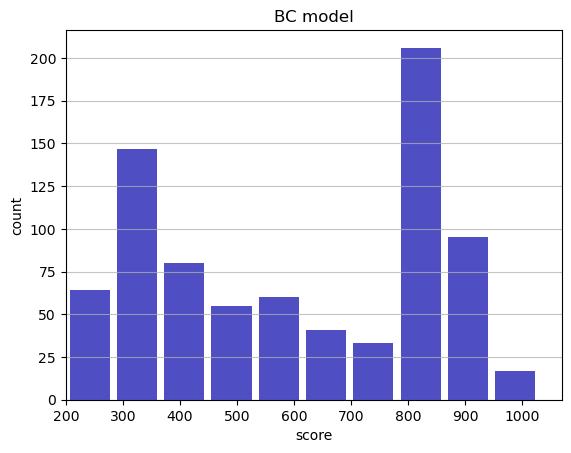

Track generation: 1232..1544 -> 312-tiles track
Epoch: 804
BC	mean: 600.75	variance: 239.43


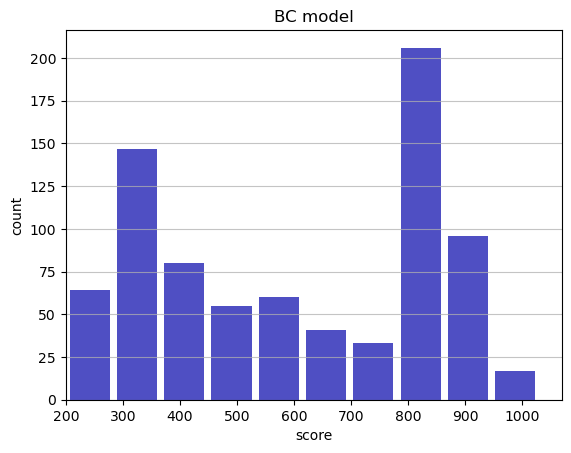

Track generation: 1130..1417 -> 287-tiles track
Epoch: 805
BC	mean: 600.44	variance: 239.44


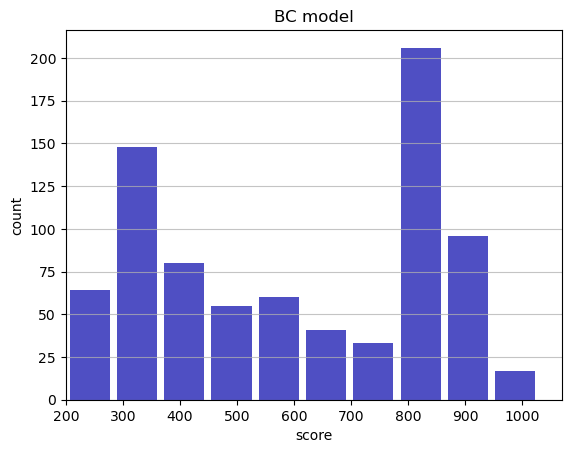

Track generation: 946..1190 -> 244-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1071..1351 -> 280-tiles track
Epoch: 806
BC	mean: 600.70	variance: 239.41


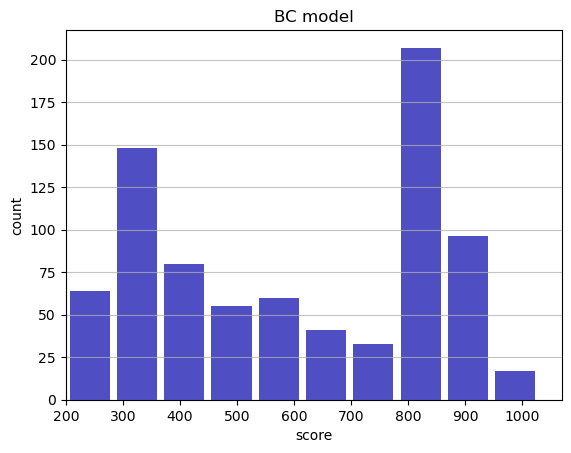

Track generation: 1056..1324 -> 268-tiles track
Epoch: 807
BC	mean: 600.99	variance: 239.40


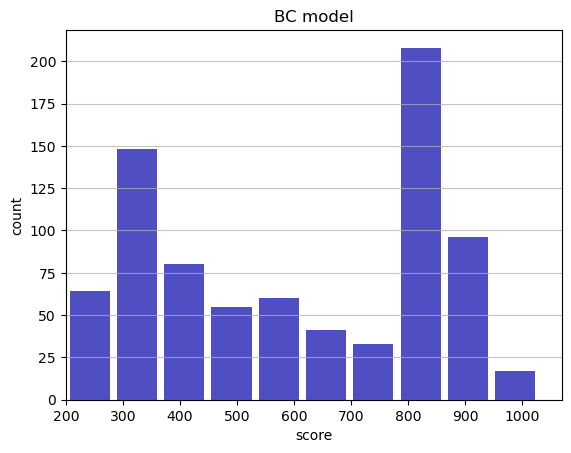

Track generation: 1264..1584 -> 320-tiles track
Epoch: 808
BC	mean: 600.53	variance: 239.61


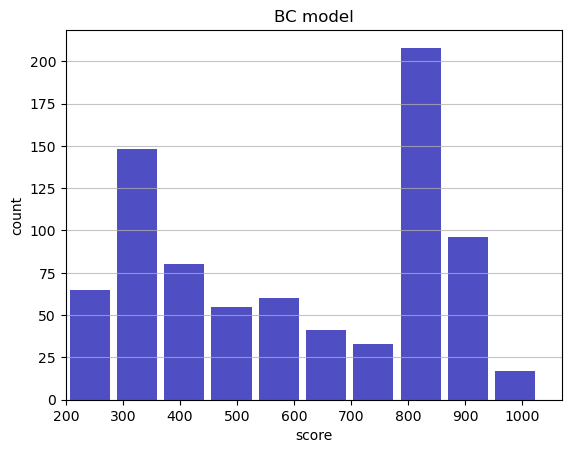

Track generation: 1372..1719 -> 347-tiles track
Epoch: 809
BC	mean: 600.94	variance: 239.74


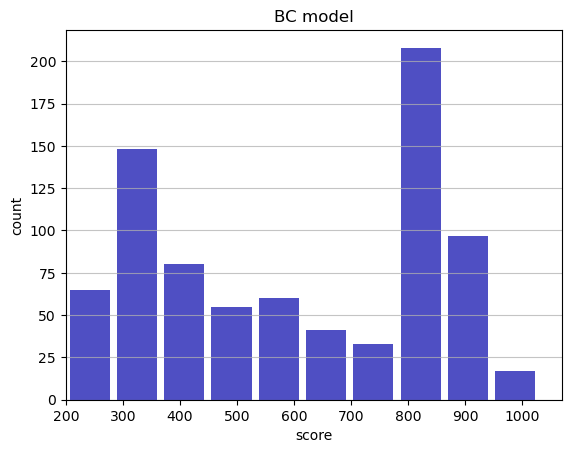

Track generation: 1249..1565 -> 316-tiles track
Epoch: 810
BC	mean: 601.34	variance: 239.87


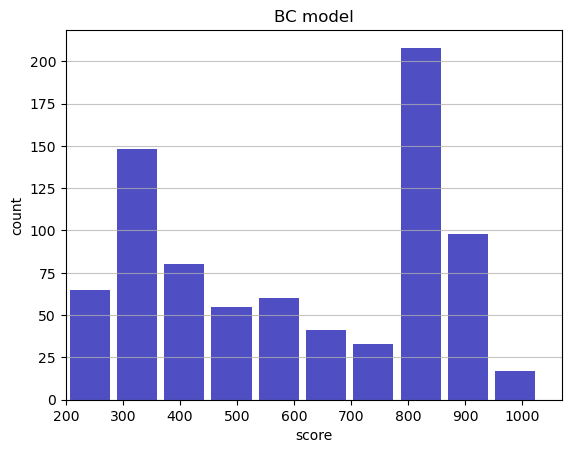

Track generation: 1109..1390 -> 281-tiles track
Epoch: 811
BC	mean: 601.66	variance: 239.88


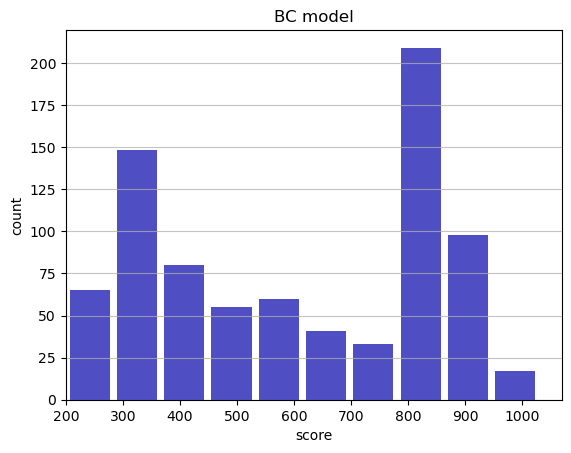

Track generation: 1039..1303 -> 264-tiles track
Epoch: 812
BC	mean: 601.51	variance: 239.77


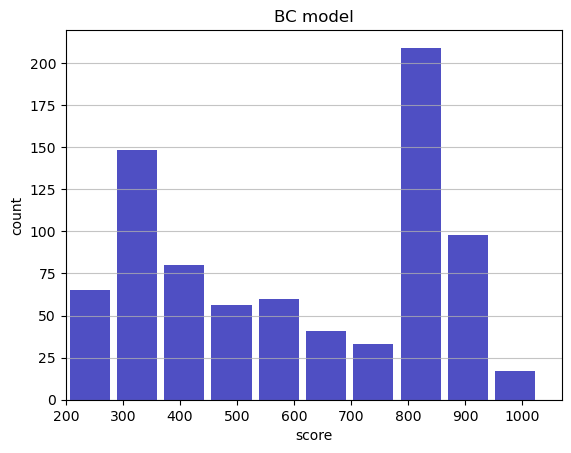

Track generation: 1114..1405 -> 291-tiles track
Epoch: 813
BC	mean: 601.35	variance: 239.66


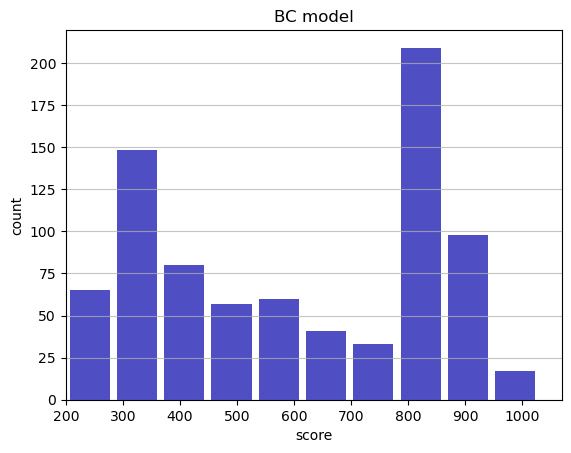

Track generation: 1096..1374 -> 278-tiles track
Epoch: 814
BC	mean: 601.03	variance: 239.70


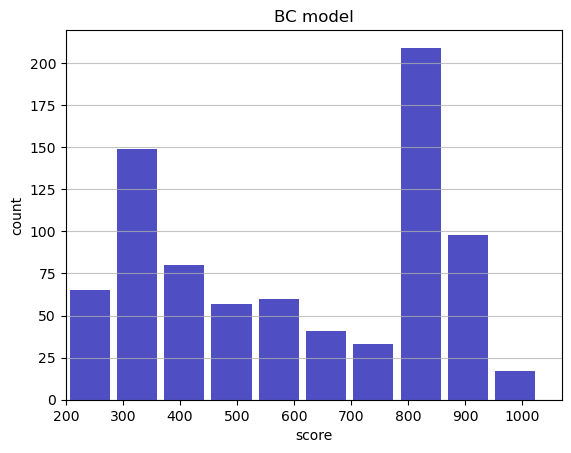

Track generation: 1275..1598 -> 323-tiles track
Epoch: 815
BC	mean: 600.66	variance: 239.77


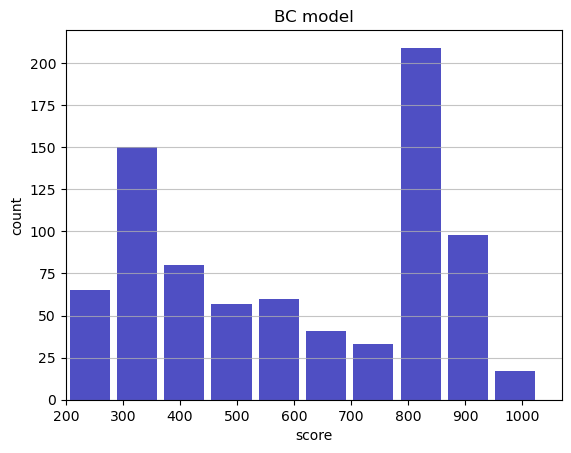

Track generation: 1211..1518 -> 307-tiles track
Epoch: 816
BC	mean: 600.23	variance: 239.94


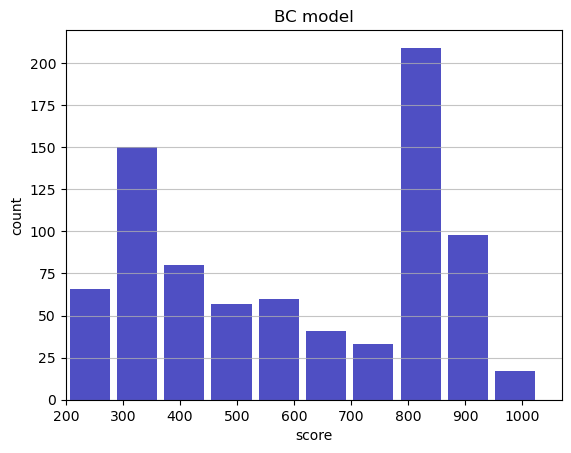

Track generation: 1020..1285 -> 265-tiles track
Epoch: 817
BC	mean: 600.17	variance: 239.80


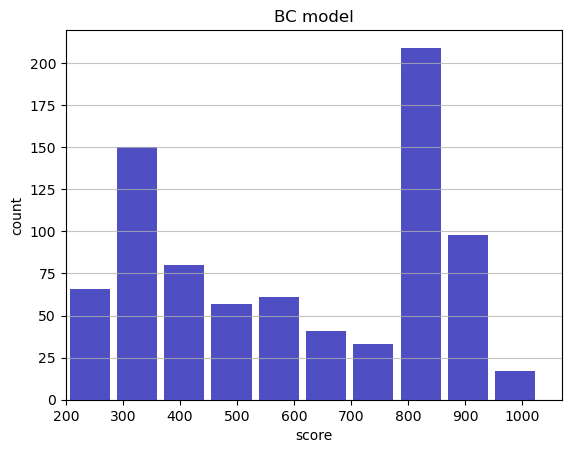

Track generation: 1072..1344 -> 272-tiles track
Epoch: 818
BC	mean: 599.89	variance: 239.79


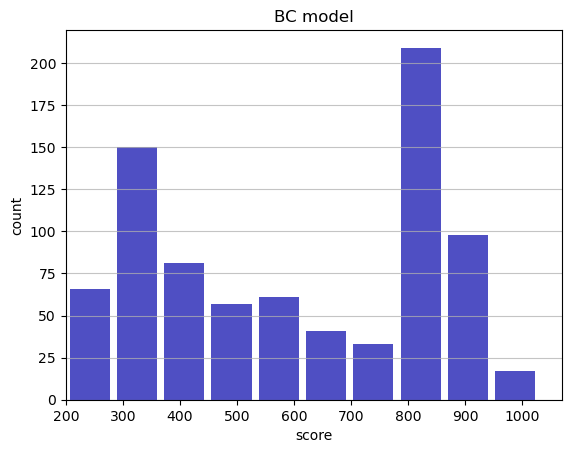

Track generation: 1228..1539 -> 311-tiles track
Epoch: 819
BC	mean: 599.56	variance: 239.82


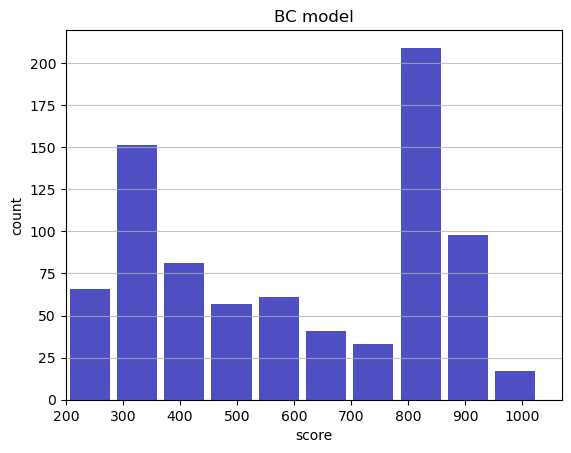

Track generation: 1266..1586 -> 320-tiles track
Epoch: 820
BC	mean: 599.34	variance: 239.76


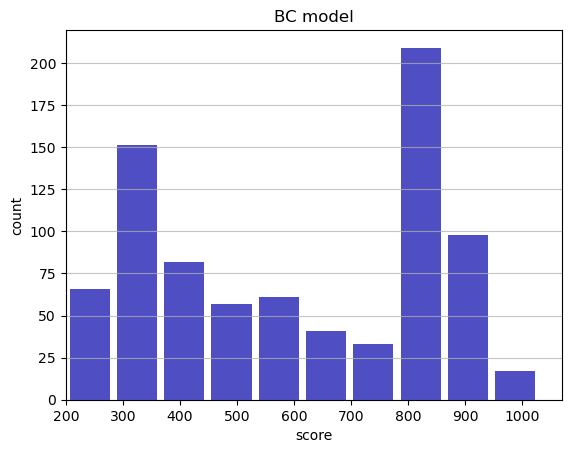

Track generation: 1007..1271 -> 264-tiles track
Epoch: 821
BC	mean: 599.38	variance: 239.62


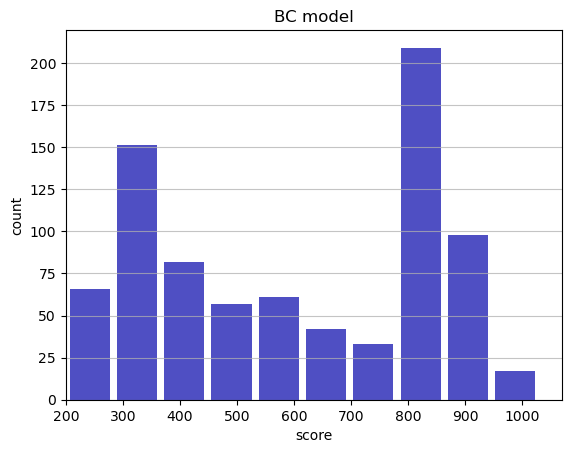

Track generation: 1023..1283 -> 260-tiles track
Epoch: 822
BC	mean: 599.11	variance: 239.59


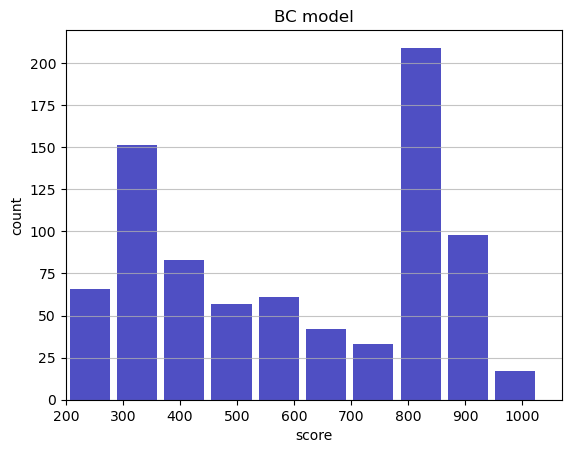

Track generation: 991..1250 -> 259-tiles track
Epoch: 823
BC	mean: 598.74	variance: 239.69


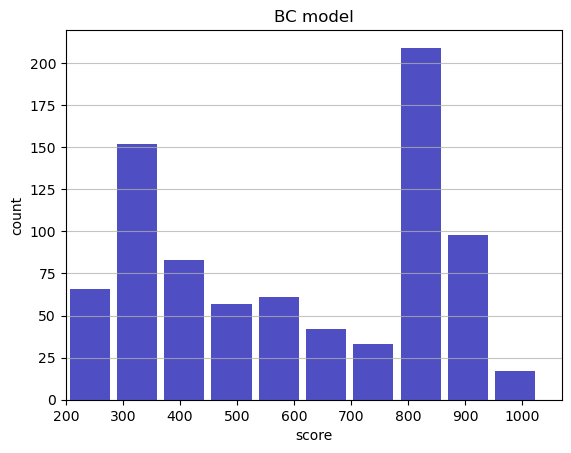

Track generation: 1375..1723 -> 348-tiles track
Epoch: 824
BC	mean: 598.25	variance: 239.95


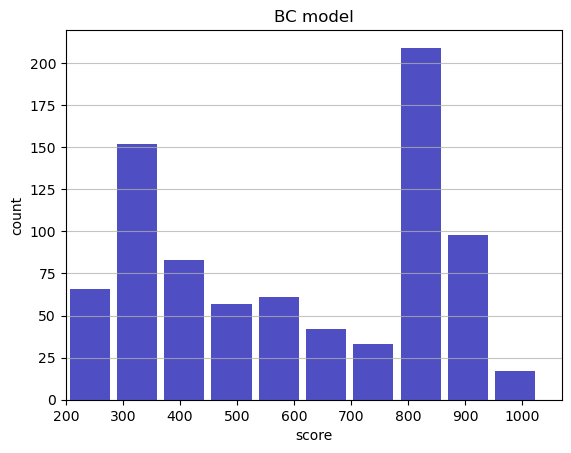

Track generation: 1293..1620 -> 327-tiles track
Epoch: 825
BC	mean: 597.86	variance: 240.06


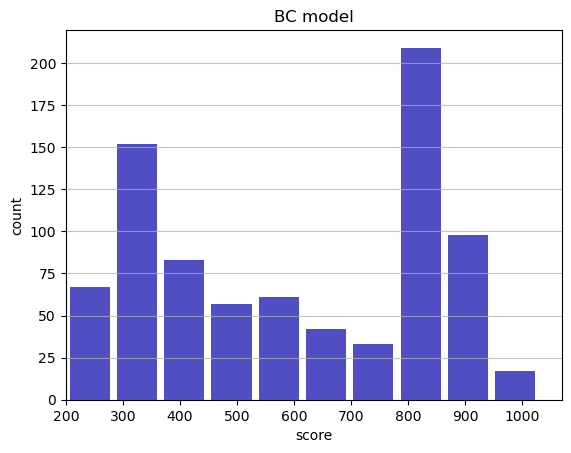

Track generation: 1029..1290 -> 261-tiles track
Epoch: 826
BC	mean: 598.17	variance: 240.08


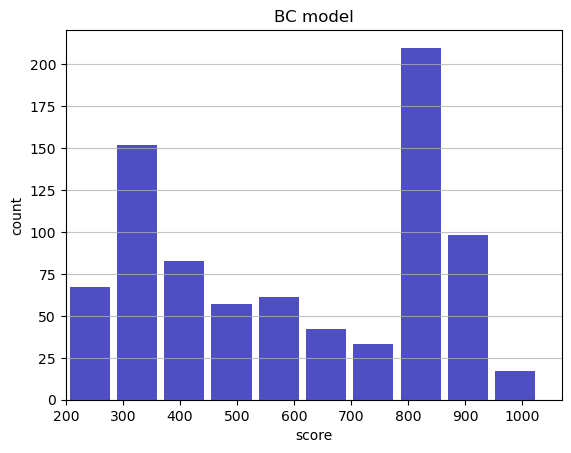

Track generation: 1083..1358 -> 275-tiles track
Epoch: 827
BC	mean: 598.08	variance: 239.95


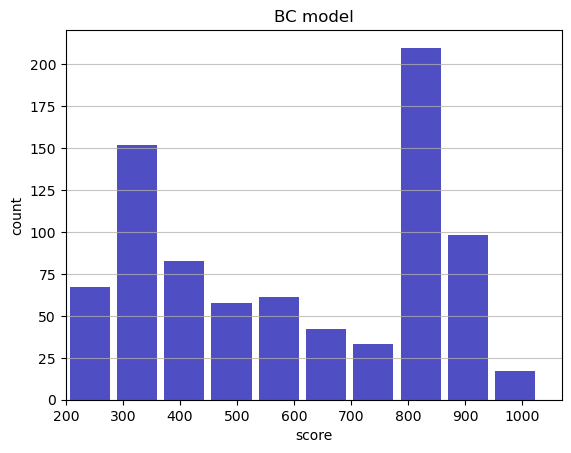

Track generation: 1292..1619 -> 327-tiles track
Epoch: 828
BC	mean: 597.81	variance: 239.92


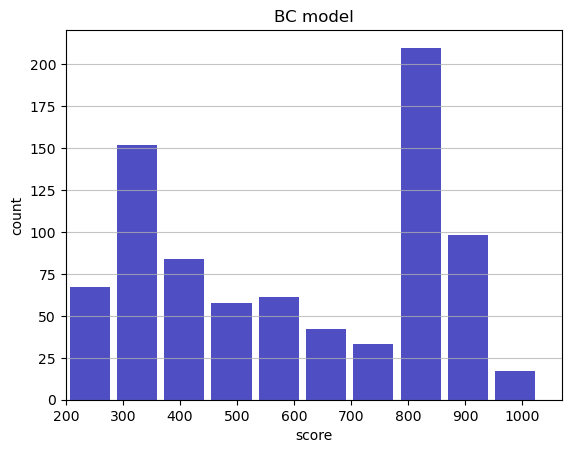

Track generation: 1142..1432 -> 290-tiles track
Epoch: 829
BC	mean: 597.91	variance: 239.79


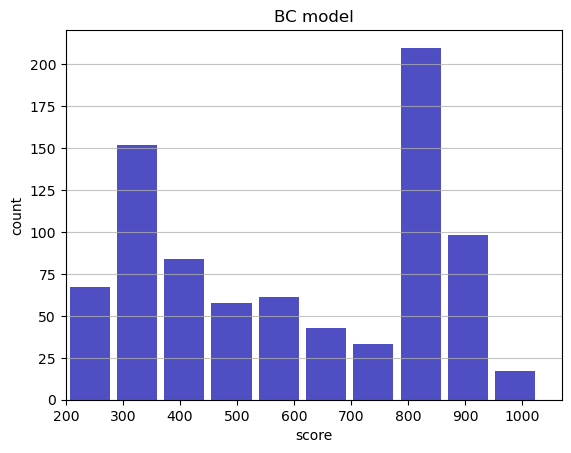

Track generation: 1227..1538 -> 311-tiles track
Epoch: 830
BC	mean: 597.48	variance: 239.97


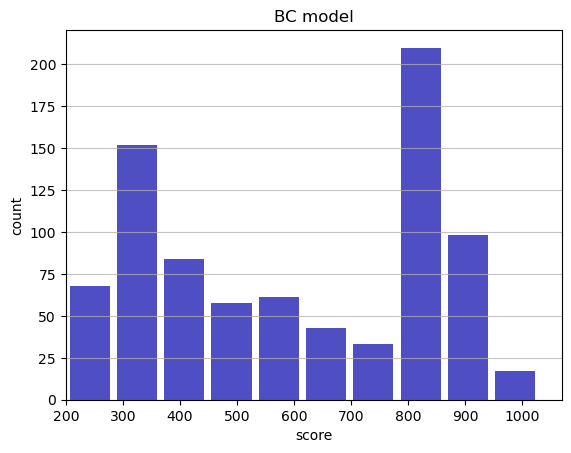

Track generation: 1236..1549 -> 313-tiles track
Epoch: 831
BC	mean: 597.80	variance: 240.00


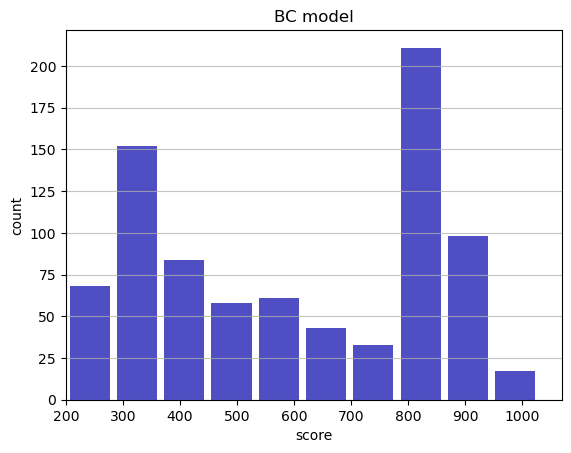

Track generation: 1198..1502 -> 304-tiles track
Epoch: 832
BC	mean: 597.42	variance: 240.10


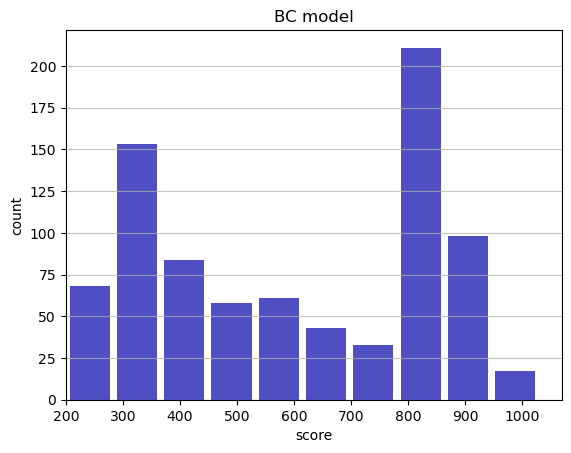

Track generation: 1084..1359 -> 275-tiles track
Epoch: 833
BC	mean: 597.32	variance: 239.98


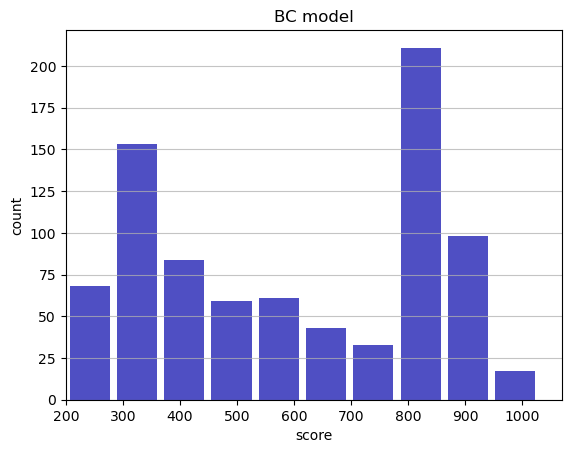

Track generation: 1137..1425 -> 288-tiles track
Epoch: 834
BC	mean: 597.63	variance: 240.00


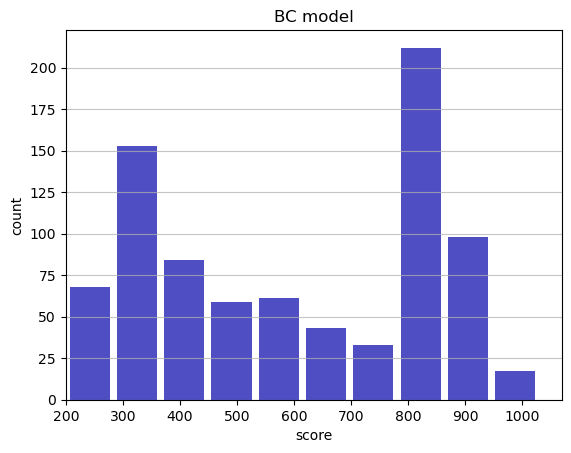

Track generation: 1141..1438 -> 297-tiles track
Epoch: 835
BC	mean: 597.39	variance: 239.96


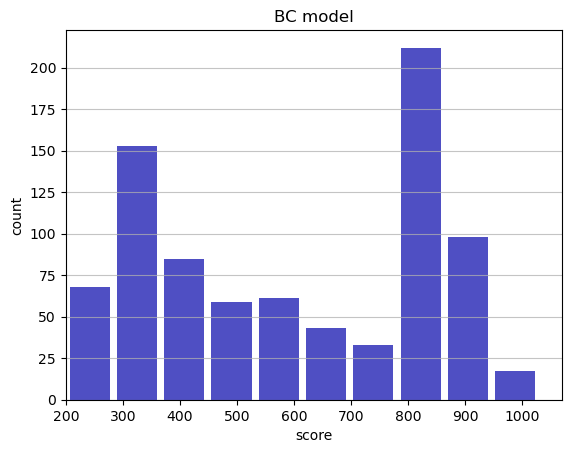

Track generation: 1158..1452 -> 294-tiles track
Epoch: 836
BC	mean: 597.04	variance: 240.03


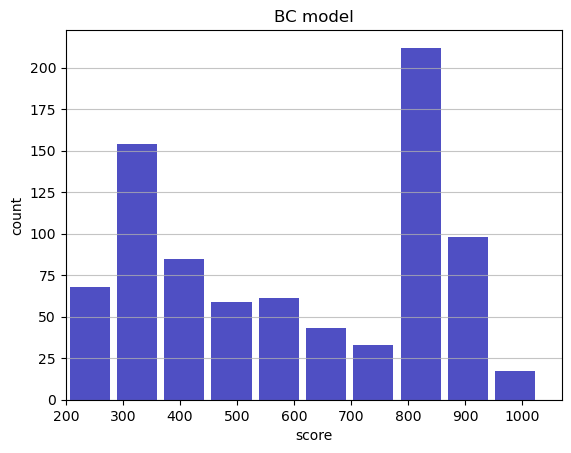

Track generation: 1176..1474 -> 298-tiles track
Epoch: 837
BC	mean: 596.62	variance: 240.19


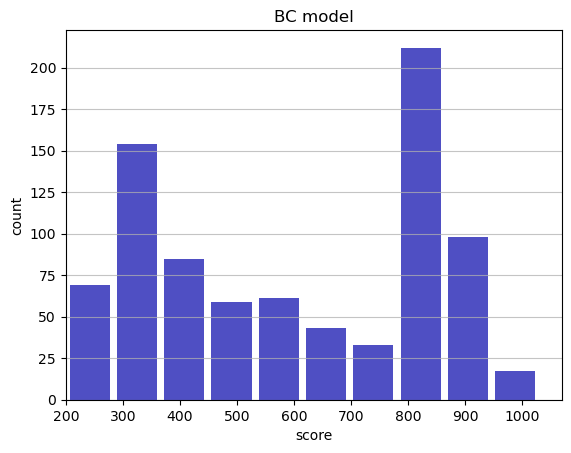

Track generation: 1104..1384 -> 280-tiles track
Epoch: 838
BC	mean: 596.93	variance: 240.21


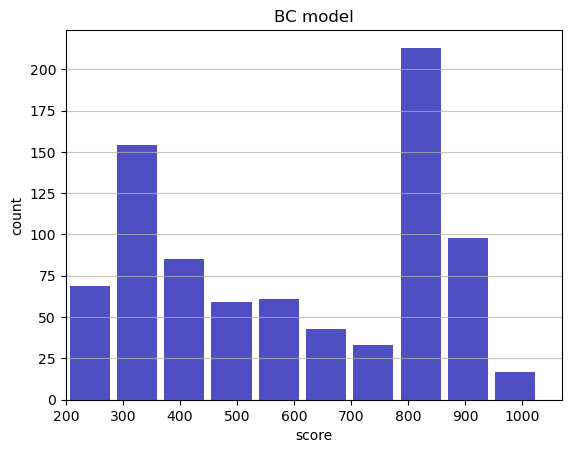

Track generation: 1306..1636 -> 330-tiles track
Epoch: 839
BC	mean: 597.33	variance: 240.35


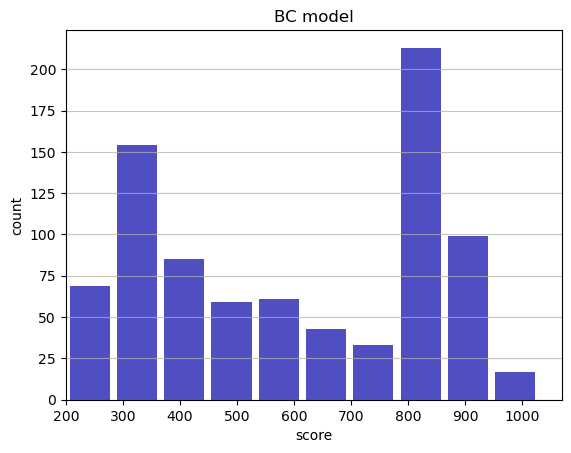

Track generation: 1079..1353 -> 274-tiles track
Epoch: 840
BC	mean: 597.66	variance: 240.40


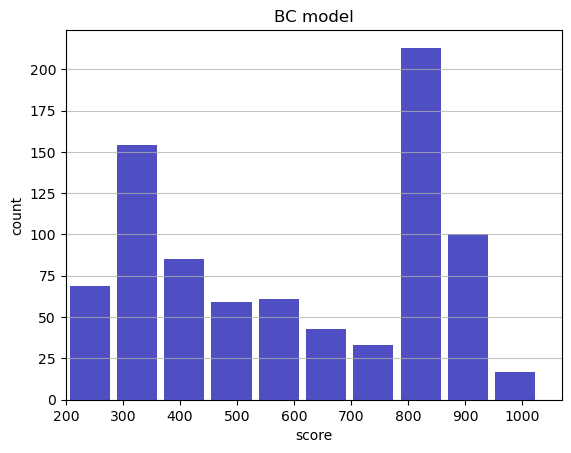

Track generation: 1151..1446 -> 295-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1162..1461 -> 299-tiles track
Epoch: 841
BC	mean: 597.35	variance: 240.43


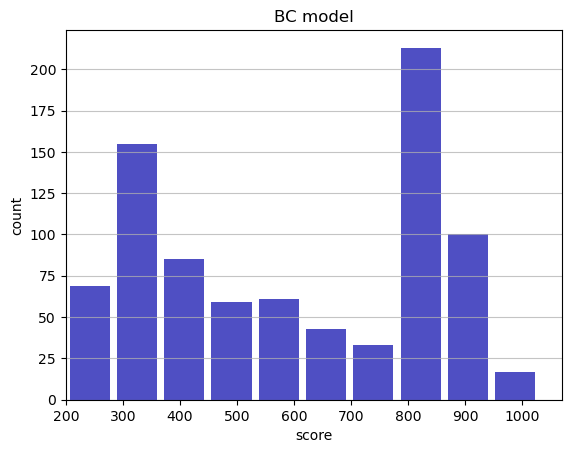

Track generation: 1152..1444 -> 292-tiles track
Epoch: 842
BC	mean: 597.62	variance: 240.42


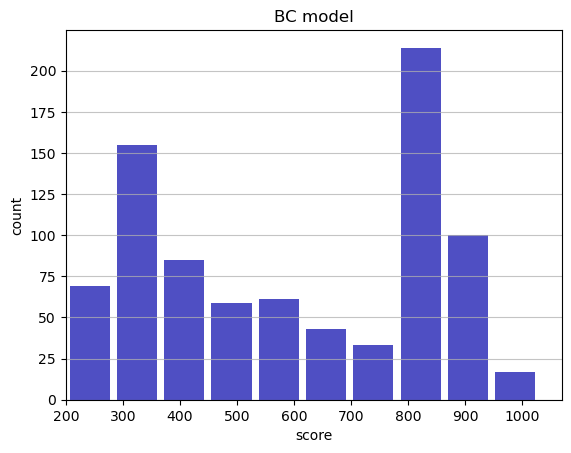

Track generation: 1256..1574 -> 318-tiles track
Epoch: 843
BC	mean: 597.38	variance: 240.38


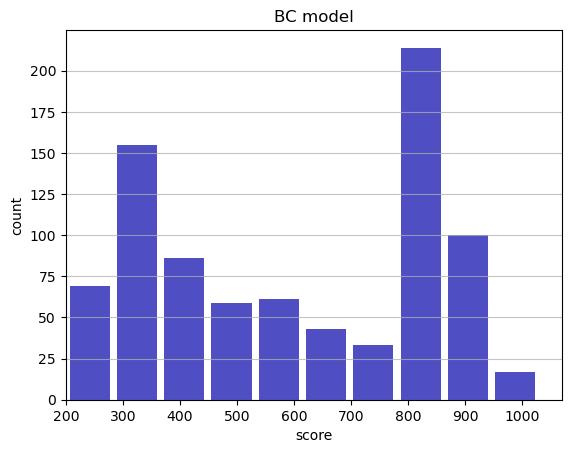

Track generation: 1099..1384 -> 285-tiles track
Epoch: 844
BC	mean: 597.07	variance: 240.40


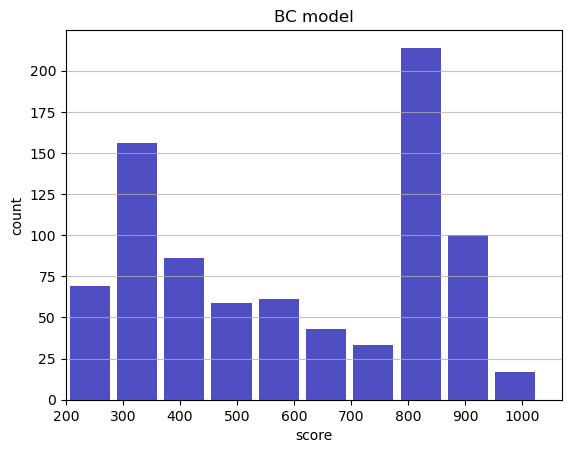

Track generation: 1112..1394 -> 282-tiles track
Epoch: 845
BC	mean: 596.79	variance: 240.39


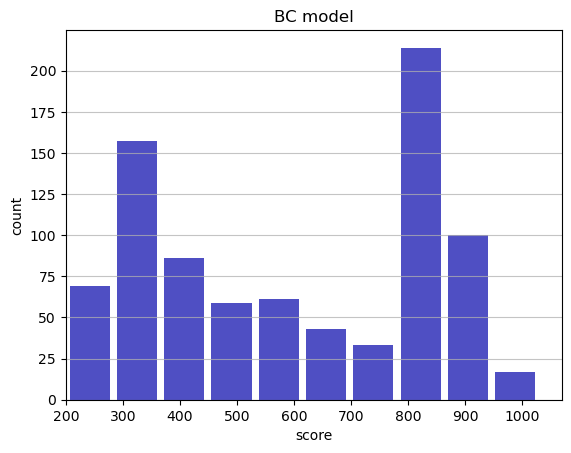

Track generation: 1342..1682 -> 340-tiles track
Epoch: 846
BC	mean: 596.56	variance: 240.34


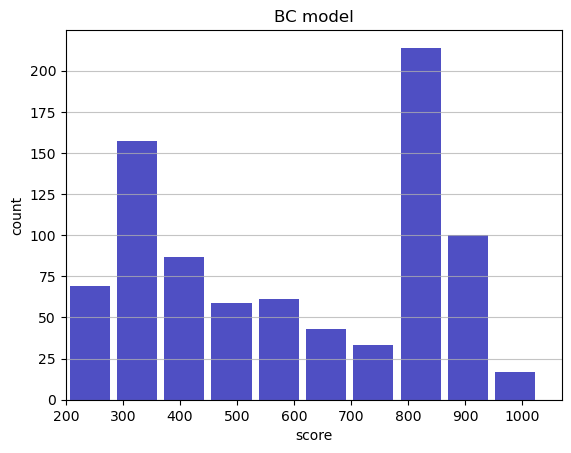

Track generation: 1160..1454 -> 294-tiles track
Epoch: 847
BC	mean: 596.58	variance: 240.20


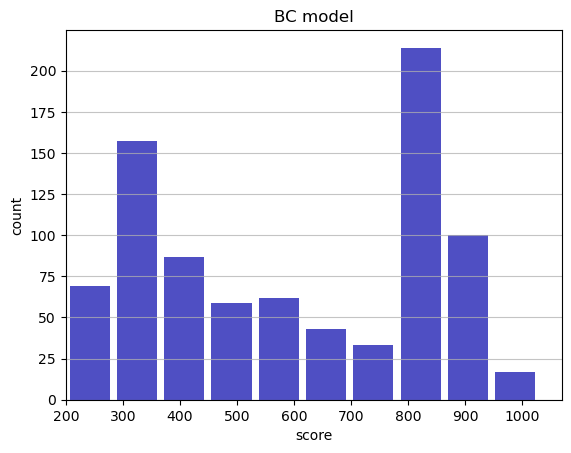

Track generation: 1087..1363 -> 276-tiles track
Epoch: 848
BC	mean: 596.82	variance: 240.16


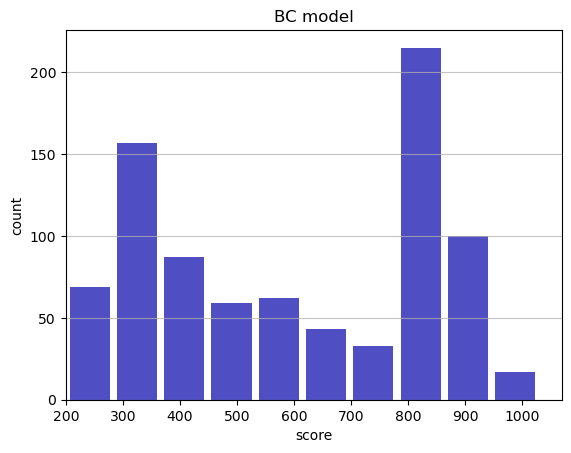

Track generation: 1171..1468 -> 297-tiles track
Epoch: 849
BC	mean: 597.32	variance: 240.47


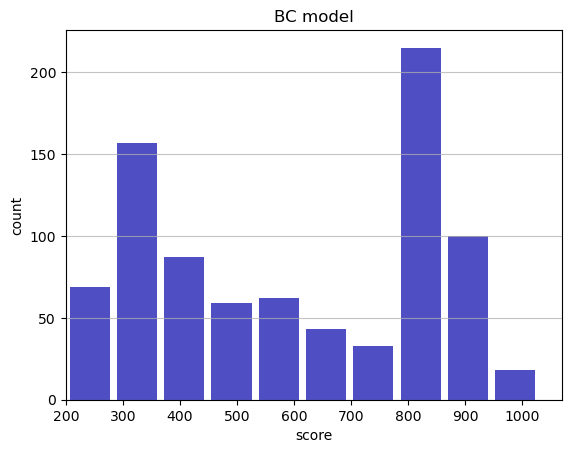

Track generation: 1263..1583 -> 320-tiles track
Epoch: 850
BC	mean: 597.72	variance: 240.61


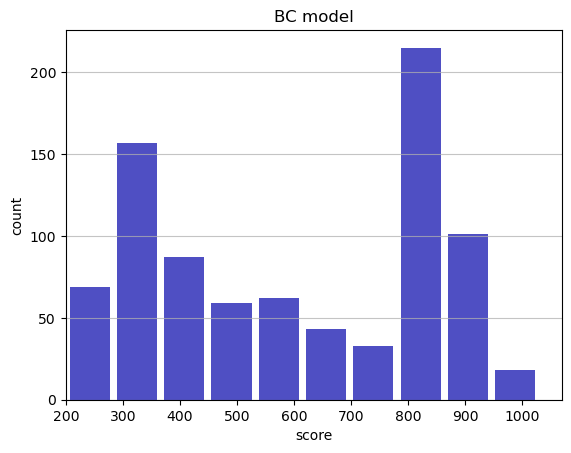

Track generation: 1193..1495 -> 302-tiles track
Epoch: 851
BC	mean: 597.43	variance: 240.61


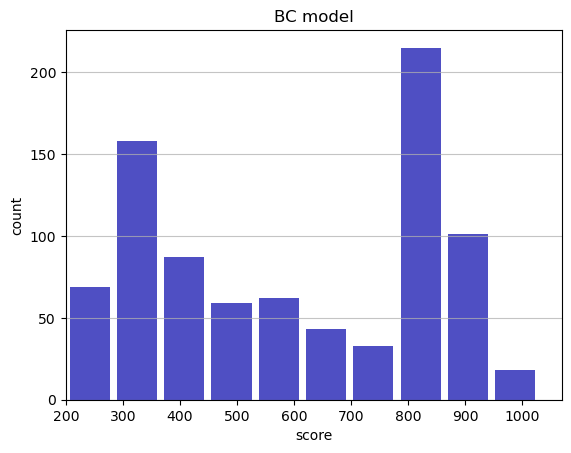

Track generation: 1013..1270 -> 257-tiles track
Epoch: 852
BC	mean: 597.71	variance: 240.61


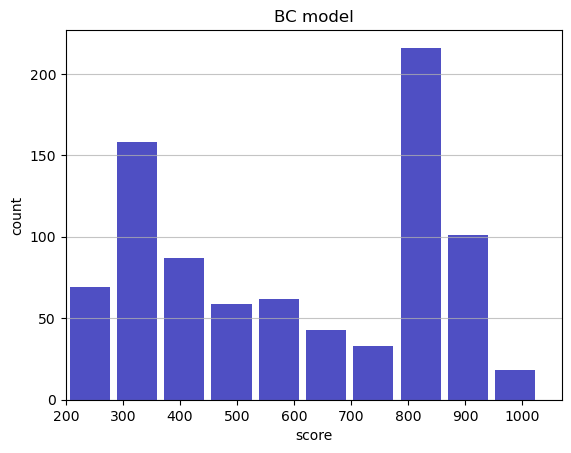

Track generation: 1136..1424 -> 288-tiles track
Epoch: 853
BC	mean: 597.98	variance: 240.60


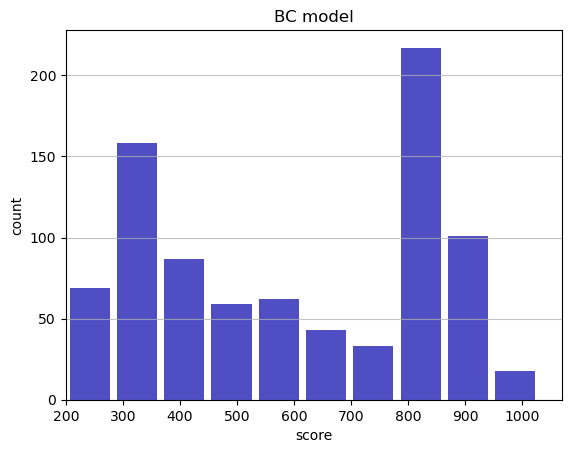

Track generation: 1093..1377 -> 284-tiles track
Epoch: 854
BC	mean: 597.69	variance: 240.61


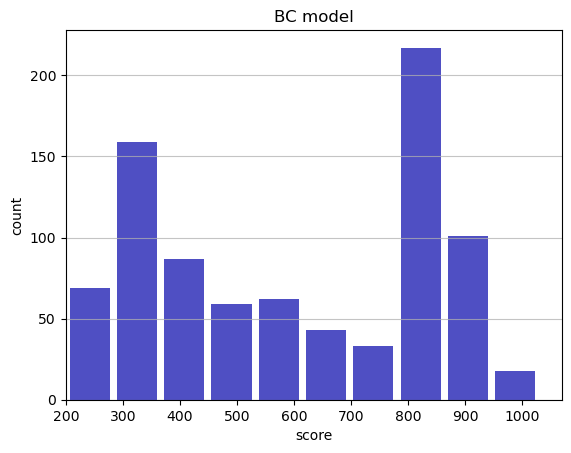

Track generation: 1192..1494 -> 302-tiles track
Epoch: 855
BC	mean: 597.69	variance: 240.47


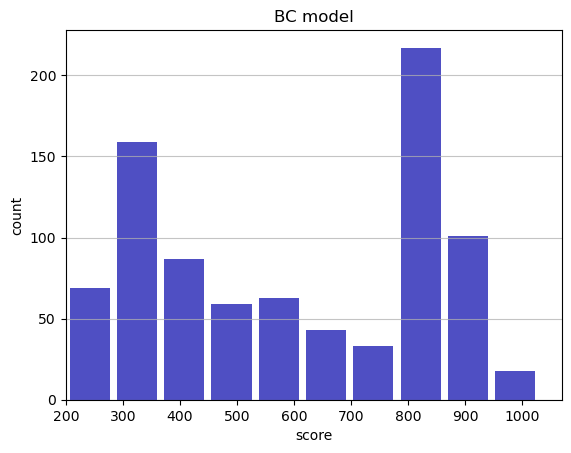

Track generation: 1206..1512 -> 306-tiles track
Epoch: 856
BC	mean: 597.33	variance: 240.55


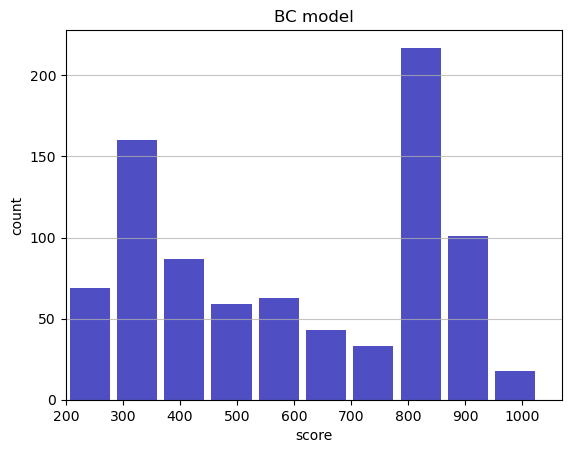

Track generation: 1279..1603 -> 324-tiles track
Epoch: 857
BC	mean: 597.27	variance: 240.42


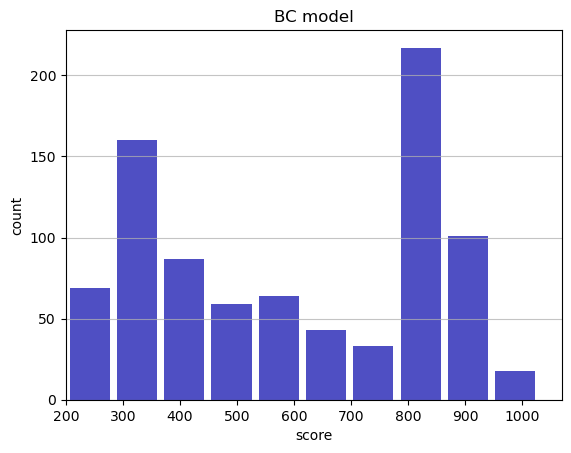

Track generation: 1025..1285 -> 260-tiles track
Epoch: 858
BC	mean: 597.04	variance: 240.38


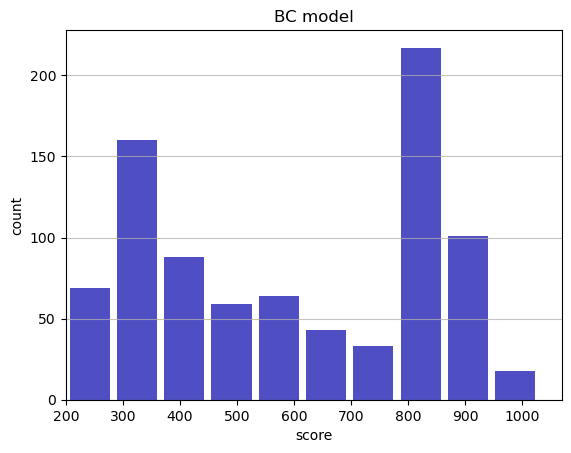

Track generation: 1083..1358 -> 275-tiles track
Epoch: 859
BC	mean: 597.39	variance: 240.46


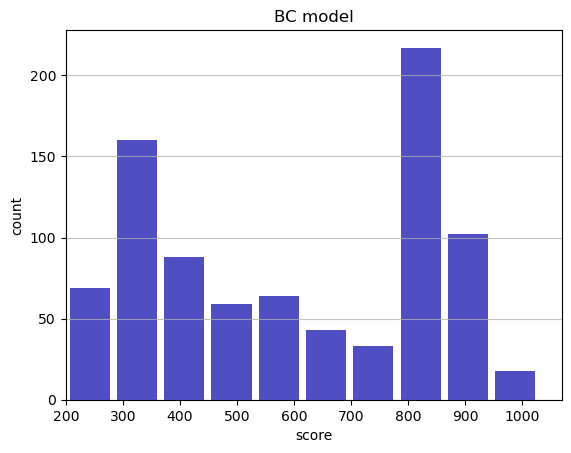

Track generation: 1040..1308 -> 268-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1143..1435 -> 292-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1138..1433 -> 295-tiles track
Epoch: 860
BC	mean: 597.81	variance: 240.64


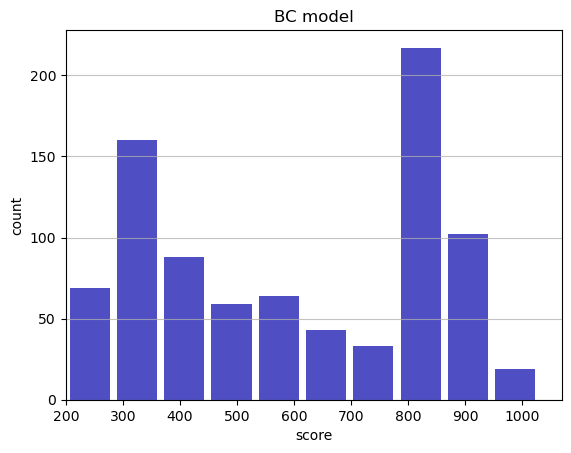

Track generation: 1096..1374 -> 278-tiles track
Epoch: 861
BC	mean: 597.93	variance: 240.52


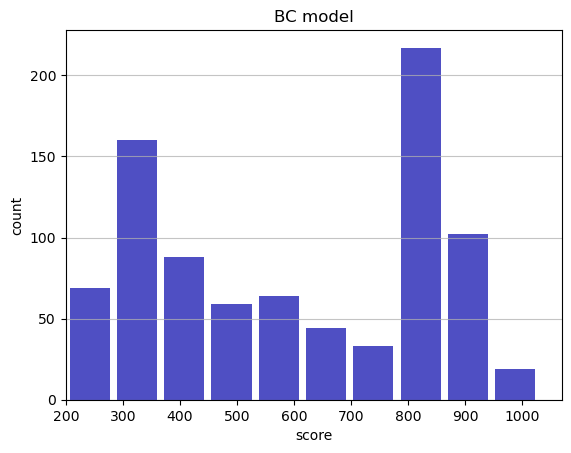

Track generation: 1150..1441 -> 291-tiles track
Epoch: 862
BC	mean: 597.54	variance: 240.64


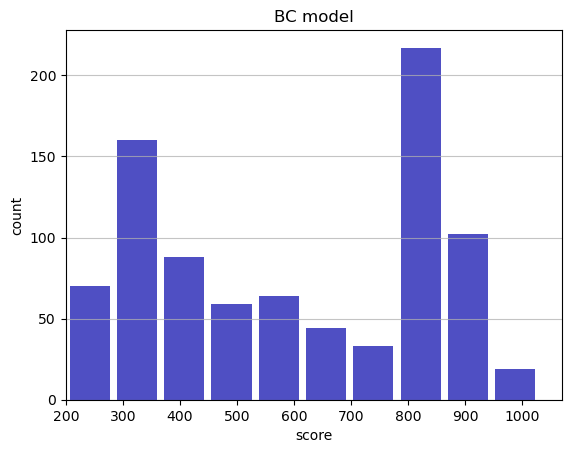

Track generation: 1087..1371 -> 284-tiles track
Epoch: 863
BC	mean: 597.05	variance: 240.94


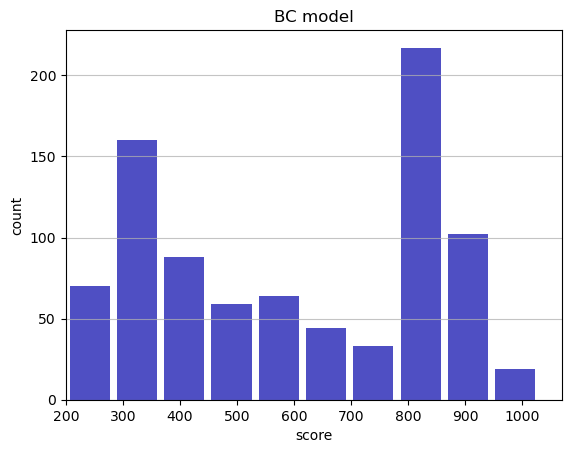

Track generation: 1219..1528 -> 309-tiles track
Epoch: 864
BC	mean: 597.33	variance: 240.93


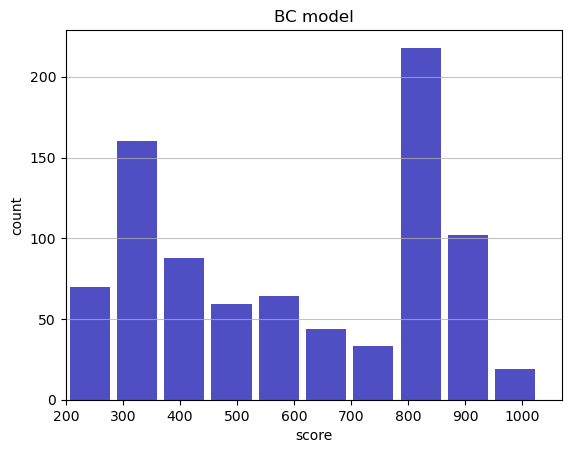

Track generation: 1176..1474 -> 298-tiles track
Epoch: 865
BC	mean: 597.00	variance: 240.98


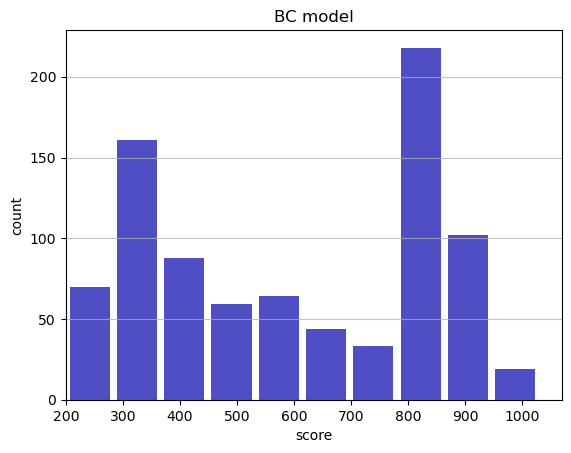

Track generation: 1219..1528 -> 309-tiles track
Epoch: 866
BC	mean: 597.15	variance: 240.88


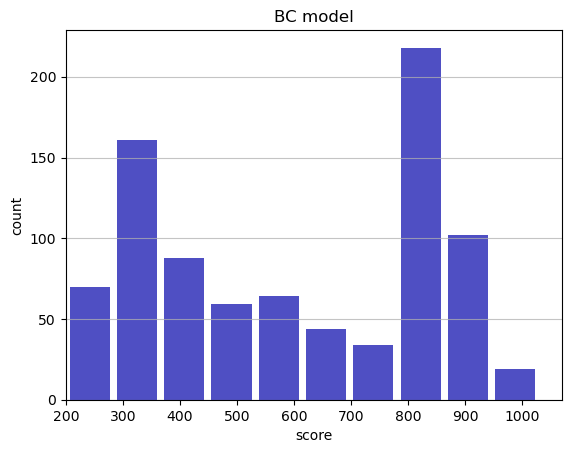

Track generation: 1132..1419 -> 287-tiles track
Epoch: 867
BC	mean: 597.42	variance: 240.87


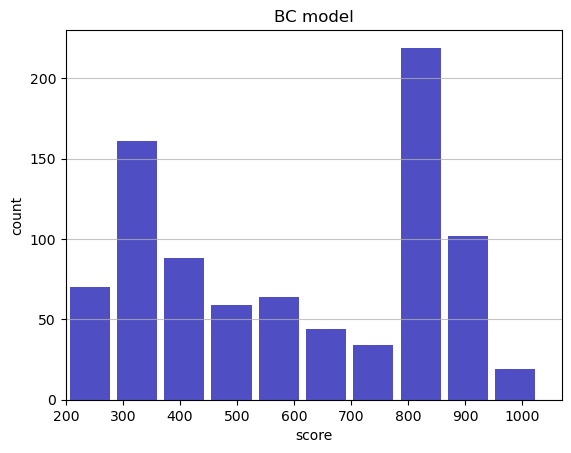

Track generation: 1068..1337 -> 269-tiles track
Epoch: 868
BC	mean: 597.20	variance: 240.82


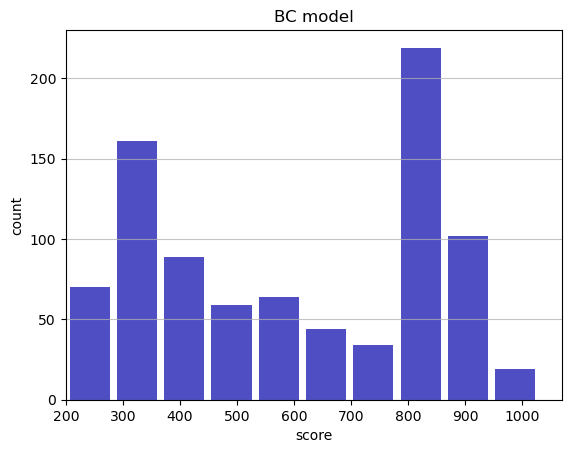

Track generation: 1003..1266 -> 263-tiles track
Epoch: 869
BC	mean: 597.46	variance: 240.81


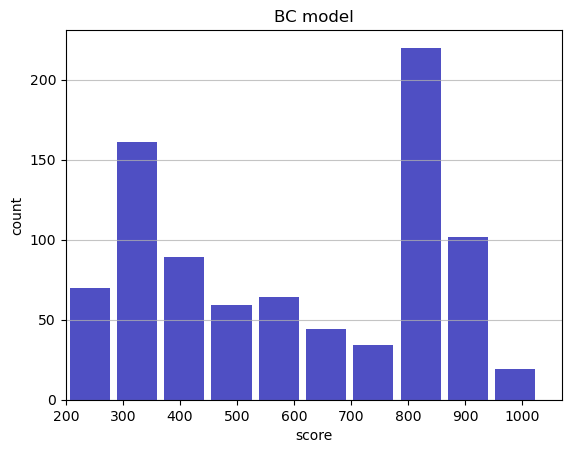

Track generation: 1299..1628 -> 329-tiles track
Epoch: 870
BC	mean: 597.05	variance: 240.99


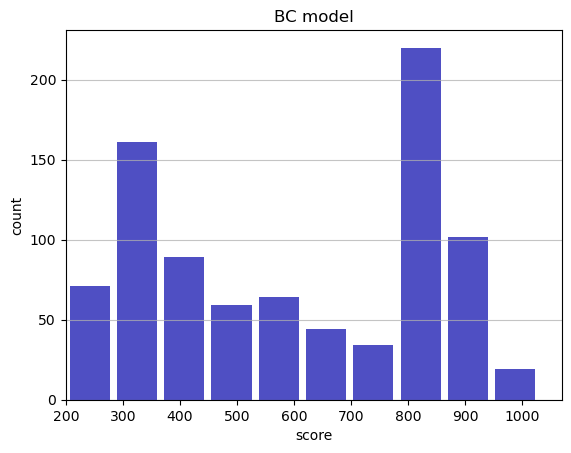

Track generation: 1088..1364 -> 276-tiles track
Epoch: 871
BC	mean: 596.77	variance: 240.98


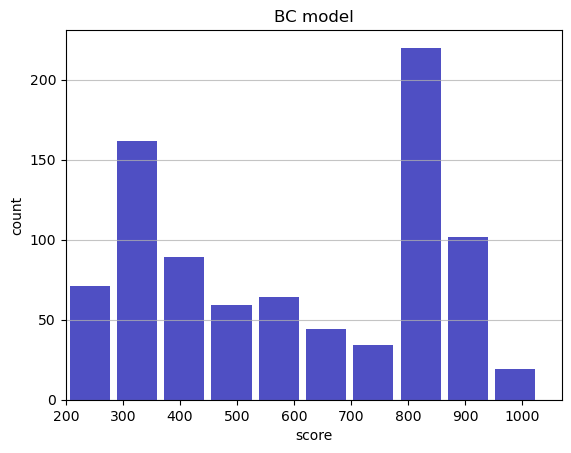

Track generation: 1051..1317 -> 266-tiles track
Epoch: 872
BC	mean: 597.05	variance: 240.99


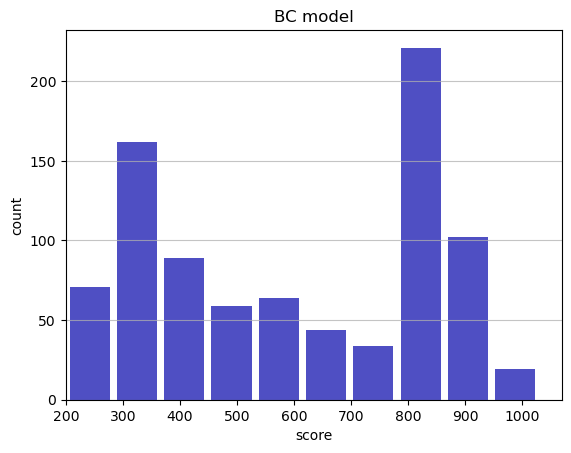

Track generation: 1080..1354 -> 274-tiles track
Epoch: 873
BC	mean: 597.34	variance: 241.00


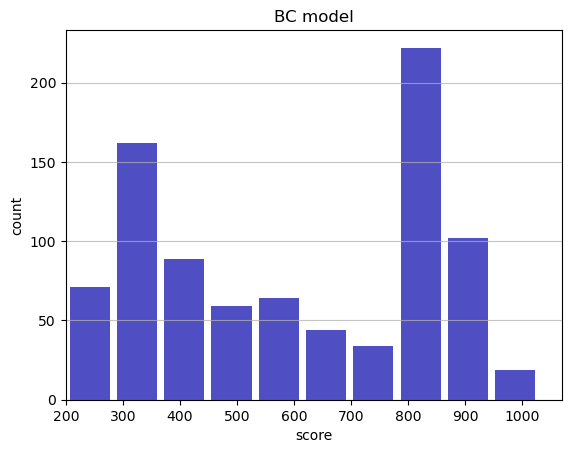

Track generation: 986..1237 -> 251-tiles track
Epoch: 874
BC	mean: 597.60	variance: 240.99


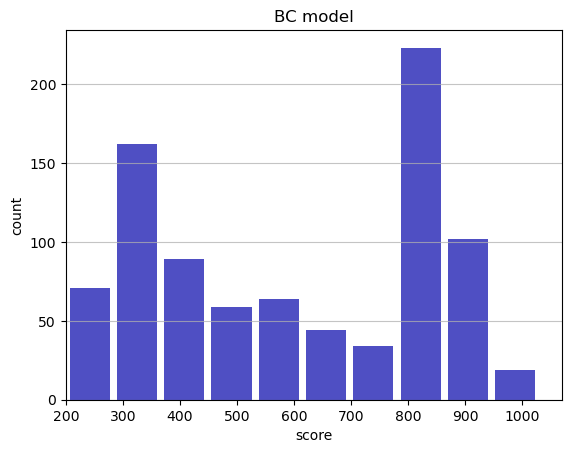

Track generation: 1168..1473 -> 305-tiles track
Epoch: 875
BC	mean: 597.30	variance: 241.01


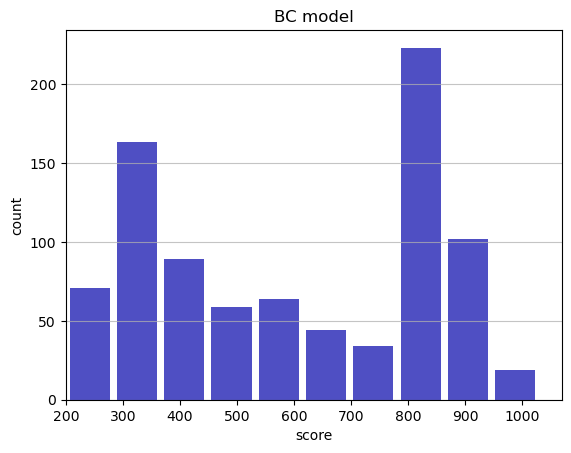

Track generation: 1024..1284 -> 260-tiles track
Epoch: 876
BC	mean: 597.10	variance: 240.95


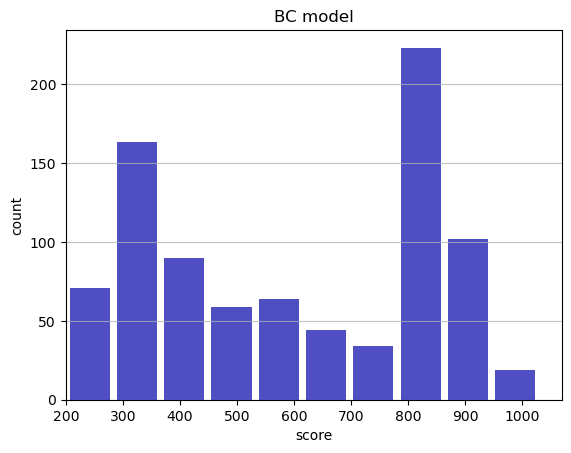

Track generation: 1090..1367 -> 277-tiles track
Epoch: 877
BC	mean: 597.38	variance: 240.95


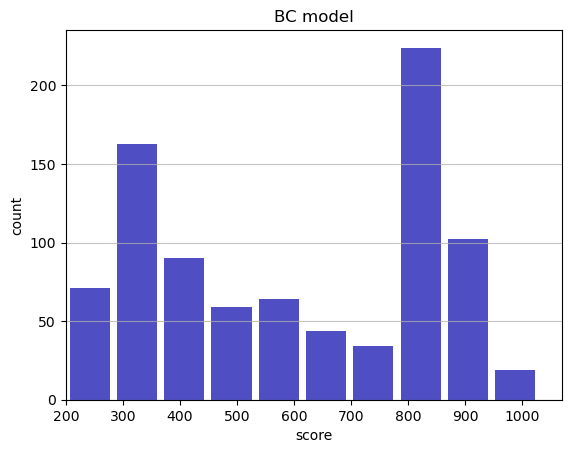

Track generation: 1039..1303 -> 264-tiles track
Epoch: 878
BC	mean: 597.34	variance: 240.82


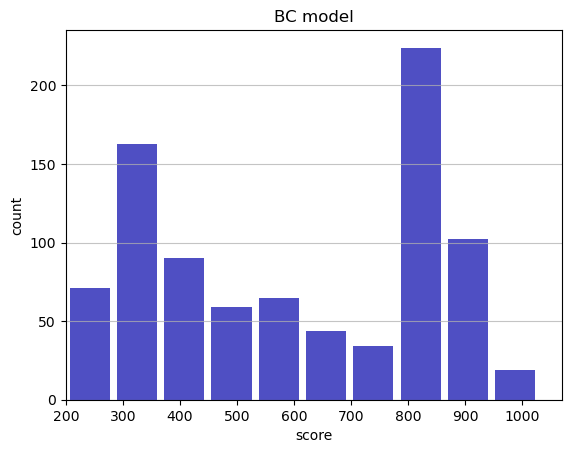

Track generation: 1200..1504 -> 304-tiles track
Epoch: 879
BC	mean: 597.02	variance: 240.87


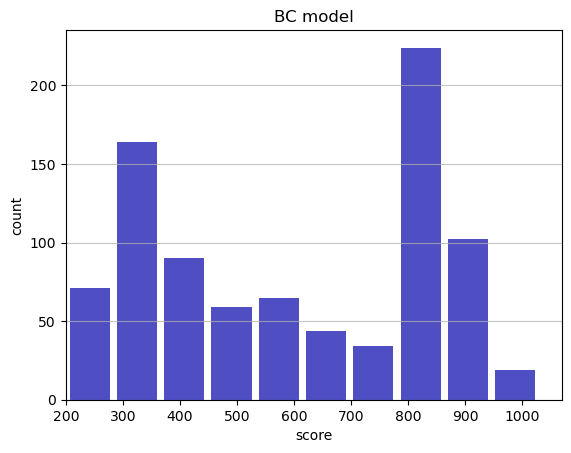

Track generation: 891..1124 -> 233-tiles track
Epoch: 880
BC	mean: 597.34	variance: 240.92


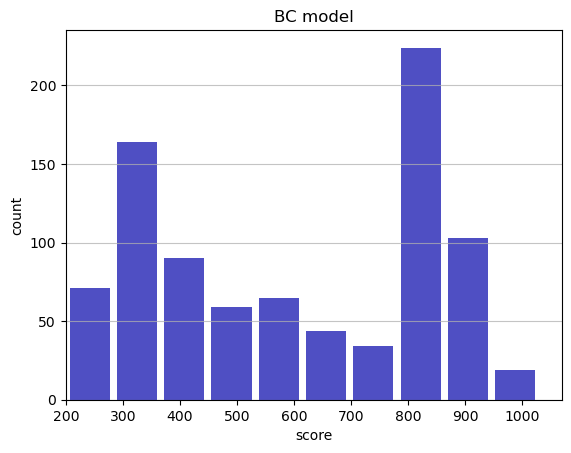

Track generation: 1201..1505 -> 304-tiles track
Epoch: 881
BC	mean: 597.40	variance: 240.79


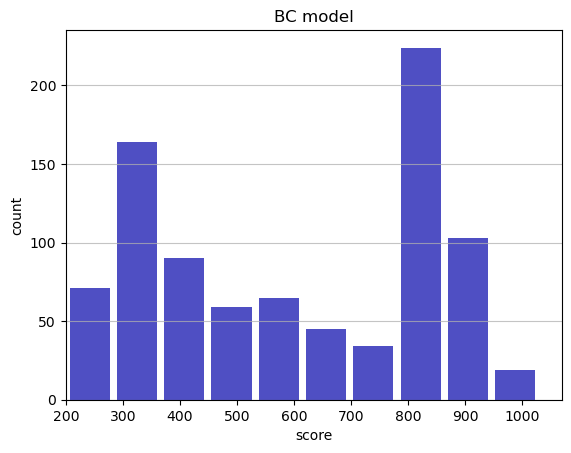

Track generation: 1116..1399 -> 283-tiles track
Epoch: 882
BC	mean: 597.71	variance: 240.83


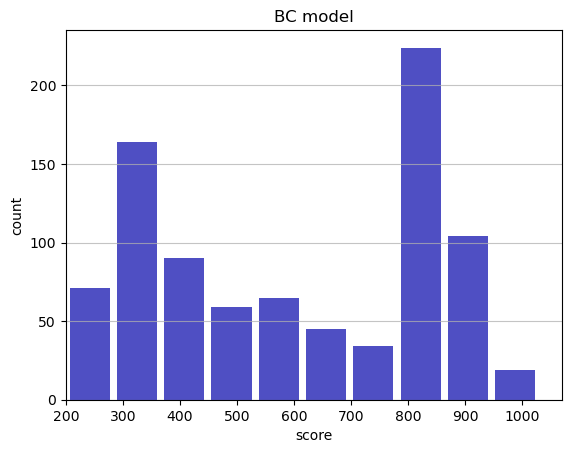

Track generation: 1184..1484 -> 300-tiles track
Epoch: 883
BC	mean: 597.75	variance: 240.70


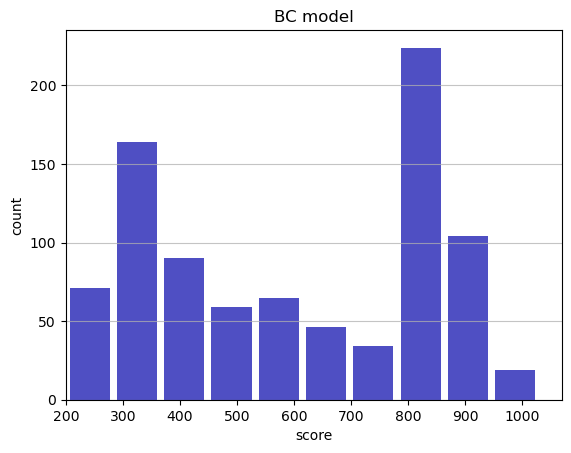

Track generation: 1053..1324 -> 271-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1144..1434 -> 290-tiles track
Epoch: 884
BC	mean: 597.45	variance: 240.72


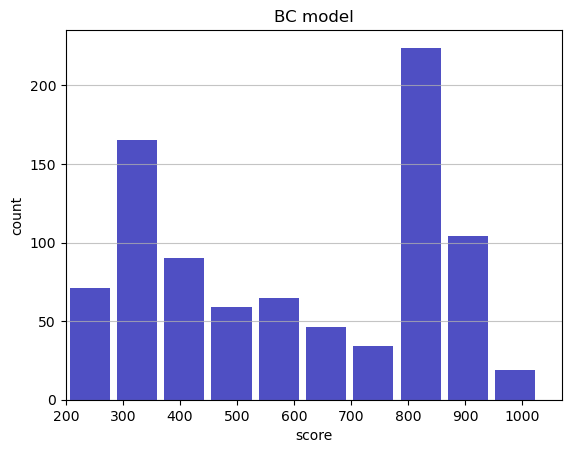

Track generation: 1059..1337 -> 278-tiles track
Epoch: 885
BC	mean: 597.49	variance: 240.59


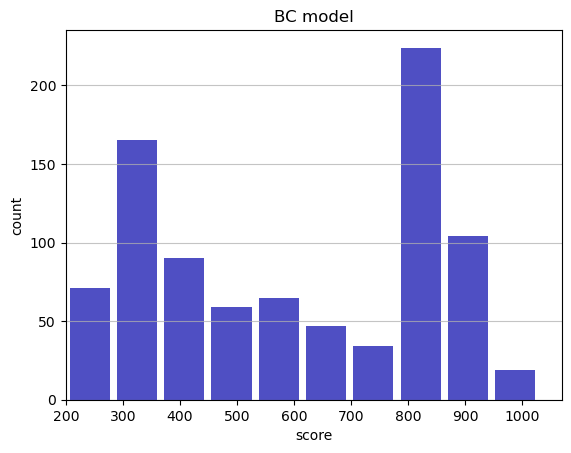

Track generation: 1239..1552 -> 313-tiles track
Epoch: 886
BC	mean: 597.11	variance: 240.72


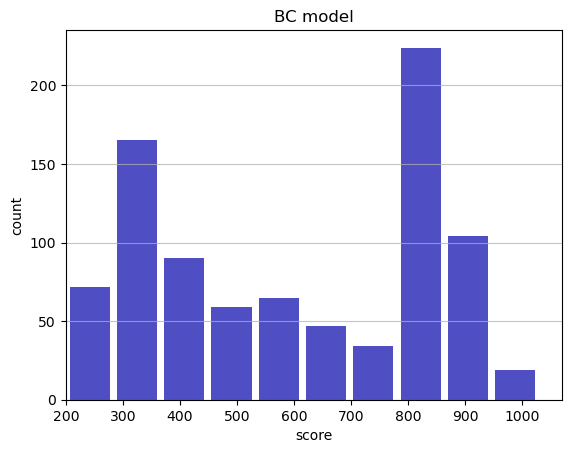

Track generation: 1187..1488 -> 301-tiles track
Epoch: 887
BC	mean: 596.82	variance: 240.75


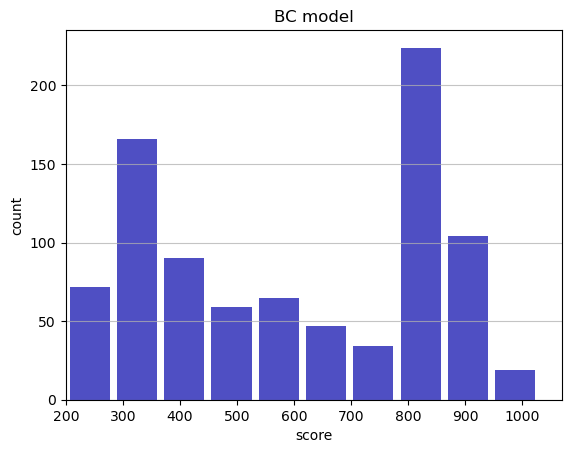

Track generation: 1080..1354 -> 274-tiles track
Epoch: 888
BC	mean: 596.51	variance: 240.78


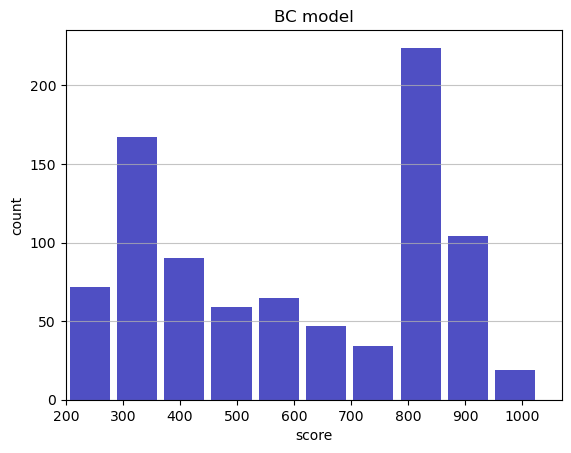

Track generation: 1213..1521 -> 308-tiles track
Epoch: 889
BC	mean: 596.81	variance: 240.81


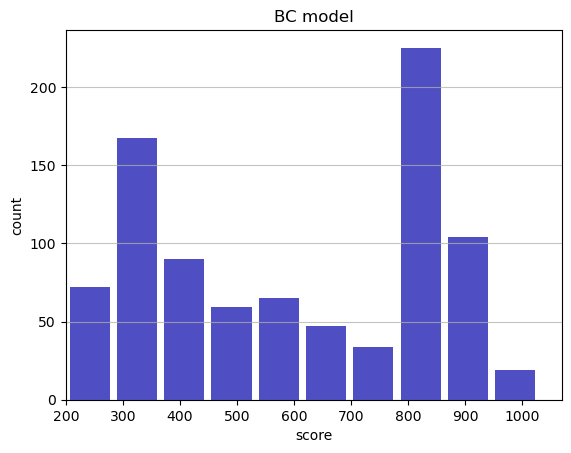

Track generation: 1167..1463 -> 296-tiles track
Epoch: 890
BC	mean: 596.69	variance: 240.70


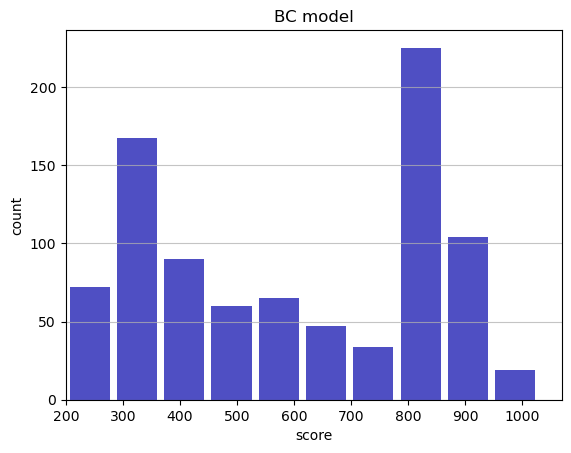

Track generation: 1223..1533 -> 310-tiles track
Epoch: 891
BC	mean: 597.02	variance: 240.76


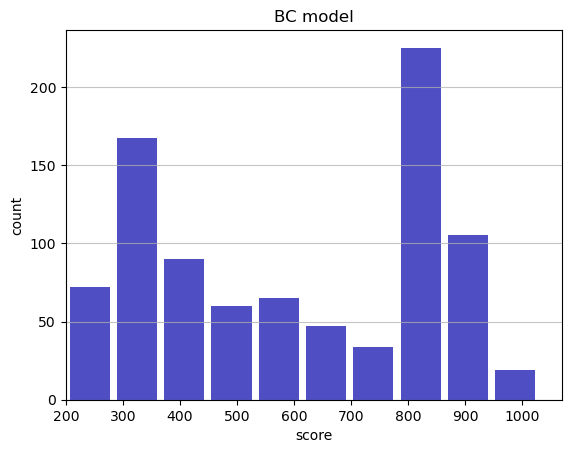

Track generation: 1208..1514 -> 306-tiles track
Epoch: 892
BC	mean: 597.28	variance: 240.75


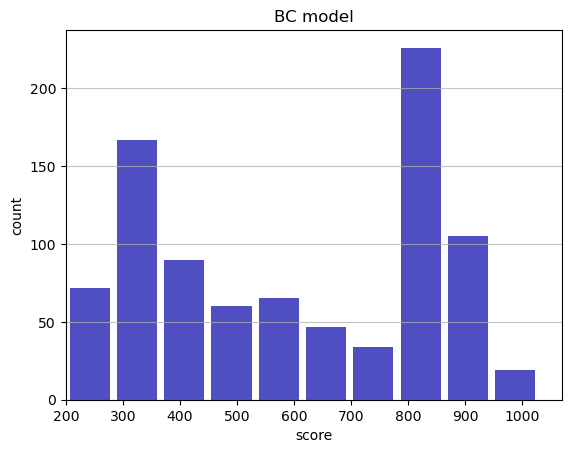

Track generation: 1148..1444 -> 296-tiles track
Epoch: 893
BC	mean: 597.40	variance: 240.64


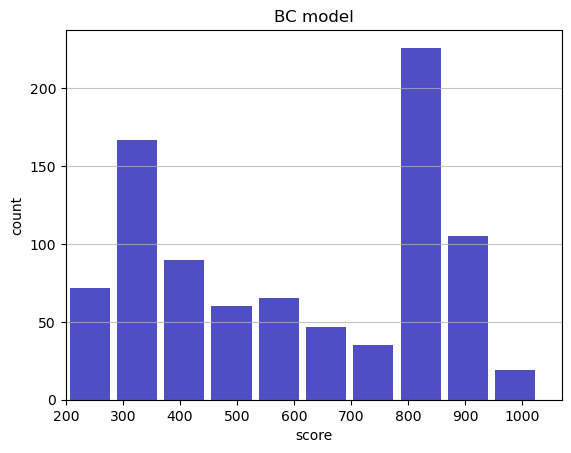

Track generation: 981..1237 -> 256-tiles track
Epoch: 894
BC	mean: 597.34	variance: 240.51


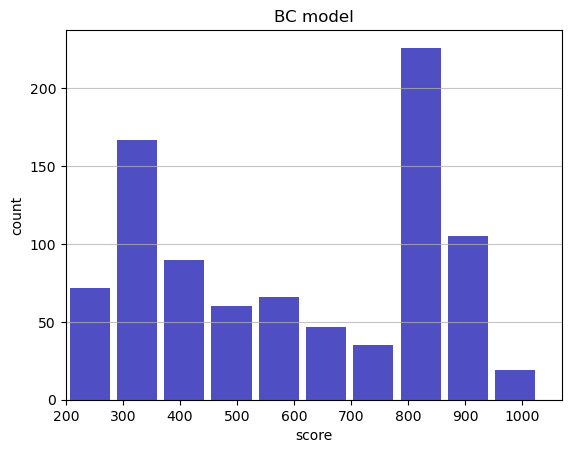

Track generation: 1076..1353 -> 277-tiles track
Epoch: 895
BC	mean: 597.22	variance: 240.40


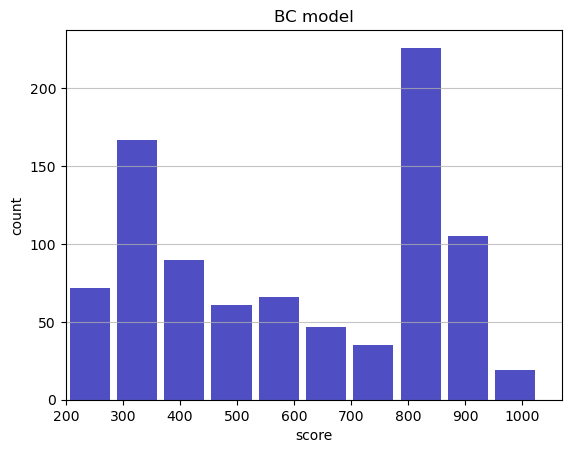

Track generation: 1038..1302 -> 264-tiles track
Epoch: 896
BC	mean: 597.50	variance: 240.41


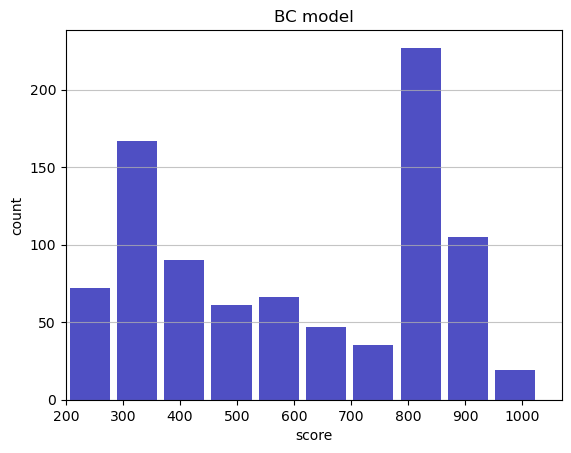

Track generation: 1256..1574 -> 318-tiles track
Epoch: 897
BC	mean: 597.84	variance: 240.50


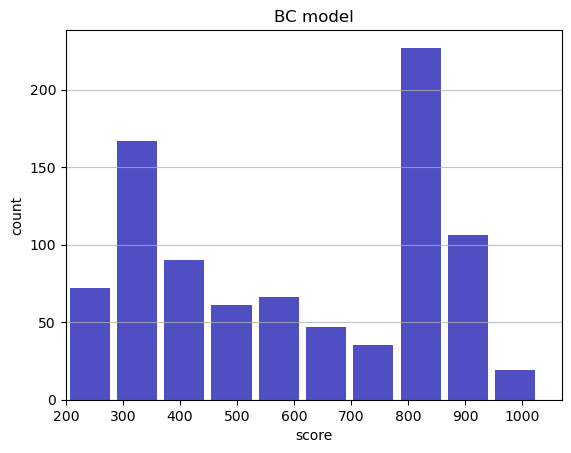

Track generation: 1091..1368 -> 277-tiles track
Epoch: 898
BC	mean: 597.94	variance: 240.38


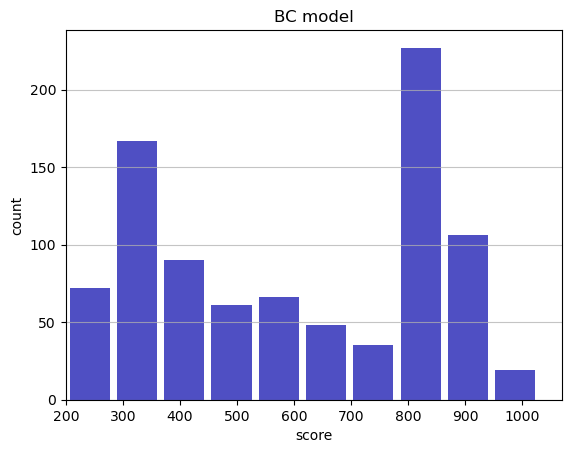

Track generation: 1104..1384 -> 280-tiles track
Epoch: 899
BC	mean: 597.88	variance: 240.25


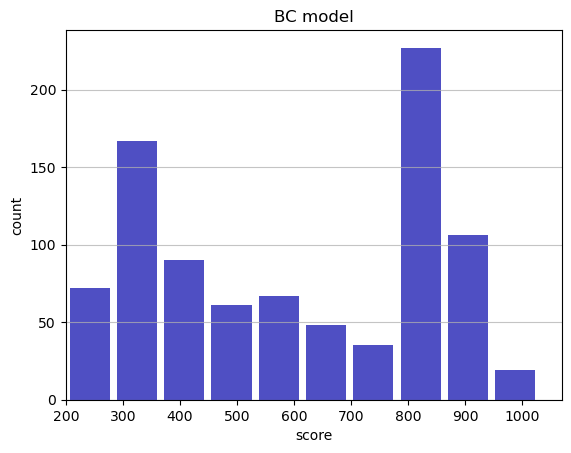

Track generation: 1193..1495 -> 302-tiles track
Epoch: 900
BC	mean: 597.48	variance: 240.43


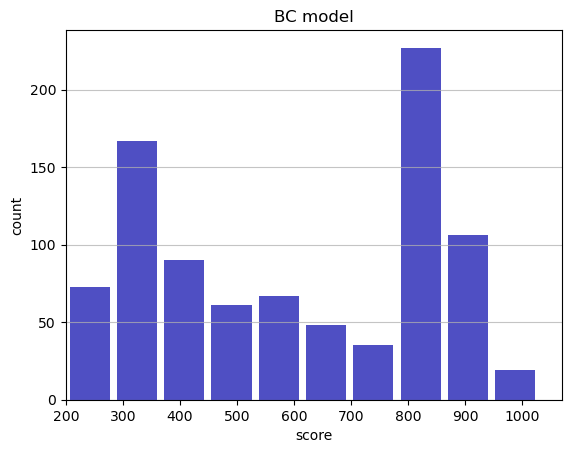

Track generation: 1275..1598 -> 323-tiles track
Epoch: 901
BC	mean: 597.87	variance: 240.58


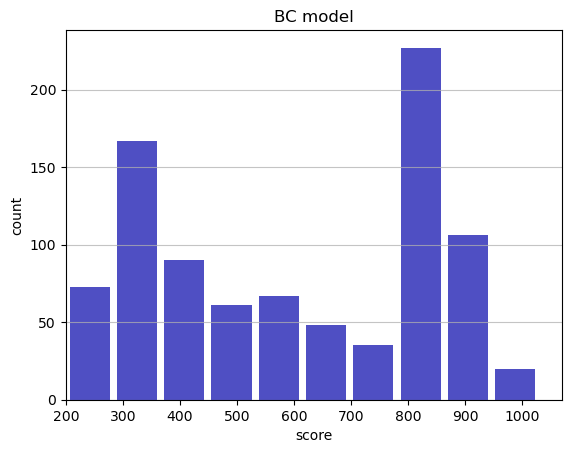

Track generation: 1224..1572 -> 348-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1121..1415 -> 294-tiles track
Epoch: 902
BC	mean: 598.13	variance: 240.58


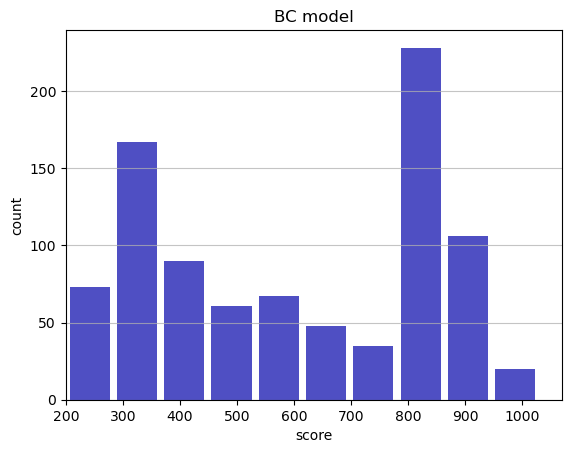

Track generation: 1161..1456 -> 295-tiles track
Epoch: 903
BC	mean: 598.19	variance: 240.45


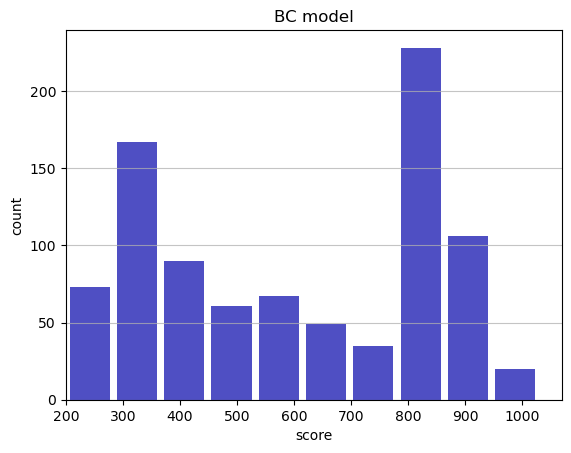

Track generation: 1067..1347 -> 280-tiles track
Epoch: 904
BC	mean: 597.95	variance: 240.43


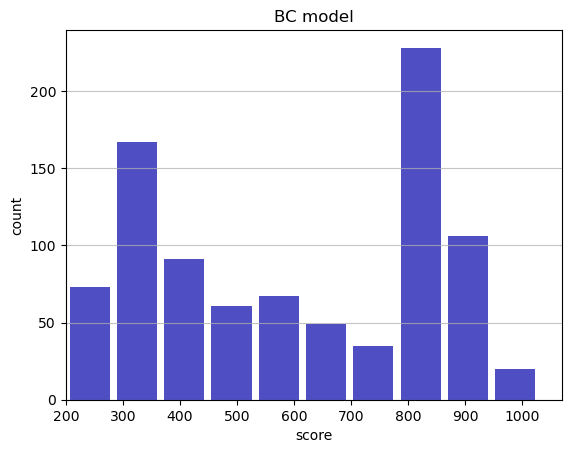

Track generation: 1226..1537 -> 311-tiles track
Epoch: 905
BC	mean: 598.21	variance: 240.42


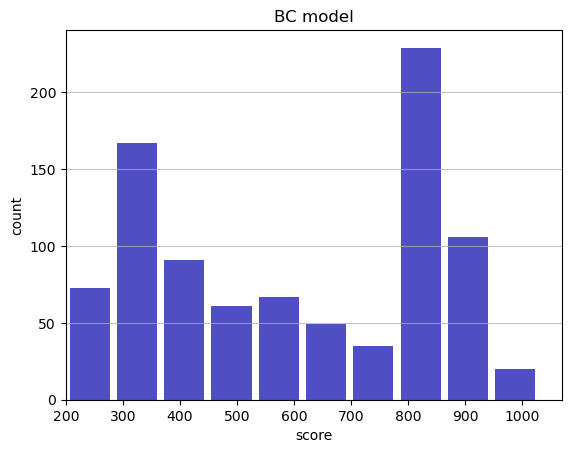

Track generation: 1201..1510 -> 309-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1158..1452 -> 294-tiles track
Epoch: 906
BC	mean: 598.52	variance: 240.46


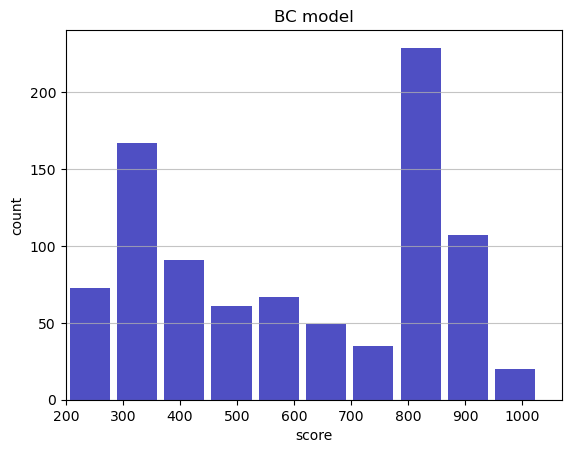

Track generation: 1152..1444 -> 292-tiles track
Epoch: 907
BC	mean: 598.79	variance: 240.47


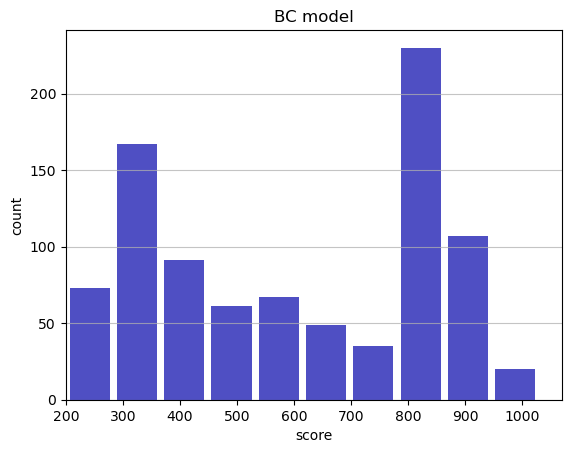

Track generation: 1149..1442 -> 293-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 994..1246 -> 252-tiles track
Epoch: 908
BC	mean: 598.74	variance: 240.35


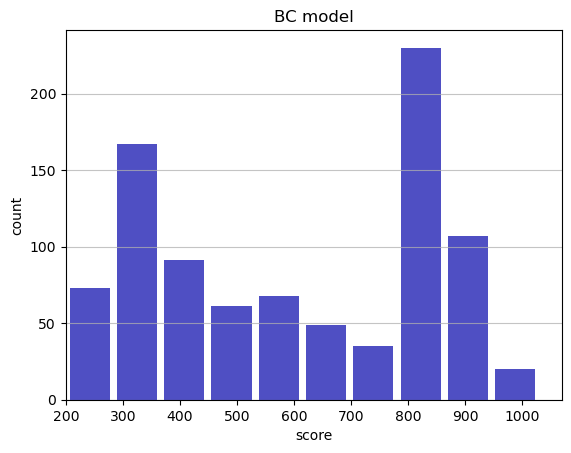

Track generation: 1096..1374 -> 278-tiles track
Epoch: 909
BC	mean: 598.91	variance: 240.27


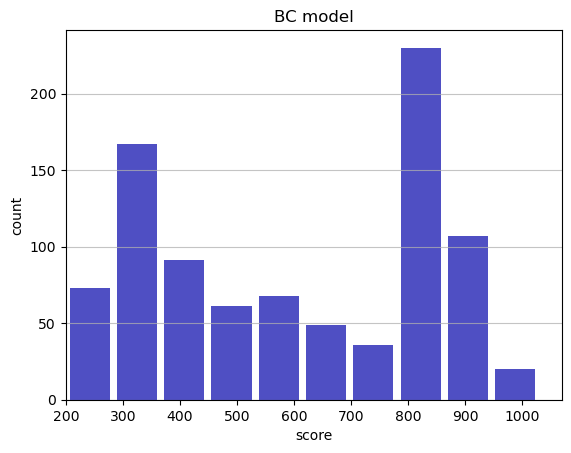

Track generation: 1131..1418 -> 287-tiles track
Epoch: 910
BC	mean: 599.12	variance: 240.22


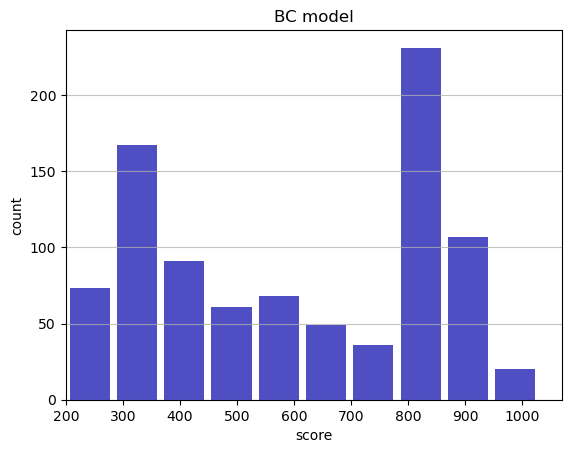

Track generation: 1080..1354 -> 274-tiles track
Epoch: 911
BC	mean: 599.42	variance: 240.26


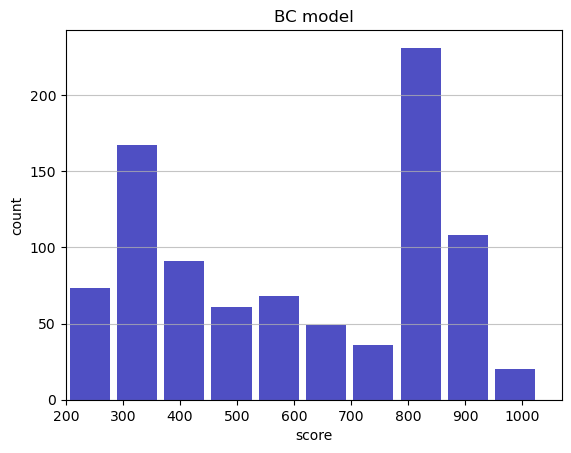

Track generation: 1090..1375 -> 285-tiles track
Epoch: 912
BC	mean: 599.70	variance: 240.27


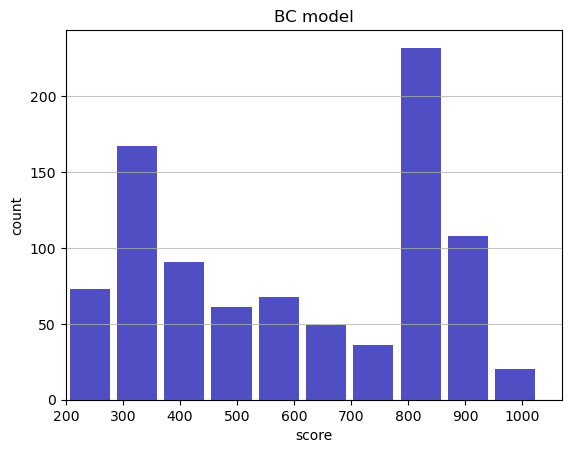

Track generation: 1105..1385 -> 280-tiles track
Epoch: 913
BC	mean: 599.94	variance: 240.26


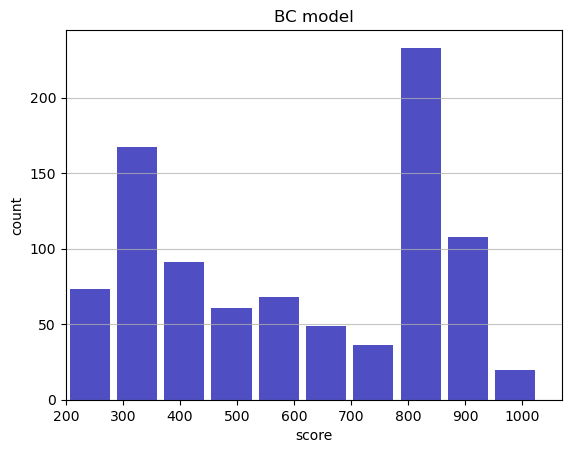

Track generation: 1129..1424 -> 295-tiles track
Epoch: 914
BC	mean: 599.85	variance: 240.14


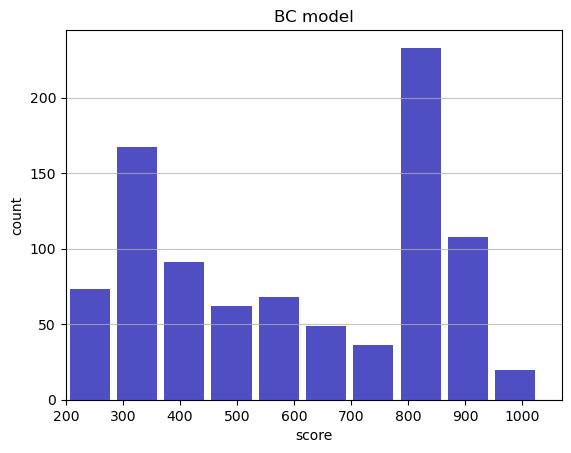

Track generation: 1181..1481 -> 300-tiles track
Epoch: 915
BC	mean: 600.18	variance: 240.21


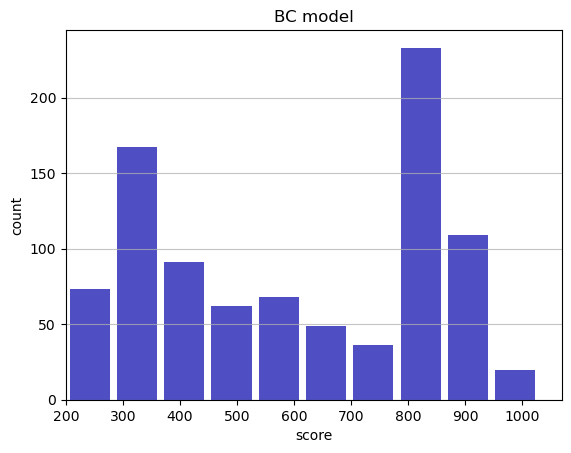

Track generation: 1025..1287 -> 262-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1220..1530 -> 310-tiles track
Epoch: 916
BC	mean: 599.85	variance: 240.28


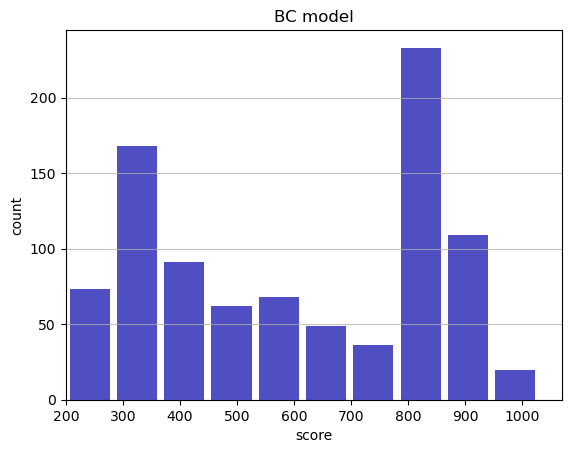

Track generation: 1115..1398 -> 283-tiles track
Epoch: 917
BC	mean: 599.59	variance: 240.28


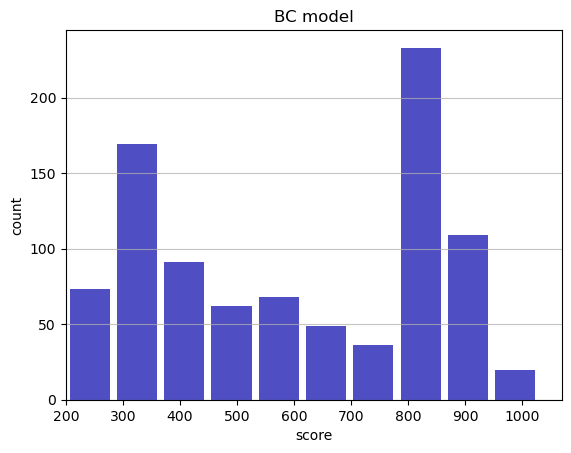

Track generation: 992..1244 -> 252-tiles track
Epoch: 918
BC	mean: 599.35	variance: 240.25


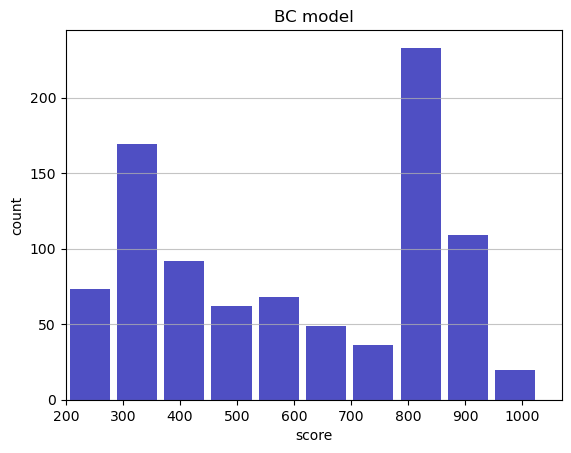

Track generation: 1284..1609 -> 325-tiles track
Epoch: 919
BC	mean: 598.94	variance: 240.45


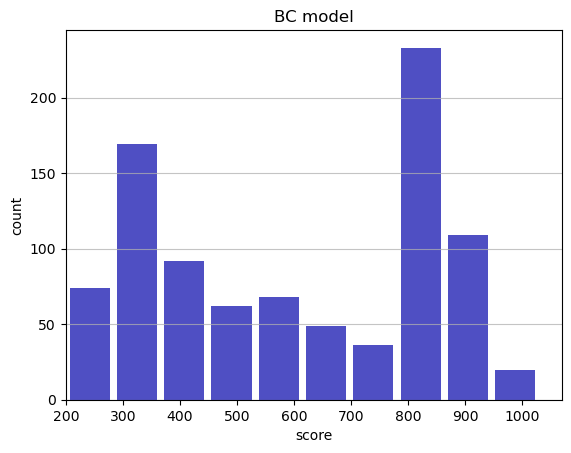

Track generation: 1071..1343 -> 272-tiles track
Epoch: 920
BC	mean: 598.84	variance: 240.34


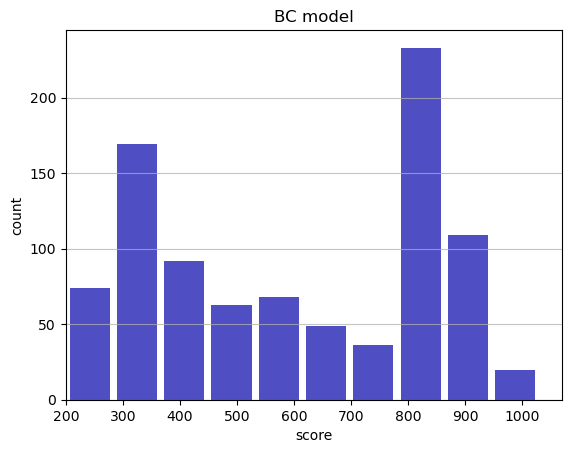

Track generation: 1251..1568 -> 317-tiles track
Epoch: 921
BC	mean: 598.57	variance: 240.35


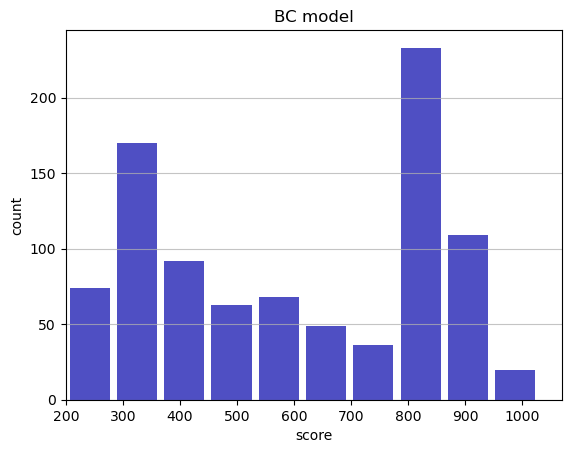

Track generation: 1113..1403 -> 290-tiles track
Epoch: 922
BC	mean: 598.82	variance: 240.33


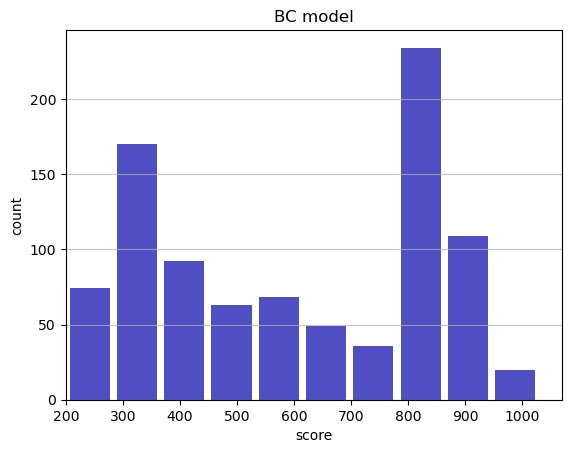

Track generation: 1236..1549 -> 313-tiles track
Epoch: 923
BC	mean: 599.06	variance: 240.31


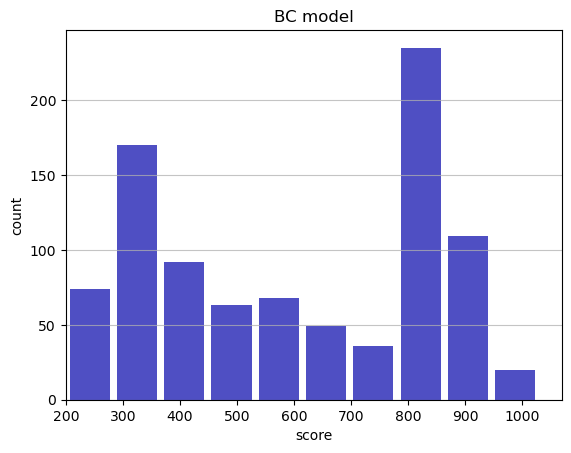

Track generation: 1099..1384 -> 285-tiles track
Epoch: 924
BC	mean: 599.20	variance: 240.22


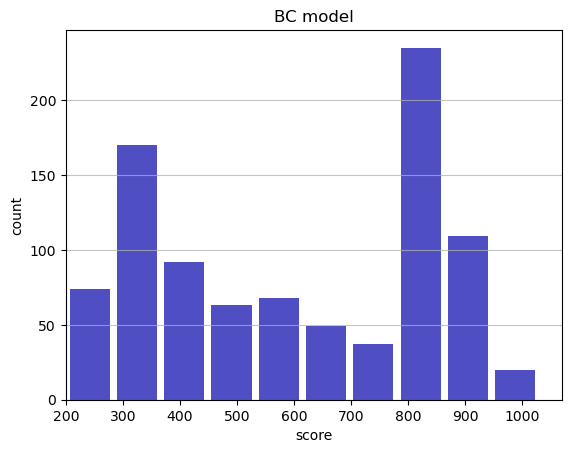

Track generation: 1384..1734 -> 350-tiles track
Epoch: 925
BC	mean: 599.53	variance: 240.30


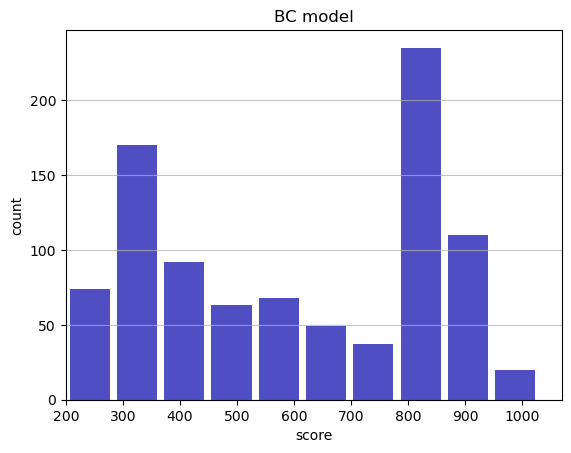

Track generation: 975..1227 -> 252-tiles track
Epoch: 926
BC	mean: 599.77	variance: 240.28


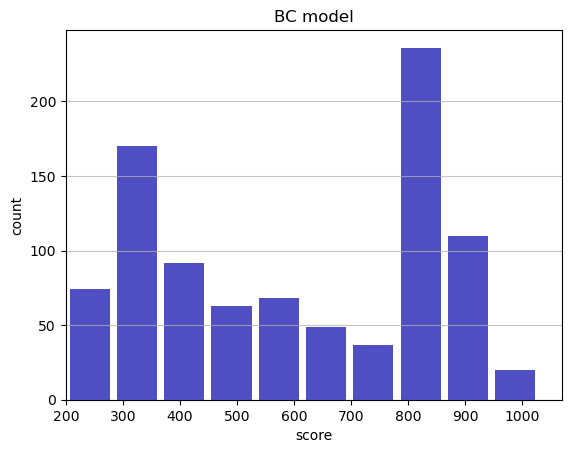

Track generation: 1127..1413 -> 286-tiles track
Epoch: 927
BC	mean: 600.04	variance: 240.30


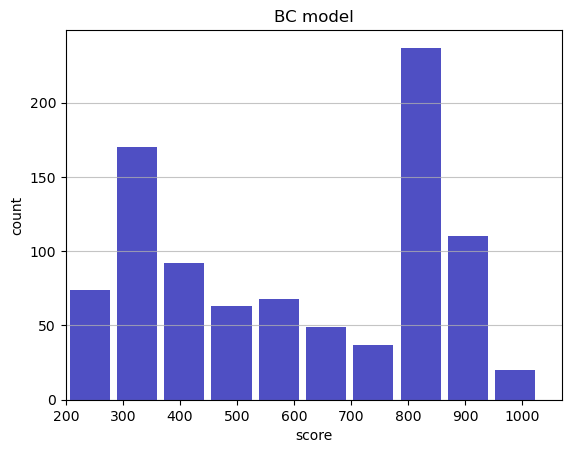

Track generation: 1060..1328 -> 268-tiles track
Epoch: 928
BC	mean: 600.32	variance: 240.31


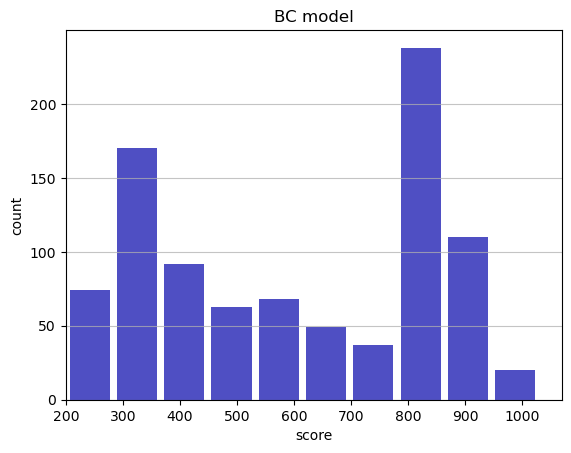

Track generation: 1175..1473 -> 298-tiles track
Epoch: 929
BC	mean: 600.50	variance: 240.25


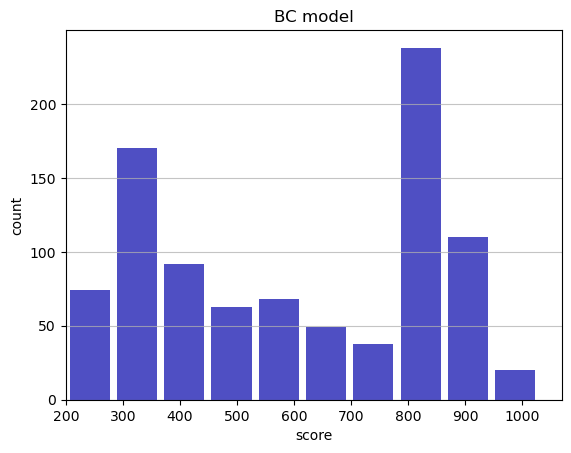

Track generation: 1103..1390 -> 287-tiles track
Epoch: 930
BC	mean: 600.85	variance: 240.35


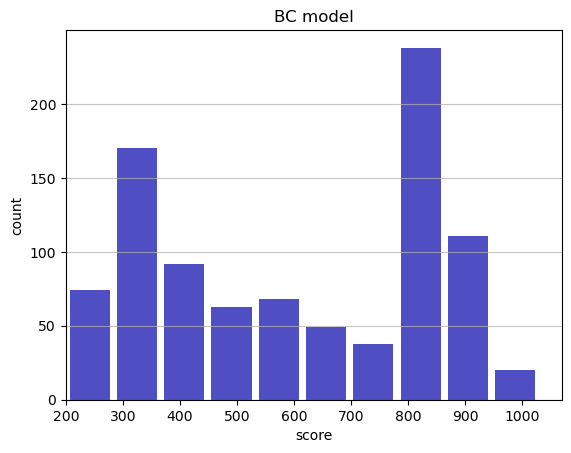

Track generation: 1116..1399 -> 283-tiles track
Epoch: 931
BC	mean: 600.79	variance: 240.23


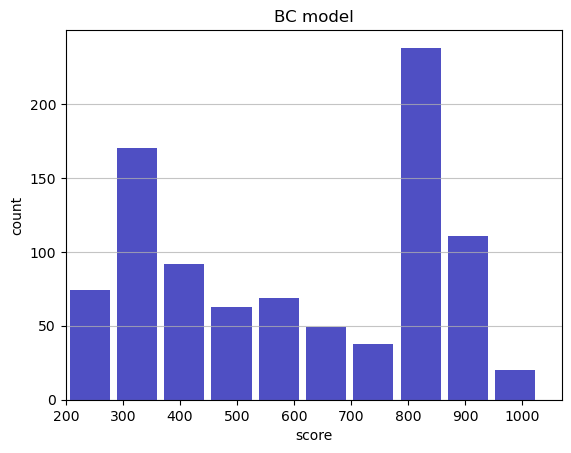

Track generation: 1160..1454 -> 294-tiles track
Epoch: 932
BC	mean: 600.55	variance: 240.22


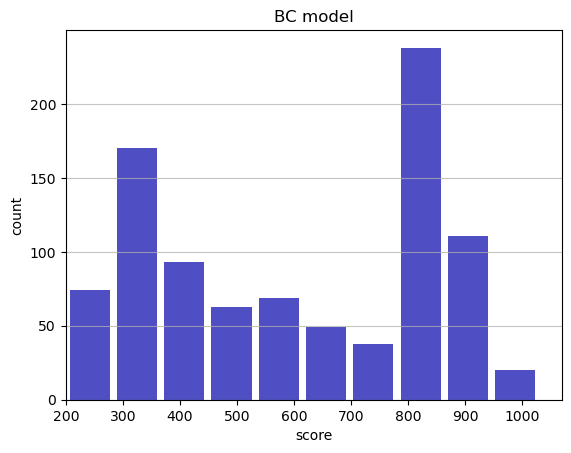

Track generation: 1011..1268 -> 257-tiles track
Epoch: 933
BC	mean: 600.79	variance: 240.20


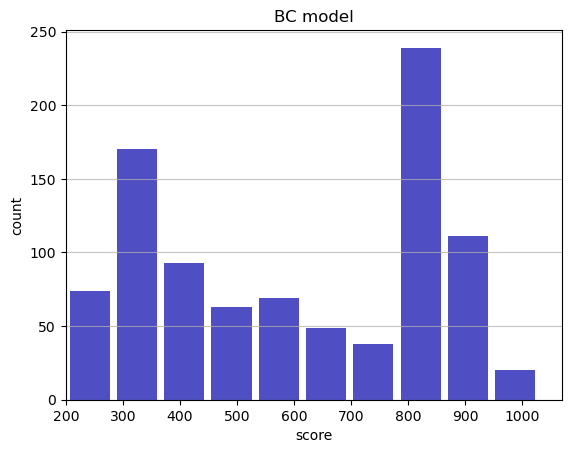

Track generation: 1203..1508 -> 305-tiles track
Epoch: 934
BC	mean: 601.09	variance: 240.25


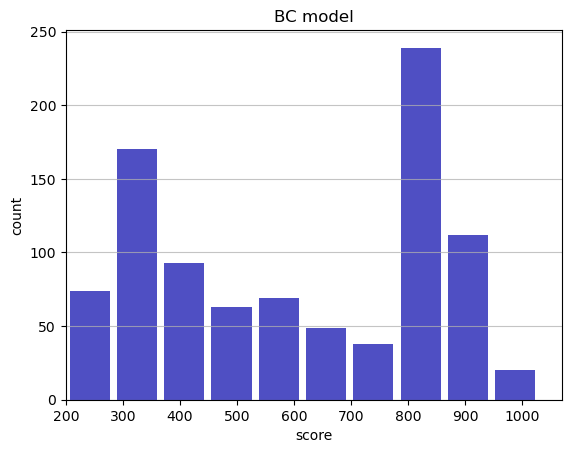

Track generation: 1207..1513 -> 306-tiles track
Epoch: 935
BC	mean: 601.34	variance: 240.24


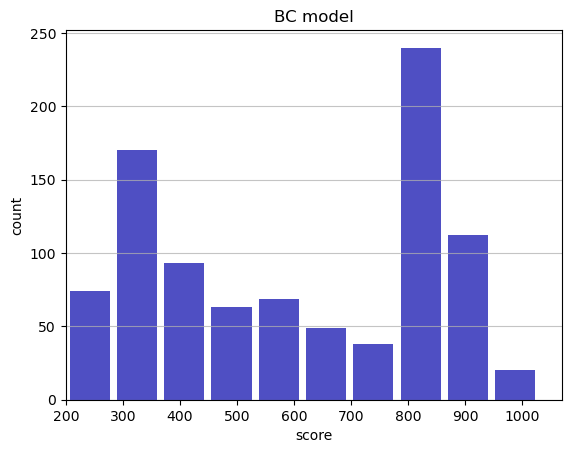

Track generation: 1249..1565 -> 316-tiles track
Epoch: 936
BC	mean: 601.06	variance: 240.27


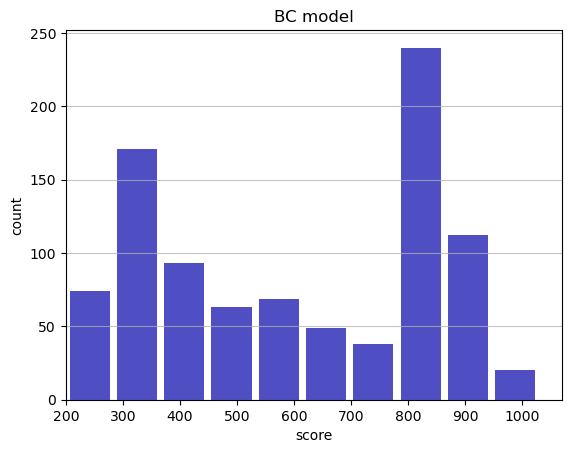

Track generation: 1099..1377 -> 278-tiles track
Epoch: 937
BC	mean: 600.72	variance: 240.37


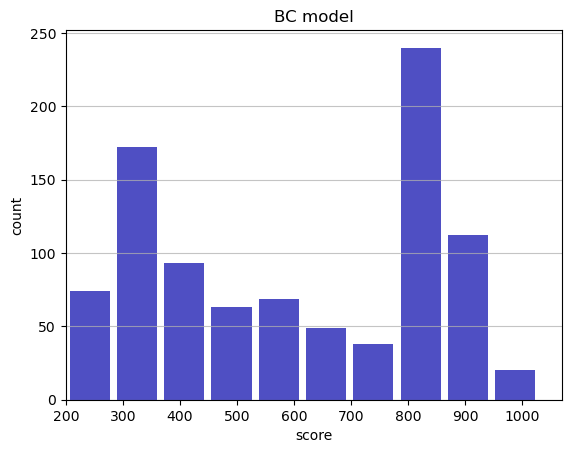

Track generation: 1123..1408 -> 285-tiles track
Epoch: 938
BC	mean: 600.72	variance: 240.24


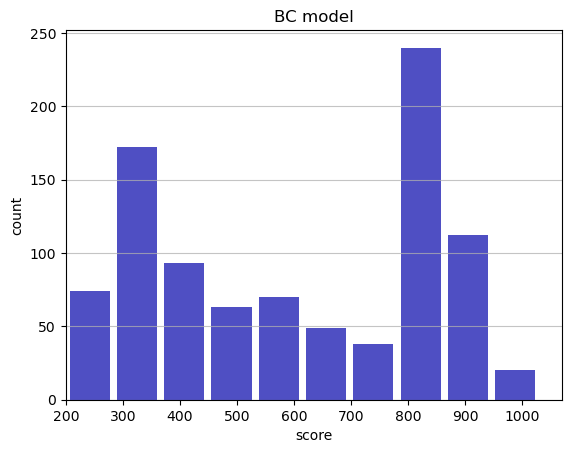

Track generation: 1012..1275 -> 263-tiles track
Epoch: 939
BC	mean: 600.61	variance: 240.13


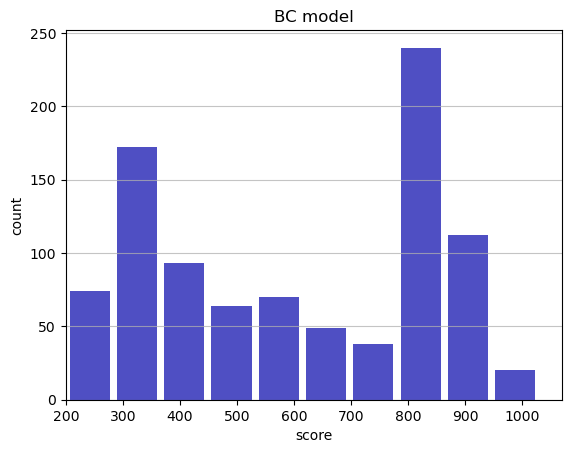

Track generation: 1185..1484 -> 299-tiles track
Epoch: 940
BC	mean: 600.28	variance: 240.22


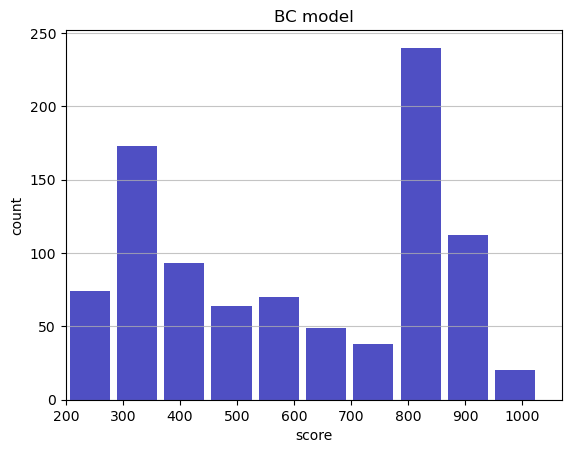

Track generation: 1196..1499 -> 303-tiles track
Epoch: 941
BC	mean: 599.98	variance: 240.26


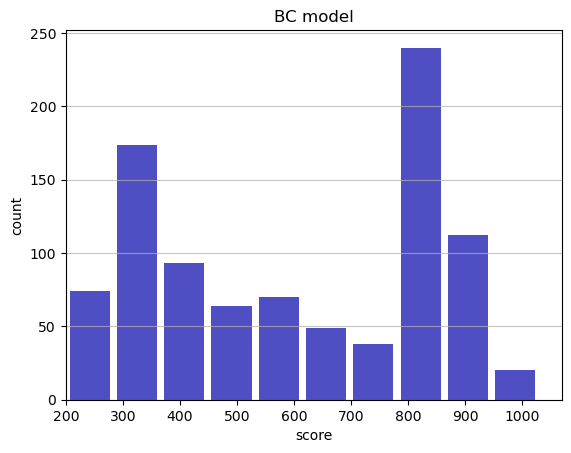

Track generation: 1232..1542 -> 310-tiles track
Epoch: 942
BC	mean: 599.74	variance: 240.25


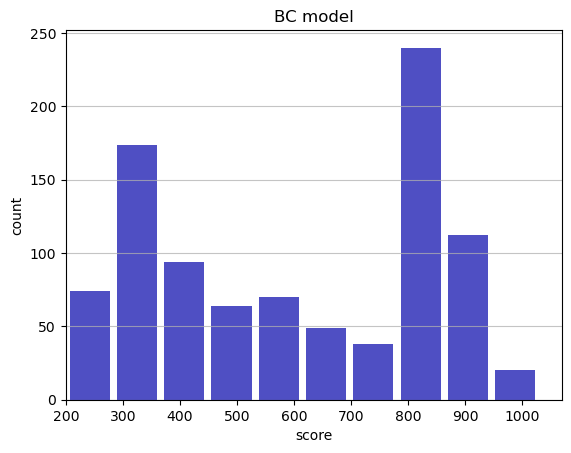

Track generation: 1150..1452 -> 302-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1107..1390 -> 283-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1135..1423 -> 288-tiles track
Epoch: 943
BC	mean: 599.74	variance: 240.12


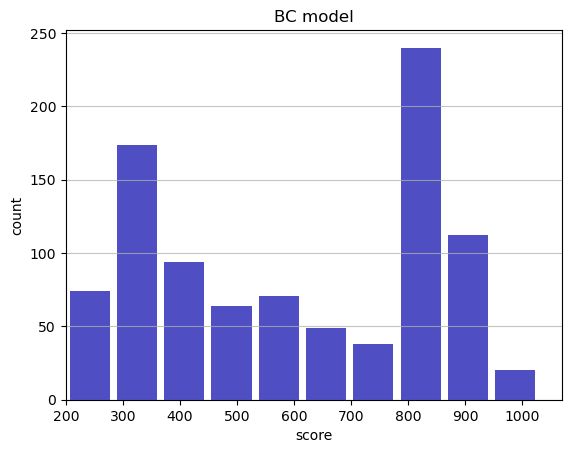

Track generation: 1355..1698 -> 343-tiles track
Epoch: 944
BC	mean: 599.44	variance: 240.18


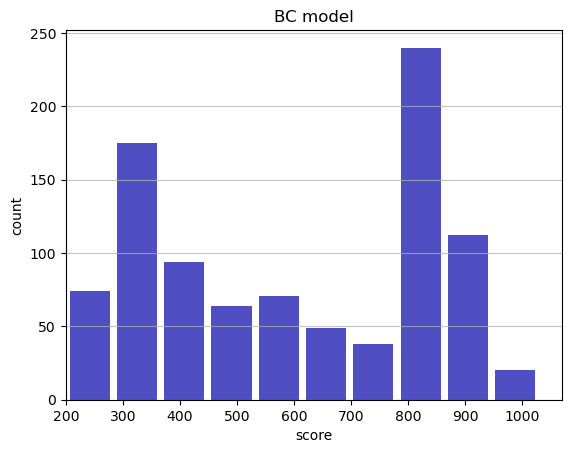

Track generation: 1143..1433 -> 290-tiles track
Epoch: 945
BC	mean: 599.71	variance: 240.19


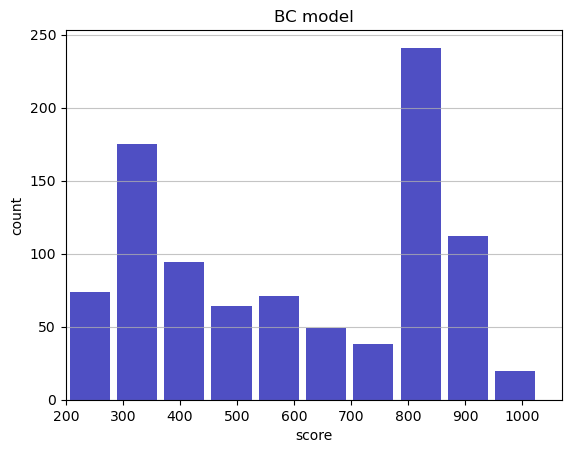

Track generation: 1322..1656 -> 334-tiles track
Epoch: 946
BC	mean: 599.99	variance: 240.22


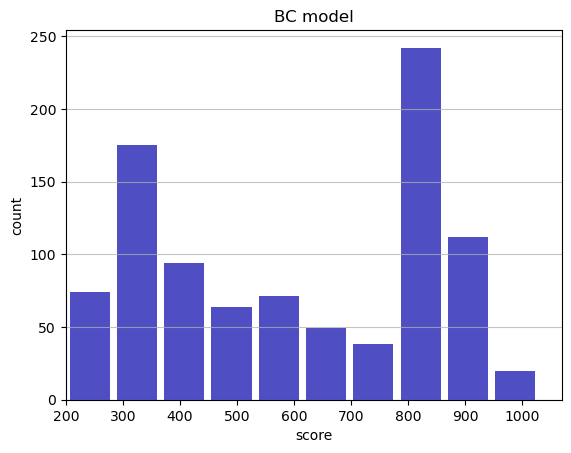

Track generation: 1247..1569 -> 322-tiles track
Epoch: 947
BC	mean: 599.83	variance: 240.14


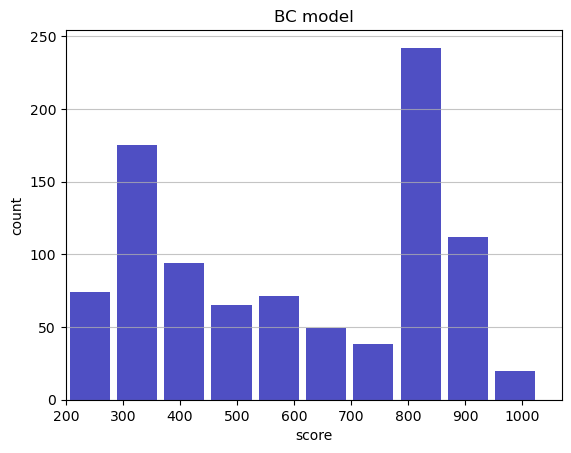

Track generation: 1261..1580 -> 319-tiles track
Epoch: 948
BC	mean: 599.44	variance: 240.31


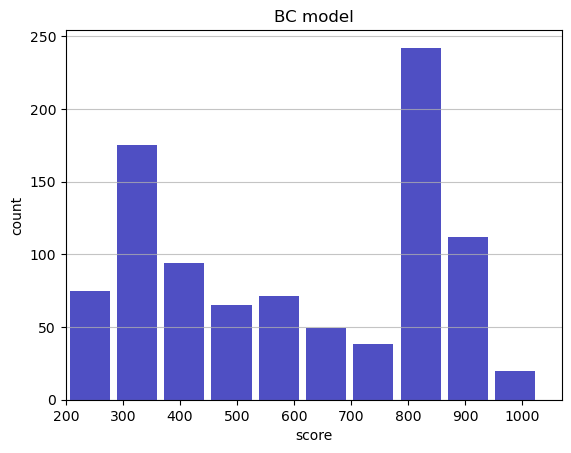

Track generation: 1161..1463 -> 302-tiles track
Epoch: 949
BC	mean: 599.31	variance: 240.22


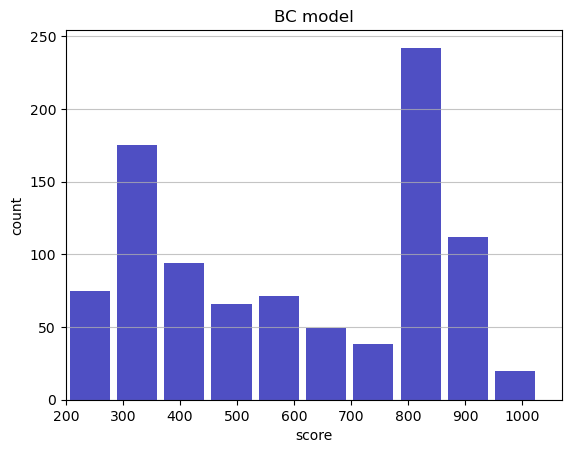

Track generation: 1106..1387 -> 281-tiles track
Epoch: 950
BC	mean: 599.06	variance: 240.21


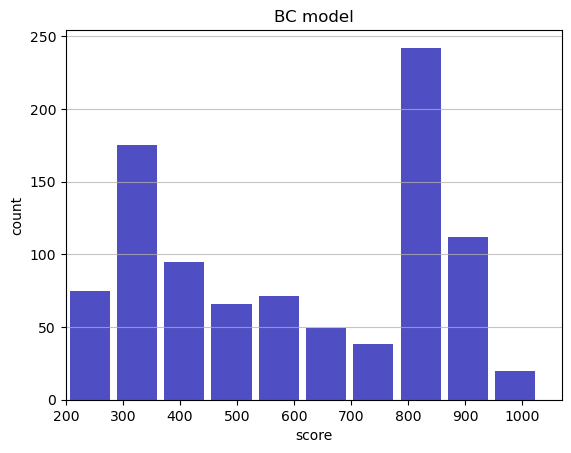

Track generation: 1369..1716 -> 347-tiles track
Epoch: 951
BC	mean: 598.74	variance: 240.30


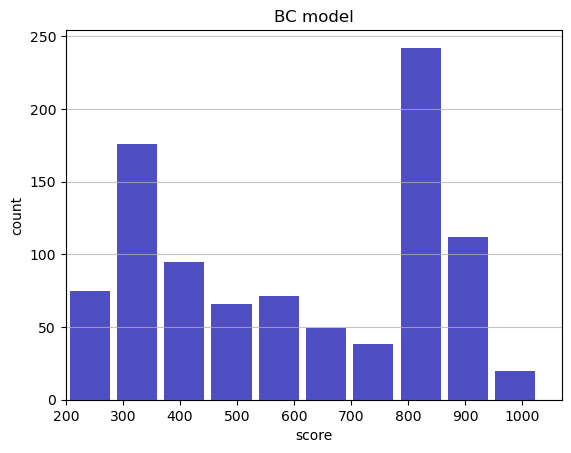

Track generation: 1179..1478 -> 299-tiles track
Epoch: 952
BC	mean: 598.42	variance: 240.37


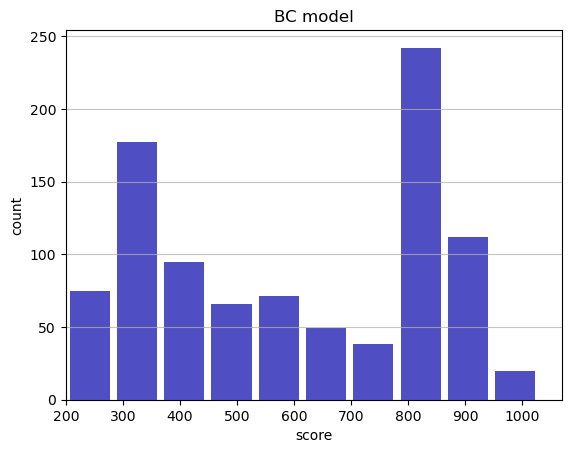

Track generation: 1036..1299 -> 263-tiles track
Epoch: 953
BC	mean: 598.66	variance: 240.37


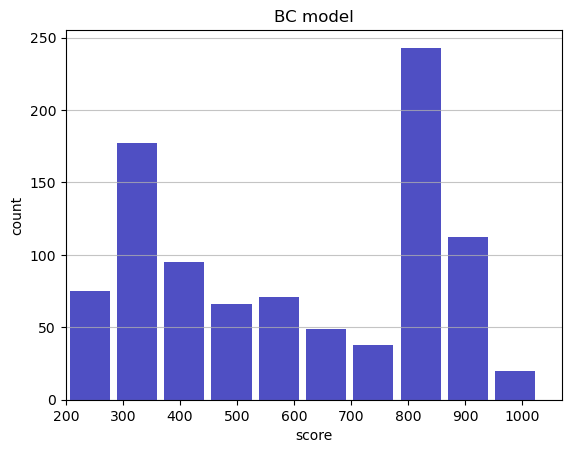

Track generation: 1112..1394 -> 282-tiles track
Epoch: 954
BC	mean: 598.49	variance: 240.30


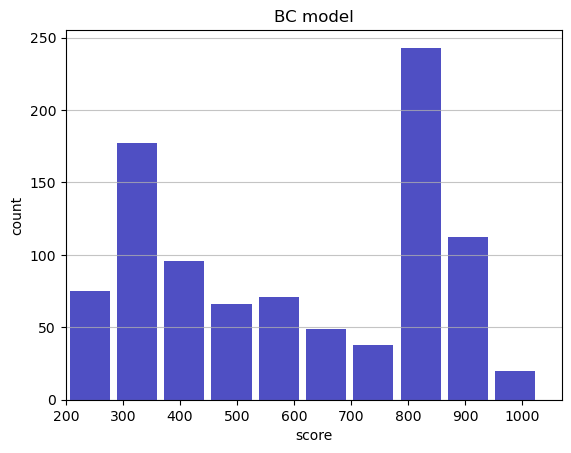

Track generation: 1090..1366 -> 276-tiles track
Epoch: 955
BC	mean: 598.76	variance: 240.32


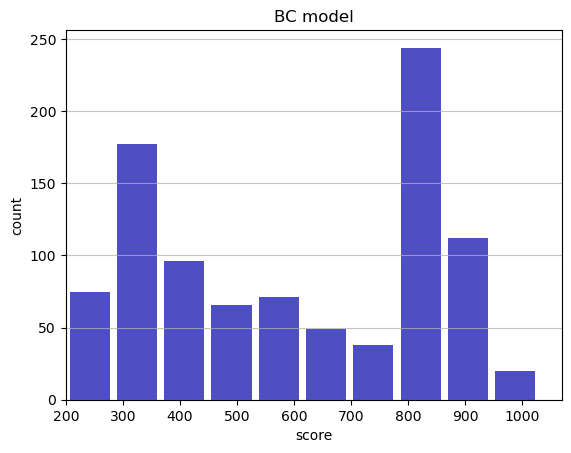

Track generation: 1120..1408 -> 288-tiles track
Epoch: 956
BC	mean: 598.57	variance: 240.27


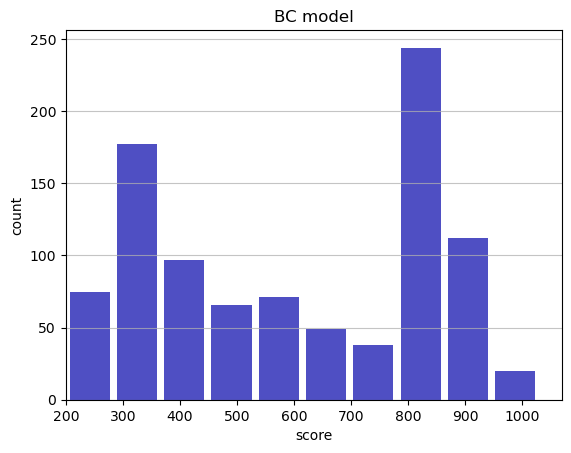

Track generation: 1097..1382 -> 285-tiles track
Epoch: 957
BC	mean: 598.63	variance: 240.15


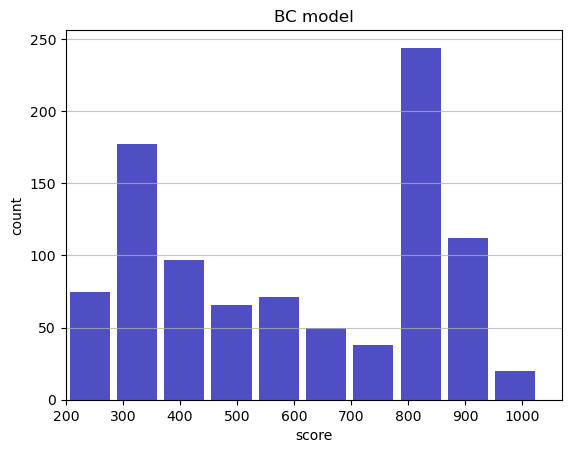

Track generation: 1315..1648 -> 333-tiles track
Epoch: 958
BC	mean: 598.23	variance: 240.33


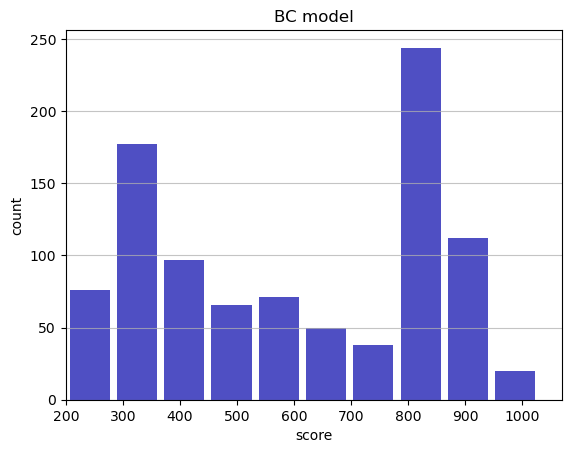

Track generation: 1224..1534 -> 310-tiles track
Epoch: 959
BC	mean: 597.86	variance: 240.48


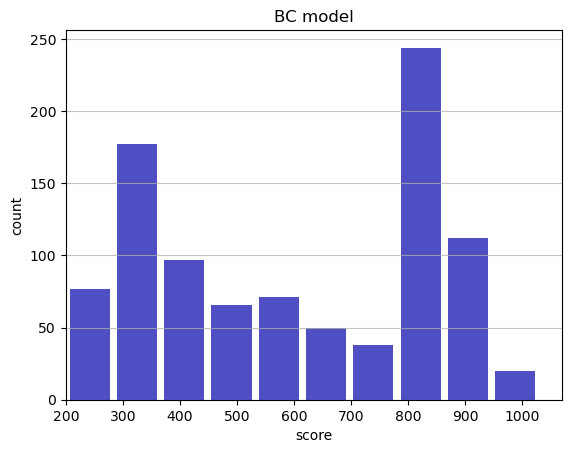

Track generation: 1052..1320 -> 268-tiles track
Epoch: 960
BC	mean: 597.93	variance: 240.36


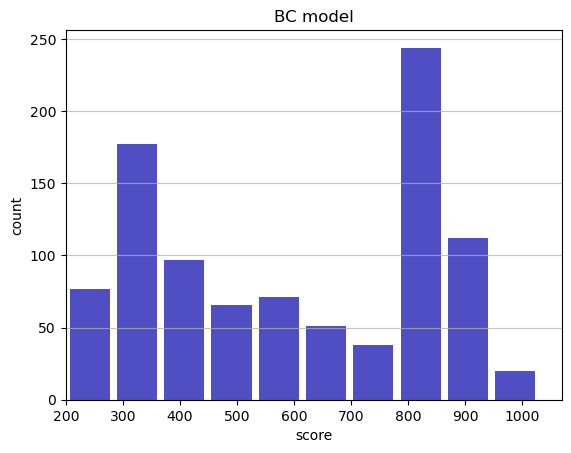

Track generation: 1302..1632 -> 330-tiles track
Epoch: 961
BC	mean: 598.20	variance: 240.38


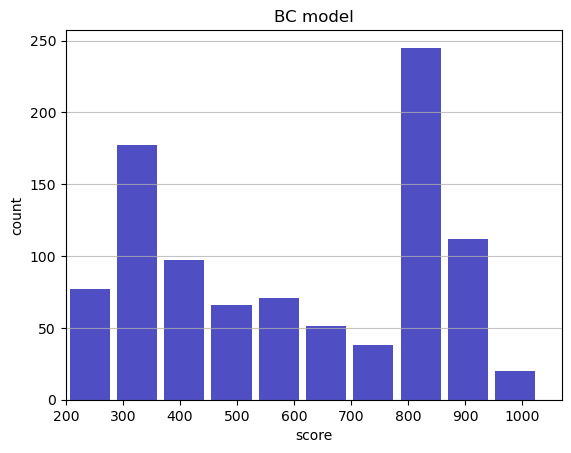

Track generation: 1433..1795 -> 362-tiles track
Epoch: 962
BC	mean: 597.84	variance: 240.50


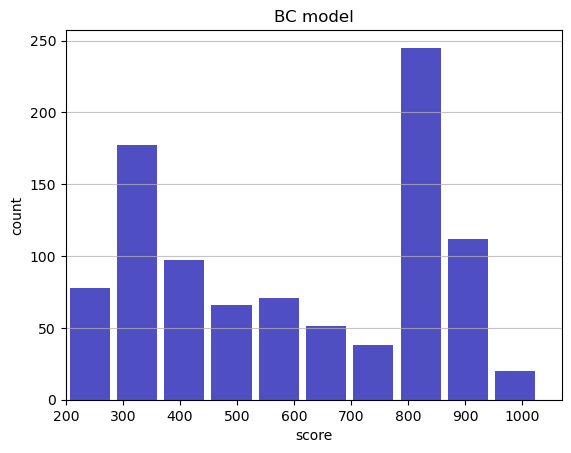

Track generation: 1241..1561 -> 320-tiles track
Epoch: 963
BC	mean: 597.49	variance: 240.63


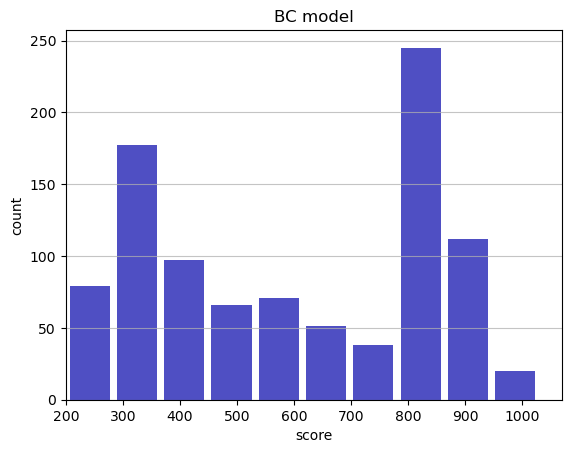

Track generation: 1156..1449 -> 293-tiles track
Epoch: 964
BC	mean: 597.25	variance: 240.62


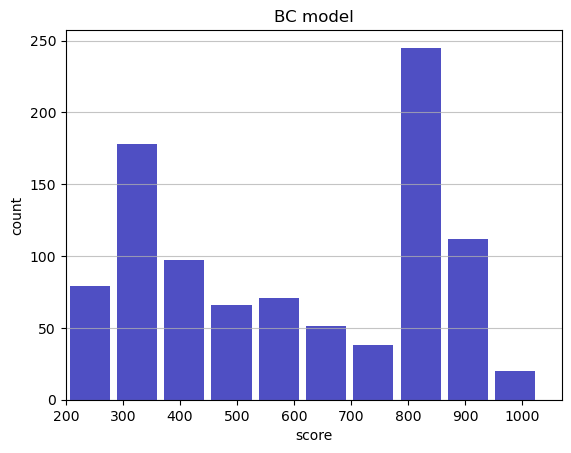

Track generation: 1112..1394 -> 282-tiles track
Epoch: 965
BC	mean: 597.03	variance: 240.58


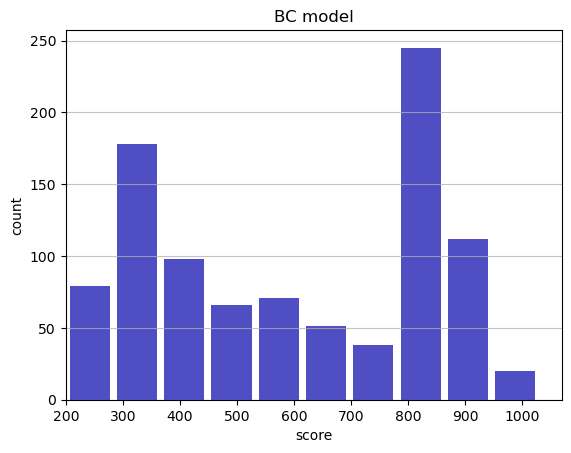

Track generation: 1241..1556 -> 315-tiles track
Epoch: 966
BC	mean: 597.32	variance: 240.62


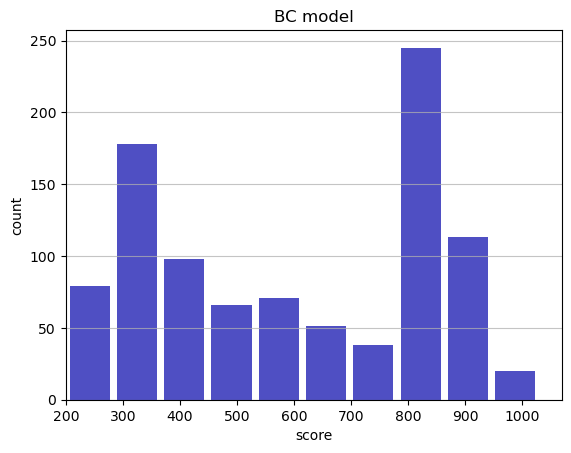

Track generation: 1078..1352 -> 274-tiles track
Epoch: 967
BC	mean: 597.58	variance: 240.64


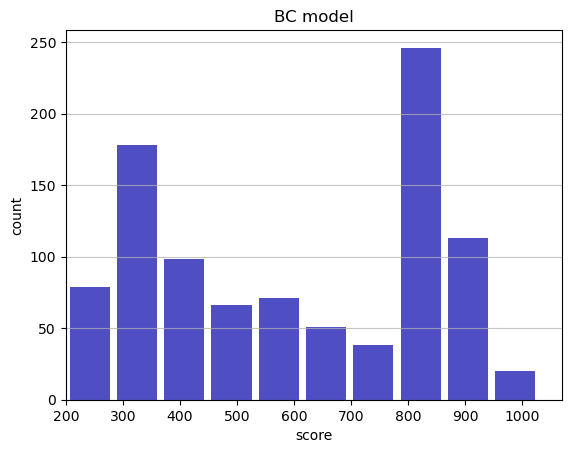

Track generation: 1115..1398 -> 283-tiles track
Epoch: 968
BC	mean: 597.87	variance: 240.68


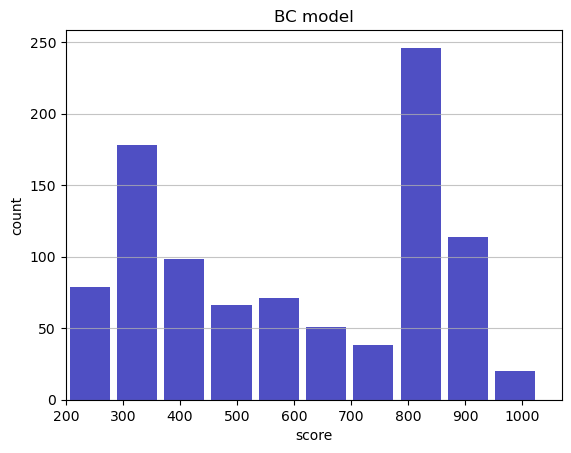

Track generation: 1158..1451 -> 293-tiles track
Epoch: 969
BC	mean: 597.63	variance: 240.67


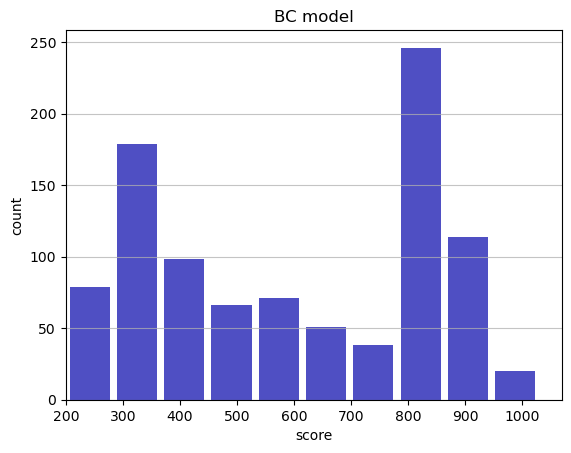

Track generation: 1044..1309 -> 265-tiles track
Epoch: 970
BC	mean: 597.69	variance: 240.55


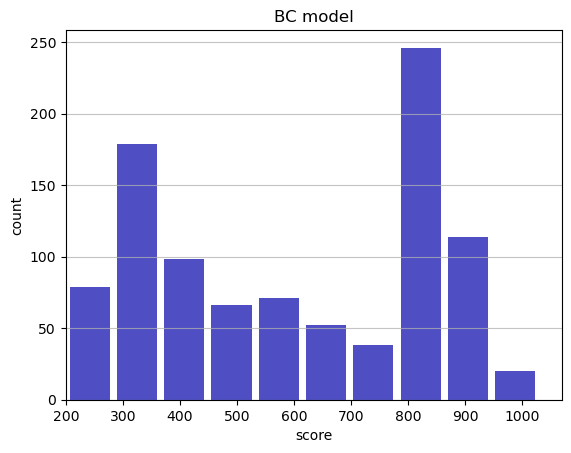

Track generation: 1144..1442 -> 298-tiles track
Epoch: 971
BC	mean: 597.48	variance: 240.52


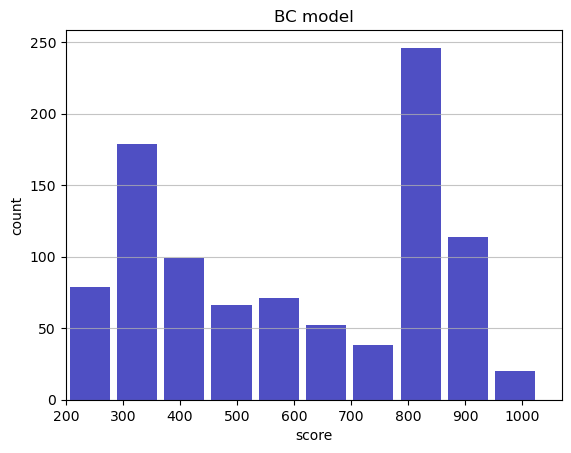

Track generation: 1276..1603 -> 327-tiles track
Epoch: 972
BC	mean: 597.88	variance: 240.71


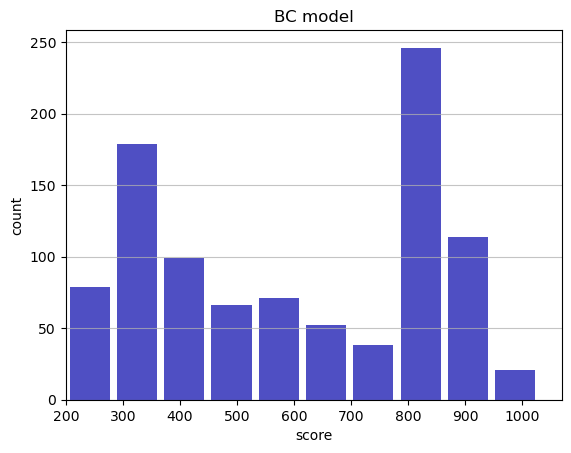

Track generation: 1097..1375 -> 278-tiles track
Epoch: 973
BC	mean: 597.62	variance: 240.72


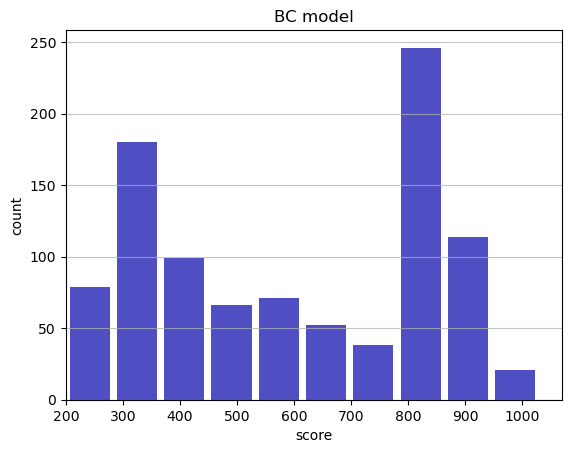

Track generation: 1056..1333 -> 277-tiles track
Epoch: 974
BC	mean: 597.18	variance: 241.00


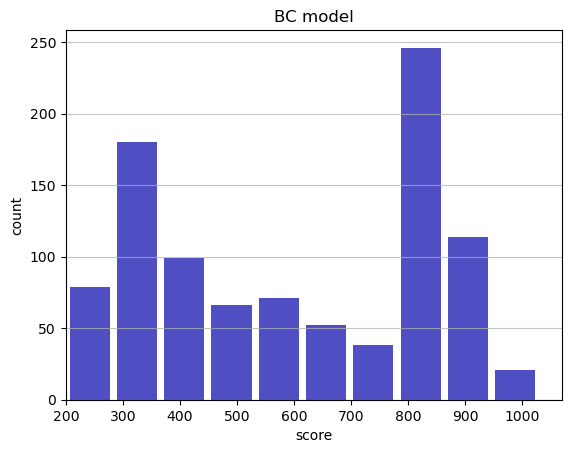

Track generation: 1124..1409 -> 285-tiles track
Epoch: 975
BC	mean: 597.42	variance: 240.99


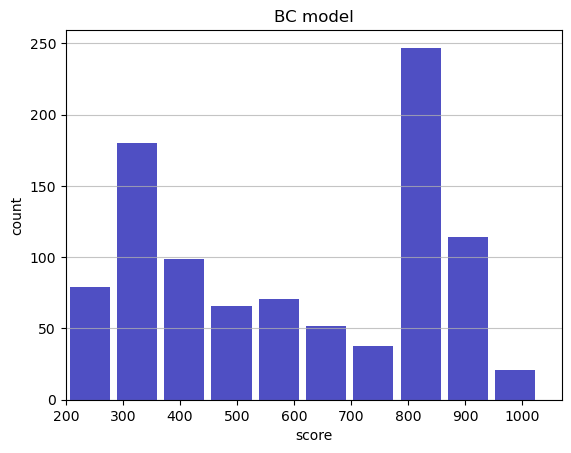

Track generation: 1095..1369 -> 274-tiles track
Epoch: 976
BC	mean: 597.69	variance: 241.01


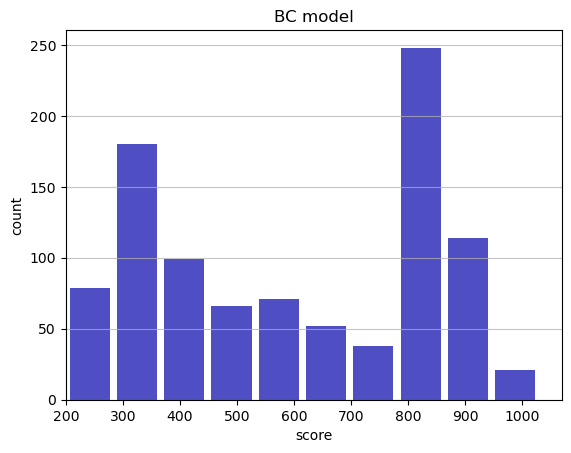

Track generation: 1171..1475 -> 304-tiles track
Epoch: 977
BC	mean: 597.37	variance: 241.09


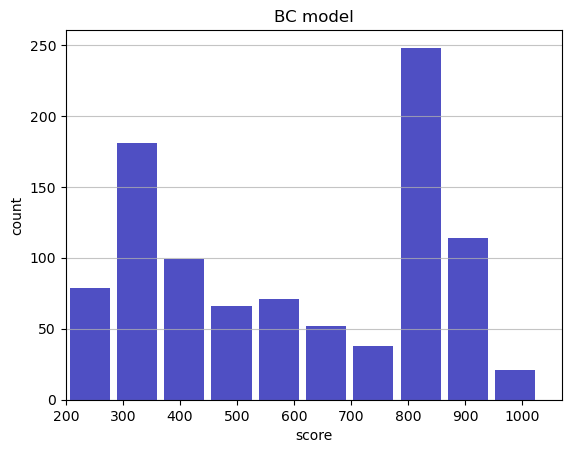

Track generation: 1053..1328 -> 275-tiles track
Epoch: 978
BC	mean: 597.38	variance: 240.97


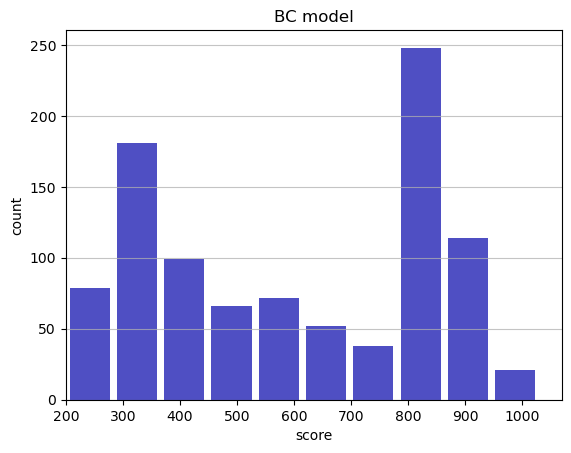

Track generation: 1219..1530 -> 311-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1098..1377 -> 279-tiles track
Epoch: 979
BC	mean: 597.14	variance: 240.96


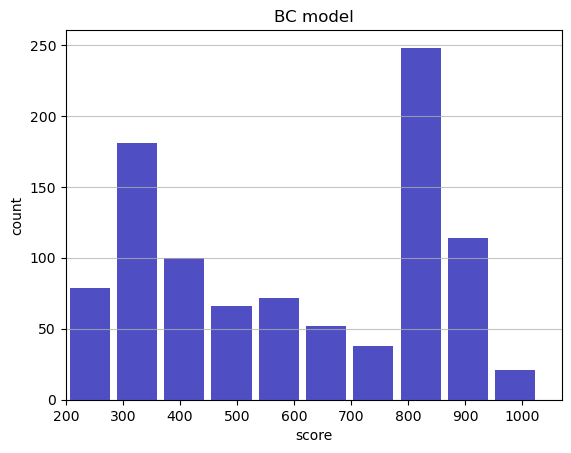

Track generation: 1168..1474 -> 306-tiles track
Epoch: 980
BC	mean: 597.03	variance: 240.86


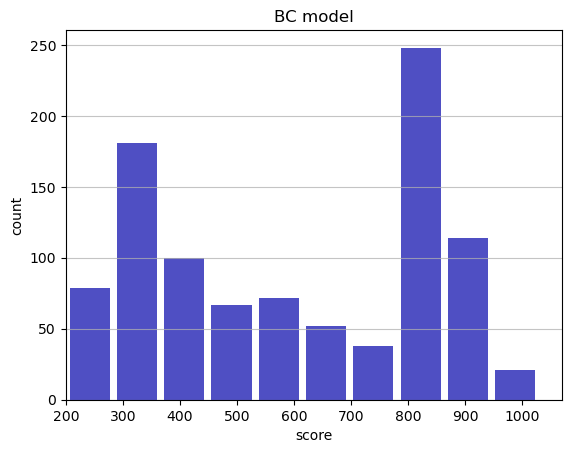

Track generation: 1199..1503 -> 304-tiles track
Epoch: 981
BC	mean: 596.72	variance: 240.93


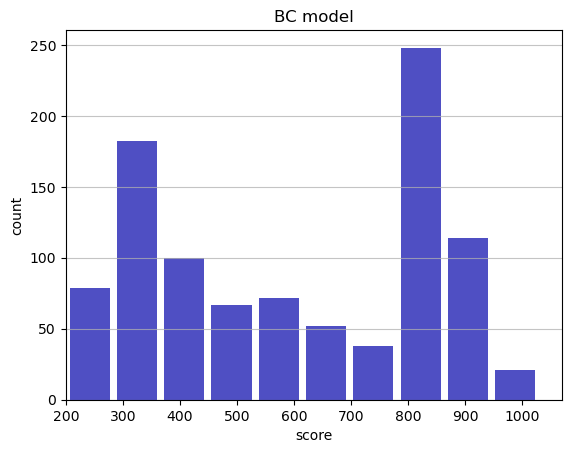

Track generation: 1171..1468 -> 297-tiles track
Epoch: 982
BC	mean: 596.38	variance: 241.04


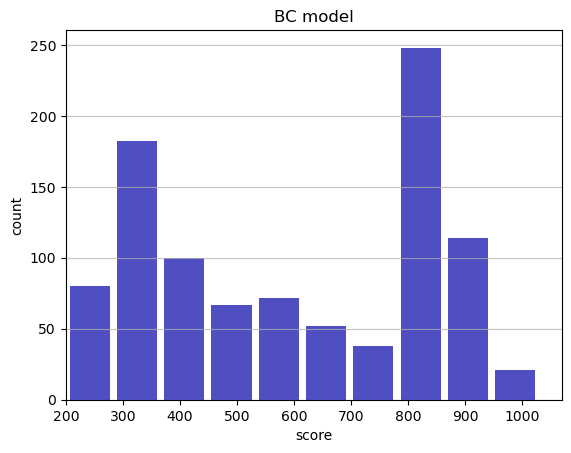

Track generation: 1090..1371 -> 281-tiles track
Epoch: 983
BC	mean: 596.15	variance: 241.03


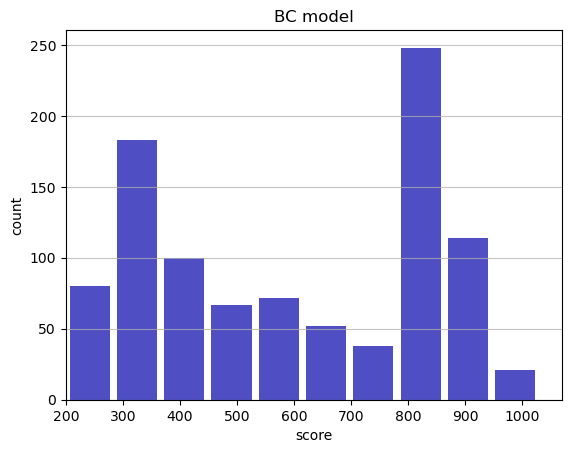

Track generation: 1175..1473 -> 298-tiles track
Epoch: 984
BC	mean: 595.88	variance: 241.05


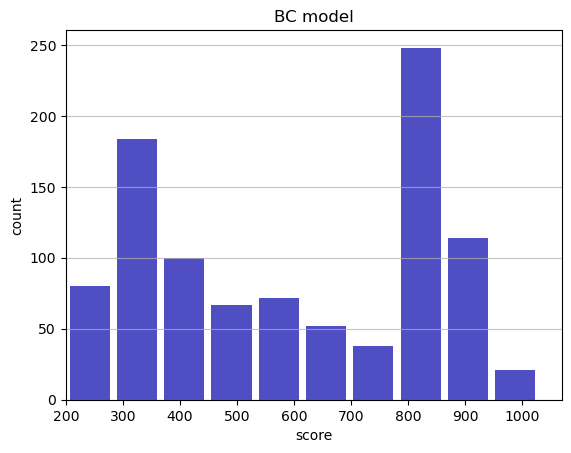

Track generation: 1015..1273 -> 258-tiles track
Epoch: 985
BC	mean: 595.65	variance: 241.03


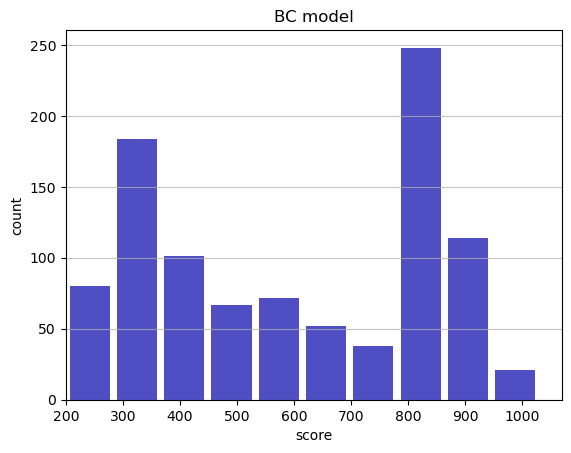

Track generation: 1179..1478 -> 299-tiles track
Epoch: 986
BC	mean: 595.46	variance: 240.99


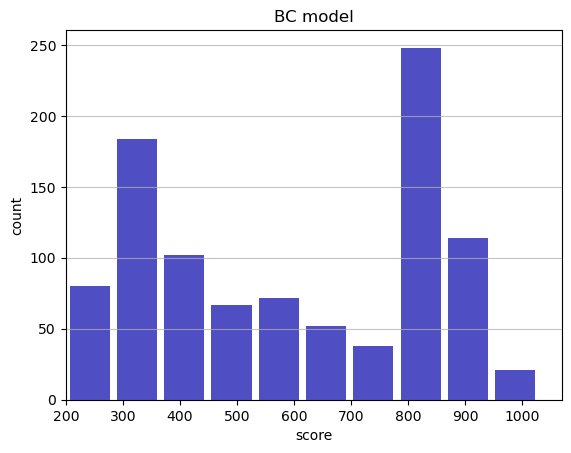

Track generation: 1005..1269 -> 264-tiles track
Epoch: 987
BC	mean: 595.69	variance: 240.97


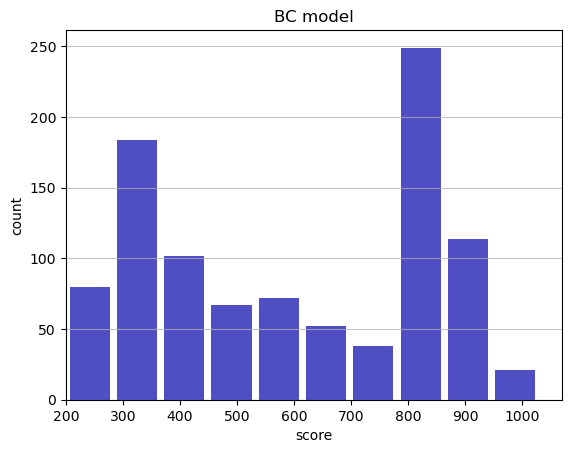

Track generation: 923..1162 -> 239-tiles track
Epoch: 988
BC	mean: 595.97	variance: 241.01


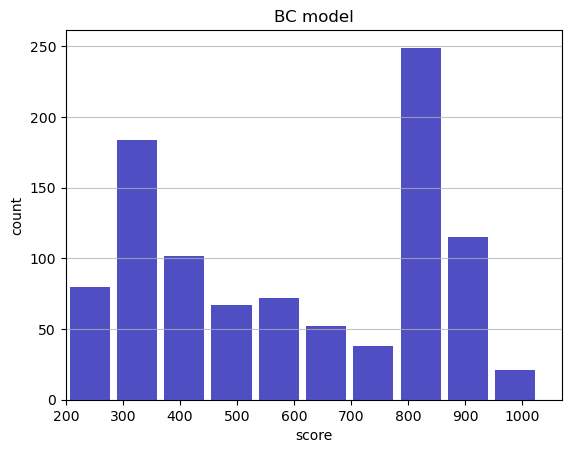

Track generation: 1059..1328 -> 269-tiles track
Epoch: 989
BC	mean: 596.27	variance: 241.07


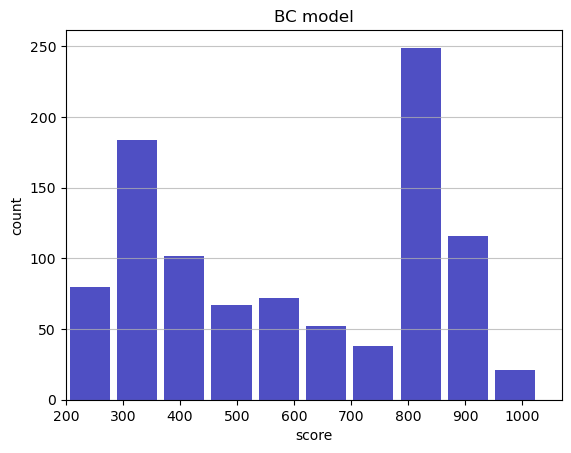

Track generation: 1104..1384 -> 280-tiles track
Epoch: 990
BC	mean: 596.09	variance: 241.02


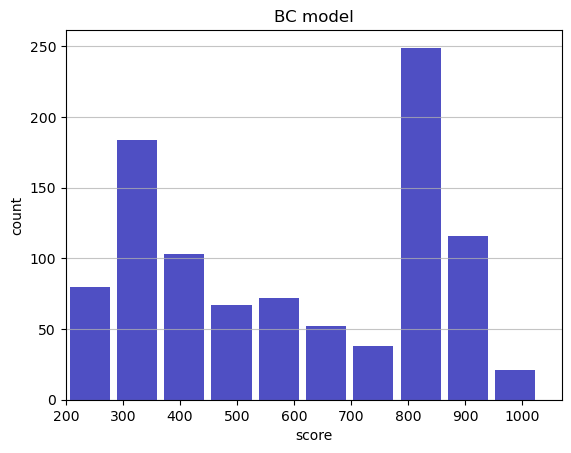

Track generation: 1249..1565 -> 316-tiles track
Epoch: 991
BC	mean: 595.81	variance: 241.06


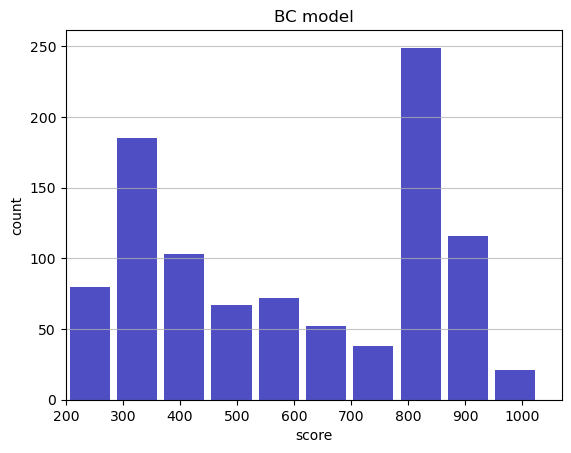

Track generation: 1057..1328 -> 271-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1053..1320 -> 267-tiles track
Epoch: 992
BC	mean: 595.51	variance: 241.12


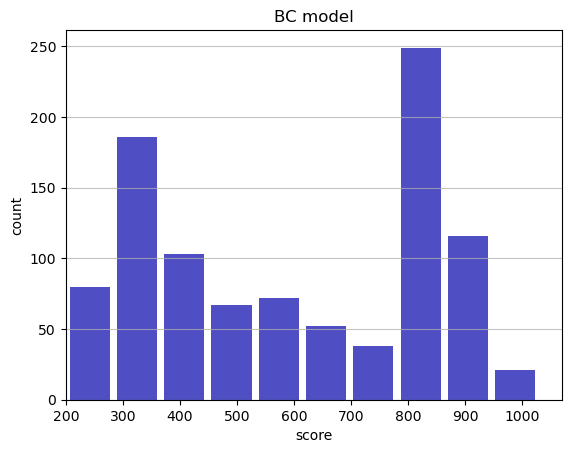

Track generation: 1114..1396 -> 282-tiles track
Epoch: 993
BC	mean: 595.57	variance: 241.01


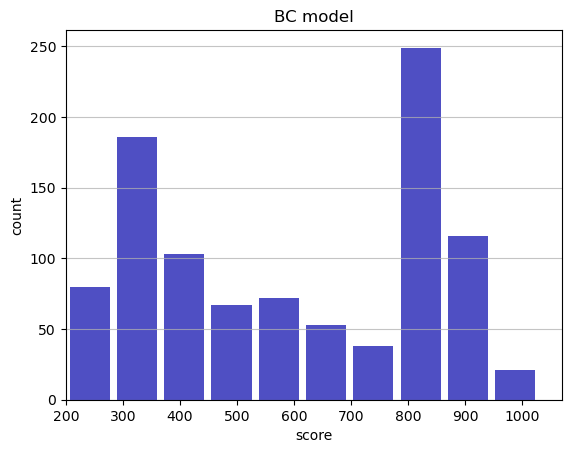

Track generation: 1289..1615 -> 326-tiles track
Epoch: 994
BC	mean: 595.17	variance: 241.22


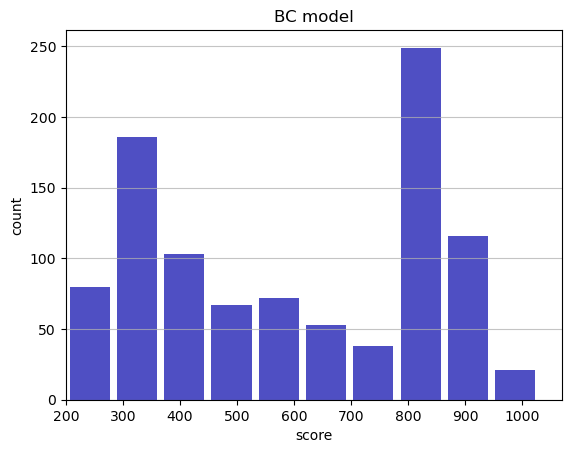

Track generation: 1304..1634 -> 330-tiles track
Epoch: 995
BC	mean: 594.99	variance: 241.16


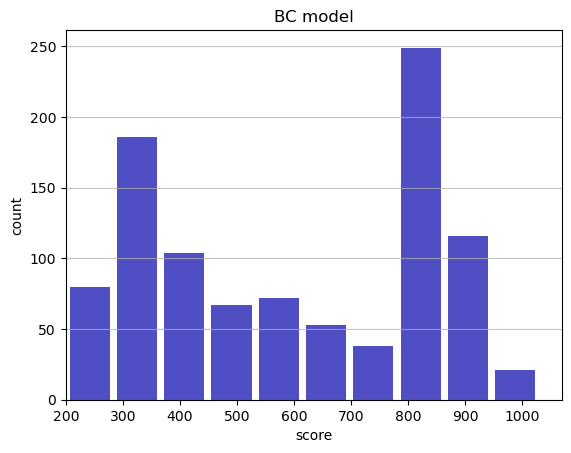

Track generation: 1168..1469 -> 301-tiles track
Epoch: 996
BC	mean: 595.30	variance: 241.23


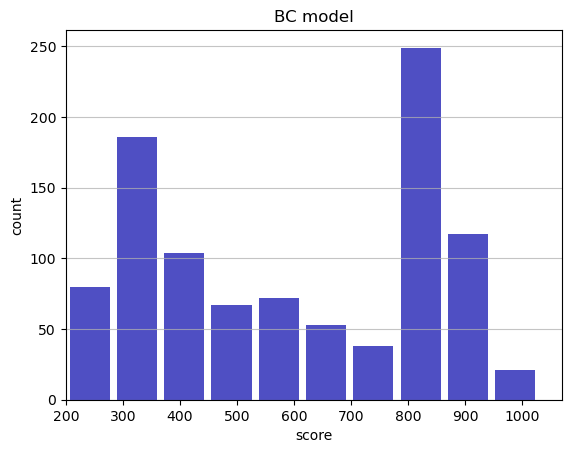

Track generation: 1067..1338 -> 271-tiles track
Epoch: 997
BC	mean: 595.46	variance: 241.17


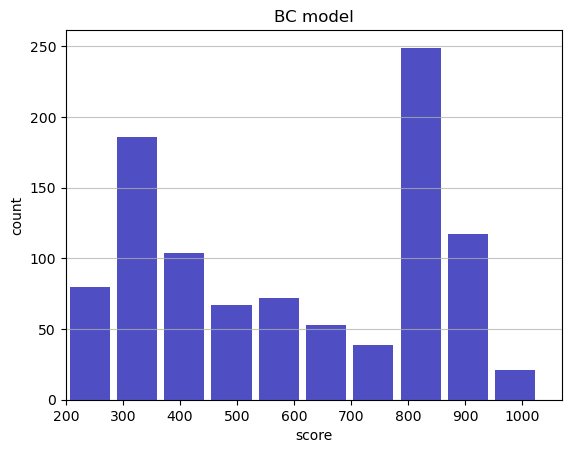

Track generation: 1201..1505 -> 304-tiles track
Epoch: 998
BC	mean: 595.24	variance: 241.16


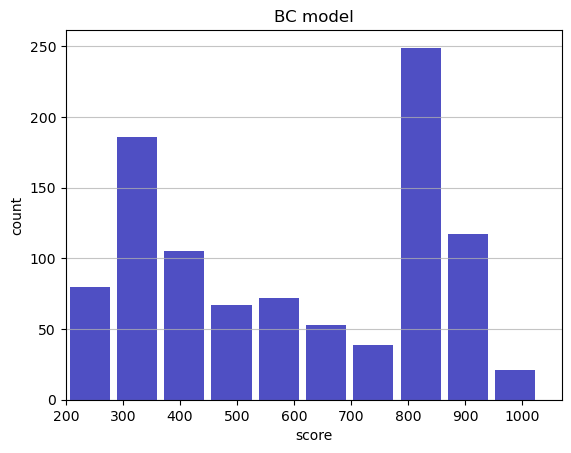

Track generation: 1199..1503 -> 304-tiles track
Epoch: 999
BC	mean: 595.50	variance: 241.17


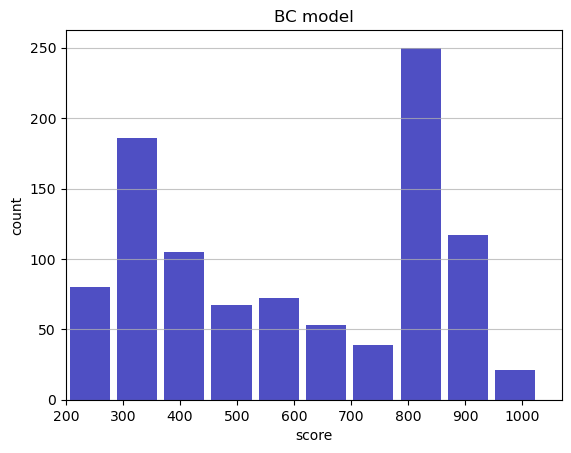

Track generation: 1108..1396 -> 288-tiles track
Epoch: 1000
BC	mean: 595.74	variance: 241.18


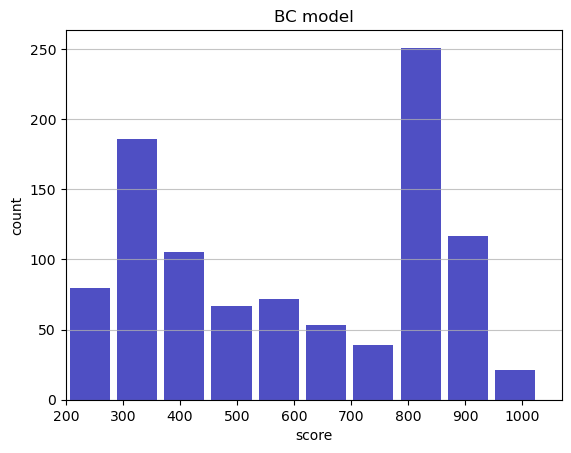

In [3]:
use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")

env = Env()
total_score = 0
scores = []

model = torch.load('./BC_model/BC_model14.pt')

epoch = 1000
for i_ep in range(1,epoch+1):
    score = 0
    state = env.reset()
    
    for t in range(1000):     
        action = model(torch.tensor(state.reshape(1,4,96,96)).cuda().float())[0].cpu().detach().numpy()
        
        state_, reward, done, die = env.step(action * np.array([2., 1., 1.]) + np.array([-1., 0., 0.]))
        
        env.render()
        score += reward
        state = state_
        if done or die:
            break
    
    total_score += score
    scores.append(score)
    
    print("Epoch: {}".format(i_ep))
    print('BC\tmean: {:.2f}\tvariance: {:.2f}'.format(np.array(scores).mean(), np.array(scores).std()))

    plt.figure()
    plt.hist(x=scores, bins='auto', color='#0504aa', alpha=0.7, rwidth=0.85)
    plt.grid(axis='y', alpha=0.75)
    plt.xlim(200,1070)
    plt.xlabel('score')
    plt.ylabel('count')
    plt.title('BC model')
    
    plt.show()
    
env.close()

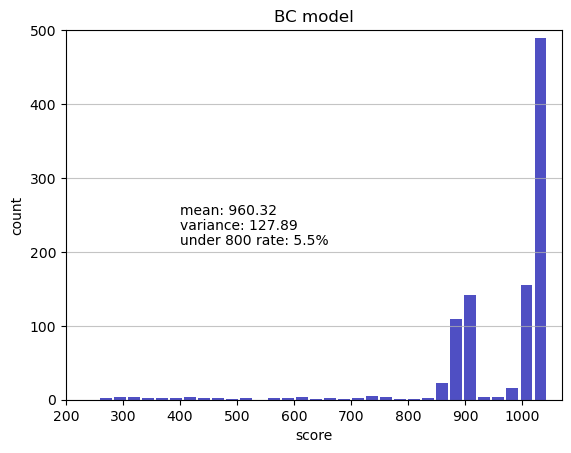

In [16]:
# np.save('./BC_model/score.npy', scores)

scores = np.load('./BC_model/best_score.npy')

plt.figure()
plt.hist(x=scores, bins='auto', color='#0504aa', alpha=0.7, rwidth=0.85)
plt.grid(axis='y', alpha=0.75)
plt.xlim(200,1070)
plt.ylim(0, 500)
plt.xlabel('score')
plt.ylabel('count')
plt.title('BC model')
plt.text(400, 250, 'mean: {:.2f}'.format(np.array(scores).mean()))
plt.text(400, 230, 'variance: {:.2f}'.format(np.array(scores).std()))
plt.text(400, 210, 'under 800 rate: {}%'.format(len(scores[scores < 800])/10))

plt.show()

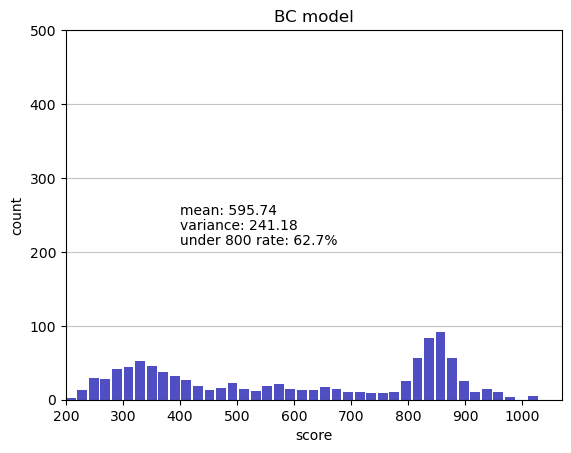

In [9]:
# np.save('./BC_model/worst_score.npy', scores)

scores = np.load('./BC_model/worst_score.npy')

plt.figure()
plt.hist(x=scores, bins=45, color='#0504aa', alpha=0.7, rwidth=0.85)
plt.grid(axis='y', alpha=0.75)
plt.xlim(200,1070)
plt.ylim(0, 500)
plt.xlabel('score')
plt.ylabel('count')
plt.title('BC model')
plt.text(400, 250, 'mean: {:.2f}'.format(np.array(scores).mean()))
plt.text(400, 230, 'variance: {:.2f}'.format(np.array(scores).std()))
plt.text(400, 210, 'under 800 rate: {}%'.format(len(scores[scores < 800])/10))

plt.show()